In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'T4_2.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain]
x_val = xval
y_val = [yval,yval]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM, fx

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 386)      603704      input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 486)      188082      lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        974         dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/Desktop/New folder4/model checkpoint/T4_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik},loss_weights=[0.5,0.5],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 231305.78125, saving model to C:/Users/Asus/Desktop/New folder4/model checkpoint\T4_ckpt

Epoch 00002: val_loss improved from 231305.78125 to 142916.93750, saving model to C:/Users/Asus/Desktop/New folder4/model checkpoint\T4_ckpt

Epoch 00003: val_loss improved from 142916.93750 to 134003.53125, saving model to C:/Users/Asus/Desktop/New folder4/model checkpoint\T4_ckpt

Epoch 00004: val_loss improved from 134003.53125 to 108438.17969, saving model to C:/Users/Asus/Desktop/New folder4/model checkpoint\T4_ckpt

Epoch 00005: val_loss improved from 108438.17969 to 95473.48438, saving model to C:/Users/Asus/Desktop/New folder4/model checkpoint\T4_ckpt

Epoch 00006: val_loss did not improve from 95473.48438

Epoch 00007: val_loss did not improve from 95473.48438

Epoch 00008: val_loss improved from 95473.48438 to 70856.38281, saving


Epoch 00104: val_loss did not improve from 4132.21191

Epoch 00105: val_loss improved from 4132.21191 to 4028.32715, saving model to C:/Users/Asus/Desktop/New folder4/model checkpoint\T4_ckpt

Epoch 00106: val_loss did not improve from 4028.32715

Epoch 00107: val_loss did not improve from 4028.32715

Epoch 00108: val_loss did not improve from 4028.32715

Epoch 00109: val_loss did not improve from 4028.32715

Epoch 00110: val_loss did not improve from 4028.32715

Epoch 00111: val_loss did not improve from 4028.32715

Epoch 00112: val_loss did not improve from 4028.32715

Epoch 00113: val_loss did not improve from 4028.32715

Epoch 00114: val_loss improved from 4028.32715 to 4006.70752, saving model to C:/Users/Asus/Desktop/New folder4/model checkpoint\T4_ckpt

Epoch 00115: val_loss improved from 4006.70752 to 3901.42578, saving model to C:/Users/Asus/Desktop/New folder4/model checkpoint\T4_ckpt

Epoch 00116: val_loss did not improve from 3901.42578

Epoch 00117: val_loss did not impro


Epoch 00235: val_loss did not improve from 2340.54980

Epoch 00236: val_loss did not improve from 2340.54980

Epoch 00237: val_loss did not improve from 2340.54980

Epoch 00238: val_loss did not improve from 2340.54980

Epoch 00239: val_loss did not improve from 2340.54980

Epoch 00240: val_loss did not improve from 2340.54980

Epoch 00241: val_loss did not improve from 2340.54980

Epoch 00242: val_loss did not improve from 2340.54980

Epoch 00243: val_loss did not improve from 2340.54980

Epoch 00244: val_loss did not improve from 2340.54980

Epoch 00245: val_loss did not improve from 2340.54980

Epoch 00246: val_loss did not improve from 2340.54980

Epoch 00247: val_loss did not improve from 2340.54980

Epoch 00248: val_loss did not improve from 2340.54980

Epoch 00249: val_loss did not improve from 2340.54980

Epoch 00250: val_loss did not improve from 2340.54980

Epoch 00251: val_loss did not improve from 2340.54980

Epoch 00252: val_loss did not improve from 2340.54980

Epoch 002

Epoch 00366: val_loss did not improve from 1485.43213

Epoch 00367: val_loss did not improve from 1485.43213

Epoch 00368: val_loss did not improve from 1485.43213

Epoch 00369: val_loss did not improve from 1485.43213

Epoch 00370: val_loss did not improve from 1485.43213

Epoch 00371: val_loss did not improve from 1485.43213

Epoch 00372: val_loss did not improve from 1485.43213

Epoch 00373: val_loss did not improve from 1485.43213

Epoch 00374: val_loss did not improve from 1485.43213

Epoch 00375: val_loss did not improve from 1485.43213

Epoch 00376: val_loss did not improve from 1485.43213

Epoch 00377: val_loss did not improve from 1485.43213

Epoch 00378: val_loss did not improve from 1485.43213

Epoch 00379: val_loss did not improve from 1485.43213

Epoch 00380: val_loss did not improve from 1485.43213

Epoch 00381: val_loss did not improve from 1485.43213

Epoch 00382: val_loss did not improve from 1485.43213

Epoch 00383: val_loss did not improve from 1485.43213

Epoch 0038


Epoch 00506: val_loss did not improve from 482.06448

Epoch 00507: val_loss did not improve from 482.06448

Epoch 00508: val_loss did not improve from 482.06448

Epoch 00509: val_loss did not improve from 482.06448

Epoch 00510: val_loss did not improve from 482.06448

Epoch 00511: val_loss did not improve from 482.06448

Epoch 00512: val_loss did not improve from 482.06448

Epoch 00513: val_loss did not improve from 482.06448

Epoch 00514: val_loss did not improve from 482.06448

Epoch 00515: val_loss did not improve from 482.06448

Epoch 00516: val_loss did not improve from 482.06448

Epoch 00517: val_loss did not improve from 482.06448

Epoch 00518: val_loss did not improve from 482.06448

Epoch 00519: val_loss did not improve from 482.06448

Epoch 00520: val_loss did not improve from 482.06448

Epoch 00521: val_loss did not improve from 482.06448

Epoch 00522: val_loss did not improve from 482.06448

Epoch 00523: val_loss did not improve from 482.06448

Epoch 00524: val_loss did n


Epoch 00647: val_loss did not improve from 130.51682

Epoch 00648: val_loss did not improve from 130.51682

Epoch 00649: val_loss did not improve from 130.51682

Epoch 00650: val_loss did not improve from 130.51682

Epoch 00651: val_loss did not improve from 130.51682

Epoch 00652: val_loss did not improve from 130.51682

Epoch 00653: val_loss did not improve from 130.51682

Epoch 00654: val_loss did not improve from 130.51682

Epoch 00655: val_loss did not improve from 130.51682

Epoch 00656: val_loss did not improve from 130.51682

Epoch 00657: val_loss did not improve from 130.51682

Epoch 00658: val_loss did not improve from 130.51682

Epoch 00659: val_loss did not improve from 130.51682

Epoch 00660: val_loss did not improve from 130.51682

Epoch 00661: val_loss did not improve from 130.51682

Epoch 00662: val_loss did not improve from 130.51682

Epoch 00663: val_loss did not improve from 130.51682

Epoch 00664: val_loss did not improve from 130.51682

Epoch 00665: val_loss did n


Epoch 00795: val_loss did not improve from 21.68368

Epoch 00796: val_loss did not improve from 21.68368

Epoch 00797: val_loss did not improve from 21.68368

Epoch 00798: val_loss did not improve from 21.68368

Epoch 00799: val_loss did not improve from 21.68368

Epoch 00800: val_loss did not improve from 21.68368

Epoch 00801: val_loss did not improve from 21.68368

Epoch 00802: val_loss did not improve from 21.68368

Epoch 00803: val_loss did not improve from 21.68368

Epoch 00804: val_loss did not improve from 21.68368

Epoch 00805: val_loss did not improve from 21.68368

Epoch 00806: val_loss did not improve from 21.68368

Epoch 00807: val_loss did not improve from 21.68368

Epoch 00808: val_loss did not improve from 21.68368

Epoch 00809: val_loss did not improve from 21.68368

Epoch 00810: val_loss did not improve from 21.68368

Epoch 00811: val_loss did not improve from 21.68368

Epoch 00812: val_loss did not improve from 21.68368

Epoch 00813: val_loss did not improve from 21


Epoch 00951: val_loss did not improve from 21.68368

Epoch 00952: val_loss did not improve from 21.68368

Epoch 00953: val_loss did not improve from 21.68368

Epoch 00954: val_loss did not improve from 21.68368

Epoch 00955: val_loss did not improve from 21.68368

Epoch 00956: val_loss did not improve from 21.68368

Epoch 00957: val_loss did not improve from 21.68368

Epoch 00958: val_loss did not improve from 21.68368

Epoch 00959: val_loss did not improve from 21.68368

Epoch 00960: val_loss did not improve from 21.68368

Epoch 00961: val_loss did not improve from 21.68368

Epoch 00962: val_loss did not improve from 21.68368

Epoch 00963: val_loss did not improve from 21.68368

Epoch 00964: val_loss did not improve from 21.68368

Epoch 00965: val_loss did not improve from 21.68368

Epoch 00966: val_loss did not improve from 21.68368

Epoch 00967: val_loss did not improve from 21.68368

Epoch 00968: val_loss did not improve from 21.68368

Epoch 00969: val_loss improved from 21.68368 


Epoch 01103: val_loss did not improve from 17.94355

Epoch 01104: val_loss did not improve from 17.94355

Epoch 01105: val_loss did not improve from 17.94355

Epoch 01106: val_loss did not improve from 17.94355

Epoch 01107: val_loss did not improve from 17.94355

Epoch 01108: val_loss did not improve from 17.94355

Epoch 01109: val_loss did not improve from 17.94355

Epoch 01110: val_loss did not improve from 17.94355

Epoch 01111: val_loss did not improve from 17.94355

Epoch 01112: val_loss did not improve from 17.94355

Epoch 01113: val_loss did not improve from 17.94355

Epoch 01114: val_loss did not improve from 17.94355

Epoch 01115: val_loss did not improve from 17.94355

Epoch 01116: val_loss did not improve from 17.94355

Epoch 01117: val_loss did not improve from 17.94355

Epoch 01118: val_loss did not improve from 17.94355

Epoch 01119: val_loss did not improve from 17.94355

Epoch 01120: val_loss did not improve from 17.94355

Epoch 01121: val_loss did not improve from 17


Epoch 01257: val_loss did not improve from 16.36847

Epoch 01258: val_loss did not improve from 16.36847

Epoch 01259: val_loss did not improve from 16.36847

Epoch 01260: val_loss did not improve from 16.36847

Epoch 01261: val_loss did not improve from 16.36847

Epoch 01262: val_loss did not improve from 16.36847

Epoch 01263: val_loss did not improve from 16.36847

Epoch 01264: val_loss did not improve from 16.36847

Epoch 01265: val_loss did not improve from 16.36847

Epoch 01266: val_loss did not improve from 16.36847

Epoch 01267: val_loss did not improve from 16.36847

Epoch 01268: val_loss did not improve from 16.36847

Epoch 01269: val_loss did not improve from 16.36847

Epoch 01270: val_loss did not improve from 16.36847

Epoch 01271: val_loss did not improve from 16.36847

Epoch 01272: val_loss did not improve from 16.36847

Epoch 01273: val_loss did not improve from 16.36847

Epoch 01274: val_loss did not improve from 16.36847

Epoch 01275: val_loss did not improve from 16


Epoch 01412: val_loss did not improve from 14.48379

Epoch 01413: val_loss did not improve from 14.48379

Epoch 01414: val_loss did not improve from 14.48379

Epoch 01415: val_loss did not improve from 14.48379

Epoch 01416: val_loss did not improve from 14.48379

Epoch 01417: val_loss did not improve from 14.48379

Epoch 01418: val_loss did not improve from 14.48379

Epoch 01419: val_loss did not improve from 14.48379

Epoch 01420: val_loss did not improve from 14.48379

Epoch 01421: val_loss did not improve from 14.48379

Epoch 01422: val_loss did not improve from 14.48379

Epoch 01423: val_loss did not improve from 14.48379

Epoch 01424: val_loss did not improve from 14.48379

Epoch 01425: val_loss did not improve from 14.48379

Epoch 01426: val_loss did not improve from 14.48379

Epoch 01427: val_loss did not improve from 14.48379

Epoch 01428: val_loss did not improve from 14.48379

Epoch 01429: val_loss did not improve from 14.48379

Epoch 01430: val_loss did not improve from 14


Epoch 01567: val_loss did not improve from 13.33521

Epoch 01568: val_loss did not improve from 13.33521

Epoch 01569: val_loss did not improve from 13.33521

Epoch 01570: val_loss did not improve from 13.33521

Epoch 01571: val_loss did not improve from 13.33521

Epoch 01572: val_loss did not improve from 13.33521

Epoch 01573: val_loss did not improve from 13.33521

Epoch 01574: val_loss did not improve from 13.33521

Epoch 01575: val_loss did not improve from 13.33521

Epoch 01576: val_loss did not improve from 13.33521

Epoch 01577: val_loss did not improve from 13.33521

Epoch 01578: val_loss did not improve from 13.33521

Epoch 01579: val_loss did not improve from 13.33521

Epoch 01580: val_loss did not improve from 13.33521

Epoch 01581: val_loss did not improve from 13.33521

Epoch 01582: val_loss did not improve from 13.33521

Epoch 01583: val_loss did not improve from 13.33521

Epoch 01584: val_loss did not improve from 13.33521

Epoch 01585: val_loss did not improve from 13


Epoch 01722: val_loss did not improve from 13.33521

Epoch 01723: val_loss did not improve from 13.33521

Epoch 01724: val_loss did not improve from 13.33521

Epoch 01725: val_loss did not improve from 13.33521

Epoch 01726: val_loss did not improve from 13.33521

Epoch 01727: val_loss did not improve from 13.33521

Epoch 01728: val_loss did not improve from 13.33521

Epoch 01729: val_loss did not improve from 13.33521

Epoch 01730: val_loss did not improve from 13.33521

Epoch 01731: val_loss did not improve from 13.33521

Epoch 01732: val_loss did not improve from 13.33521

Epoch 01733: val_loss did not improve from 13.33521

Epoch 01734: val_loss did not improve from 13.33521

Epoch 01735: val_loss did not improve from 13.33521

Epoch 01736: val_loss did not improve from 13.33521

Epoch 01737: val_loss did not improve from 13.33521

Epoch 01738: val_loss did not improve from 13.33521

Epoch 01739: val_loss did not improve from 13.33521

Epoch 01740: val_loss did not improve from 13


Epoch 01877: val_loss did not improve from 13.33521

Epoch 01878: val_loss did not improve from 13.33521

Epoch 01879: val_loss did not improve from 13.33521

Epoch 01880: val_loss did not improve from 13.33521

Epoch 01881: val_loss did not improve from 13.33521

Epoch 01882: val_loss did not improve from 13.33521

Epoch 01883: val_loss did not improve from 13.33521

Epoch 01884: val_loss did not improve from 13.33521

Epoch 01885: val_loss did not improve from 13.33521

Epoch 01886: val_loss did not improve from 13.33521

Epoch 01887: val_loss did not improve from 13.33521

Epoch 01888: val_loss did not improve from 13.33521

Epoch 01889: val_loss did not improve from 13.33521

Epoch 01890: val_loss did not improve from 13.33521

Epoch 01891: val_loss did not improve from 13.33521

Epoch 01892: val_loss did not improve from 13.33521

Epoch 01893: val_loss did not improve from 13.33521

Epoch 01894: val_loss did not improve from 13.33521

Epoch 01895: val_loss did not improve from 13


Epoch 02032: val_loss did not improve from 13.33521

Epoch 02033: val_loss did not improve from 13.33521

Epoch 02034: val_loss did not improve from 13.33521

Epoch 02035: val_loss did not improve from 13.33521

Epoch 02036: val_loss did not improve from 13.33521

Epoch 02037: val_loss did not improve from 13.33521

Epoch 02038: val_loss did not improve from 13.33521

Epoch 02039: val_loss did not improve from 13.33521

Epoch 02040: val_loss did not improve from 13.33521

Epoch 02041: val_loss did not improve from 13.33521

Epoch 02042: val_loss did not improve from 13.33521

Epoch 02043: val_loss did not improve from 13.33521

Epoch 02044: val_loss did not improve from 13.33521

Epoch 02045: val_loss did not improve from 13.33521

Epoch 02046: val_loss did not improve from 13.33521

Epoch 02047: val_loss did not improve from 13.33521

Epoch 02048: val_loss did not improve from 13.33521

Epoch 02049: val_loss did not improve from 13.33521

Epoch 02050: val_loss did not improve from 13


Epoch 02188: val_loss did not improve from 13.33521

Epoch 02189: val_loss did not improve from 13.33521

Epoch 02190: val_loss did not improve from 13.33521

Epoch 02191: val_loss did not improve from 13.33521

Epoch 02192: val_loss did not improve from 13.33521

Epoch 02193: val_loss did not improve from 13.33521

Epoch 02194: val_loss did not improve from 13.33521

Epoch 02195: val_loss did not improve from 13.33521

Epoch 02196: val_loss did not improve from 13.33521

Epoch 02197: val_loss did not improve from 13.33521

Epoch 02198: val_loss did not improve from 13.33521

Epoch 02199: val_loss did not improve from 13.33521

Epoch 02200: val_loss did not improve from 13.33521

Epoch 02201: val_loss did not improve from 13.33521

Epoch 02202: val_loss did not improve from 13.33521

Epoch 02203: val_loss did not improve from 13.33521

Epoch 02204: val_loss did not improve from 13.33521

Epoch 02205: val_loss did not improve from 13.33521

Epoch 02206: val_loss did not improve from 13

Epoch 02344: val_loss did not improve from 13.33521

Epoch 02345: val_loss did not improve from 13.33521

Epoch 02346: val_loss did not improve from 13.33521

Epoch 02347: val_loss did not improve from 13.33521

Epoch 02348: val_loss did not improve from 13.33521

Epoch 02349: val_loss did not improve from 13.33521

Epoch 02350: val_loss did not improve from 13.33521

Epoch 02351: val_loss did not improve from 13.33521

Epoch 02352: val_loss did not improve from 13.33521

Epoch 02353: val_loss did not improve from 13.33521

Epoch 02354: val_loss did not improve from 13.33521

Epoch 02355: val_loss did not improve from 13.33521

Epoch 02356: val_loss did not improve from 13.33521

Epoch 02357: val_loss did not improve from 13.33521

Epoch 02358: val_loss did not improve from 13.33521

Epoch 02359: val_loss did not improve from 13.33521

Epoch 02360: val_loss did not improve from 13.33521

Epoch 02361: val_loss did not improve from 13.33521

Epoch 02362: val_loss did not improve from 13.


Epoch 02500: val_loss did not improve from 13.33521

Epoch 02501: val_loss did not improve from 13.33521

Epoch 02502: val_loss did not improve from 13.33521

Epoch 02503: val_loss did not improve from 13.33521

Epoch 02504: val_loss did not improve from 13.33521

Epoch 02505: val_loss did not improve from 13.33521

Epoch 02506: val_loss did not improve from 13.33521

Epoch 02507: val_loss did not improve from 13.33521

Epoch 02508: val_loss did not improve from 13.33521

Epoch 02509: val_loss did not improve from 13.33521

Epoch 02510: val_loss did not improve from 13.33521

Epoch 02511: val_loss did not improve from 13.33521

Epoch 02512: val_loss did not improve from 13.33521

Epoch 02513: val_loss did not improve from 13.33521

Epoch 02514: val_loss did not improve from 13.33521

Epoch 02515: val_loss did not improve from 13.33521

Epoch 02516: val_loss did not improve from 13.33521

Epoch 02517: val_loss did not improve from 13.33521

Epoch 02518: val_loss did not improve from 13


Epoch 02656: val_loss did not improve from 13.33521

Epoch 02657: val_loss did not improve from 13.33521

Epoch 02658: val_loss did not improve from 13.33521

Epoch 02659: val_loss did not improve from 13.33521

Epoch 02660: val_loss did not improve from 13.33521

Epoch 02661: val_loss did not improve from 13.33521

Epoch 02662: val_loss did not improve from 13.33521

Epoch 02663: val_loss did not improve from 13.33521

Epoch 02664: val_loss did not improve from 13.33521

Epoch 02665: val_loss did not improve from 13.33521

Epoch 02666: val_loss did not improve from 13.33521

Epoch 02667: val_loss did not improve from 13.33521

Epoch 02668: val_loss did not improve from 13.33521

Epoch 02669: val_loss did not improve from 13.33521

Epoch 02670: val_loss did not improve from 13.33521

Epoch 02671: val_loss did not improve from 13.33521

Epoch 02672: val_loss did not improve from 13.33521

Epoch 02673: val_loss did not improve from 13.33521

Epoch 02674: val_loss did not improve from 13


Epoch 02812: val_loss did not improve from 13.33521

Epoch 02813: val_loss did not improve from 13.33521

Epoch 02814: val_loss did not improve from 13.33521

Epoch 02815: val_loss did not improve from 13.33521

Epoch 02816: val_loss did not improve from 13.33521

Epoch 02817: val_loss did not improve from 13.33521

Epoch 02818: val_loss did not improve from 13.33521

Epoch 02819: val_loss did not improve from 13.33521

Epoch 02820: val_loss did not improve from 13.33521

Epoch 02821: val_loss did not improve from 13.33521

Epoch 02822: val_loss did not improve from 13.33521

Epoch 02823: val_loss did not improve from 13.33521

Epoch 02824: val_loss did not improve from 13.33521

Epoch 02825: val_loss did not improve from 13.33521

Epoch 02826: val_loss did not improve from 13.33521

Epoch 02827: val_loss did not improve from 13.33521

Epoch 02828: val_loss did not improve from 13.33521

Epoch 02829: val_loss did not improve from 13.33521

Epoch 02830: val_loss did not improve from 13


Epoch 02968: val_loss did not improve from 13.33521

Epoch 02969: val_loss did not improve from 13.33521

Epoch 02970: val_loss did not improve from 13.33521

Epoch 02971: val_loss did not improve from 13.33521

Epoch 02972: val_loss did not improve from 13.33521

Epoch 02973: val_loss did not improve from 13.33521

Epoch 02974: val_loss did not improve from 13.33521

Epoch 02975: val_loss did not improve from 13.33521

Epoch 02976: val_loss did not improve from 13.33521

Epoch 02977: val_loss did not improve from 13.33521

Epoch 02978: val_loss did not improve from 13.33521

Epoch 02979: val_loss did not improve from 13.33521

Epoch 02980: val_loss did not improve from 13.33521

Epoch 02981: val_loss did not improve from 13.33521

Epoch 02982: val_loss did not improve from 13.33521

Epoch 02983: val_loss did not improve from 13.33521

Epoch 02984: val_loss did not improve from 13.33521

Epoch 02985: val_loss did not improve from 13.33521

Epoch 02986: val_loss did not improve from 13


Epoch 03124: val_loss did not improve from 13.33521

Epoch 03125: val_loss did not improve from 13.33521

Epoch 03126: val_loss did not improve from 13.33521

Epoch 03127: val_loss did not improve from 13.33521

Epoch 03128: val_loss did not improve from 13.33521

Epoch 03129: val_loss did not improve from 13.33521

Epoch 03130: val_loss did not improve from 13.33521

Epoch 03131: val_loss did not improve from 13.33521

Epoch 03132: val_loss did not improve from 13.33521

Epoch 03133: val_loss did not improve from 13.33521

Epoch 03134: val_loss did not improve from 13.33521

Epoch 03135: val_loss did not improve from 13.33521

Epoch 03136: val_loss did not improve from 13.33521

Epoch 03137: val_loss did not improve from 13.33521

Epoch 03138: val_loss did not improve from 13.33521

Epoch 03139: val_loss did not improve from 13.33521

Epoch 03140: val_loss did not improve from 13.33521

Epoch 03141: val_loss did not improve from 13.33521

Epoch 03142: val_loss did not improve from 13


Epoch 03280: val_loss did not improve from 13.33521

Epoch 03281: val_loss did not improve from 13.33521

Epoch 03282: val_loss did not improve from 13.33521

Epoch 03283: val_loss did not improve from 13.33521

Epoch 03284: val_loss did not improve from 13.33521

Epoch 03285: val_loss did not improve from 13.33521

Epoch 03286: val_loss did not improve from 13.33521

Epoch 03287: val_loss did not improve from 13.33521

Epoch 03288: val_loss did not improve from 13.33521

Epoch 03289: val_loss did not improve from 13.33521

Epoch 03290: val_loss did not improve from 13.33521

Epoch 03291: val_loss did not improve from 13.33521

Epoch 03292: val_loss did not improve from 13.33521

Epoch 03293: val_loss did not improve from 13.33521

Epoch 03294: val_loss did not improve from 13.33521

Epoch 03295: val_loss did not improve from 13.33521

Epoch 03296: val_loss did not improve from 13.33521

Epoch 03297: val_loss did not improve from 13.33521

Epoch 03298: val_loss did not improve from 13


Epoch 03436: val_loss did not improve from 13.33521

Epoch 03437: val_loss did not improve from 13.33521

Epoch 03438: val_loss did not improve from 13.33521

Epoch 03439: val_loss did not improve from 13.33521

Epoch 03440: val_loss did not improve from 13.33521

Epoch 03441: val_loss did not improve from 13.33521

Epoch 03442: val_loss did not improve from 13.33521

Epoch 03443: val_loss did not improve from 13.33521

Epoch 03444: val_loss did not improve from 13.33521

Epoch 03445: val_loss did not improve from 13.33521

Epoch 03446: val_loss did not improve from 13.33521

Epoch 03447: val_loss did not improve from 13.33521

Epoch 03448: val_loss did not improve from 13.33521

Epoch 03449: val_loss did not improve from 13.33521

Epoch 03450: val_loss did not improve from 13.33521

Epoch 03451: val_loss did not improve from 13.33521

Epoch 03452: val_loss did not improve from 13.33521

Epoch 03453: val_loss did not improve from 13.33521

Epoch 03454: val_loss did not improve from 13


Epoch 03591: val_loss did not improve from 13.33521

Epoch 03592: val_loss did not improve from 13.33521

Epoch 03593: val_loss did not improve from 13.33521

Epoch 03594: val_loss did not improve from 13.33521

Epoch 03595: val_loss did not improve from 13.33521

Epoch 03596: val_loss did not improve from 13.33521

Epoch 03597: val_loss did not improve from 13.33521

Epoch 03598: val_loss did not improve from 13.33521

Epoch 03599: val_loss did not improve from 13.33521

Epoch 03600: val_loss did not improve from 13.33521

Epoch 03601: val_loss did not improve from 13.33521

Epoch 03602: val_loss did not improve from 13.33521

Epoch 03603: val_loss did not improve from 13.33521

Epoch 03604: val_loss did not improve from 13.33521

Epoch 03605: val_loss did not improve from 13.33521

Epoch 03606: val_loss did not improve from 13.33521

Epoch 03607: val_loss did not improve from 13.33521

Epoch 03608: val_loss did not improve from 13.33521

Epoch 03609: val_loss did not improve from 13


Epoch 03747: val_loss did not improve from 13.33521

Epoch 03748: val_loss did not improve from 13.33521

Epoch 03749: val_loss did not improve from 13.33521

Epoch 03750: val_loss did not improve from 13.33521

Epoch 03751: val_loss did not improve from 13.33521

Epoch 03752: val_loss did not improve from 13.33521

Epoch 03753: val_loss did not improve from 13.33521

Epoch 03754: val_loss did not improve from 13.33521

Epoch 03755: val_loss did not improve from 13.33521

Epoch 03756: val_loss did not improve from 13.33521

Epoch 03757: val_loss did not improve from 13.33521

Epoch 03758: val_loss did not improve from 13.33521

Epoch 03759: val_loss did not improve from 13.33521

Epoch 03760: val_loss did not improve from 13.33521

Epoch 03761: val_loss did not improve from 13.33521

Epoch 03762: val_loss did not improve from 13.33521

Epoch 03763: val_loss did not improve from 13.33521

Epoch 03764: val_loss did not improve from 13.33521

Epoch 03765: val_loss did not improve from 13


Epoch 03902: val_loss did not improve from 13.33521

Epoch 03903: val_loss did not improve from 13.33521

Epoch 03904: val_loss did not improve from 13.33521

Epoch 03905: val_loss did not improve from 13.33521

Epoch 03906: val_loss did not improve from 13.33521

Epoch 03907: val_loss did not improve from 13.33521

Epoch 03908: val_loss did not improve from 13.33521

Epoch 03909: val_loss did not improve from 13.33521

Epoch 03910: val_loss did not improve from 13.33521

Epoch 03911: val_loss did not improve from 13.33521

Epoch 03912: val_loss did not improve from 13.33521

Epoch 03913: val_loss did not improve from 13.33521

Epoch 03914: val_loss did not improve from 13.33521

Epoch 03915: val_loss did not improve from 13.33521

Epoch 03916: val_loss did not improve from 13.33521

Epoch 03917: val_loss did not improve from 13.33521

Epoch 03918: val_loss did not improve from 13.33521

Epoch 03919: val_loss did not improve from 13.33521

Epoch 03920: val_loss did not improve from 13


Epoch 04058: val_loss did not improve from 13.33521

Epoch 04059: val_loss did not improve from 13.33521

Epoch 04060: val_loss did not improve from 13.33521

Epoch 04061: val_loss did not improve from 13.33521

Epoch 04062: val_loss did not improve from 13.33521

Epoch 04063: val_loss did not improve from 13.33521

Epoch 04064: val_loss did not improve from 13.33521

Epoch 04065: val_loss did not improve from 13.33521

Epoch 04066: val_loss did not improve from 13.33521

Epoch 04067: val_loss did not improve from 13.33521

Epoch 04068: val_loss did not improve from 13.33521

Epoch 04069: val_loss did not improve from 13.33521

Epoch 04070: val_loss did not improve from 13.33521

Epoch 04071: val_loss did not improve from 13.33521

Epoch 04072: val_loss did not improve from 13.33521

Epoch 04073: val_loss did not improve from 13.33521

Epoch 04074: val_loss did not improve from 13.33521

Epoch 04075: val_loss did not improve from 13.33521

Epoch 04076: val_loss did not improve from 13


Epoch 04214: val_loss did not improve from 13.33521

Epoch 04215: val_loss did not improve from 13.33521

Epoch 04216: val_loss did not improve from 13.33521

Epoch 04217: val_loss did not improve from 13.33521

Epoch 04218: val_loss did not improve from 13.33521

Epoch 04219: val_loss did not improve from 13.33521

Epoch 04220: val_loss did not improve from 13.33521

Epoch 04221: val_loss did not improve from 13.33521

Epoch 04222: val_loss did not improve from 13.33521

Epoch 04223: val_loss did not improve from 13.33521

Epoch 04224: val_loss did not improve from 13.33521

Epoch 04225: val_loss did not improve from 13.33521

Epoch 04226: val_loss did not improve from 13.33521

Epoch 04227: val_loss did not improve from 13.33521

Epoch 04228: val_loss did not improve from 13.33521

Epoch 04229: val_loss did not improve from 13.33521

Epoch 04230: val_loss did not improve from 13.33521

Epoch 04231: val_loss did not improve from 13.33521

Epoch 04232: val_loss did not improve from 13


Epoch 04370: val_loss did not improve from 13.33521

Epoch 04371: val_loss did not improve from 13.33521

Epoch 04372: val_loss did not improve from 13.33521

Epoch 04373: val_loss did not improve from 13.33521

Epoch 04374: val_loss did not improve from 13.33521

Epoch 04375: val_loss did not improve from 13.33521

Epoch 04376: val_loss did not improve from 13.33521

Epoch 04377: val_loss did not improve from 13.33521

Epoch 04378: val_loss did not improve from 13.33521

Epoch 04379: val_loss did not improve from 13.33521

Epoch 04380: val_loss did not improve from 13.33521

Epoch 04381: val_loss did not improve from 13.33521

Epoch 04382: val_loss did not improve from 13.33521

Epoch 04383: val_loss did not improve from 13.33521

Epoch 04384: val_loss did not improve from 13.33521

Epoch 04385: val_loss did not improve from 13.33521

Epoch 04386: val_loss did not improve from 13.33521

Epoch 04387: val_loss did not improve from 13.33521

Epoch 04388: val_loss did not improve from 13


Epoch 04526: val_loss did not improve from 13.33521

Epoch 04527: val_loss did not improve from 13.33521

Epoch 04528: val_loss did not improve from 13.33521

Epoch 04529: val_loss did not improve from 13.33521

Epoch 04530: val_loss did not improve from 13.33521

Epoch 04531: val_loss did not improve from 13.33521

Epoch 04532: val_loss did not improve from 13.33521

Epoch 04533: val_loss did not improve from 13.33521

Epoch 04534: val_loss did not improve from 13.33521

Epoch 04535: val_loss did not improve from 13.33521

Epoch 04536: val_loss did not improve from 13.33521

Epoch 04537: val_loss did not improve from 13.33521

Epoch 04538: val_loss did not improve from 13.33521

Epoch 04539: val_loss did not improve from 13.33521

Epoch 04540: val_loss did not improve from 13.33521

Epoch 04541: val_loss did not improve from 13.33521

Epoch 04542: val_loss did not improve from 13.33521

Epoch 04543: val_loss did not improve from 13.33521

Epoch 04544: val_loss did not improve from 13


Epoch 04682: val_loss did not improve from 13.33521

Epoch 04683: val_loss did not improve from 13.33521

Epoch 04684: val_loss did not improve from 13.33521

Epoch 04685: val_loss did not improve from 13.33521

Epoch 04686: val_loss did not improve from 13.33521

Epoch 04687: val_loss did not improve from 13.33521

Epoch 04688: val_loss did not improve from 13.33521

Epoch 04689: val_loss did not improve from 13.33521

Epoch 04690: val_loss did not improve from 13.33521

Epoch 04691: val_loss did not improve from 13.33521

Epoch 04692: val_loss did not improve from 13.33521

Epoch 04693: val_loss did not improve from 13.33521

Epoch 04694: val_loss did not improve from 13.33521

Epoch 04695: val_loss did not improve from 13.33521

Epoch 04696: val_loss did not improve from 13.33521

Epoch 04697: val_loss did not improve from 13.33521

Epoch 04698: val_loss did not improve from 13.33521

Epoch 04699: val_loss did not improve from 13.33521

Epoch 04700: val_loss did not improve from 13


Epoch 04838: val_loss did not improve from 13.33521

Epoch 04839: val_loss did not improve from 13.33521

Epoch 04840: val_loss did not improve from 13.33521

Epoch 04841: val_loss did not improve from 13.33521

Epoch 04842: val_loss did not improve from 13.33521

Epoch 04843: val_loss did not improve from 13.33521

Epoch 04844: val_loss did not improve from 13.33521

Epoch 04845: val_loss did not improve from 13.33521

Epoch 04846: val_loss did not improve from 13.33521

Epoch 04847: val_loss did not improve from 13.33521

Epoch 04848: val_loss did not improve from 13.33521

Epoch 04849: val_loss did not improve from 13.33521

Epoch 04850: val_loss did not improve from 13.33521

Epoch 04851: val_loss did not improve from 13.33521

Epoch 04852: val_loss did not improve from 13.33521

Epoch 04853: val_loss did not improve from 13.33521

Epoch 04854: val_loss did not improve from 13.33521

Epoch 04855: val_loss did not improve from 13.33521

Epoch 04856: val_loss did not improve from 13


Epoch 04993: val_loss did not improve from 13.33521

Epoch 04994: val_loss did not improve from 13.33521

Epoch 04995: val_loss did not improve from 13.33521

Epoch 04996: val_loss did not improve from 13.33521

Epoch 04997: val_loss did not improve from 13.33521

Epoch 04998: val_loss did not improve from 13.33521

Epoch 04999: val_loss did not improve from 13.33521

Epoch 05000: val_loss did not improve from 13.33521

Epoch 05001: val_loss did not improve from 13.33521

Epoch 05002: val_loss did not improve from 13.33521

Epoch 05003: val_loss did not improve from 13.33521

Epoch 05004: val_loss did not improve from 13.33521

Epoch 05005: val_loss did not improve from 13.33521

Epoch 05006: val_loss did not improve from 13.33521

Epoch 05007: val_loss did not improve from 13.33521

Epoch 05008: val_loss did not improve from 13.33521

Epoch 05009: val_loss did not improve from 13.33521

Epoch 05010: val_loss did not improve from 13.33521

Epoch 05011: val_loss did not improve from 13


Epoch 05149: val_loss did not improve from 13.33521

Epoch 05150: val_loss did not improve from 13.33521

Epoch 05151: val_loss did not improve from 13.33521

Epoch 05152: val_loss did not improve from 13.33521

Epoch 05153: val_loss did not improve from 13.33521

Epoch 05154: val_loss did not improve from 13.33521

Epoch 05155: val_loss did not improve from 13.33521

Epoch 05156: val_loss did not improve from 13.33521

Epoch 05157: val_loss did not improve from 13.33521

Epoch 05158: val_loss did not improve from 13.33521

Epoch 05159: val_loss did not improve from 13.33521

Epoch 05160: val_loss did not improve from 13.33521

Epoch 05161: val_loss did not improve from 13.33521

Epoch 05162: val_loss did not improve from 13.33521

Epoch 05163: val_loss did not improve from 13.33521

Epoch 05164: val_loss did not improve from 13.33521

Epoch 05165: val_loss did not improve from 13.33521

Epoch 05166: val_loss did not improve from 13.33521

Epoch 05167: val_loss did not improve from 13


Epoch 05305: val_loss did not improve from 13.33521

Epoch 05306: val_loss did not improve from 13.33521

Epoch 05307: val_loss did not improve from 13.33521

Epoch 05308: val_loss did not improve from 13.33521

Epoch 05309: val_loss did not improve from 13.33521

Epoch 05310: val_loss did not improve from 13.33521

Epoch 05311: val_loss did not improve from 13.33521

Epoch 05312: val_loss did not improve from 13.33521

Epoch 05313: val_loss did not improve from 13.33521

Epoch 05314: val_loss did not improve from 13.33521

Epoch 05315: val_loss did not improve from 13.33521

Epoch 05316: val_loss did not improve from 13.33521

Epoch 05317: val_loss did not improve from 13.33521

Epoch 05318: val_loss did not improve from 13.33521

Epoch 05319: val_loss did not improve from 13.33521

Epoch 05320: val_loss did not improve from 13.33521

Epoch 05321: val_loss did not improve from 13.33521

Epoch 05322: val_loss did not improve from 13.33521

Epoch 05323: val_loss did not improve from 13


Epoch 05461: val_loss did not improve from 13.33521

Epoch 05462: val_loss did not improve from 13.33521

Epoch 05463: val_loss did not improve from 13.33521

Epoch 05464: val_loss did not improve from 13.33521

Epoch 05465: val_loss did not improve from 13.33521

Epoch 05466: val_loss did not improve from 13.33521

Epoch 05467: val_loss did not improve from 13.33521

Epoch 05468: val_loss did not improve from 13.33521

Epoch 05469: val_loss did not improve from 13.33521

Epoch 05470: val_loss did not improve from 13.33521

Epoch 05471: val_loss did not improve from 13.33521

Epoch 05472: val_loss did not improve from 13.33521

Epoch 05473: val_loss did not improve from 13.33521

Epoch 05474: val_loss did not improve from 13.33521

Epoch 05475: val_loss did not improve from 13.33521

Epoch 05476: val_loss did not improve from 13.33521

Epoch 05477: val_loss did not improve from 13.33521

Epoch 05478: val_loss did not improve from 13.33521

Epoch 05479: val_loss did not improve from 13


Epoch 05617: val_loss did not improve from 13.33521

Epoch 05618: val_loss did not improve from 13.33521

Epoch 05619: val_loss did not improve from 13.33521

Epoch 05620: val_loss did not improve from 13.33521

Epoch 05621: val_loss did not improve from 13.33521

Epoch 05622: val_loss did not improve from 13.33521

Epoch 05623: val_loss did not improve from 13.33521

Epoch 05624: val_loss did not improve from 13.33521

Epoch 05625: val_loss did not improve from 13.33521

Epoch 05626: val_loss did not improve from 13.33521

Epoch 05627: val_loss did not improve from 13.33521

Epoch 05628: val_loss did not improve from 13.33521

Epoch 05629: val_loss did not improve from 13.33521

Epoch 05630: val_loss did not improve from 13.33521

Epoch 05631: val_loss did not improve from 13.33521

Epoch 05632: val_loss did not improve from 13.33521

Epoch 05633: val_loss did not improve from 13.33521

Epoch 05634: val_loss did not improve from 13.33521

Epoch 05635: val_loss did not improve from 13


Epoch 05773: val_loss did not improve from 13.33521

Epoch 05774: val_loss did not improve from 13.33521

Epoch 05775: val_loss did not improve from 13.33521

Epoch 05776: val_loss did not improve from 13.33521

Epoch 05777: val_loss did not improve from 13.33521

Epoch 05778: val_loss did not improve from 13.33521

Epoch 05779: val_loss did not improve from 13.33521

Epoch 05780: val_loss did not improve from 13.33521

Epoch 05781: val_loss did not improve from 13.33521

Epoch 05782: val_loss did not improve from 13.33521

Epoch 05783: val_loss did not improve from 13.33521

Epoch 05784: val_loss did not improve from 13.33521

Epoch 05785: val_loss did not improve from 13.33521

Epoch 05786: val_loss did not improve from 13.33521

Epoch 05787: val_loss did not improve from 13.33521

Epoch 05788: val_loss did not improve from 13.33521

Epoch 05789: val_loss did not improve from 13.33521

Epoch 05790: val_loss did not improve from 13.33521

Epoch 05791: val_loss did not improve from 13


Epoch 05929: val_loss did not improve from 13.33521

Epoch 05930: val_loss did not improve from 13.33521

Epoch 05931: val_loss did not improve from 13.33521

Epoch 05932: val_loss did not improve from 13.33521

Epoch 05933: val_loss did not improve from 13.33521

Epoch 05934: val_loss did not improve from 13.33521

Epoch 05935: val_loss did not improve from 13.33521

Epoch 05936: val_loss did not improve from 13.33521

Epoch 05937: val_loss did not improve from 13.33521

Epoch 05938: val_loss did not improve from 13.33521

Epoch 05939: val_loss did not improve from 13.33521

Epoch 05940: val_loss did not improve from 13.33521

Epoch 05941: val_loss did not improve from 13.33521

Epoch 05942: val_loss did not improve from 13.33521

Epoch 05943: val_loss did not improve from 13.33521

Epoch 05944: val_loss did not improve from 13.33521

Epoch 05945: val_loss did not improve from 13.33521

Epoch 05946: val_loss did not improve from 13.33521

Epoch 05947: val_loss did not improve from 13


Epoch 06085: val_loss did not improve from 13.33521

Epoch 06086: val_loss did not improve from 13.33521

Epoch 06087: val_loss did not improve from 13.33521

Epoch 06088: val_loss did not improve from 13.33521

Epoch 06089: val_loss did not improve from 13.33521

Epoch 06090: val_loss did not improve from 13.33521

Epoch 06091: val_loss did not improve from 13.33521

Epoch 06092: val_loss did not improve from 13.33521

Epoch 06093: val_loss did not improve from 13.33521

Epoch 06094: val_loss did not improve from 13.33521

Epoch 06095: val_loss did not improve from 13.33521

Epoch 06096: val_loss did not improve from 13.33521

Epoch 06097: val_loss did not improve from 13.33521

Epoch 06098: val_loss did not improve from 13.33521

Epoch 06099: val_loss did not improve from 13.33521

Epoch 06100: val_loss did not improve from 13.33521

Epoch 06101: val_loss did not improve from 13.33521

Epoch 06102: val_loss did not improve from 13.33521

Epoch 06103: val_loss did not improve from 13


Epoch 06241: val_loss did not improve from 13.33521

Epoch 06242: val_loss did not improve from 13.33521

Epoch 06243: val_loss did not improve from 13.33521

Epoch 06244: val_loss did not improve from 13.33521

Epoch 06245: val_loss did not improve from 13.33521

Epoch 06246: val_loss did not improve from 13.33521

Epoch 06247: val_loss did not improve from 13.33521

Epoch 06248: val_loss did not improve from 13.33521

Epoch 06249: val_loss did not improve from 13.33521

Epoch 06250: val_loss did not improve from 13.33521

Epoch 06251: val_loss did not improve from 13.33521

Epoch 06252: val_loss did not improve from 13.33521

Epoch 06253: val_loss did not improve from 13.33521

Epoch 06254: val_loss did not improve from 13.33521

Epoch 06255: val_loss did not improve from 13.33521

Epoch 06256: val_loss did not improve from 13.33521

Epoch 06257: val_loss did not improve from 13.33521

Epoch 06258: val_loss did not improve from 13.33521

Epoch 06259: val_loss did not improve from 13


Epoch 06397: val_loss did not improve from 13.33521

Epoch 06398: val_loss did not improve from 13.33521

Epoch 06399: val_loss did not improve from 13.33521

Epoch 06400: val_loss did not improve from 13.33521

Epoch 06401: val_loss did not improve from 13.33521

Epoch 06402: val_loss did not improve from 13.33521

Epoch 06403: val_loss did not improve from 13.33521

Epoch 06404: val_loss did not improve from 13.33521

Epoch 06405: val_loss did not improve from 13.33521

Epoch 06406: val_loss did not improve from 13.33521

Epoch 06407: val_loss did not improve from 13.33521

Epoch 06408: val_loss did not improve from 13.33521

Epoch 06409: val_loss did not improve from 13.33521

Epoch 06410: val_loss did not improve from 13.33521

Epoch 06411: val_loss did not improve from 13.33521

Epoch 06412: val_loss did not improve from 13.33521

Epoch 06413: val_loss did not improve from 13.33521

Epoch 06414: val_loss did not improve from 13.33521

Epoch 06415: val_loss did not improve from 13


Epoch 06553: val_loss did not improve from 13.33521

Epoch 06554: val_loss did not improve from 13.33521

Epoch 06555: val_loss did not improve from 13.33521

Epoch 06556: val_loss did not improve from 13.33521

Epoch 06557: val_loss did not improve from 13.33521

Epoch 06558: val_loss did not improve from 13.33521

Epoch 06559: val_loss did not improve from 13.33521

Epoch 06560: val_loss did not improve from 13.33521

Epoch 06561: val_loss did not improve from 13.33521

Epoch 06562: val_loss did not improve from 13.33521

Epoch 06563: val_loss did not improve from 13.33521

Epoch 06564: val_loss did not improve from 13.33521

Epoch 06565: val_loss did not improve from 13.33521

Epoch 06566: val_loss did not improve from 13.33521

Epoch 06567: val_loss did not improve from 13.33521

Epoch 06568: val_loss did not improve from 13.33521

Epoch 06569: val_loss did not improve from 13.33521

Epoch 06570: val_loss did not improve from 13.33521

Epoch 06571: val_loss did not improve from 13


Epoch 06709: val_loss did not improve from 13.33521

Epoch 06710: val_loss did not improve from 13.33521

Epoch 06711: val_loss did not improve from 13.33521

Epoch 06712: val_loss did not improve from 13.33521

Epoch 06713: val_loss did not improve from 13.33521

Epoch 06714: val_loss did not improve from 13.33521

Epoch 06715: val_loss did not improve from 13.33521

Epoch 06716: val_loss did not improve from 13.33521

Epoch 06717: val_loss did not improve from 13.33521

Epoch 06718: val_loss did not improve from 13.33521

Epoch 06719: val_loss did not improve from 13.33521

Epoch 06720: val_loss did not improve from 13.33521

Epoch 06721: val_loss did not improve from 13.33521

Epoch 06722: val_loss did not improve from 13.33521

Epoch 06723: val_loss did not improve from 13.33521

Epoch 06724: val_loss did not improve from 13.33521

Epoch 06725: val_loss did not improve from 13.33521

Epoch 06726: val_loss did not improve from 13.33521

Epoch 06727: val_loss did not improve from 13


Epoch 06864: val_loss did not improve from 13.33521

Epoch 06865: val_loss did not improve from 13.33521

Epoch 06866: val_loss did not improve from 13.33521

Epoch 06867: val_loss did not improve from 13.33521

Epoch 06868: val_loss did not improve from 13.33521

Epoch 06869: val_loss did not improve from 13.33521

Epoch 06870: val_loss did not improve from 13.33521

Epoch 06871: val_loss did not improve from 13.33521

Epoch 06872: val_loss did not improve from 13.33521

Epoch 06873: val_loss did not improve from 13.33521

Epoch 06874: val_loss did not improve from 13.33521

Epoch 06875: val_loss did not improve from 13.33521

Epoch 06876: val_loss did not improve from 13.33521

Epoch 06877: val_loss did not improve from 13.33521

Epoch 06878: val_loss did not improve from 13.33521

Epoch 06879: val_loss did not improve from 13.33521

Epoch 06880: val_loss did not improve from 13.33521

Epoch 06881: val_loss did not improve from 13.33521

Epoch 06882: val_loss did not improve from 13


Epoch 07020: val_loss did not improve from 13.33521

Epoch 07021: val_loss did not improve from 13.33521

Epoch 07022: val_loss did not improve from 13.33521

Epoch 07023: val_loss did not improve from 13.33521

Epoch 07024: val_loss did not improve from 13.33521

Epoch 07025: val_loss did not improve from 13.33521

Epoch 07026: val_loss did not improve from 13.33521

Epoch 07027: val_loss did not improve from 13.33521

Epoch 07028: val_loss did not improve from 13.33521

Epoch 07029: val_loss did not improve from 13.33521

Epoch 07030: val_loss did not improve from 13.33521

Epoch 07031: val_loss did not improve from 13.33521

Epoch 07032: val_loss did not improve from 13.33521

Epoch 07033: val_loss did not improve from 13.33521

Epoch 07034: val_loss did not improve from 13.33521

Epoch 07035: val_loss did not improve from 13.33521

Epoch 07036: val_loss did not improve from 13.33521

Epoch 07037: val_loss did not improve from 13.33521

Epoch 07038: val_loss did not improve from 13


Epoch 07176: val_loss did not improve from 13.33521

Epoch 07177: val_loss did not improve from 13.33521

Epoch 07178: val_loss did not improve from 13.33521

Epoch 07179: val_loss did not improve from 13.33521

Epoch 07180: val_loss did not improve from 13.33521

Epoch 07181: val_loss did not improve from 13.33521

Epoch 07182: val_loss did not improve from 13.33521

Epoch 07183: val_loss did not improve from 13.33521

Epoch 07184: val_loss did not improve from 13.33521

Epoch 07185: val_loss did not improve from 13.33521

Epoch 07186: val_loss did not improve from 13.33521

Epoch 07187: val_loss did not improve from 13.33521

Epoch 07188: val_loss did not improve from 13.33521

Epoch 07189: val_loss did not improve from 13.33521

Epoch 07190: val_loss did not improve from 13.33521

Epoch 07191: val_loss did not improve from 13.33521

Epoch 07192: val_loss did not improve from 13.33521

Epoch 07193: val_loss did not improve from 13.33521

Epoch 07194: val_loss did not improve from 13


Epoch 07332: val_loss did not improve from 13.33521

Epoch 07333: val_loss did not improve from 13.33521

Epoch 07334: val_loss did not improve from 13.33521

Epoch 07335: val_loss did not improve from 13.33521

Epoch 07336: val_loss did not improve from 13.33521

Epoch 07337: val_loss did not improve from 13.33521

Epoch 07338: val_loss did not improve from 13.33521

Epoch 07339: val_loss did not improve from 13.33521

Epoch 07340: val_loss did not improve from 13.33521

Epoch 07341: val_loss did not improve from 13.33521

Epoch 07342: val_loss did not improve from 13.33521

Epoch 07343: val_loss did not improve from 13.33521

Epoch 07344: val_loss did not improve from 13.33521

Epoch 07345: val_loss did not improve from 13.33521

Epoch 07346: val_loss did not improve from 13.33521

Epoch 07347: val_loss did not improve from 13.33521

Epoch 07348: val_loss did not improve from 13.33521

Epoch 07349: val_loss did not improve from 13.33521

Epoch 07350: val_loss did not improve from 13


Epoch 07488: val_loss did not improve from 13.33521

Epoch 07489: val_loss did not improve from 13.33521

Epoch 07490: val_loss did not improve from 13.33521

Epoch 07491: val_loss did not improve from 13.33521

Epoch 07492: val_loss did not improve from 13.33521

Epoch 07493: val_loss did not improve from 13.33521

Epoch 07494: val_loss did not improve from 13.33521

Epoch 07495: val_loss did not improve from 13.33521

Epoch 07496: val_loss did not improve from 13.33521

Epoch 07497: val_loss did not improve from 13.33521

Epoch 07498: val_loss did not improve from 13.33521

Epoch 07499: val_loss did not improve from 13.33521

Epoch 07500: val_loss did not improve from 13.33521

Epoch 07501: val_loss did not improve from 13.33521

Epoch 07502: val_loss did not improve from 13.33521

Epoch 07503: val_loss did not improve from 13.33521

Epoch 07504: val_loss did not improve from 13.33521

Epoch 07505: val_loss did not improve from 13.33521

Epoch 07506: val_loss did not improve from 13


Epoch 07644: val_loss did not improve from 13.33521

Epoch 07645: val_loss did not improve from 13.33521

Epoch 07646: val_loss did not improve from 13.33521

Epoch 07647: val_loss did not improve from 13.33521

Epoch 07648: val_loss did not improve from 13.33521

Epoch 07649: val_loss did not improve from 13.33521

Epoch 07650: val_loss did not improve from 13.33521

Epoch 07651: val_loss did not improve from 13.33521

Epoch 07652: val_loss did not improve from 13.33521

Epoch 07653: val_loss did not improve from 13.33521

Epoch 07654: val_loss did not improve from 13.33521

Epoch 07655: val_loss did not improve from 13.33521

Epoch 07656: val_loss did not improve from 13.33521

Epoch 07657: val_loss did not improve from 13.33521

Epoch 07658: val_loss did not improve from 13.33521

Epoch 07659: val_loss did not improve from 13.33521

Epoch 07660: val_loss did not improve from 13.33521

Epoch 07661: val_loss did not improve from 13.33521

Epoch 07662: val_loss did not improve from 13


Epoch 07800: val_loss did not improve from 13.33521

Epoch 07801: val_loss did not improve from 13.33521

Epoch 07802: val_loss did not improve from 13.33521

Epoch 07803: val_loss did not improve from 13.33521

Epoch 07804: val_loss did not improve from 13.33521

Epoch 07805: val_loss did not improve from 13.33521

Epoch 07806: val_loss did not improve from 13.33521

Epoch 07807: val_loss did not improve from 13.33521

Epoch 07808: val_loss did not improve from 13.33521

Epoch 07809: val_loss did not improve from 13.33521

Epoch 07810: val_loss did not improve from 13.33521

Epoch 07811: val_loss did not improve from 13.33521

Epoch 07812: val_loss did not improve from 13.33521

Epoch 07813: val_loss did not improve from 13.33521

Epoch 07814: val_loss did not improve from 13.33521

Epoch 07815: val_loss did not improve from 13.33521

Epoch 07816: val_loss did not improve from 13.33521

Epoch 07817: val_loss did not improve from 13.33521

Epoch 07818: val_loss did not improve from 13


Epoch 07956: val_loss did not improve from 13.33521

Epoch 07957: val_loss did not improve from 13.33521

Epoch 07958: val_loss did not improve from 13.33521

Epoch 07959: val_loss did not improve from 13.33521

Epoch 07960: val_loss did not improve from 13.33521

Epoch 07961: val_loss did not improve from 13.33521

Epoch 07962: val_loss did not improve from 13.33521

Epoch 07963: val_loss did not improve from 13.33521

Epoch 07964: val_loss did not improve from 13.33521

Epoch 07965: val_loss did not improve from 13.33521

Epoch 07966: val_loss did not improve from 13.33521

Epoch 07967: val_loss did not improve from 13.33521

Epoch 07968: val_loss did not improve from 13.33521

Epoch 07969: val_loss did not improve from 13.33521

Epoch 07970: val_loss did not improve from 13.33521

Epoch 07971: val_loss did not improve from 13.33521

Epoch 07972: val_loss did not improve from 13.33521

Epoch 07973: val_loss did not improve from 13.33521

Epoch 07974: val_loss did not improve from 13


Epoch 08112: val_loss did not improve from 13.33521

Epoch 08113: val_loss did not improve from 13.33521

Epoch 08114: val_loss did not improve from 13.33521

Epoch 08115: val_loss did not improve from 13.33521

Epoch 08116: val_loss did not improve from 13.33521

Epoch 08117: val_loss did not improve from 13.33521

Epoch 08118: val_loss did not improve from 13.33521

Epoch 08119: val_loss did not improve from 13.33521

Epoch 08120: val_loss did not improve from 13.33521

Epoch 08121: val_loss did not improve from 13.33521

Epoch 08122: val_loss did not improve from 13.33521

Epoch 08123: val_loss did not improve from 13.33521

Epoch 08124: val_loss did not improve from 13.33521

Epoch 08125: val_loss did not improve from 13.33521

Epoch 08126: val_loss did not improve from 13.33521

Epoch 08127: val_loss did not improve from 13.33521

Epoch 08128: val_loss did not improve from 13.33521

Epoch 08129: val_loss did not improve from 13.33521

Epoch 08130: val_loss did not improve from 13


Epoch 08268: val_loss did not improve from 13.33521

Epoch 08269: val_loss did not improve from 13.33521

Epoch 08270: val_loss did not improve from 13.33521

Epoch 08271: val_loss did not improve from 13.33521

Epoch 08272: val_loss did not improve from 13.33521

Epoch 08273: val_loss did not improve from 13.33521

Epoch 08274: val_loss did not improve from 13.33521

Epoch 08275: val_loss did not improve from 13.33521

Epoch 08276: val_loss did not improve from 13.33521

Epoch 08277: val_loss did not improve from 13.33521

Epoch 08278: val_loss did not improve from 13.33521

Epoch 08279: val_loss did not improve from 13.33521

Epoch 08280: val_loss did not improve from 13.33521

Epoch 08281: val_loss did not improve from 13.33521

Epoch 08282: val_loss did not improve from 13.33521

Epoch 08283: val_loss did not improve from 13.33521

Epoch 08284: val_loss did not improve from 13.33521

Epoch 08285: val_loss did not improve from 13.33521

Epoch 08286: val_loss did not improve from 13


Epoch 08424: val_loss did not improve from 13.33521

Epoch 08425: val_loss did not improve from 13.33521

Epoch 08426: val_loss did not improve from 13.33521

Epoch 08427: val_loss did not improve from 13.33521

Epoch 08428: val_loss did not improve from 13.33521

Epoch 08429: val_loss did not improve from 13.33521

Epoch 08430: val_loss did not improve from 13.33521

Epoch 08431: val_loss did not improve from 13.33521

Epoch 08432: val_loss did not improve from 13.33521

Epoch 08433: val_loss did not improve from 13.33521

Epoch 08434: val_loss did not improve from 13.33521

Epoch 08435: val_loss did not improve from 13.33521

Epoch 08436: val_loss did not improve from 13.33521

Epoch 08437: val_loss did not improve from 13.33521

Epoch 08438: val_loss did not improve from 13.33521

Epoch 08439: val_loss did not improve from 13.33521

Epoch 08440: val_loss did not improve from 13.33521

Epoch 08441: val_loss did not improve from 13.33521

Epoch 08442: val_loss did not improve from 13


Epoch 08580: val_loss did not improve from 13.33521

Epoch 08581: val_loss did not improve from 13.33521

Epoch 08582: val_loss did not improve from 13.33521

Epoch 08583: val_loss did not improve from 13.33521

Epoch 08584: val_loss did not improve from 13.33521

Epoch 08585: val_loss did not improve from 13.33521

Epoch 08586: val_loss did not improve from 13.33521

Epoch 08587: val_loss did not improve from 13.33521

Epoch 08588: val_loss did not improve from 13.33521

Epoch 08589: val_loss did not improve from 13.33521

Epoch 08590: val_loss did not improve from 13.33521

Epoch 08591: val_loss did not improve from 13.33521

Epoch 08592: val_loss did not improve from 13.33521

Epoch 08593: val_loss did not improve from 13.33521

Epoch 08594: val_loss did not improve from 13.33521

Epoch 08595: val_loss did not improve from 13.33521

Epoch 08596: val_loss did not improve from 13.33521

Epoch 08597: val_loss did not improve from 13.33521

Epoch 08598: val_loss did not improve from 13


Epoch 08736: val_loss did not improve from 13.33521

Epoch 08737: val_loss did not improve from 13.33521

Epoch 08738: val_loss did not improve from 13.33521

Epoch 08739: val_loss did not improve from 13.33521

Epoch 08740: val_loss did not improve from 13.33521

Epoch 08741: val_loss did not improve from 13.33521

Epoch 08742: val_loss did not improve from 13.33521

Epoch 08743: val_loss did not improve from 13.33521

Epoch 08744: val_loss did not improve from 13.33521

Epoch 08745: val_loss did not improve from 13.33521

Epoch 08746: val_loss did not improve from 13.33521

Epoch 08747: val_loss did not improve from 13.33521

Epoch 08748: val_loss did not improve from 13.33521

Epoch 08749: val_loss did not improve from 13.33521

Epoch 08750: val_loss did not improve from 13.33521

Epoch 08751: val_loss did not improve from 13.33521

Epoch 08752: val_loss did not improve from 13.33521

Epoch 08753: val_loss did not improve from 13.33521

Epoch 08754: val_loss did not improve from 13


Epoch 08892: val_loss did not improve from 13.33521

Epoch 08893: val_loss did not improve from 13.33521

Epoch 08894: val_loss did not improve from 13.33521

Epoch 08895: val_loss did not improve from 13.33521

Epoch 08896: val_loss did not improve from 13.33521

Epoch 08897: val_loss did not improve from 13.33521

Epoch 08898: val_loss did not improve from 13.33521

Epoch 08899: val_loss did not improve from 13.33521

Epoch 08900: val_loss did not improve from 13.33521

Epoch 08901: val_loss did not improve from 13.33521

Epoch 08902: val_loss did not improve from 13.33521

Epoch 08903: val_loss did not improve from 13.33521

Epoch 08904: val_loss did not improve from 13.33521

Epoch 08905: val_loss did not improve from 13.33521

Epoch 08906: val_loss did not improve from 13.33521

Epoch 08907: val_loss did not improve from 13.33521

Epoch 08908: val_loss did not improve from 13.33521

Epoch 08909: val_loss did not improve from 13.33521

Epoch 08910: val_loss did not improve from 13


Epoch 09047: val_loss did not improve from 13.33521

Epoch 09048: val_loss did not improve from 13.33521

Epoch 09049: val_loss did not improve from 13.33521

Epoch 09050: val_loss did not improve from 13.33521

Epoch 09051: val_loss did not improve from 13.33521

Epoch 09052: val_loss did not improve from 13.33521

Epoch 09053: val_loss did not improve from 13.33521

Epoch 09054: val_loss did not improve from 13.33521

Epoch 09055: val_loss did not improve from 13.33521

Epoch 09056: val_loss did not improve from 13.33521

Epoch 09057: val_loss did not improve from 13.33521

Epoch 09058: val_loss did not improve from 13.33521

Epoch 09059: val_loss did not improve from 13.33521

Epoch 09060: val_loss did not improve from 13.33521

Epoch 09061: val_loss did not improve from 13.33521

Epoch 09062: val_loss did not improve from 13.33521

Epoch 09063: val_loss did not improve from 13.33521

Epoch 09064: val_loss did not improve from 13.33521

Epoch 09065: val_loss did not improve from 13


Epoch 09203: val_loss did not improve from 13.33521

Epoch 09204: val_loss did not improve from 13.33521

Epoch 09205: val_loss did not improve from 13.33521

Epoch 09206: val_loss did not improve from 13.33521

Epoch 09207: val_loss did not improve from 13.33521

Epoch 09208: val_loss did not improve from 13.33521

Epoch 09209: val_loss did not improve from 13.33521

Epoch 09210: val_loss did not improve from 13.33521

Epoch 09211: val_loss did not improve from 13.33521

Epoch 09212: val_loss did not improve from 13.33521

Epoch 09213: val_loss did not improve from 13.33521

Epoch 09214: val_loss did not improve from 13.33521

Epoch 09215: val_loss did not improve from 13.33521

Epoch 09216: val_loss did not improve from 13.33521

Epoch 09217: val_loss did not improve from 13.33521

Epoch 09218: val_loss did not improve from 13.33521

Epoch 09219: val_loss did not improve from 13.33521

Epoch 09220: val_loss did not improve from 13.33521

Epoch 09221: val_loss did not improve from 13


Epoch 09359: val_loss did not improve from 13.33521

Epoch 09360: val_loss did not improve from 13.33521

Epoch 09361: val_loss did not improve from 13.33521

Epoch 09362: val_loss did not improve from 13.33521

Epoch 09363: val_loss did not improve from 13.33521

Epoch 09364: val_loss did not improve from 13.33521

Epoch 09365: val_loss did not improve from 13.33521

Epoch 09366: val_loss did not improve from 13.33521

Epoch 09367: val_loss did not improve from 13.33521

Epoch 09368: val_loss did not improve from 13.33521

Epoch 09369: val_loss did not improve from 13.33521

Epoch 09370: val_loss did not improve from 13.33521

Epoch 09371: val_loss did not improve from 13.33521

Epoch 09372: val_loss did not improve from 13.33521

Epoch 09373: val_loss did not improve from 13.33521

Epoch 09374: val_loss did not improve from 13.33521

Epoch 09375: val_loss did not improve from 13.33521

Epoch 09376: val_loss did not improve from 13.33521

Epoch 09377: val_loss did not improve from 13


Epoch 09515: val_loss did not improve from 13.33521

Epoch 09516: val_loss did not improve from 13.33521

Epoch 09517: val_loss did not improve from 13.33521

Epoch 09518: val_loss did not improve from 13.33521

Epoch 09519: val_loss did not improve from 13.33521

Epoch 09520: val_loss did not improve from 13.33521

Epoch 09521: val_loss did not improve from 13.33521

Epoch 09522: val_loss did not improve from 13.33521

Epoch 09523: val_loss did not improve from 13.33521

Epoch 09524: val_loss did not improve from 13.33521

Epoch 09525: val_loss did not improve from 13.33521

Epoch 09526: val_loss did not improve from 13.33521

Epoch 09527: val_loss did not improve from 13.33521

Epoch 09528: val_loss did not improve from 13.33521

Epoch 09529: val_loss did not improve from 13.33521

Epoch 09530: val_loss did not improve from 13.33521

Epoch 09531: val_loss did not improve from 13.33521

Epoch 09532: val_loss did not improve from 13.33521

Epoch 09533: val_loss did not improve from 13


Epoch 09671: val_loss did not improve from 13.33521

Epoch 09672: val_loss did not improve from 13.33521

Epoch 09673: val_loss did not improve from 13.33521

Epoch 09674: val_loss did not improve from 13.33521

Epoch 09675: val_loss did not improve from 13.33521

Epoch 09676: val_loss did not improve from 13.33521

Epoch 09677: val_loss did not improve from 13.33521

Epoch 09678: val_loss did not improve from 13.33521

Epoch 09679: val_loss did not improve from 13.33521

Epoch 09680: val_loss did not improve from 13.33521

Epoch 09681: val_loss did not improve from 13.33521

Epoch 09682: val_loss did not improve from 13.33521

Epoch 09683: val_loss did not improve from 13.33521

Epoch 09684: val_loss did not improve from 13.33521

Epoch 09685: val_loss did not improve from 13.33521

Epoch 09686: val_loss did not improve from 13.33521

Epoch 09687: val_loss did not improve from 13.33521

Epoch 09688: val_loss did not improve from 13.33521

Epoch 09689: val_loss did not improve from 13


Epoch 09827: val_loss did not improve from 13.33521

Epoch 09828: val_loss did not improve from 13.33521

Epoch 09829: val_loss did not improve from 13.33521

Epoch 09830: val_loss did not improve from 13.33521

Epoch 09831: val_loss did not improve from 13.33521

Epoch 09832: val_loss did not improve from 13.33521

Epoch 09833: val_loss did not improve from 13.33521

Epoch 09834: val_loss did not improve from 13.33521

Epoch 09835: val_loss did not improve from 13.33521

Epoch 09836: val_loss did not improve from 13.33521

Epoch 09837: val_loss did not improve from 13.33521

Epoch 09838: val_loss did not improve from 13.33521

Epoch 09839: val_loss did not improve from 13.33521

Epoch 09840: val_loss did not improve from 13.33521

Epoch 09841: val_loss did not improve from 13.33521

Epoch 09842: val_loss did not improve from 13.33521

Epoch 09843: val_loss did not improve from 13.33521

Epoch 09844: val_loss did not improve from 13.33521

Epoch 09845: val_loss did not improve from 13


Epoch 09983: val_loss did not improve from 13.33521

Epoch 09984: val_loss did not improve from 13.33521

Epoch 09985: val_loss did not improve from 13.33521

Epoch 09986: val_loss did not improve from 13.33521

Epoch 09987: val_loss did not improve from 13.33521

Epoch 09988: val_loss did not improve from 13.33521

Epoch 09989: val_loss did not improve from 13.33521

Epoch 09990: val_loss did not improve from 13.33521

Epoch 09991: val_loss did not improve from 13.33521

Epoch 09992: val_loss did not improve from 13.33521

Epoch 09993: val_loss did not improve from 13.33521

Epoch 09994: val_loss did not improve from 13.33521

Epoch 09995: val_loss did not improve from 13.33521

Epoch 09996: val_loss did not improve from 13.33521

Epoch 09997: val_loss did not improve from 13.33521

Epoch 09998: val_loss did not improve from 13.33521

Epoch 09999: val_loss did not improve from 13.33521

Epoch 10000: val_loss did not improve from 13.33521


In [25]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [26]:
#moving average smoothing function for loss visualization

def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

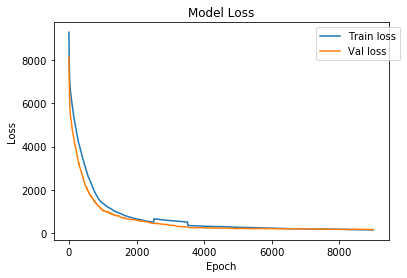

In [27]:
#Plot Model Loss

w = 1000
h1 = np.array(history.history['loss'])
h4 = np.array(history.history['val_loss'])
h1 = moving_average(h1,w)
h4 = moving_average(h4,w)
plt.plot(h1,label='Train loss')
plt.plot(h4,label='Val loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

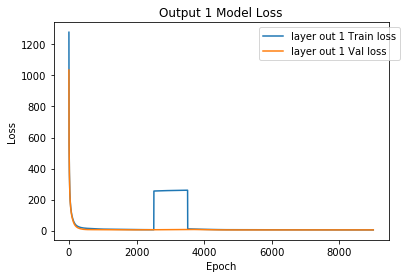

In [28]:
#Plot output 1 loss

h2 = np.array(history.history['out1_loss'])
h5 = np.array(history.history['val_out1_loss'])
h2 = moving_average(h2,w)
h5 = moving_average(h5,w)
plt.plot(h2,label='layer out 1 Train loss')
plt.plot(h5,label='layer out 1 Val loss')
plt.title('Output 1 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

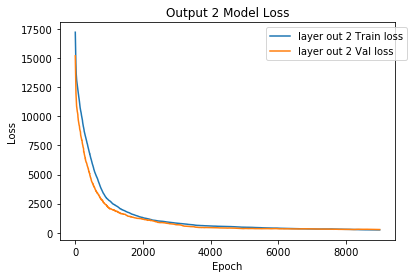

In [29]:
#Plot output 2 loss

h3 = np.array(history.history['out2_loss'])
h6 = np.array(history.history['val_out2_loss'])
h3 = moving_average(h3,w)
h6 = moving_average(h6,w)
plt.plot(h3,label='layer out 2 Train loss')
plt.plot(h6,label='layer out 2 Val loss')
plt.title('Output 2 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

In [30]:
#visualize graph

#%tensorboard --logdir logs
#if issue delete log in C:\Users\Asus\AppData\Local\Temp\.tensor_board

In [31]:
#load ground truth

ytest2 = np.zeros((34,1))
for i in range(34):
    ytest2[i] =  ytest[i][0]
    
ytest2 =ytest2.reshape(34,)
ytest2

array([623.65787011, 617.762143  , 619.20105814, 617.83553683,
       622.92242606, 621.31818137, 621.48637881, 621.67503874,
       621.92122295, 621.82241307, 620.23499287, 620.80344945,
       629.21604784, 628.30373544, 623.37035024, 629.30847097,
       627.21781691, 628.35795635, 628.08847566, 618.79078205,
       621.88557839, 621.34454106, 627.74976657, 629.88826183,
       625.08542547, 630.27554535, 626.42704011, 625.35773051,
       642.15985033, 630.80723127, 629.92675451, 626.61515594,
       636.47325568, 629.58648951])

In [32]:
#Load ground truth sequence

fleet_Rul_File = "ytestT.csv"
fleet_RUL = pd.read_csv(fleet_Rul_File, skiprows = 0,header = None)
#fleet_RUL = fleet_RUL*(thrmax-thrmin) + thrmin
fleet_RUL_np = np.zeros((34,24))
for i in range(34):
    for j in range(24):
        fleet_RUL_np[i][j] = fleet_RUL[i][j]

fleet_RUL_np.shape

(34, 24)

In [33]:
#Prediction

#Make 100 predictions and calculate average RMSE

import sklearn
import math
from sklearn import metrics

rmse = np.zeros(100)
rmse1 = np.zeros(100)

for i in range(100):
    
    preds = model(x_test)
    tens_draw = preds[0].sample(1000)
    tens_draw1 = preds[1].sample(1000)
    tens_draw = tf.keras.backend.get_value(tens_draw)
    tens_draw1 = tf.keras.backend.get_value(tens_draw1)

    #RMSE with AU

    #Predicted RUL for each Fleet
    mean_Fleet_All = np.zeros((tens_draw.shape[1],tens_draw.shape[2]))
    mean_Fleet = np.zeros(tens_draw.shape[0])
    for s in range(tens_draw.shape[2]):
        for y in range(tens_draw.shape[1]):
            for x in range(tens_draw.shape[0]):
                mean_Fleet[x] = tens_draw[x,y,s]
            mean_Fleet_All[y][s] = mean_Fleet.mean()

    RUL_mse = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All)
    RUL_rmse = math.sqrt(RUL_mse)
    rmse[i] = RUL_rmse

    mean_Fleet_All1 = np.zeros((tens_draw1.shape[1],tens_draw1.shape[2]))
    mean_Fleet1 = np.zeros(tens_draw1.shape[0])
    for s in range(tens_draw1.shape[2]):
        for y in range(tens_draw1.shape[1]):
            for x in range(tens_draw1.shape[0]):
                mean_Fleet1[x] = tens_draw1[x,y,s]
            mean_Fleet_All1[y] = mean_Fleet1.mean()

    RUL_mse1 = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All1)
    RUL_rmse1 = math.sqrt(RUL_mse1)
    rmse1[i] = RUL_rmse1

#Average RMSE with AU & EU

np.mean(rmse),np.mean(rmse1)

(32.67769265582151, 49.73882032781373)

In [34]:
#Calculate Mean & Std of prediction with AU

pad = 24
fleet_NUM = np.arange(0,pad,1)

Fleet = pd.DataFrame(np.zeros((pad,tens_draw.shape[0])))
mean = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
std = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
for z in range(tens_draw.shape[1]):
    for y in range(tens_draw.shape[0]):
        for x in range(pad):
            Fleet[y][x] = tens_draw[y,z,x]
    row_Mean = Fleet.mean(axis=1)
    row_Std = Fleet.std(axis=1)
    for j in range(pad):
        mean[z][j] = row_Mean[j]
    for k in range(pad):
        std[z][k] = row_Std[k]

In [35]:
#Calculate Mean & Std of prediction with EU

Fleet1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[0])))
meaT4 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
std1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
for z in range(tens_draw1.shape[1]):
    for y in range(tens_draw1.shape[0]):
        for x in range(pad):
            Fleet1[y][x] = tens_draw1[y,z,x]
    row_Mean = Fleet1.mean(axis=1)
    row_Std = Fleet1.std(axis=1)
    for j in range(pad):
        meaT4[z][j] = row_Mean[j]
    for k in range(pad):
        std1[z][k] = row_Std[k]

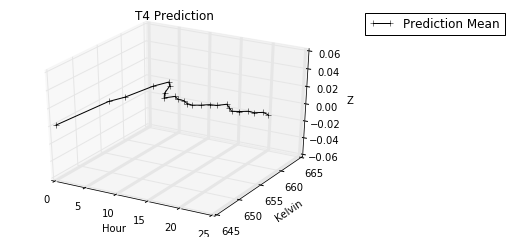

In [36]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("T4 Prediction")
ax.set_xlabel('Hour')
ax.set_ylabel('Kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
#ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
#ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.tiff',bbox_inches='tight')
plt.show()

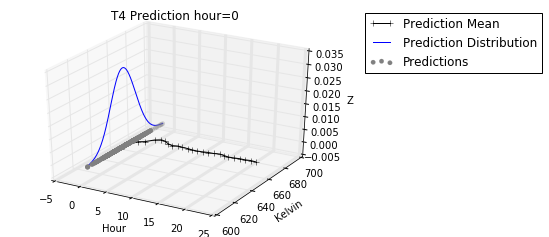

In [37]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 0

ax.set_title("T4 Prediction hour=%i" % i)
ax.set_xlabel('Hour')
ax.set_ylabel('Kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_2.tiff',bbox_inches='tight')
plt.show()

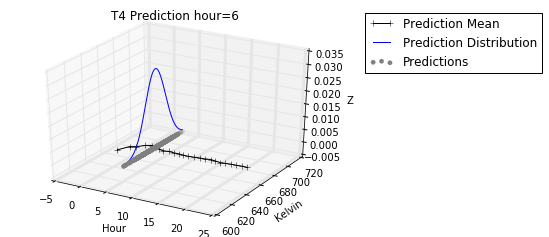

In [38]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 5

ax.set_title("T4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_3.tiff',bbox_inches='tight')
plt.show()

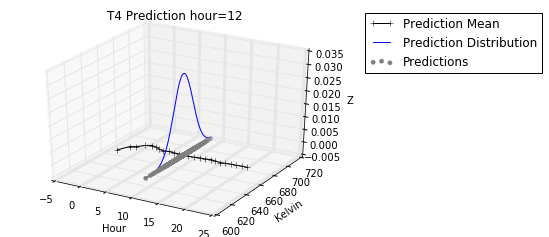

In [39]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 11

ax.set_title("T4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_4.tiff',bbox_inches='tight')
plt.show()

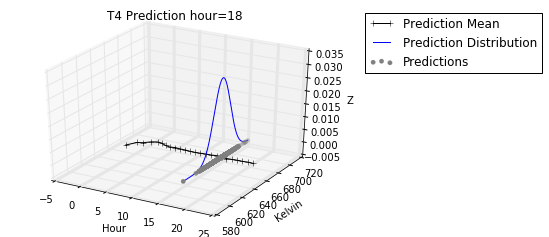

In [40]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("T4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_5.tiff',bbox_inches='tight')
plt.show()

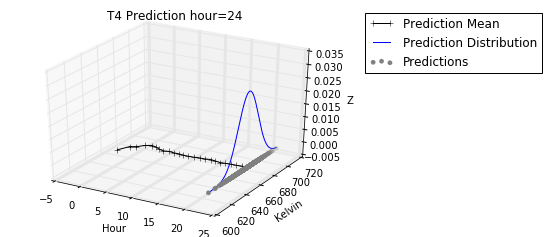

In [41]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 23

ax.set_title("T4 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('Kelvin')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_6.tiff',bbox_inches='tight')
plt.show()

In [42]:
#Load date of prediction

date = "date.csv"
date = pd.read_csv(date, skiprows = 0,header = None)
date = date.to_numpy()

In [43]:
#Load hour of prediction

hour_NUM = ['8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am']

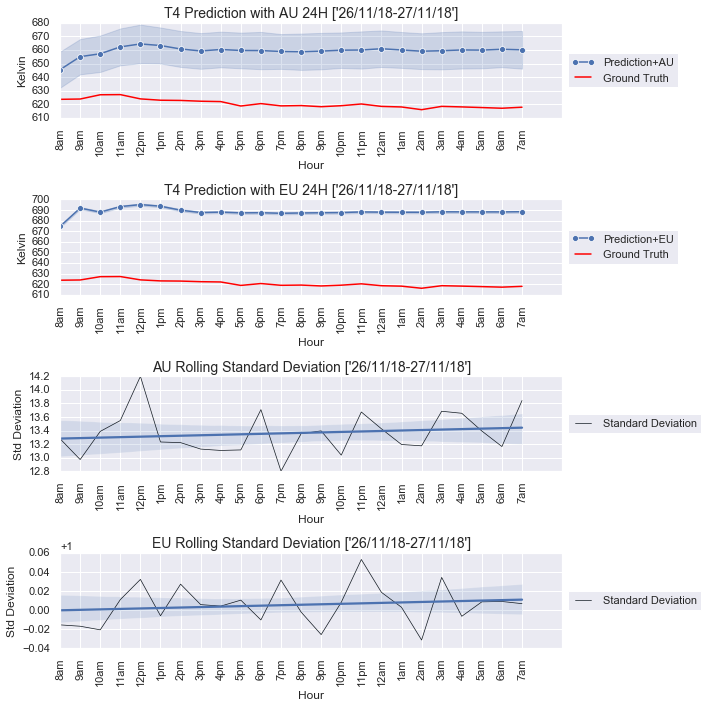

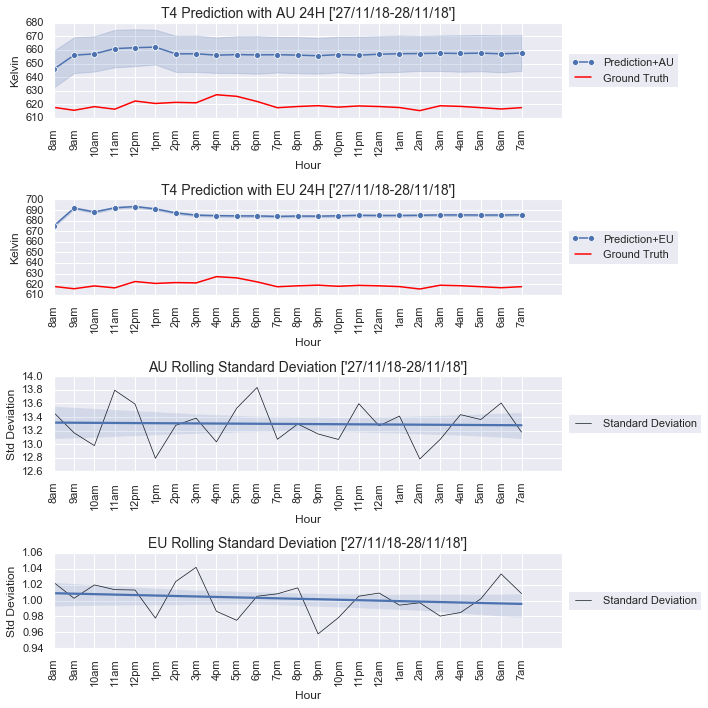

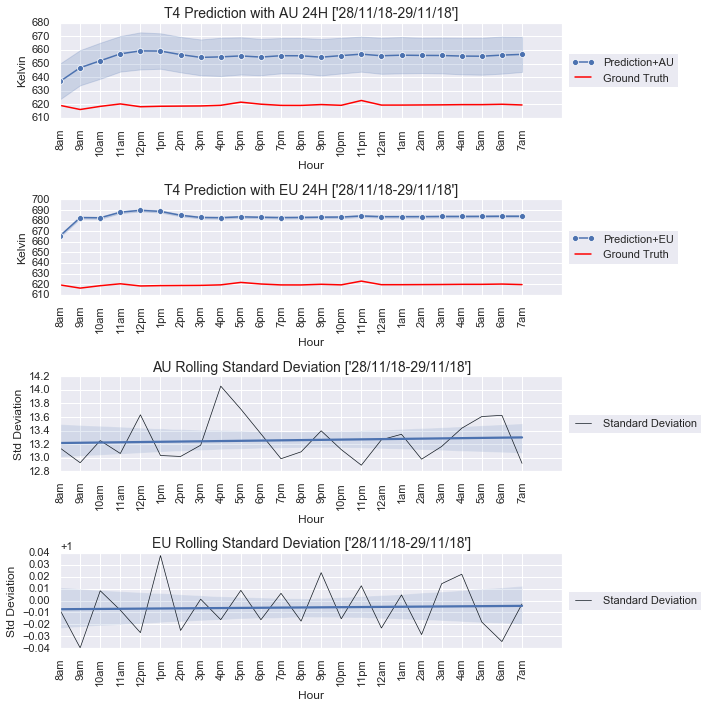

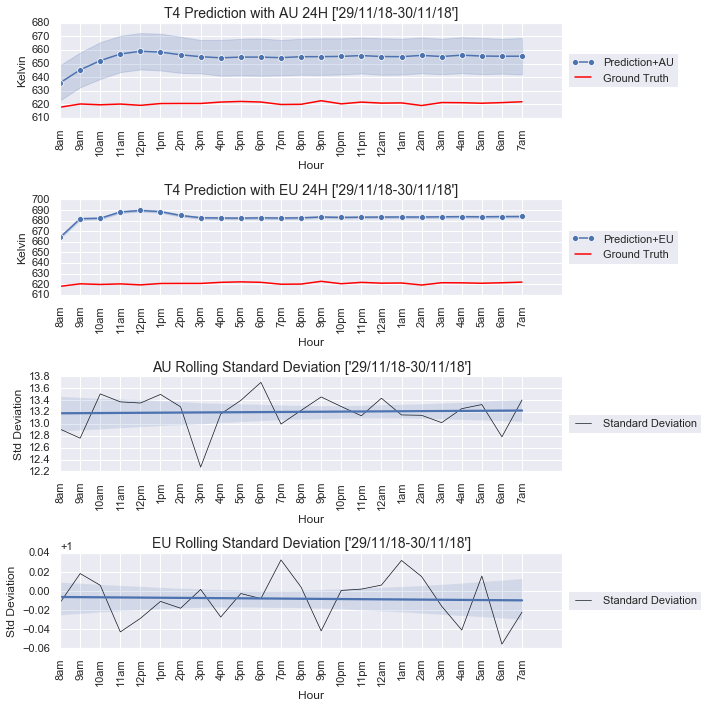

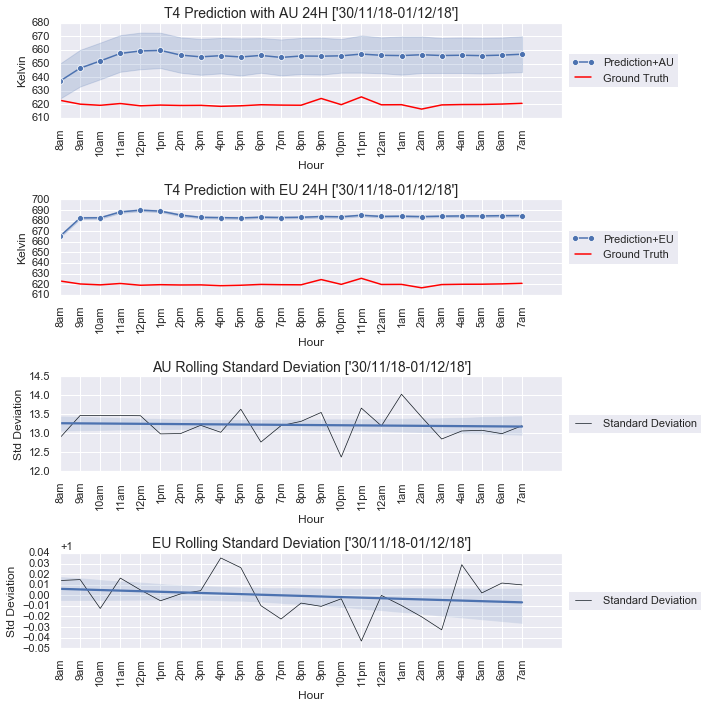

...

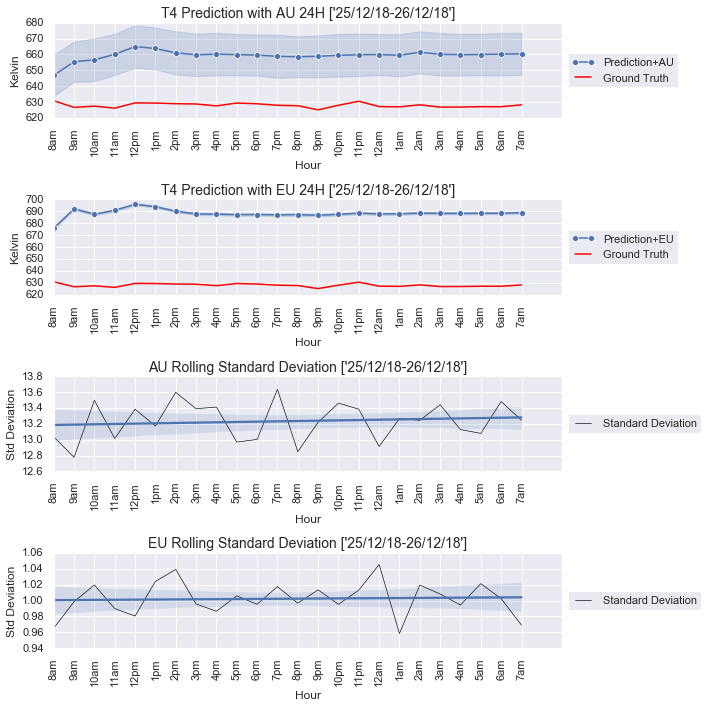

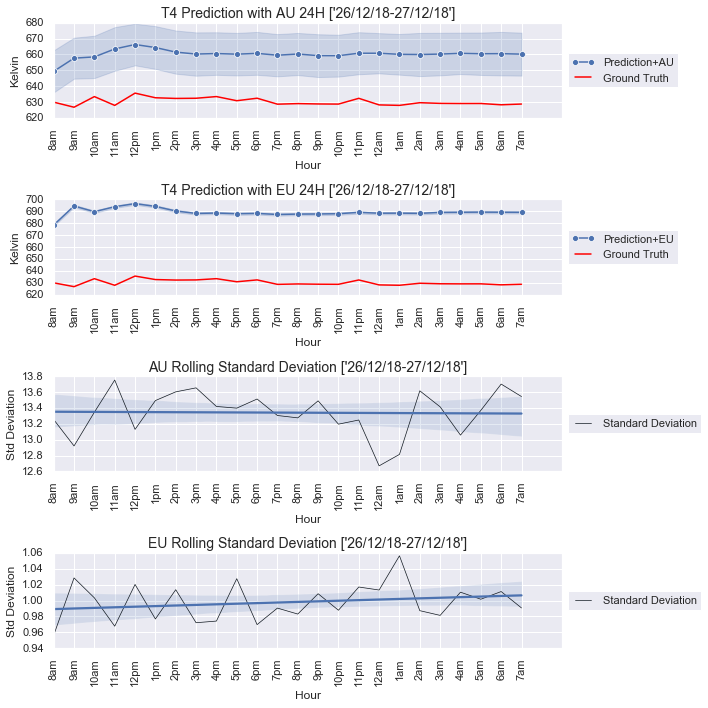

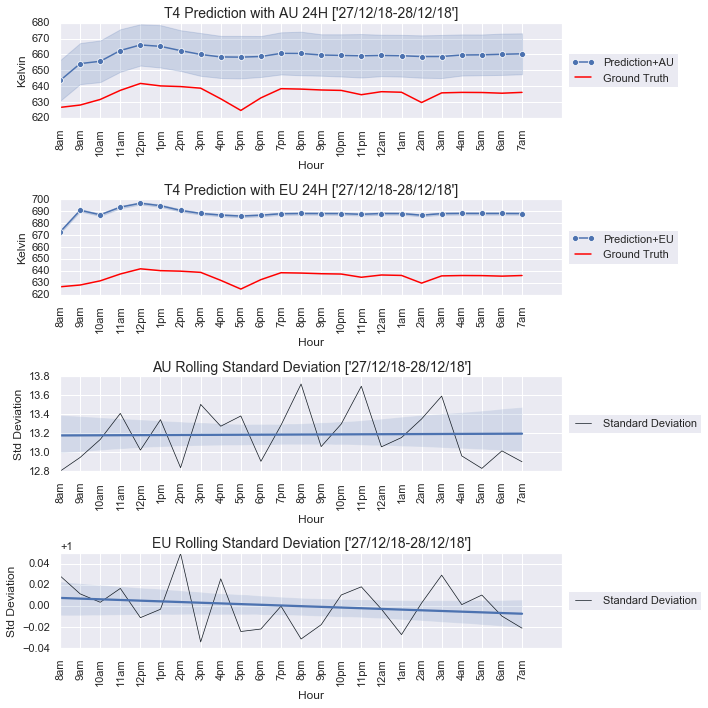

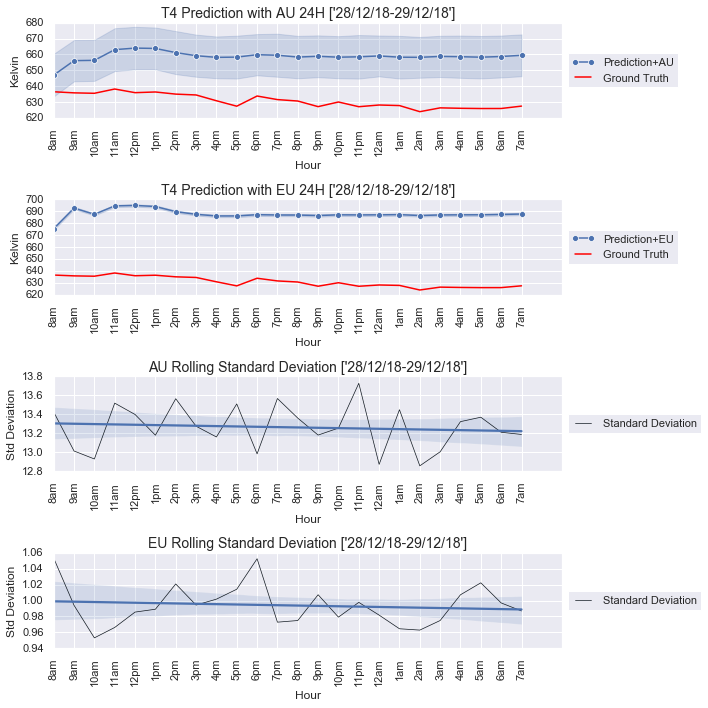

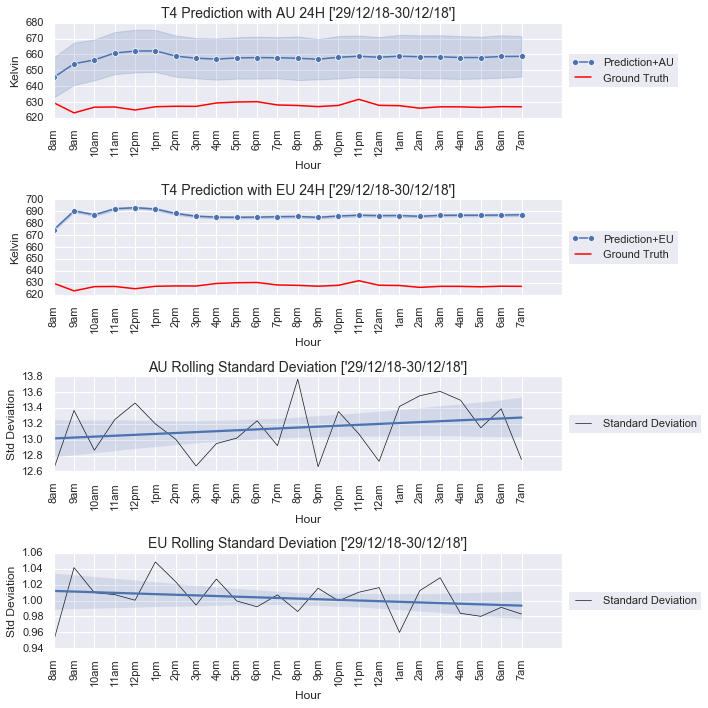

In [44]:
#Prediction Visualization

import seaborn as sns
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes 
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from scipy import stats
sns.set()
for B in range(34):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Kelvin']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Hour','Kelvin']
    
    max_Seq_Arrange1.columns = ['Hour','Kelvin']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Hour','Kelvin']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Hour','Kelvin']
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Kelvin'])
    gs = gridspec.GridSpec(4,1)
    fig = plt.figure(figsize=(10,10))
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Kelvin",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="Prediction+AU")
    sns.lineplot(x="Hour", y="Kelvin", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('T4 Prediction with AU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[1])
    sns.lineplot(x="Hour", y="Kelvin",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="Prediction+EU")
    sns.lineplot(x="Hour", y="Kelvin", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('T4 Prediction with EU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    

    ax = fig.add_subplot(gs[2])
    ax.plot('Hour', 'Kelvin', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Kelvin'],scatter = False)
    plt.title('AU Rolling Standard Deviation ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[3])
    ax.plot('Hour', 'Kelvin', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Hour'],med_Std_Arrange['Kelvin'],scatter = False)
    plt.title('EU Rolling Standard Deviation ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

In [45]:
#SHAP cannot be used with model with probabilistic layers. So, define non probabilistic f'x

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 386)           603704    
_________________________________________________________________
dense_2 (Dense)              (None, 24, 486)           188082    
_________________________________________________________________
dense_3 (Dense)              (None, 24, 1)             487       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 792,273
Trainable params: 792,273
Non-trainable params: 0
_________________________________________________________________


In [46]:
#Extract only "Mean" weights, exclude "Standard Deviation" weights

a = model.layers[3].get_weights()

b = np.zeros((len(a[0]),1))
for x in range(len(a[0])):
    b[x] = a[0][x][0]
    
d = np.zeros(1)
for x in range(1):
    d[x] = a[1][x]
    
c = [b,d]

In [47]:
#Transfer weights from fx to f'x

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(c)

In [48]:
#Prediction with f'x

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [49]:
#Import SHAP & initialized JS for f'x explanation

import shap
shap.initjs()

In [50]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [51]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

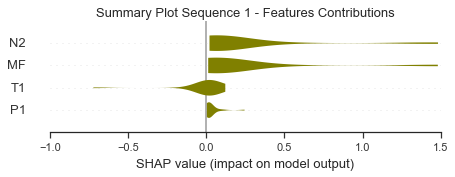

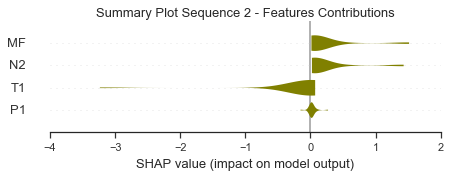

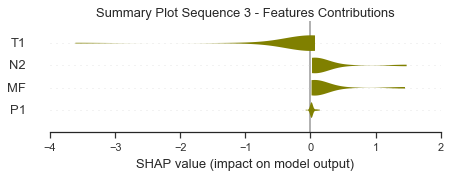

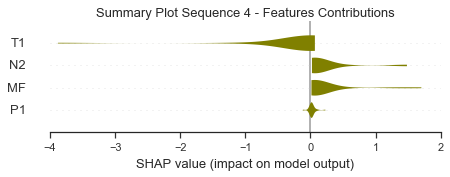

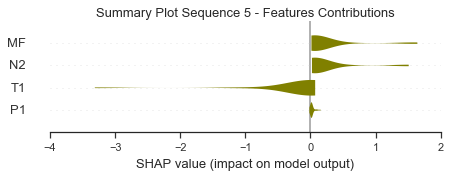

...

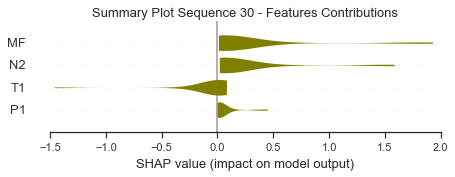

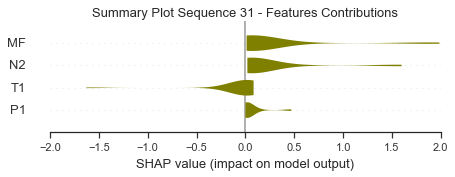

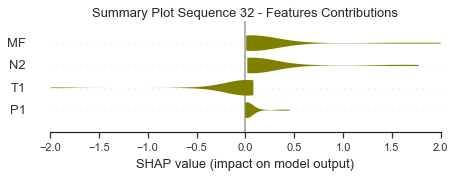

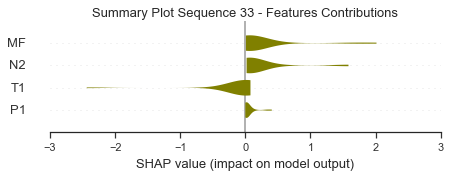

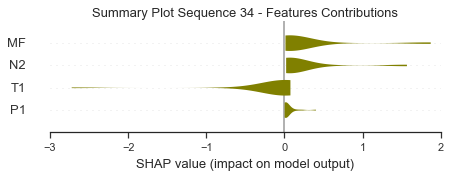

In [52]:
#SHAP Summmary Plot
sns.set_style('ticks')
instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="violin", color='olive')
    plt.title("Summary Plot Sequence %i - Features Contributions" %(i+1),fontsize=13)
    plt.figure
    plt.show()

In [53]:
#SHAP Force Plot - Matplotlib
import seaborn as sns
sns.set_style("ticks")
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    # Per individual array 
    for j in range(24):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,4),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


3 1


3 2


3 3


3 4


3 5


3 6


3 7


3 8


3 9


3 10


3 11


3 12


3 13


3 14


3 15


3 16


3 17


3 18


3 19


3 20


3 21


3 22


3 23


3 24


4 1


4 2


4 3


4 4


4 5


4 6


4 7


4 8


4 9


4 10


4 11


4 12


4 13


4 14


4 15


4 16


4 17


4 18


4 19


4 20


4 21


4 22


4 23


4 24


5 1


5 2


5 3


5 4


5 5


5 6


5 7


5 8


5 9


5 10


5 11


5 12


5 13


5 14


5 15


5 16


5 17


5 18


5 19


5 20


5 21


5 22


5 23


5 24


6 1


6 2


6 3


6 4


6 5


6 6


6 7


6 8


6 9


6 10


6 11


6 12


6 13


6 14


6 15


6 16


6 17


6 18


6 19


6 20


6 21


6 22


6 23


6 24


7 1


7 2


7 3


7 4


7 5


7 6


7 7


7 8


7 9


7 10


7 11


7 12


7 13


7 14


7 15


7 16


7 17


7 18


7 19


7 20


7 21


7 22


7 23


7 24


8 1


8 2


8 3


8 4


8 5


8 6


8 7


8 8


8 9


8 10


8 11


8 12


8 13


8 14


8 15


8 16


8 17


8 18


8 19


8 20


8 21


8 22


8 23


8 24


9 1


9 2


9 3


9 4


9 5


9 6


9 7


9 8


9 9


9 10


9 11


9 12


9 13


9 14


9 15


9 16


9 17


9 18


9 19


9 20


9 21


9 22


9 23


9 24


10 1


10 2


10 3


10 4


10 5


10 6


10 7


10 8


10 9


10 10


10 11


10 12


10 13


10 14


10 15


10 16


10 17


10 18


10 19


10 20


10 21


10 22


10 23


10 24


11 1


11 2


11 3


11 4


11 5


11 6


11 7


11 8


11 9


11 10


11 11


11 12


11 13


11 14


11 15


11 16


11 17


11 18


11 19


11 20


11 21


11 22


11 23


11 24


12 1


12 2


12 3


12 4


12 5


12 6


12 7


12 8


12 9


12 10


12 11


12 12


12 13


12 14


12 15


12 16


12 17


12 18


12 19


12 20


12 21


12 22


12 23


12 24


13 1


13 2


13 3


13 4


13 5


13 6


13 7


13 8


13 9


13 10


13 11


13 12


13 13


13 14


13 15


13 16


13 17


13 18


13 19


13 20


13 21


13 22


13 23


13 24


14 1


14 2


14 3


14 4


14 5


14 6


14 7


14 8


14 9


14 10


14 11


14 12


14 13


14 14


14 15


14 16


14 17


14 18


14 19


14 20


14 21


14 22


14 23


14 24


15 1


15 2


15 3


15 4


15 5


15 6


15 7


15 8


15 9


15 10


15 11


15 12


15 13


15 14


15 15


15 16


15 17


15 18


15 19


15 20


15 21


15 22


15 23


15 24


16 1


16 2


16 3


16 4


16 5


16 6


16 7


16 8


16 9


16 10


16 11


16 12


16 13


16 14


16 15


16 16


16 17


16 18


16 19


16 20


16 21


16 22


16 23


16 24


17 1


17 2


17 3


17 4


17 5


17 6


17 7


17 8


17 9


17 10


17 11


17 12


17 13


17 14


17 15


17 16


17 17


17 18


17 19


17 20


17 21


17 22


17 23


17 24


18 1


18 2


18 3


18 4


18 5


18 6


18 7


18 8


18 9


18 10


18 11


18 12


18 13


18 14


18 15


18 16


18 17


18 18


18 19


18 20


18 21


18 22


18 23


18 24


19 1


19 2


19 3


19 4


19 5


19 6


19 7


19 8


19 9


19 10


19 11


19 12


19 13


19 14


19 15


19 16


19 17


19 18


19 19


19 20


19 21


19 22


19 23


19 24


20 1


20 2


20 3


20 4


20 5


20 6


20 7


20 8


20 9


20 10


20 11


20 12


20 13


20 14


20 15


20 16


20 17


20 18


20 19


20 20


20 21


20 22


20 23


20 24


21 1


21 2


21 3


21 4


21 5


21 6


21 7


21 8


21 9


21 10


21 11


21 12


21 13


21 14


21 15


21 16


21 17


21 18


21 19


21 20


21 21


21 22


21 23


21 24


22 1


22 2


22 3


22 4


22 5


22 6


22 7


22 8


22 9


22 10


22 11


22 12


22 13


22 14


22 15


22 16


22 17


22 18


22 19


22 20


22 21


22 22


22 23


22 24


23 1


23 2


23 3


23 4


23 5


23 6


23 7


23 8


23 9


23 10


23 11


23 12


23 13


23 14


23 15


23 16


23 17


23 18


23 19


23 20


23 21


23 22


23 23


23 24


24 1


24 2


24 3


24 4


24 5


24 6


24 7


24 8


24 9


24 10


24 11


24 12


24 13


24 14


24 15


24 16


24 17


24 18


24 19


24 20


24 21


24 22


24 23


24 24


25 1


25 2


25 3


25 4


25 5


25 6


25 7


25 8


25 9


25 10


25 11


25 12


25 13


25 14


25 15


25 16


25 17


25 18


25 19


25 20


25 21


25 22


25 23


25 24


26 1


26 2


26 3


26 4


26 5


26 6


26 7


26 8


26 9


26 10


26 11


26 12


26 13


26 14


26 15


26 16


26 17


26 18


26 19


26 20


26 21


26 22


26 23


26 24


27 1


27 2


27 3


27 4


27 5


27 6


27 7


27 8


27 9


27 10


27 11


27 12


27 13


27 14


27 15


27 16


27 17


27 18


27 19


27 20


27 21


27 22


27 23


27 24


28 1


28 2


28 3


28 4


28 5


28 6


28 7


28 8


28 9


28 10


28 11


28 12


28 13


28 14


28 15


28 16


28 17


28 18


28 19


28 20


28 21


28 22


28 23


28 24


29 1


29 2


29 3


29 4


29 5


29 6


29 7


29 8


29 9


29 10


29 11


29 12


29 13


29 14


29 15


29 16


29 17


29 18


29 19


29 20


29 21


29 22


29 23


29 24


30 1


30 2


30 3


30 4


30 5


30 6


30 7


30 8


30 9


30 10


30 11


30 12


30 13


30 14


30 15


30 16


30 17


30 18


30 19


30 20


30 21


30 22


30 23


30 24


31 1


31 2


31 3


31 4


31 5


31 6


31 7


31 8


31 9


31 10


31 11


31 12


31 13


31 14


31 15


31 16


31 17


31 18


31 19


31 20


31 21


31 22


31 23


31 24


32 1


32 2


32 3


32 4


32 5


32 6


32 7


32 8


32 9


32 10


32 11


32 12


32 13


32 14


32 15


32 16


32 17


32 18


32 19


32 20


32 21


32 22


32 23


32 24


33 1


33 2


33 3


33 4


33 5


33 6


33 7


33 8


33 9


33 10


33 11


33 12


33 13


33 14


33 15


33 16


33 17


33 18


33 19


33 20


33 21


33 22


33 23


33 24


34 1


34 2


34 3


34 4


34 5


34 6


34 7


34 8


34 9


34 10


34 11


34 12


34 13


34 14


34 15


34 16


34 17


34 18


34 19


34 20


34 21


34 22


34 23


34 24


Contribution: [ 0.24508533 -0.08702466  1.48303422  1.4818893 ]


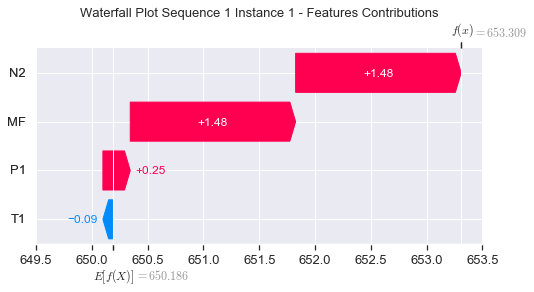

None

Contribution: [0.00355566 0.01871054 0.02038452 0.01211871]


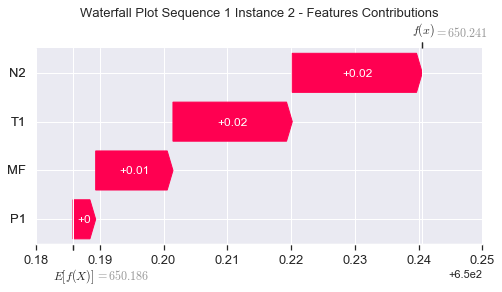

None

Contribution: [0.01205964 0.0115454  0.05515172 0.05218162]


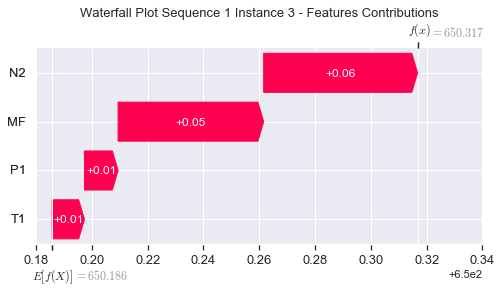

None

Contribution: [0.009797   0.01042498 0.04077729 0.03797091]


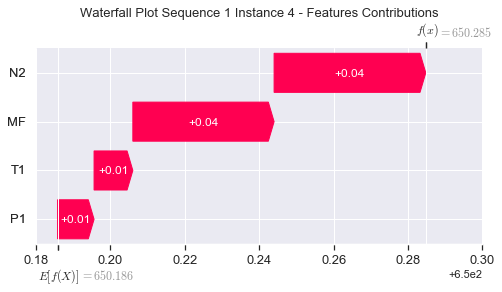

None

Contribution: [0.01162965 0.01308258 0.04421265 0.04062354]


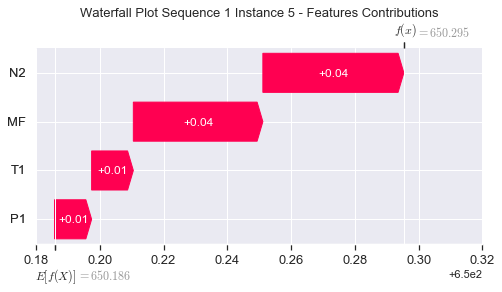

None

Contribution: [0.01390402 0.0148138  0.050459   0.04679293]


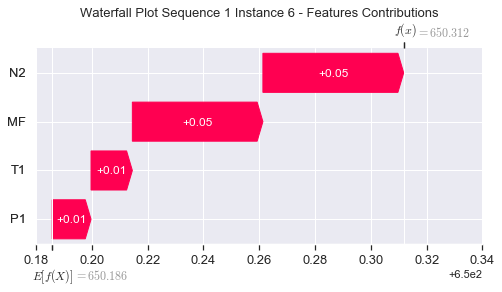

None

Contribution: [0.01482313 0.01578362 0.05311464 0.0495973 ]


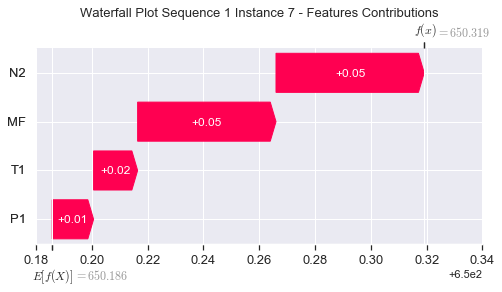

None

Contribution: [0.01489551 0.01580563 0.05284451 0.0495654 ]


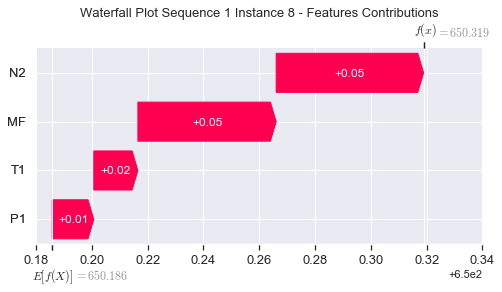

None

Contribution: [0.01453584 0.01644961 0.05097891 0.04848342]


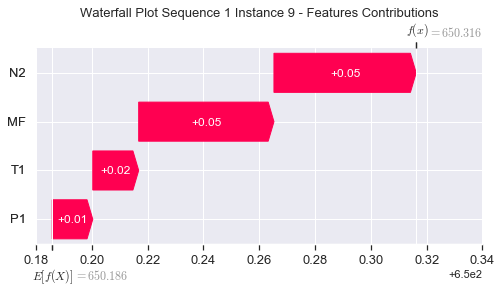

None

Contribution: [0.01413014 0.01538622 0.04959964 0.04729504]


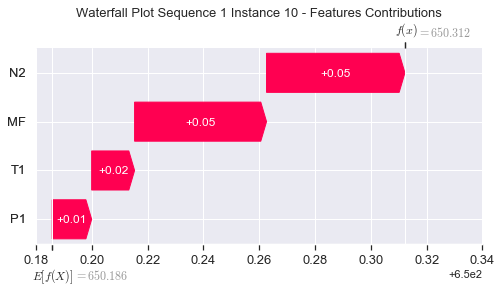

None

Contribution: [0.01447555 0.01534901 0.04973282 0.04733423]


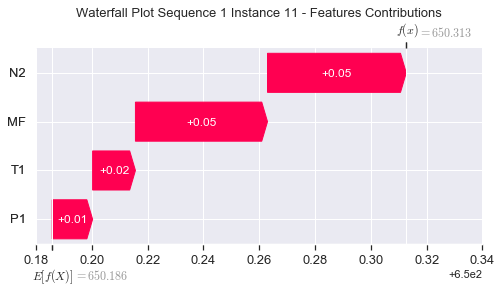

None

Contribution: [0.01428086 0.01464886 0.05010906 0.04764209]


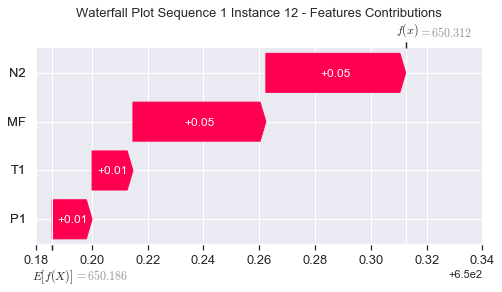

None

Contribution: [0.01458999 0.01506749 0.05100598 0.04853955]


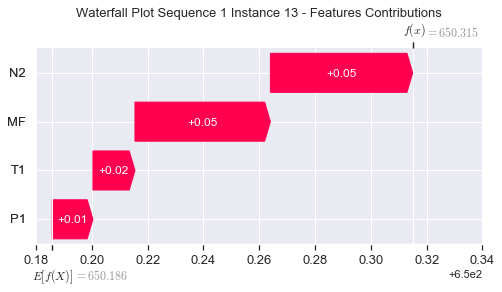

None

Contribution: [0.01557051 0.01539135 0.05247896 0.04986368]


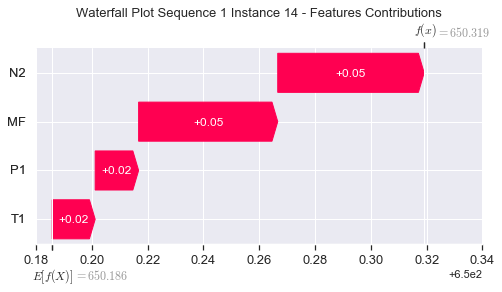

None

Contribution: [0.0157444  0.0159301  0.0543377  0.05180263]


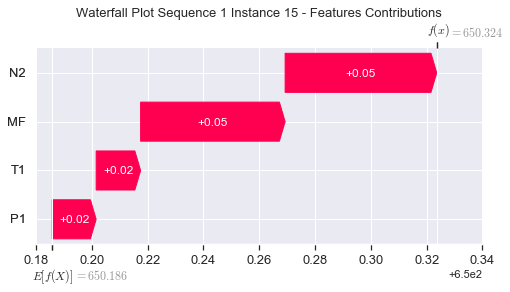

None

Contribution: [0.01637595 0.01673851 0.0568806  0.05516073]


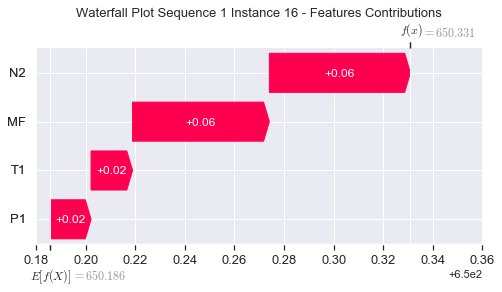

None

Contribution: [0.0174263  0.01771229 0.05981428 0.0569895 ]


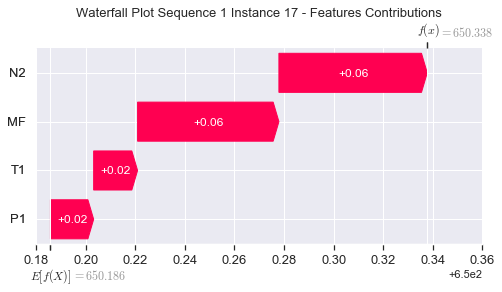

None

Contribution: [0.01881102 0.01893179 0.06429623 0.06109657]


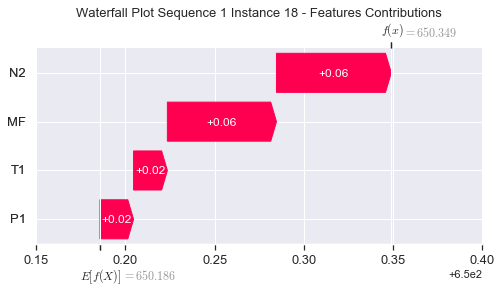

None

Contribution: [0.0203117  0.02070526 0.06988717 0.06629984]


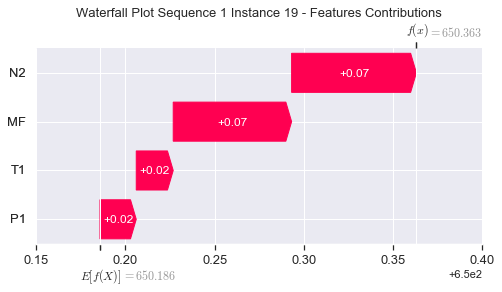

None

Contribution: [0.02576672 0.02666734 0.08685963 0.08143385]


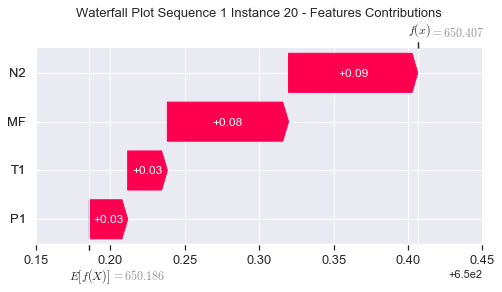

None

Contribution: [0.03703717 0.04262666 0.11671259 0.10648157]


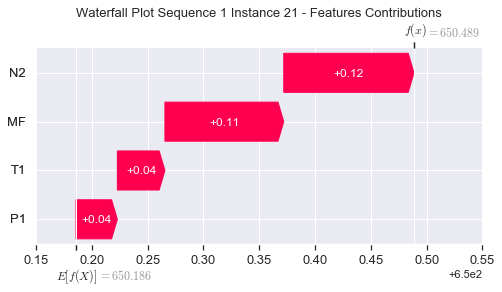

None

Contribution: [0.07954808 0.09033391 0.27536175 0.2533393 ]


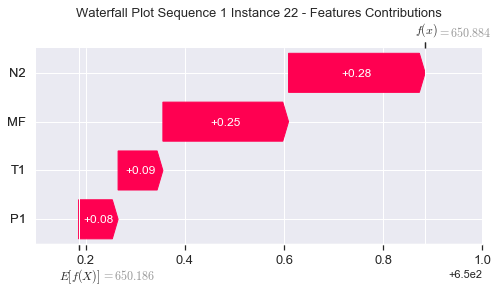

None

Contribution: [0.1072786  0.12147207 0.46328024 0.4323    ]


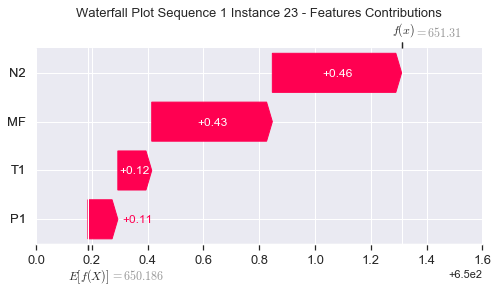

None

Contribution: [ 0.03791995 -0.72290342  1.38517998  1.47798222]


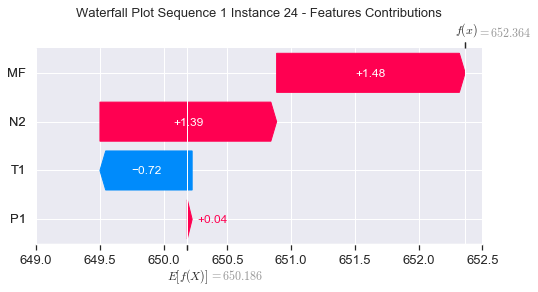

None

Contribution: [0.26992596 0.00264123 1.4312107  1.48382031]


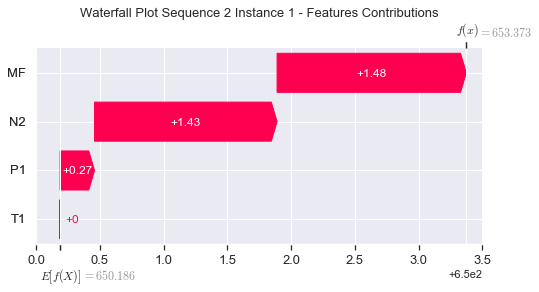

None

Contribution: [0.00518602 0.01551497 0.02251113 0.01484826]


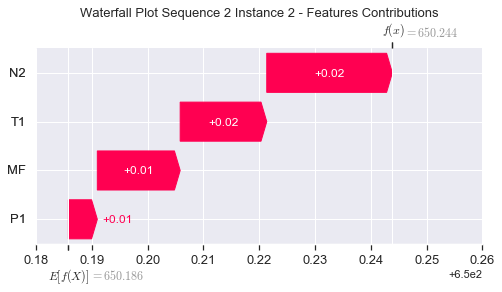

None

Contribution: [0.0122168  0.01174704 0.05529527 0.05349465]


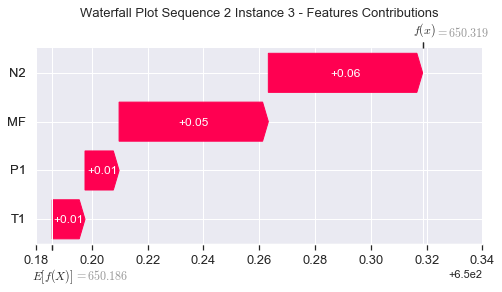

None

Contribution: [0.00970957 0.01078367 0.04098759 0.0371413 ]


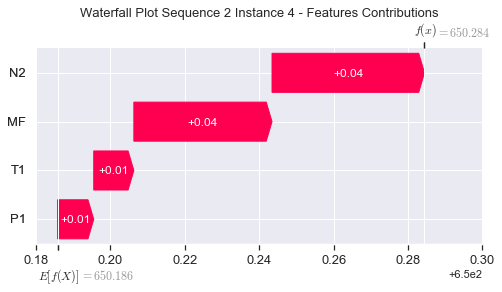

None

Contribution: [0.01174969 0.01008361 0.04527996 0.04243735]


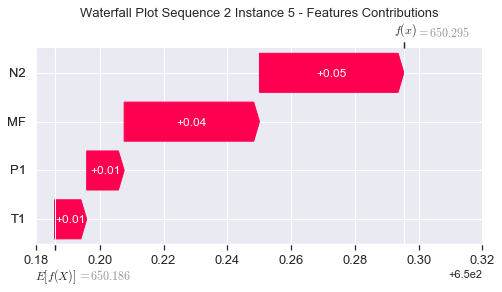

None

Contribution: [0.0139522  0.01138925 0.05170538 0.04839267]


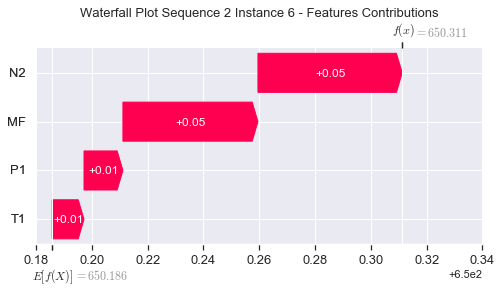

None

Contribution: [0.01498849 0.0120667  0.0545459  0.05118962]


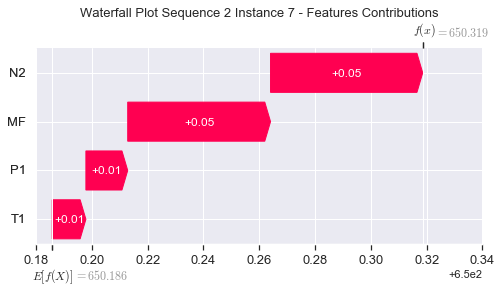

None

Contribution: [0.01503114 0.01206884 0.05433172 0.05126561]


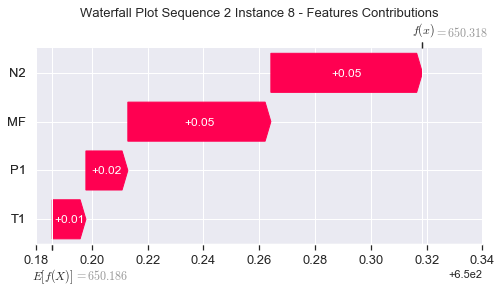

None

Contribution: [0.01463877 0.01126856 0.05261985 0.04968564]


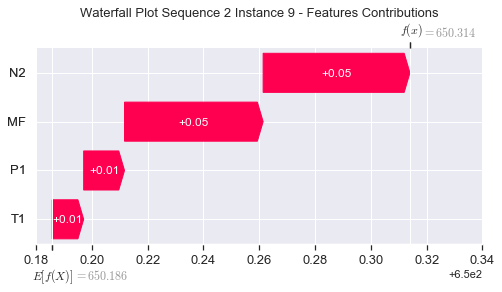

None

Contribution: [0.01428207 0.01081341 0.05136256 0.04863527]


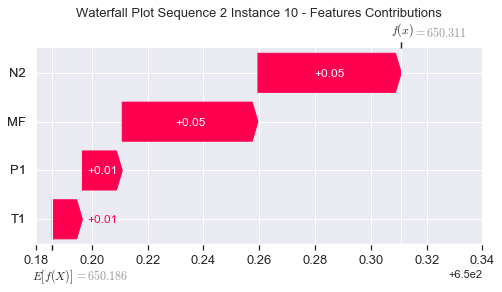

None

Contribution: [0.01436978 0.01076242 0.05116487 0.04855456]


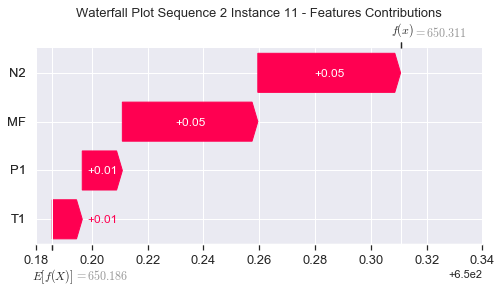

None

Contribution: [0.01448636 0.0102603  0.05144867 0.04871818]


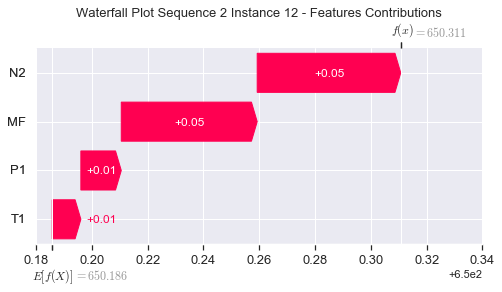

None

Contribution: [0.01484511 0.01057039 0.05245972 0.04974378]


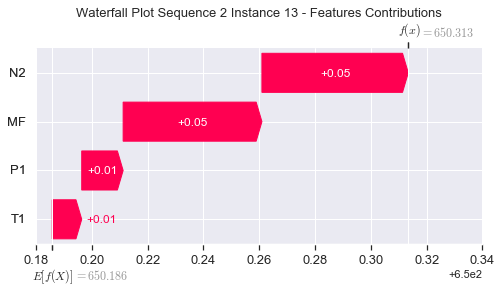

None

Contribution: [0.01540517 0.01046453 0.05398404 0.05121843]


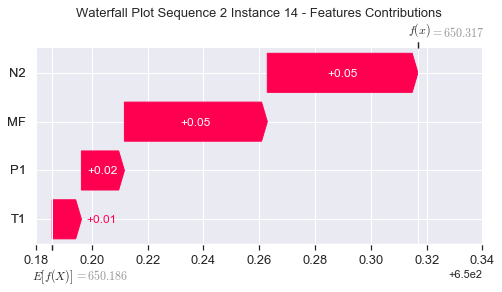

None

Contribution: [0.01596056 0.01112595 0.05595992 0.05310552]


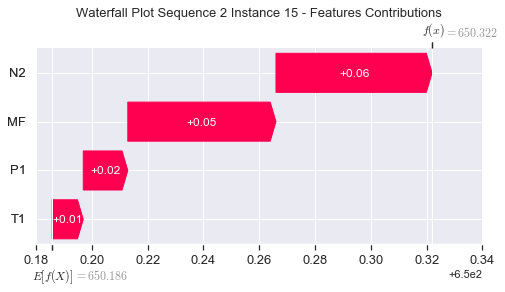

None

Contribution: [0.0166377  0.0118088  0.05863561 0.05595338]


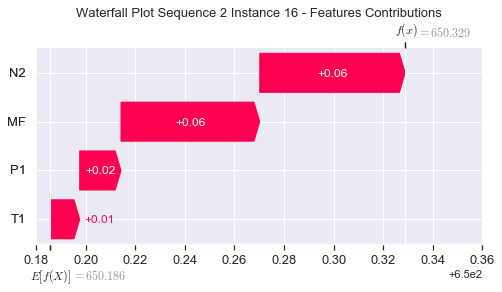

None

Contribution: [0.01774659 0.01218287 0.06174439 0.05852273]


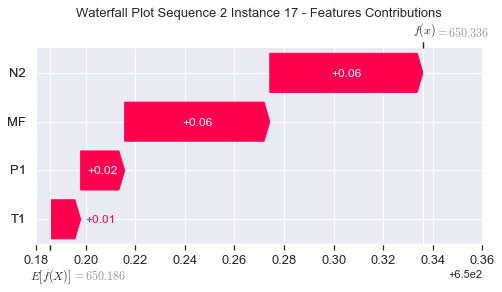

None

Contribution: [0.01912461 0.0132932  0.06635936 0.06282115]


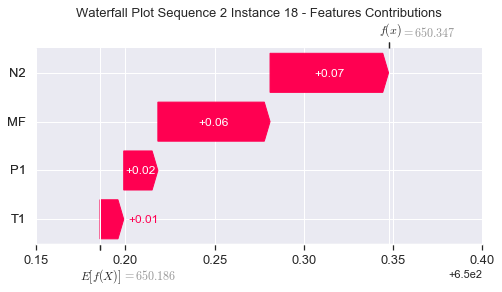

None

Contribution: [0.021107   0.01604475 0.07221377 0.0679981 ]


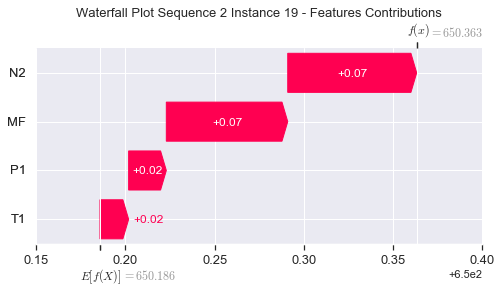

None

Contribution: [0.02643798 0.02286399 0.08976836 0.08413057]


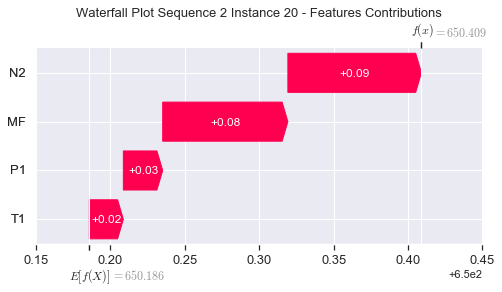

None

Contribution: [0.03854598 0.0530897  0.12101279 0.11056219]


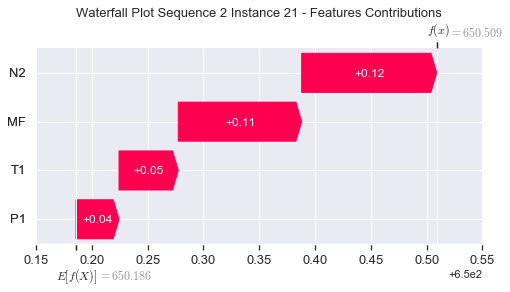

None

Contribution: [0.08021882 0.07190601 0.28198239 0.2597372 ]


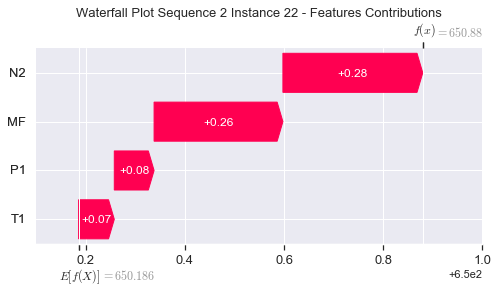

None

Contribution: [ 0.09745526 -0.06429327  0.47493483  0.44393644]


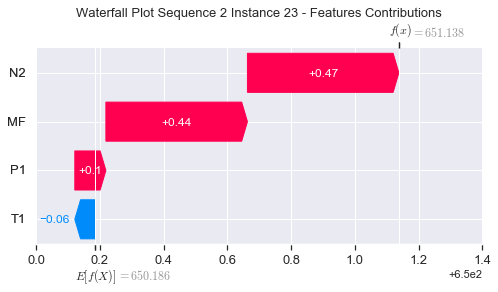

None

Contribution: [-0.15290263 -3.23527114  1.39241959  1.51467732]


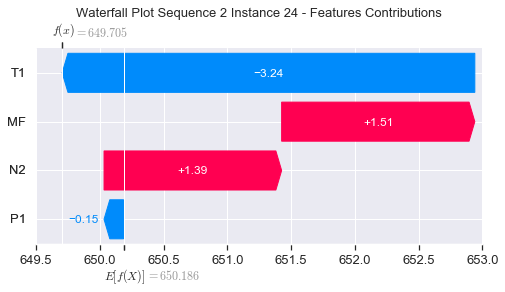

None

Contribution: [ 0.14323064 -0.88470062  1.47719968  1.45168159]


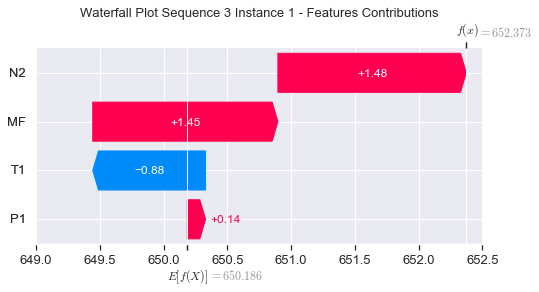

None

Contribution: [0.0061058  0.03957454 0.02362038 0.01640259]


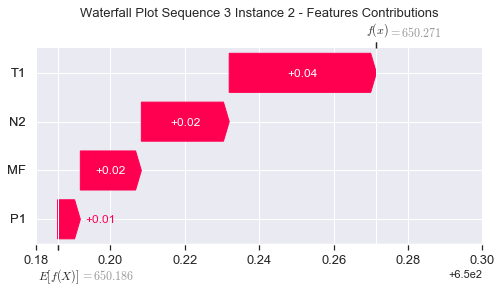

None

Contribution: [0.01175451 0.00128138 0.05609306 0.05246966]


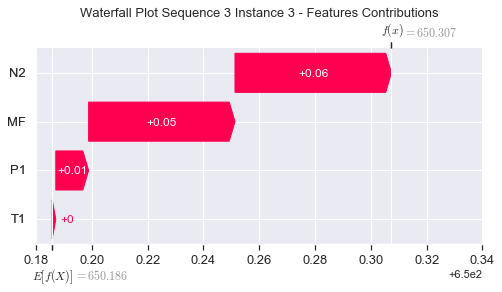

None

Contribution: [0.01003509 0.00401508 0.04184025 0.03844219]


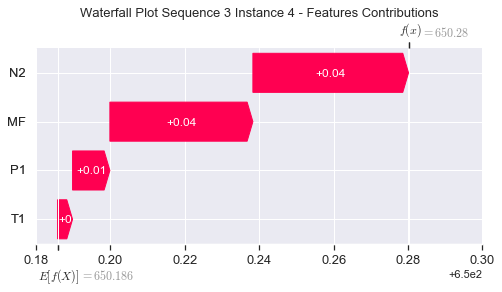

None

Contribution: [0.01187035 0.00759733 0.04564424 0.04181025]


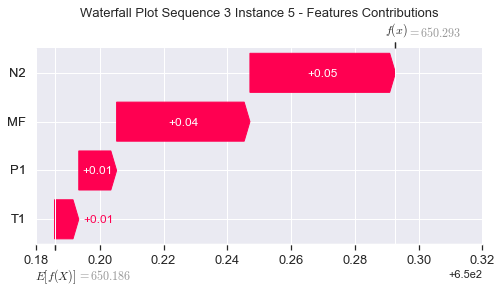

None

Contribution: [0.0140632  0.01002287 0.05219447 0.04813112]


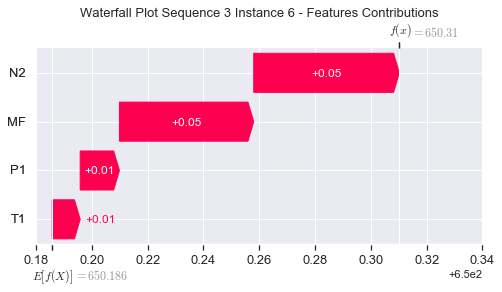

None

Contribution: [0.01504022 0.01090226 0.05487382 0.05086845]


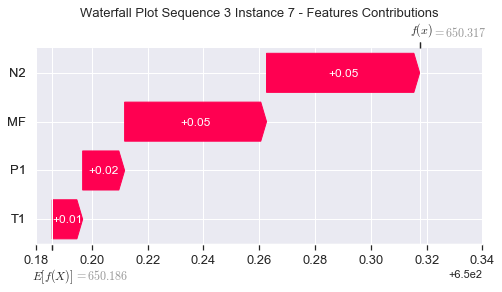

None

Contribution: [0.01509174 0.01097975 0.05457274 0.05085593]


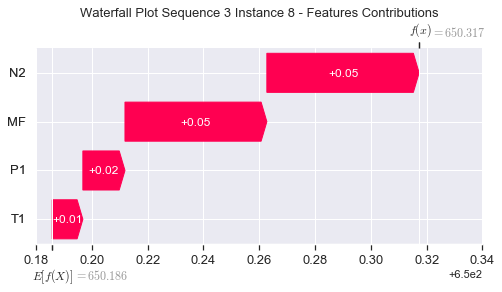

None

Contribution: [0.01451999 0.01128537 0.05245902 0.04881262]


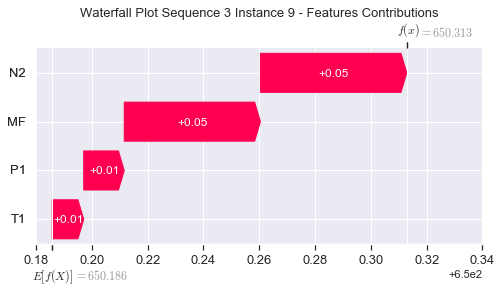

None

Contribution: [0.01440815 0.01184087 0.0513069  0.04829072]


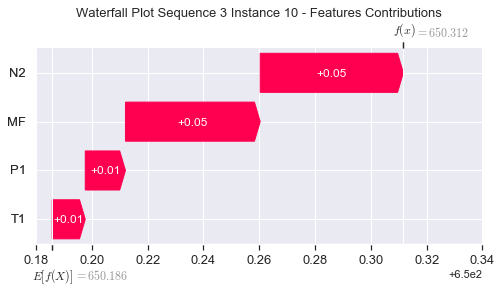

None

Contribution: [0.01447816 0.01113043 0.05119172 0.047995  ]


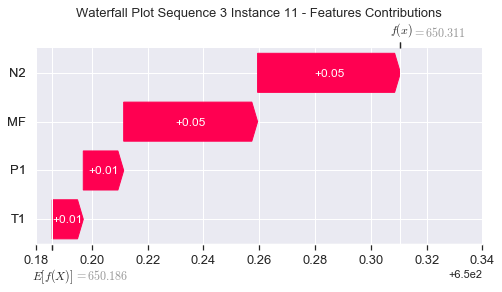

None

Contribution: [0.01469977 0.01016269 0.05169148 0.04876799]


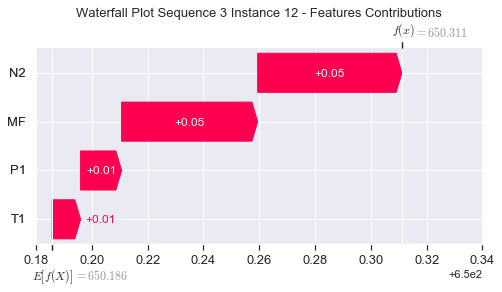

None

Contribution: [0.0150071  0.01031545 0.05263738 0.04970238]


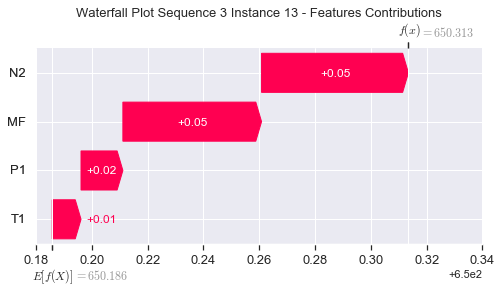

None

Contribution: [0.01518742 0.01099955 0.05430284 0.05125861]


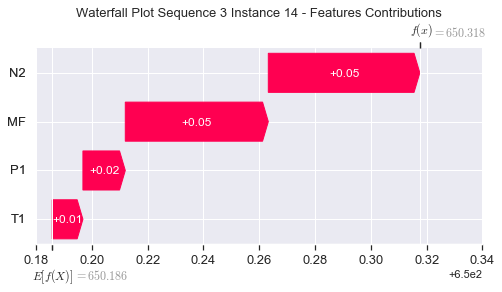

None

Contribution: [0.01606883 0.01091751 0.0561617  0.05314045]


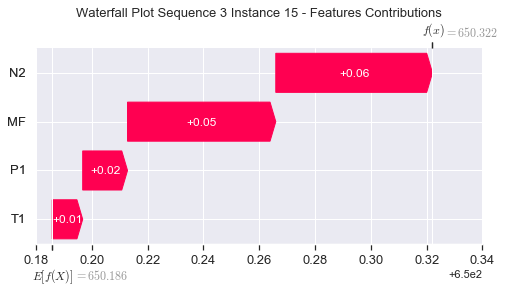

None

Contribution: [0.01719043 0.01165803 0.05906043 0.05678573]


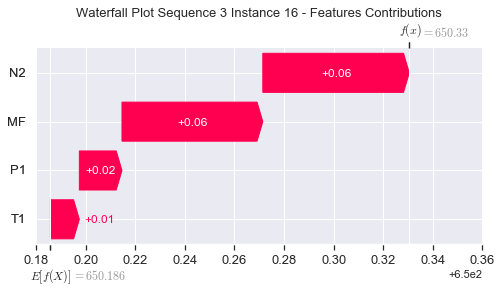

None

Contribution: [0.01784869 0.01214228 0.06203713 0.05869571]


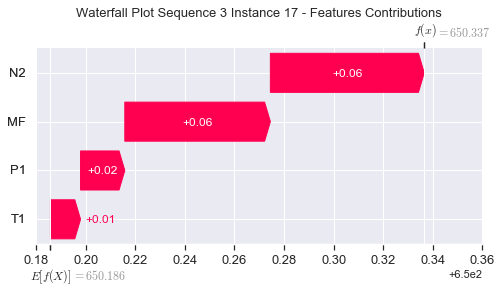

None

Contribution: [0.01927593 0.01324446 0.06680514 0.06314783]


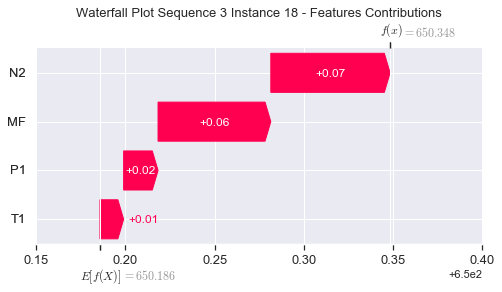

None

Contribution: [0.02145836 0.01530184 0.07285347 0.0685614 ]


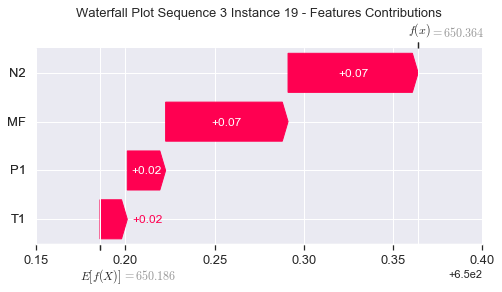

None

Contribution: [0.02660877 0.02257742 0.09040472 0.08457882]


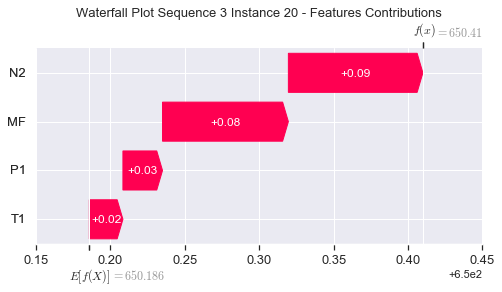

None

Contribution: [0.03876077 0.05434475 0.12173981 0.1114024 ]


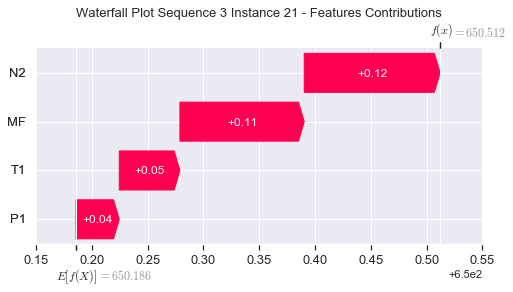

None

Contribution: [0.08078274 0.06945318 0.28353644 0.26079482]


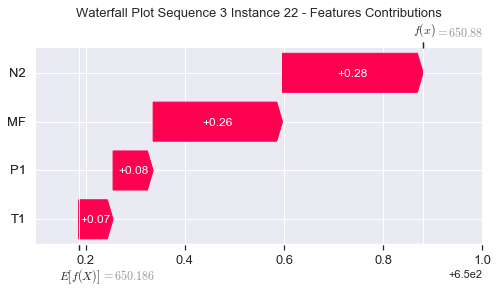

None

Contribution: [ 0.10110719 -0.07738093  0.48024571  0.44774249]


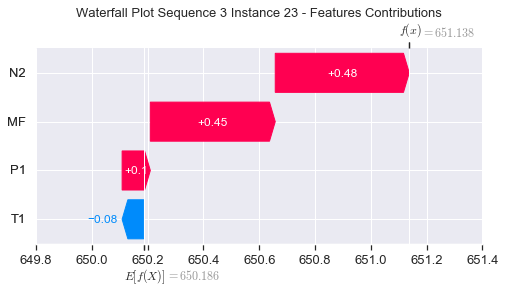

None

Contribution: [-0.07346047 -3.61117875  1.44187059  1.4163026 ]


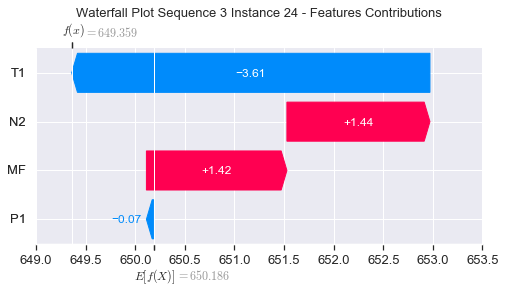

None

Contribution: [ 0.22925751 -1.00592848  1.48175349  1.28890083]


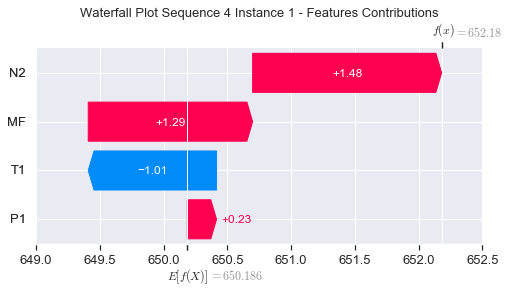

None

Contribution: [0.0049816  0.04159906 0.02280913 0.01511336]


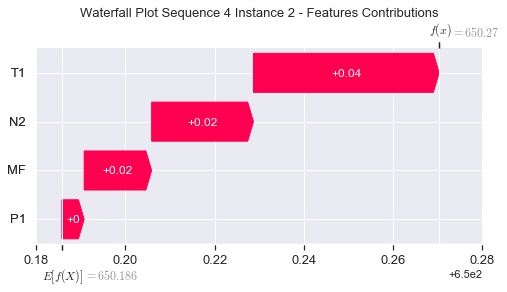

None

Contribution: [0.01139199 0.00167736 0.05626795 0.05312678]


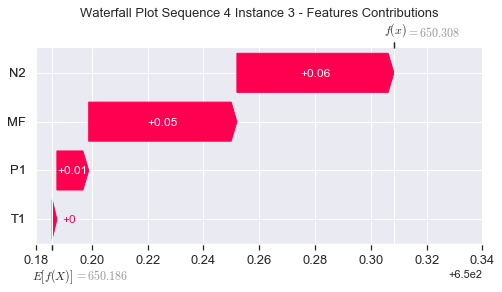

None

Contribution: [0.01022538 0.0046077  0.04196914 0.03852442]


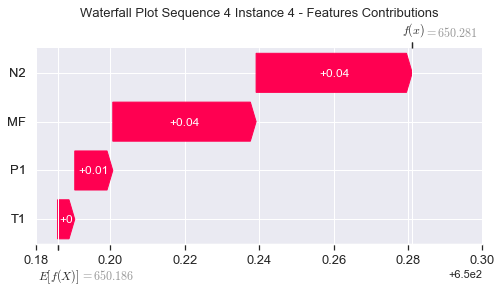

None

Contribution: [0.01198395 0.00719076 0.04578    0.04210205]


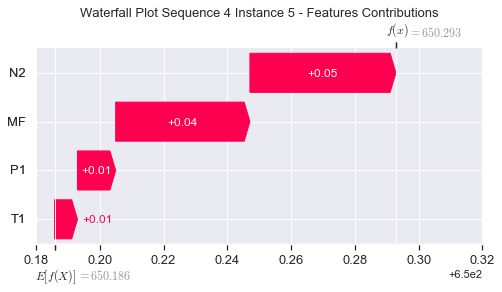

None

Contribution: [0.01426653 0.00913933 0.05236738 0.04873437]


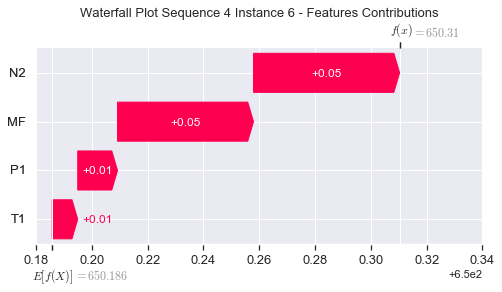

None

Contribution: [0.01527071 0.0101013  0.05505059 0.05141629]


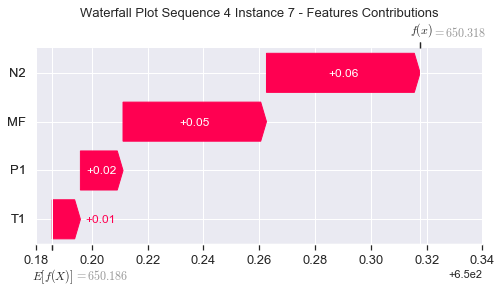

None

Contribution: [0.01523845 0.01014667 0.05474112 0.05145238]


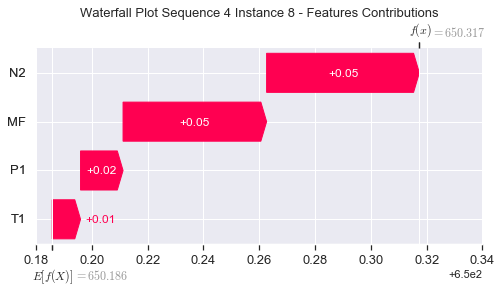

None

Contribution: [0.01448705 0.01022875 0.05275901 0.0499575 ]


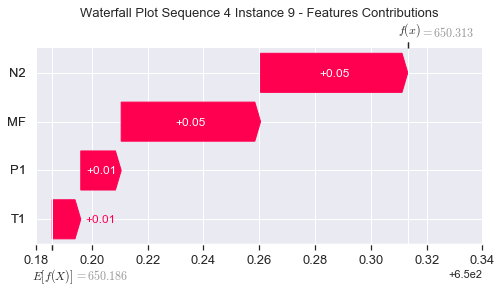

None

Contribution: [0.01456424 0.00938468 0.0514351  0.04895653]


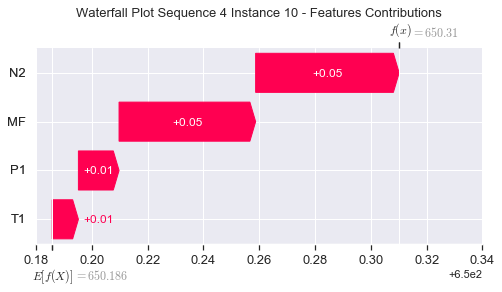

None

Contribution: [0.0142625  0.00968998 0.05141996 0.04909933]


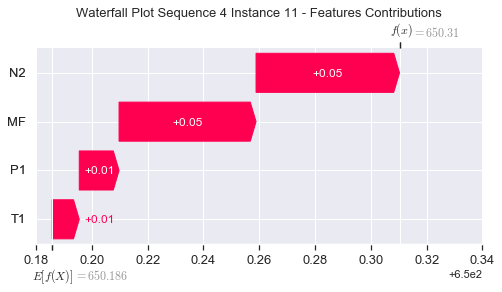

None

Contribution: [0.01470309 0.00947203 0.05180544 0.04908425]


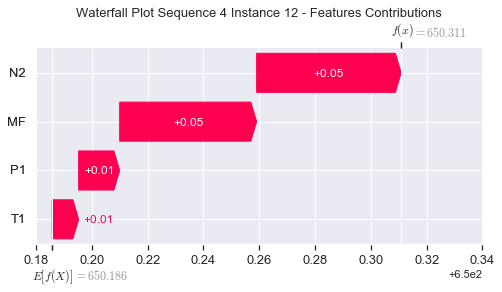

None

Contribution: [0.01503322 0.00967226 0.05270598 0.0499781 ]


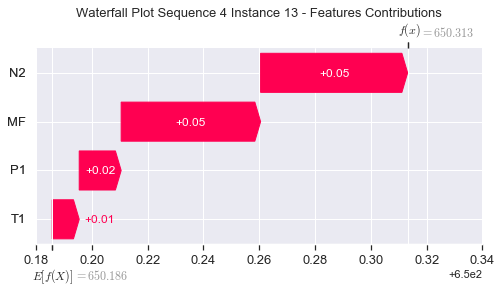

None

Contribution: [0.01545444 0.01023168 0.05452186 0.05249078]


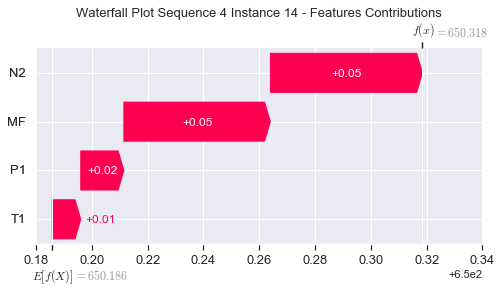

None

Contribution: [0.01616504 0.01017705 0.05634109 0.0536326 ]


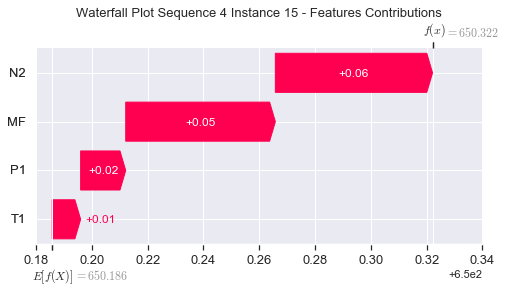

None

Contribution: [0.01682931 0.01094394 0.05903504 0.05624952]


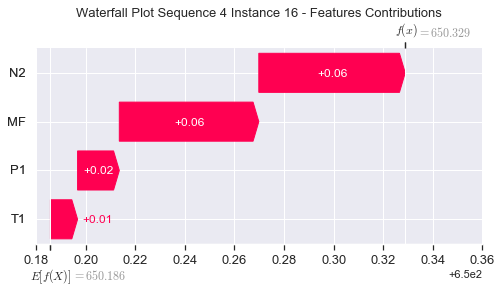

None

Contribution: [0.01799085 0.01137754 0.06223731 0.05928349]


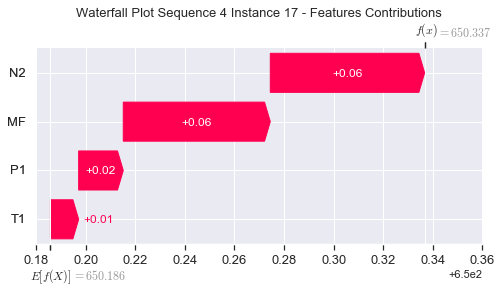

None

Contribution: [0.01940906 0.01242487 0.06698483 0.0637778 ]


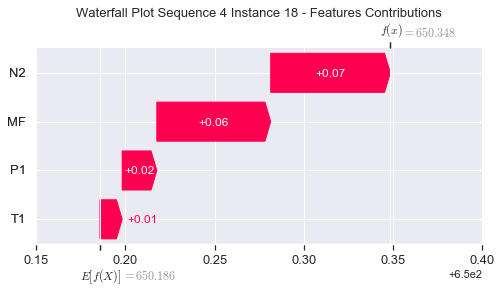

None

Contribution: [0.02157119 0.01531333 0.0728924  0.06827131]


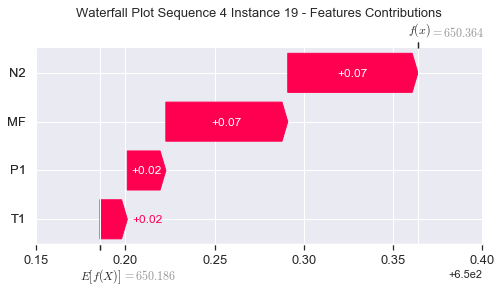

None

Contribution: [0.02674798 0.02215148 0.09061466 0.08512756]


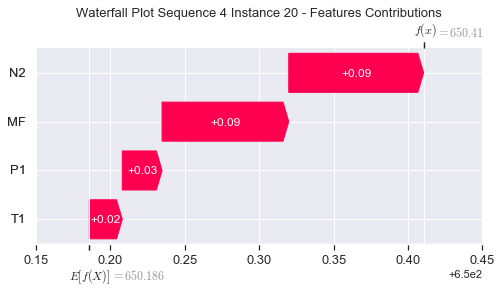

None

Contribution: [0.03878406 0.055337   0.12189935 0.11106665]


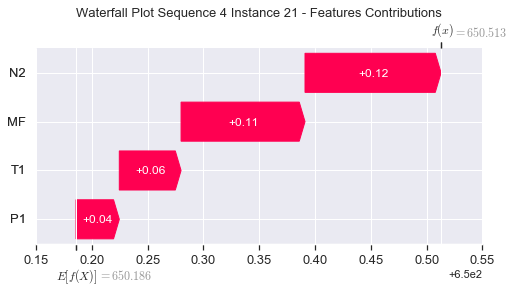

None

Contribution: [0.08081979 0.0676937  0.28394243 0.2623899 ]


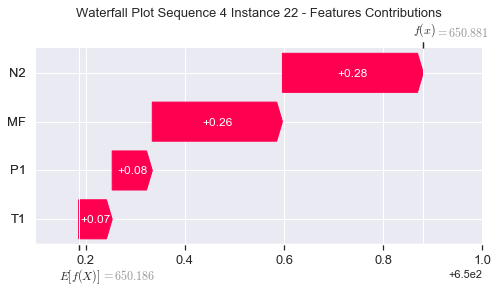

None

Contribution: [ 0.10045359 -0.0988533   0.48117966  0.45928467]


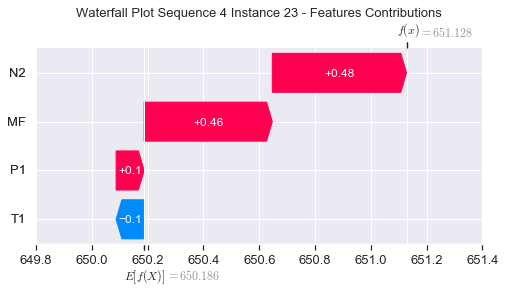

None

Contribution: [-0.11670775 -3.87931634  1.47133937  1.70347357]


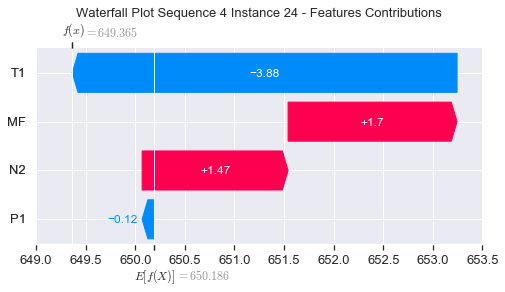

None

Contribution: [ 0.15631314 -1.04045232  1.50889943  1.52619437]


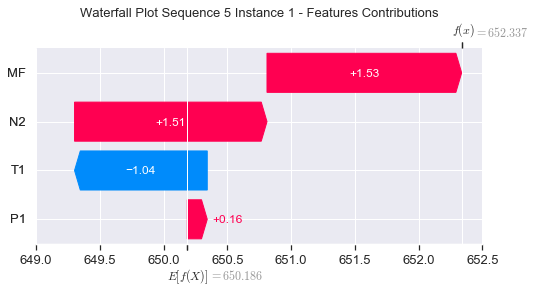

None

Contribution: [0.00590241 0.0420247  0.02294667 0.01498148]


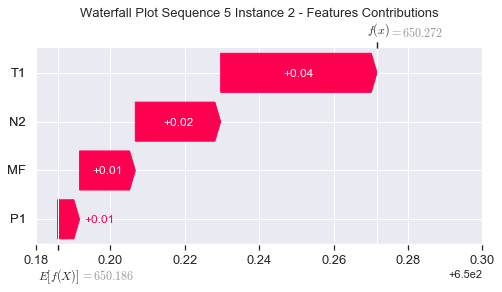

None

Contribution: [0.01131215 0.00113873 0.05594941 0.05347938]


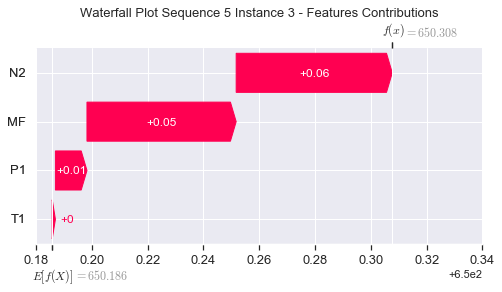

None

Contribution: [0.00971123 0.00460586 0.04176531 0.03864567]


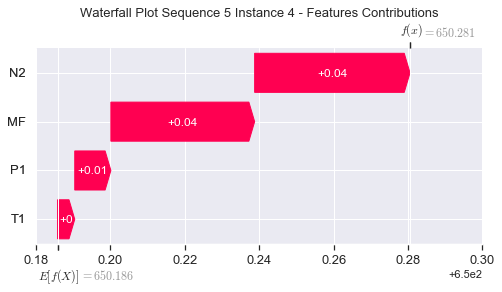

None

Contribution: [0.01161119 0.0073443  0.04557    0.04227985]


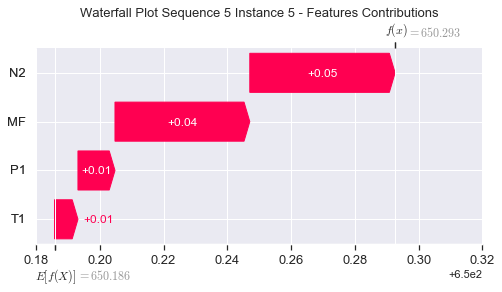

None

Contribution: [0.01393277 0.00972926 0.05211036 0.04873271]


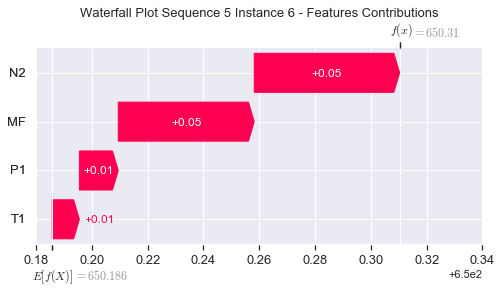

None

Contribution: [0.01491819 0.01061902 0.05475688 0.0513822 ]


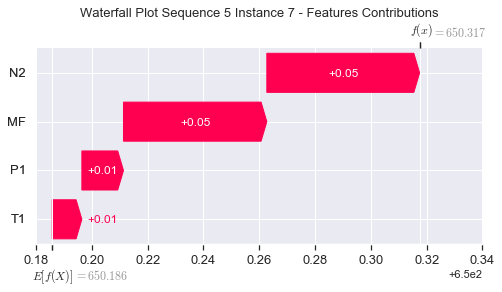

None

Contribution: [0.01496846 0.01076582 0.05447576 0.05136526]


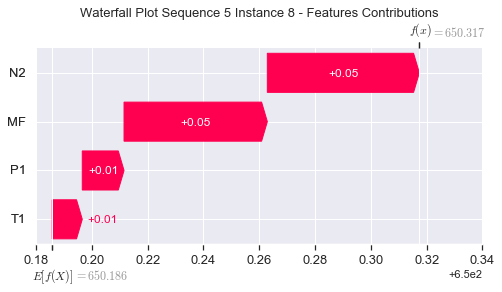

None

Contribution: [0.01444848 0.01077313 0.05241567 0.04950797]


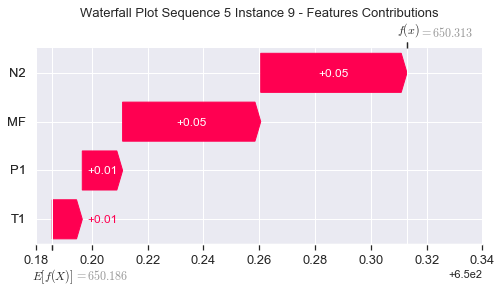

None

Contribution: [0.01391871 0.01046251 0.05107358 0.04831726]


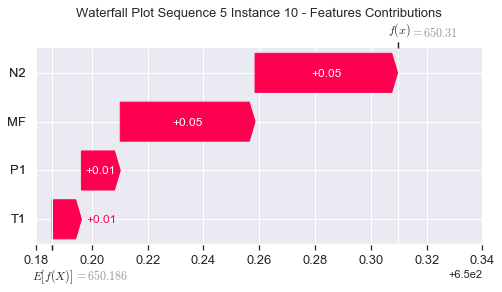

None

Contribution: [0.01426214 0.0108424  0.05111327 0.0485089 ]


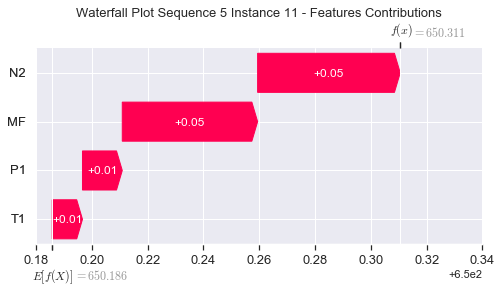

None

Contribution: [0.01444298 0.01016592 0.05154743 0.04893741]


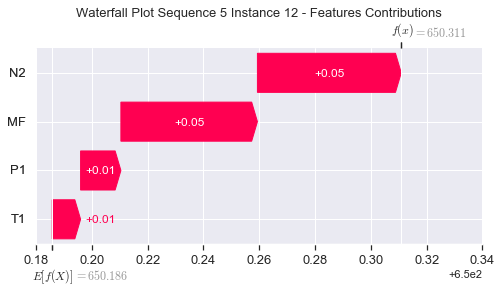

None

Contribution: [0.01477919 0.0102817  0.05243142 0.04983069]


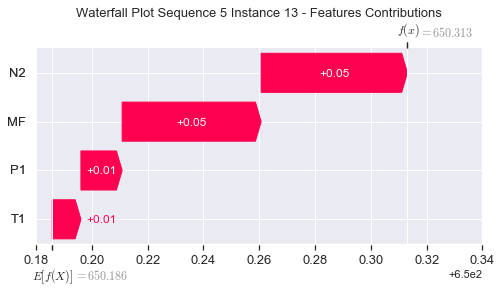

None

Contribution: [0.01553127 0.01067015 0.05428551 0.05200539]


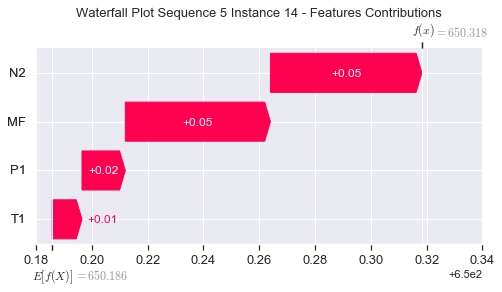

None

Contribution: [0.01593624 0.01103486 0.05591495 0.05329952]


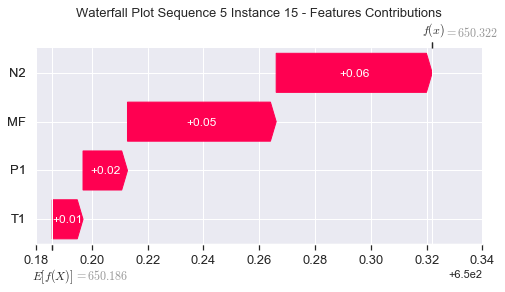

None

Contribution: [0.01713629 0.01141502 0.05899024 0.05802075]


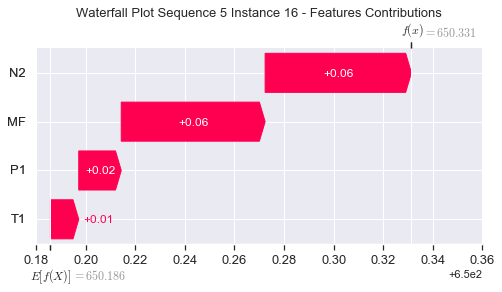

None

Contribution: [0.01780078 0.0123175  0.06177213 0.05883689]


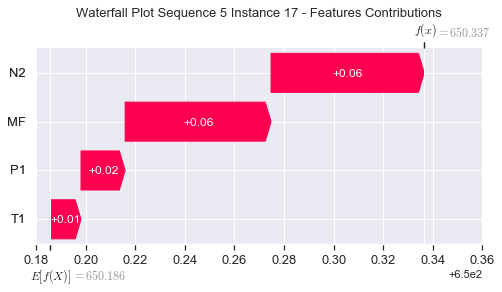

None

Contribution: [0.0192826  0.01350041 0.06658229 0.06334341]


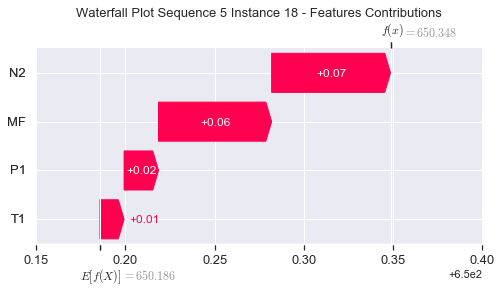

None

Contribution: [0.02127742 0.0155385  0.07228552 0.06835598]


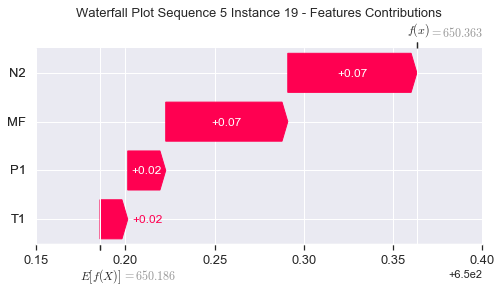

None

Contribution: [0.02661616 0.0228115  0.09001505 0.08450256]


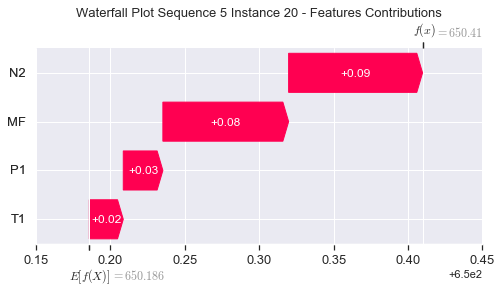

None

Contribution: [0.03845114 0.05359481 0.12102915 0.1103918 ]


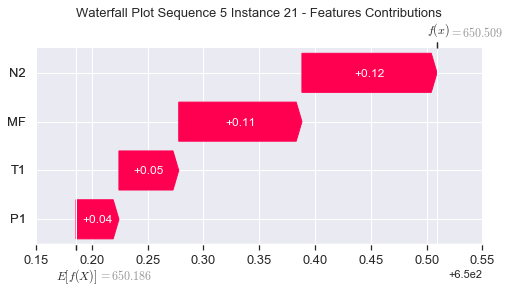

None

Contribution: [0.0808682  0.07208127 0.28253666 0.26050625]


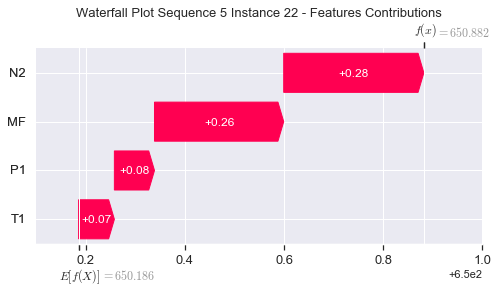

None

Contribution: [ 0.10480142 -0.05322426  0.47863278  0.4514961 ]


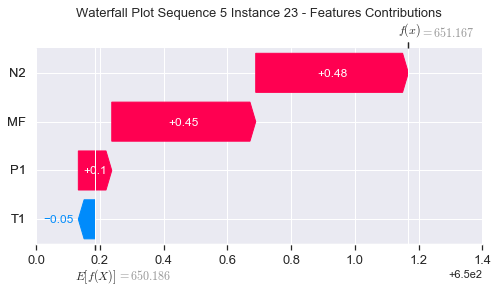

None

Contribution: [-0.0167363  -3.31286794  1.46935203  1.64158603]


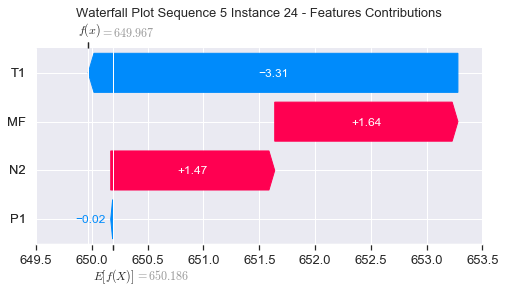

None

Contribution: [ 0.24336498 -0.89728835  1.50066148  1.52408597]


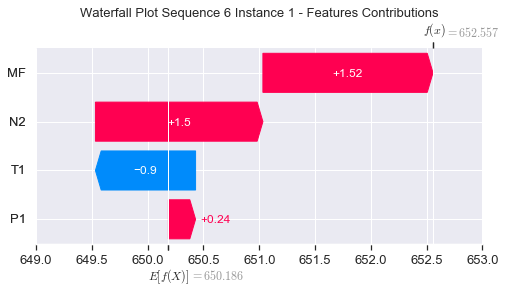

None

Contribution: [0.00517286 0.03795004 0.02258338 0.0153087 ]


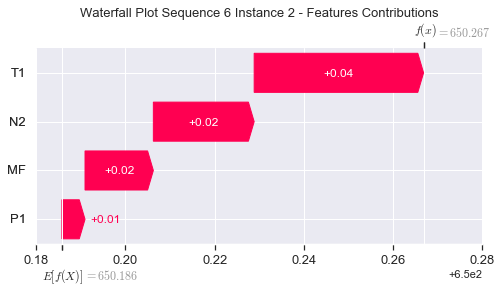

None

Contribution: [0.0116683  0.00385507 0.05657588 0.05358719]


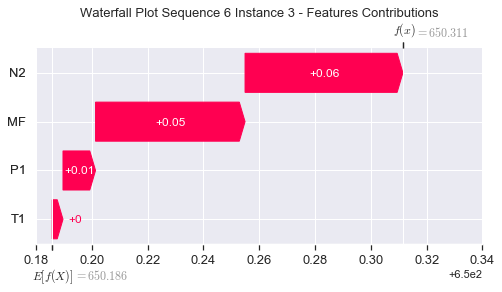

None

Contribution: [0.01001206 0.00545351 0.04196709 0.03811275]


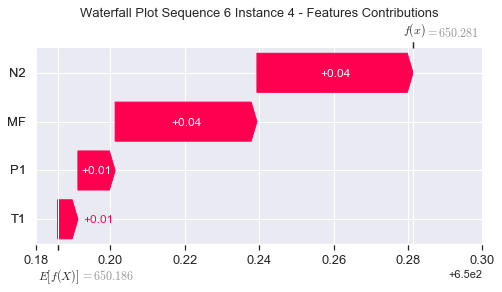

None

Contribution: [0.01192861 0.00865419 0.04592164 0.04225283]


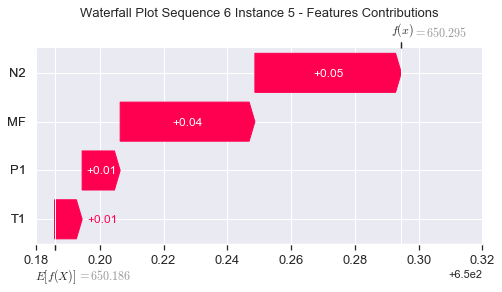

None

Contribution: [0.01420923 0.01019371 0.05242653 0.04862963]


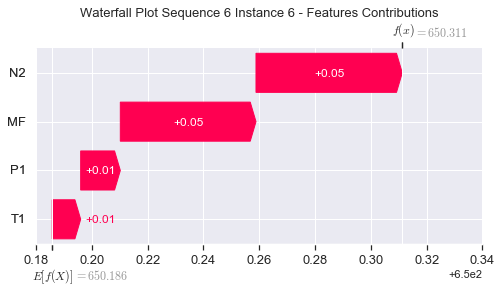

None

Contribution: [0.01524124 0.0109291  0.0551589  0.05143366]


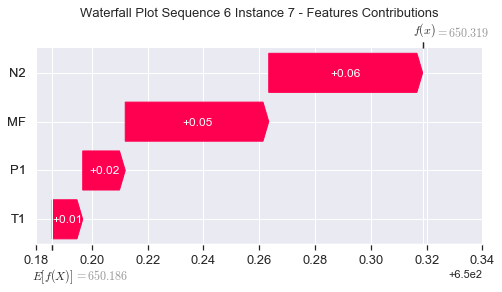

None

Contribution: [0.01525994 0.01082654 0.05496637 0.05142264]


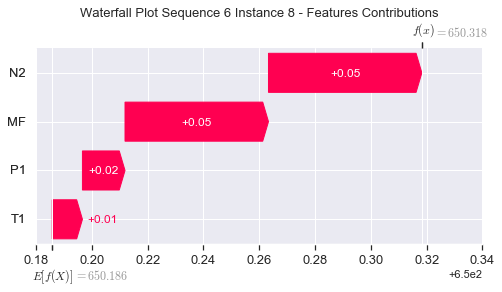

None

Contribution: [0.01473327 0.01021975 0.05287229 0.04933422]


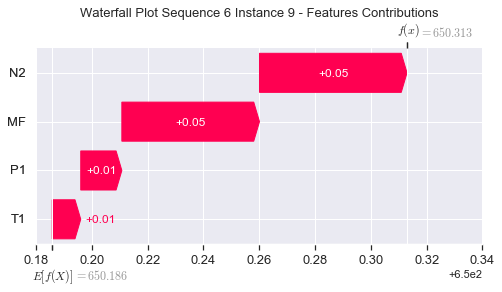

None

Contribution: [0.01429522 0.01027138 0.05169336 0.04901453]


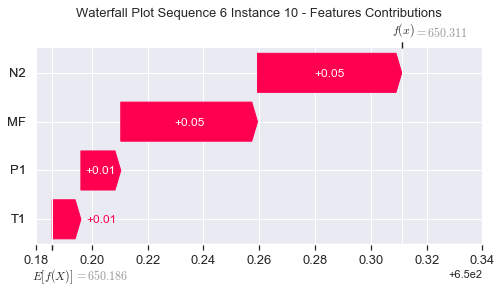

None

Contribution: [0.01449285 0.00977397 0.0516247  0.04832381]


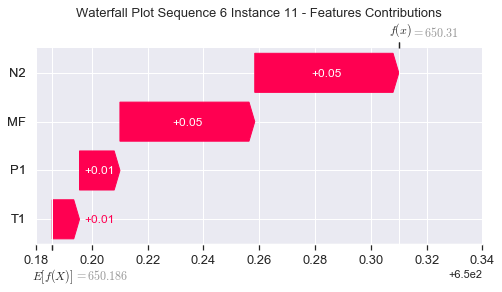

None

Contribution: [0.01473504 0.00937188 0.05195076 0.04907651]


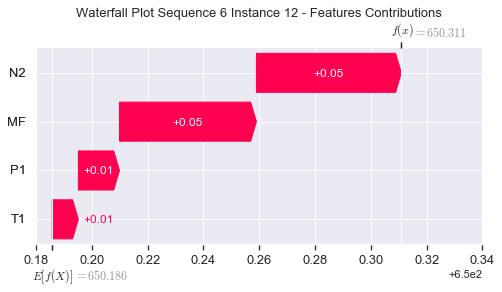

None

Contribution: [0.01506719 0.00949017 0.05290456 0.05002948]


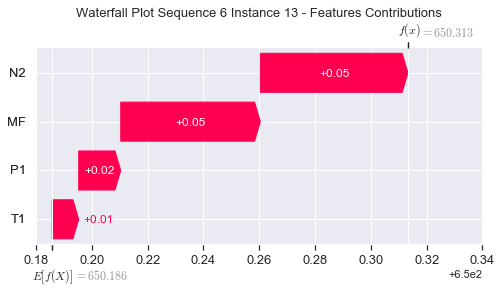

None

Contribution: [0.01561618 0.01021566 0.05454849 0.05186562]


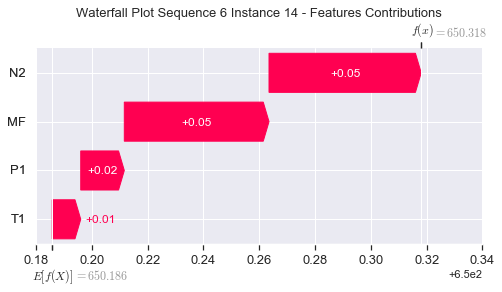

None

Contribution: [0.01623614 0.00983569 0.05667373 0.05363886]


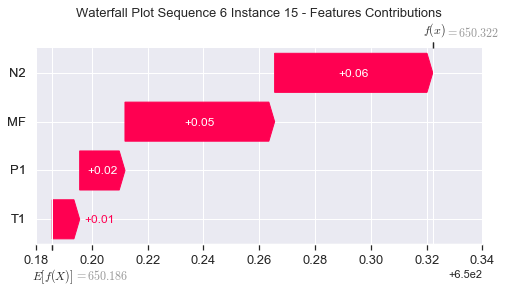

None

Contribution: [0.01708529 0.00966352 0.05930118 0.05584941]


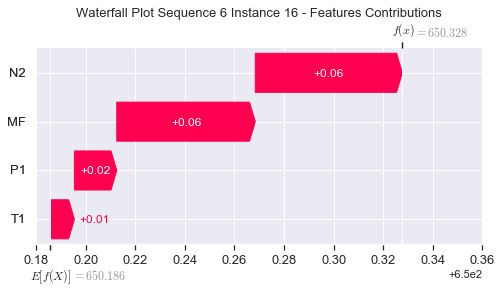

None

Contribution: [0.01806394 0.01051013 0.06264794 0.05929767]


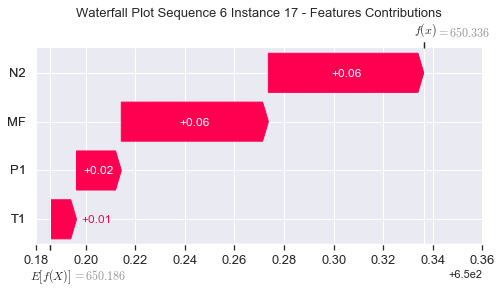

None

Contribution: [0.01946926 0.0113664  0.06745073 0.06373448]


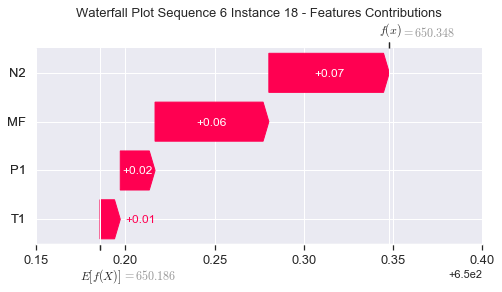

None

Contribution: [0.0215707  0.01364573 0.07366275 0.06910306]


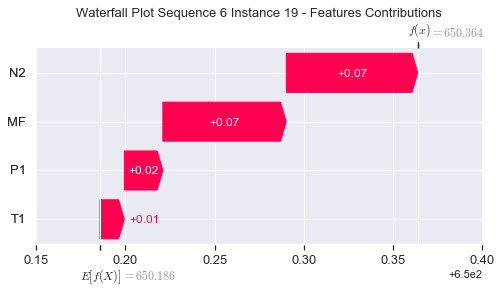

None

Contribution: [0.02689268 0.02125471 0.09141789 0.08543416]


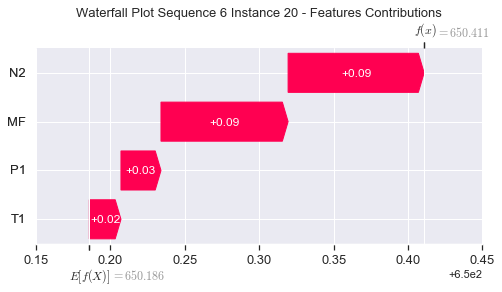

None

Contribution: [0.03922192 0.0574538  0.12314175 0.11293045]


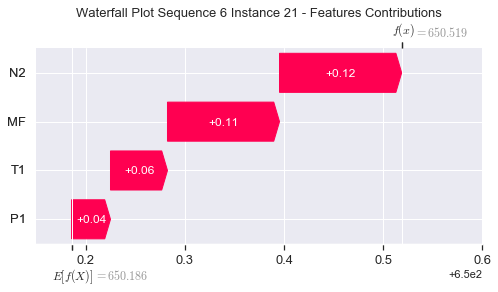

None

Contribution: [0.08087409 0.06159884 0.28617531 0.26225816]


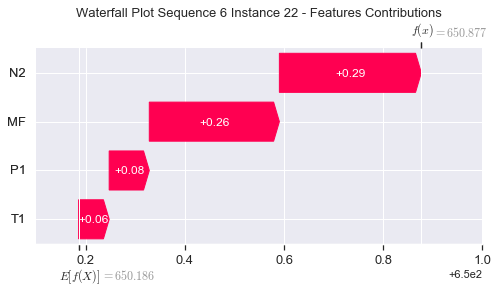

None

Contribution: [ 0.0966508  -0.16194751  0.48731991  0.44667476]


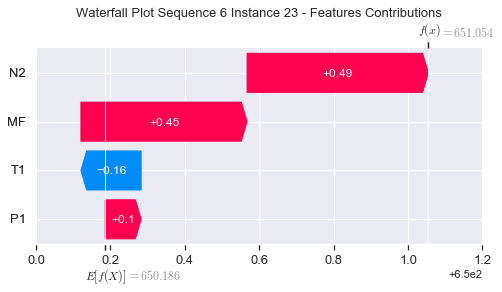

None

Contribution: [-0.13984916 -4.58901267  1.52329695  1.41580709]


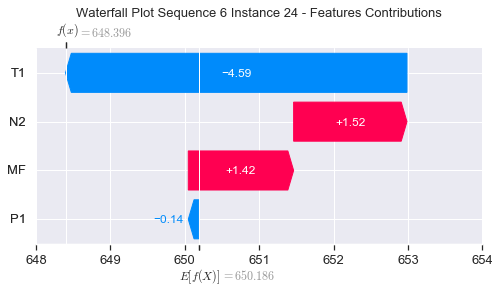

None

Contribution: [ 0.18242604 -1.37718972  1.5347473   1.38165238]


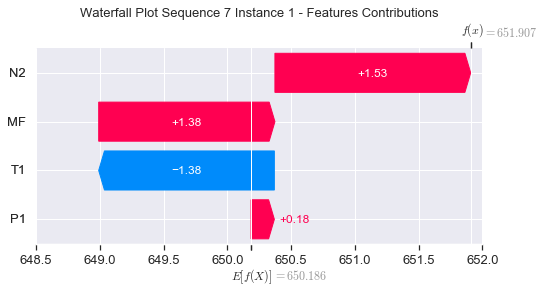

None

Contribution: [0.00651902 0.05064623 0.02362795 0.01770587]


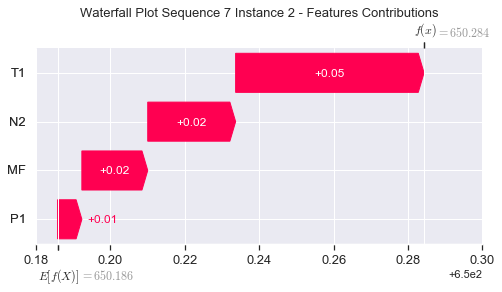

None

Contribution: [0.01176084 0.00011047 0.05664421 0.05337783]


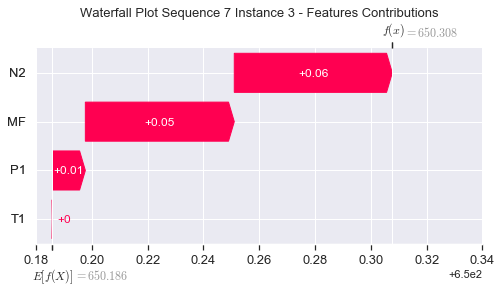

None

Contribution: [0.01009139 0.00225723 0.04245364 0.03922862]


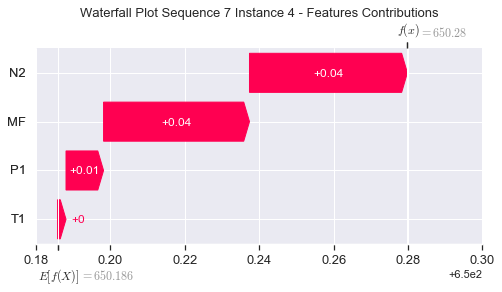

None

Contribution: [0.01207852 0.0056269  0.04638418 0.04306742]


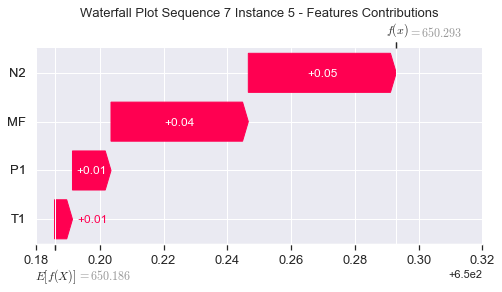

None

Contribution: [0.01422357 0.00751014 0.0528622  0.04921711]


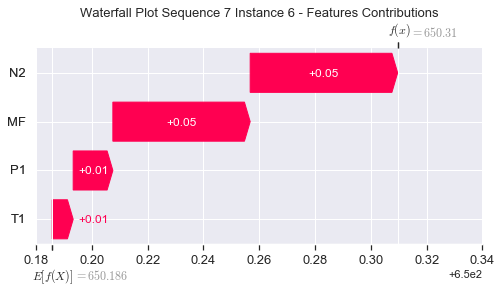

None

Contribution: [0.01517286 0.0085936  0.05559567 0.05210039]


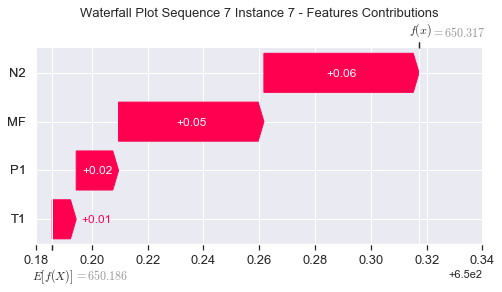

None

Contribution: [0.01521666 0.00867669 0.05522219 0.05189793]


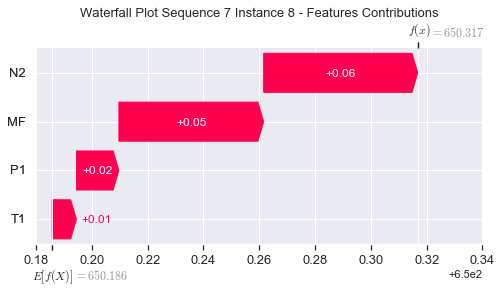

None

Contribution: [0.01458897 0.00914643 0.05301594 0.05017414]


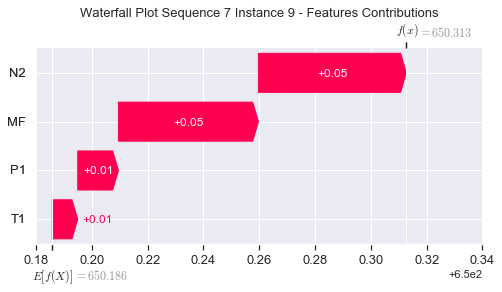

None

Contribution: [0.01452279 0.00917293 0.05185835 0.04929592]


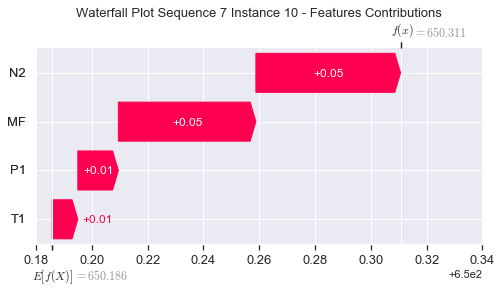

None

Contribution: [0.01451512 0.00847373 0.05164514 0.04863793]


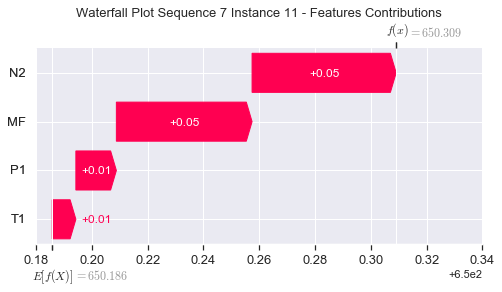

None

Contribution: [0.0146112  0.00809105 0.05226522 0.04950158]


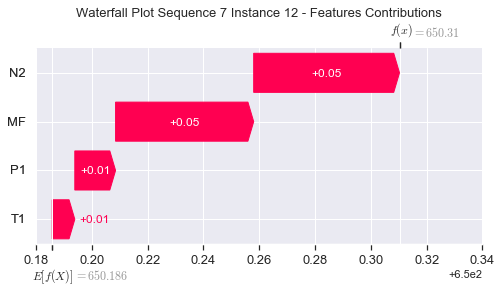

None

Contribution: [0.01493028 0.00834997 0.05319596 0.05048367]


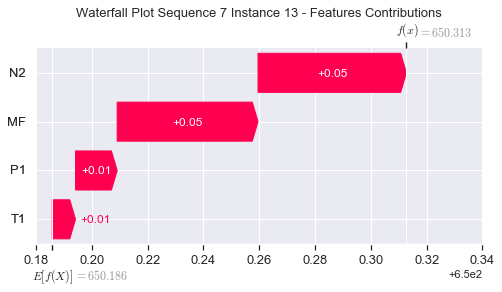

None

Contribution: [0.0154183  0.00945561 0.05492944 0.05221852]


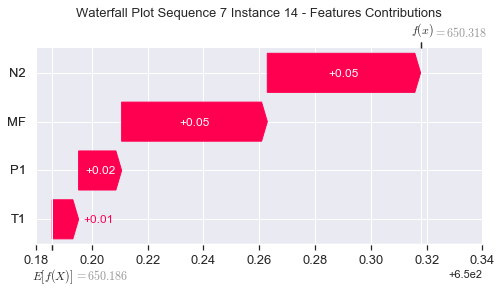

None

Contribution: [0.01607121 0.00876876 0.05686591 0.05393944]


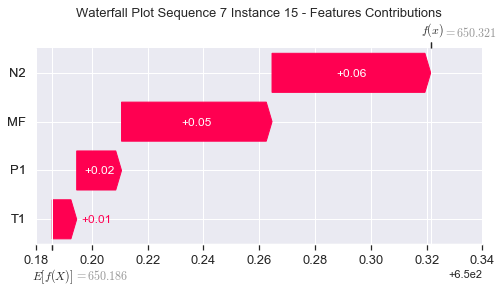

None

Contribution: [0.01734627 0.00901033 0.05982276 0.05729334]


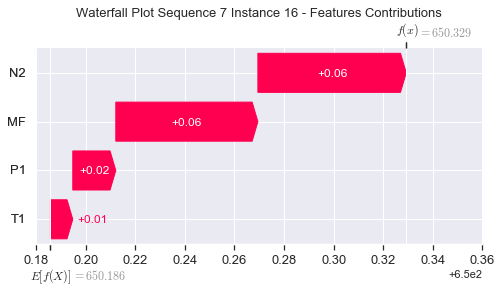

None

Contribution: [0.01783852 0.00998564 0.06289727 0.05964487]


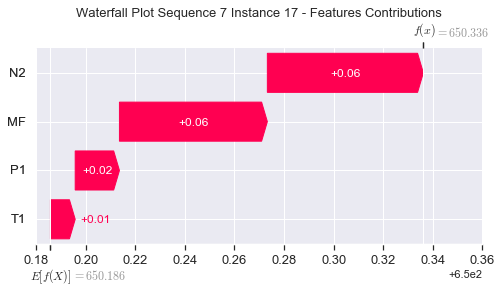

None

Contribution: [0.01928326 0.01099098 0.06770616 0.06399301]


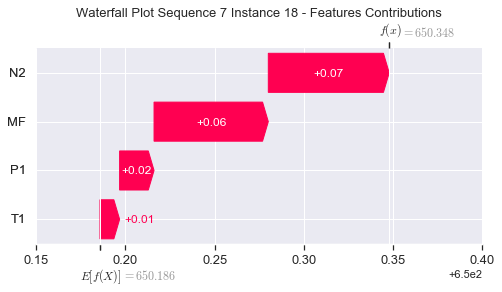

None

Contribution: [0.02181897 0.01327654 0.07402703 0.06975438]


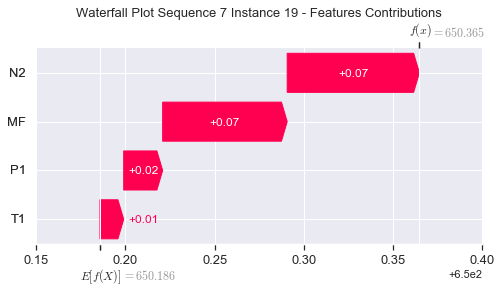

None

Contribution: [0.02683376 0.02131286 0.09174971 0.08579564]


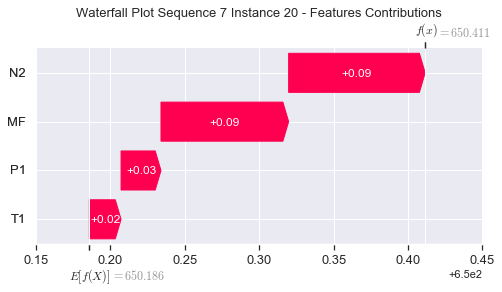

None

Contribution: [0.03957228 0.0576146  0.12366379 0.113371  ]


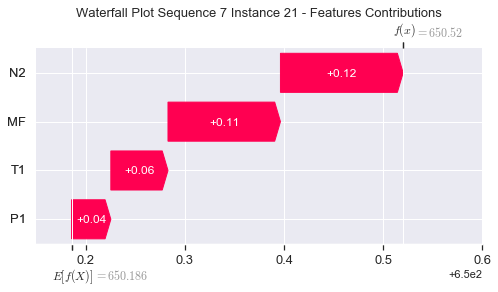

None

Contribution: [0.08066053 0.06178197 0.28672556 0.26266067]


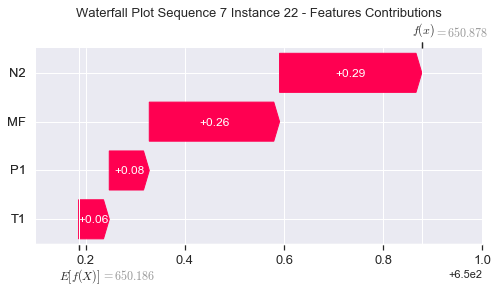

None

Contribution: [ 0.09332291 -0.15463266  0.48581347  0.44161662]


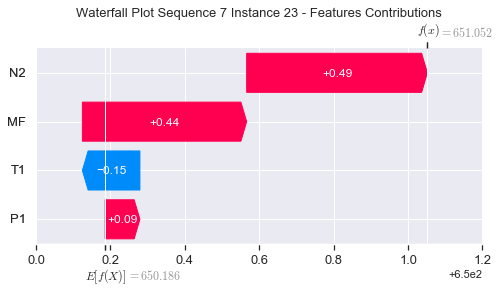

None

Contribution: [-0.16018873 -4.58061933  1.4813132   1.34776989]


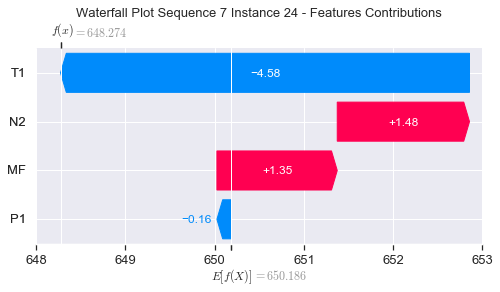

None

Contribution: [ 0.16215787 -1.36198109  1.51976766  1.41957133]


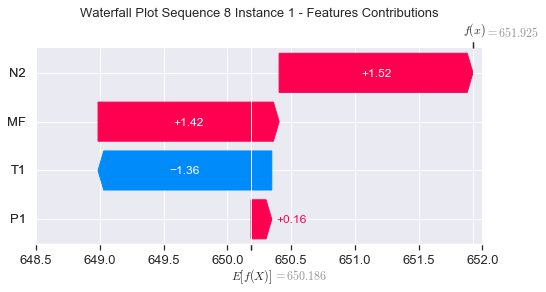

None

Contribution: [0.00654235 0.04718755 0.0230162  0.01723099]


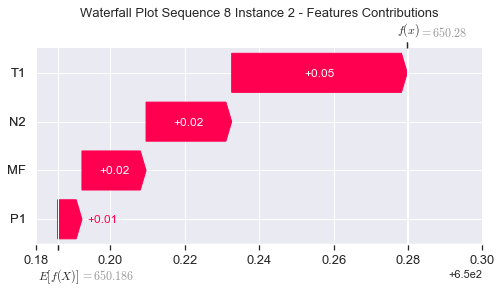

None

Contribution: [ 0.01142787 -0.00182722  0.05669583  0.05367196]


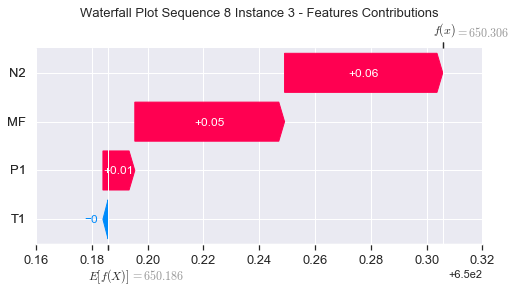

None

Contribution: [0.00968591 0.00199378 0.04238923 0.03940528]


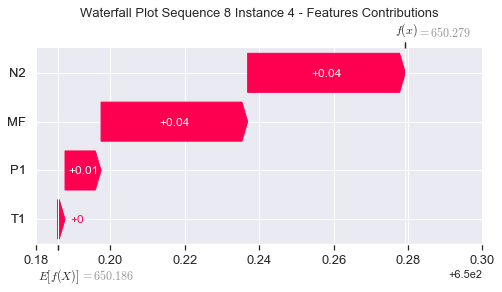

None

Contribution: [0.01080759 0.00555926 0.04543483 0.03915256]


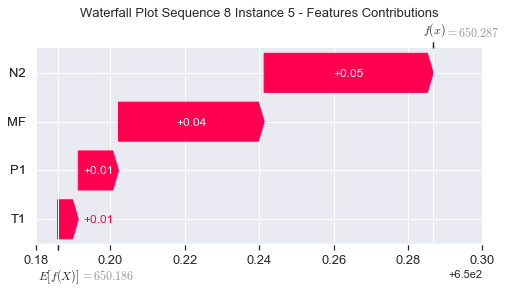

None

Contribution: [0.01387857 0.00853208 0.05256203 0.04774844]


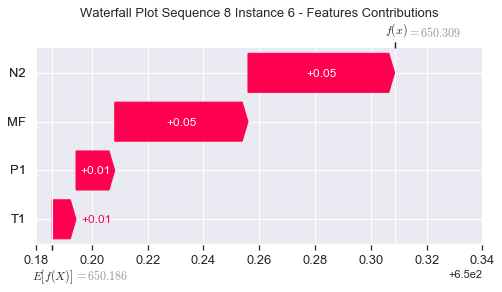

None

Contribution: [0.01479887 0.00949986 0.05506251 0.05049021]


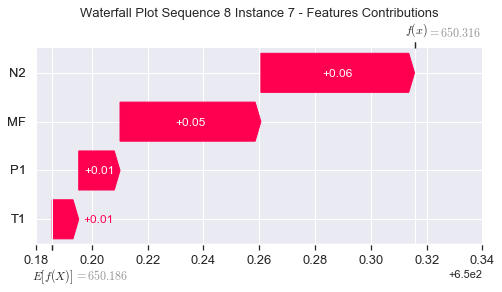

None

Contribution: [0.01481319 0.00979176 0.05468253 0.05046611]


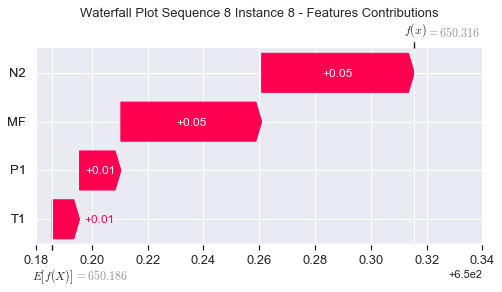

None

Contribution: [0.01398017 0.00894117 0.0529307  0.0500466 ]


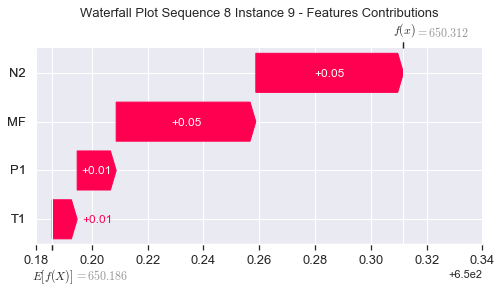

None

Contribution: [0.01286101 0.00826848 0.05115558 0.04716096]


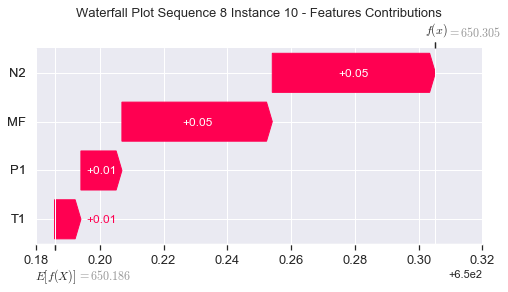

None

Contribution: [0.01432842 0.01038054 0.05138862 0.04938845]


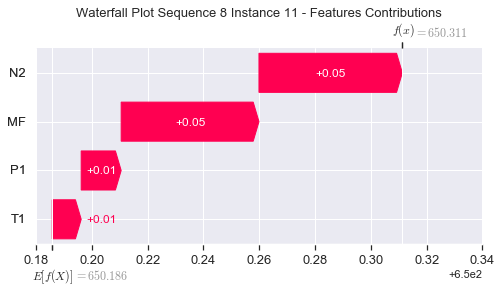

None

Contribution: [0.01469863 0.01097332 0.05151957 0.04892225]


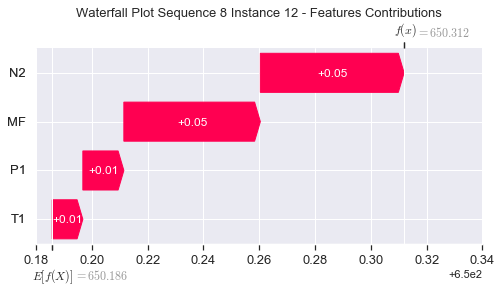

None

Contribution: [0.01488704 0.01086166 0.05236138 0.04957793]


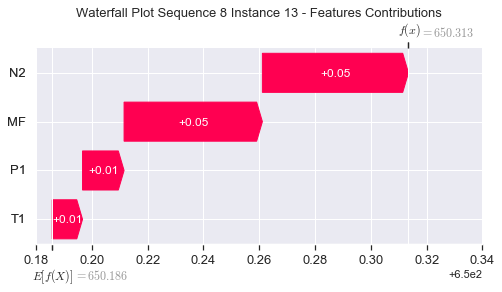

None

Contribution: [0.01550494 0.0110921  0.05410723 0.05201259]


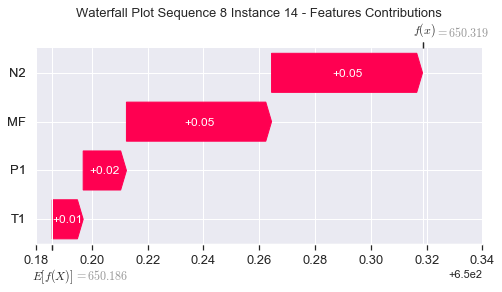

None

Contribution: [0.01621231 0.01155997 0.05596272 0.05332544]


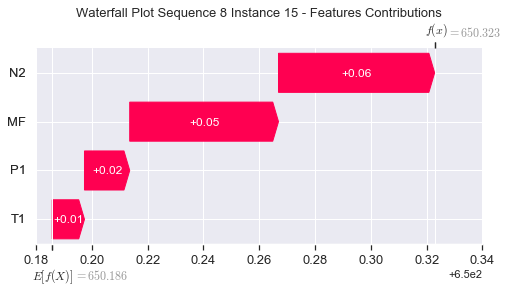

None

Contribution: [0.01704154 0.011874   0.058695   0.05666677]


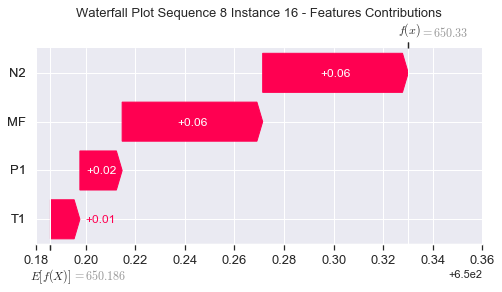

None

Contribution: [0.018066   0.01310696 0.06172901 0.05907523]


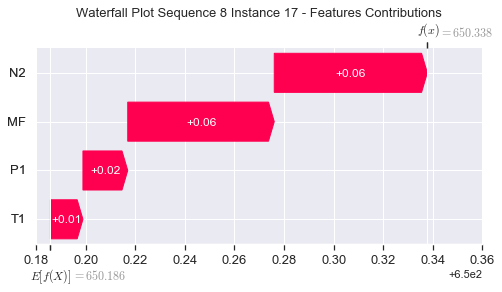

None

Contribution: [0.01963676 0.01457576 0.06651771 0.06365033]


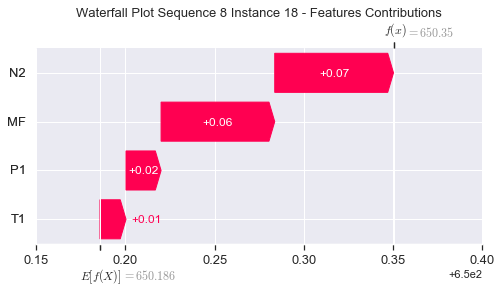

None

Contribution: [0.02147481 0.01586575 0.072302   0.06812124]


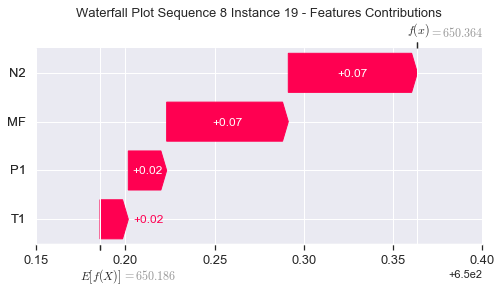

None

Contribution: [0.02658952 0.02326007 0.08972431 0.08409398]


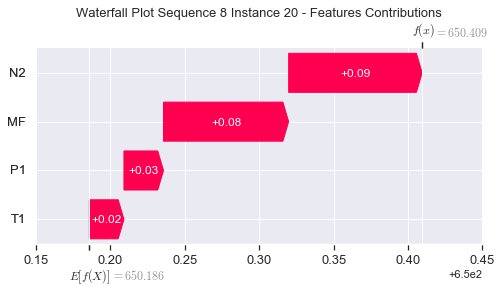

None

Contribution: [0.038042   0.05185536 0.11994543 0.10964153]


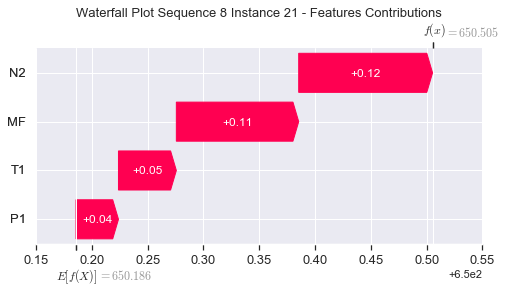

None

Contribution: [0.08114081 0.07629804 0.28168656 0.25852389]


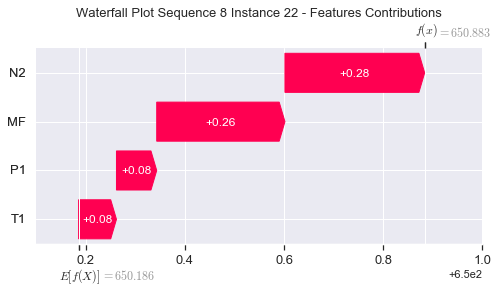

None

Contribution: [0.11755352 0.00268989 0.48106757 0.45608539]


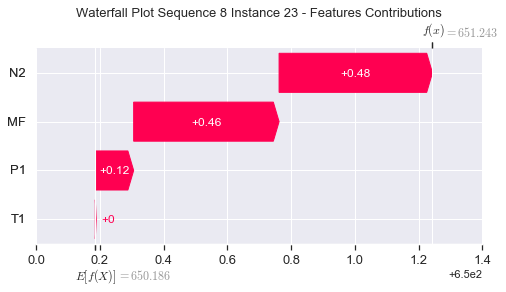

None

Contribution: [ 0.05847688 -2.76397857  1.51521107  1.45019633]


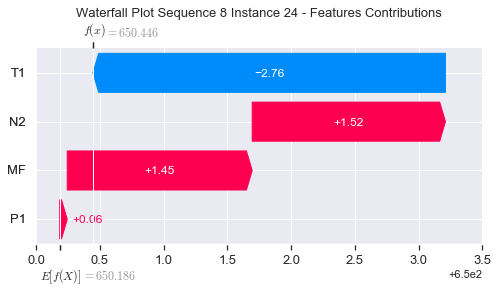

None

Contribution: [ 0.23443114 -0.72745447  1.49701528  1.34740601]


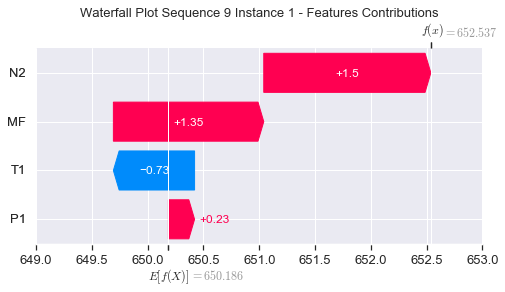

None

Contribution: [0.00424654 0.02931079 0.02166584 0.01554642]


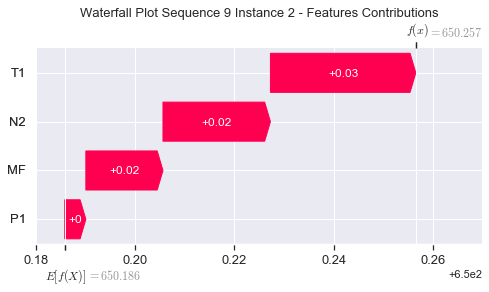

None

Contribution: [0.01208053 0.00295144 0.05595891 0.05194584]


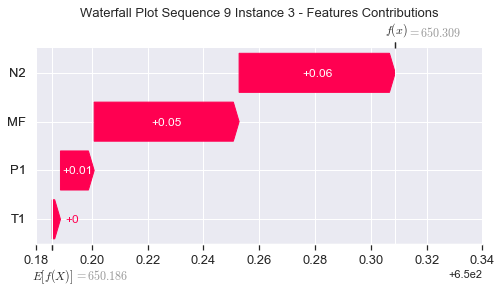

None

Contribution: [0.00967308 0.00768426 0.04129337 0.03739447]


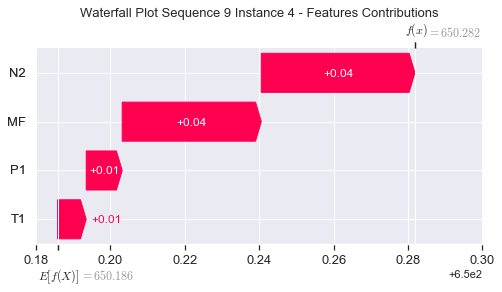

None

Contribution: [0.01175334 0.00954878 0.04524714 0.04202012]


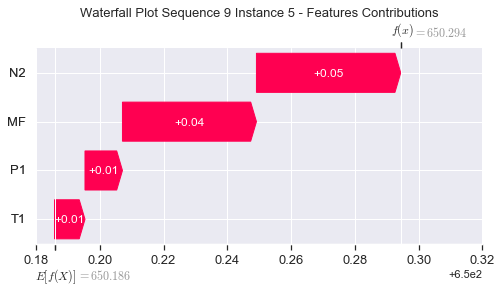

None

Contribution: [0.01393615 0.01121033 0.0516414  0.04798454]


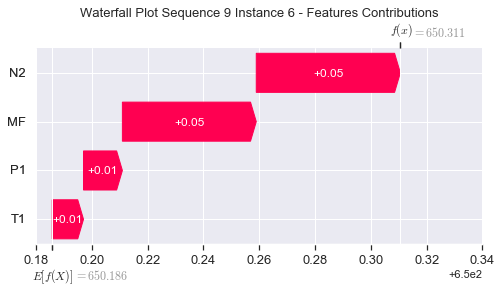

None

Contribution: [0.0149552  0.01206556 0.05432703 0.05061025]


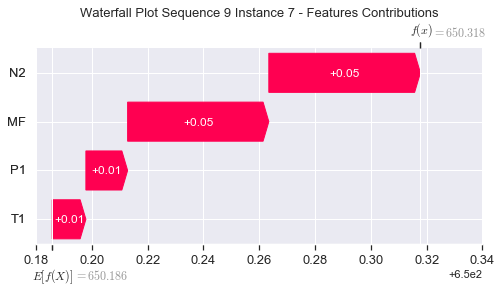

None

Contribution: [0.01506078 0.01209693 0.05406257 0.05075788]


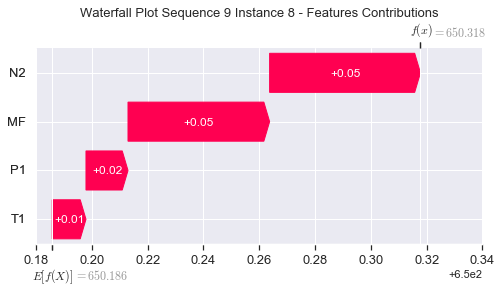

None

Contribution: [0.01485546 0.01220277 0.0520188  0.04892824]


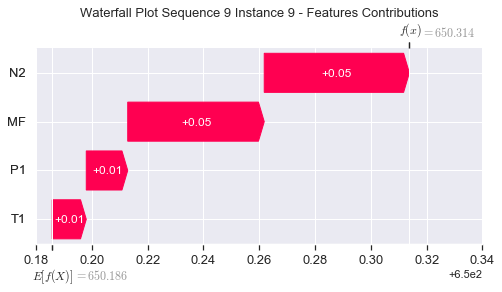

None

Contribution: [0.01435815 0.01187645 0.05085868 0.04908154]


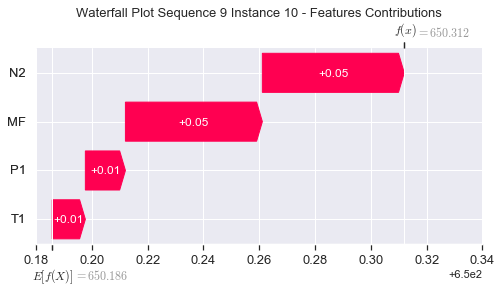

None

Contribution: [0.01464117 0.01171296 0.05081026 0.0482928 ]


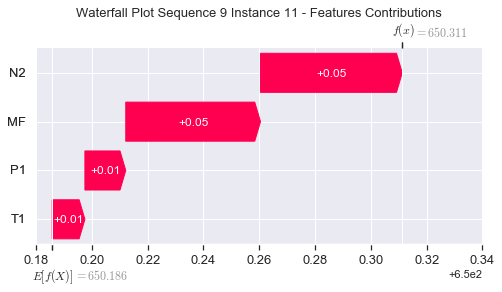

None

Contribution: [0.01463222 0.01094149 0.05127683 0.04858264]


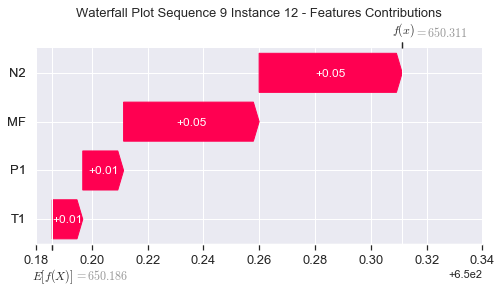

None

Contribution: [0.01499144 0.01113009 0.05217392 0.04950212]


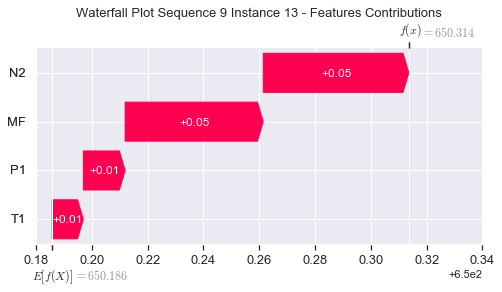

None

Contribution: [0.01583408 0.01106855 0.05402277 0.05223257]


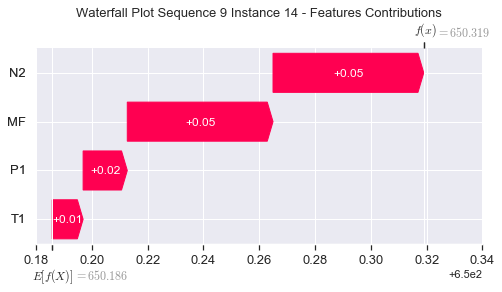

None

Contribution: [0.01617181 0.01161242 0.05574672 0.05304   ]


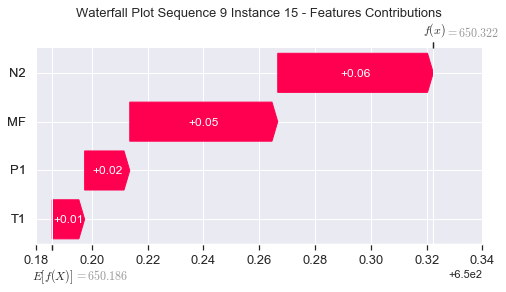

None

Contribution: [0.01720117 0.01116742 0.05855435 0.05661406]


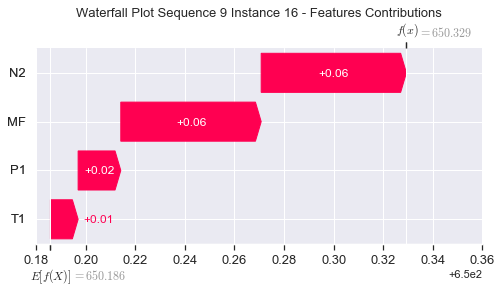

None

Contribution: [0.01807854 0.01272768 0.06154287 0.05848527]


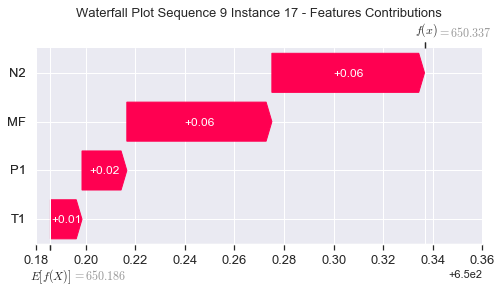

None

Contribution: [0.01950886 0.01373783 0.06613885 0.06283898]


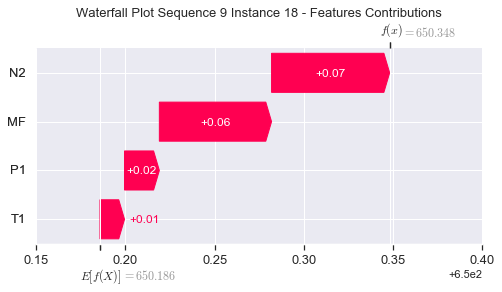

None

Contribution: [0.02142529 0.01659347 0.07212351 0.06880899]


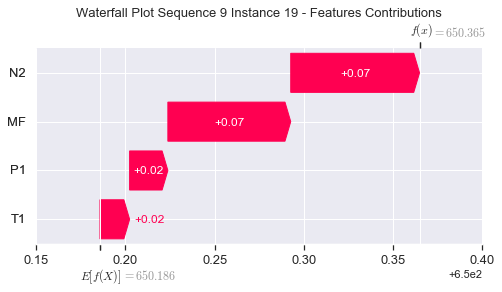

None

Contribution: [0.02676265 0.02292736 0.08940446 0.08397177]


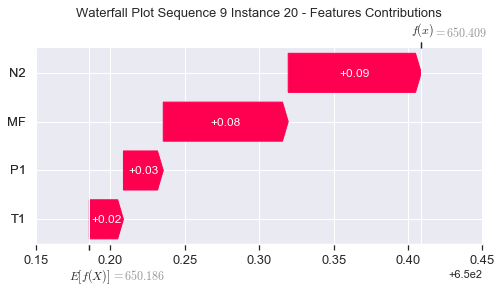

None

Contribution: [0.0375654  0.0528081  0.11976138 0.10902495]


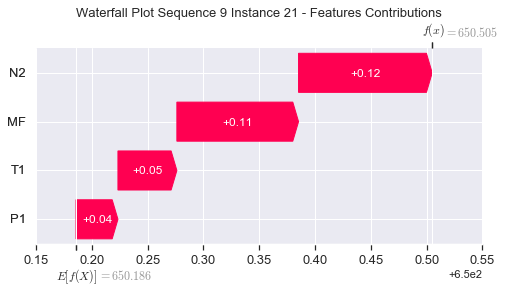

None

Contribution: [0.08229188 0.07280751 0.28179849 0.26092774]


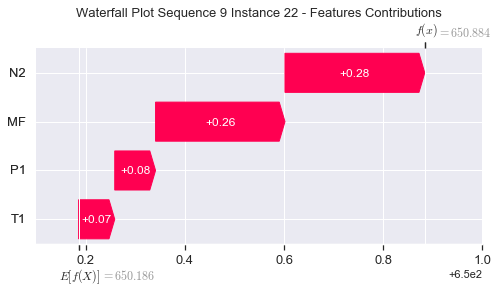

None

Contribution: [ 0.11969362 -0.05072286  0.48183426  0.46172041]


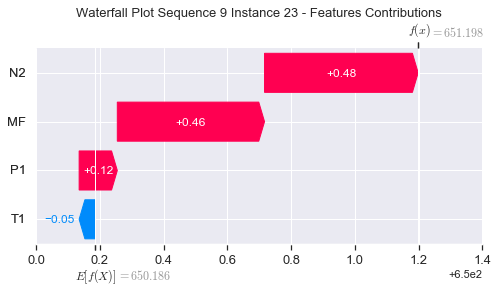

None

Contribution: [ 0.18874486 -3.345731    1.5425505   1.8139331 ]


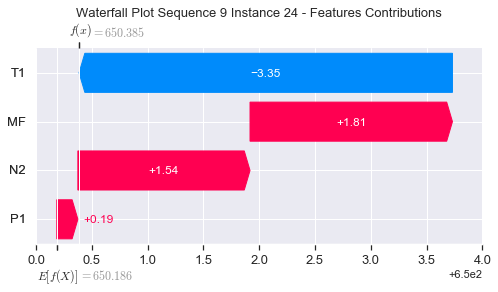

None

Contribution: [ 0.33189699 -0.95217498  1.50769221  1.49972122]


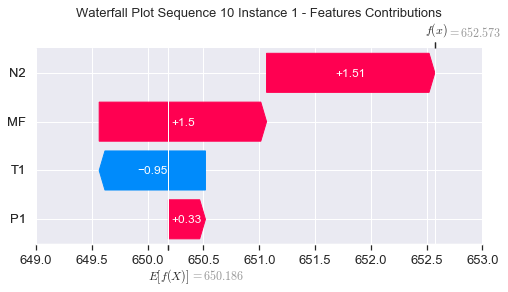

None

Contribution: [0.00195404 0.03775196 0.02110032 0.011179  ]


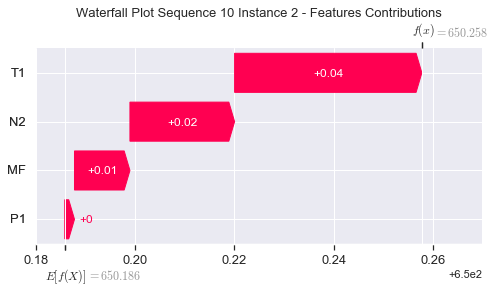

None

Contribution: [0.01225587 0.00316666 0.05609997 0.05376523]


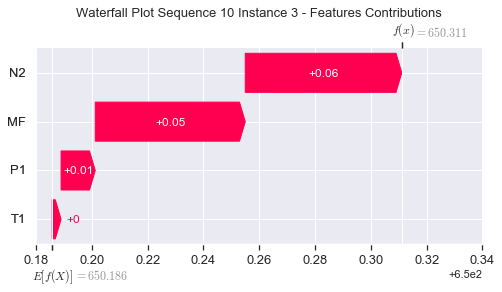

None

Contribution: [0.01045053 0.00561702 0.0414751  0.03765984]


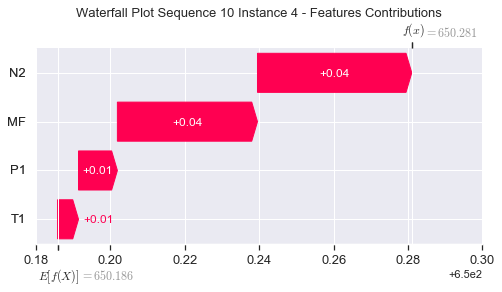

None

Contribution: [0.01239778 0.01012938 0.04532713 0.04214786]


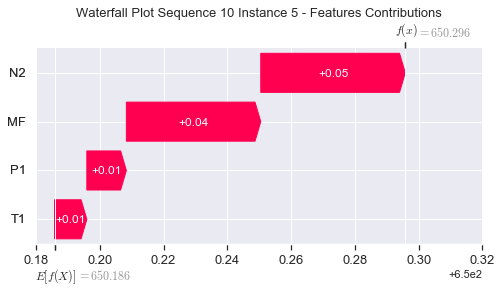

None

Contribution: [0.01487169 0.01000978 0.0518386  0.04912412]


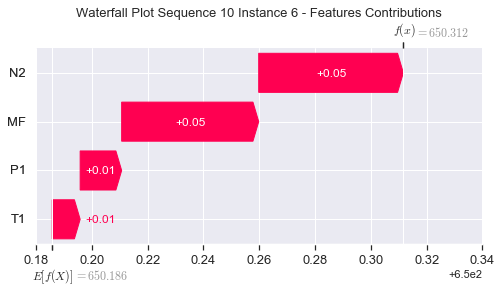

None

Contribution: [0.01570545 0.01026464 0.05445322 0.05161477]


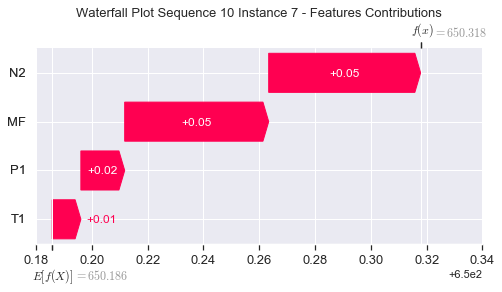

None

Contribution: [0.01594704 0.01092963 0.05414367 0.0517839 ]


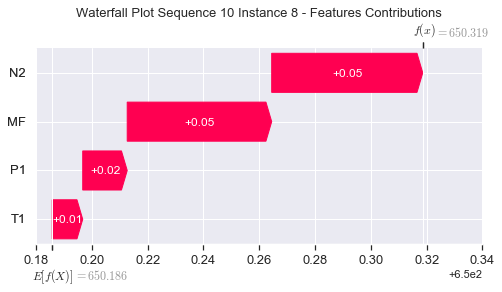

None

Contribution: [0.01600167 0.01202041 0.05204804 0.05068376]


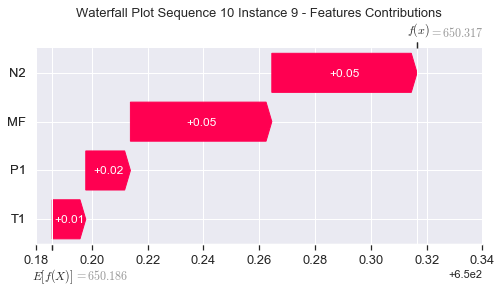

None

Contribution: [0.01554499 0.01229517 0.05067041 0.04921535]


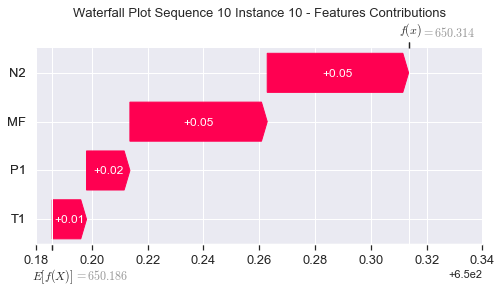

None

Contribution: [0.01662855 0.0129748  0.0512127  0.051247  ]


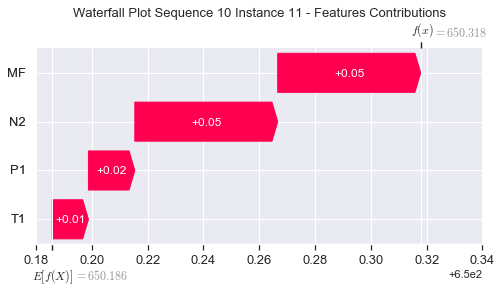

None

Contribution: [0.01555871 0.00972904 0.05152523 0.05010196]


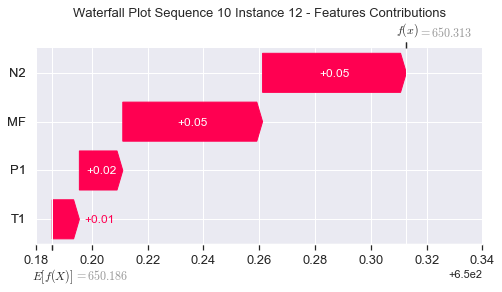

None

Contribution: [0.01582524 0.00965218 0.05251652 0.05084427]


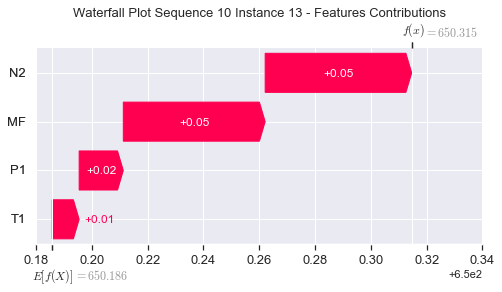

None

Contribution: [0.01658541 0.01158004 0.05422555 0.05222327]


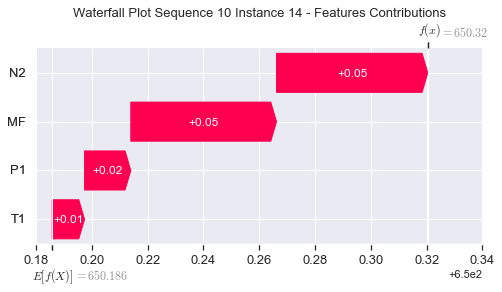

None

Contribution: [0.01721484 0.00952646 0.05653904 0.05484866]


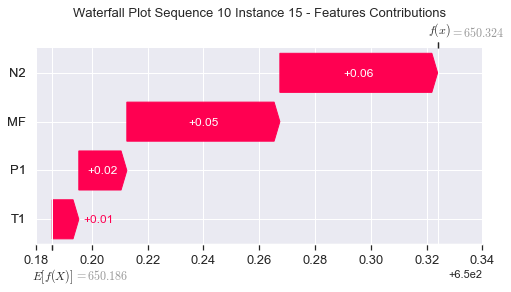

None

Contribution: [0.017158   0.00487101 0.05892975 0.05718241]


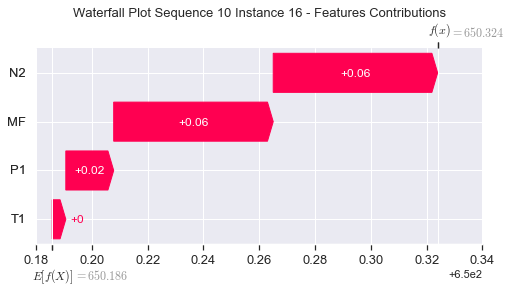

None

Contribution: [0.01902447 0.00963169 0.06228683 0.06011002]


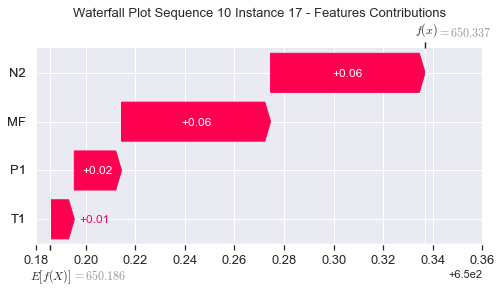

None

Contribution: [0.02058039 0.0104659  0.06704465 0.06458324]


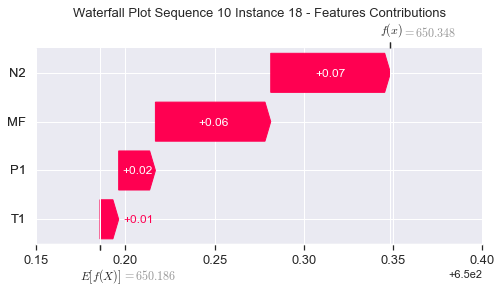

None

Contribution: [0.02213887 0.00976575 0.07309897 0.07011738]


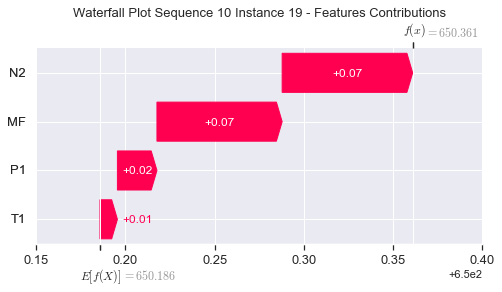

None

Contribution: [0.02752847 0.02054697 0.09031639 0.08504901]


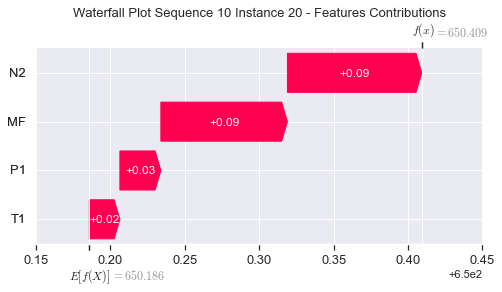

None

Contribution: [0.03716857 0.05754098 0.12091508 0.10979764]


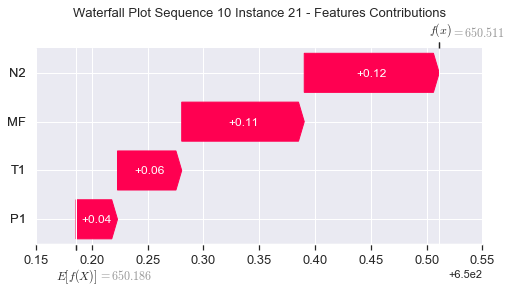

None

Contribution: [0.08531186 0.064945   0.28344504 0.26323132]


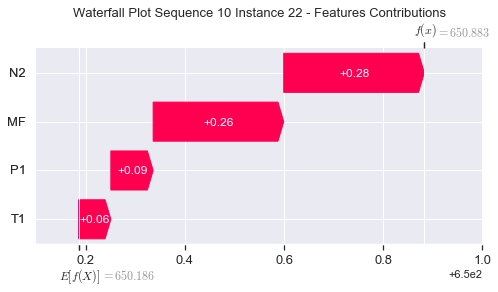

None

Contribution: [ 0.14619662 -0.13800325  0.48619878  0.47687164]


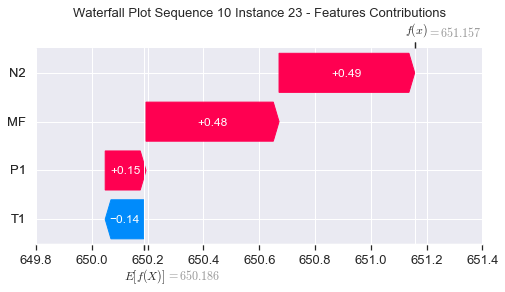

None

Contribution: [ 0.45448533 -4.18890665  1.52009318  1.75934253]


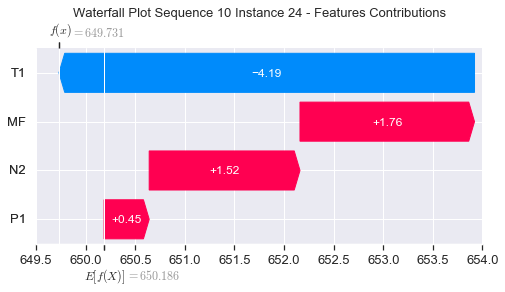

None

Contribution: [ 0.32357448 -1.01100893  1.45410598  1.33689866]


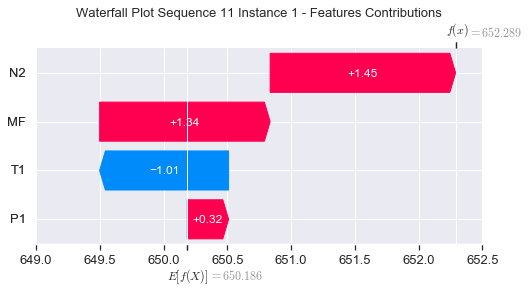

None

Contribution: [-0.00092157  0.0423644   0.02104017  0.01152229]


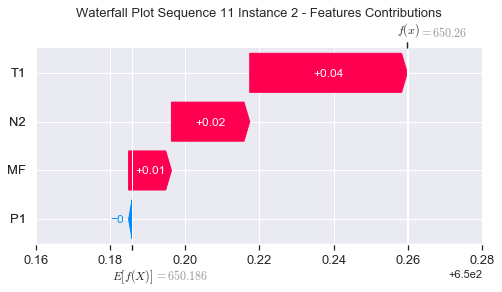

None

Contribution: [0.01326177 0.00288607 0.05554146 0.05462293]


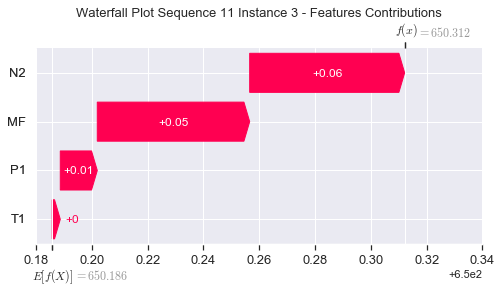

None

Contribution: [0.01134346 0.00762169 0.04093119 0.03878237]


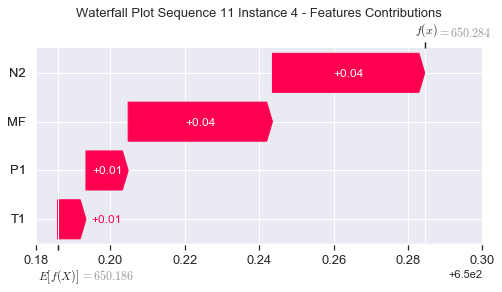

None

Contribution: [0.01283896 0.01038651 0.04450741 0.04210064]


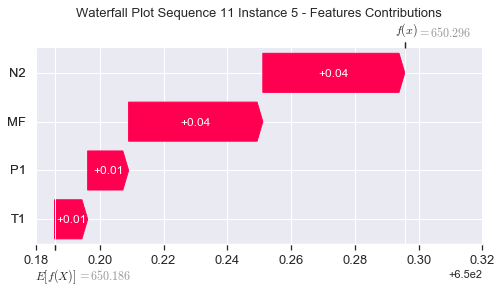

None

Contribution: [0.01514712 0.01252464 0.05069942 0.04819917]


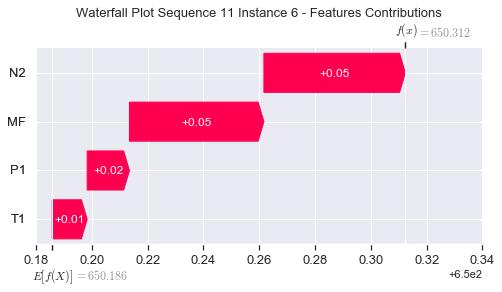

None

Contribution: [0.0159445  0.01347323 0.0532516  0.05058392]


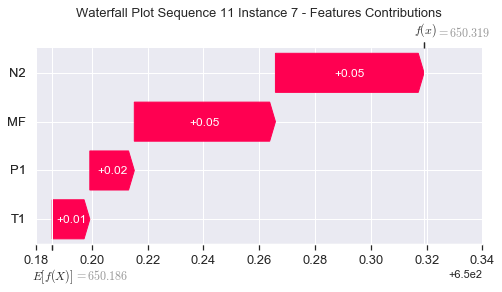

None

Contribution: [0.0160757  0.01351625 0.05312603 0.05076834]


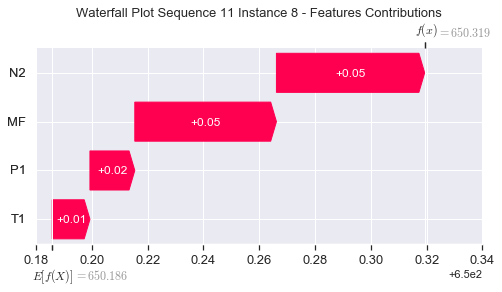

None

Contribution: [0.01511466 0.01338564 0.05104645 0.04788413]


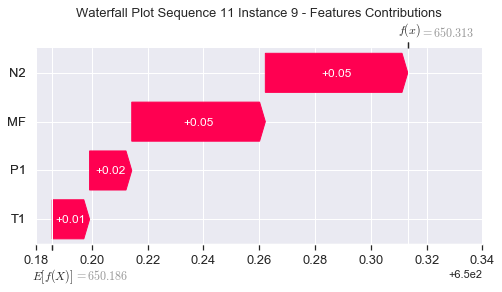

None

Contribution: [0.01472623 0.01297182 0.04989911 0.04757812]


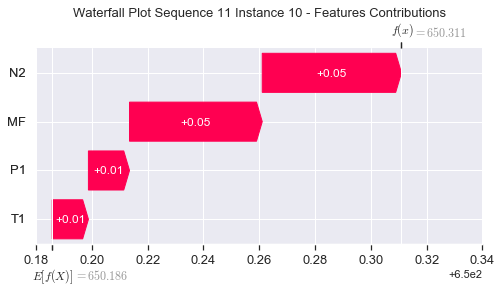

None

Contribution: [0.01548139 0.01274558 0.04983777 0.04769594]


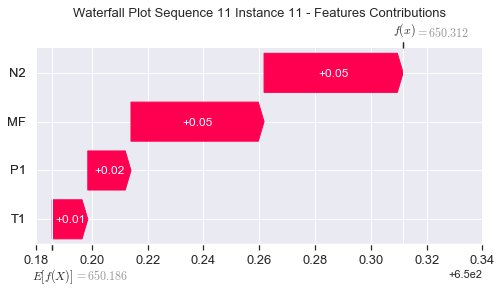

None

Contribution: [0.01568354 0.01263437 0.05025504 0.04865707]


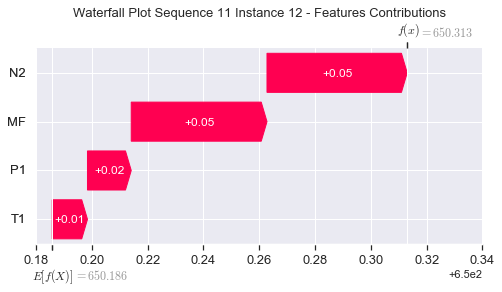

None

Contribution: [0.01590079 0.01297525 0.05104703 0.04938827]


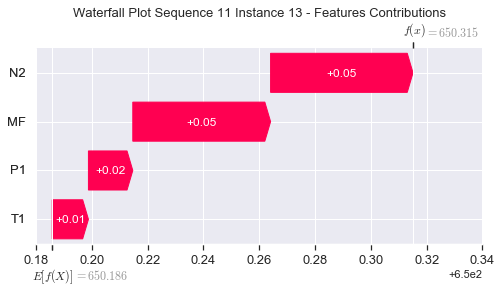

None

Contribution: [0.01646169 0.01360608 0.05261566 0.05119783]


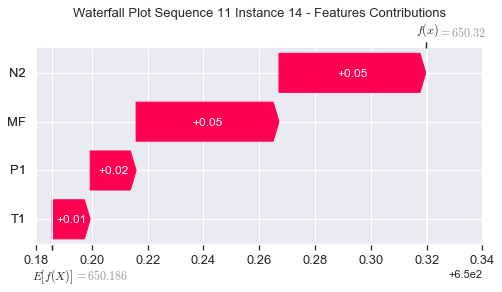

None

Contribution: [0.01708534 0.01384772 0.05432922 0.052778  ]


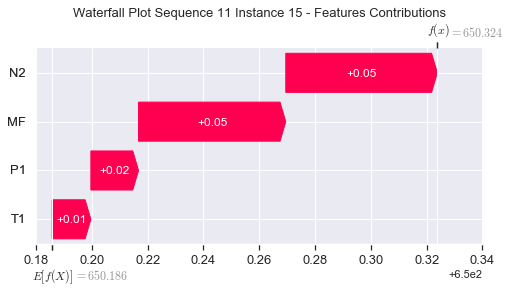

None

Contribution: [0.01888873 0.01374483 0.05692655 0.05658468]


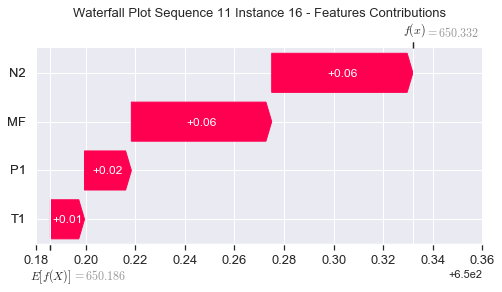

None

Contribution: [0.01877878 0.01559381 0.0597817  0.0579207 ]


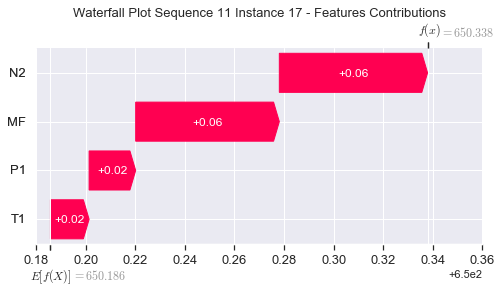

None

Contribution: [0.02022055 0.01687074 0.06414334 0.06217789]


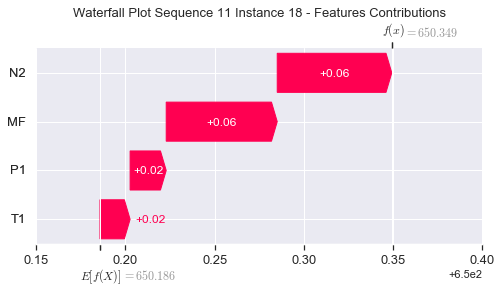

None

Contribution: [0.02242332 0.01906795 0.06993763 0.06888249]


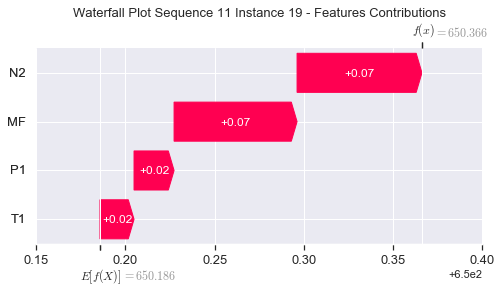

None

Contribution: [0.02676006 0.02510204 0.0866353  0.08223486]


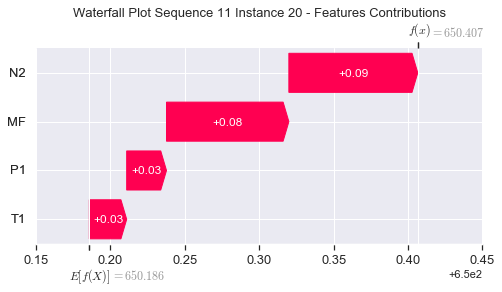

None

Contribution: [0.03504855 0.04579857 0.11582187 0.10380155]


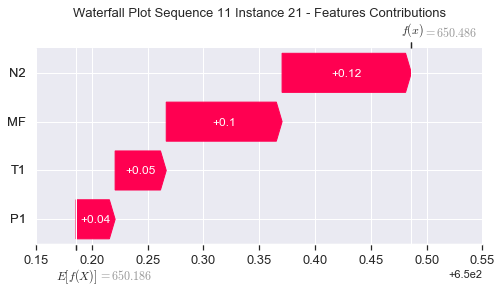

None

Contribution: [0.08400769 0.08484673 0.27517373 0.25779803]


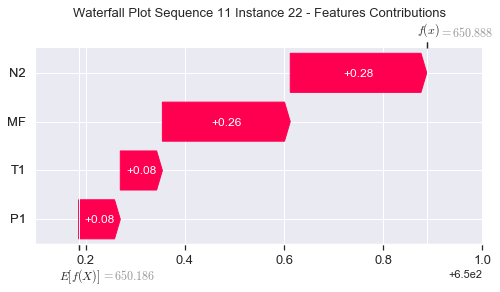

None

Contribution: [0.15122043 0.07783576 0.46597022 0.47234957]


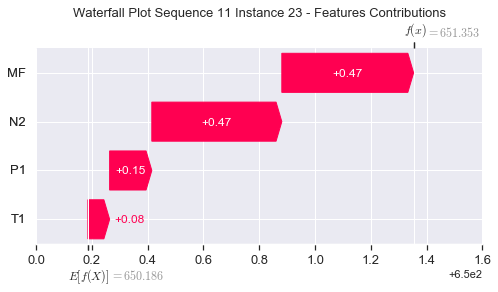

None

Contribution: [ 0.66826364 -1.49451402  1.47372748  2.27212175]


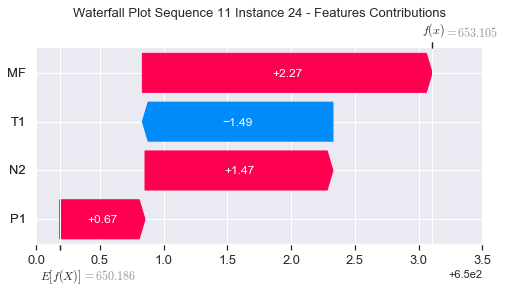

None

Contribution: [ 0.48057705 -0.27478783  1.43863569  1.63691433]


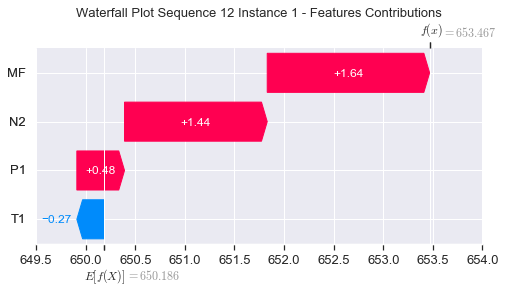

None

Contribution: [-0.00241572  0.0217554   0.02081158  0.0077326 ]


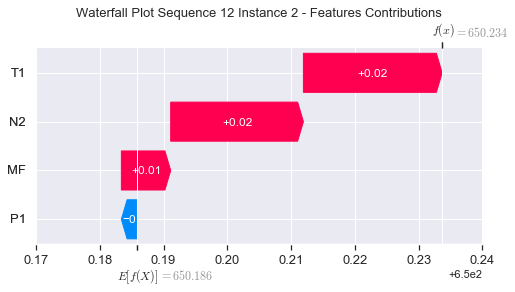

None

Contribution: [0.01357955 0.00860985 0.05431802 0.05407222]


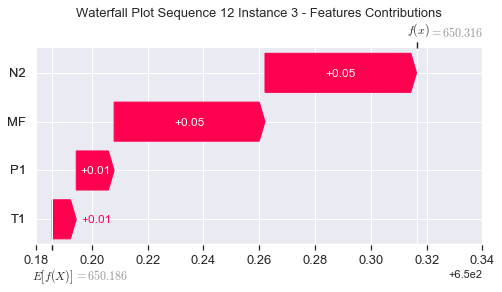

None

Contribution: [0.01112684 0.00944455 0.04029551 0.03830469]


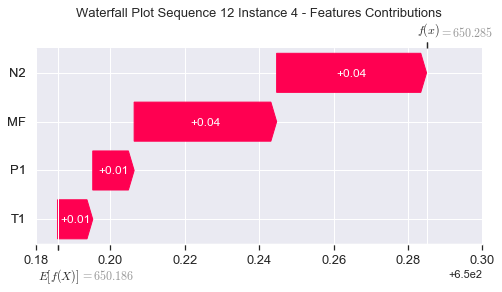

None

Contribution: [0.01269582 0.01184021 0.04411424 0.0415421 ]


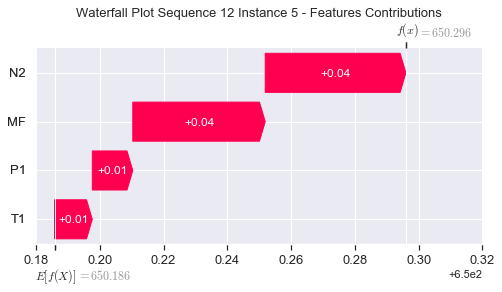

None

Contribution: [0.01489534 0.0131328  0.05044109 0.04820036]


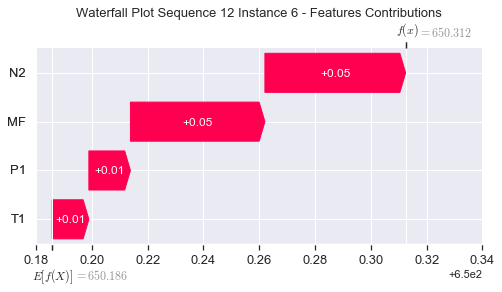

None

Contribution: [0.01587004 0.01374177 0.05311032 0.05087865]


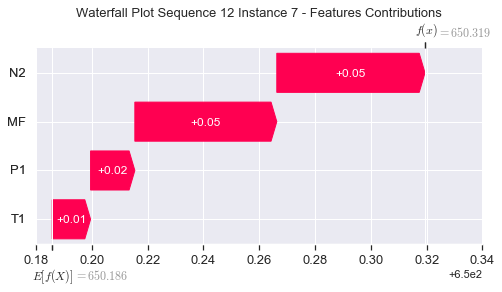

None

Contribution: [0.0159361  0.01383811 0.0529898  0.05093099]


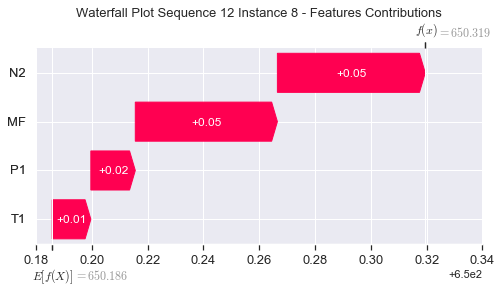

None

Contribution: [0.01541806 0.01328417 0.05095258 0.04885674]


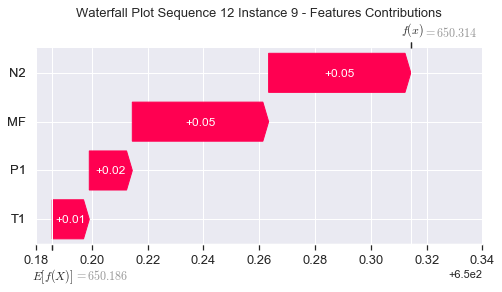

None

Contribution: [0.01561224 0.01301444 0.05001488 0.04901271]


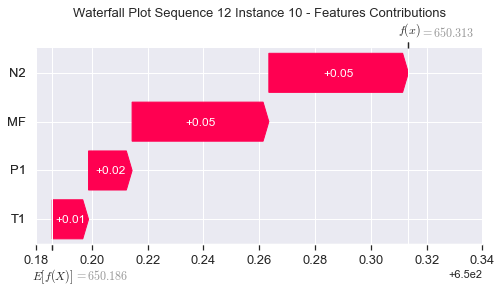

None

Contribution: [0.01519852 0.01305643 0.0497832  0.04795267]


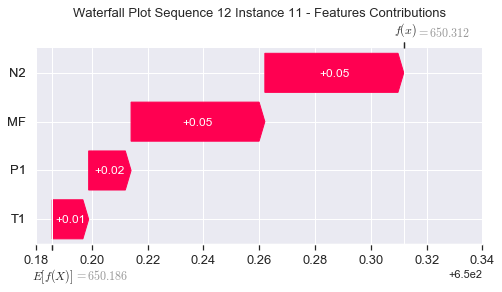

None

Contribution: [0.01535811 0.01223162 0.05025492 0.04865912]


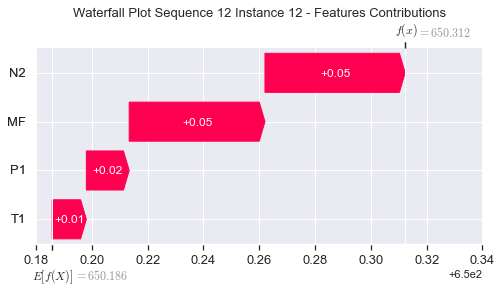

None

Contribution: [0.01572366 0.01249368 0.05113802 0.04957412]


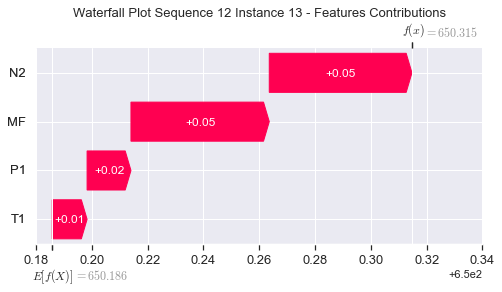

None

Contribution: [0.0164339  0.01224214 0.05270733 0.05181242]


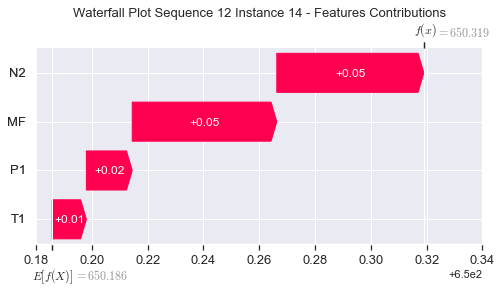

None

Contribution: [0.01690085 0.01314202 0.05454871 0.05302325]


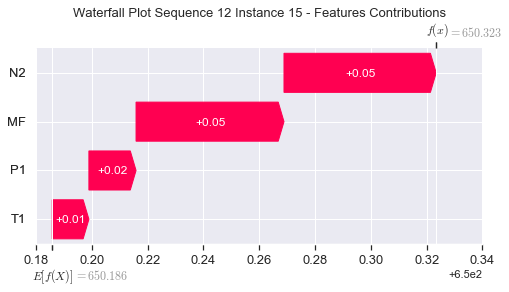

None

Contribution: [0.01791993 0.01288949 0.05712258 0.05614631]


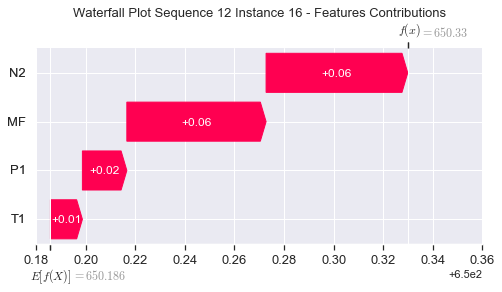

None

Contribution: [0.01875265 0.01429587 0.06007407 0.05851411]


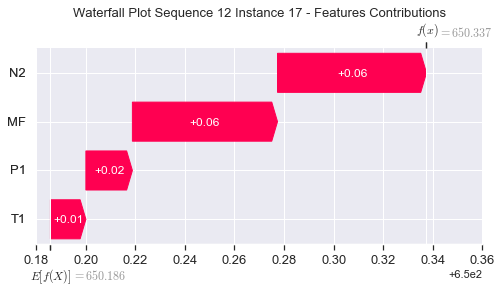

None

Contribution: [0.02018922 0.01546004 0.06464745 0.0629001 ]


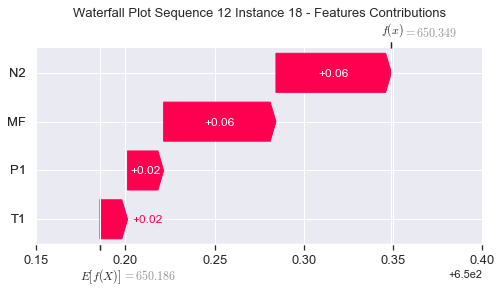

None

Contribution: [0.02168531 0.01715615 0.07009056 0.06693286]


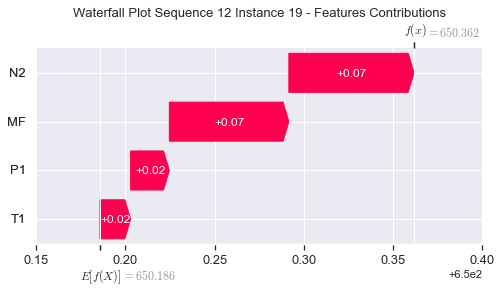

None

Contribution: [0.02690573 0.02401506 0.08708764 0.08284974]


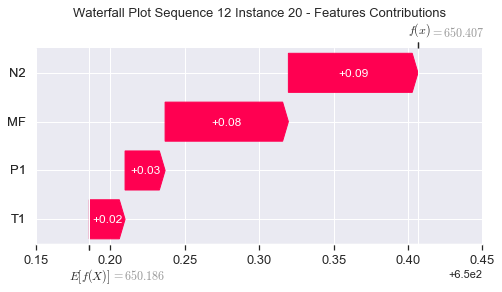

None

Contribution: [0.03518362 0.04815343 0.11594258 0.10392   ]


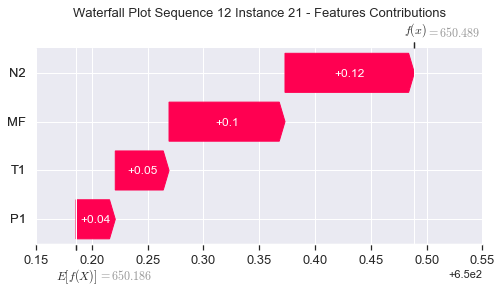

None

Contribution: [0.08383567 0.08116196 0.27629364 0.25807025]


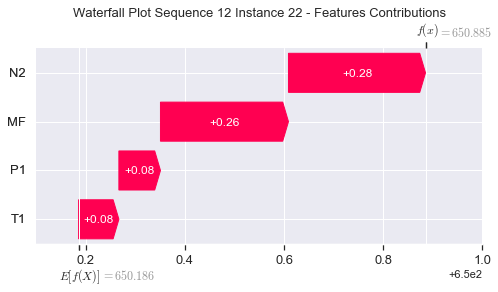

None

Contribution: [0.14593193 0.03332728 0.4734993  0.4744743 ]


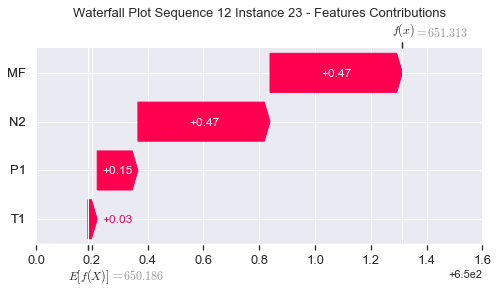

None

Contribution: [ 0.56729386 -1.96285906  1.59025626  2.32502653]


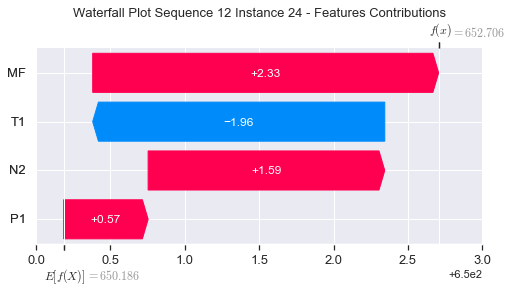

None

Contribution: [ 0.42103288 -0.35111344  1.50260306  1.81176867]


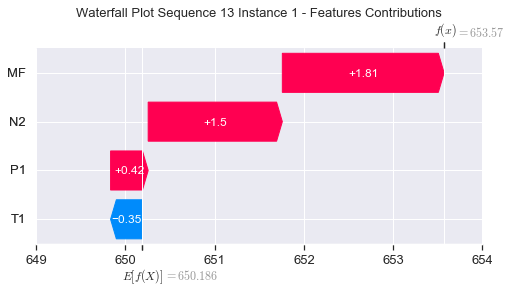

None

Contribution: [-0.0012268   0.02694782  0.02081595  0.01060094]


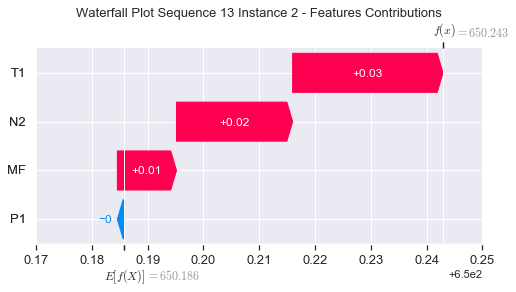

None

Contribution: [0.01284739 0.00811417 0.05455498 0.05191529]


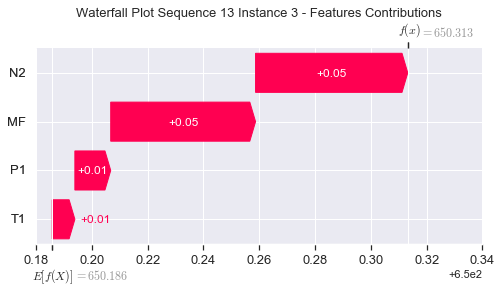

None

Contribution: [0.01052079 0.00952024 0.04052771 0.03835731]


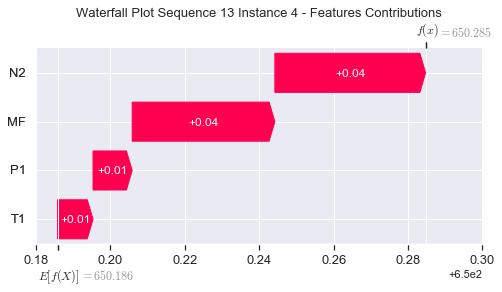

None

Contribution: [0.01231669 0.01097686 0.04421262 0.04138293]


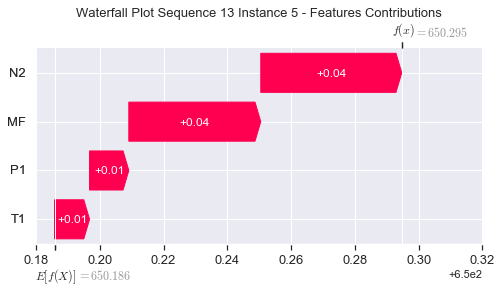

None

Contribution: [0.01449101 0.0128396  0.0505236  0.04720298]


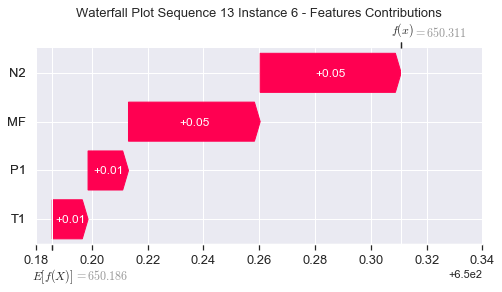

None

Contribution: [0.01546749 0.01364501 0.05319709 0.04995778]


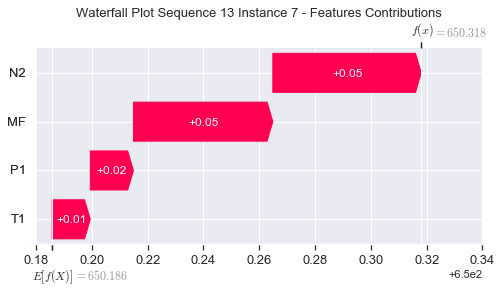

None

Contribution: [0.01552884 0.01373972 0.0529918  0.05019937]


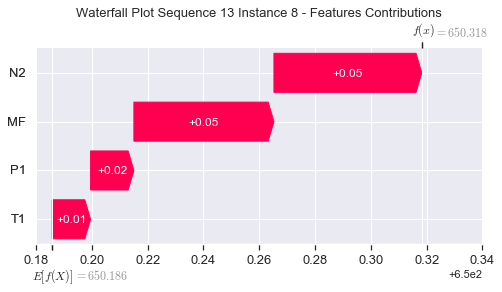

None

Contribution: [0.01526206 0.01337039 0.05124039 0.04943202]


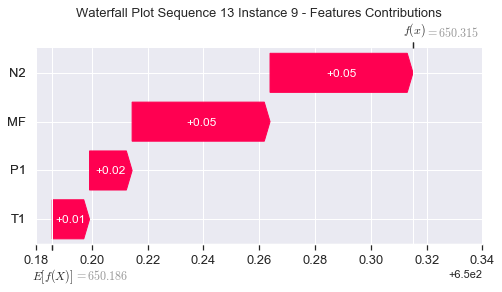

None

Contribution: [0.01476629 0.01141669 0.04980083 0.0477837 ]


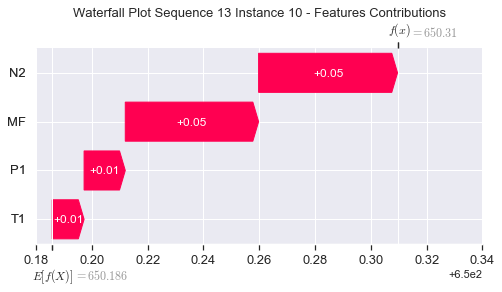

None

Contribution: [0.01505016 0.01331473 0.04993078 0.04840621]


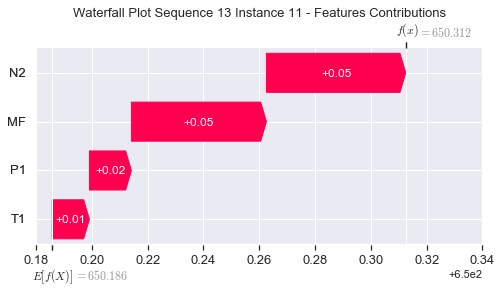

None

Contribution: [0.01503574 0.01332604 0.05023011 0.04822331]


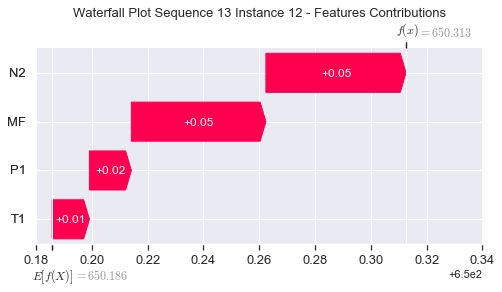

None

Contribution: [0.01534481 0.01349237 0.05104058 0.04910335]


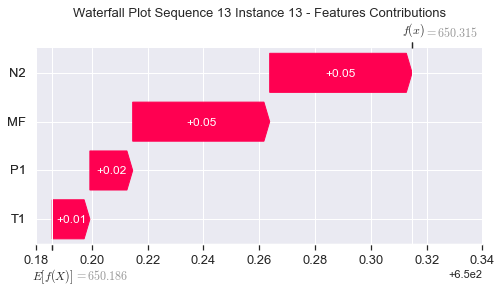

None

Contribution: [0.01601458 0.01435912 0.05267062 0.05132918]


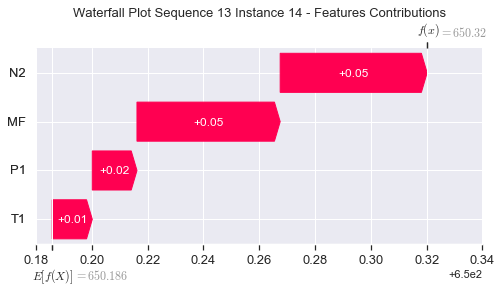

None

Contribution: [0.01644203 0.01436601 0.05444262 0.05244139]


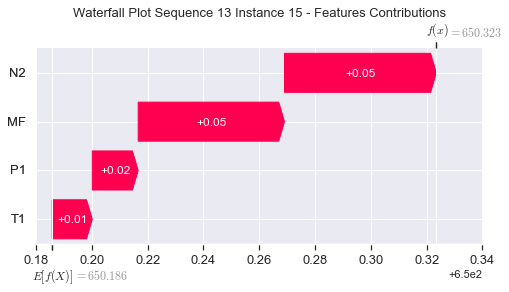

None

Contribution: [0.01720858 0.0146396  0.05693193 0.05492413]


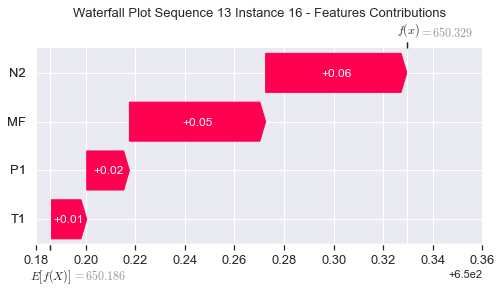

None

Contribution: [0.01821008 0.01578391 0.05992001 0.05781699]


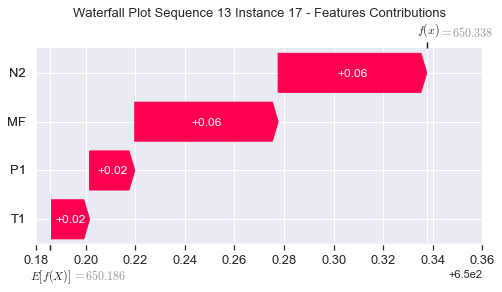

None

Contribution: [0.01957268 0.01701709 0.06439387 0.06205396]


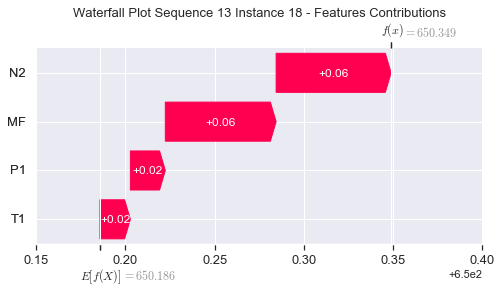

None

Contribution: [0.02100864 0.01844353 0.06988293 0.06690496]


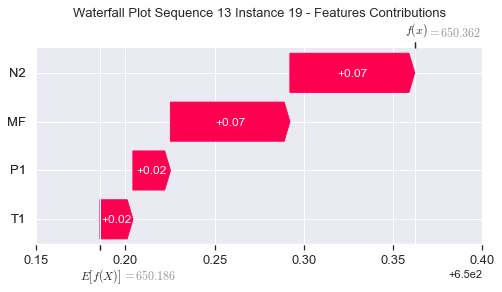

None

Contribution: [0.02629904 0.0248924  0.08665824 0.08222241]


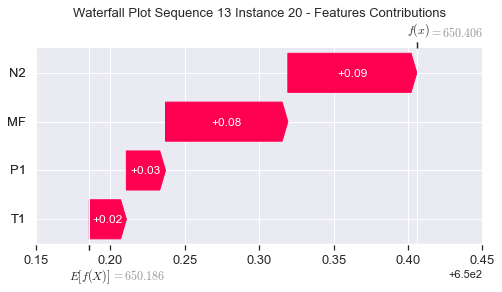

None

Contribution: [0.03569379 0.04542776 0.11525192 0.10337976]


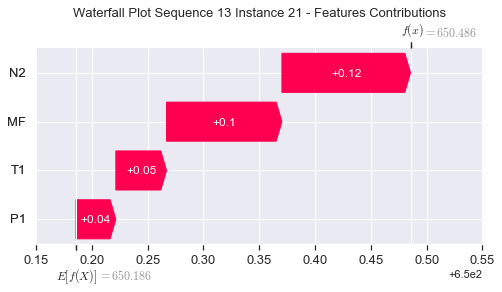

None

Contribution: [0.08185358 0.08531998 0.27538905 0.25783156]


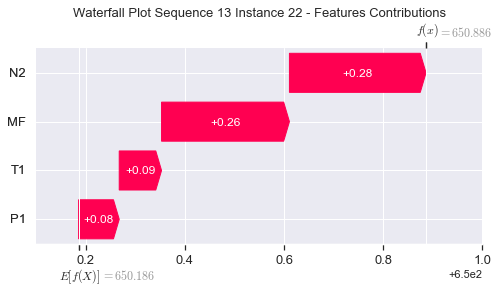

None

Contribution: [0.129811   0.08192186 0.47217192 0.47191537]


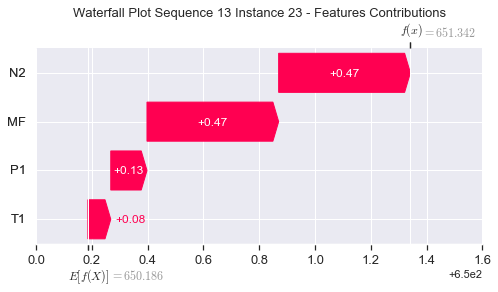

None

Contribution: [ 0.33483716 -1.31991849  1.57067388  2.13334574]


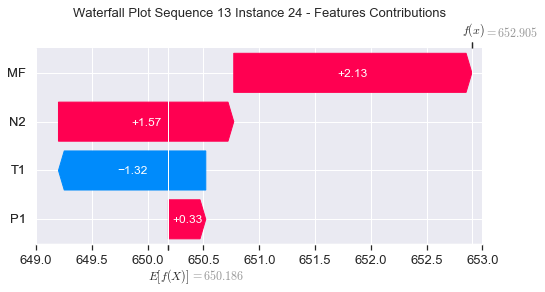

None

Contribution: [ 0.37013401 -0.10598163  1.49116177  1.5383569 ]


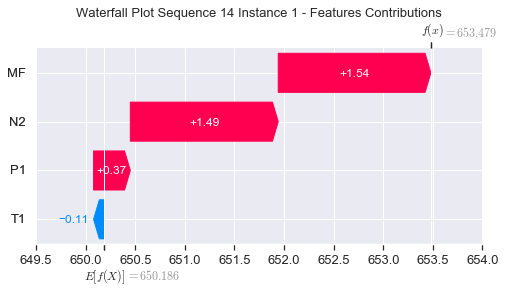

None

Contribution: [0.00043802 0.01907911 0.01950228 0.00559222]


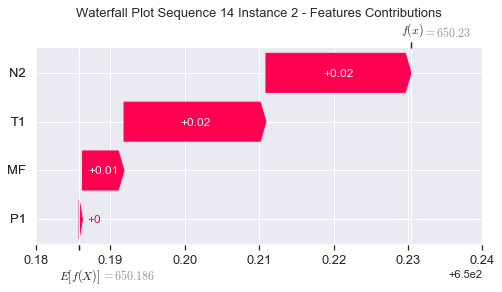

None

Contribution: [0.01261802 0.01290794 0.054728   0.05362843]


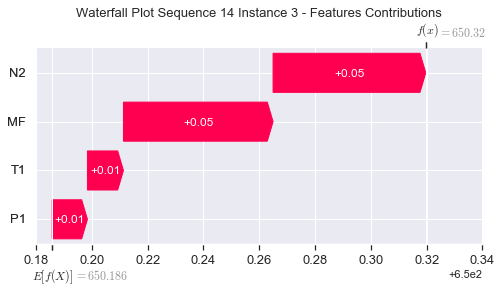

None

Contribution: [0.0108837  0.01148463 0.04052072 0.03946725]


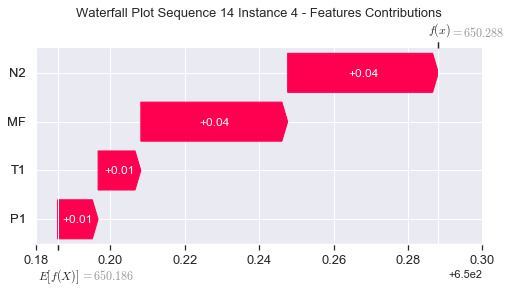

None

Contribution: [0.01235687 0.01346189 0.04387559 0.04125291]


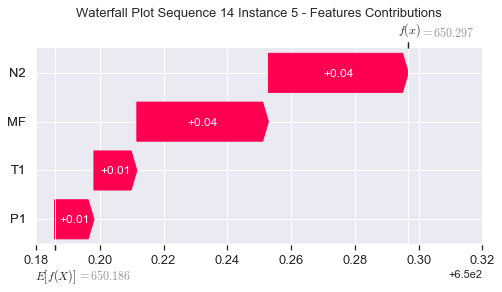

None

Contribution: [0.01442976 0.01479247 0.05014402 0.04717523]


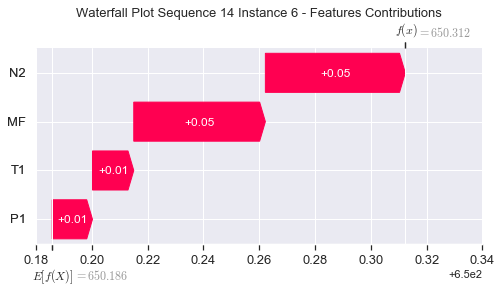

None

Contribution: [0.01542721 0.01549106 0.05285586 0.05001286]


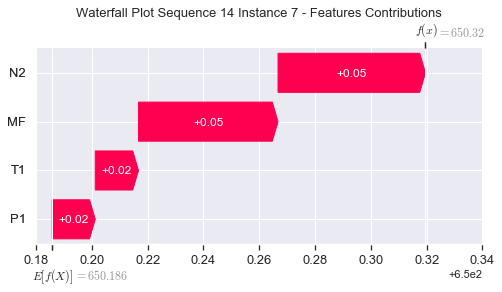

None

Contribution: [0.01548618 0.01552014 0.0526891  0.05007458]


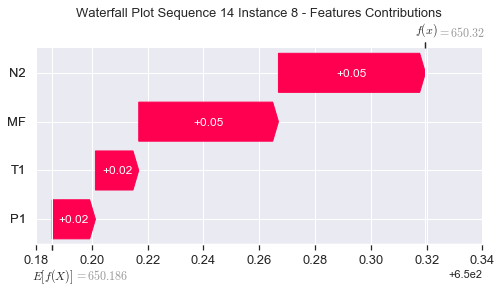

None

Contribution: [0.01515762 0.01569362 0.05083288 0.04846966]


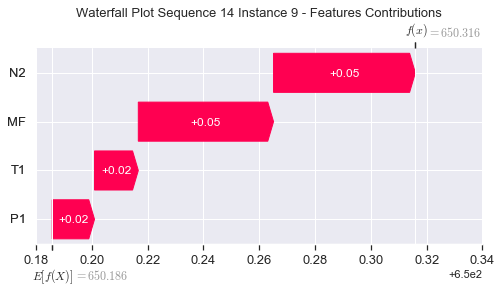

None

Contribution: [0.01489585 0.0151841  0.04968854 0.04796407]


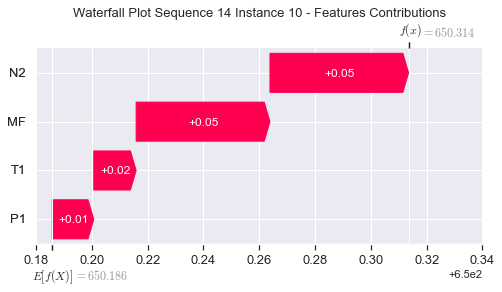

None

Contribution: [0.01487611 0.01506105 0.04966963 0.04738892]


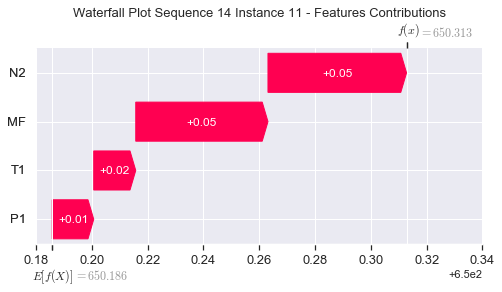

None

Contribution: [0.01497168 0.01404958 0.05010276 0.04817047]


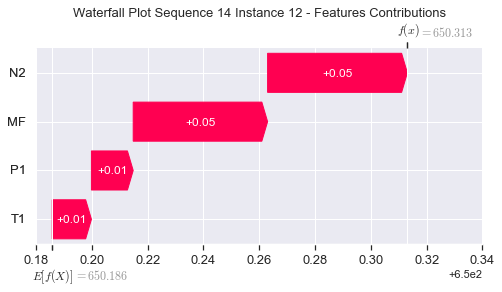

None

Contribution: [0.01533767 0.0143203  0.05101328 0.04914535]


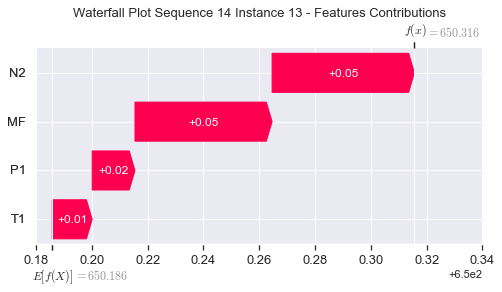

None

Contribution: [0.01590486 0.01463632 0.05245166 0.05041628]


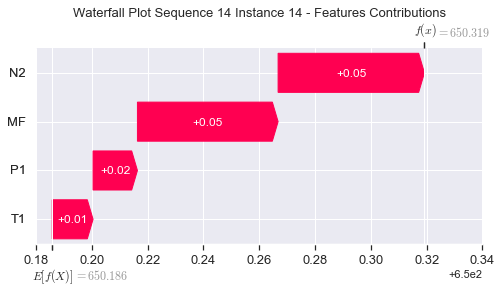

None

Contribution: [0.01646946 0.01491595 0.05443816 0.05248027]


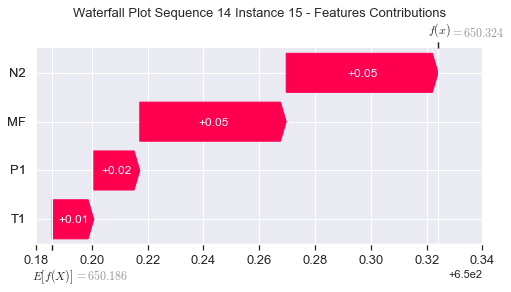

None

Contribution: [0.01720084 0.0143849  0.05694016 0.05532066]


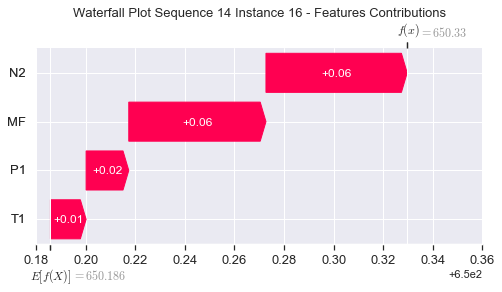

None

Contribution: [0.0182348  0.01610136 0.05992452 0.05783474]


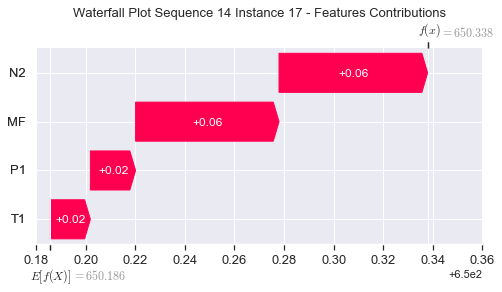

None

Contribution: [0.01958263 0.01711258 0.06437404 0.0619949 ]


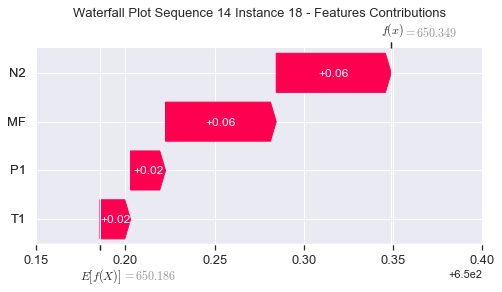

None

Contribution: [0.02147783 0.01834749 0.07006656 0.06724843]


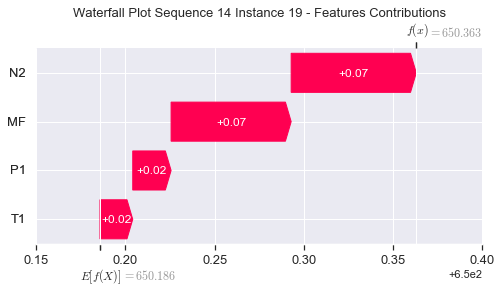

None

Contribution: [0.02640285 0.02498809 0.08680648 0.08224311]


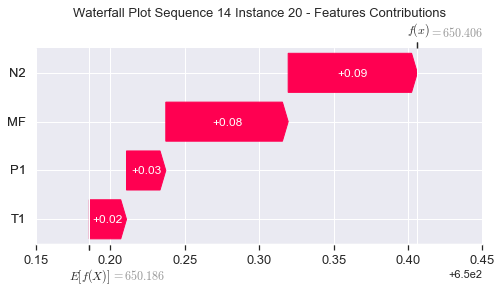

None

Contribution: [0.03574514 0.04569008 0.11570169 0.10415395]


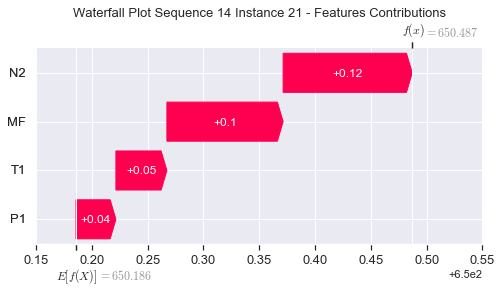

None

Contribution: [0.08223787 0.08444433 0.2760165  0.2573465 ]


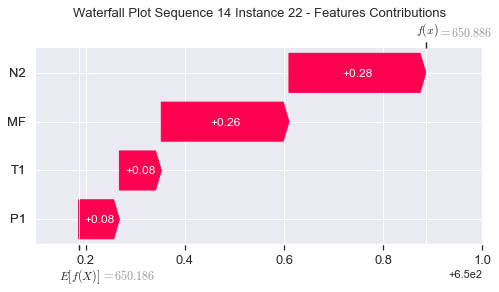

None

Contribution: [0.13073173 0.06488296 0.47291267 0.46513642]


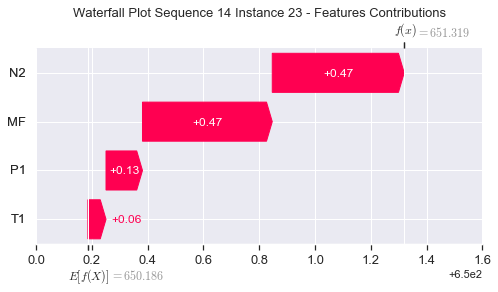

None

Contribution: [ 0.3447017  -1.55367001  1.53812297  1.95938618]


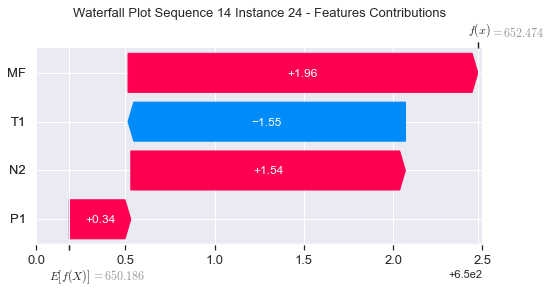

None

Contribution: [ 0.35812741 -0.21972506  1.45576468  1.45827617]


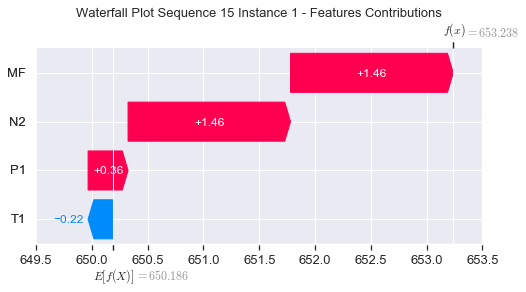

None

Contribution: [0.00030704 0.02282159 0.02017177 0.00854548]


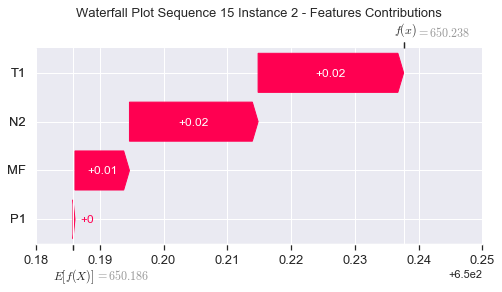

None

Contribution: [0.01295149 0.00989965 0.05483267 0.05263196]


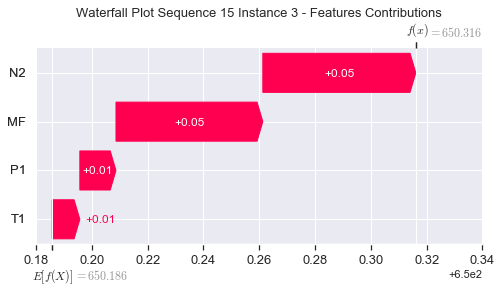

None

Contribution: [0.01034    0.00912741 0.04043522 0.03788491]


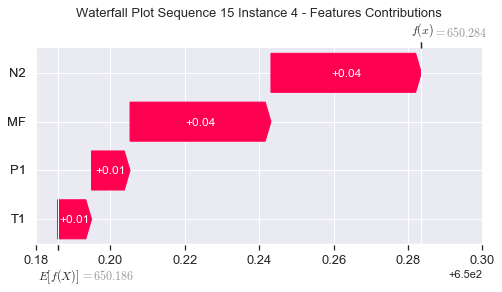

None

Contribution: [0.01236386 0.01212547 0.04422503 0.04154   ]


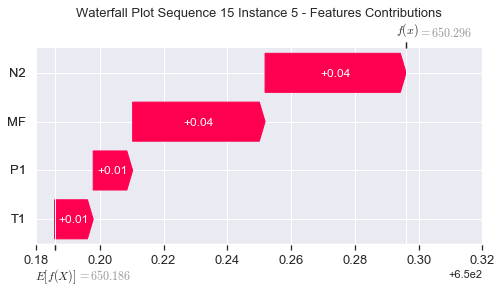

None

Contribution: [0.01456549 0.01350302 0.05046308 0.04776432]


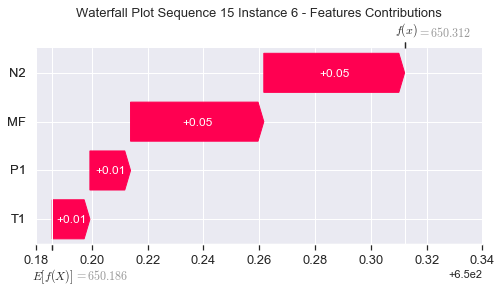

None

Contribution: [0.01553727 0.01444224 0.05314148 0.05052155]


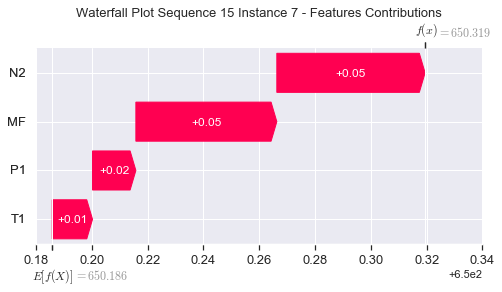

None

Contribution: [0.01554855 0.01444306 0.05294065 0.05048462]


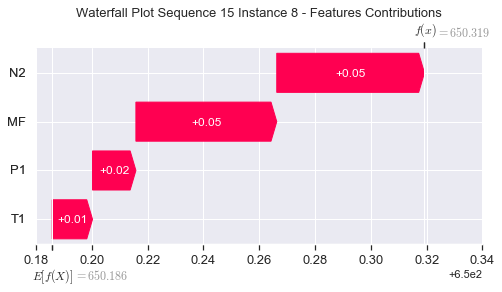

None

Contribution: [0.01496457 0.01440934 0.05100626 0.04881366]


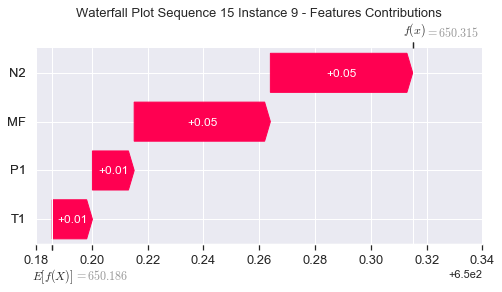

None

Contribution: [0.01491712 0.01394789 0.0499137  0.04833875]


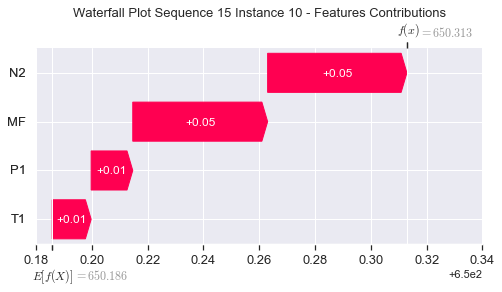

None

Contribution: [0.01467918 0.01367278 0.0497281  0.04743177]


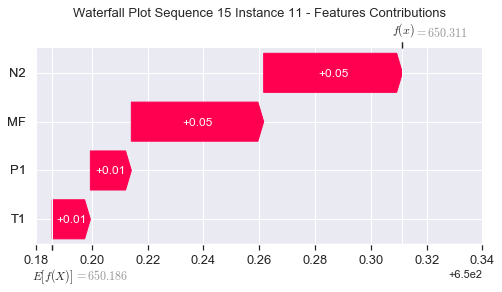

None

Contribution: [0.01497143 0.01375242 0.05020926 0.04811815]


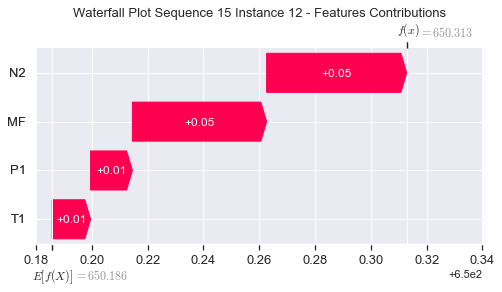

None

Contribution: [0.01530968 0.01403248 0.05104962 0.04905513]


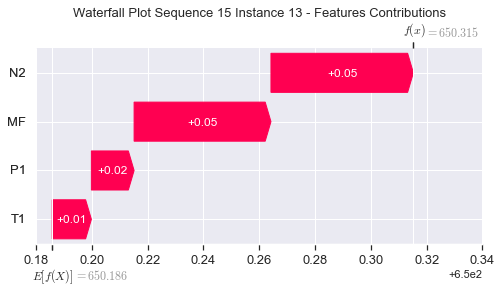

None

Contribution: [0.01612018 0.01368285 0.05271825 0.0514511 ]


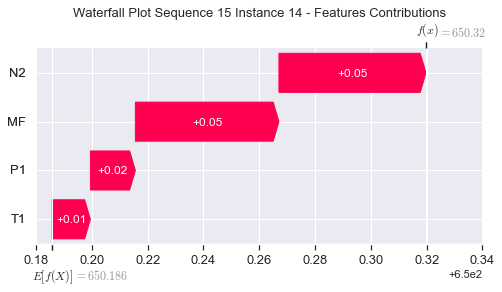

None

Contribution: [0.01642081 0.01465302 0.05441754 0.05245991]


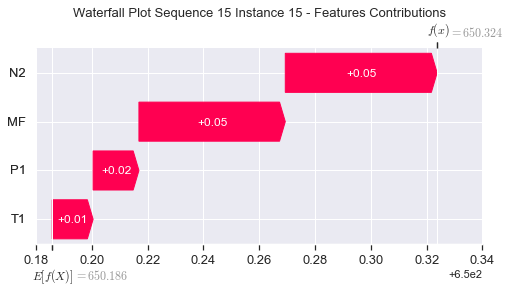

None

Contribution: [0.01734557 0.01544396 0.05698622 0.05551182]


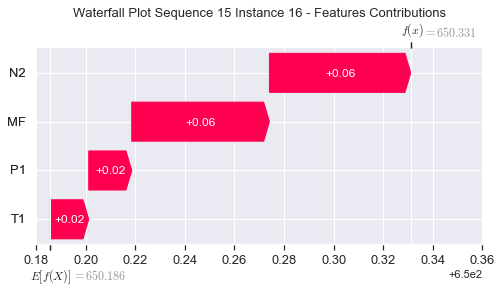

None

Contribution: [0.01822873 0.01607642 0.05995088 0.05788654]


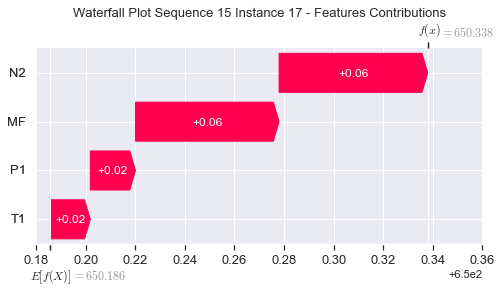

None

Contribution: [0.01960588 0.01714888 0.06442475 0.06209642]


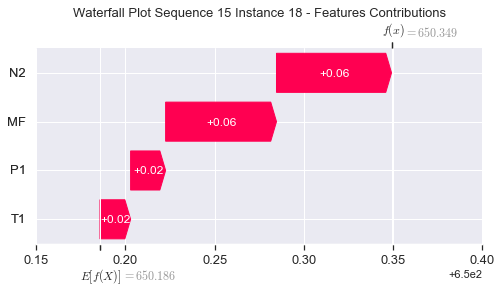

None

Contribution: [0.02149582 0.01927244 0.0699768  0.06686982]


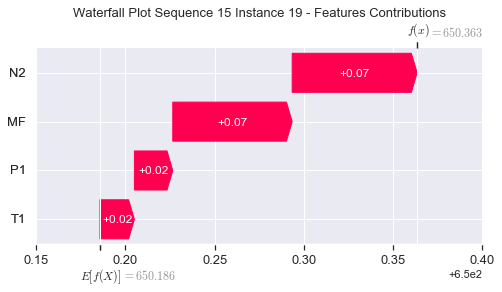

None

Contribution: [0.02638538 0.02512969 0.08684771 0.08226124]


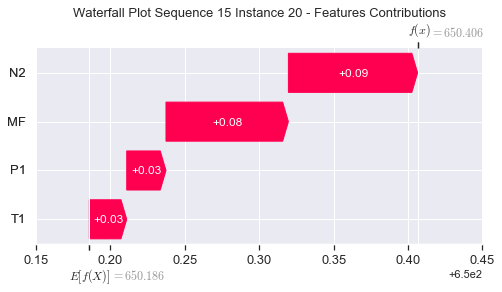

None

Contribution: [0.03581687 0.0453797  0.11563289 0.10422999]


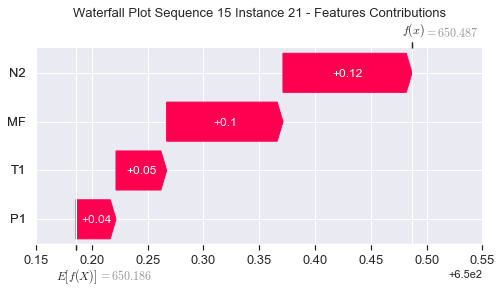

None

Contribution: [0.08187164 0.08548223 0.27591253 0.25644428]


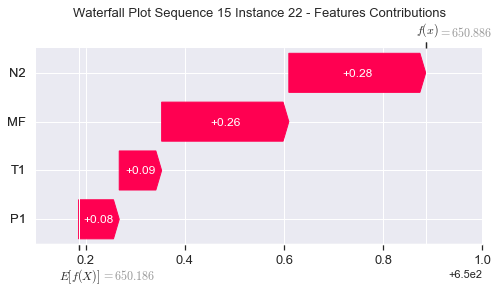

None

Contribution: [0.12905817 0.07514696 0.47224788 0.46030354]


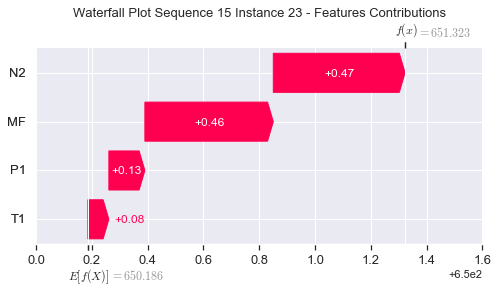

None

Contribution: [ 0.35979767 -1.47019098  1.57327023  2.1227153 ]


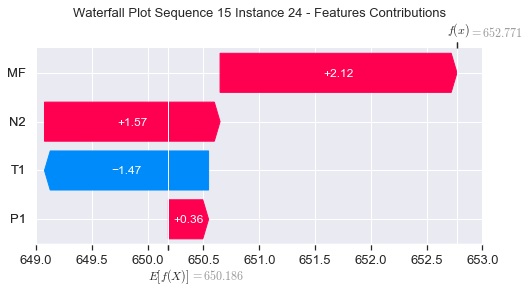

None

Contribution: [ 0.40220491 -0.18309266  1.49601787  1.77246734]


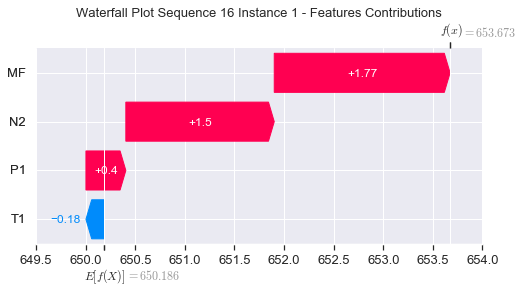

None

Contribution: [0.001483   0.01927218 0.0205899  0.0114448 ]


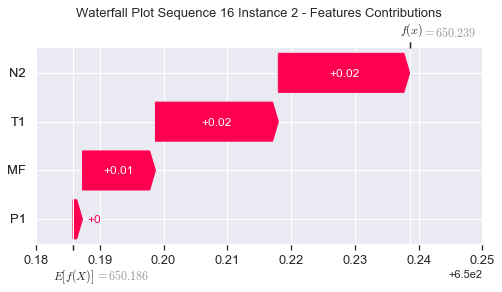

None

Contribution: [0.01249958 0.01130818 0.05487708 0.05334666]


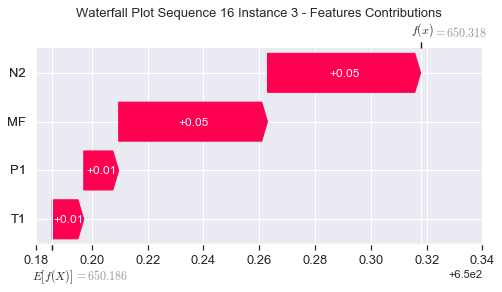

None

Contribution: [0.01070915 0.01071414 0.04046658 0.03769927]


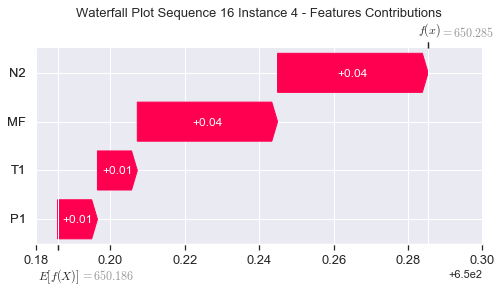

None

Contribution: [0.01248686 0.0118013  0.04421153 0.04183515]


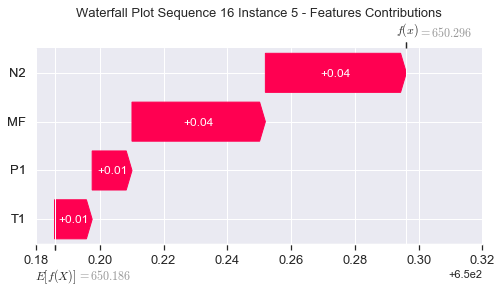

None

Contribution: [0.01465259 0.01329041 0.05054242 0.04796892]


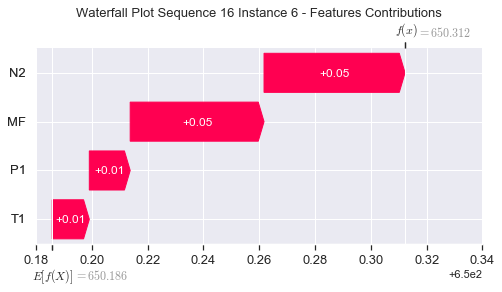

None

Contribution: [0.01560478 0.01422398 0.05326152 0.05070163]


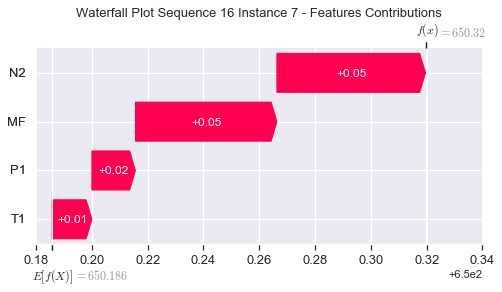

None

Contribution: [0.01565715 0.01405049 0.05312    0.05080866]


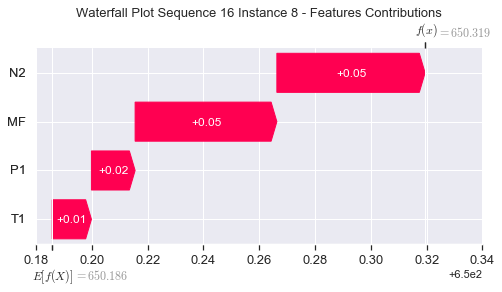

None

Contribution: [0.01512232 0.01321888 0.05121762 0.04931122]


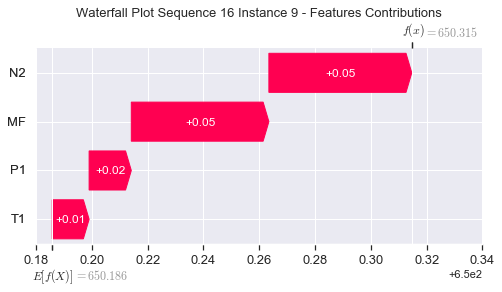

None

Contribution: [0.01487873 0.01365765 0.05008133 0.04838585]


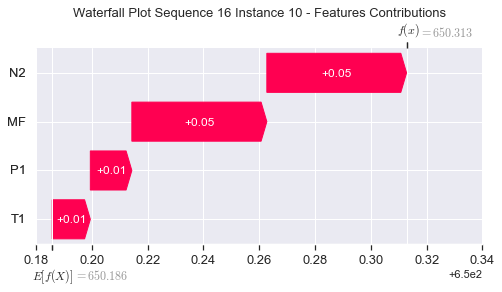

None

Contribution: [0.01495285 0.01221467 0.05000309 0.04841934]


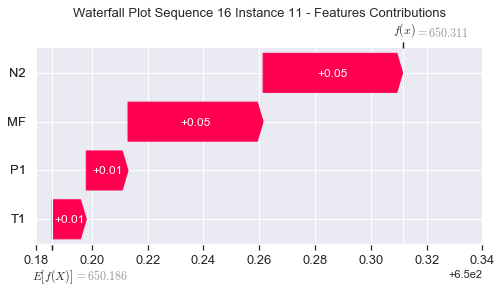

None

Contribution: [0.01504277 0.01302918 0.05045395 0.04878805]


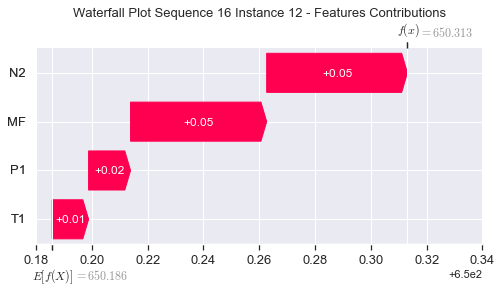

None

Contribution: [0.01537064 0.01336771 0.05132858 0.0496469 ]


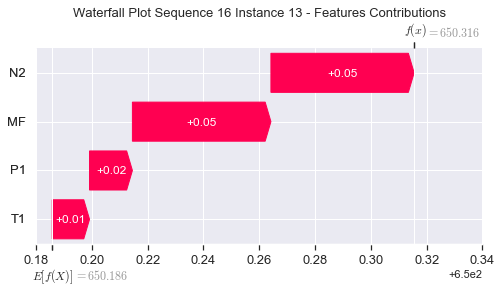

None

Contribution: [0.01581287 0.0135605  0.05277111 0.05085104]


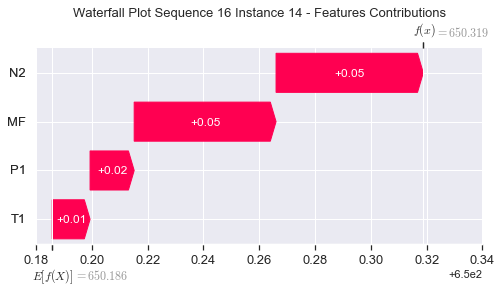

None

Contribution: [0.01654714 0.01397654 0.05481243 0.0529216 ]


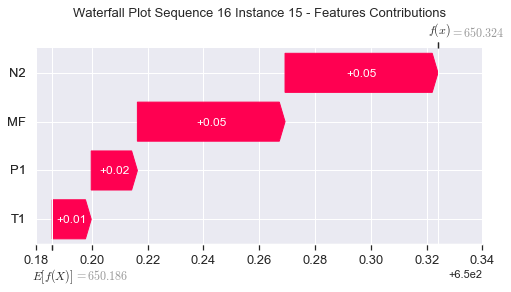

None

Contribution: [0.01709733 0.01381999 0.05706292 0.05433106]


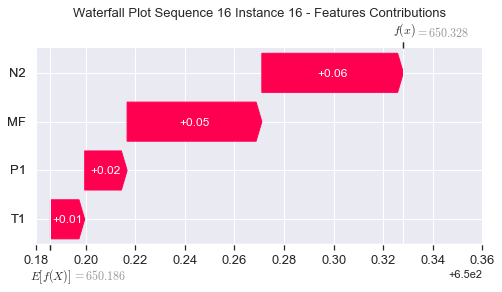

None

Contribution: [0.01827419 0.01538556 0.06025723 0.05811064]


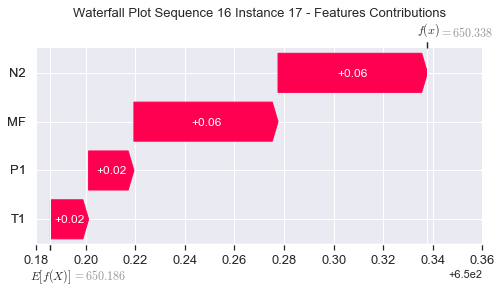

None

Contribution: [0.01962232 0.01642622 0.06463001 0.06217004]


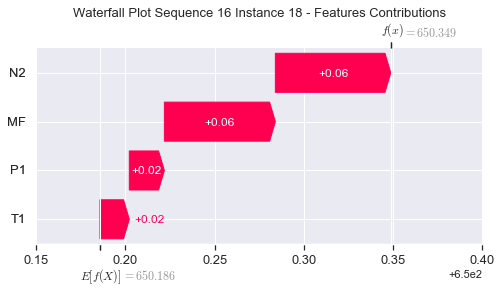

None

Contribution: [0.02157757 0.01810625 0.07025852 0.06791914]


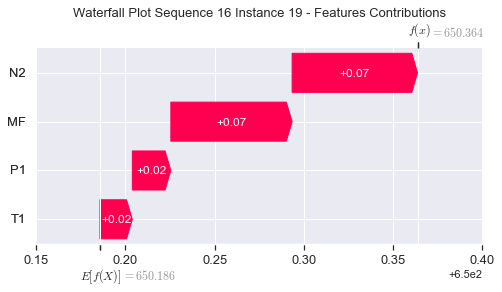

None

Contribution: [0.02645814 0.02465267 0.08714007 0.08230043]


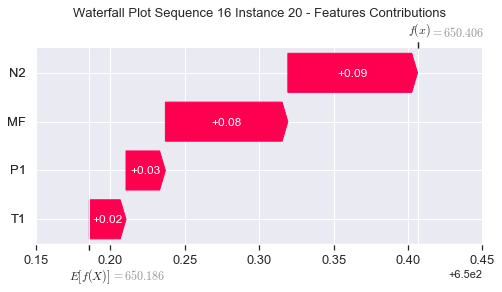

None

Contribution: [0.03607123 0.04693565 0.11647761 0.10531818]


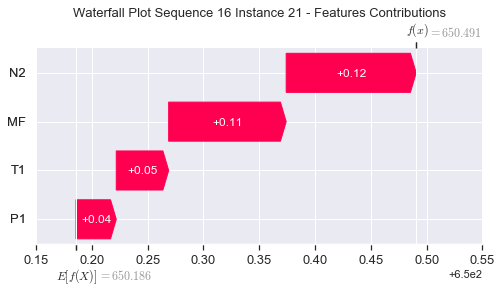

None

Contribution: [0.08221964 0.08257183 0.27667769 0.2568818 ]


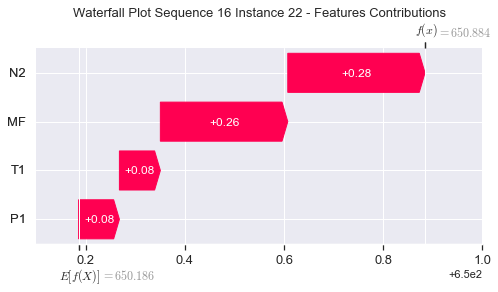

None

Contribution: [0.12920809 0.04533838 0.4726562  0.45840257]


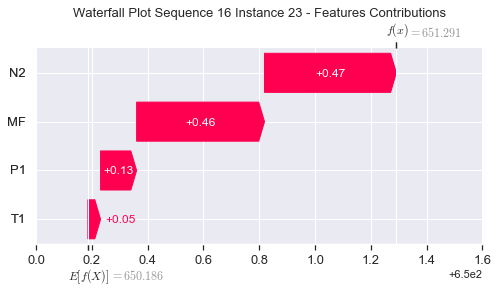

None

Contribution: [ 0.36104628 -1.79323755  1.52760467  1.95618086]


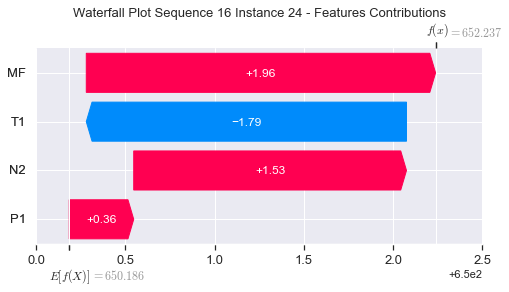

None

Contribution: [ 0.39336171 -0.21570992  1.49437222  1.69952397]


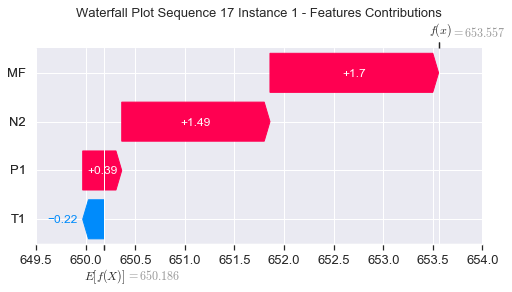

None

Contribution: [0.00140687 0.02420862 0.02099094 0.01124477]


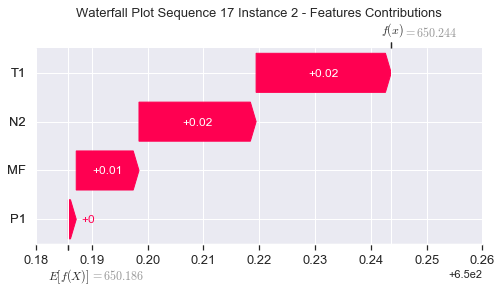

None

Contribution: [0.01337641 0.00855962 0.05517906 0.05306065]


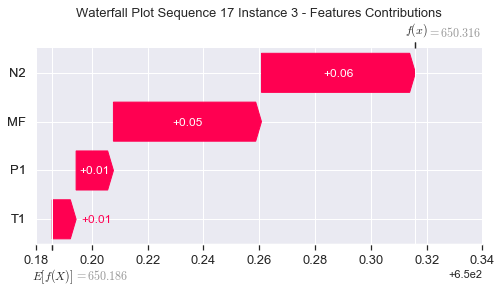

None

Contribution: [0.01114224 0.00902456 0.04103953 0.03964285]


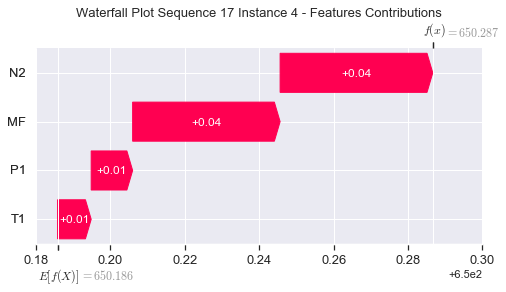

None

Contribution: [0.01254733 0.01066175 0.04442274 0.04169843]


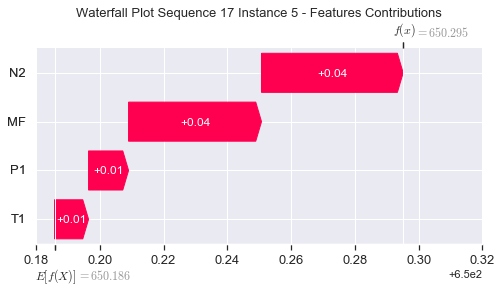

None

Contribution: [0.0146351  0.01237418 0.05082467 0.04768542]


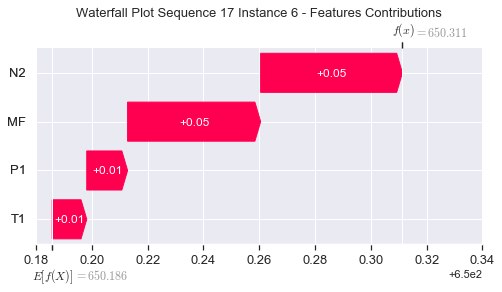

None

Contribution: [0.01563131 0.0131893  0.0535579  0.05045376]


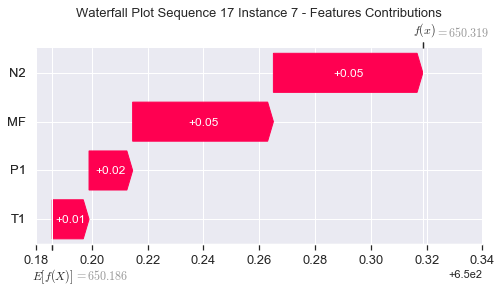

None

Contribution: [0.01567347 0.01321552 0.05338232 0.05053235]


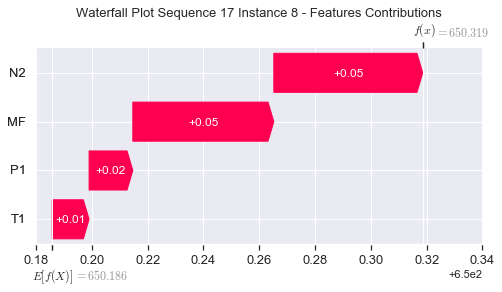

None

Contribution: [0.01520153 0.01270906 0.05136186 0.0489735 ]


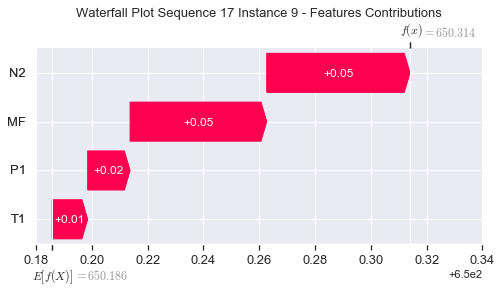

None

Contribution: [0.01485433 0.01292076 0.05040636 0.04819832]


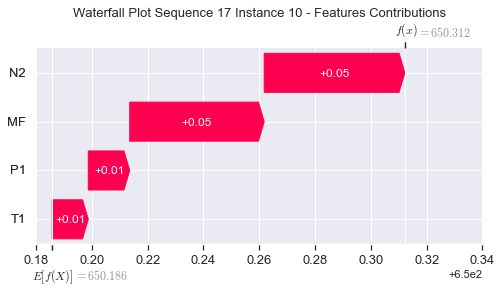

None

Contribution: [0.01492027 0.01240888 0.05011546 0.04783981]


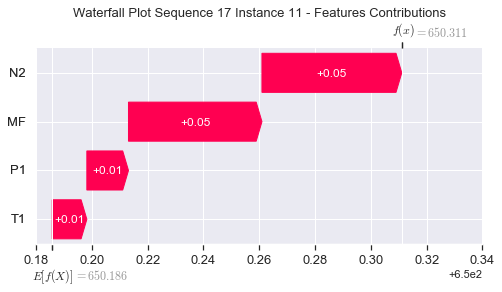

None

Contribution: [0.01513446 0.01230261 0.05065741 0.04835348]


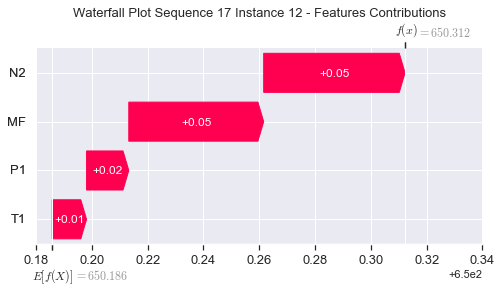

None

Contribution: [0.01549651 0.01253636 0.05159829 0.04931586]


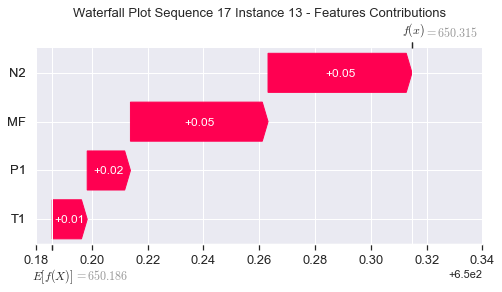

None

Contribution: [0.01570911 0.01233527 0.05303159 0.05052714]


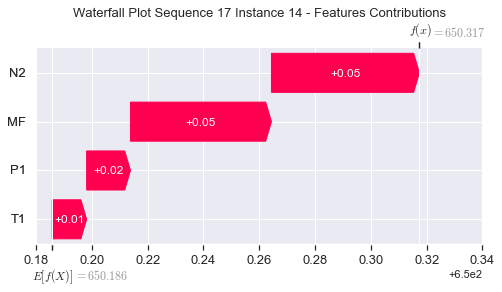

None

Contribution: [0.0166135  0.01323872 0.05495171 0.05249576]


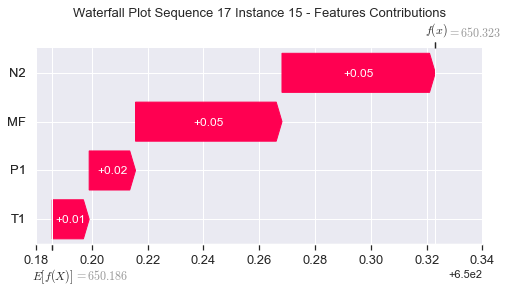

None

Contribution: [0.0177715  0.01414302 0.05761121 0.05535398]


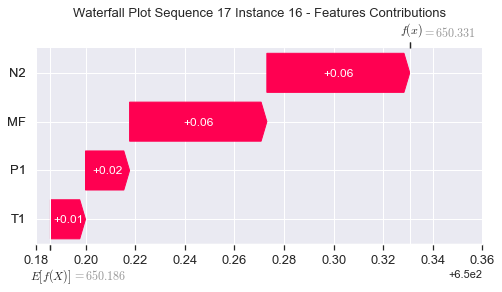

None

Contribution: [0.01836774 0.01452038 0.06052093 0.05773695]


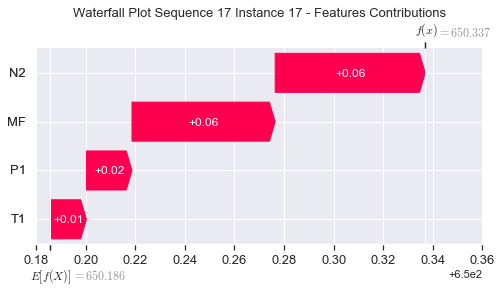

None

Contribution: [0.01972445 0.01568343 0.06501253 0.06186255]


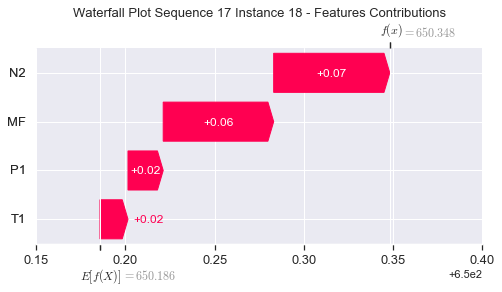

None

Contribution: [0.02171207 0.01844185 0.07076894 0.06702014]


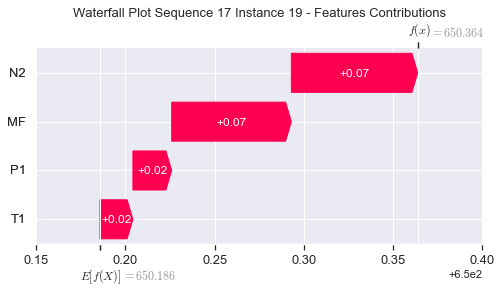

None

Contribution: [0.02662588 0.02417783 0.08768553 0.08235874]


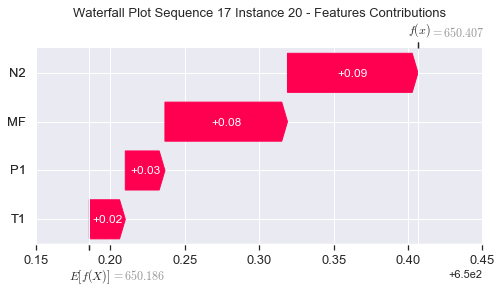

None

Contribution: [0.03621958 0.04844265 0.11703514 0.10655678]


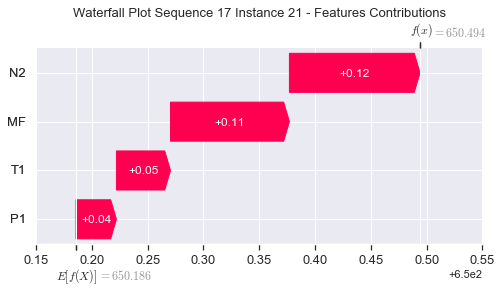

None

Contribution: [0.08270276 0.08090419 0.27800952 0.25653327]


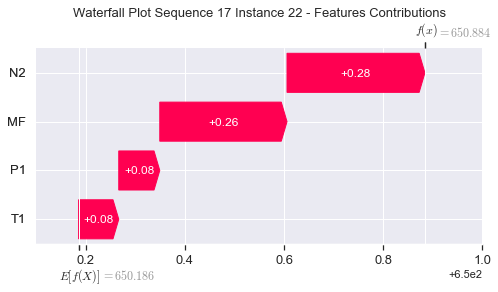

None

Contribution: [0.13017832 0.03105597 0.47697396 0.44839372]


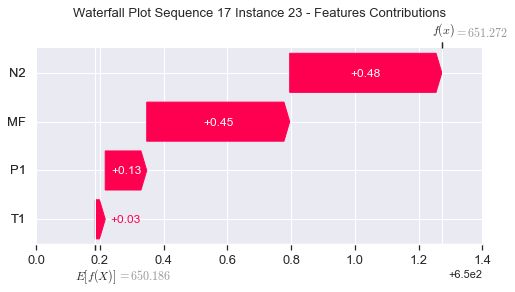

None

Contribution: [ 0.39907319 -2.0690538   1.57943253  1.85159822]


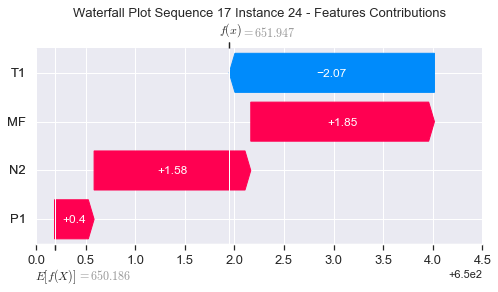

None

Contribution: [ 0.45548009 -0.39965664  1.5018964   1.73056356]


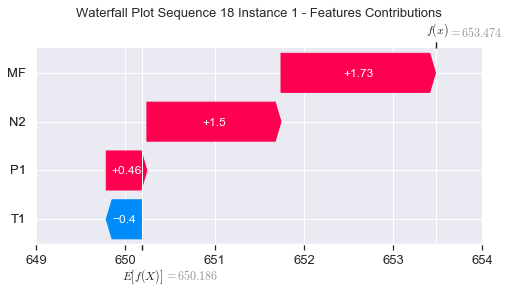

None

Contribution: [0.00046821 0.02608446 0.02032893 0.01221582]


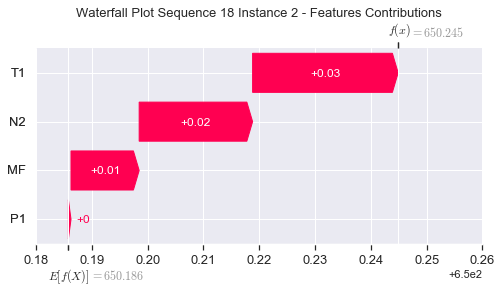

None

Contribution: [0.01347364 0.00811965 0.0552682  0.05319236]


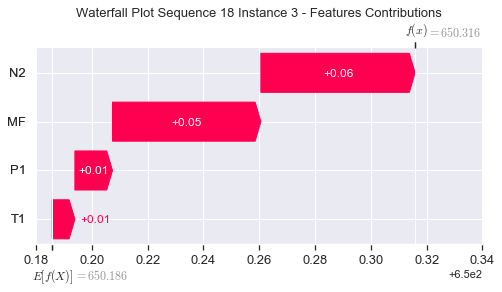

None

Contribution: [0.01056384 0.00801588 0.04054287 0.03802765]


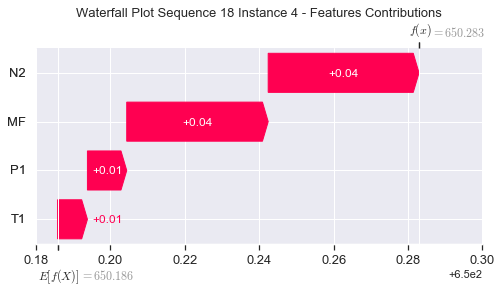

None

Contribution: [0.01252709 0.0108578  0.04431769 0.04185827]


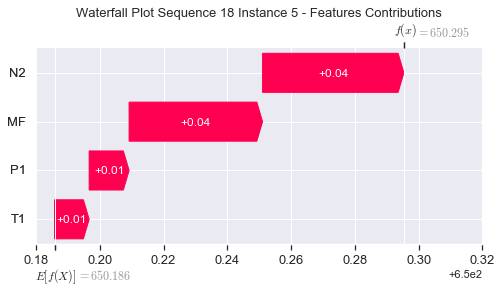

None

Contribution: [0.01478941 0.0128114  0.05062373 0.04828651]


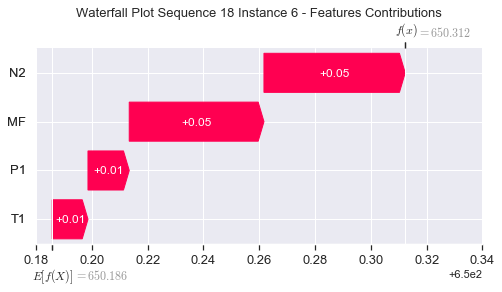

None

Contribution: [0.01582872 0.01370278 0.05330454 0.05104025]


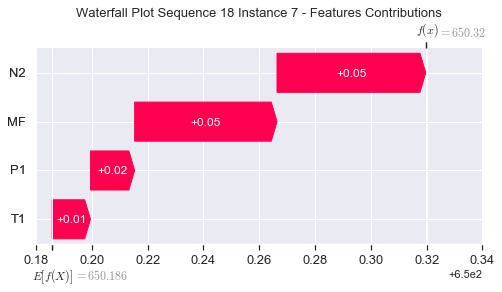

None

Contribution: [0.01580675 0.01372365 0.05310821 0.05096124]


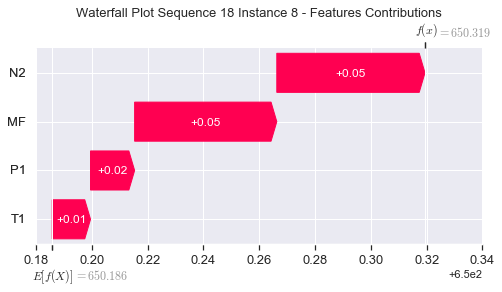

None

Contribution: [0.01527459 0.01370039 0.0511832  0.04915697]


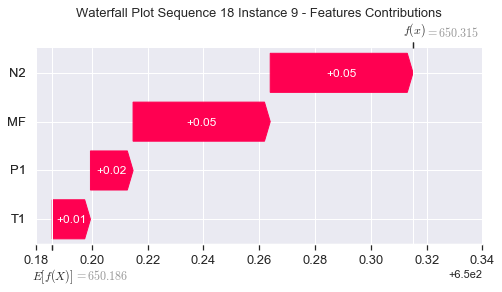

None

Contribution: [0.01524132 0.01312595 0.04994511 0.04814422]


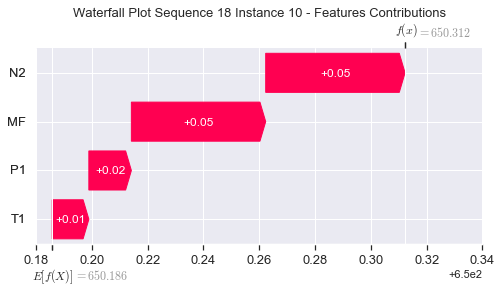

None

Contribution: [0.01502044 0.01324786 0.04989217 0.0483306 ]


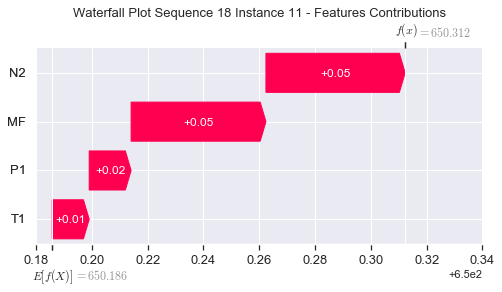

None

Contribution: [0.0155878  0.01314292 0.05043363 0.04934856]


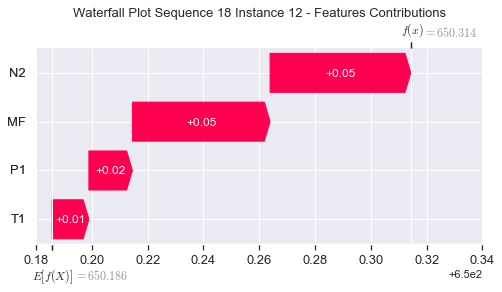

None

Contribution: [0.01589296 0.01337596 0.05130545 0.05008275]


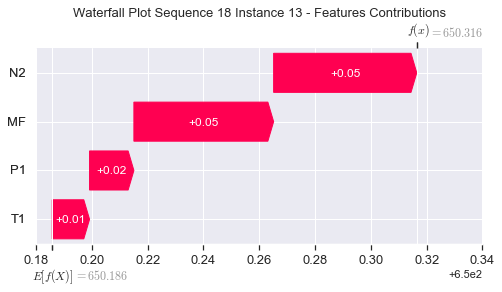

None

Contribution: [0.01602539 0.01418938 0.05268683 0.05076496]


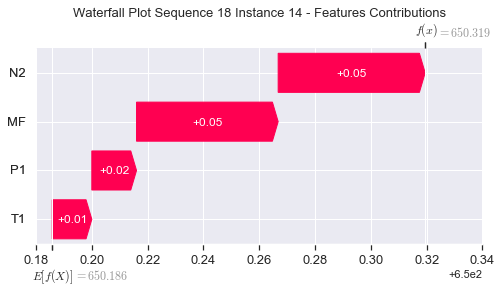

None

Contribution: [0.01693883 0.01404576 0.05473944 0.05322451]


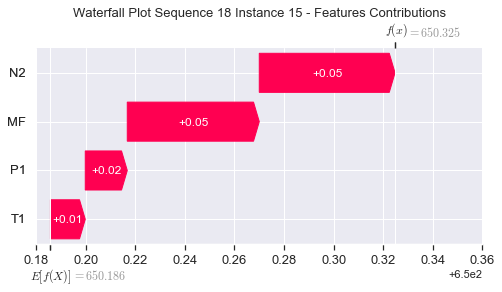

None

Contribution: [0.01737345 0.01504578 0.05697201 0.05465945]


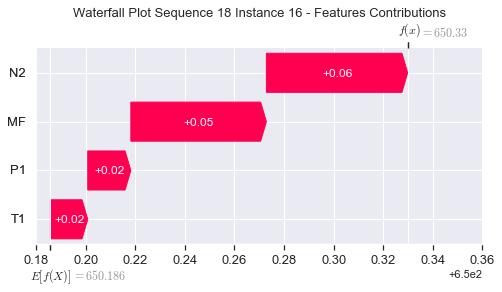

None

Contribution: [0.0187379  0.01540624 0.06023052 0.05837907]


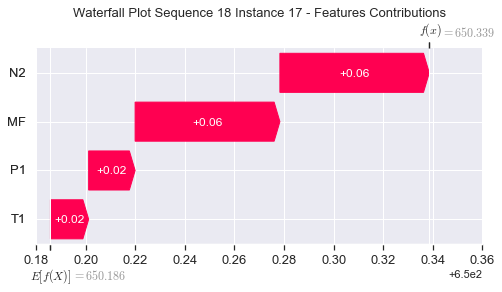

None

Contribution: [0.0200564  0.01648035 0.06466544 0.0624161 ]


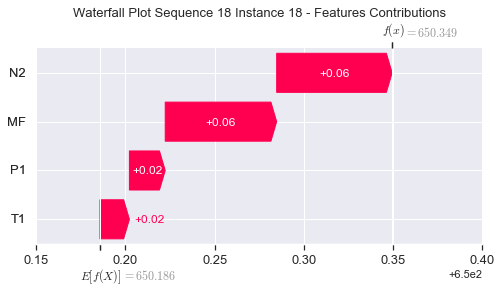

None

Contribution: [0.02180905 0.01837096 0.0703105  0.06749526]


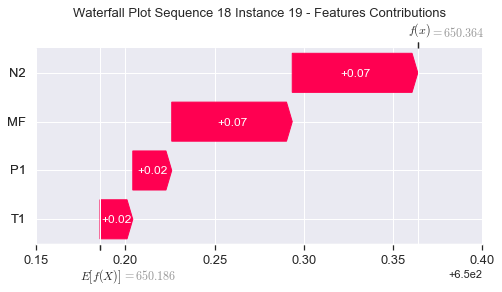

None

Contribution: [0.02666535 0.02445602 0.08716581 0.08220632]


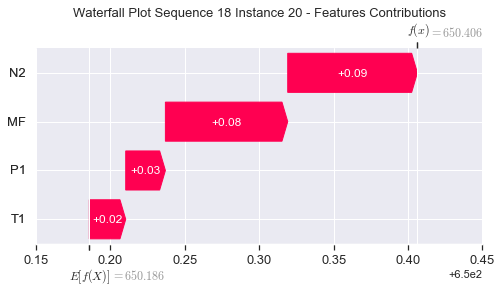

None

Contribution: [0.03564648 0.04710182 0.11616599 0.10523691]


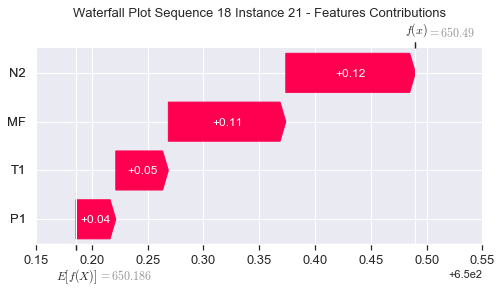

None

Contribution: [0.08297029 0.08222298 0.27698569 0.25645657]


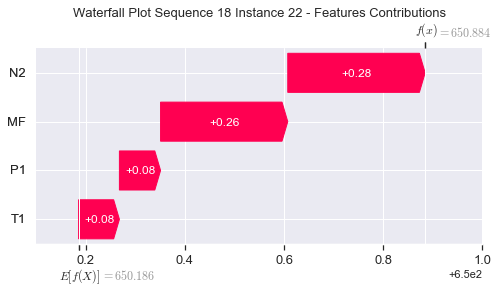

None

Contribution: [0.13680764 0.04840609 0.47562527 0.45693844]


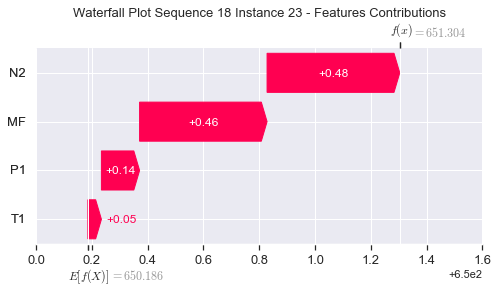

None

Contribution: [ 0.43631238 -1.89426289  1.56819042  1.8385767 ]


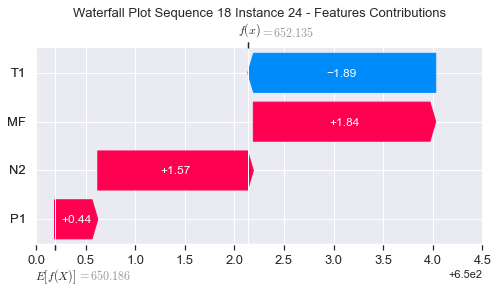

None

Contribution: [ 0.4800053  -0.29603804  1.50068636  1.65450108]


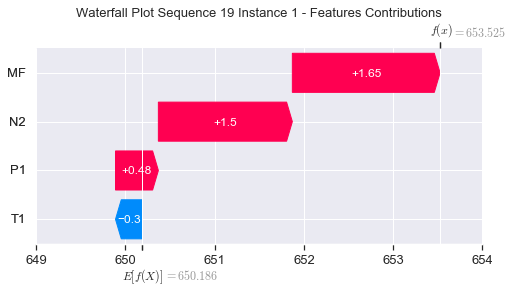

None

Contribution: [-0.00058636  0.02386846  0.02047107  0.01145077]


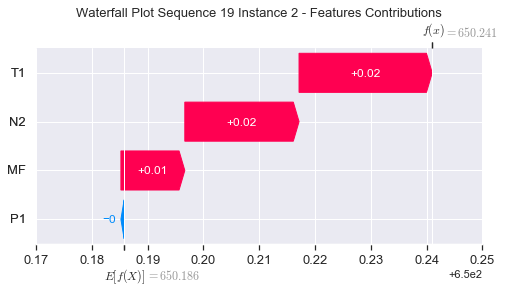

None

Contribution: [0.0127339  0.00879616 0.05485667 0.05194433]


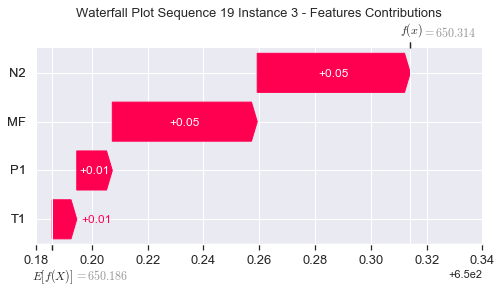

None

Contribution: [0.01092949 0.00873383 0.0408304  0.03854139]


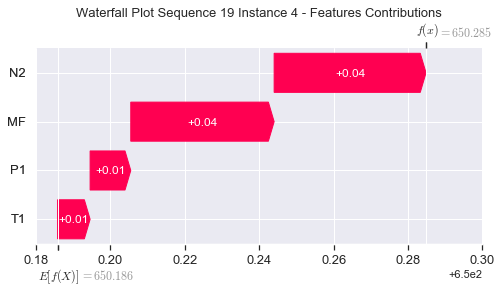

None

Contribution: [0.01268462 0.01104458 0.04447632 0.04206601]


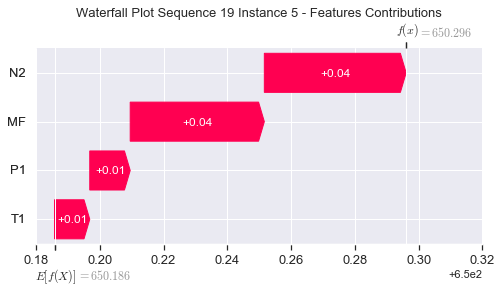

None

Contribution: [0.01473323 0.01265282 0.05066262 0.04766168]


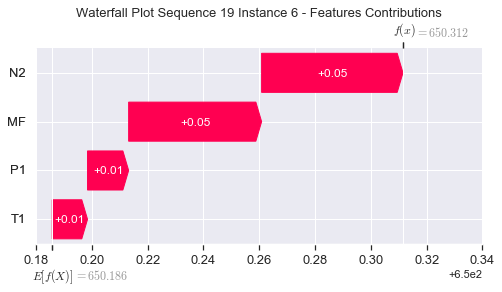

None

Contribution: [0.01578399 0.01364231 0.05339775 0.0504661 ]


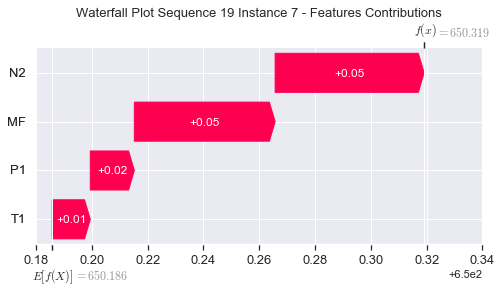

None

Contribution: [0.01579154 0.01357072 0.0531886  0.05055677]


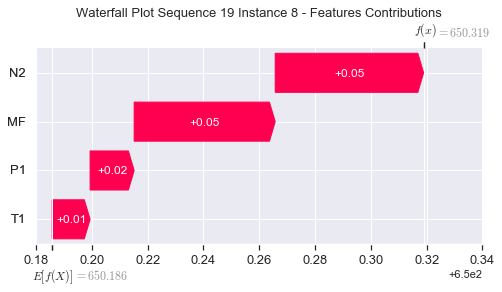

None

Contribution: [0.01533599 0.01341395 0.05138735 0.04925721]


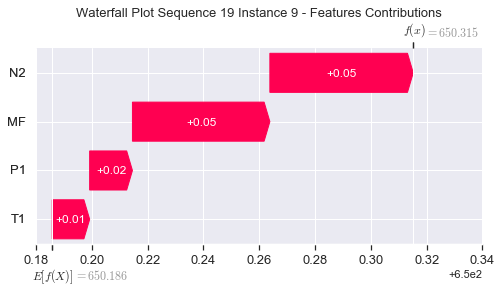

None

Contribution: [0.01515603 0.01311537 0.05014944 0.0480552 ]


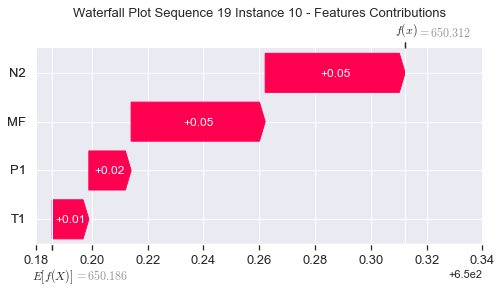

None

Contribution: [0.01493725 0.01250576 0.05006234 0.0479455 ]


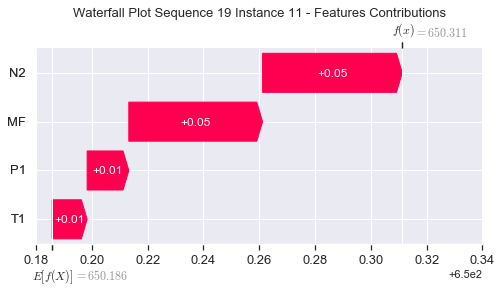

None

Contribution: [0.01529322 0.01260497 0.05045745 0.04833502]


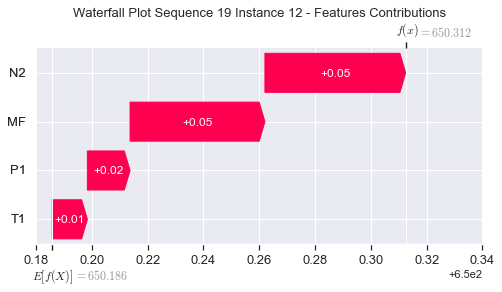

None

Contribution: [0.01565767 0.01291881 0.05127919 0.04925597]


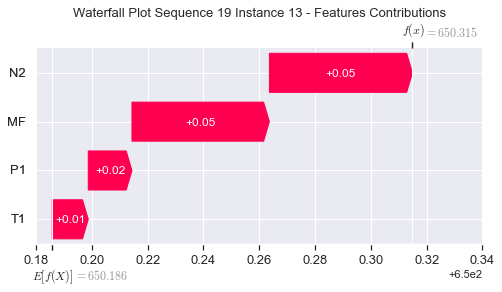

None

Contribution: [0.01632256 0.01341514 0.05302932 0.05160603]


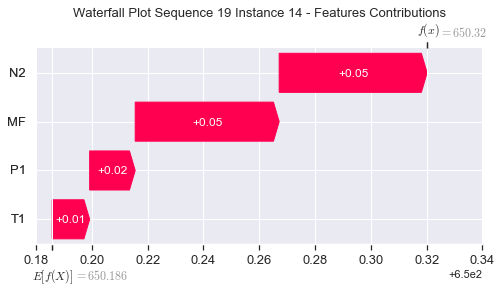

None

Contribution: [0.01681596 0.01359417 0.05465686 0.05252481]


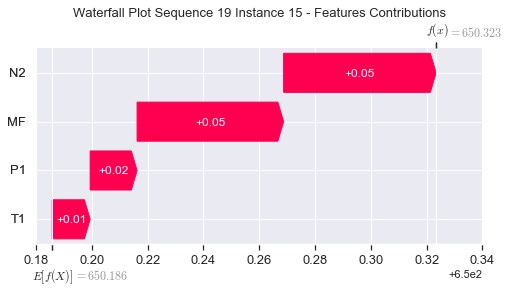

None

Contribution: [0.01756594 0.01464331 0.05720933 0.0551831 ]


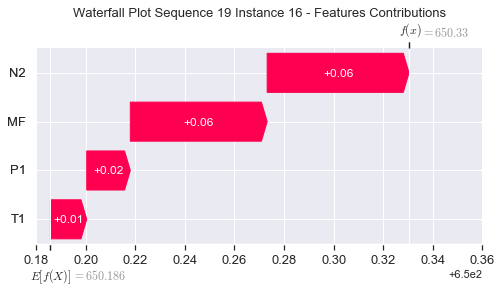

None

Contribution: [0.01867403 0.01503939 0.06021144 0.05787044]


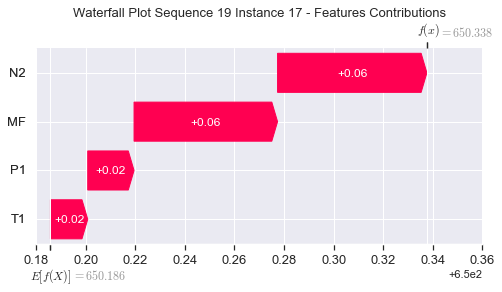

None

Contribution: [0.02005168 0.01612105 0.06471405 0.0620577 ]


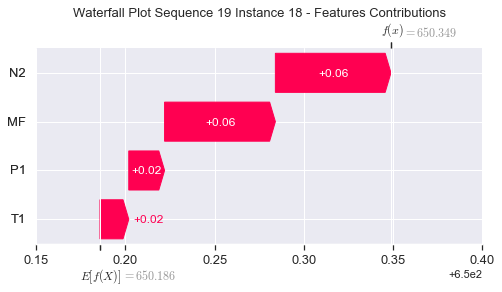

None

Contribution: [0.02157661 0.0182078  0.07024895 0.06658642]


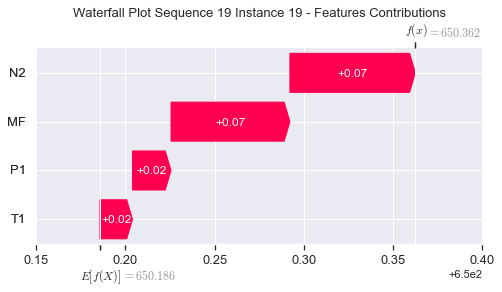

None

Contribution: [0.026862   0.02441768 0.08724578 0.08248791]


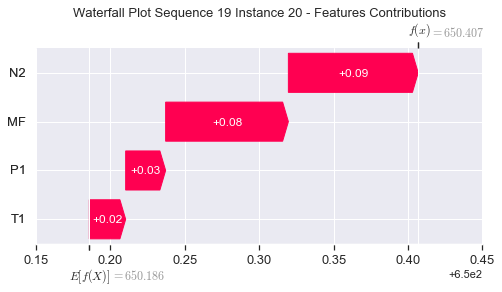

None

Contribution: [0.03551414 0.04731392 0.11659573 0.1052455 ]


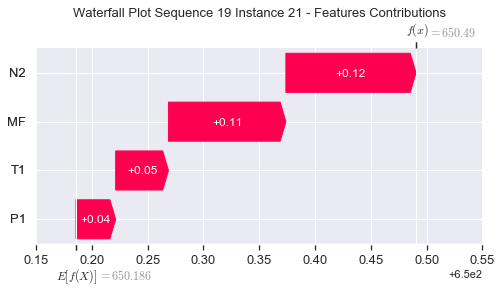

None

Contribution: [0.08374516 0.08141921 0.27682628 0.25777076]


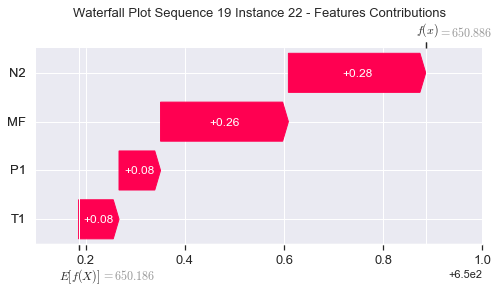

None

Contribution: [0.14083628 0.03858798 0.47149103 0.45946326]


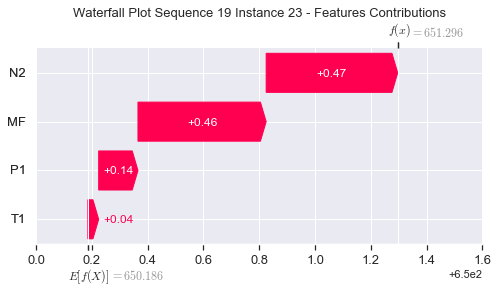

None

Contribution: [ 0.43964127 -2.03161384  1.45961675  1.81162303]


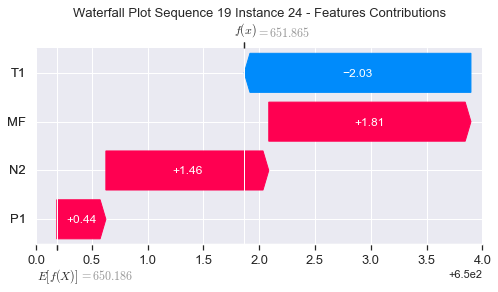

None

Contribution: [ 0.34426182 -0.42728105  1.42389219  1.3947187 ]


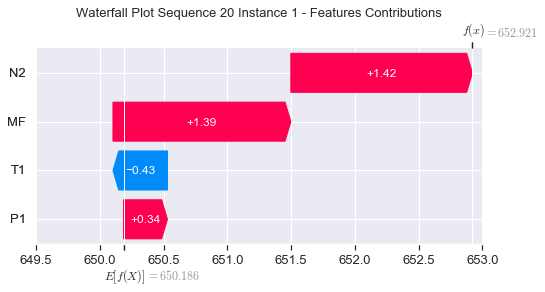

None

Contribution: [-0.00148409  0.02590579  0.02073542  0.00941049]


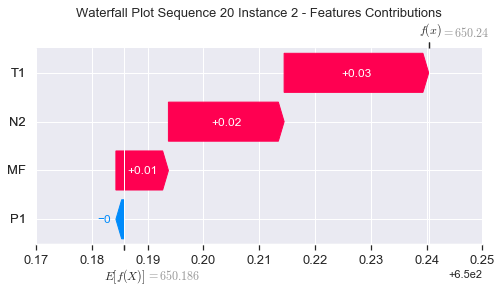

None

Contribution: [0.01358887 0.00847681 0.05498109 0.05255034]


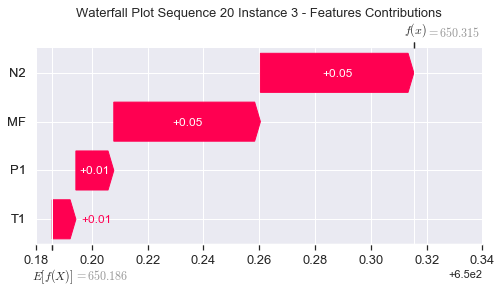

None

Contribution: [0.01067178 0.00923232 0.0405084  0.03719025]


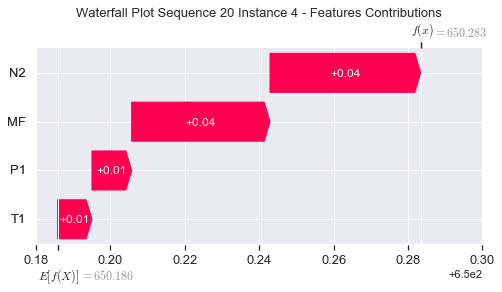

None

Contribution: [0.01289464 0.01167563 0.04451158 0.04206843]


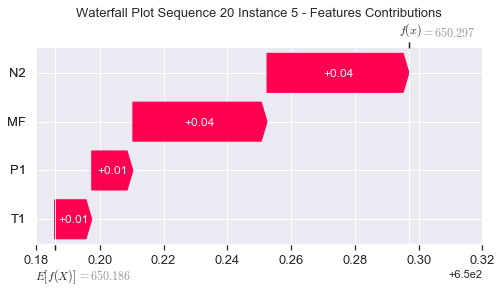

None

Contribution: [0.01475301 0.01309731 0.05057093 0.04742478]


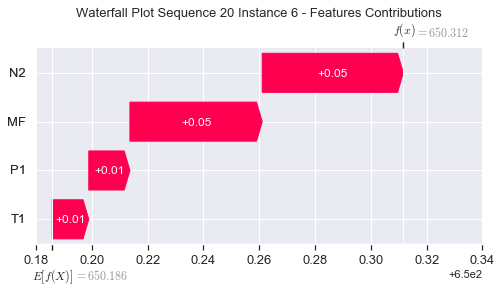

None

Contribution: [0.01578786 0.01397001 0.05334098 0.05034105]


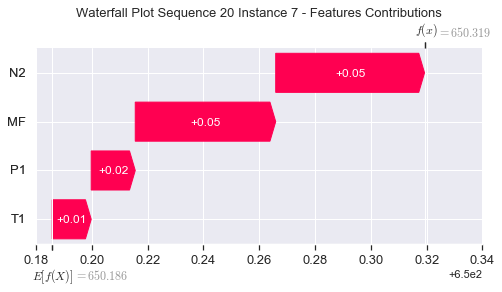

None

Contribution: [0.01579828 0.01391045 0.05311288 0.0503897 ]


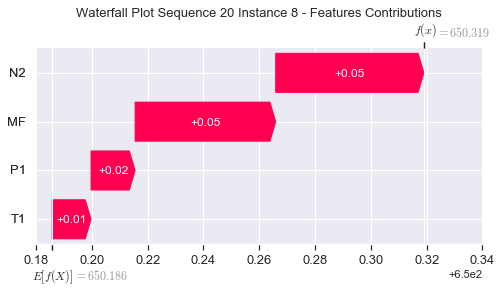

None

Contribution: [0.01517335 0.01334804 0.05127344 0.04899831]


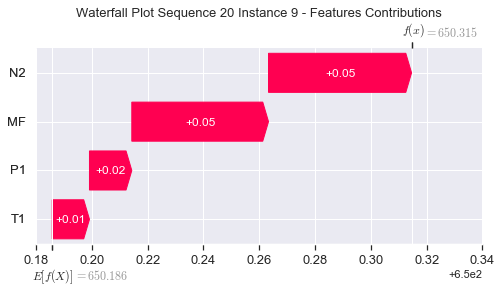

None

Contribution: [0.01531692 0.01210012 0.04995887 0.04826609]


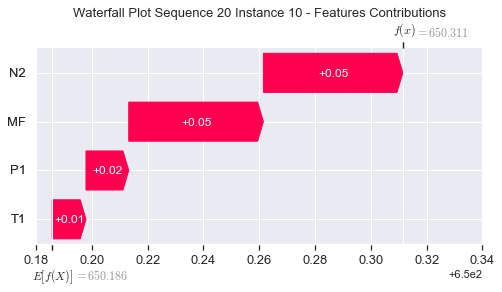

None

Contribution: [0.01477664 0.01272739 0.04975639 0.04751538]


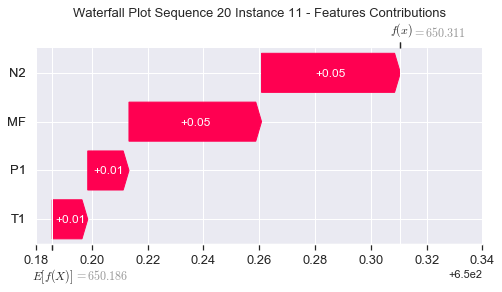

None

Contribution: [0.01535209 0.01332363 0.05032022 0.04855258]


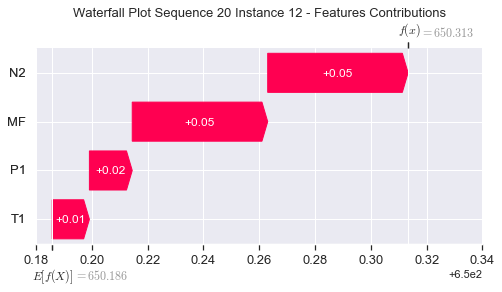

None

Contribution: [0.01571578 0.01355898 0.05117078 0.04947431]


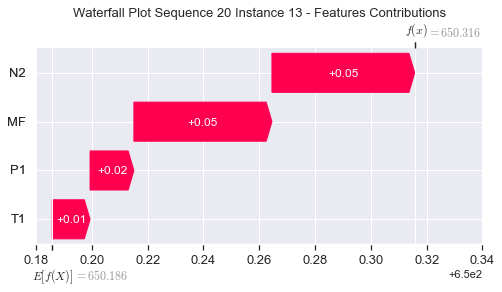

None

Contribution: [0.01617731 0.01410671 0.05271192 0.05101061]


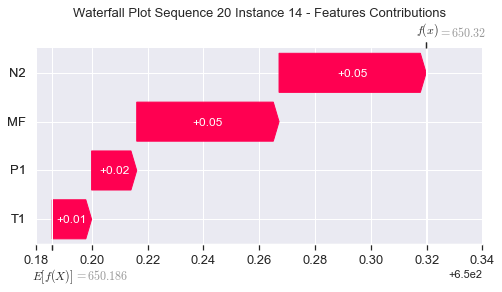

None

Contribution: [0.01682038 0.01416713 0.05458496 0.05271899]


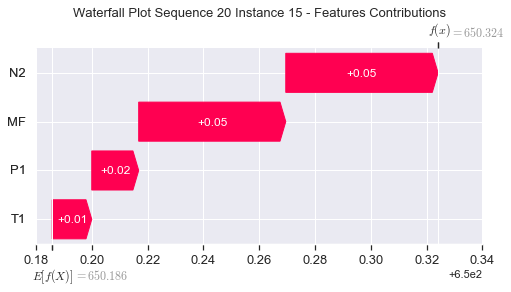

None

Contribution: [0.01758566 0.01426406 0.05714912 0.05537663]


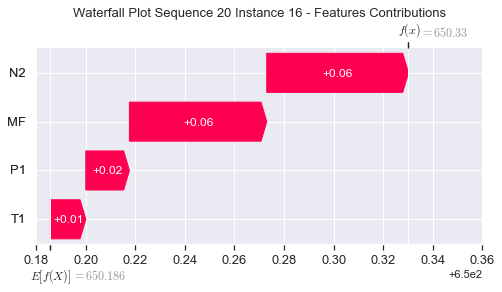

None

Contribution: [0.01864561 0.01543678 0.06014988 0.05808266]


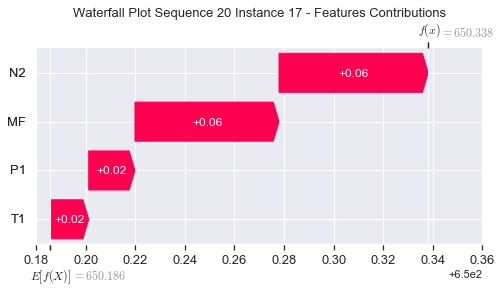

None

Contribution: [0.01999826 0.01647969 0.06458417 0.062164  ]


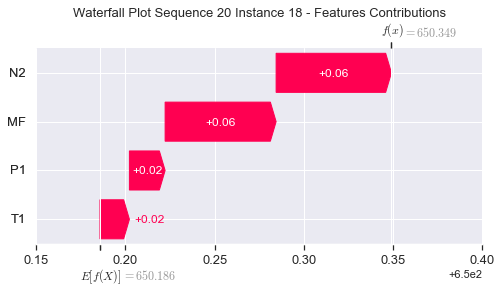

None

Contribution: [0.02186694 0.01849846 0.07025712 0.06709766]


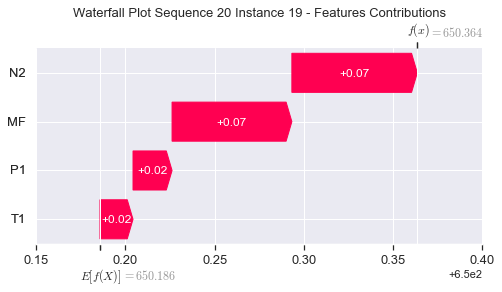

None

Contribution: [0.02681215 0.0245534  0.08713417 0.08251689]


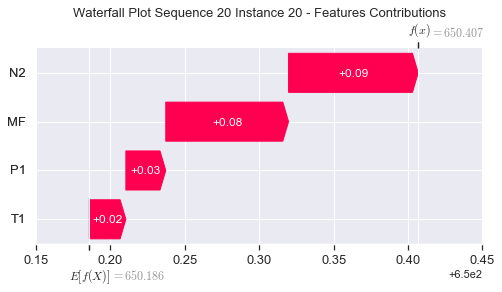

None

Contribution: [0.03534718 0.04688183 0.11611463 0.10441642]


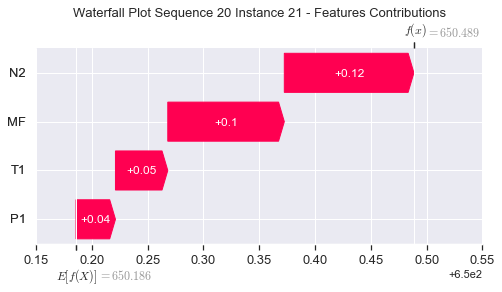

None

Contribution: [0.08378836 0.08294105 0.27644712 0.25829691]


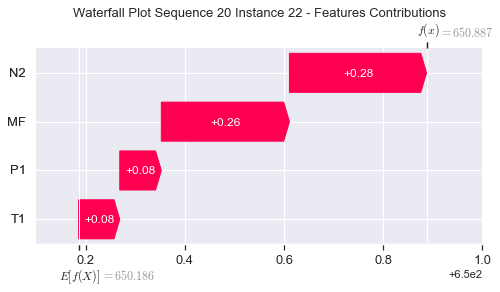

None

Contribution: [0.14162951 0.05097914 0.47084631 0.46461949]


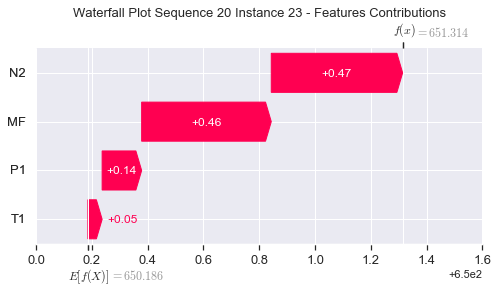

None

Contribution: [ 0.518654   -1.8619691   1.48895491  2.07870729]


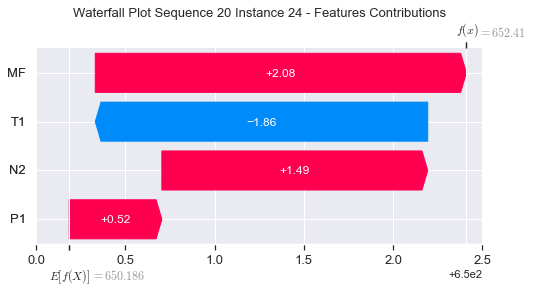

None

Contribution: [ 0.43715688 -0.30642893  1.43218698  1.71193605]


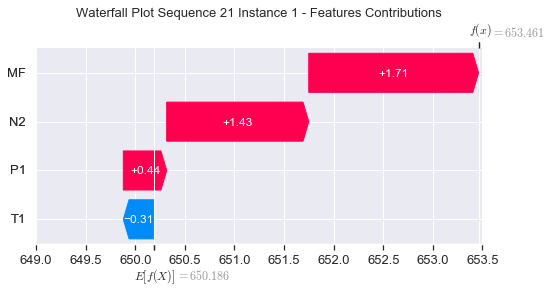

None

Contribution: [-0.0023205   0.02241068  0.02018114  0.00647823]


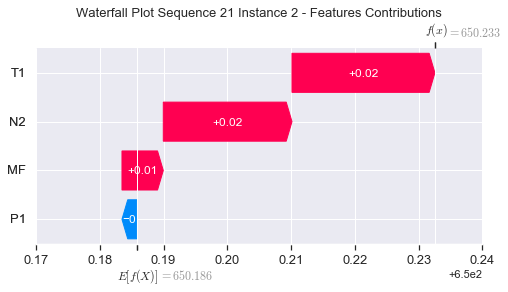

None

Contribution: [0.01371239 0.01132524 0.05474026 0.05426852]


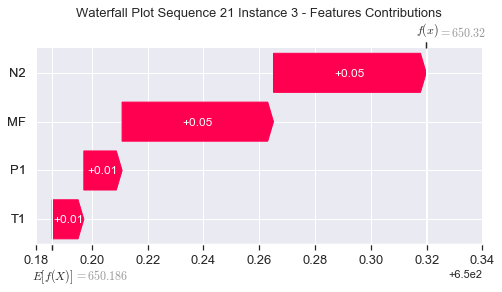

None

Contribution: [0.01119296 0.0105508  0.04039905 0.03825061]


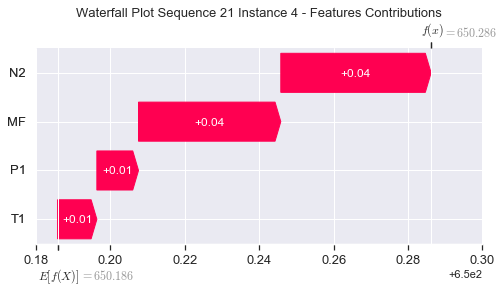

None

Contribution: [0.01270586 0.01150994 0.04411428 0.04201365]


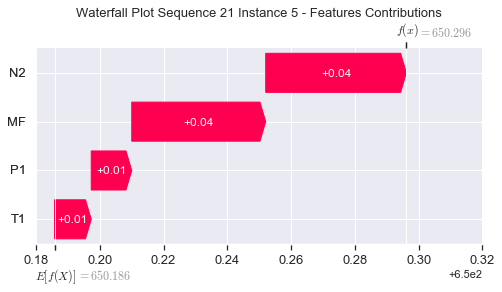

None

Contribution: [0.01499263 0.01341088 0.05047771 0.04821382]


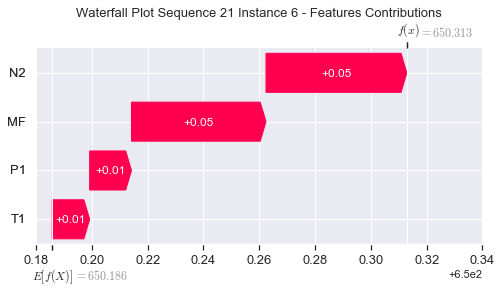

None

Contribution: [0.01591686 0.01417606 0.05316592 0.05090284]


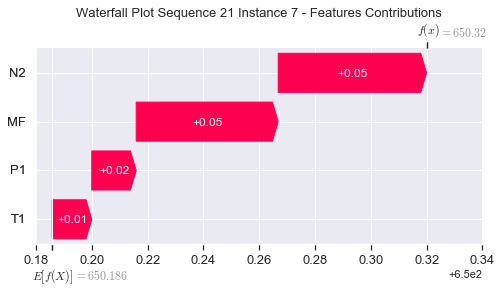

None

Contribution: [0.015988   0.01406835 0.05304197 0.05099868]


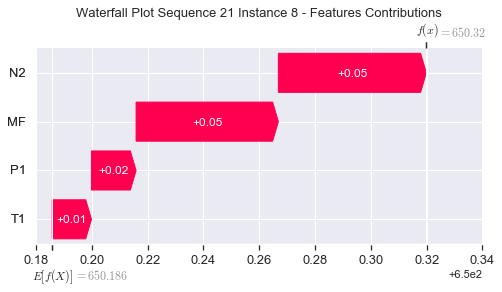

None

Contribution: [0.01551653 0.01344984 0.05122279 0.04956442]


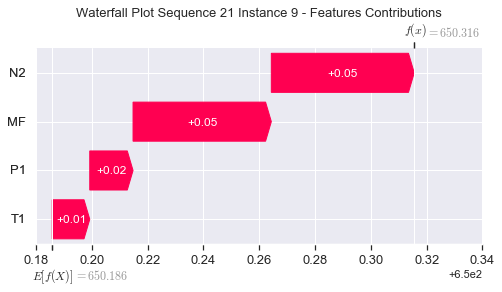

None

Contribution: [0.01457926 0.01311629 0.04989102 0.04789528]


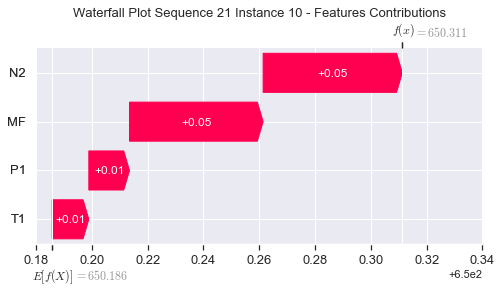

None

Contribution: [0.0153976  0.01290257 0.05002958 0.04872958]


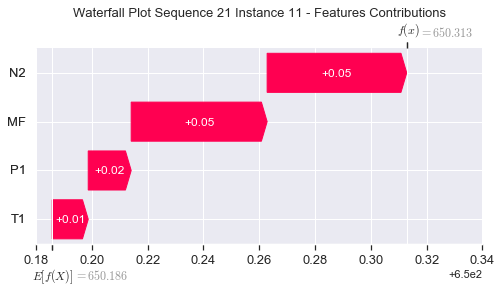

None

Contribution: [0.01530229 0.01276501 0.05040811 0.04891794]


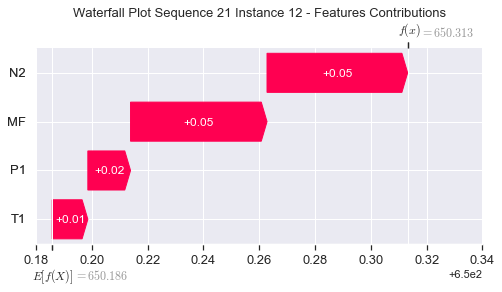

None

Contribution: [0.01562607 0.01298984 0.05126464 0.04973223]


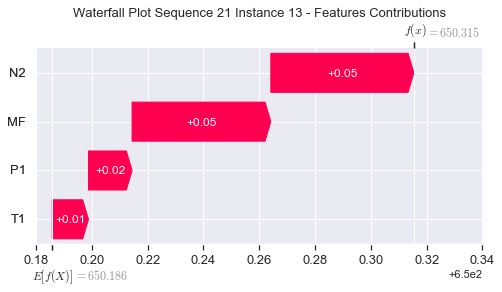

None

Contribution: [0.01649767 0.01332458 0.05291899 0.05143978]


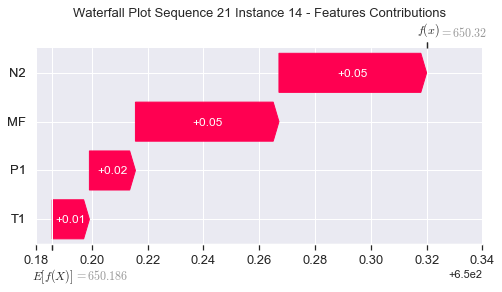

None

Contribution: [0.01686546 0.01361698 0.05468807 0.05306883]


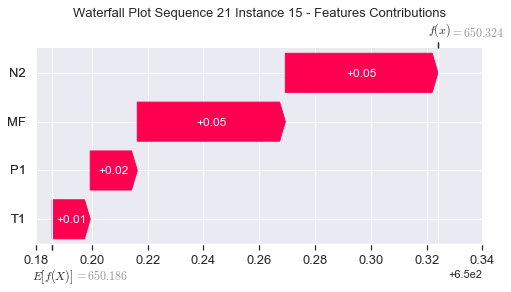

None

Contribution: [0.01771139 0.01444184 0.05726374 0.05596413]


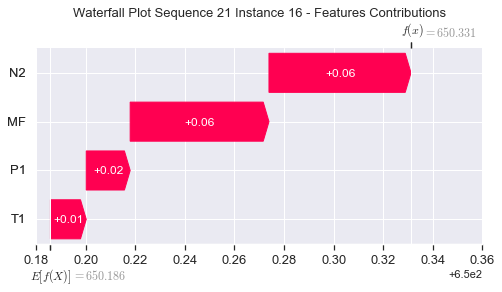

None

Contribution: [0.01866889 0.01482798 0.06027184 0.05830723]


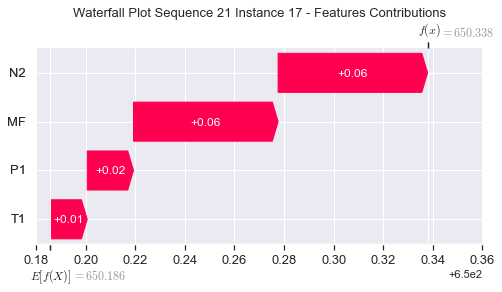

None

Contribution: [0.02009262 0.01588943 0.06477444 0.06246558]


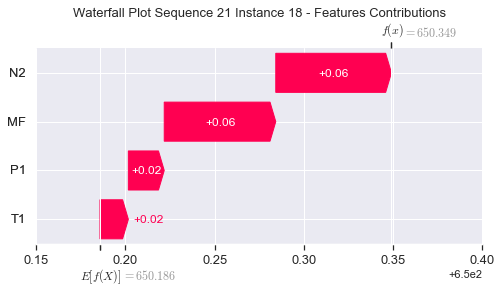

None

Contribution: [0.02199138 0.01771647 0.07048909 0.06792736]


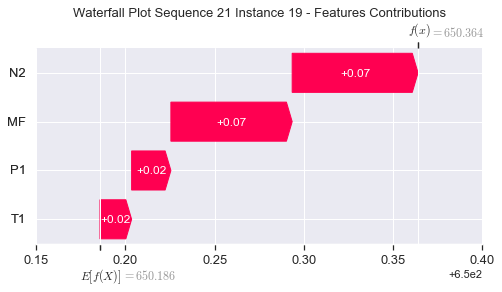

None

Contribution: [0.02685948 0.02404429 0.08737007 0.08261414]


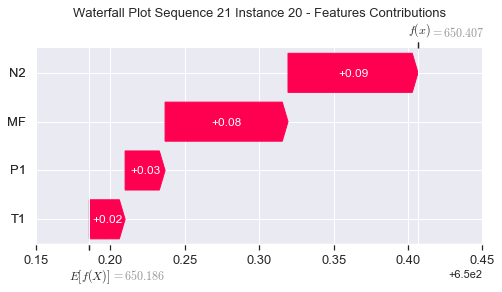

None

Contribution: [0.03559012 0.04829044 0.11645697 0.10520596]


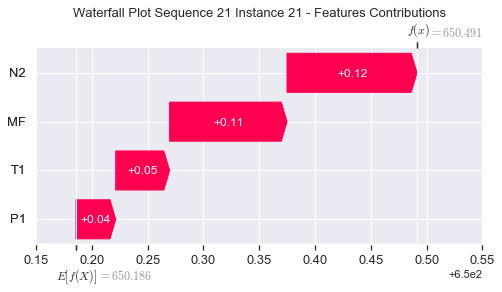

None

Contribution: [0.08370738 0.07948653 0.27770154 0.25824883]


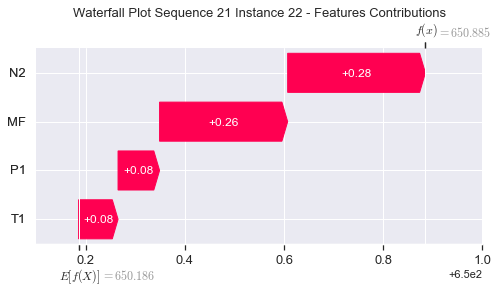

None

Contribution: [0.14260144 0.0223074  0.47823094 0.46561273]


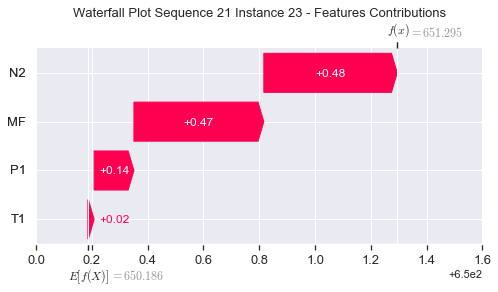

None

Contribution: [ 0.43793371 -2.30403326  1.5620525   1.85513181]


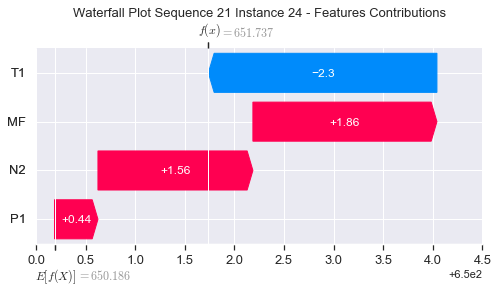

None

Contribution: [ 0.28564773 -0.55883052  1.45969653  1.39659564]


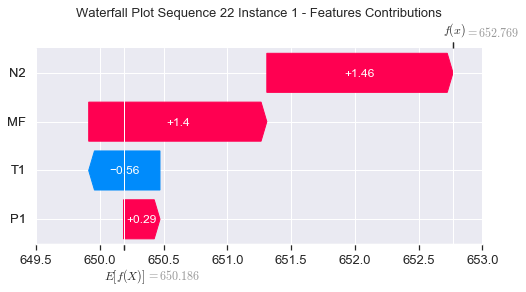

None

Contribution: [-8.32827473e-05  3.03020487e-02  2.01999174e-02  1.02511745e-02]


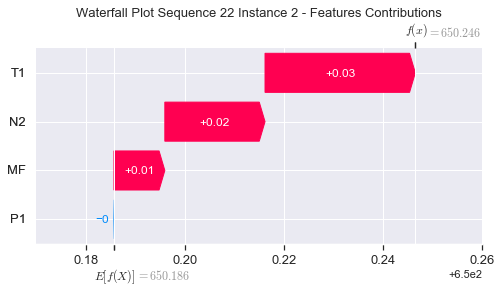

None

Contribution: [0.01373363 0.00646146 0.05555248 0.05435127]


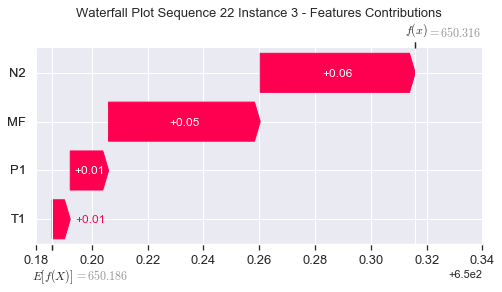

None

Contribution: [0.01128746 0.0074132  0.04098633 0.03900899]


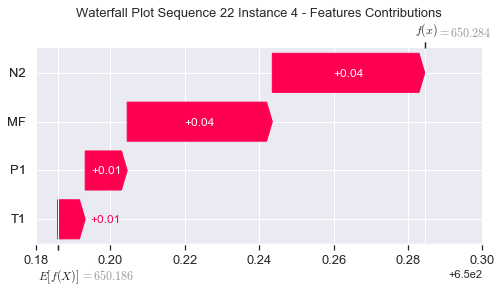

None

Contribution: [0.01274515 0.00967351 0.04435129 0.04227045]


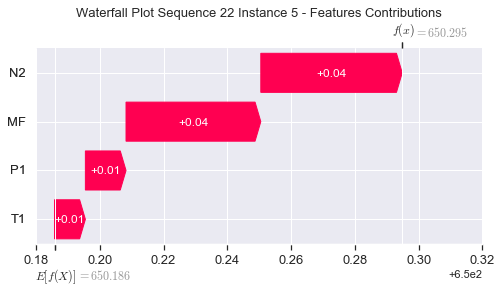

None

Contribution: [0.01483174 0.01179203 0.05054714 0.04840505]


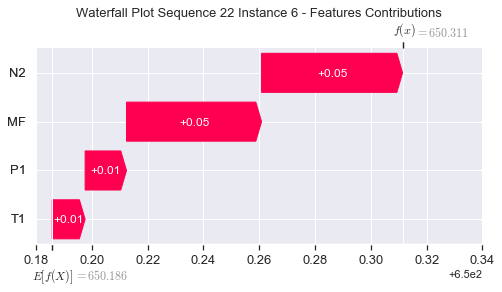

None

Contribution: [0.01587188 0.01267587 0.05321981 0.05129063]


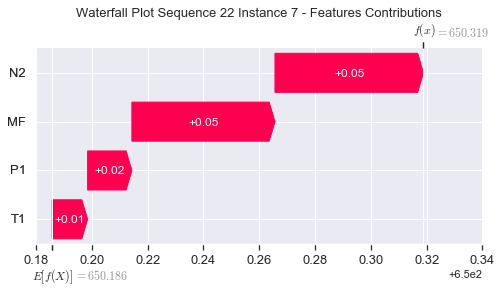

None

Contribution: [0.01585481 0.01284614 0.05301291 0.05113374]


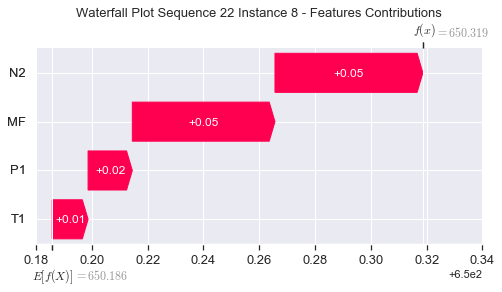

None

Contribution: [0.01526274 0.01255035 0.05093899 0.04922544]


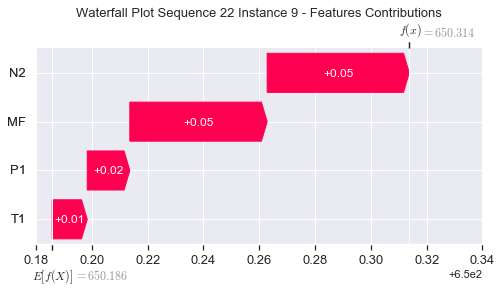

None

Contribution: [0.01516174 0.01274552 0.04983655 0.04782763]


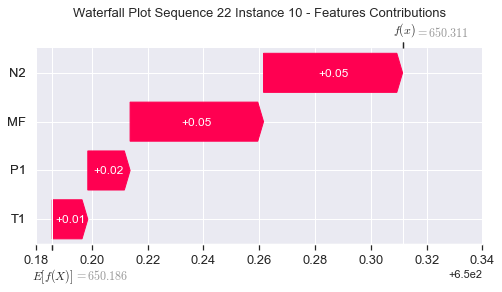

None

Contribution: [0.01477544 0.01265251 0.0495351  0.04756644]


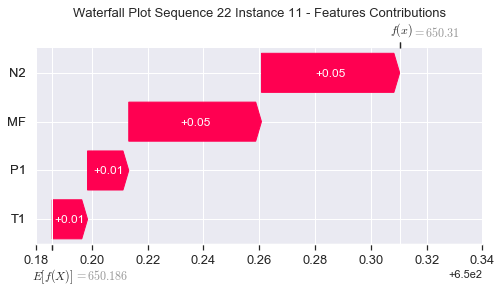

None

Contribution: [0.01525098 0.01269411 0.05020344 0.04908099]


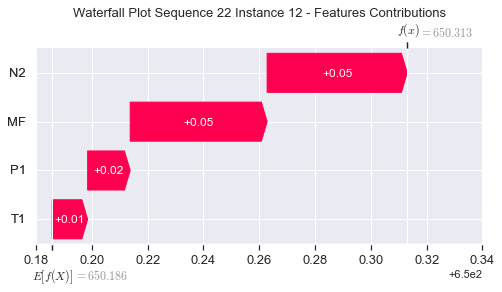

None

Contribution: [0.0156289  0.0128955  0.05103288 0.04997827]


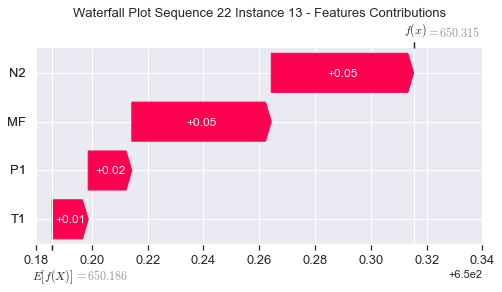

None

Contribution: [0.01608728 0.0134095  0.0526183  0.05172239]


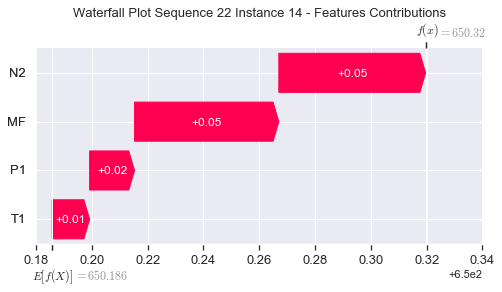

None

Contribution: [0.01678573 0.01361377 0.05441857 0.05330523]


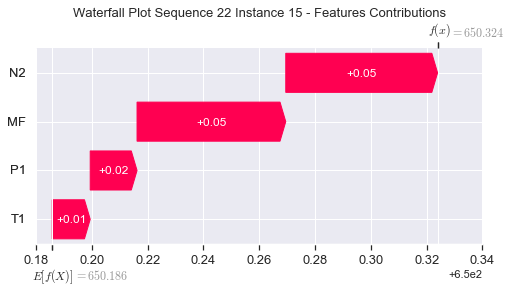

None

Contribution: [0.01772955 0.01428267 0.05704236 0.05585879]


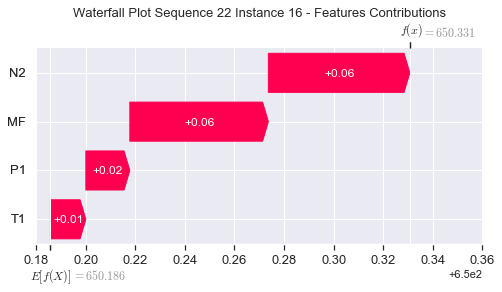

None

Contribution: [0.01866392 0.01516345 0.0599474  0.05876082]


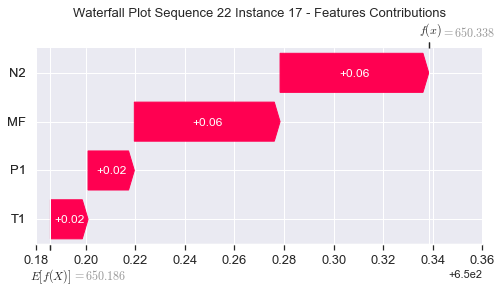

None

Contribution: [0.02006313 0.01644665 0.06449212 0.06295176]


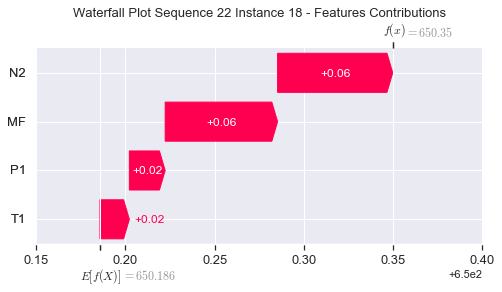

None

Contribution: [0.0215113  0.01833626 0.07001486 0.06695641]


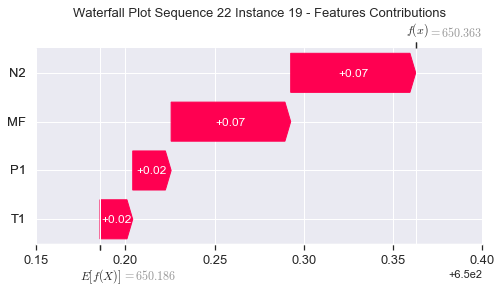

None

Contribution: [0.0268538  0.02452168 0.08696965 0.08290448]


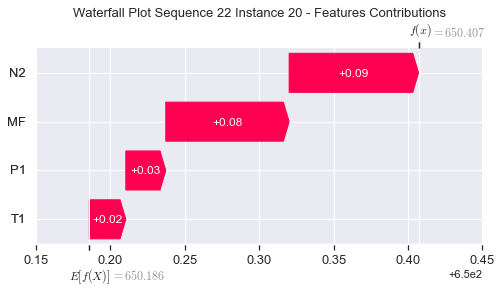

None

Contribution: [0.03514191 0.04661287 0.11564016 0.10332718]


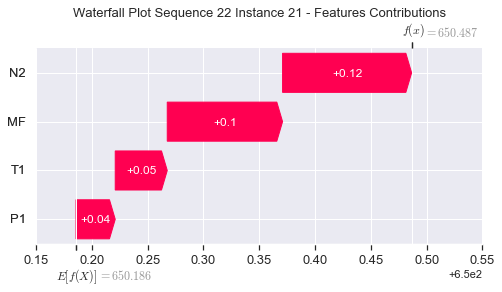

None

Contribution: [0.08359728 0.08337075 0.27614349 0.25867351]


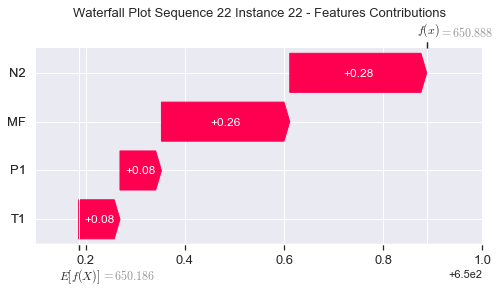

None

Contribution: [0.14239224 0.06735255 0.47227089 0.47254169]


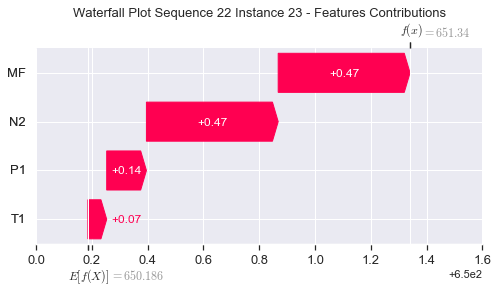

None

Contribution: [ 0.47602215 -1.71318617  1.57162751  2.1340536 ]


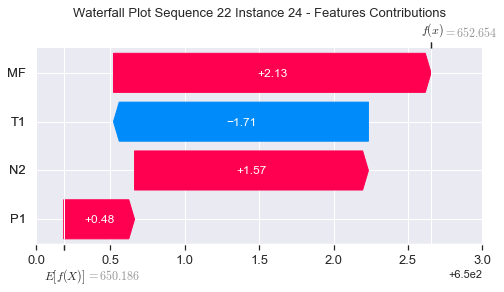

None

Contribution: [ 0.34493154 -0.33934493  1.48906963  1.61515159]


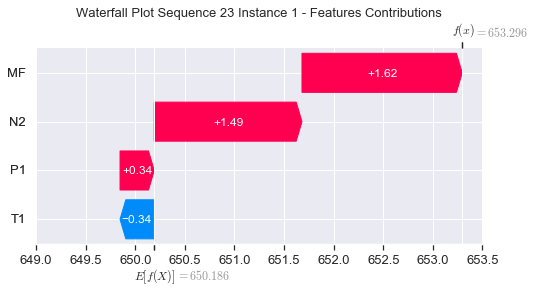

None

Contribution: [-0.00136322  0.02134533  0.0197916   0.00748609]


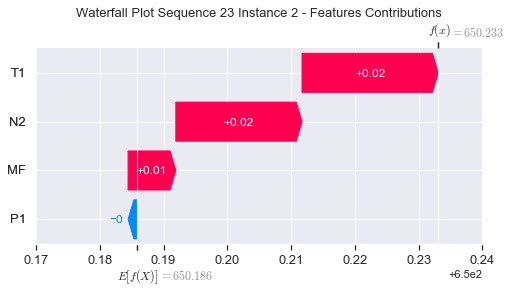

None

Contribution: [0.0128668  0.00667317 0.05498578 0.05397633]


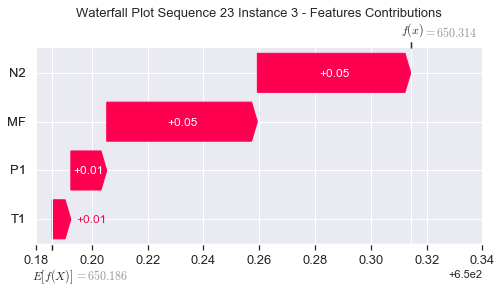

None

Contribution: [0.01034367 0.00786908 0.04055106 0.03797591]


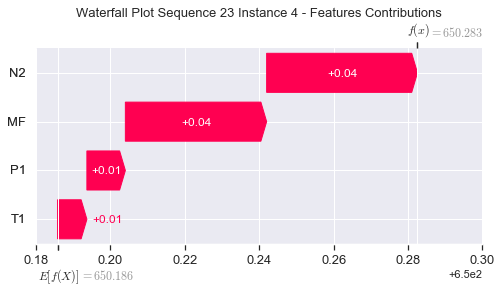

None

Contribution: [0.0127297  0.01057448 0.04444855 0.04226453]


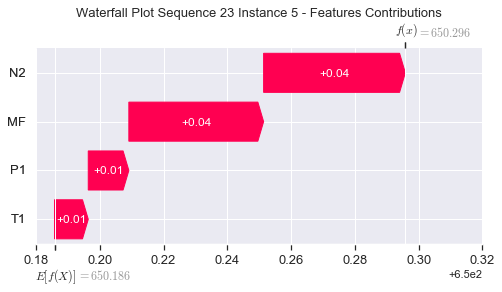

None

Contribution: [0.01493929 0.0126035  0.05065641 0.04811356]


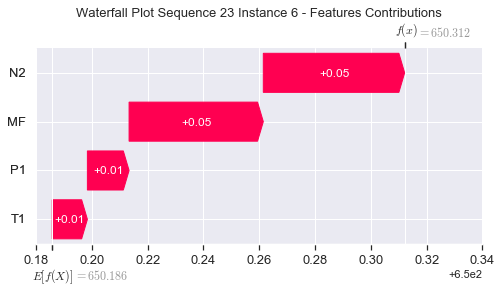

None

Contribution: [0.01593698 0.01353524 0.05334835 0.05085321]


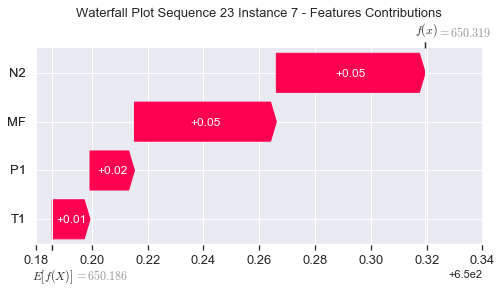

None

Contribution: [0.01593866 0.01348449 0.0531454  0.05082334]


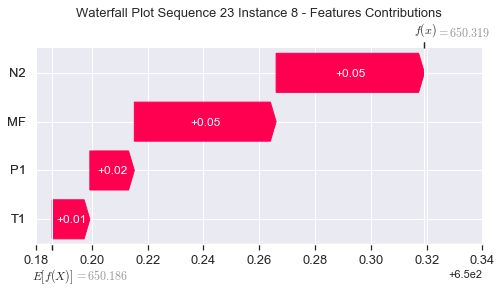

None

Contribution: [0.01549176 0.01325094 0.05129829 0.04932455]


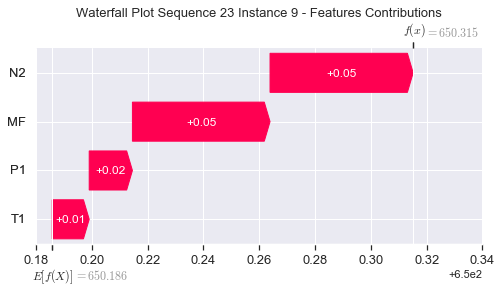

None

Contribution: [0.01538218 0.01296454 0.0501087  0.04826359]


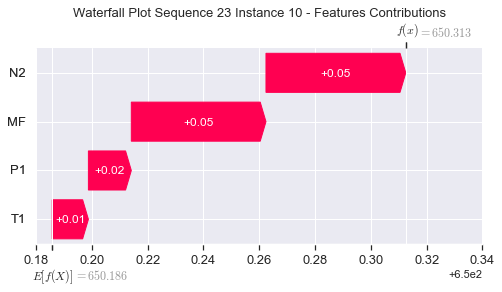

None

Contribution: [0.01516745 0.01272665 0.04997864 0.04785878]


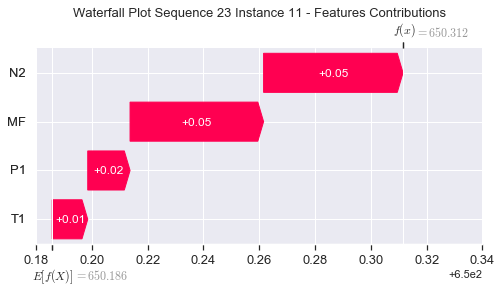

None

Contribution: [0.01543216 0.01288669 0.05045133 0.04847974]


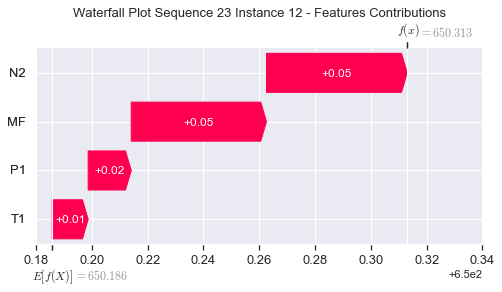

None

Contribution: [0.01576097 0.0131087  0.0512663  0.04937047]


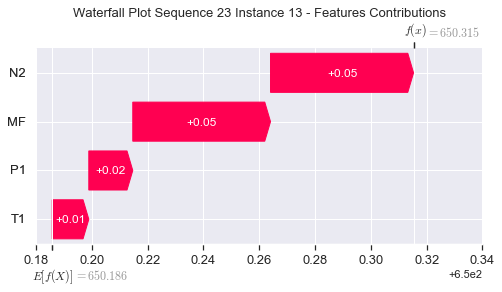

None

Contribution: [0.01632078 0.01363769 0.05294979 0.05192472]


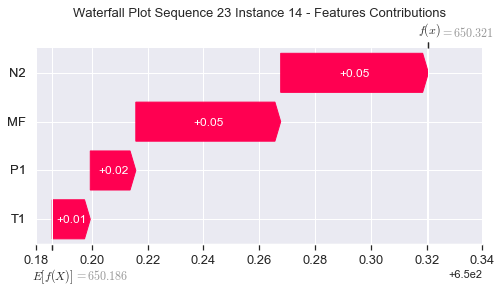

None

Contribution: [0.01691462 0.01385921 0.05473611 0.05268771]


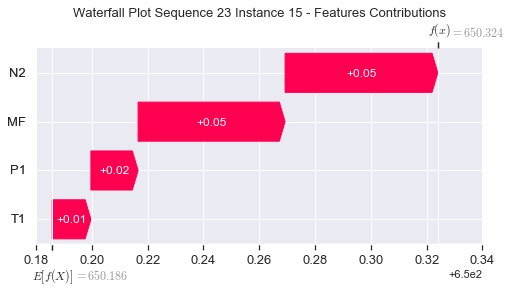

None

Contribution: [0.01738277 0.01437164 0.05715734 0.05495036]


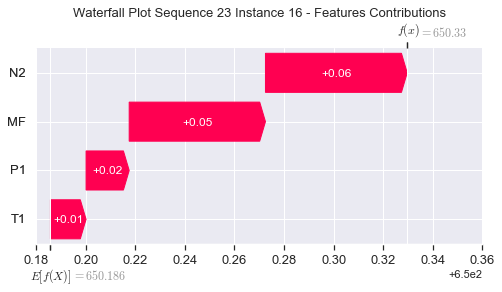

None

Contribution: [0.01876556 0.01528645 0.06029521 0.0580047 ]


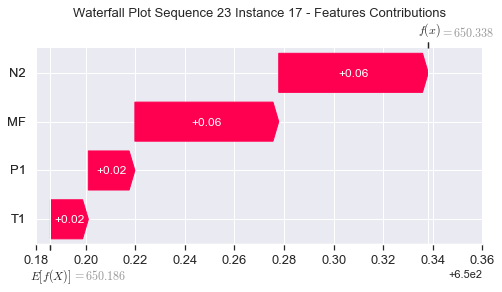

None

Contribution: [0.02015042 0.01642992 0.064811   0.06214376]


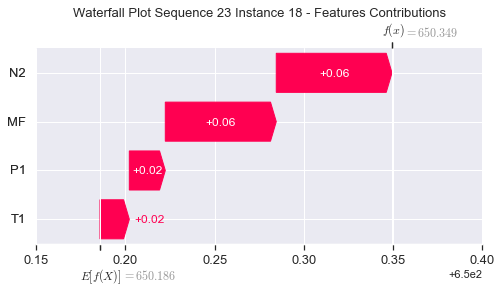

None

Contribution: [0.02185287 0.01820088 0.07024646 0.06625647]


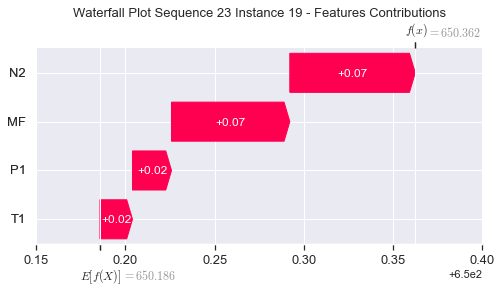

None

Contribution: [0.02685285 0.02451481 0.08730549 0.08237508]


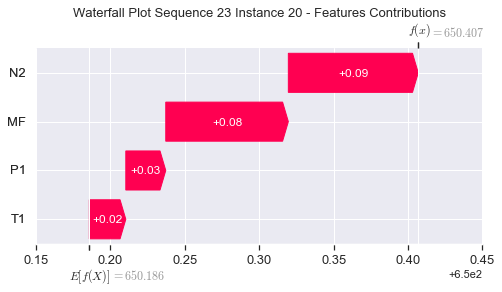

None

Contribution: [0.0354552  0.04717765 0.11613024 0.10517857]


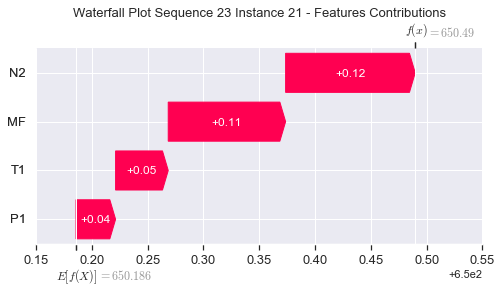

None

Contribution: [0.08349415 0.08229091 0.27707409 0.25656808]


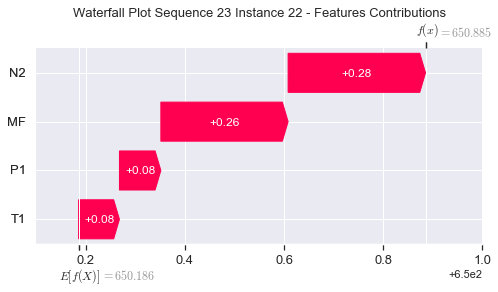

None

Contribution: [0.14094772 0.04905112 0.47549733 0.45298939]


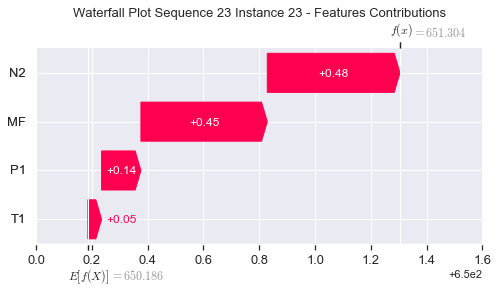

None

Contribution: [ 0.54746671 -1.89332434  1.58802564  1.89574121]


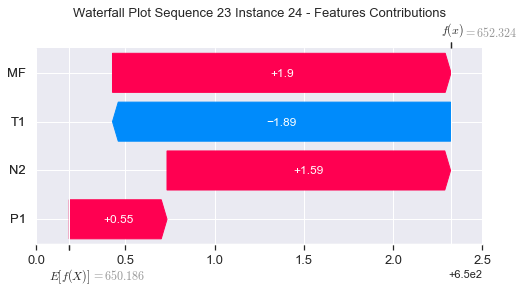

None

Contribution: [ 0.5123285  -0.32347528  1.50553504  1.64421075]


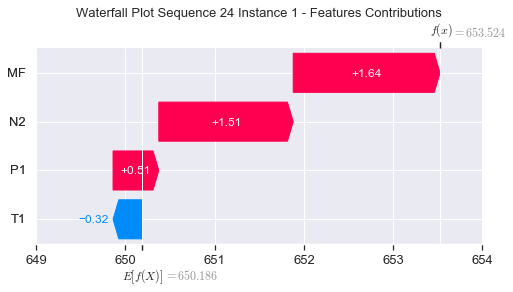

None

Contribution: [-0.00060338  0.02408781  0.02022352  0.0118672 ]


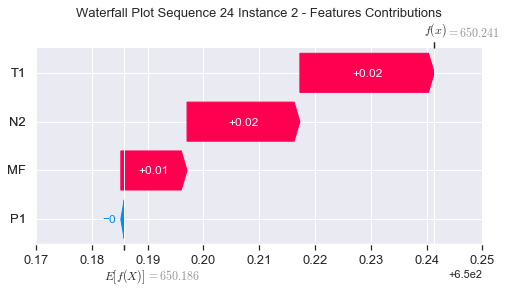

None

Contribution: [0.01366434 0.00858928 0.05511278 0.05333581]


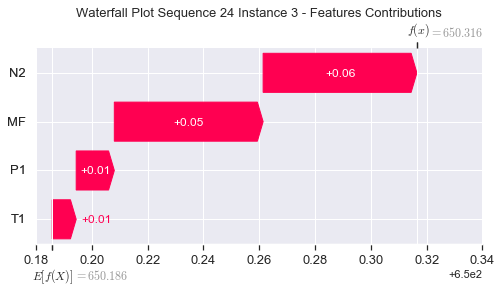

None

Contribution: [0.01147652 0.00812784 0.04070638 0.03873206]


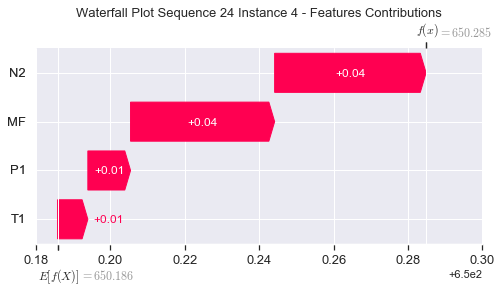

None

Contribution: [0.01280655 0.01027485 0.04426756 0.0415191 ]


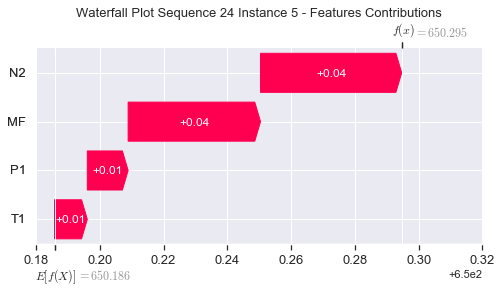

None

Contribution: [0.01492971 0.01215713 0.05061808 0.04774898]


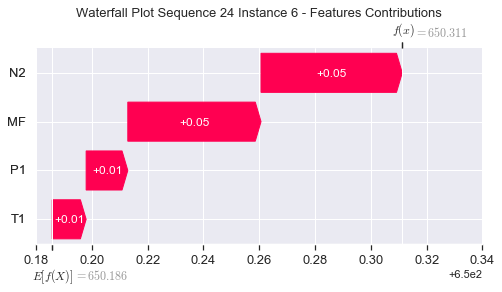

None

Contribution: [0.01593716 0.01308397 0.05332799 0.05059384]


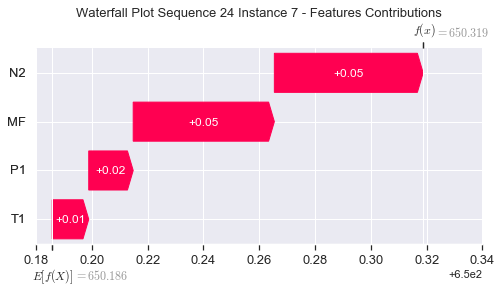

None

Contribution: [0.01594081 0.01316576 0.05313567 0.05054967]


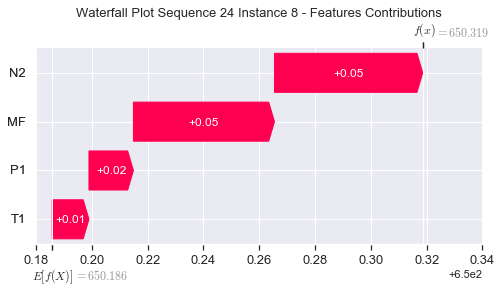

None

Contribution: [0.01528058 0.01285688 0.05114536 0.04843405]


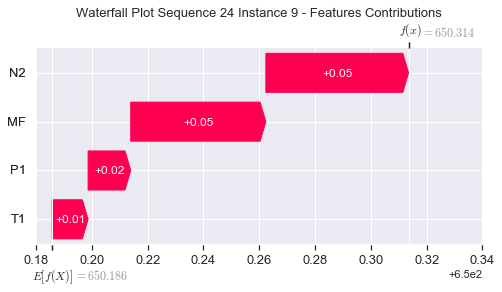

None

Contribution: [0.01520645 0.01218967 0.05001479 0.04832654]


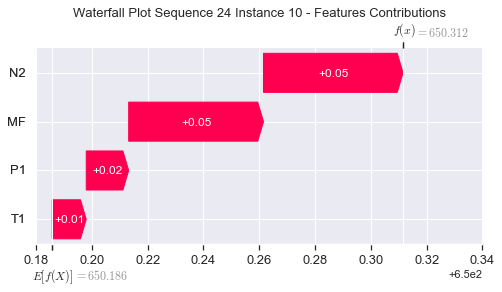

None

Contribution: [0.01501128 0.0122445  0.04978454 0.04740137]


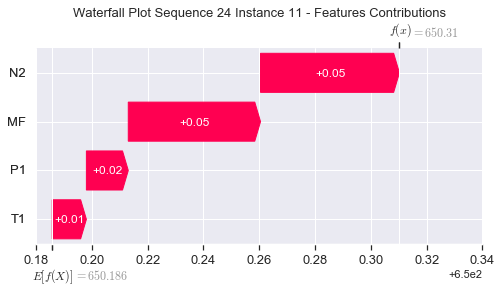

None

Contribution: [0.0155022  0.0122863  0.05035284 0.04876963]


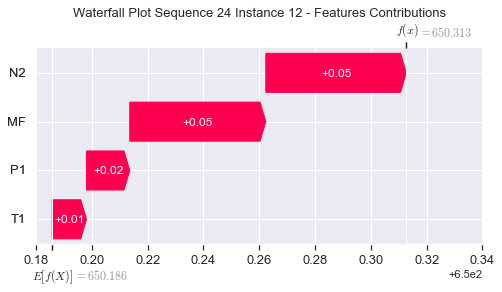

None

Contribution: [0.01584079 0.01270831 0.05122607 0.0496156 ]


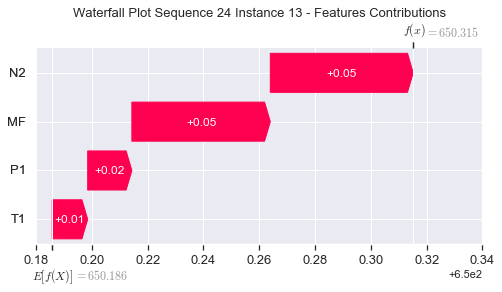

None

Contribution: [0.0161252  0.01287214 0.05255865 0.05035683]


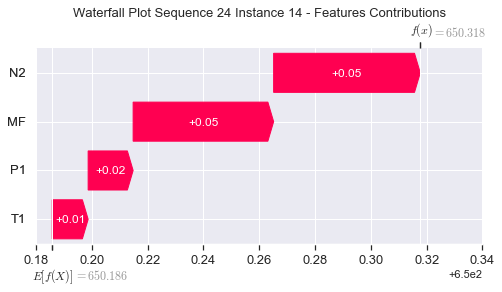

None

Contribution: [0.01699868 0.01366379 0.05463546 0.05299416]


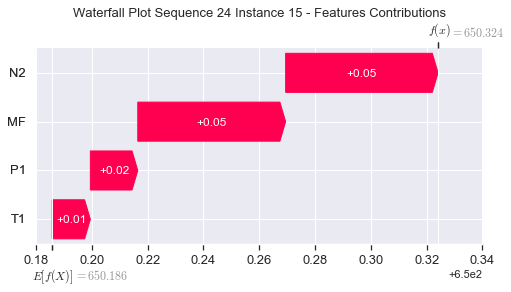

None

Contribution: [0.01734843 0.01363203 0.05676284 0.05462315]


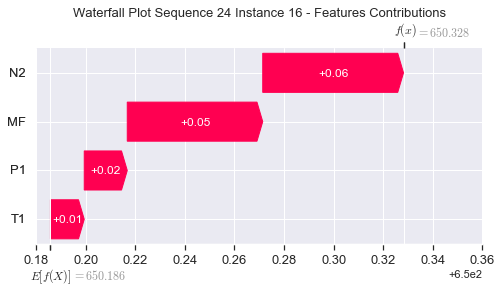

None

Contribution: [0.01874439 0.01535033 0.05998308 0.05814713]


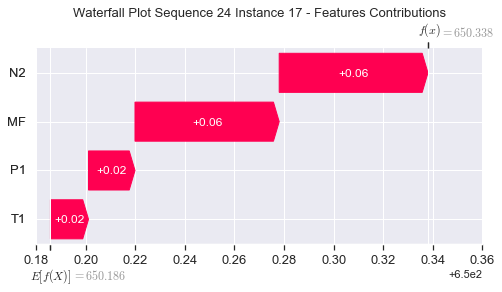

None

Contribution: [0.0200686  0.01666689 0.06432419 0.06217591]


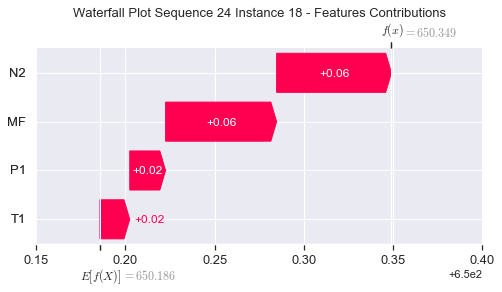

None

Contribution: [0.0216577  0.01884329 0.06998882 0.06686537]


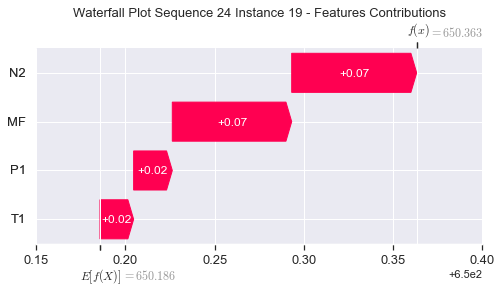

None

Contribution: [0.02668557 0.02496077 0.08652814 0.08200178]


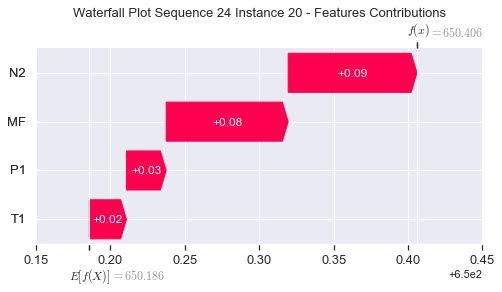

None

Contribution: [0.0348948  0.04524064 0.11484199 0.10330061]


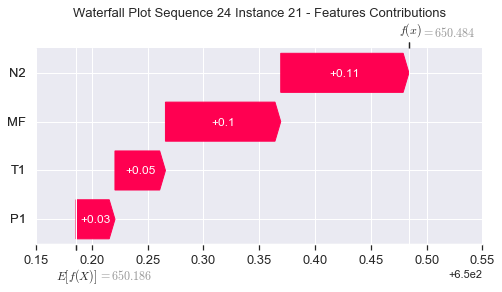

None

Contribution: [0.08352795 0.08512246 0.27520129 0.25670585]


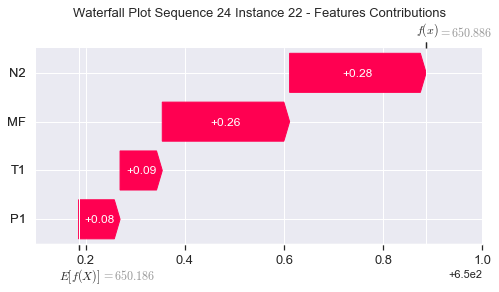

None

Contribution: [0.14472291 0.08179201 0.47285784 0.46638722]


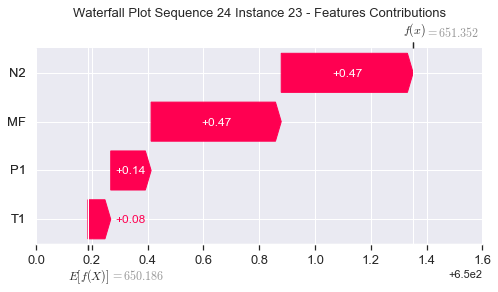

None

Contribution: [ 0.55346648 -1.31935498  1.57387537  2.03813267]


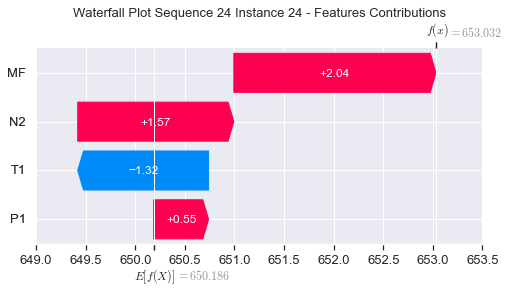

None

Contribution: [ 0.43808301 -0.17490655  1.47321258  1.53958888]


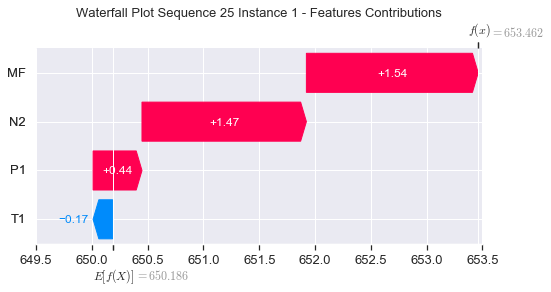

None

Contribution: [-0.00223803  0.02014336  0.01964058  0.00765449]


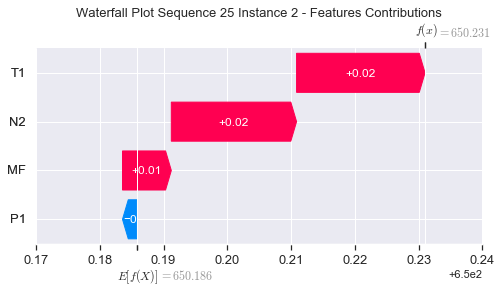

None

Contribution: [0.01398148 0.00973411 0.05512432 0.05470793]


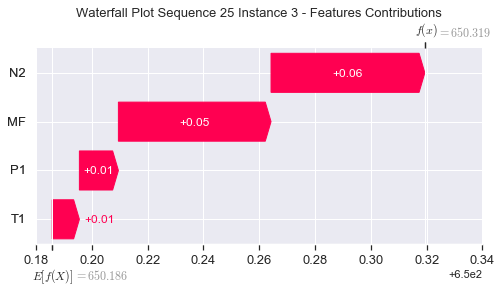

None

Contribution: [0.01060274 0.00854252 0.04040841 0.03766672]


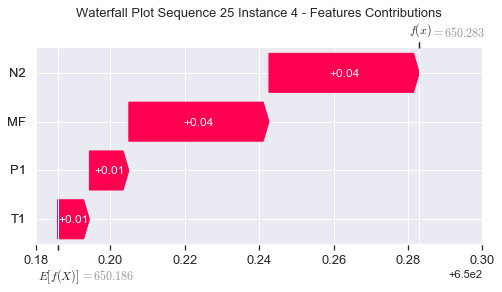

None

Contribution: [0.0125833  0.01144263 0.04419971 0.04101695]


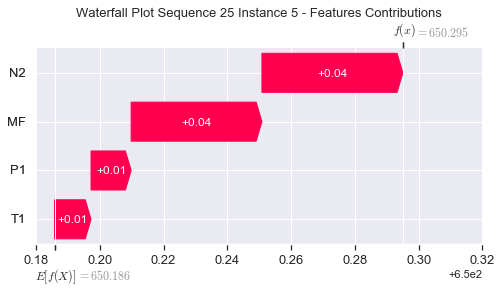

None

Contribution: [0.0146666  0.01300437 0.05048811 0.04719856]


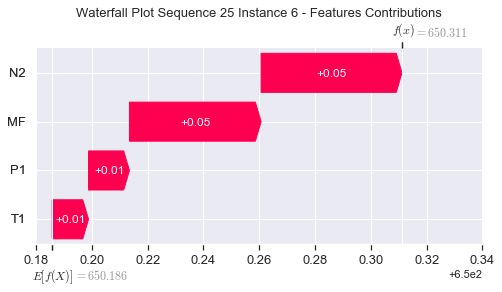

None

Contribution: [0.0156439  0.01376683 0.05317626 0.05003602]


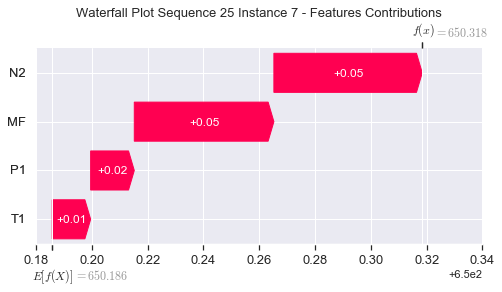

None

Contribution: [0.01570104 0.01393464 0.05293848 0.05010901]


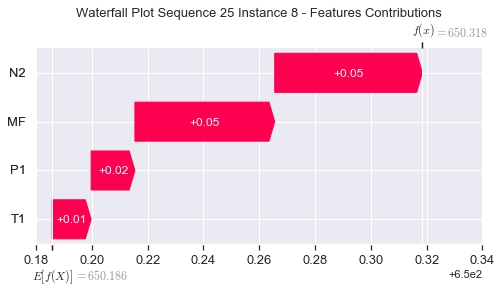

None

Contribution: [0.01542957 0.01361061 0.05128416 0.04956104]


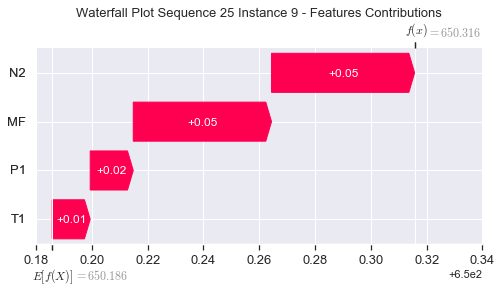

None

Contribution: [0.01449763 0.01263498 0.04970099 0.04681661]


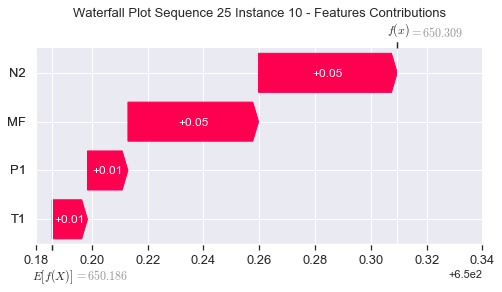

None

Contribution: [0.01520525 0.01344717 0.04993743 0.04837707]


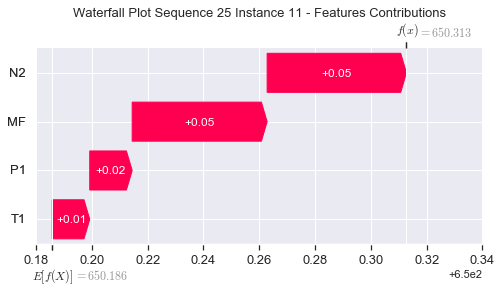

None

Contribution: [0.01524791 0.01313152 0.05022637 0.04827531]


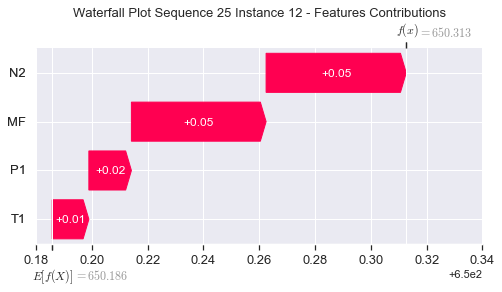

None

Contribution: [0.0155933  0.01342264 0.05113529 0.04918387]


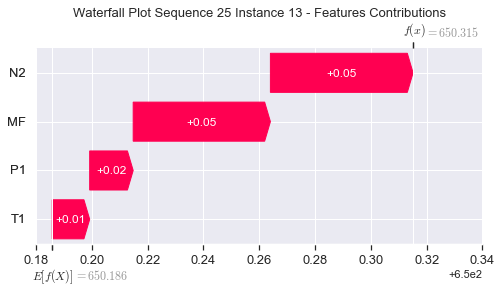

None

Contribution: [0.01621876 0.01356393 0.05254613 0.05027504]


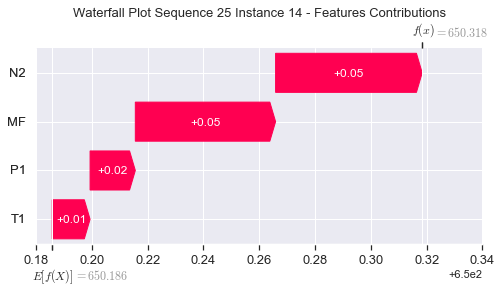

None

Contribution: [0.01675782 0.01431622 0.05460344 0.05261211]


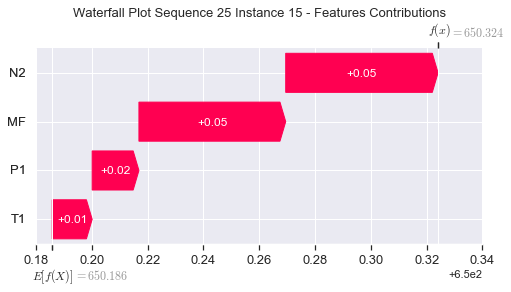

None

Contribution: [0.01701518 0.01411155 0.05675661 0.05395449]


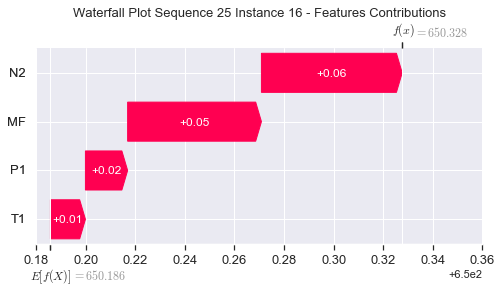

None

Contribution: [0.01849386 0.0157389  0.05998142 0.05782747]


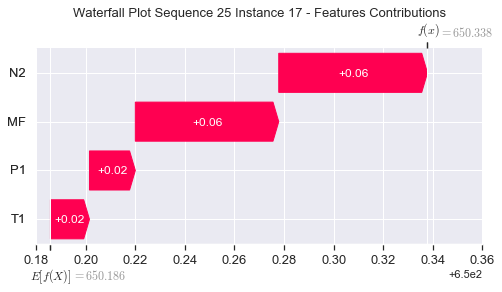

None

Contribution: [0.01981737 0.01701221 0.06428981 0.06181975]


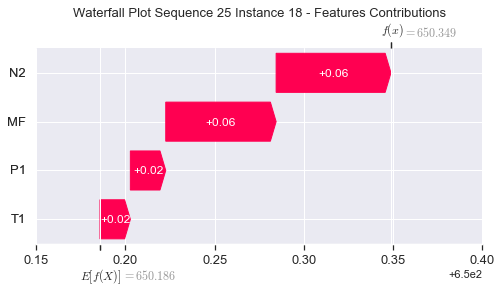

None

Contribution: [0.02187039 0.01896489 0.06990168 0.06705949]


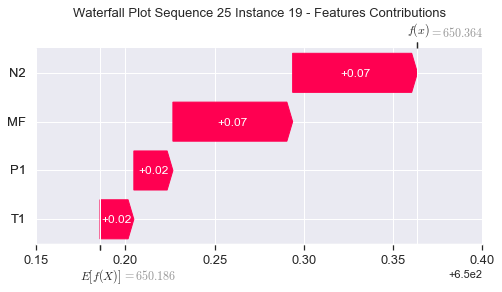

None

Contribution: [0.02650747 0.0251059  0.08652557 0.08179755]


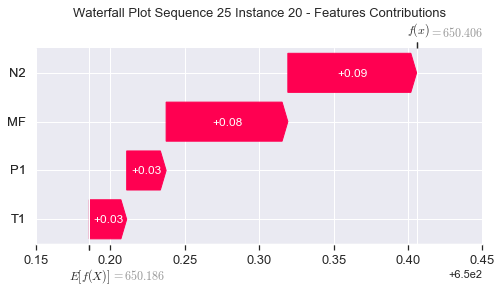

None

Contribution: [0.03517194 0.04488533 0.11487704 0.10362896]


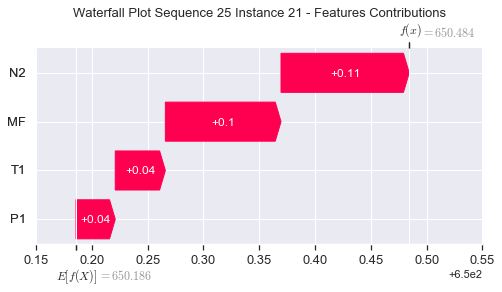

None

Contribution: [0.08292302 0.08635518 0.27518668 0.25591704]


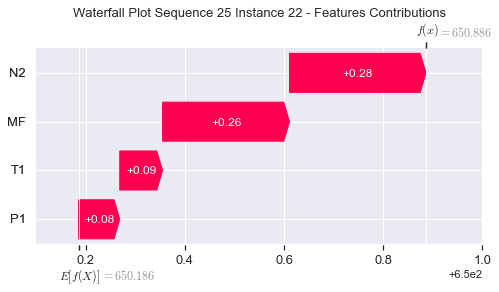

None

Contribution: [0.13972566 0.09052661 0.47288145 0.46076578]


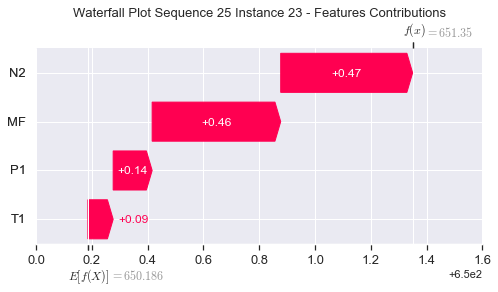

None

Contribution: [ 0.48035211 -1.16329696  1.60465279  2.0841829 ]


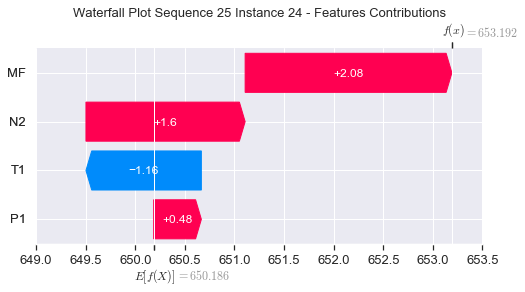

None

Contribution: [ 0.41462205 -0.10986758  1.50862462  1.76472338]


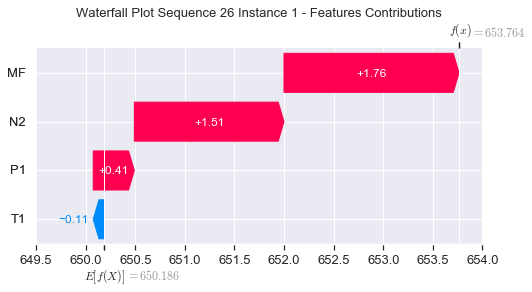

None

Contribution: [-0.00143024  0.01784023  0.01945086  0.00844066]


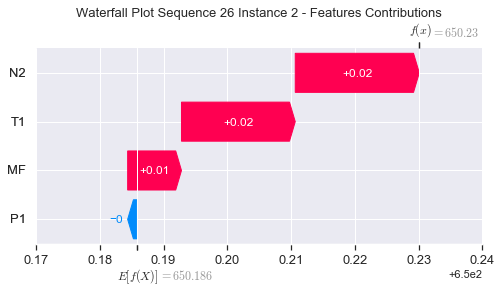

None

Contribution: [0.01381205 0.01156187 0.0549779  0.05471049]


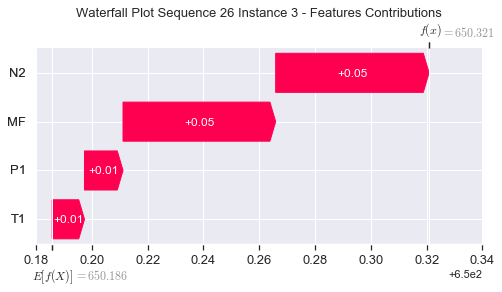

None

Contribution: [0.01097661 0.01001735 0.04042341 0.03822165]


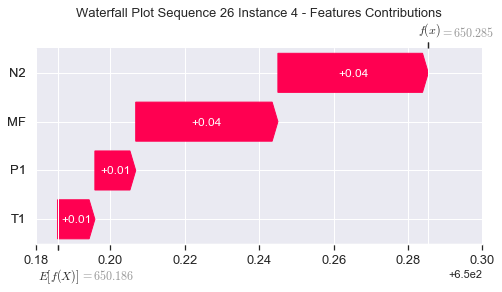

None

Contribution: [0.01264229 0.01207021 0.044052   0.04147705]


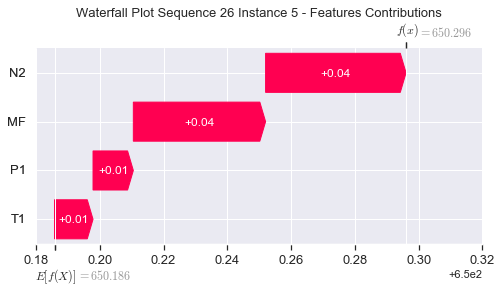

None

Contribution: [0.01458823 0.01359919 0.05027706 0.04739603]


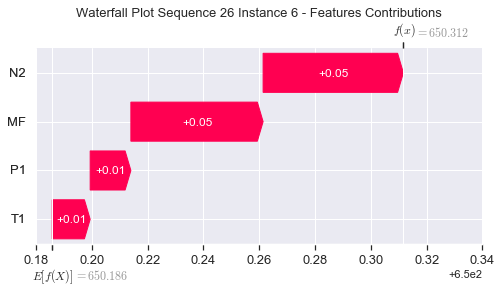

None

Contribution: [0.01560204 0.01444378 0.05300243 0.05026664]


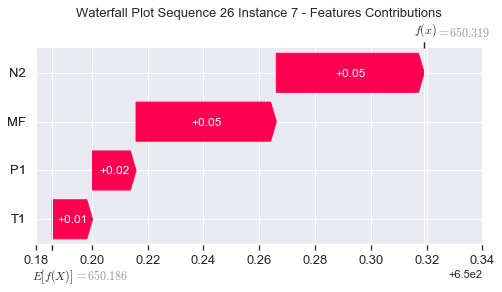

None

Contribution: [0.01567055 0.01447343 0.05283245 0.0503023 ]


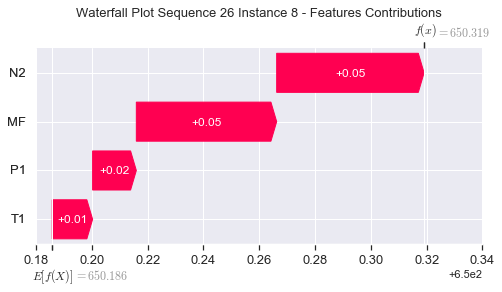

None

Contribution: [0.01521901 0.0141209  0.05093728 0.04867544]


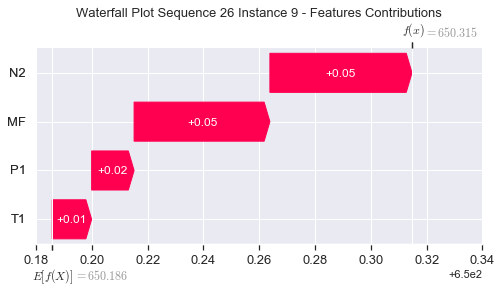

None

Contribution: [0.01495698 0.01371002 0.04978461 0.04800361]


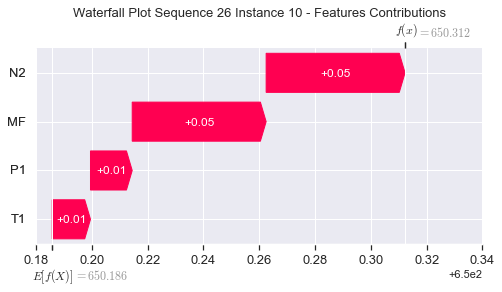

None

Contribution: [0.01507745 0.01354938 0.04964074 0.04761524]


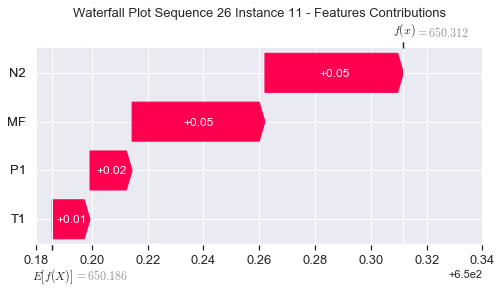

None

Contribution: [0.01548318 0.0134903  0.05016616 0.0488028 ]


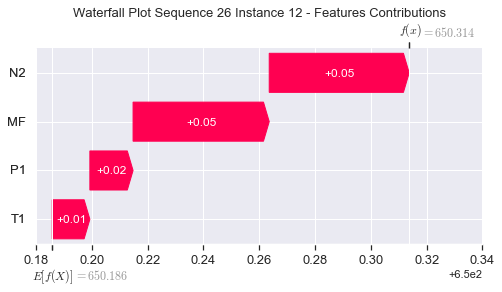

None

Contribution: [0.0157762  0.01381417 0.05100572 0.04961608]


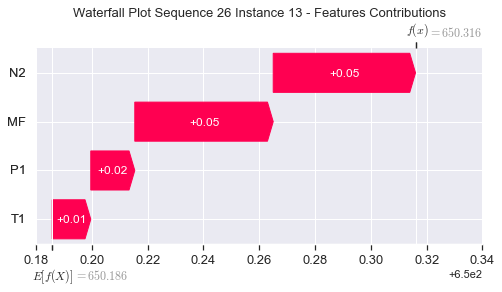

None

Contribution: [0.01614318 0.01410282 0.05243546 0.05088099]


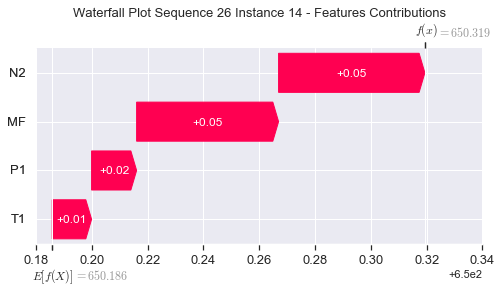

None

Contribution: [0.01680338 0.01450254 0.05433509 0.05284281]


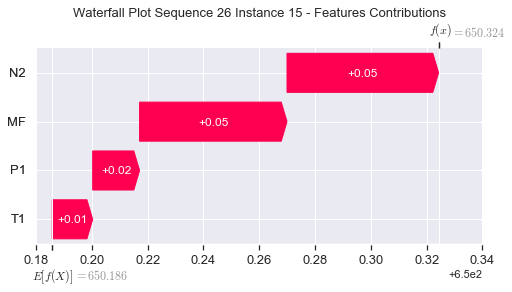

None

Contribution: [0.01744131 0.01547784 0.05678117 0.05517044]


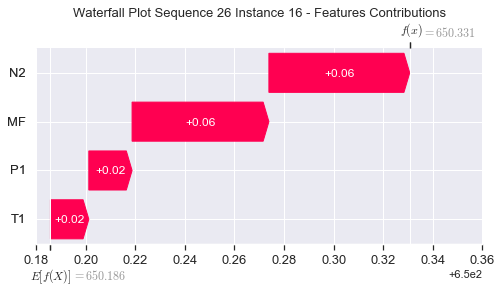

None

Contribution: [0.01850267 0.01593632 0.05976312 0.05802751]


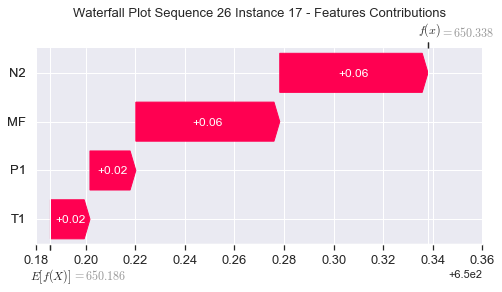

None

Contribution: [0.01980743 0.01709283 0.06415104 0.06205738]


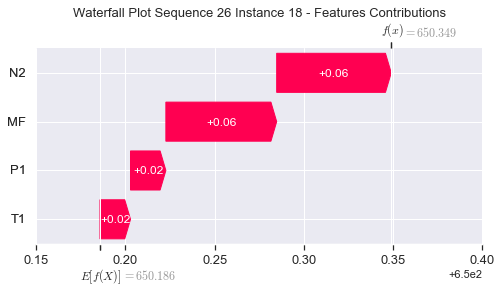

None

Contribution: [0.02158642 0.01928187 0.06965697 0.0668734 ]


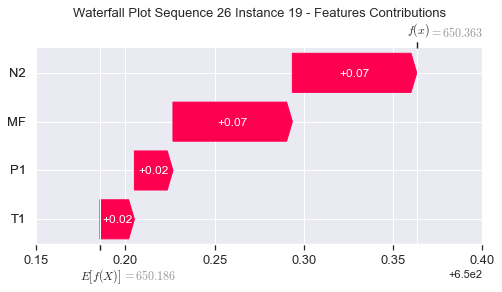

None

Contribution: [0.02640792 0.02503041 0.08634706 0.08181916]


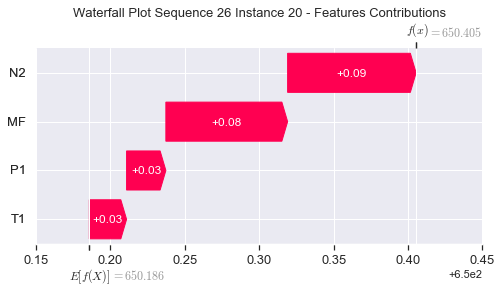

None

Contribution: [0.03513764 0.04492829 0.11478071 0.10316445]


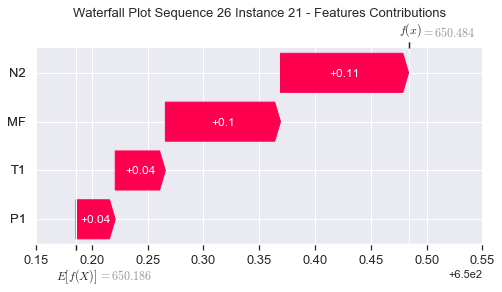

None

Contribution: [0.08299616 0.08520967 0.27511714 0.25696802]


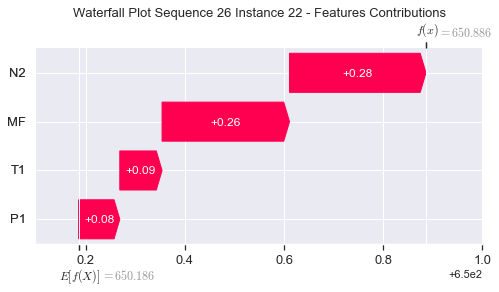

None

Contribution: [0.13950752 0.08025553 0.47284026 0.46729542]


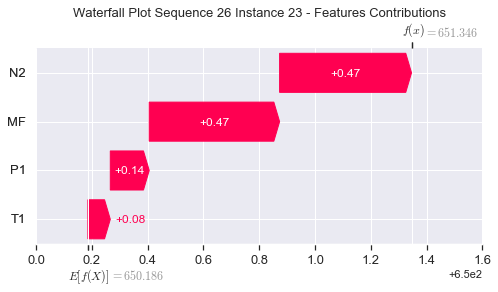

None

Contribution: [ 0.43612415 -1.3752113   1.55780337  2.05218297]


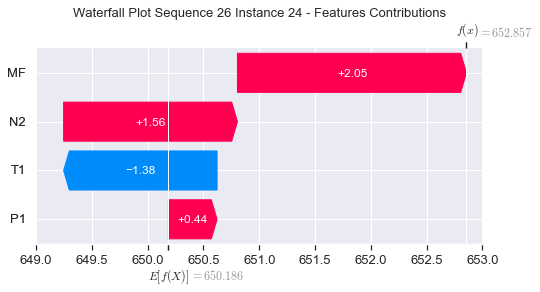

None

Contribution: [ 0.39282718 -0.19477321  1.46343278  1.61488555]


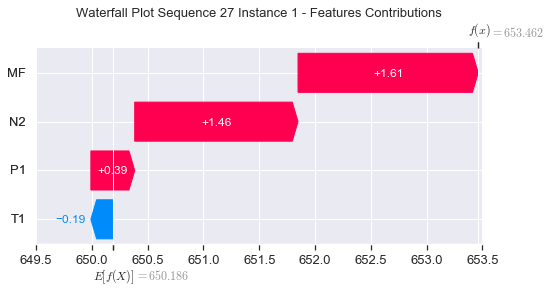

None

Contribution: [-0.00274065  0.02009199  0.01934859  0.00597083]


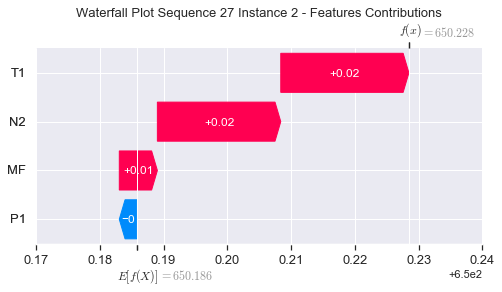

None

Contribution: [0.01377875 0.00934538 0.05510598 0.0561341 ]


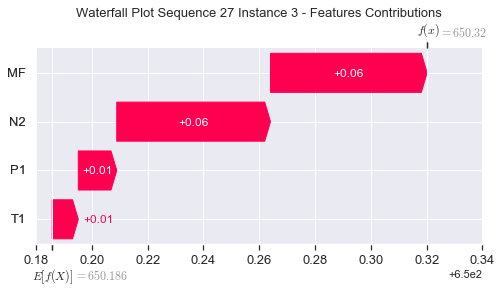

None

Contribution: [0.01115061 0.00977126 0.04071849 0.03917888]


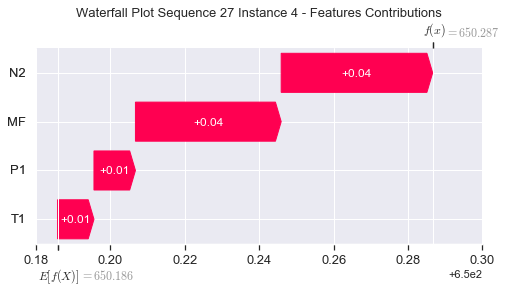

None

Contribution: [0.0123224  0.01086725 0.04402705 0.04103641]


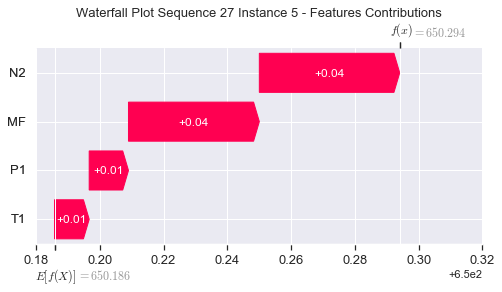

None

Contribution: [0.01474226 0.01302366 0.05051129 0.04779437]


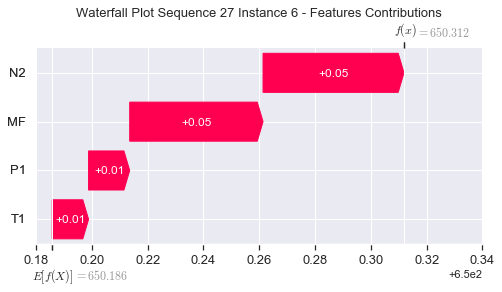

None

Contribution: [0.01570137 0.01396403 0.05315433 0.05042334]


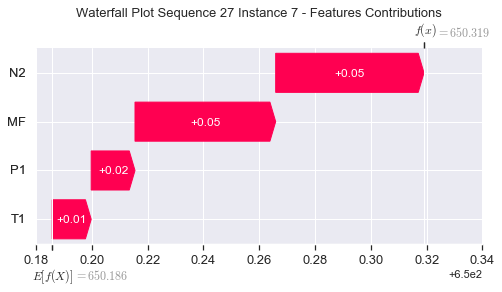

None

Contribution: [0.01571799 0.01397308 0.0529832  0.05046494]


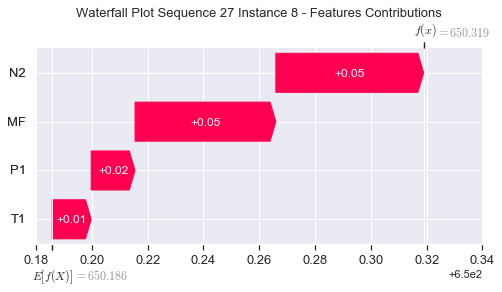

None

Contribution: [0.01512541 0.01374888 0.05107486 0.04853647]


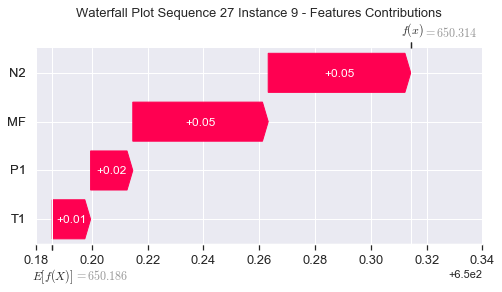

None

Contribution: [0.01488366 0.01328181 0.04988055 0.04756358]


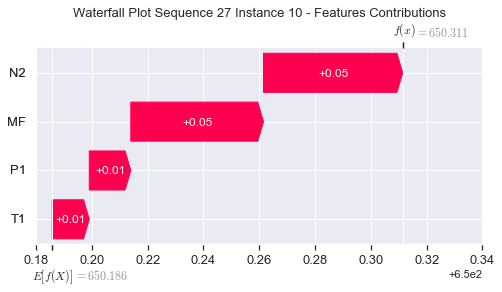

None

Contribution: [0.01491923 0.01291736 0.04980407 0.04759645]


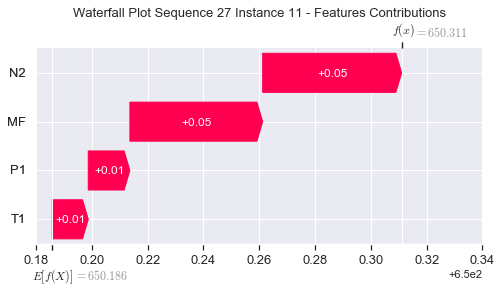

None

Contribution: [0.01510552 0.01285087 0.05019617 0.04799654]


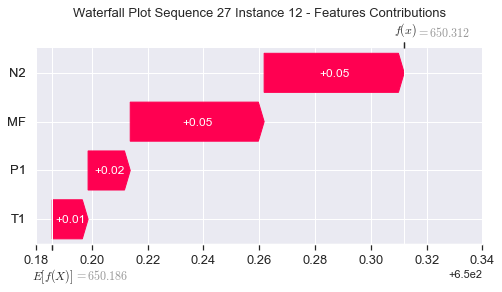

None

Contribution: [0.0154302  0.01324043 0.05102759 0.04886886]


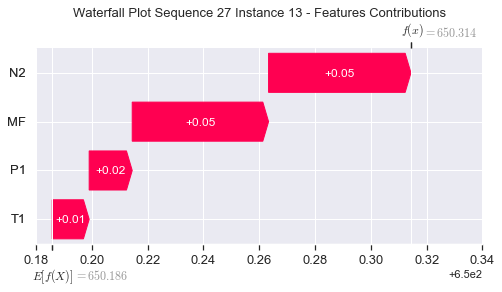

None

Contribution: [0.0159451  0.01390288 0.0525751  0.05073035]


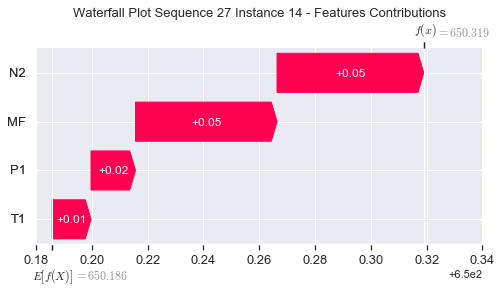

None

Contribution: [0.01656652 0.01423856 0.05434349 0.05225894]


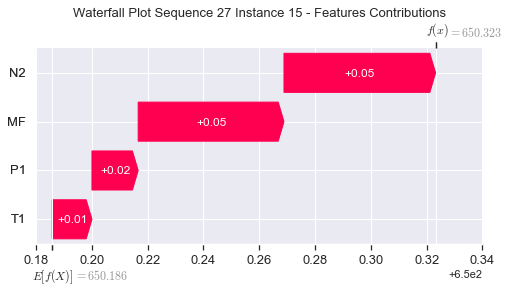

None

Contribution: [0.01751351 0.01539066 0.05689553 0.05499792]


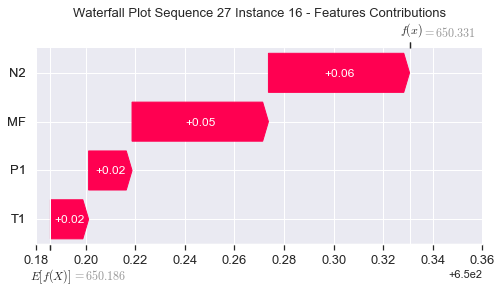

None

Contribution: [0.01841277 0.01602792 0.05980012 0.05767261]


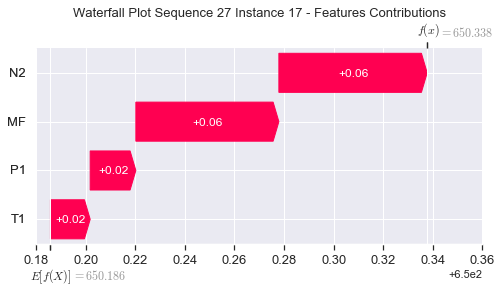

None

Contribution: [0.0198321  0.01735282 0.06428586 0.06200593]


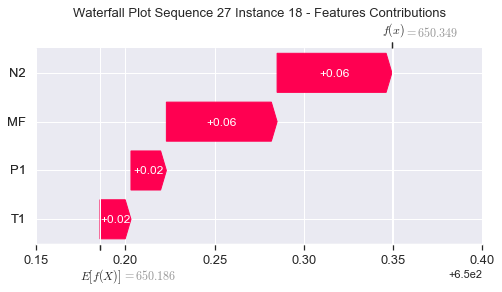

None

Contribution: [0.02156647 0.01923108 0.06968876 0.06631006]


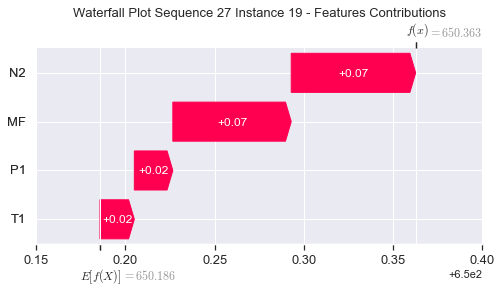

None

Contribution: [0.02652055 0.02541433 0.08656357 0.08203915]


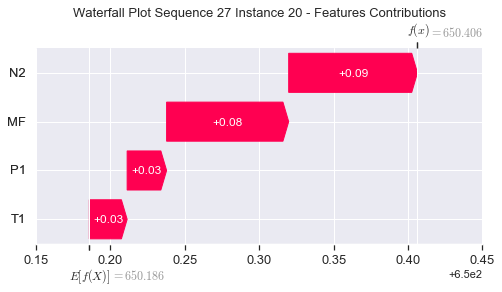

None

Contribution: [0.03535609 0.04462603 0.11517796 0.10375762]


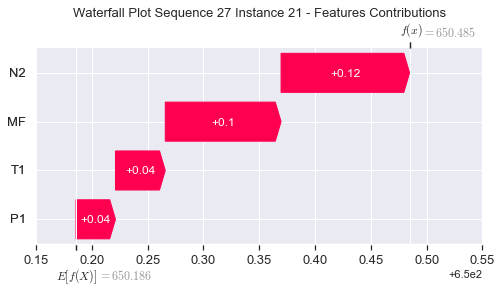

None

Contribution: [0.08235408 0.08606514 0.27506181 0.25577597]


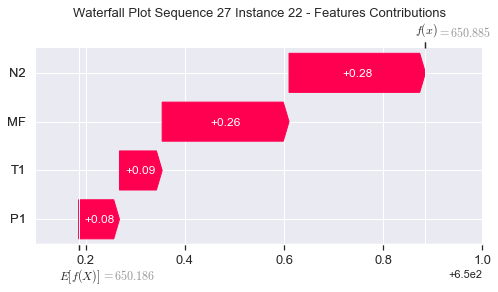

None

Contribution: [0.13660341 0.0903646  0.47059274 0.46251691]


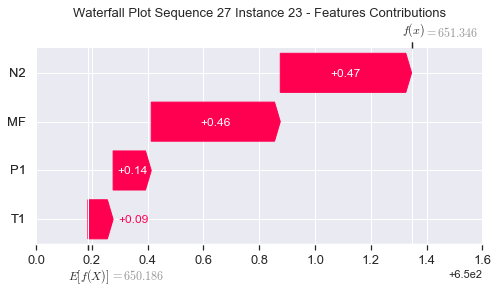

None

Contribution: [ 0.41605441 -1.14030428  1.54060984  2.07658433]


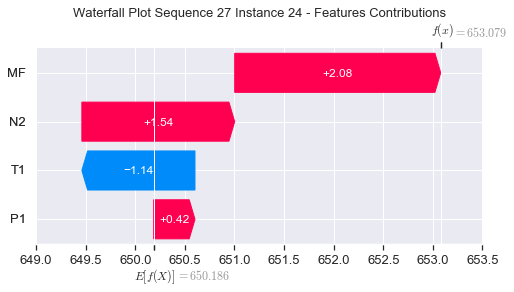

None

Contribution: [ 0.34972877 -0.07680959  1.45065573  1.5697129 ]


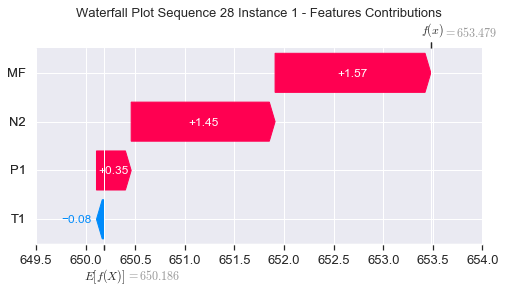

None

Contribution: [0.00096028 0.0206385  0.02081203 0.01210672]


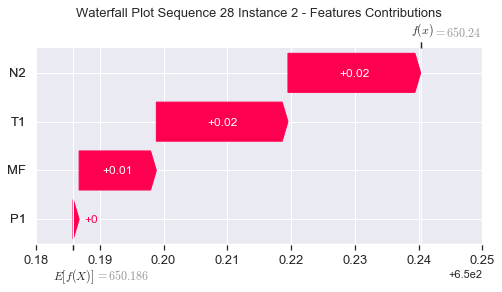

None

Contribution: [0.01228431 0.00991027 0.05456635 0.05159219]


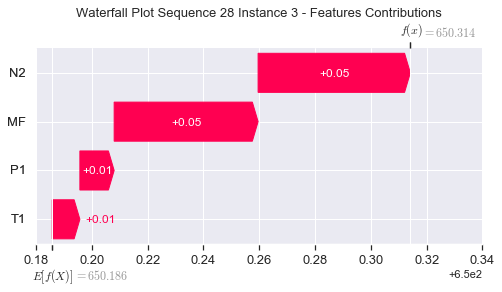

None

Contribution: [0.0111564  0.00978944 0.04047799 0.03878704]


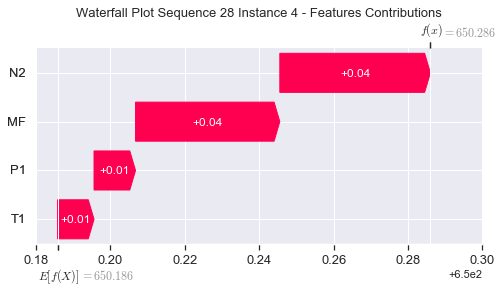

None

Contribution: [0.01299448 0.0116589  0.04411365 0.04234251]


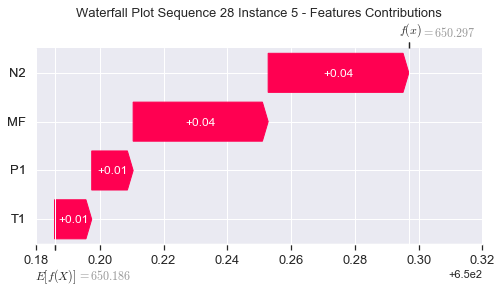

None

Contribution: [0.01485606 0.01425584 0.0502472  0.0479338 ]


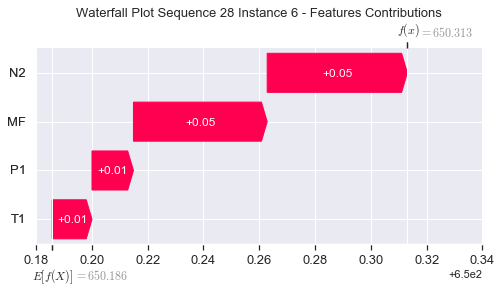

None

Contribution: [0.01567396 0.01548582 0.0529692  0.05068966]


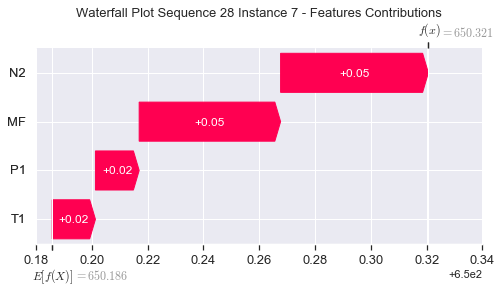

None

Contribution: [0.01588868 0.01491522 0.05277903 0.05070374]


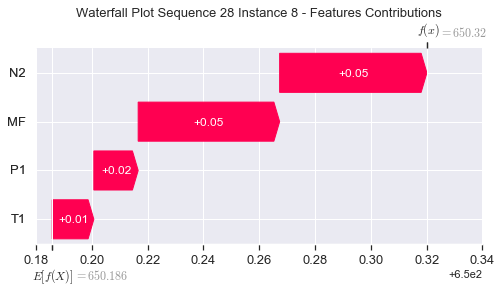

None

Contribution: [0.01528436 0.01564957 0.05112263 0.04929108]


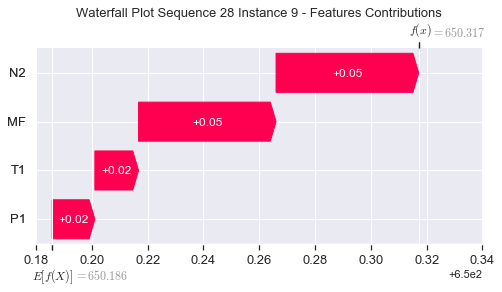

None

Contribution: [0.01551866 0.01498425 0.05001567 0.04902989]


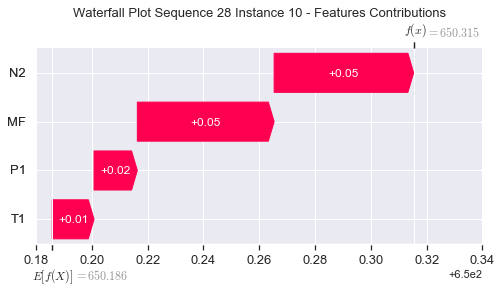

None

Contribution: [0.0155494  0.01368204 0.04988832 0.04808115]


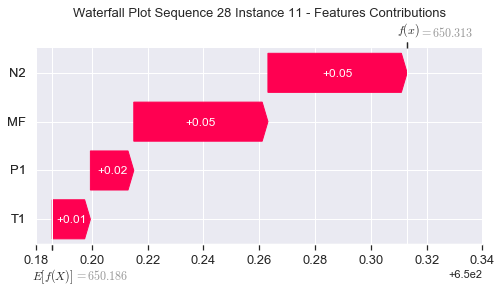

None

Contribution: [0.01556084 0.01321139 0.05033759 0.04895062]


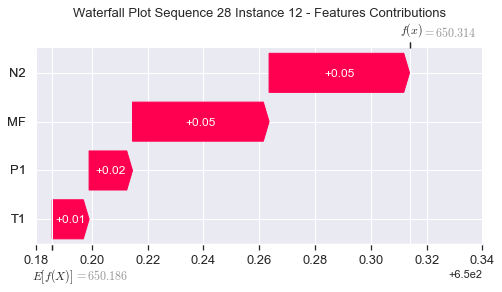

None

Contribution: [0.015918   0.01349262 0.05135435 0.05001009]


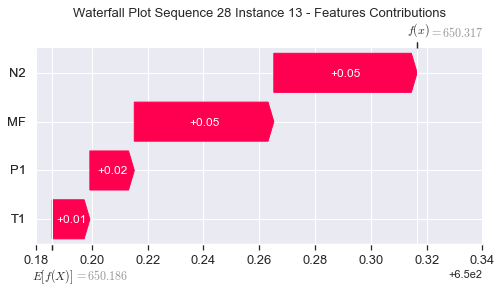

None

Contribution: [0.01601421 0.01338125 0.05269001 0.05029861]


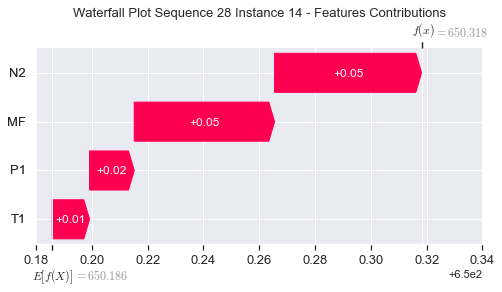

None

Contribution: [0.01711513 0.01367363 0.05463351 0.05303035]


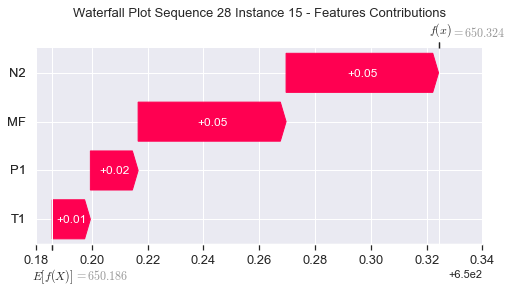

None

Contribution: [0.01823386 0.01489776 0.05727323 0.05621172]


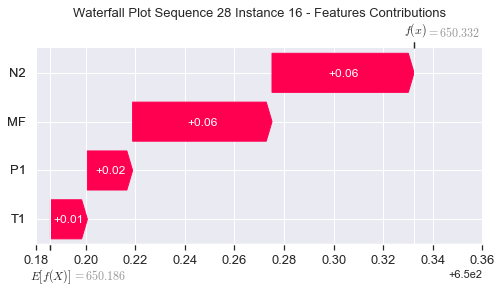

None

Contribution: [0.01893665 0.01492662 0.06022008 0.05838579]


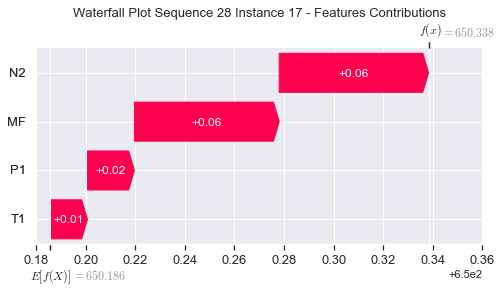

None

Contribution: [0.02048776 0.01557046 0.06478949 0.06260333]


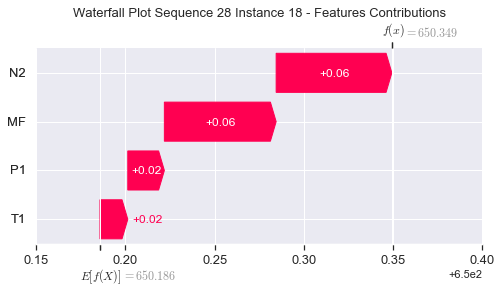

None

Contribution: [0.02184346 0.01726521 0.0704079  0.06758131]


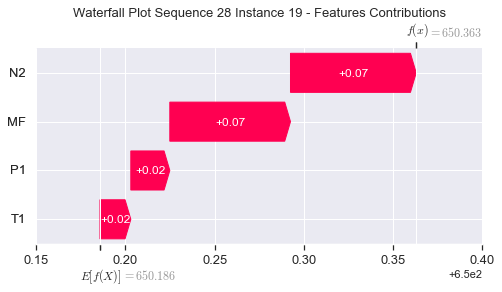

None

Contribution: [0.02731487 0.02341564 0.0874232  0.08289556]


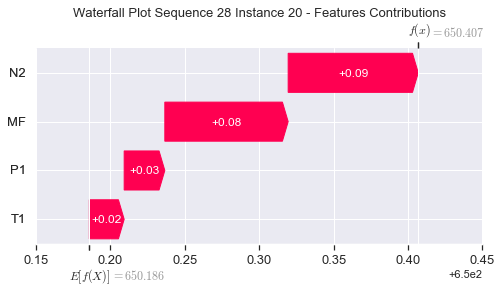

None

Contribution: [0.03462389 0.05054448 0.116345   0.10455954]


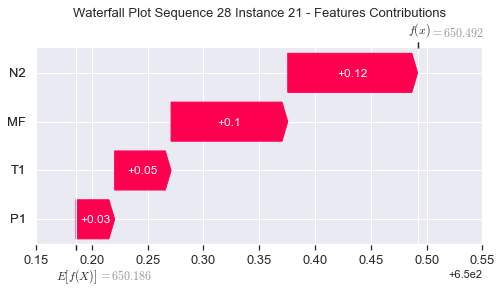

None

Contribution: [0.08696808 0.07373075 0.27805866 0.25978001]


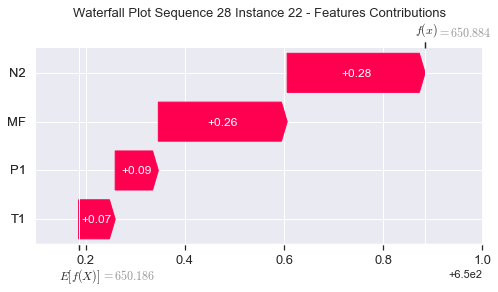

None

Contribution: [ 0.17088232 -0.0373963   0.47938252  0.47410872]


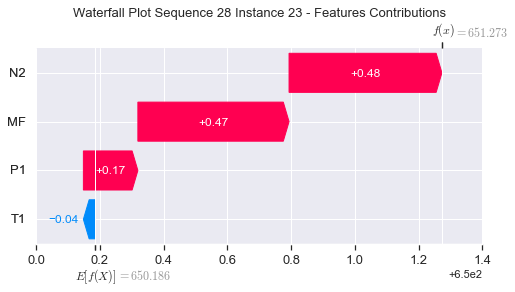

None

Contribution: [ 1.29294644 -3.88797302  1.68829495  2.67493877]


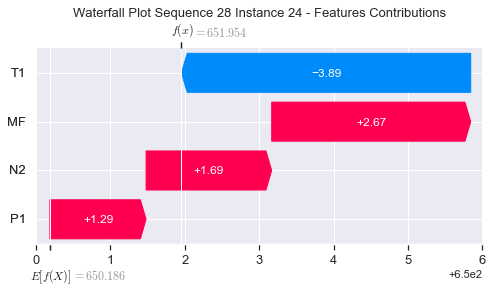

None

Contribution: [ 1.05766342 -1.40120598  1.63154182  2.53835335]


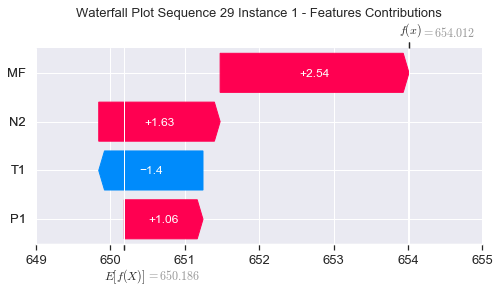

None

Contribution: [-0.00654287  0.03907721  0.02022013  0.00793008]


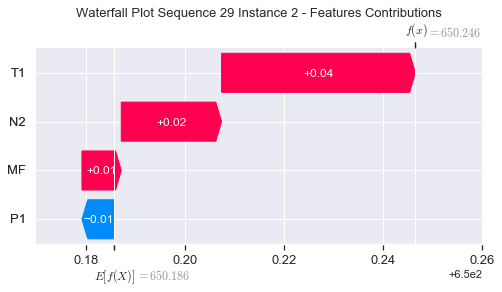

None

Contribution: [ 0.01658326 -0.00359988  0.05560338  0.0555436 ]


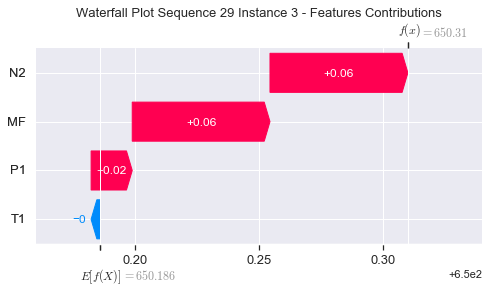

None

Contribution: [0.01415692 0.00119946 0.04182809 0.04205083]


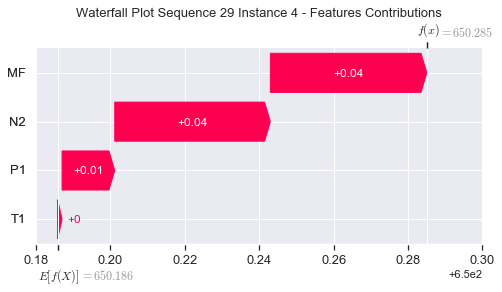

None

Contribution: [0.01422249 0.00469238 0.04472766 0.04185547]


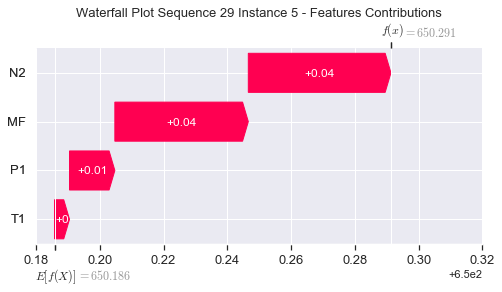

None

Contribution: [0.01768502 0.00553513 0.05170802 0.05025997]


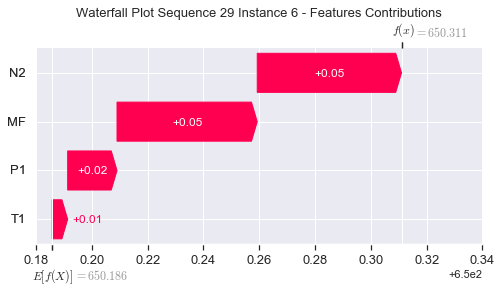

None

Contribution: [0.01860025 0.00639358 0.05431899 0.05287962]


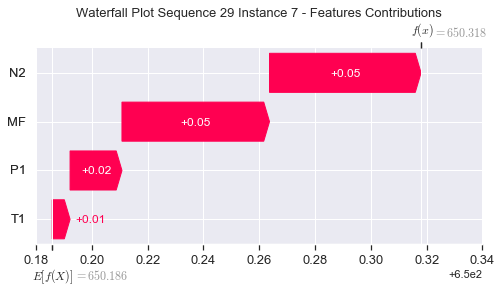

None

Contribution: [0.01836387 0.00701492 0.05416027 0.05271408]


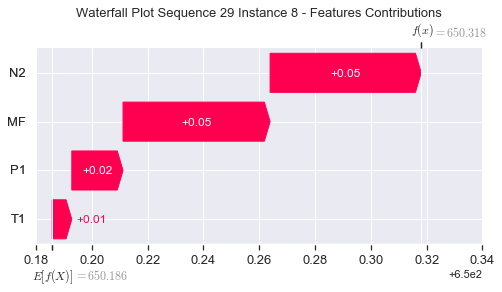

None

Contribution: [0.0176387  0.00617689 0.05221843 0.05056208]


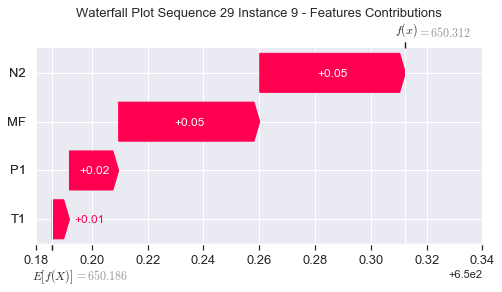

None

Contribution: [0.01594518 0.00630528 0.05056659 0.04801231]


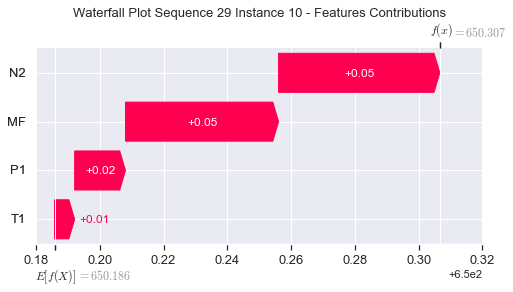

None

Contribution: [0.01752044 0.0062195  0.05085671 0.05020165]


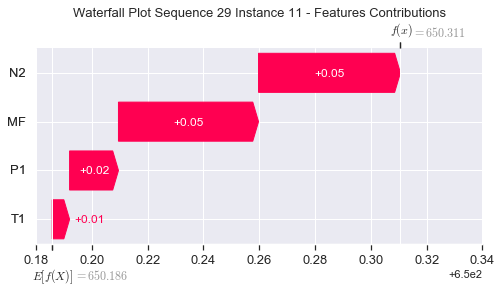

None

Contribution: [0.01800528 0.00603588 0.05120821 0.05137039]


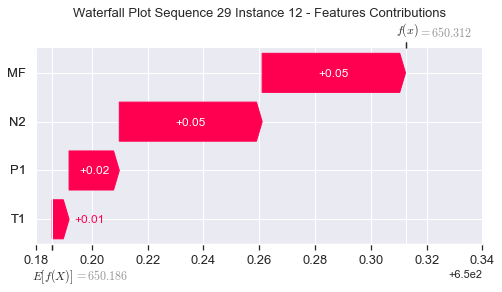

None

Contribution: [0.01804833 0.00666377 0.05186215 0.05167658]


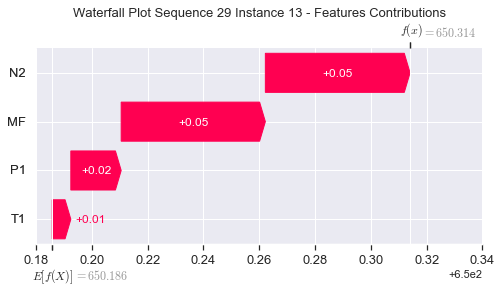

None

Contribution: [0.01967923 0.00731257 0.05365637 0.05413901]


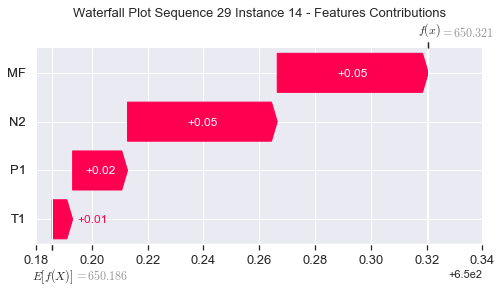

None

Contribution: [0.01916873 0.00797861 0.05534929 0.05502724]


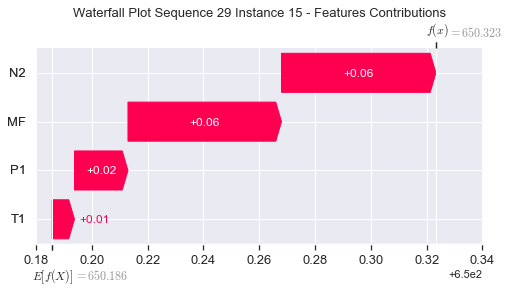

None

Contribution: [0.02043112 0.00696338 0.05798151 0.05806333]


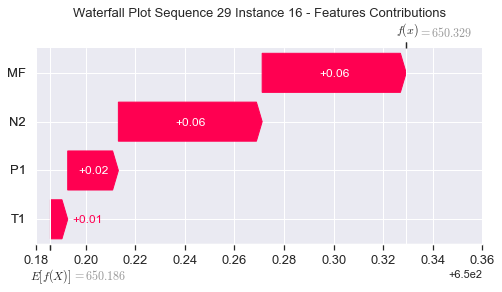

None

Contribution: [0.02078513 0.00986487 0.06086135 0.06017077]


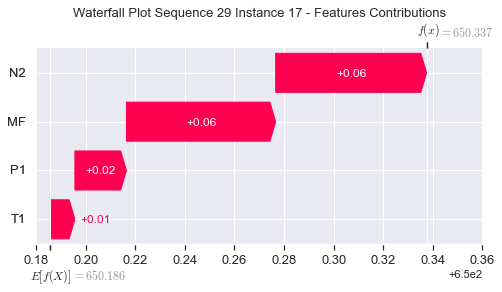

None

Contribution: [0.02200327 0.01165837 0.06534446 0.06427047]


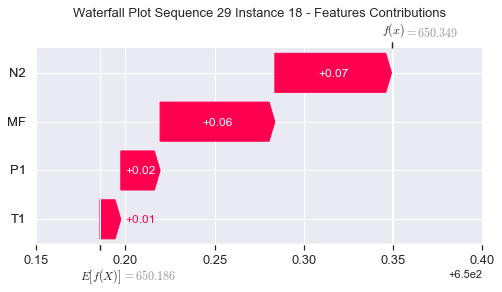

None

Contribution: [0.02256659 0.01643285 0.070607   0.06750198]


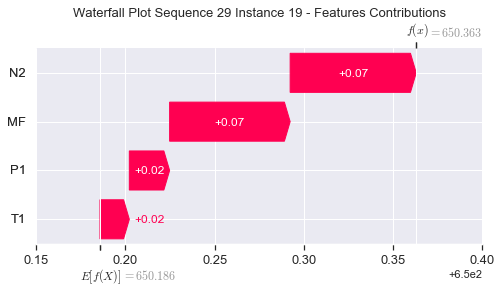

None

Contribution: [0.0274887  0.02246201 0.08765002 0.08297656]


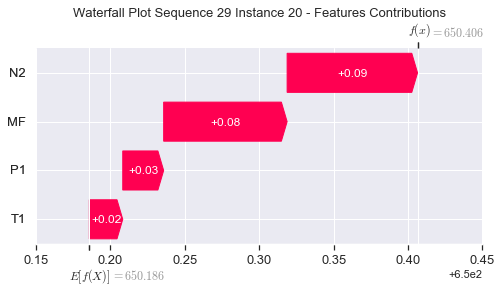

None

Contribution: [0.03495812 0.05125635 0.11648394 0.10514737]


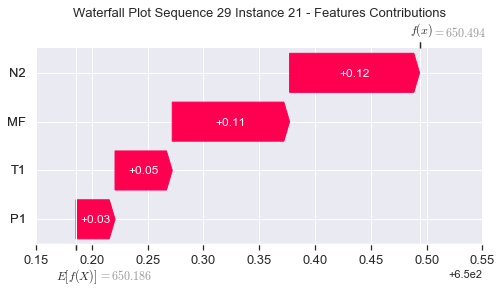

None

Contribution: [0.08427389 0.07730932 0.27780906 0.25752757]


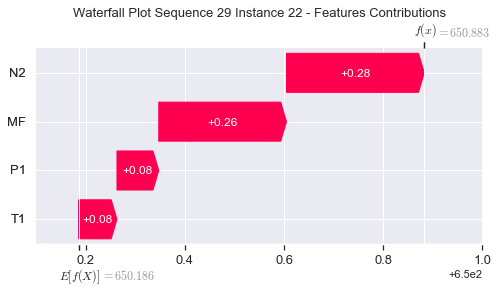

None

Contribution: [0.15256394 0.00383566 0.48077471 0.47218664]


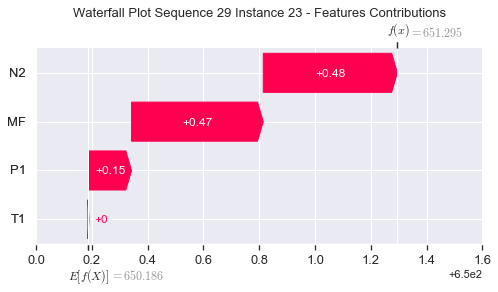

None

Contribution: [ 0.41825629 -2.02750178  1.62055906  1.91661519]


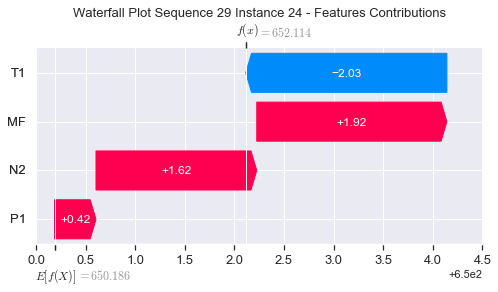

None

Contribution: [ 0.36536087 -0.2795952   1.52526042  1.70306334]


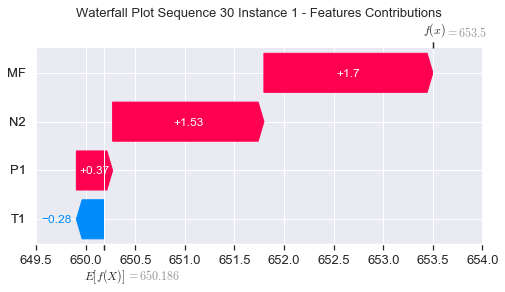

None

Contribution: [0.00148257 0.02707669 0.02087643 0.01283575]


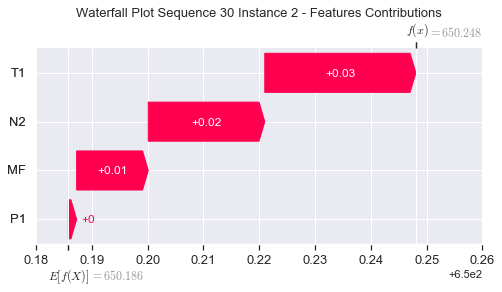

None

Contribution: [0.01299907 0.00602569 0.05519794 0.05243094]


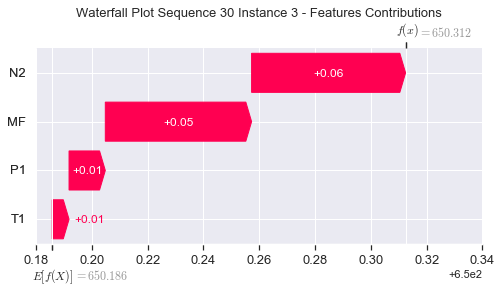

None

Contribution: [0.00964406 0.00649479 0.04040913 0.036858  ]


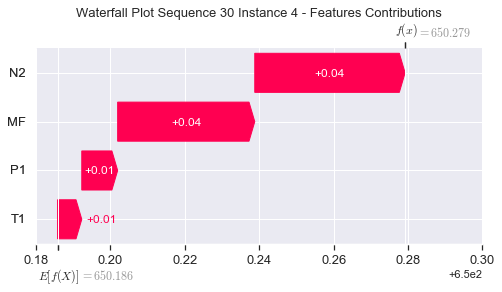

None

Contribution: [0.01275001 0.01160609 0.04457699 0.04191875]


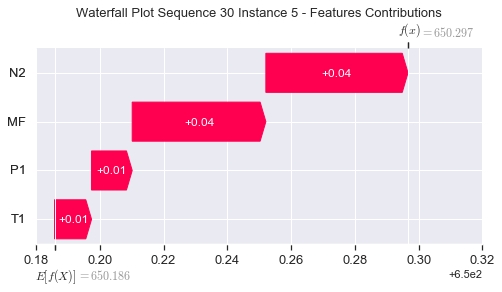

None

Contribution: [0.01473468 0.0131479  0.05065572 0.04761837]


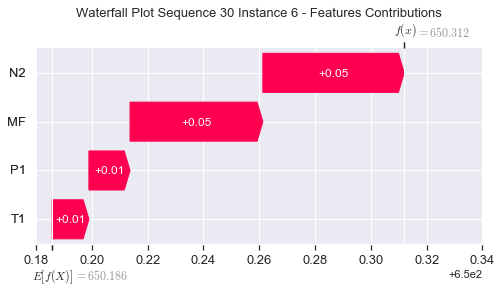

None

Contribution: [0.01570619 0.01399793 0.05333589 0.05032479]


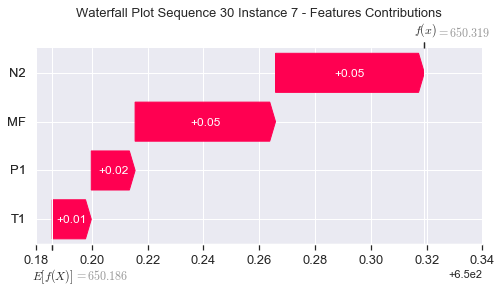

None

Contribution: [0.01574301 0.01405673 0.0531341  0.05037644]


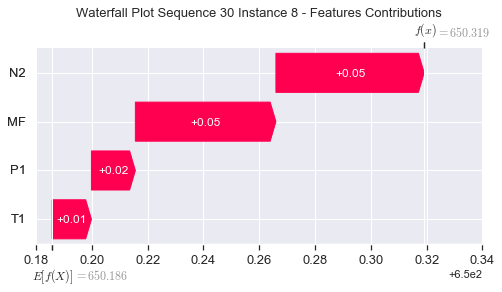

None

Contribution: [0.01529295 0.01411358 0.05119993 0.04889525]


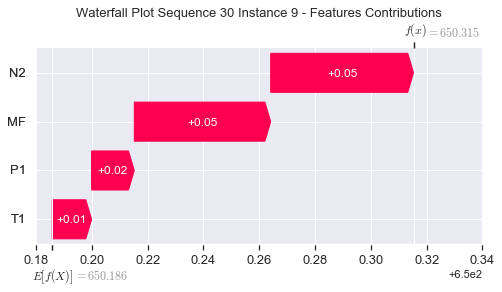

None

Contribution: [0.01513049 0.01335259 0.05005369 0.04763758]


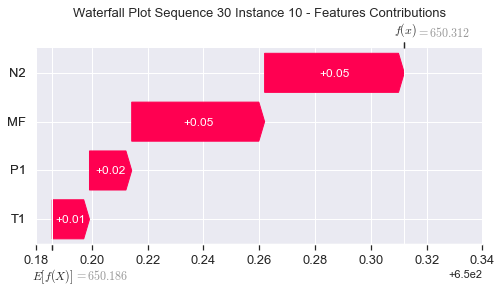

None

Contribution: [0.01496439 0.0134244  0.05003411 0.04783721]


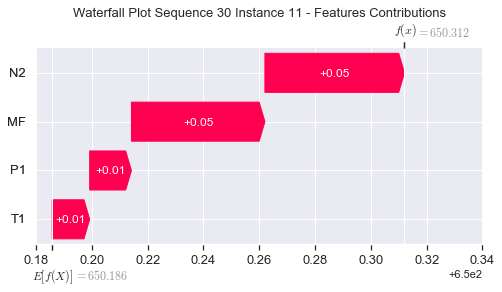

None

Contribution: [0.01509719 0.01287157 0.05046195 0.04809689]


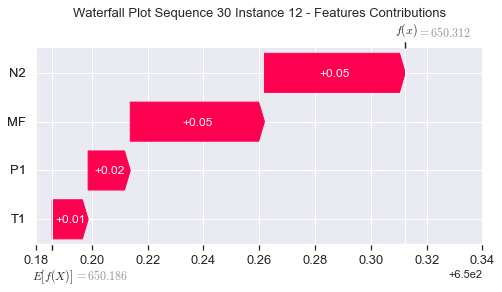

None

Contribution: [0.01548986 0.01322041 0.05140423 0.04906832]


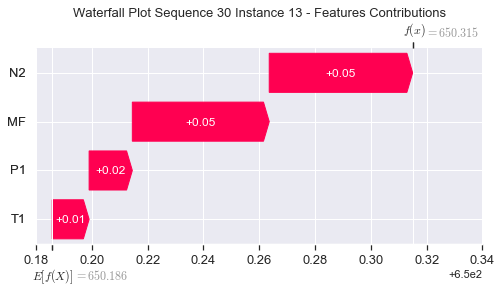

None

Contribution: [0.01605865 0.01305605 0.05272794 0.04970001]


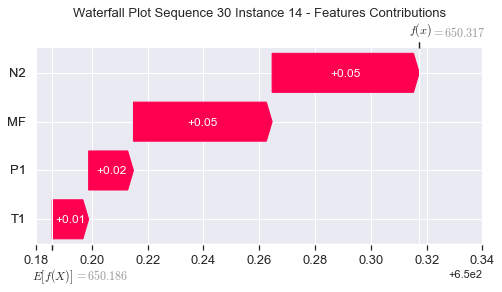

None

Contribution: [0.01658229 0.01400571 0.05469979 0.05223598]


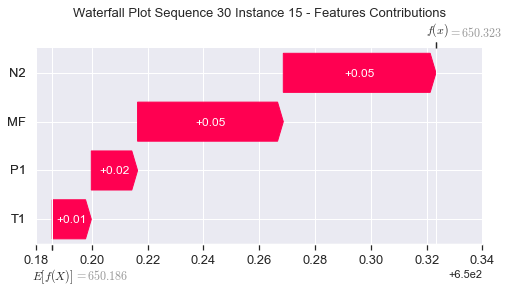

None

Contribution: [0.01769515 0.01480302 0.05732671 0.05552554]


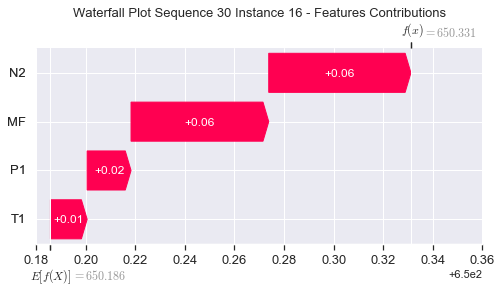

None

Contribution: [0.01835115 0.01547738 0.06015428 0.05739464]


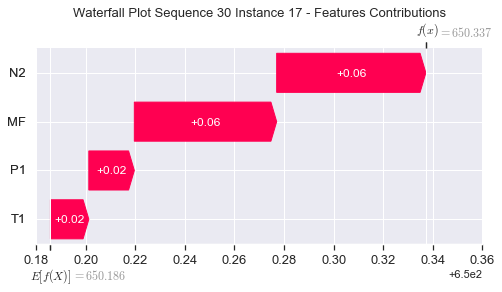

None

Contribution: [0.01971208 0.0166584  0.06458284 0.06149672]


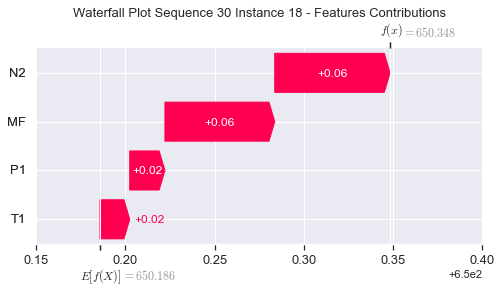

None

Contribution: [0.02172905 0.01923049 0.07024963 0.06692187]


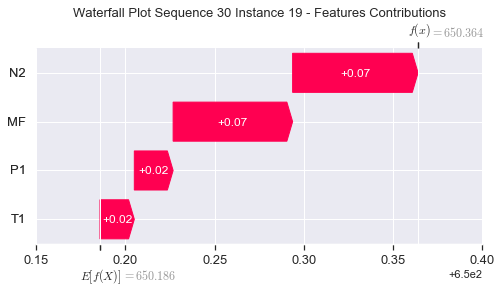

None

Contribution: [0.0265475  0.02497527 0.08702504 0.0818339 ]


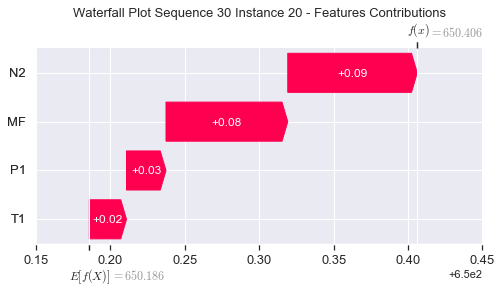

None

Contribution: [0.03575707 0.04614971 0.11603059 0.10549823]


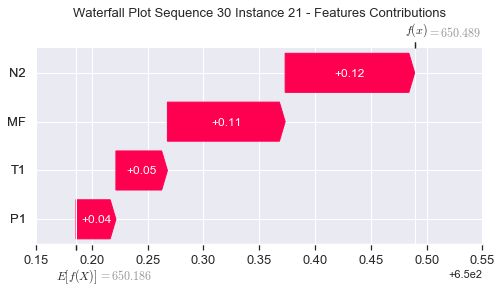

None

Contribution: [0.0825452  0.08459563 0.27643482 0.25520475]


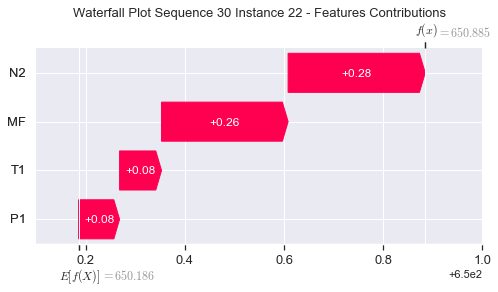

None

Contribution: [0.13258714 0.06652641 0.47354708 0.44705889]


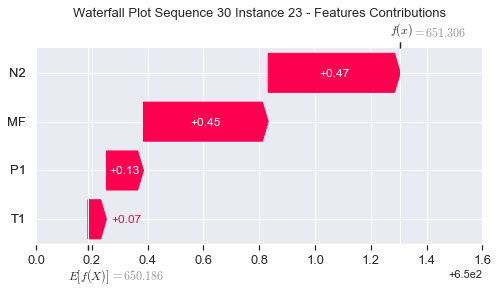

None

Contribution: [ 0.45342528 -1.45914324  1.58646471  1.93103033]


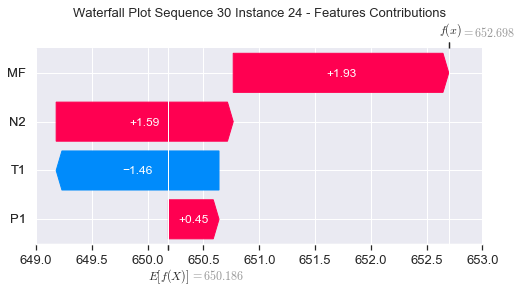

None

Contribution: [ 0.47041507 -0.13847843  1.50834914  1.77483903]


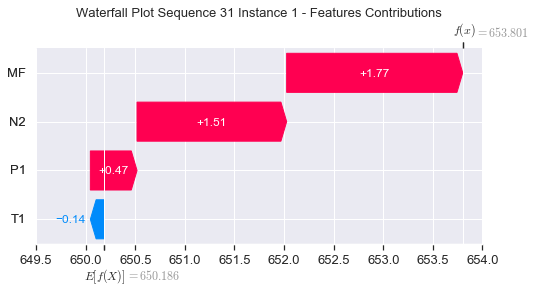

None

Contribution: [0.00054633 0.02160939 0.0204273  0.01266799]


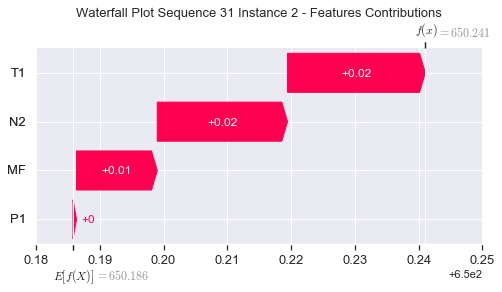

None

Contribution: [0.01286805 0.01025538 0.05536776 0.05256789]


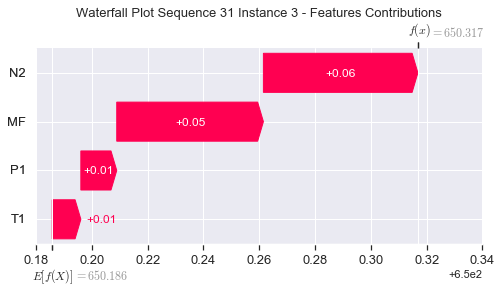

None

Contribution: [0.01049811 0.00983248 0.04048593 0.03753447]


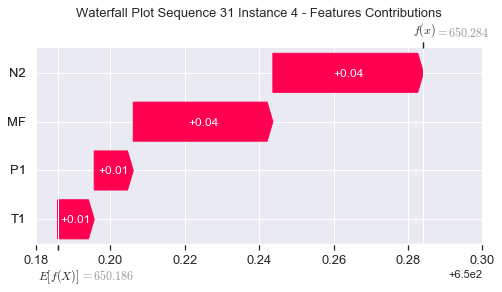

None

Contribution: [0.01266461 0.01155892 0.04456928 0.04179395]


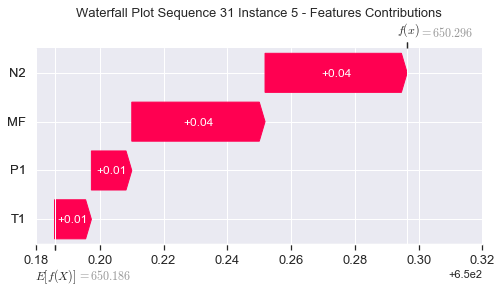

None

Contribution: [0.0145014  0.01329412 0.05064279 0.04718635]


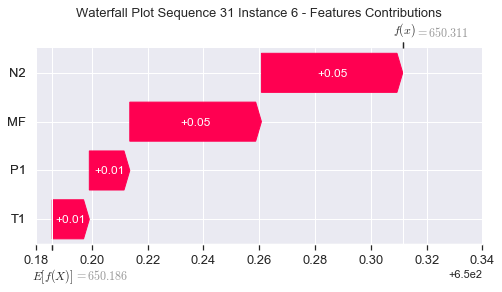

None

Contribution: [0.01553603 0.01413616 0.05333343 0.04991449]


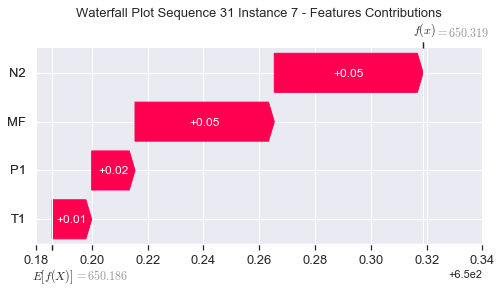

None

Contribution: [0.01564732 0.01417148 0.05310662 0.05015187]


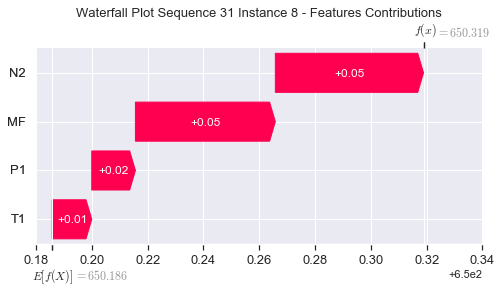

None

Contribution: [0.01566878 0.01378457 0.05126907 0.04952403]


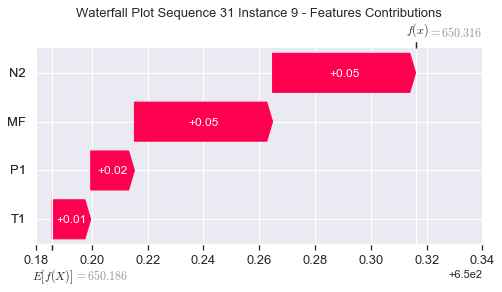

None

Contribution: [0.01512208 0.01378806 0.04992431 0.04772063]


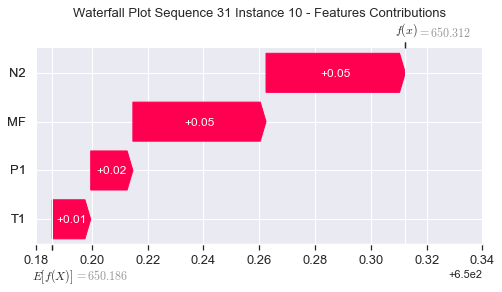

None

Contribution: [0.01522612 0.01336782 0.05002556 0.04836686]


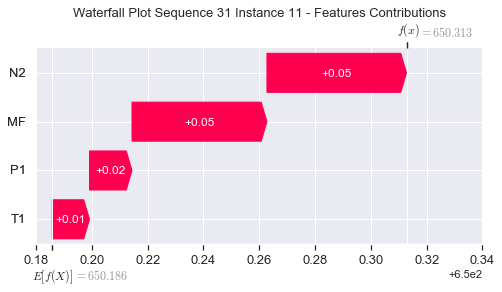

None

Contribution: [0.01499633 0.01313859 0.05032911 0.04770508]


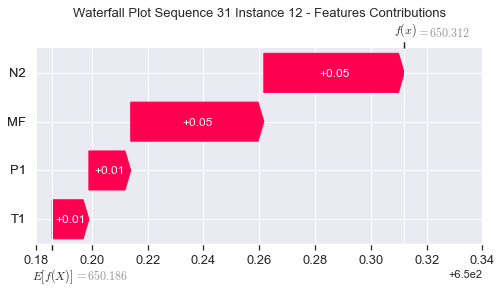

None

Contribution: [0.01542911 0.01339652 0.05126913 0.04875536]


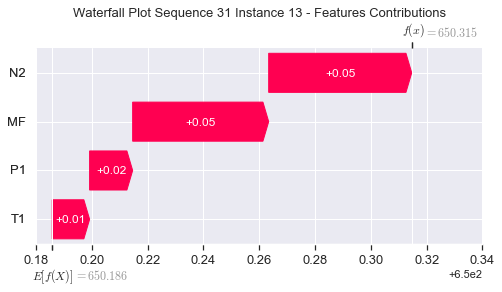

None

Contribution: [0.01588764 0.01317478 0.05276839 0.05071188]


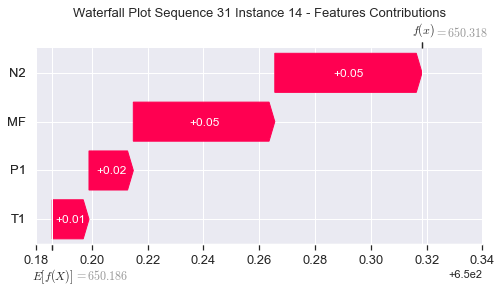

None

Contribution: [0.01648598 0.01417914 0.05450161 0.05194883]


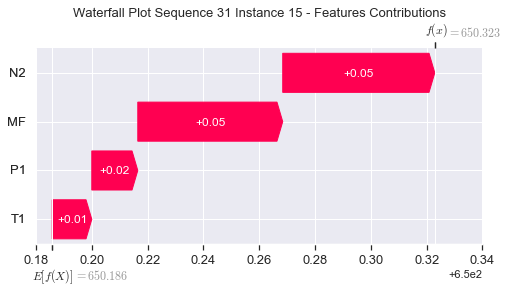

None

Contribution: [0.01755644 0.01555145 0.05723396 0.05532234]


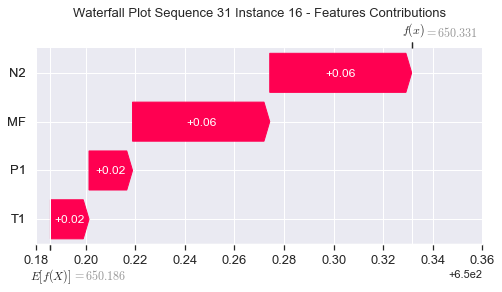

None

Contribution: [0.01836067 0.01562562 0.05998167 0.0572436 ]


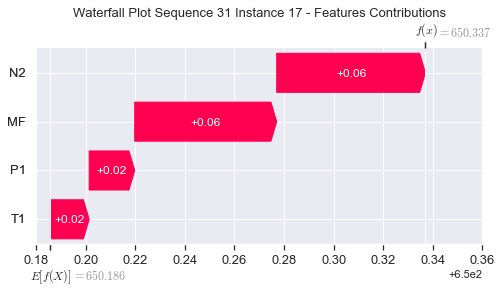

None

Contribution: [0.01975504 0.01681123 0.06449544 0.06148751]


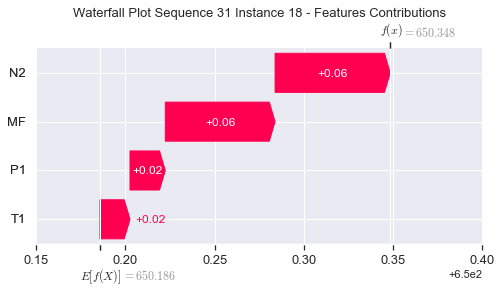

None

Contribution: [0.02138844 0.01876425 0.07008546 0.06579999]


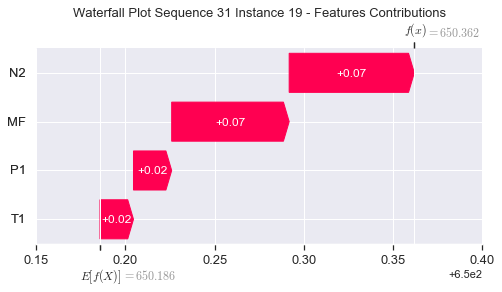

None

Contribution: [0.02666131 0.02486007 0.08677094 0.08191947]


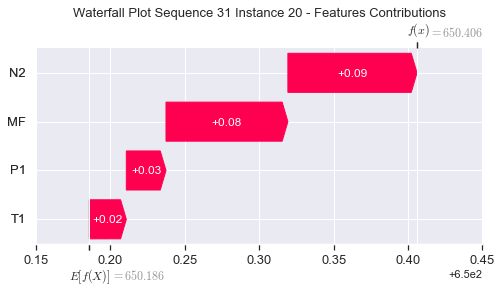

None

Contribution: [0.03515387 0.04569578 0.11517125 0.10407989]


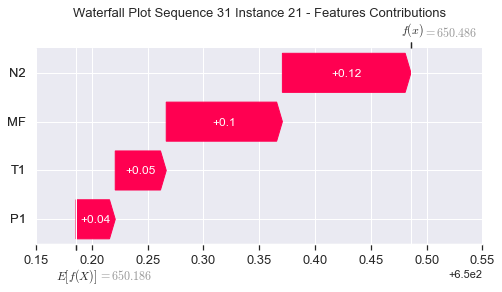

None

Contribution: [0.08333871 0.08416359 0.27593668 0.25666872]


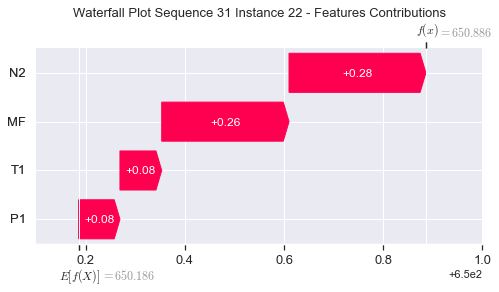

None

Contribution: [0.14033828 0.06976055 0.47463369 0.46013478]


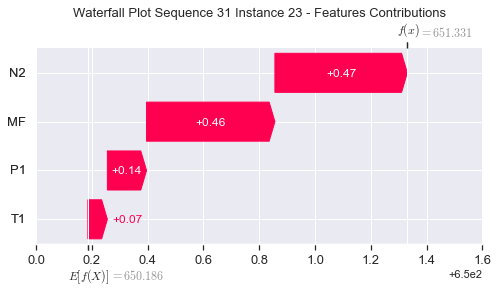

None

Contribution: [ 0.46409347 -1.62912586  1.60004758  1.98707245]


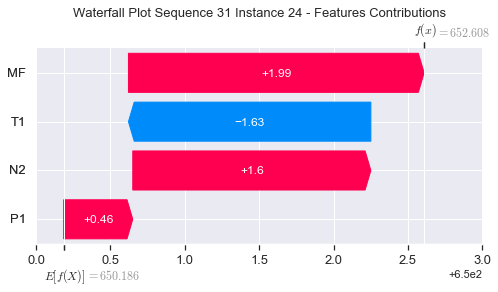

None

Contribution: [ 0.34906773 -0.40219378  1.48856915  1.50308299]


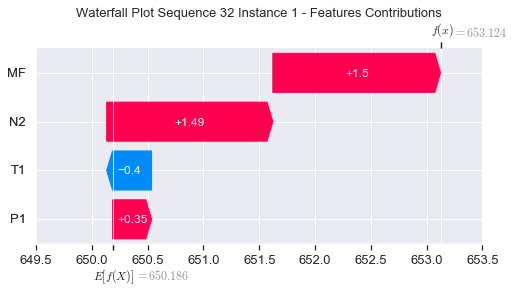

None

Contribution: [-0.00179888  0.02253052  0.01977273  0.0086386 ]


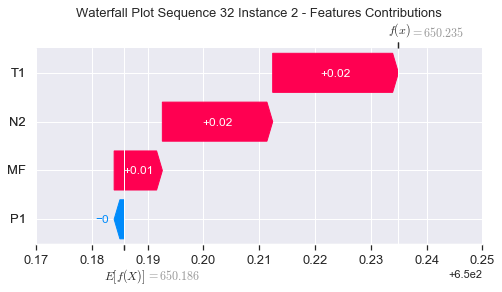

None

Contribution: [0.01239214 0.009289   0.05517906 0.05243543]


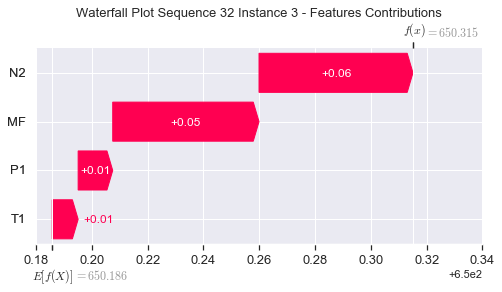

None

Contribution: [0.01100049 0.00932784 0.04116216 0.03806937]


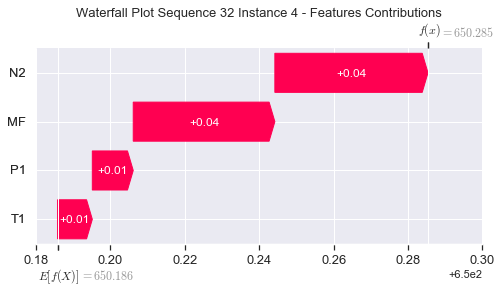

None

Contribution: [0.0129893  0.01126994 0.04490283 0.04279021]


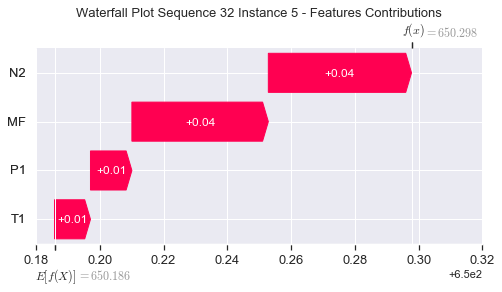

None

Contribution: [0.01498742 0.01290886 0.05095744 0.04845544]


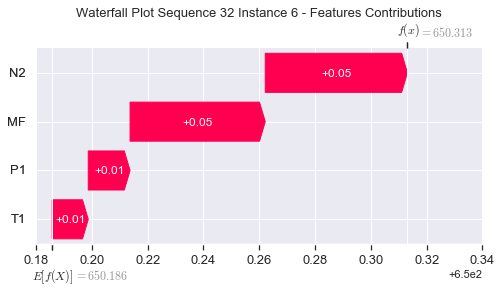

None

Contribution: [0.01594118 0.01378663 0.0536404  0.05121975]


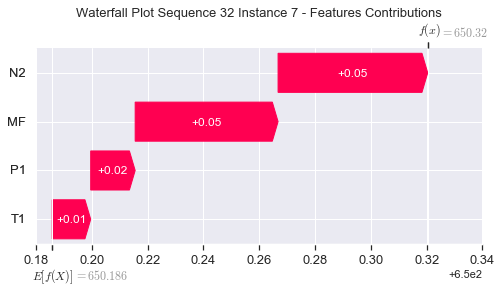

None

Contribution: [0.0159557  0.0138032  0.05351543 0.05120945]


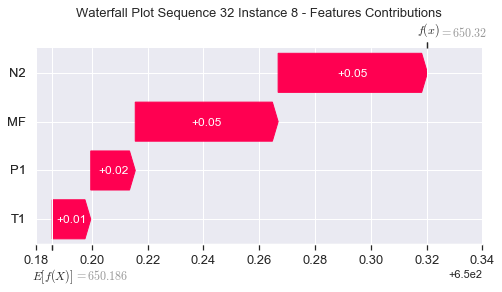

None

Contribution: [0.01495705 0.01372038 0.05132219 0.04872255]


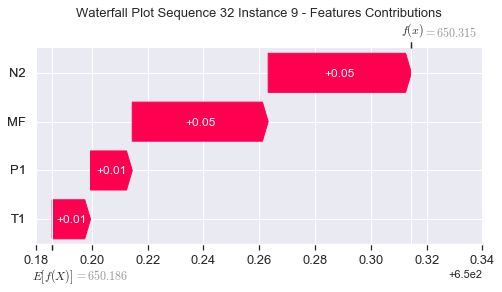

None

Contribution: [0.01443792 0.01342068 0.04984252 0.04704963]


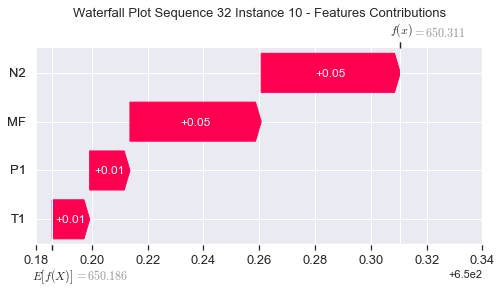

None

Contribution: [0.01481339 0.01311078 0.04998143 0.04767981]


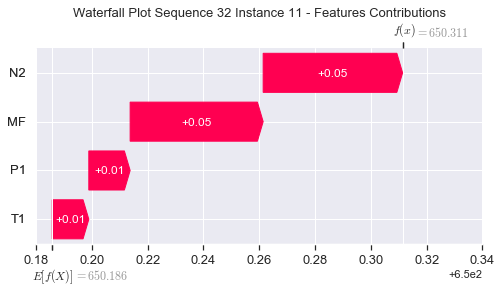

None

Contribution: [0.01549921 0.01307708 0.05074737 0.04941679]


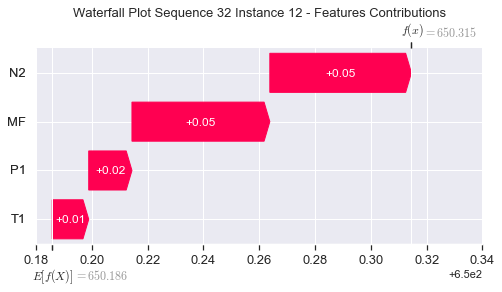

None

Contribution: [0.01579067 0.01330949 0.05157916 0.05018725]


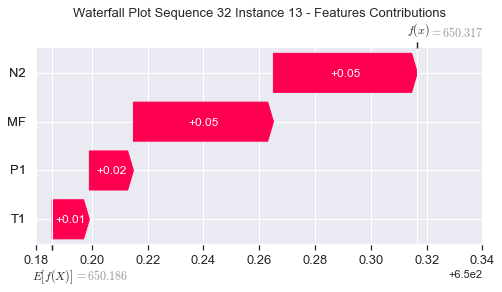

None

Contribution: [0.01605824 0.01433425 0.05306106 0.0509804 ]


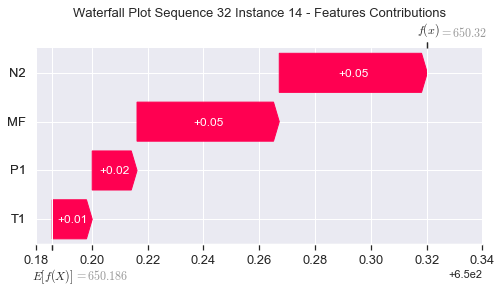

None

Contribution: [0.01685621 0.01382289 0.05508337 0.05333356]


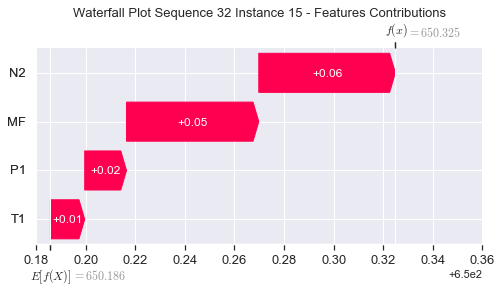

None

Contribution: [0.01732098 0.01424847 0.05743346 0.05478023]


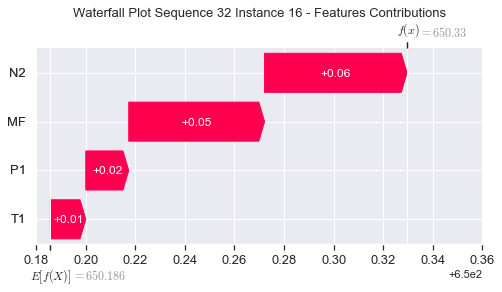

None

Contribution: [0.01860902 0.01518437 0.06058506 0.05850414]


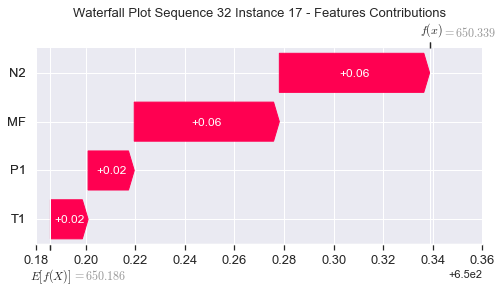

None

Contribution: [0.02001012 0.01627901 0.06520278 0.06270136]


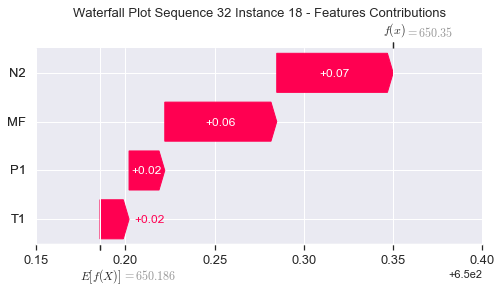

None

Contribution: [0.02087703 0.01735381 0.07029144 0.06658273]


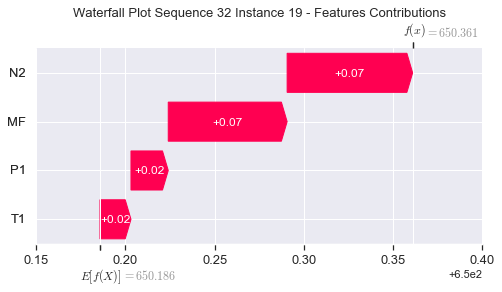

None

Contribution: [0.02668052 0.02432026 0.08751331 0.08256122]


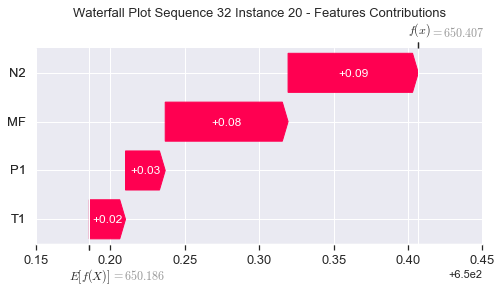

None

Contribution: [0.03550119 0.04729207 0.11520596 0.10427792]


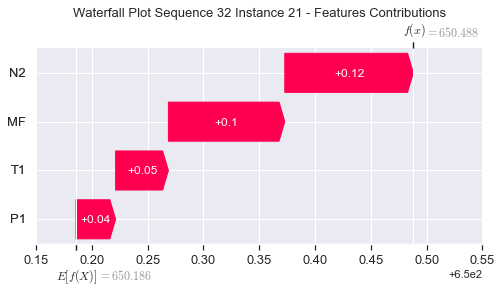

None

Contribution: [0.08315853 0.08168705 0.27807593 0.2578828 ]


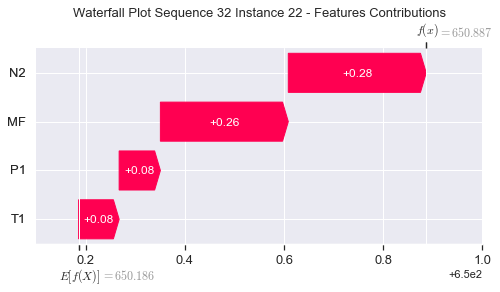

None

Contribution: [0.1378682  0.04258606 0.48490496 0.46467583]


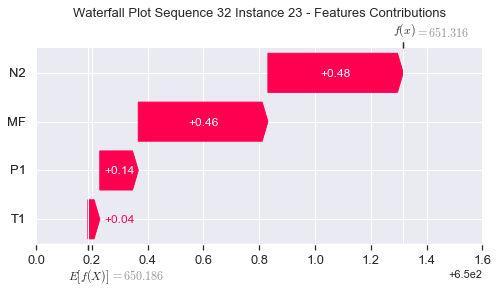

None

Contribution: [ 0.45336202 -1.99278299  1.77539524  1.99994368]


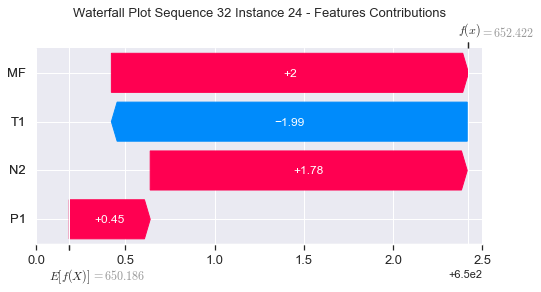

None

Contribution: [ 0.40653231 -0.33541745  1.58370699  1.62471941]


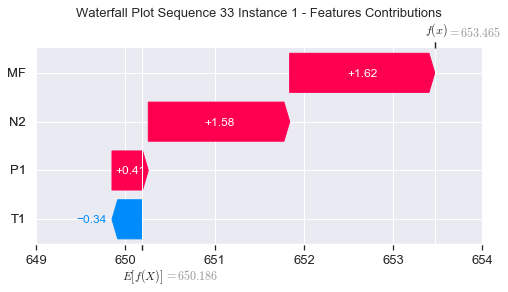

None

Contribution: [-0.00064864  0.02456346  0.01867613  0.00854357]


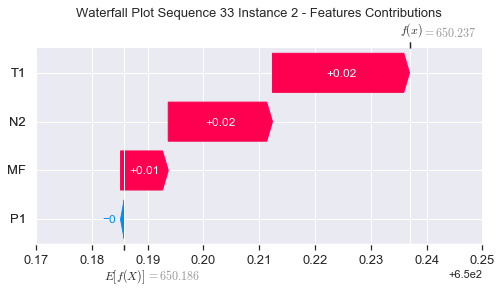

None

Contribution: [0.01229881 0.00749653 0.05584377 0.05221828]


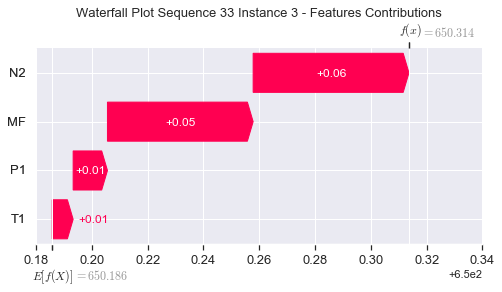

None

Contribution: [0.0112182  0.00982821 0.04164857 0.03915122]


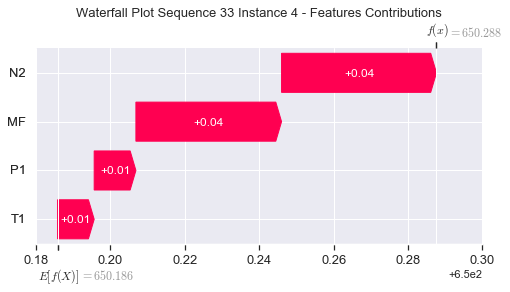

None

Contribution: [0.01233506 0.01068628 0.04486519 0.0414662 ]


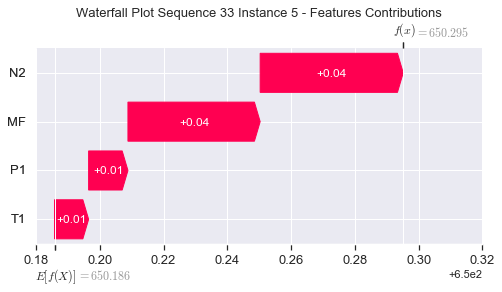

None

Contribution: [0.01488761 0.01263236 0.05134234 0.04834644]


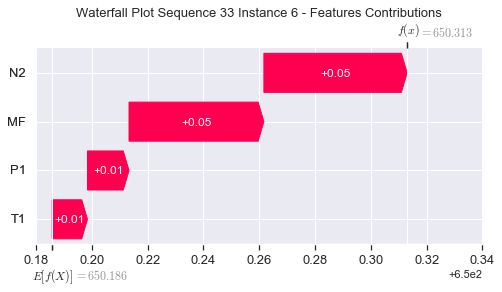

None

Contribution: [0.01574198 0.01331711 0.05394003 0.0507582 ]


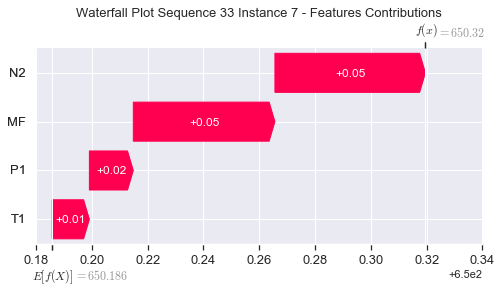

None

Contribution: [0.01576959 0.01335981 0.05385824 0.05103138]


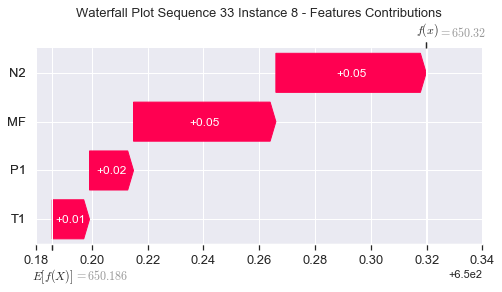

None

Contribution: [0.01458765 0.0128422  0.05175313 0.04886102]


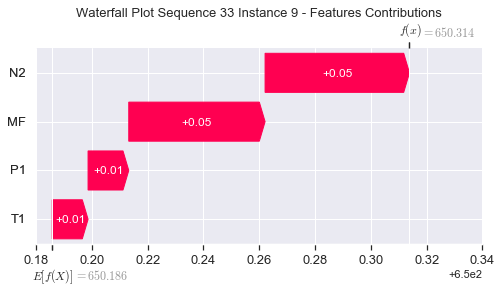

None

Contribution: [0.01461135 0.01296111 0.05027935 0.04744469]


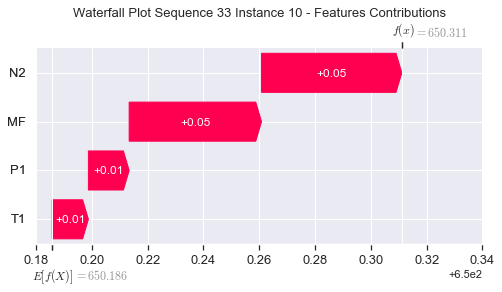

None

Contribution: [0.01486385 0.01261856 0.05059494 0.04911329]


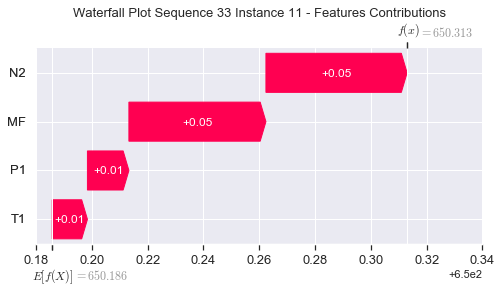

None

Contribution: [0.01537771 0.01195607 0.0509433  0.04911345]


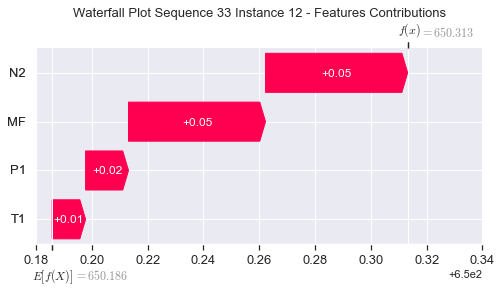

None

Contribution: [0.01562154 0.0121568  0.05187909 0.04981034]


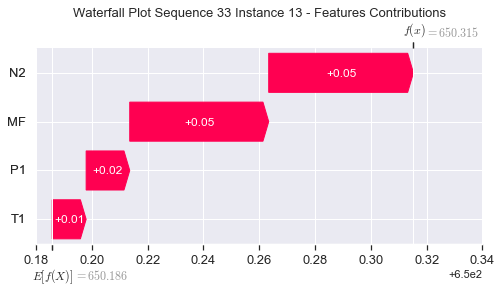

None

Contribution: [0.01608719 0.01233715 0.05322177 0.05059638]


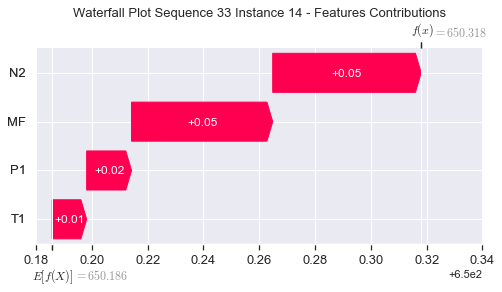

None

Contribution: [0.01678087 0.01279384 0.05532883 0.05323489]


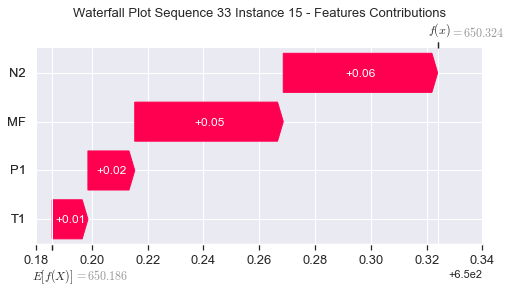

None

Contribution: [0.01738332 0.013811   0.05764859 0.05502525]


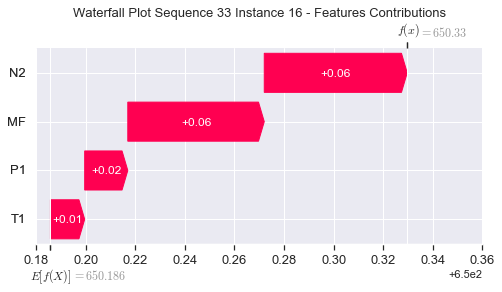

None

Contribution: [0.01845454 0.01399344 0.06081834 0.05828529]


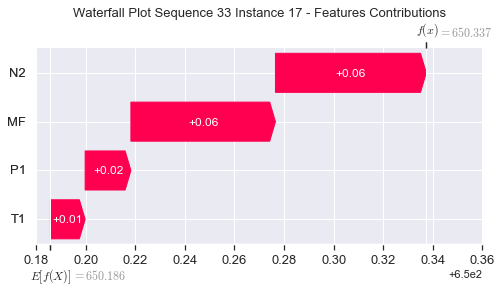

None

Contribution: [0.01990476 0.01517322 0.06543185 0.06268706]


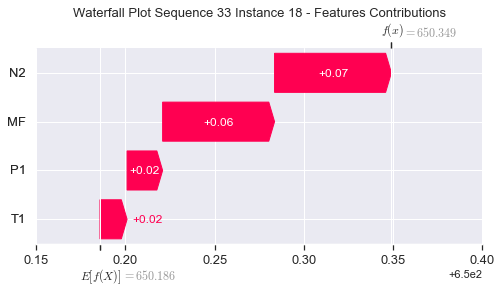

None

Contribution: [0.02129324 0.01730378 0.07092986 0.06670165]


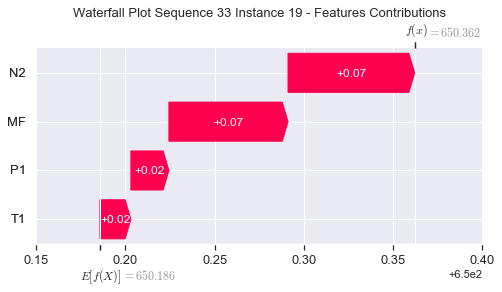

None

Contribution: [0.02657778 0.02376844 0.08815863 0.08280317]


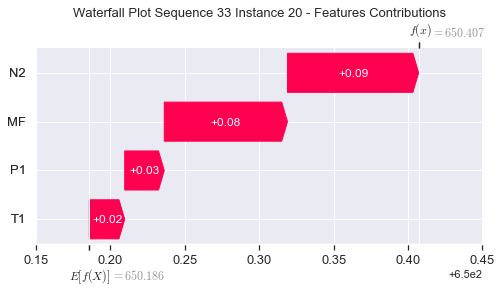

None

Contribution: [0.03674276 0.05003157 0.11778638 0.10714484]


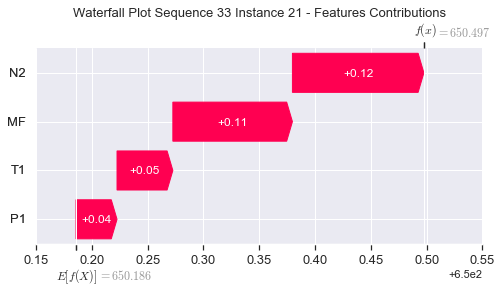

None

Contribution: [0.08213155 0.07812608 0.2787662  0.25793894]


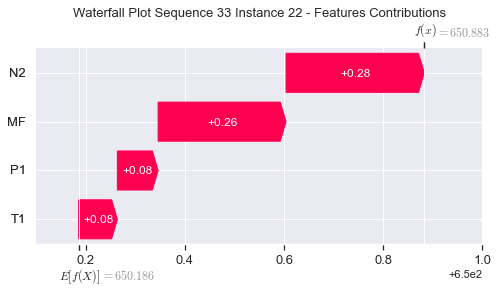

None

Contribution: [0.12759068 0.00396387 0.47639153 0.46095165]


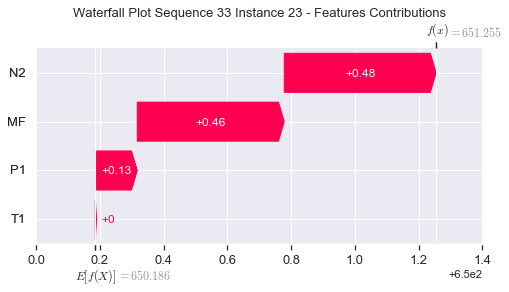

None

Contribution: [ 0.32375853 -2.43715558  1.56976027  2.01447797]


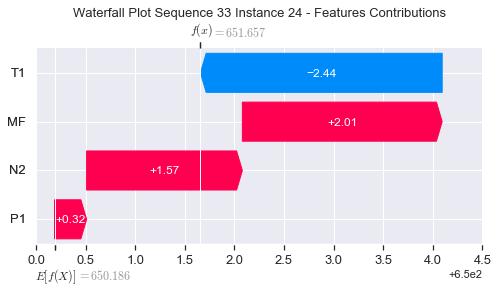

None

Contribution: [ 0.40424675 -0.51076487  1.52841064  1.78976822]


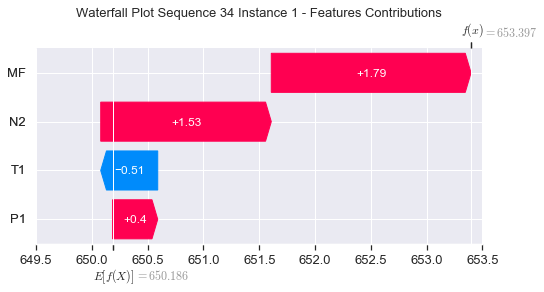

None

Contribution: [0.00258044 0.03165932 0.02189842 0.01323225]


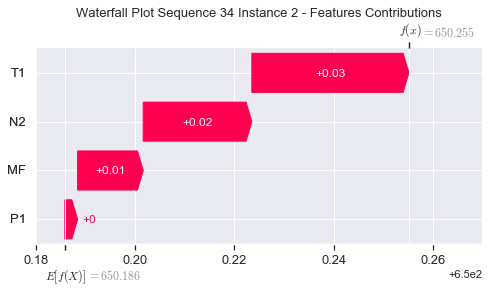

None

Contribution: [0.01266069 0.00418805 0.0555514  0.05405524]


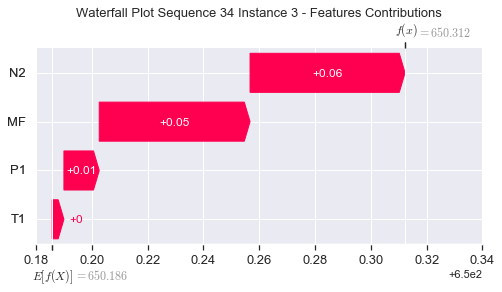

None

Contribution: [0.01058569 0.00685402 0.04126433 0.03931566]


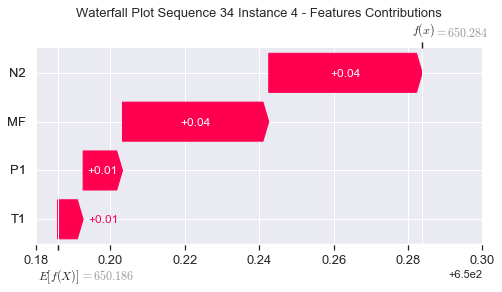

None

Contribution: [0.01224117 0.00943205 0.04485037 0.04146162]


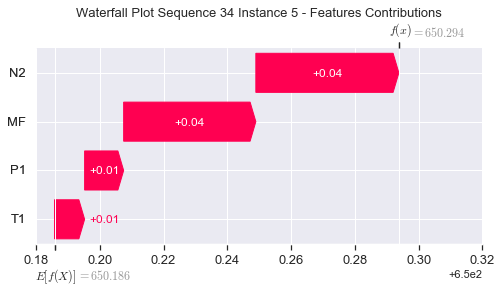

None

Contribution: [0.01447605 0.01140298 0.05143739 0.04816481]


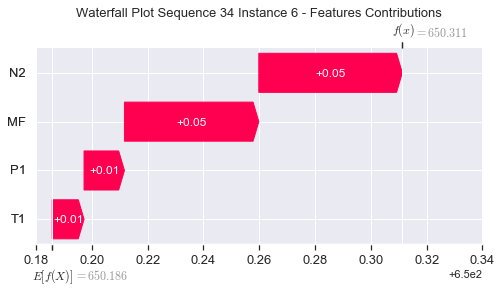

None

Contribution: [0.01545764 0.01232136 0.05415914 0.05089167]


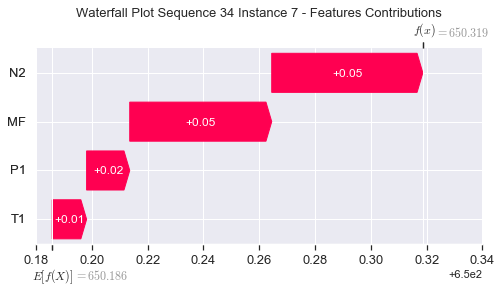

None

Contribution: [0.01541751 0.0122622  0.05398248 0.05095864]


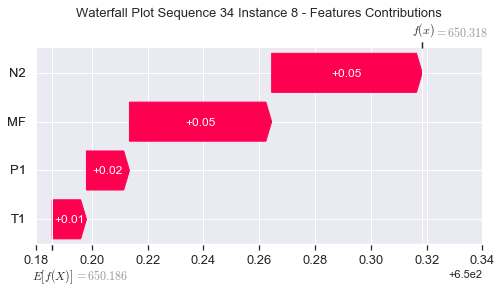

None

Contribution: [0.01451546 0.01172861 0.05209092 0.04930249]


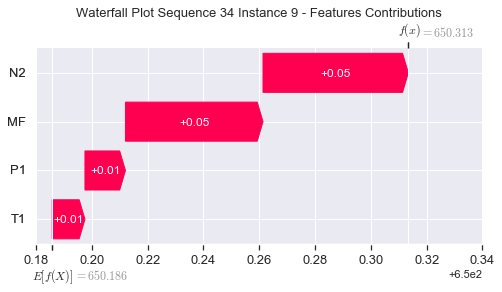

None

Contribution: [0.01414552 0.0112002  0.05085195 0.04840631]


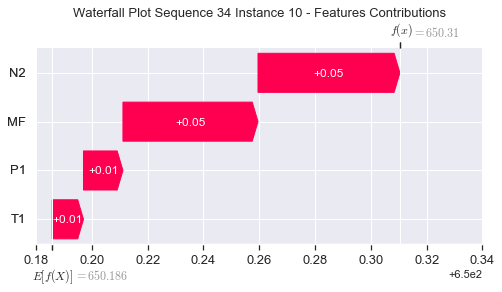

None

Contribution: [0.01412823 0.01132669 0.05079593 0.04847934]


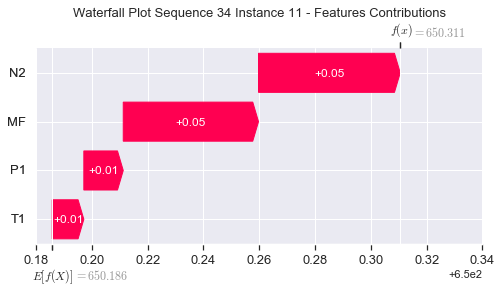

None

Contribution: [0.01455964 0.01145249 0.05121826 0.04878937]


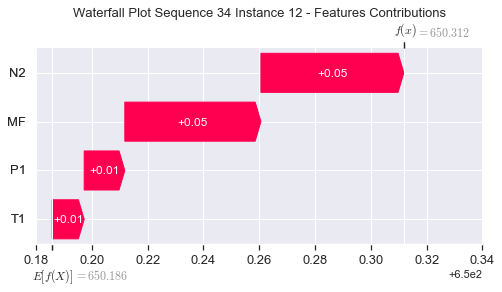

None

Contribution: [0.01496518 0.01167629 0.0521918  0.04971209]


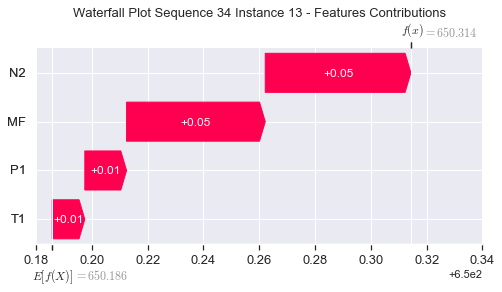

None

Contribution: [0.0148339  0.01165169 0.05361746 0.05025492]


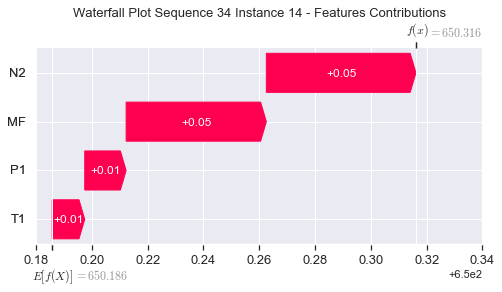

None

Contribution: [0.01617472 0.01232153 0.05558965 0.05307587]


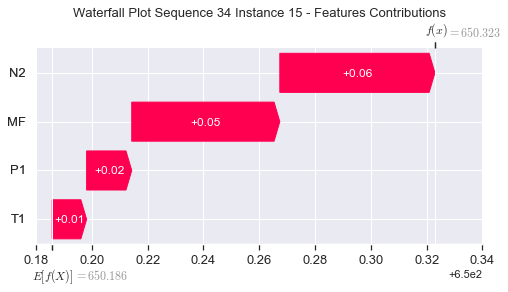

None

Contribution: [0.01744205 0.01228861 0.05834515 0.05618104]


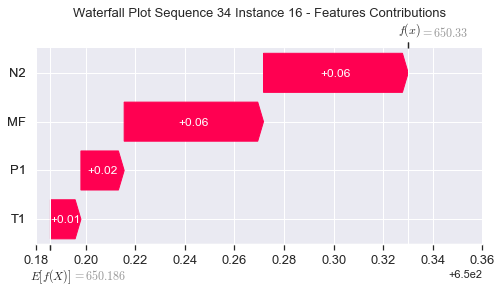

None

Contribution: [0.0179936  0.0136118  0.06120164 0.05843861]


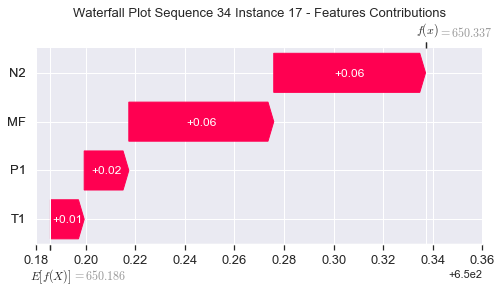

None

Contribution: [0.019445   0.01474492 0.065887   0.06284107]


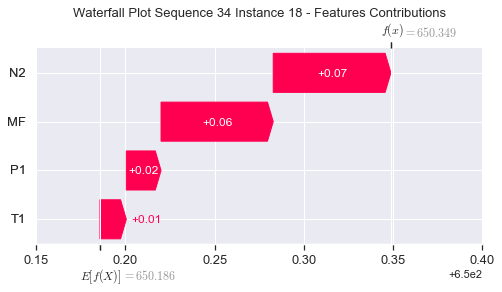

None

Contribution: [0.02088385 0.0164683  0.07147181 0.06715598]


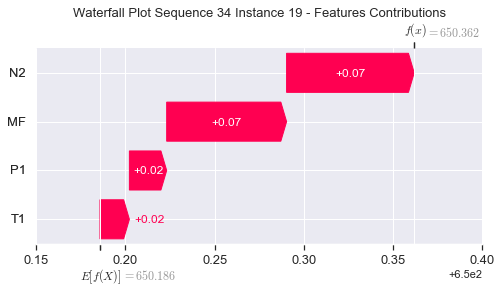

None

Contribution: [0.02662372 0.02348041 0.0887097  0.08339753]


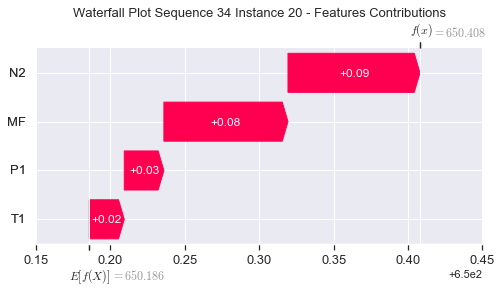

None

Contribution: [0.03718756 0.05076101 0.11840574 0.10779777]


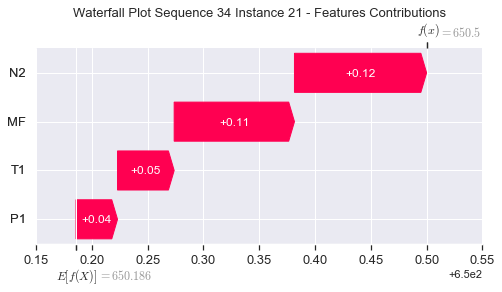

None

Contribution: [0.08162601 0.07667159 0.280029   0.2585387 ]


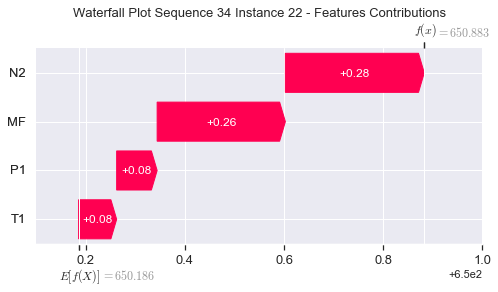

None

Contribution: [ 0.11656647 -0.01136132  0.48079364  0.45694957]


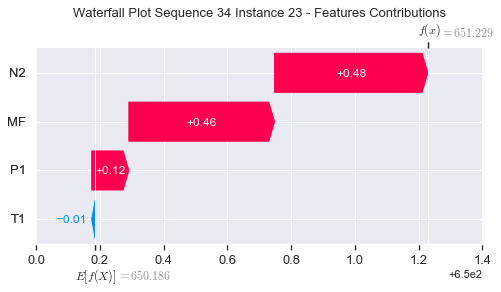

None

Contribution: [ 0.21889682 -2.72332473  1.56829047  1.87282299]


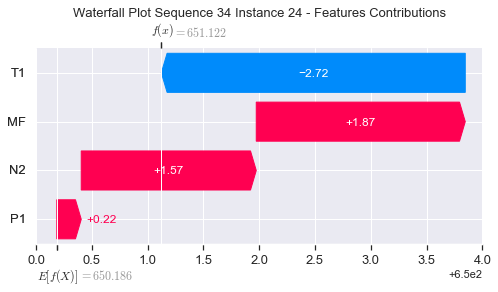

None

In [54]:
#Waterfall Plot for Local Accuracy & Consistency metrics
sns.set()
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [55]:
# calculate variables for control limit c

std.stack().max(),std.stack().mean(),std.stack().std()

(14.198419779134921, 13.26882672794458, 0.3049201219048792)

In [56]:
#calculate control limit

c = (std.stack().max() - std.stack().mean())/std.stack().std()
c

3.0486444954273333

In [57]:
#Load Null anomaly testing data 1

xtest_AD_file = "xNull2.csv"
xtest_AD = pd.read_csv(xtest_AD_file, index_col=False)
xtest_AD = xtest_AD.to_numpy()
xtest_AD = xtest_AD.reshape(1,24,4)

In [58]:
#Load Null anomaly ground truth 1

ytest_AD_file = "yNull2.csv"
ytest_AD = pd.read_csv(ytest_AD_file, index_col=False)

In [59]:
#Prediction

preds_AD = model(xtest_AD)
y_AD = preds_AD[0].sample(1000)
#y1_AD = preds_AD[1]
y_AD = tf.keras.backend.get_value(y_AD)
#y1_AD = tf.keras.backend.get_value(y1_AD)
tens_draw_AD = y_AD
#tens_draw1_AD = y1_AD

#Predicted RUL for each Fleet
mean_Fleet_All_AD = np.zeros(tens_draw_AD.shape[1])
mean_Fleet_AD = np.zeros(tens_draw_AD.shape[0])
for y in range(tens_draw_AD.shape[1]):
    for x in range(tens_draw_AD.shape[0]):
        mean_Fleet_AD[x] = tens_draw_AD[x,y,0]
    mean_Fleet_All_AD[y] = mean_Fleet_AD.mean()
      
mean_Fleet_All_AD, #tens_draw1_AD

(array([659.6159212]),)

In [60]:
#Calculate Mean and Std for predictions with AU

Fleet_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[0])))
mean_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
std_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
for z in range(tens_draw_AD.shape[1]):
    for y in range(tens_draw_AD.shape[0]):
        for x in range(pad):
            Fleet_AD[y][x] = tens_draw_AD[y,z,x]
    row_Mean_AD = Fleet_AD.mean(axis=1)
    row_Std_AD = Fleet_AD.std(axis=1)
    for j in range(pad):
        mean_AD[z][j] = row_Mean_AD[j]
    for k in range(pad):
        std_AD[z][k] = row_Std_AD[k]

In [61]:
hour_NUM2 = ['1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm']

0


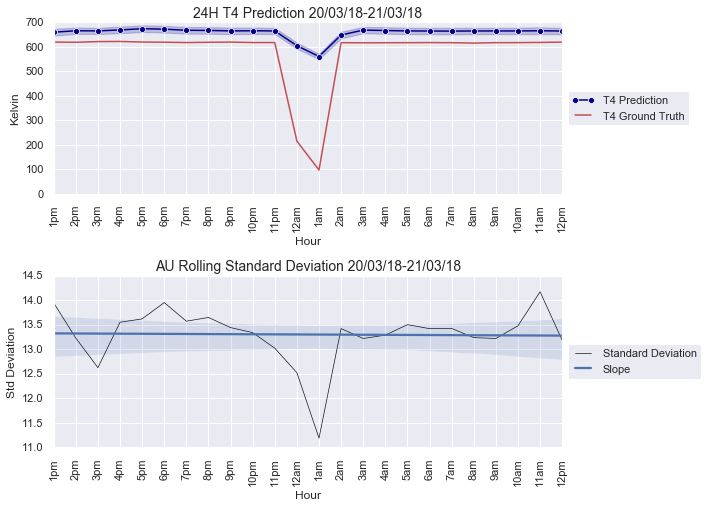

In [62]:
#Visualize prediction

for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD.shape[0])))
    for y in range(tens_draw_AD.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD.shape[0]:
        if(m < (tens_draw_AD.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Kelvin']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD['T4'][x]
    max_RUL_Arrange.columns = ['Hour','Kelvin']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD[B][x]
    min_Std_Arrange.columns = ['Hour','Kelvin']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Kelvin'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Kelvin",ci = "sd", marker='o', data=max_Seq_Arrange, color='darkblue', ax=ax, label="T4 Prediction")
    sns.lineplot(x="Hour", y="Kelvin", data = max_RUL_Arrange, color='r', ax=ax,label="T4 Ground Truth")
    plt.title('24H T4 Prediction 20/03/18-21/03/18',fontsize=14)
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.set_xlabel('Hour')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'Kelvin', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Kelvin'],label ='Slope',scatter = False)
    plt.title('AU Rolling Standard Deviation 20/03/18-21/03/18',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

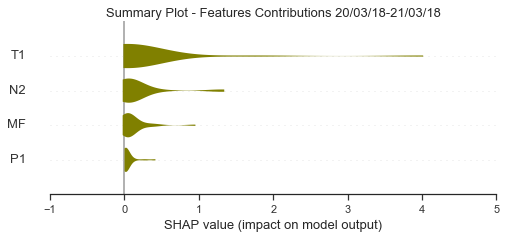

In [63]:
#Summary Plot for anomaly

sns.set_style("ticks")
instance = xtest_AD
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
shap_values = explainer.shap_values(instance)
plt.title("Summary Plot - Features Contributions 20/03/18-21/03/18",fontsize=13)
shap.summary_plot(shap_values[0][0],feature_names=xtrain.columns,plot_type="violin", color='olive')

In [64]:
#SHAP Force Plot for anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [65]:
# Export data for anomaly detection with MATLAB cusum

min_Std_Arrange.to_csv(r'C:/Users/Asus/Desktop/Real Gas Turbine/LSTM-T4/AD1.csv', index = False)

In [66]:
#Load Null anomaly testing data 2

xtest_AD_ALL_file = "xNull1.csv"
xtest_AD_ALL = pd.read_csv(xtest_AD_ALL_file, index_col=False)
xtest_AD_ALL = xtest_AD_ALL.to_numpy()
xtest_AD_ALL = xtest_AD_ALL.reshape(1,24,4)

In [67]:
#Load Null anomaly ground truth 2

ytest_AD_ALL_file = "yNull1.csv"
ytest_AD_ALL = pd.read_csv(ytest_AD_ALL_file, index_col=False)

In [68]:
#Prediction

preds_AD_ALL = model(xtest_AD_ALL)
y_AD_ALL = preds_AD_ALL[0].sample(1000)
#y1_AD_ALL = preds_AD_ALL[2]
y_AD_ALL = tf.keras.backend.get_value(y_AD_ALL)
#y1_AD_ALL = tf.keras.backend.get_value(y1_AD_ALL)
tens_draw_AD_ALL = y_AD_ALL
#tens_draw1_AD_ALL = y1_AD_ALL

#Predicted RUL for each Fleet
mean_Fleet_All_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[1])
mean_Fleet_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[0])
for y in range(tens_draw_AD_ALL.shape[1]):
    for x in range(tens_draw_AD_ALL.shape[0]):
        mean_Fleet_AD_ALL[x] = tens_draw_AD_ALL[x,y,0]
    mean_Fleet_All_AD_ALL[y] = mean_Fleet_AD_ALL.mean()
      
mean_Fleet_All_AD_ALL, #tens_draw1_AD_ALL

(array([652.74238464]),)

In [69]:
#Calculate Mean and Std for predictions with AU

Fleet_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[0])))
mean_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
std_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
for z in range(tens_draw_AD_ALL.shape[1]):
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(pad):
            Fleet_AD_ALL[y][x] = tens_draw_AD_ALL[y,z,x]
    row_Mean_AD_ALL = Fleet_AD_ALL.mean(axis=1)
    row_Std_AD_ALL = Fleet_AD_ALL.std(axis=1)
    for j in range(pad):
        mean_AD_ALL[z][j] = row_Mean_AD_ALL[j]
    for k in range(pad):
        std_AD_ALL[z][k] = row_Std_AD_ALL[k]

In [70]:
hour_NUM3 = ['12pm','1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am']

0


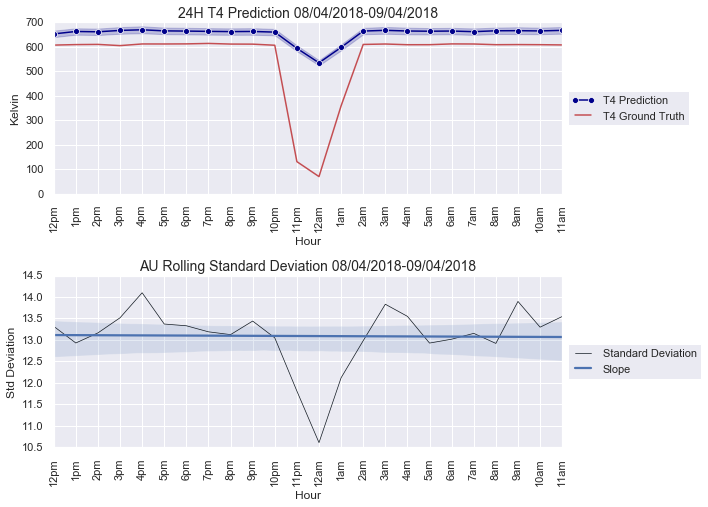

In [71]:
#Visualize anomaly prediction
sns.set()
for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD_ALL.shape[0])))
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD_ALL[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD_ALL.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD_ALL.shape[0]:
        if(m < (tens_draw_AD_ALL.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','Kelvin']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD_ALL['T4'][x]
    max_RUL_Arrange.columns = ['Hour','Kelvin']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD_ALL[B][x]
    min_Std_Arrange.columns = ['Hour','Kelvin']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['Kelvin'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="Kelvin",ci = "sd", marker='o', data=max_Seq_Arrange,color='darkblue', ax=ax, label="T4 Prediction")
    sns.lineplot(x="Hour", y="Kelvin", data = max_RUL_Arrange, color='r', ax=ax,label="T4 Ground Truth")
    plt.title('24H T4 Prediction 08/04/2018-09/04/2018',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'Kelvin', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['Kelvin'],label ='Slope',scatter = False)
    plt.title('AU Rolling Standard Deviation 08/04/2018-09/04/2018',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

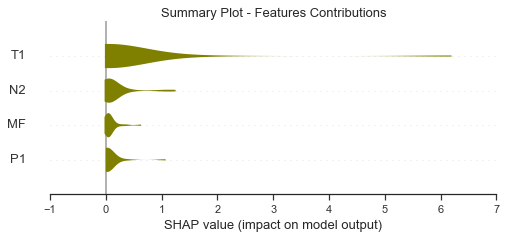

In [72]:
#Summary Plot for anomaly

sns.set_style("ticks")
instance = xtest_AD_ALL
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
shap_values = explainer.shap_values(instance)
plt.title("Summary Plot - Features Contributions",fontsize=13)
shap.summary_plot(shap_values[0][0],feature_names=xtrain.columns,plot_type="violin", color='olive')

In [73]:
#SHAP Force Plot for anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD_ALL[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [74]:
# Export data for anomaly detection with MATLAB cusum

min_Std_Arrange.to_csv(r'C:/Users/Asus/Desktop/Real Gas Turbine/LSTM-T4/AD2.csv', index = False)

In [75]:
#Define f''x

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 386)           602160    
_________________________________________________________________
dense_4 (Dense)              (None, 24, 486)           188082    
_________________________________________________________________
dense_5 (Dense)              (None, 24, 1)             487       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 790,729
Trainable params: 790,729
Non-trainable params: 0
_________________________________________________________________


In [76]:
#Extract only weights for 3 variables excluding mf

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [77]:
#Transfer weights from f'x to f''x

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [78]:
#Load xtest and delete mf

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete mf

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [79]:
#Prediction with features excluding mf

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [80]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [0.11987737 0.62958822 1.6857261 ]


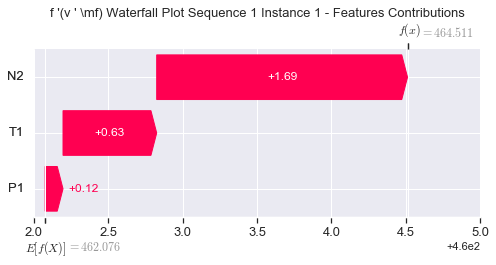

None

Contribution: [0.01899205 0.14922507 0.04588333]


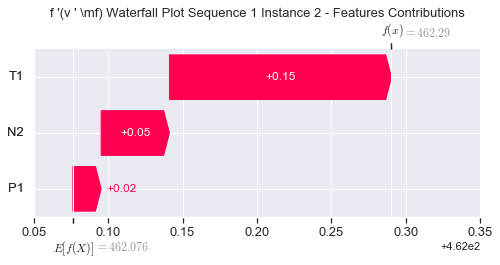

None

Contribution: [0.01641782 0.04203631 0.06310211]


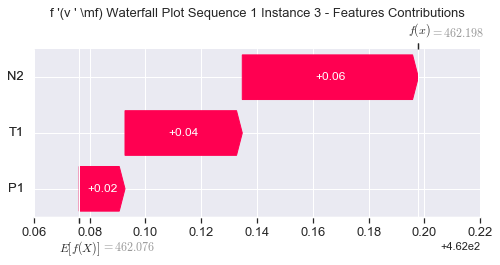

None

Contribution: [-0.01589671  0.00745129 -0.00961716]


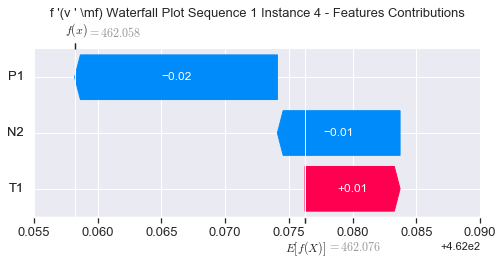

None

Contribution: [-0.01595839  0.0148933  -0.00938302]


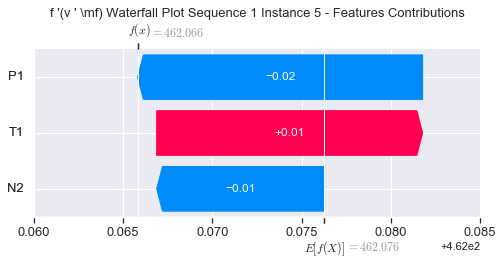

None

Contribution: [-0.00874473  0.01333319  0.00640745]


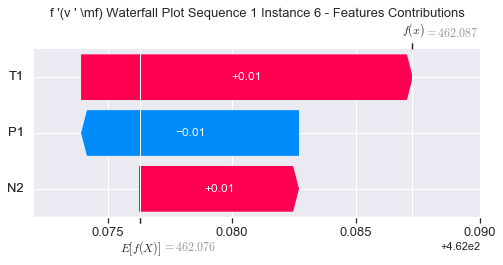

None

Contribution: [-0.00745304  0.01443085  0.0161533 ]


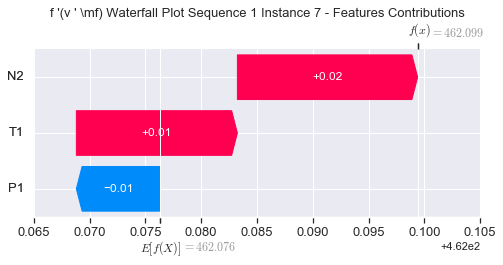

None

Contribution: [-0.00445781  0.01265142  0.02370229]


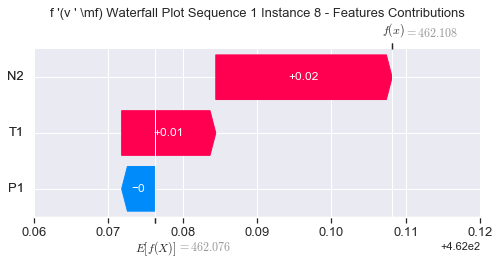

None

Contribution: [-0.00347558  0.03088521  0.03034261]


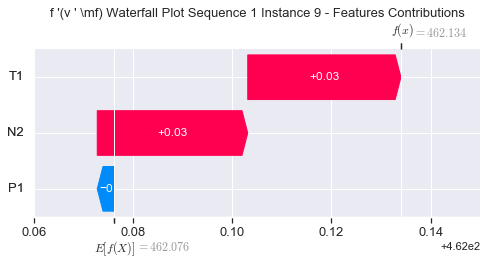

None

Contribution: [-0.00797242  0.0200565   0.03278794]


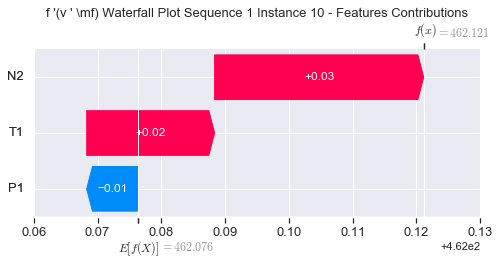

None

Contribution: [0.00021164 0.01724664 0.03633435]


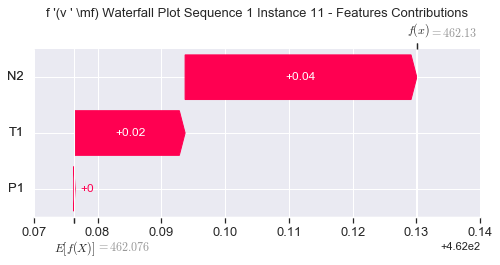

None

Contribution: [-0.00597883 -0.00587047  0.03589599]


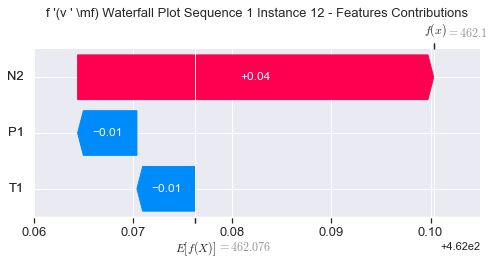

None

Contribution: [-0.00569505 -0.00111396  0.03844028]


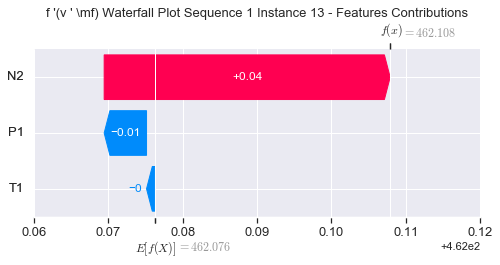

None

Contribution: [ 0.00505323 -0.00554772  0.04097474]


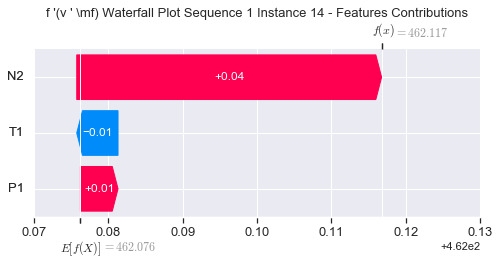

None

Contribution: [-0.00430998 -0.00902519  0.04540992]


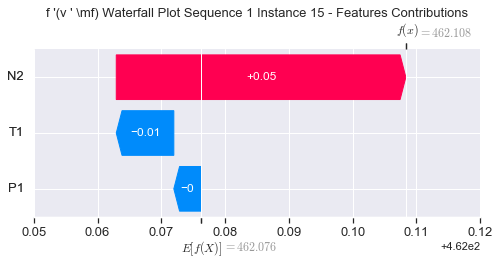

None

Contribution: [-0.01053437 -0.0062228   0.05425392]


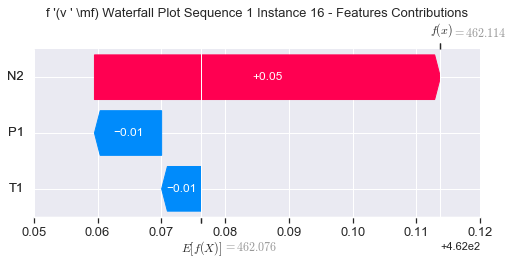

None

Contribution: [-0.00028473 -0.00319979  0.05888115]


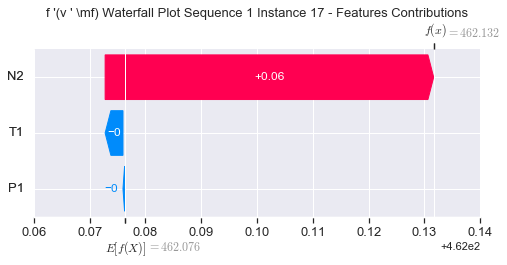

None

Contribution: [ 0.00264779 -0.0074178   0.07044921]


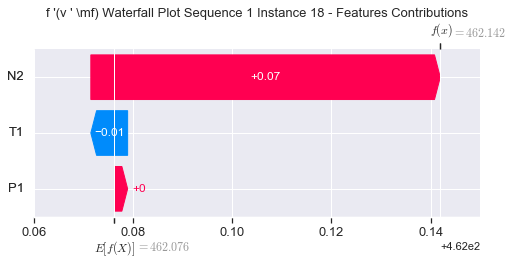

None

Contribution: [-0.00745297 -0.01237953  0.09196326]


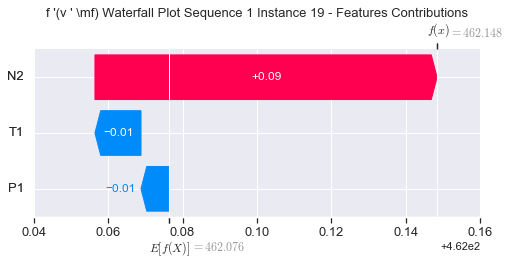

None

Contribution: [ 0.00255909 -0.04733174  0.13257017]


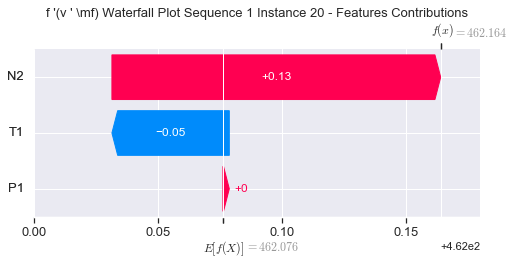

None

Contribution: [ 0.00430718 -0.09559953  0.20929377]


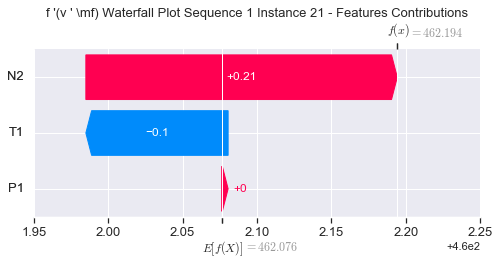

None

Contribution: [-0.05674768 -0.37528003  0.41446271]


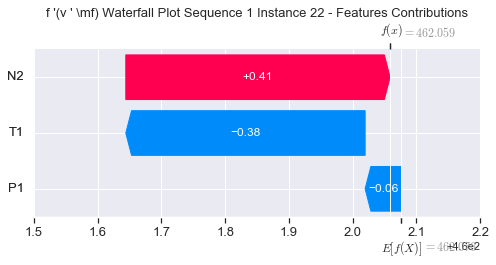

None

Contribution: [-0.10038093 -0.43654252  0.50239396]


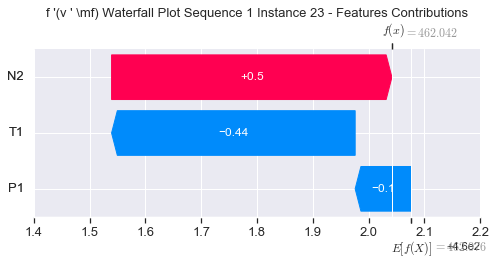

None

Contribution: [-0.12183803 -1.36704177  1.50662054]


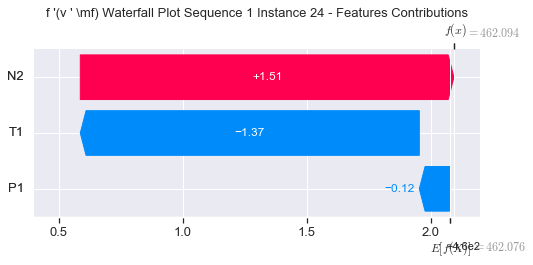

None

Contribution: [0.17680878 0.84320563 1.4688233 ]


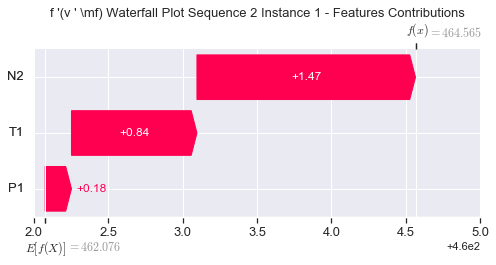

None

Contribution: [0.0227645  0.13554383 0.04929678]


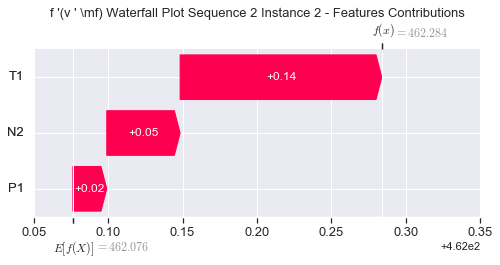

None

Contribution: [0.01502486 0.03650758 0.05647329]


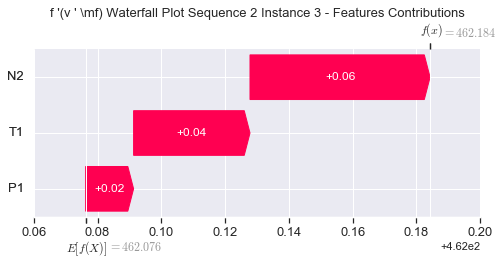

None

Contribution: [-0.02142192  0.00298992 -0.01525657]


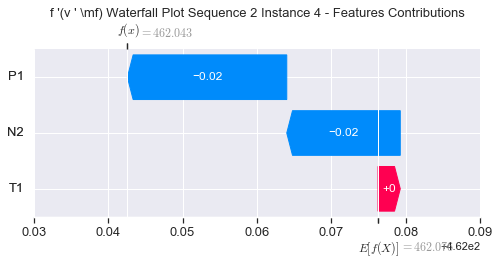

None

Contribution: [-0.02050136 -0.04814969 -0.00760063]


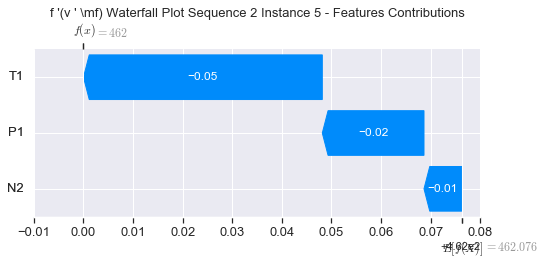

None

Contribution: [-0.01625596 -0.05898753  0.00664034]


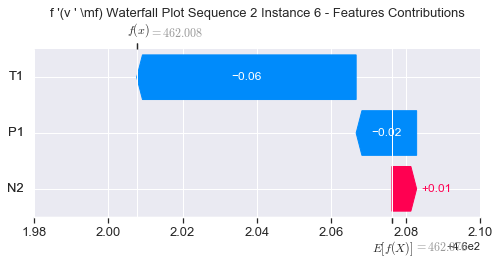

None

Contribution: [-0.01342487 -0.06361467  0.01656909]


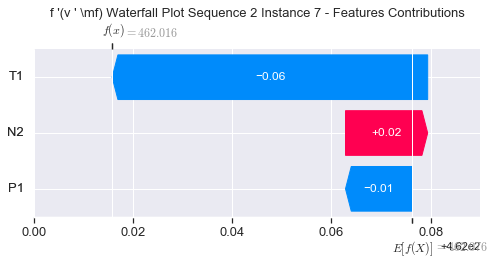

None

Contribution: [-0.01131768 -0.06548295  0.02389008]


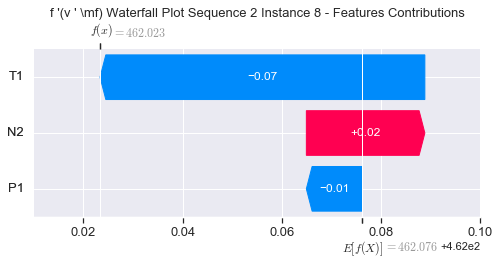

None

Contribution: [-0.01100455 -0.07479383  0.03511621]


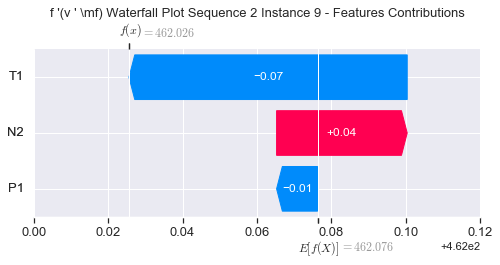

None

Contribution: [-0.01499225 -0.07895816  0.04021242]


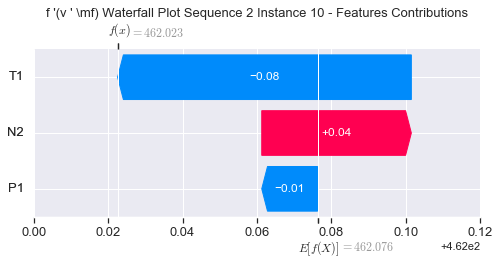

None

Contribution: [-0.01212934 -0.08555183  0.03744578]


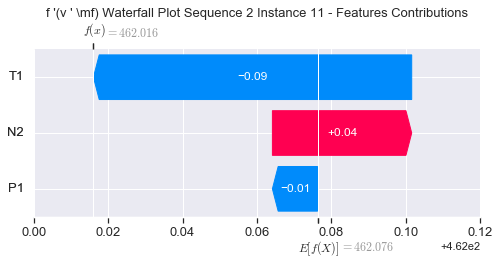

None

Contribution: [-0.01175821 -0.1084962   0.0343359 ]


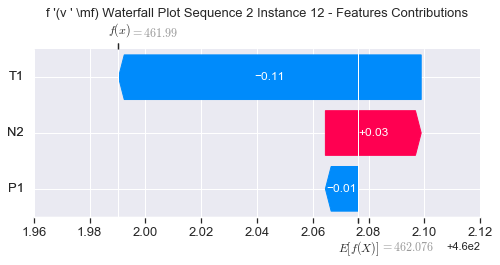

None

Contribution: [-0.01092068 -0.10938117  0.03777813]


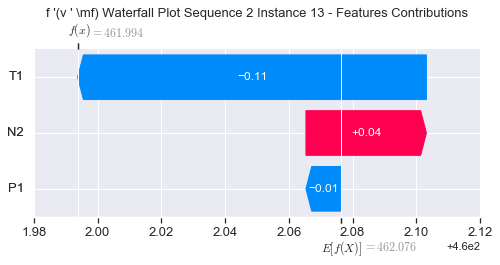

None

Contribution: [-0.00999051 -0.1240816   0.04018837]


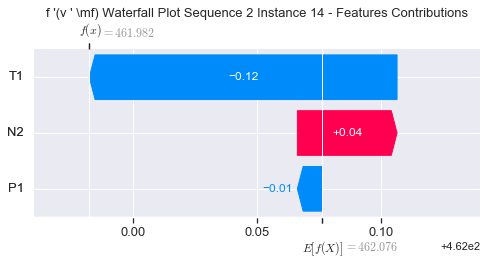

None

Contribution: [-0.01161148 -0.12654044  0.04473978]


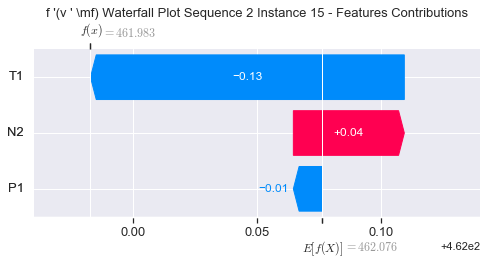

None

Contribution: [-0.01752801 -0.1248289   0.05479539]


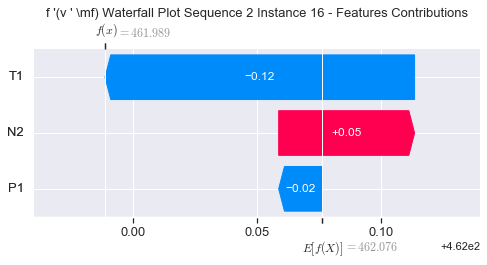

None

Contribution: [-0.00637846 -0.13031793  0.06014103]


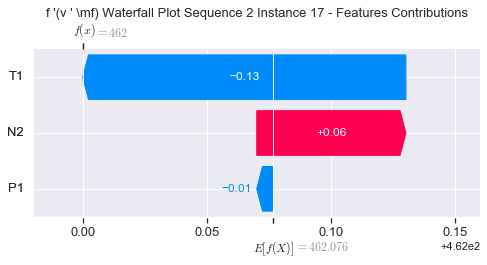

None

Contribution: [-0.00440282 -0.13817151  0.07186305]


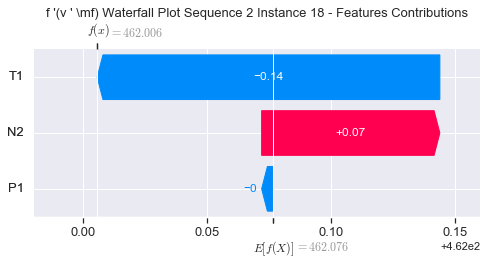

None

Contribution: [-0.00544149 -0.14297192  0.09346283]


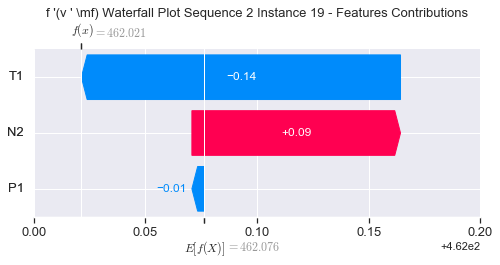

None

Contribution: [-0.00670897 -0.28881097  0.13789477]


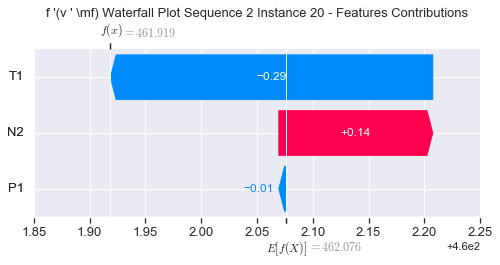

None

Contribution: [-0.01080475 -0.48653677  0.21685958]


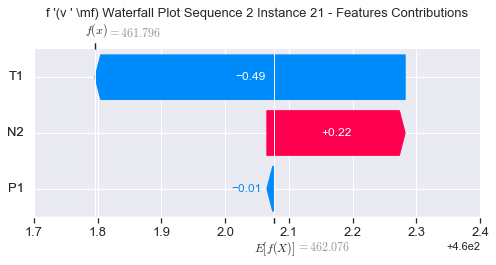

None

Contribution: [-0.10303355 -1.48208768  0.42051325]


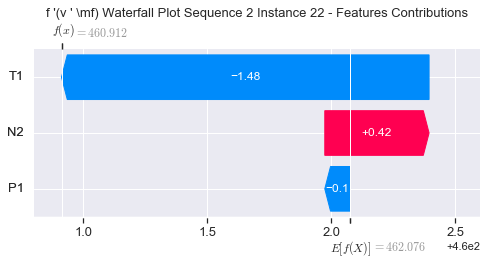

None

Contribution: [-0.17467271 -1.83040996  0.50292985]


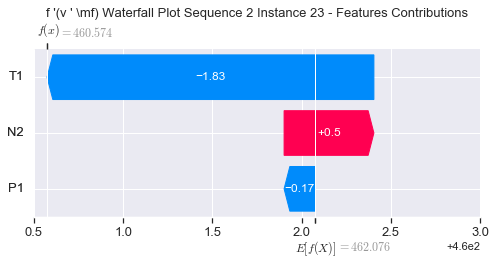

None

Contribution: [-0.42209572 -5.24789633  1.50335681]


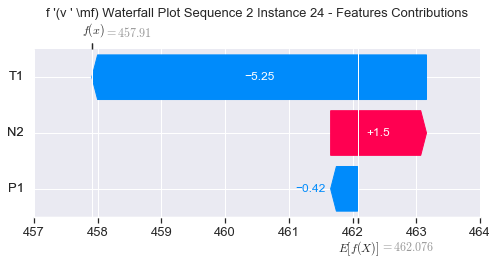

None

Contribution: [-0.38937677 -3.39377756  1.48058122]


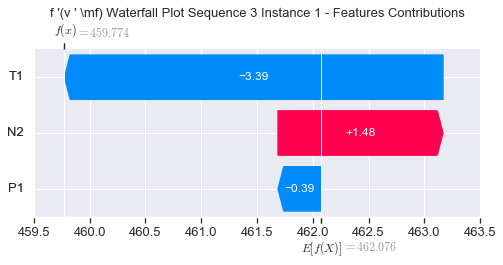

None

Contribution: [0.01955194 0.14821009 0.05244349]


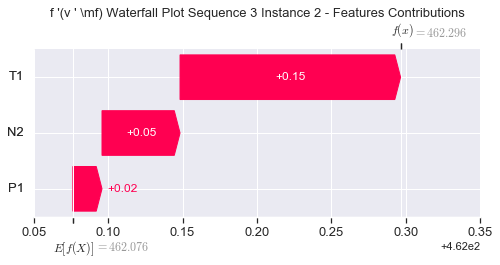

None

Contribution: [-0.00187235 -0.13051875  0.05094771]


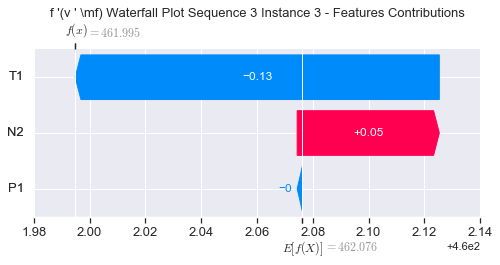

None

Contribution: [-0.02018525 -0.12604897 -0.00631942]


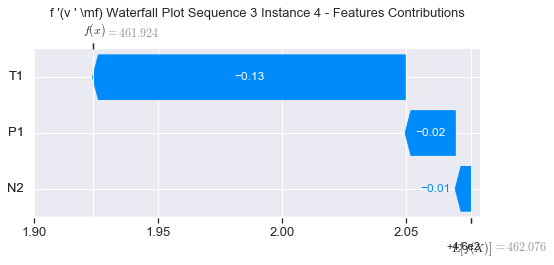

None

Contribution: [-0.02240819 -0.12685088 -0.00394228]


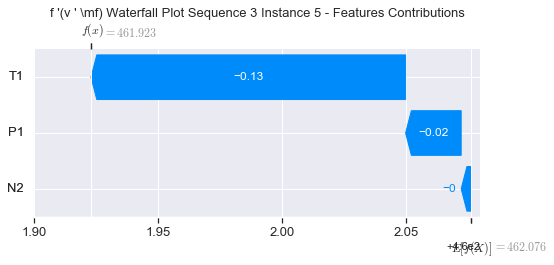

None

Contribution: [-0.01862501 -0.11386405  0.01112165]


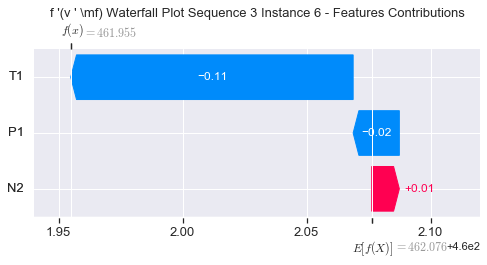

None

Contribution: [-0.01686146 -0.11244456  0.01757308]


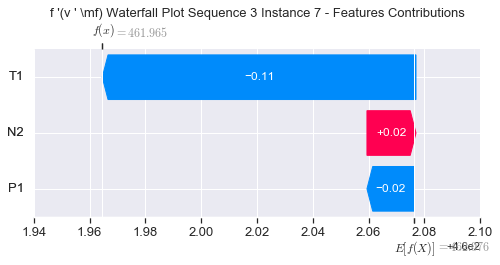

None

Contribution: [-0.01421126 -0.11115187  0.02370712]


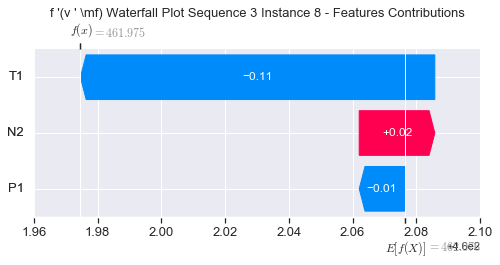

None

Contribution: [-0.0178686  -0.09847967  0.02973249]


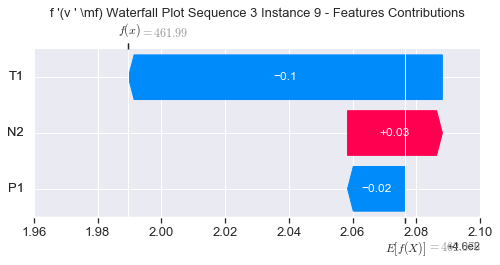

None

Contribution: [-0.01648653 -0.08057533  0.03719414]


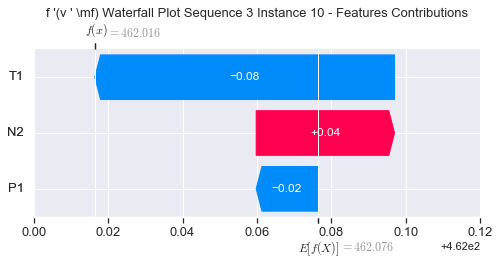

None

Contribution: [-0.01341674 -0.09947655  0.03684992]


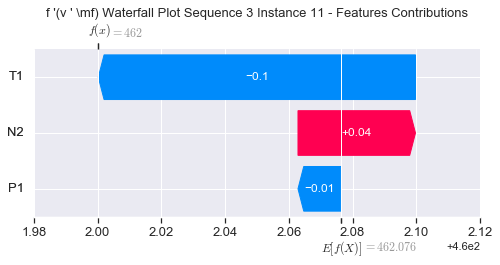

None

Contribution: [-0.00997709 -0.1345633   0.03694548]


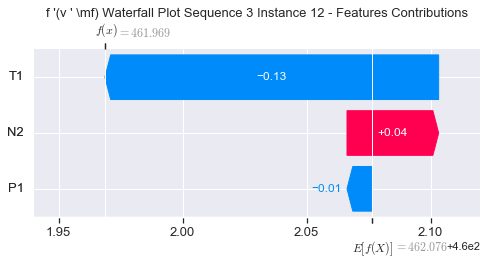

None

Contribution: [-0.01012574 -0.13793209  0.03938137]


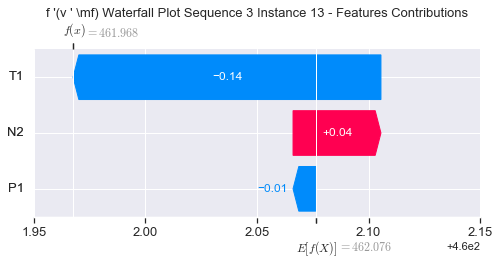

None

Contribution: [-0.01909908 -0.13564821  0.04426798]


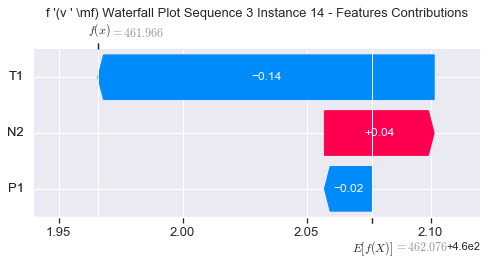

None

Contribution: [-0.0120786  -0.15305888  0.04721973]


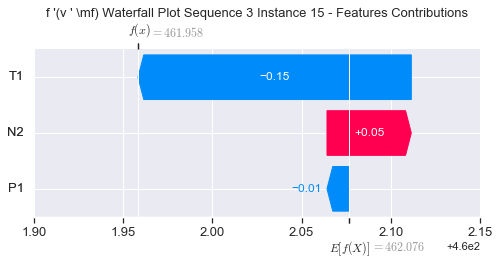

None

Contribution: [-0.00811027 -0.14952274  0.06091999]


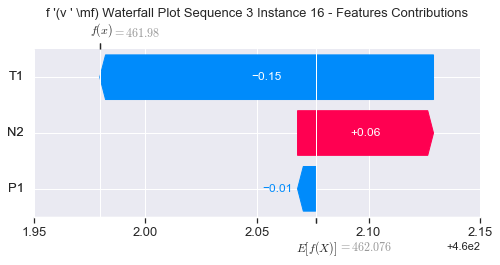

None

Contribution: [-0.00739824 -0.15292054  0.06311898]


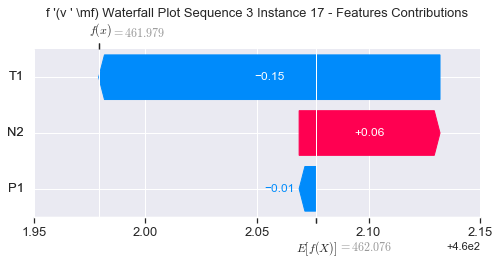

None

Contribution: [-0.004869   -0.16033117  0.07635129]


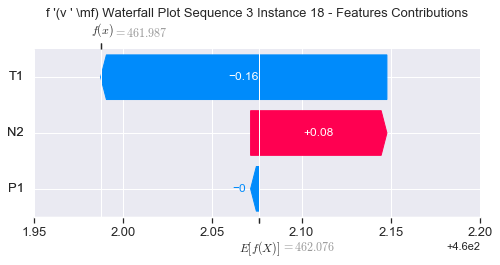

None

Contribution: [-0.00102303 -0.18045393  0.10069895]


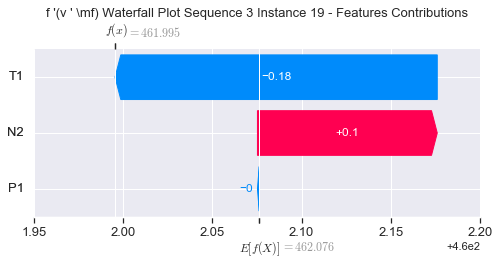

None

Contribution: [-0.00792988 -0.32284978  0.14041233]


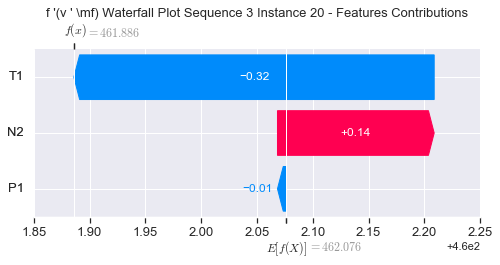

None

Contribution: [-0.0085286  -0.52012027  0.21920155]


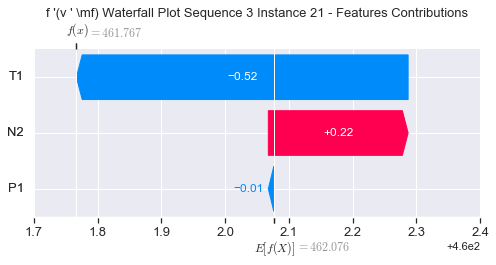

None

Contribution: [-0.08835269 -1.58856422  0.42963235]


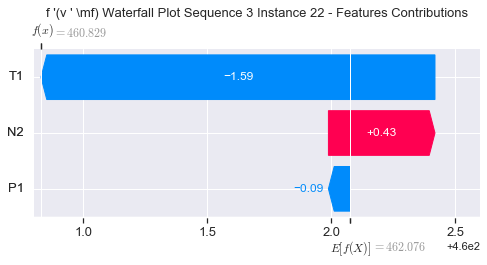

None

Contribution: [-0.14655725 -1.88256394  0.52496492]


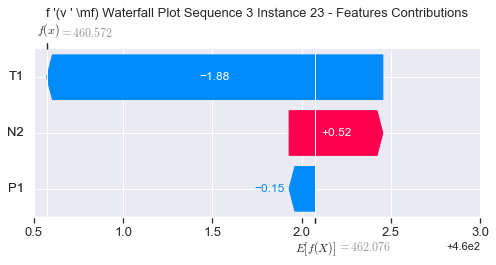

None

Contribution: [-0.30023541 -5.7893771   1.55981224]


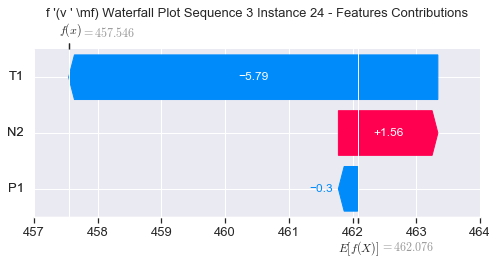

None

Contribution: [-0.09543366 -3.88555222  1.46956399]


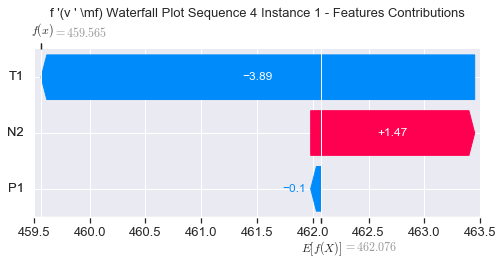

None

Contribution: [0.01769959 0.14899417 0.05270053]


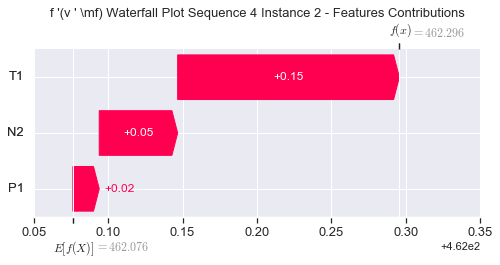

None

Contribution: [-0.00793625 -0.12838611  0.05214842]


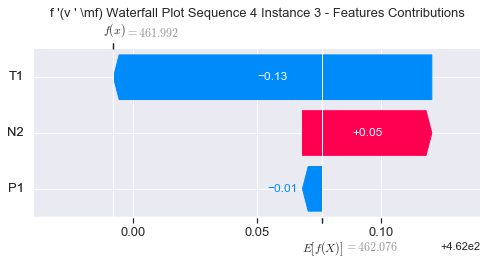

None

Contribution: [-0.01731168 -0.11898633 -0.00543333]


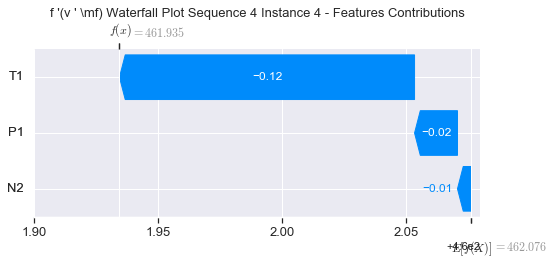

None

Contribution: [-0.02021542 -0.13768083 -0.0020274 ]


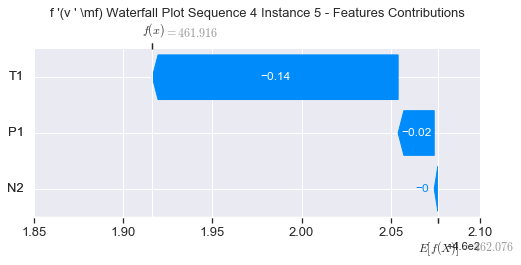

None

Contribution: [-0.01464364 -0.1340432   0.01330766]


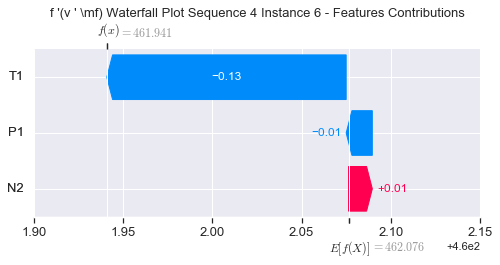

None

Contribution: [-0.01239197 -0.13066599  0.01955981]


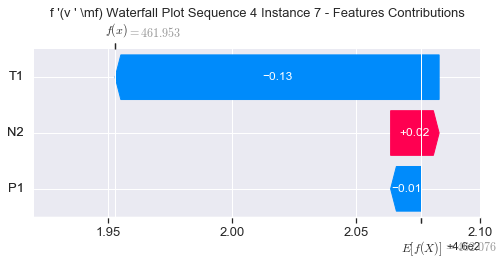

None

Contribution: [-0.01169516 -0.13011519  0.0254821 ]


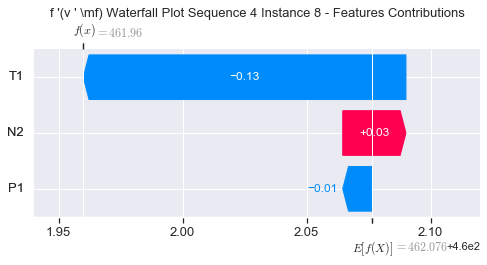

None

Contribution: [-0.02000927 -0.12304448  0.03277598]


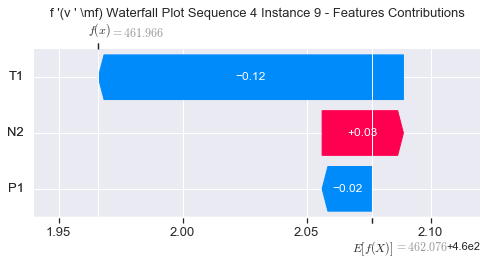

None

Contribution: [-0.01386596 -0.13528781  0.03744032]


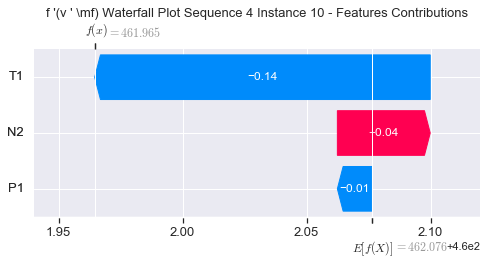

None

Contribution: [-0.01986658 -0.13343445  0.03893512]


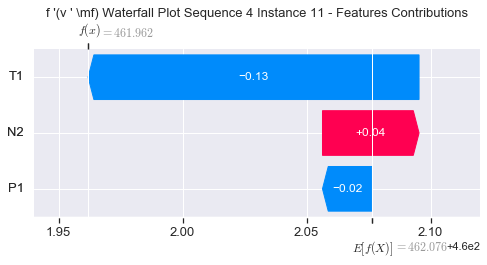

None

Contribution: [-0.01073307 -0.15290675  0.03749198]


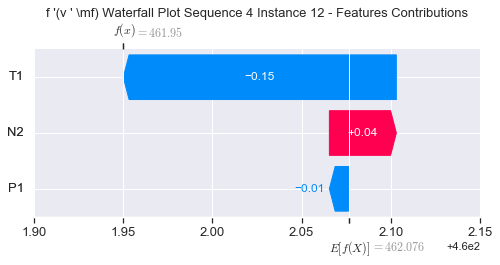

None

Contribution: [-0.00997821 -0.15466428  0.04006291]


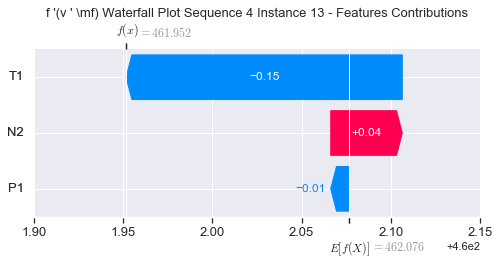

None

Contribution: [-0.01326223 -0.15540128  0.04731922]


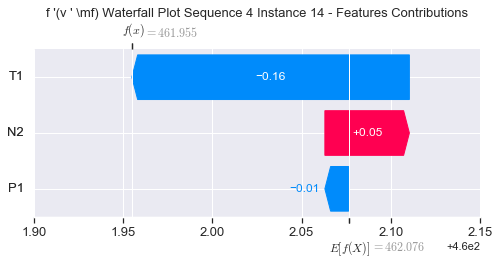

None

Contribution: [-0.01083413 -0.17296996  0.04810605]


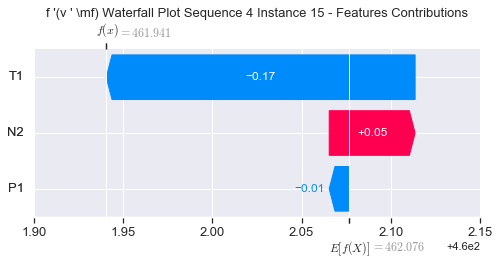

None

Contribution: [-0.01807443 -0.16863812  0.0578909 ]


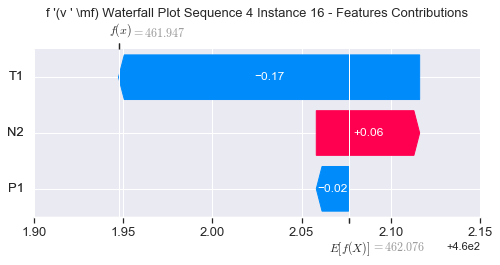

None

Contribution: [-0.00525666 -0.17247904  0.06447714]


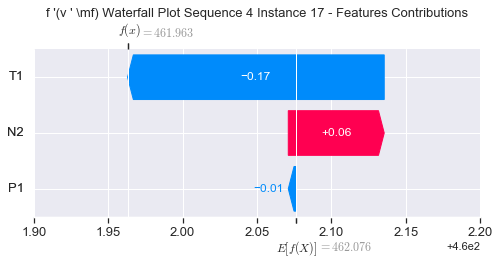

None

Contribution: [-0.0026941  -0.18059489  0.07763309]


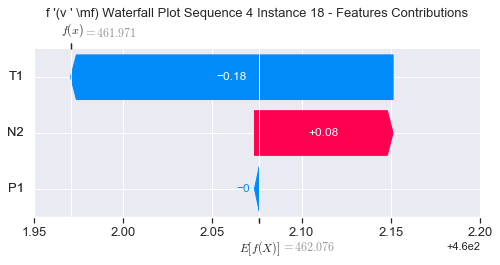

None

Contribution: [ 0.00086236 -0.18321036  0.09883061]


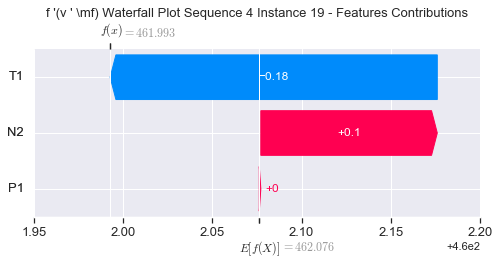

None

Contribution: [-0.00360422 -0.3493279   0.14267447]


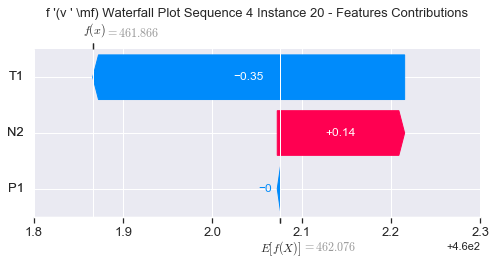

None

Contribution: [-0.00581939 -0.55814777  0.22201153]


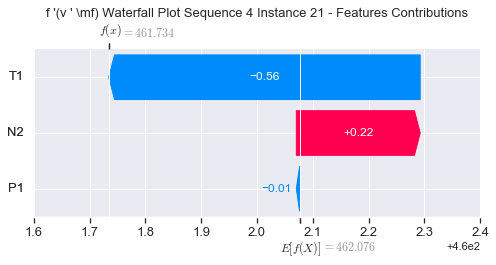

None

Contribution: [-0.09180156 -1.69115798  0.43317411]


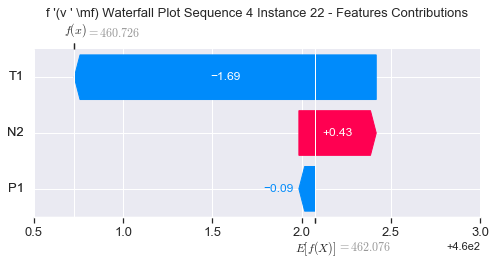

None

Contribution: [-0.15176762 -2.04113512  0.52935148]


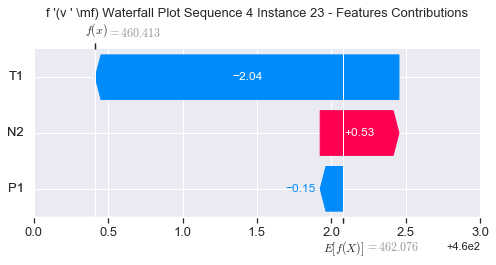

None

Contribution: [-0.36659485 -6.19702258  1.60393057]


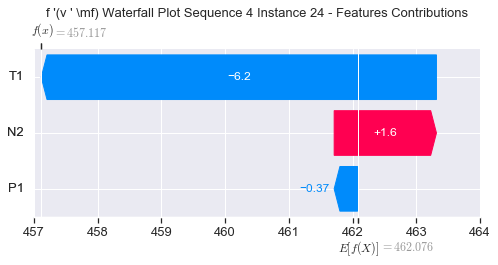

None

Contribution: [-0.35827338 -4.12750063  1.59751691]


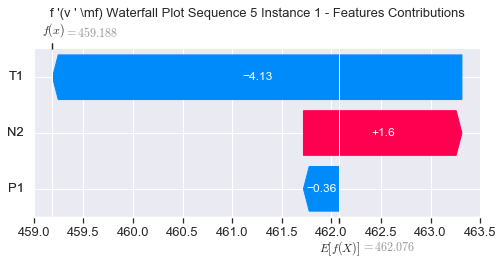

None

Contribution: [0.01887353 0.14694361 0.05302418]


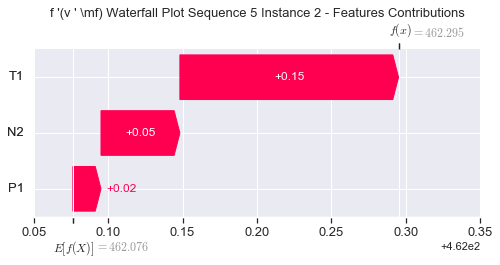

None

Contribution: [-0.00912124 -0.13738639  0.04953943]


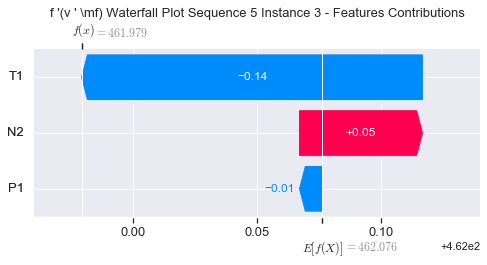

None

Contribution: [-0.02595736 -0.11988344 -0.00570309]


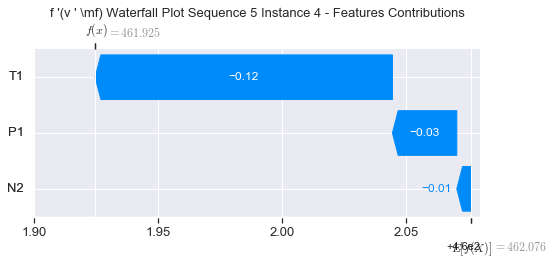

None

Contribution: [-0.02782145 -0.13452685 -0.00231588]


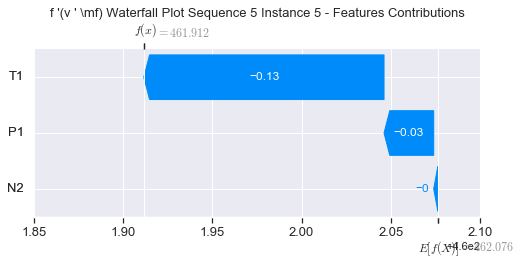

None

Contribution: [-0.02097867 -0.12182703  0.01258343]


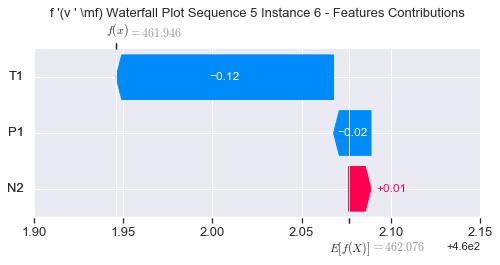

None

Contribution: [-0.01892033 -0.12020158  0.01831226]


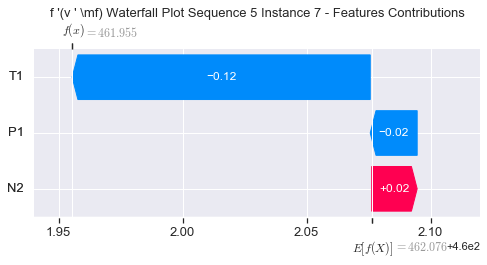

None

Contribution: [-0.01653285 -0.11804884  0.02436154]


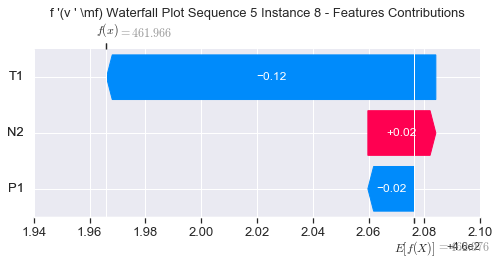

None

Contribution: [-0.01972563 -0.11126769  0.02956964]


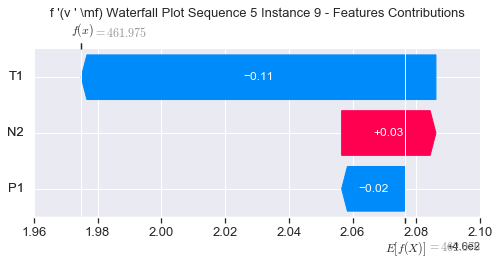

None

Contribution: [-0.02791772 -0.1119508   0.03429711]


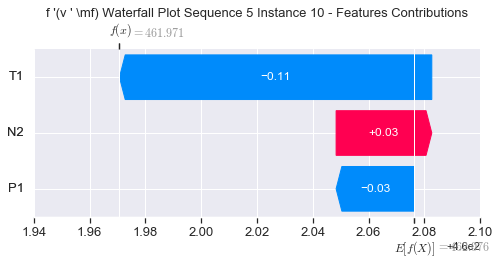

None

Contribution: [-0.01851579 -0.10799461  0.03701403]


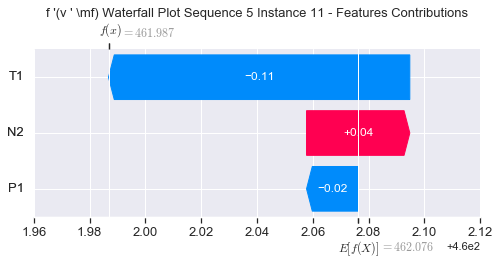

None

Contribution: [-0.01555741 -0.13657876  0.0370222 ]


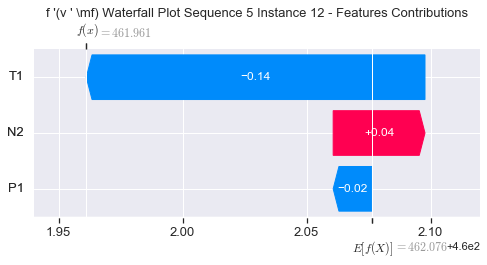

None

Contribution: [-0.01470863 -0.13995586  0.03942061]


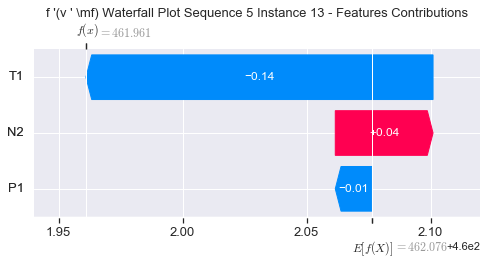

None

Contribution: [-0.00929002 -0.14459448  0.04848415]


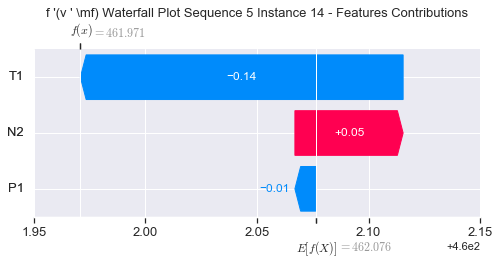

None

Contribution: [-0.01375669 -0.15188971  0.04784904]


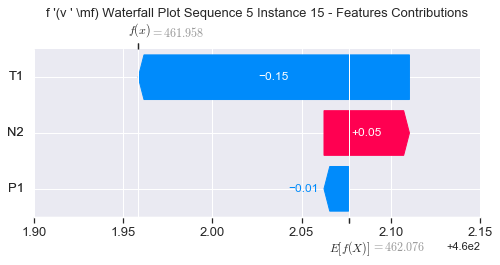

None

Contribution: [-0.00800731 -0.15621684  0.06483138]


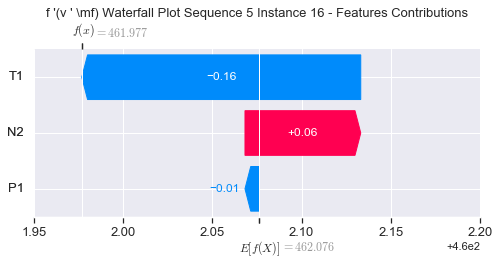

None

Contribution: [-0.0069212  -0.15080466  0.06358092]


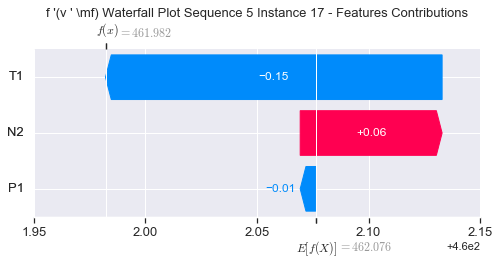

None

Contribution: [-0.00328025 -0.15644592  0.07703422]


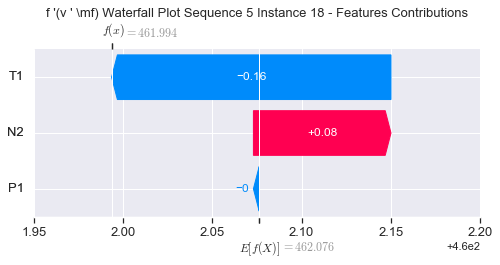

None

Contribution: [-0.00358591 -0.1759368   0.09458409]


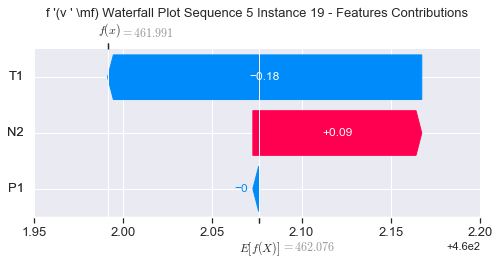

None

Contribution: [-0.00199349 -0.30801904  0.14087049]


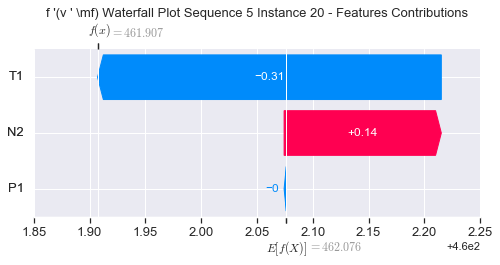

None

Contribution: [-0.00119673 -0.48762915  0.21969679]


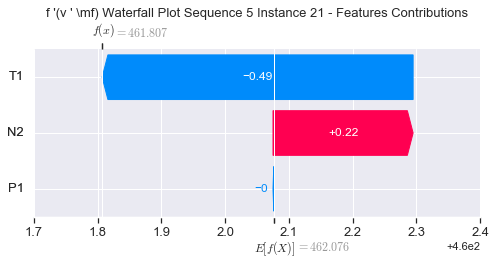

None

Contribution: [-0.07427848 -1.47203336  0.4324926 ]


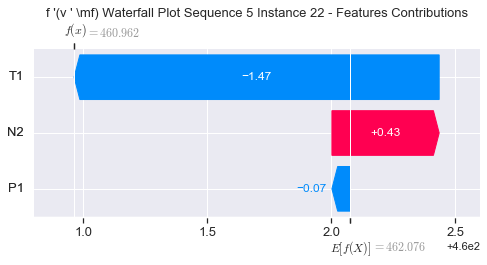

None

Contribution: [-0.12091844 -1.72871615  0.52671727]


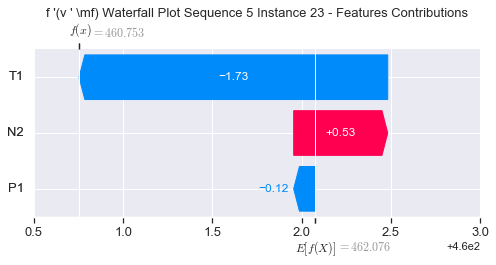

None

Contribution: [-0.21253314 -5.32666955  1.60188724]


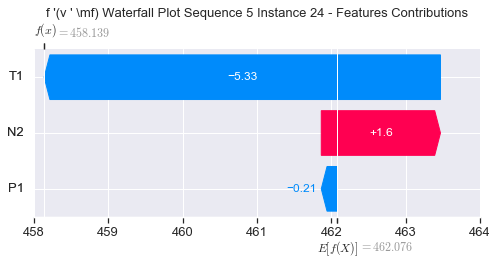

None

Contribution: [-0.02715434 -3.32621447  1.56612149]


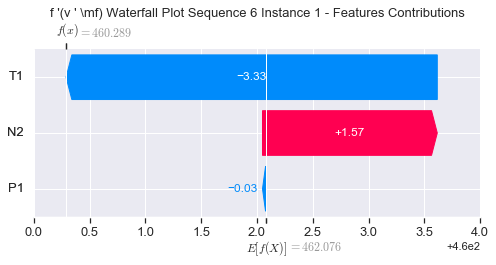

None

Contribution: [0.01858925 0.1512911  0.05184603]


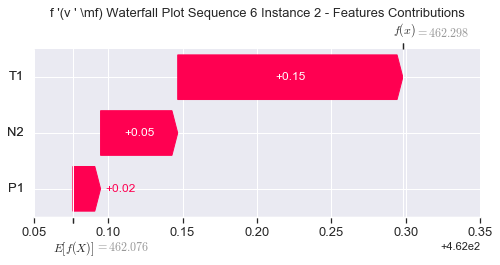

None

Contribution: [-0.00274316 -0.09482998  0.05681717]


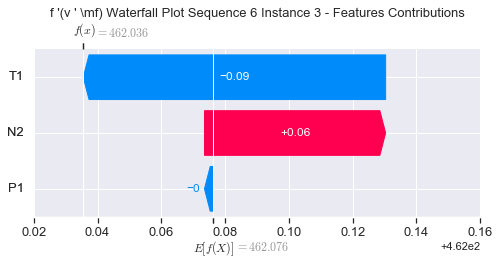

None

Contribution: [-0.02071418 -0.10239801 -0.00455025]


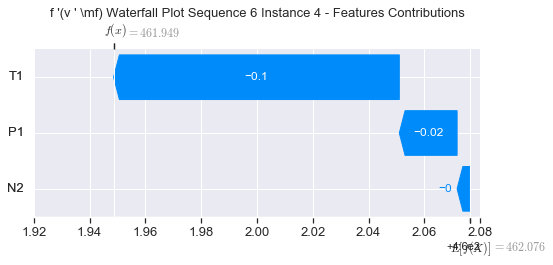

None

Contribution: [-0.02170956 -0.10484689 -0.00074426]


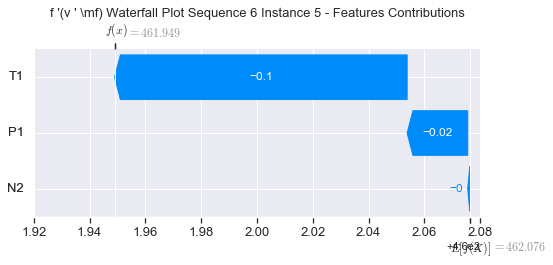

None

Contribution: [-0.01609998 -0.11013703  0.01305886]


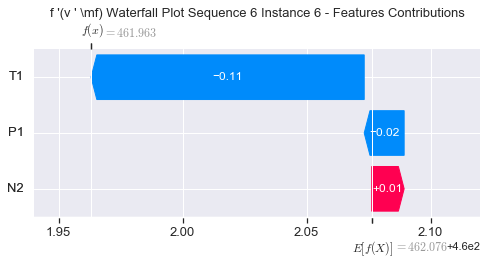

None

Contribution: [-0.01378843 -0.11204829  0.01886165]


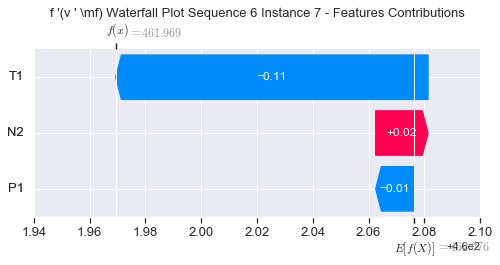

None

Contribution: [-0.01247058 -0.1147798   0.02541885]


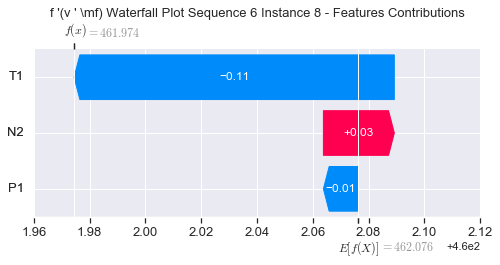

None

Contribution: [-0.01532119 -0.12065666  0.03049516]


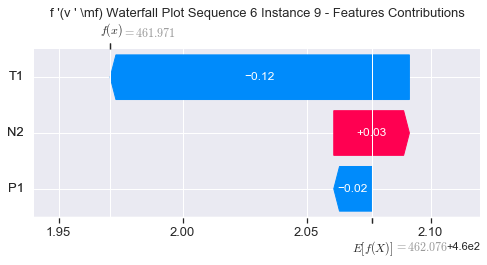

None

Contribution: [-0.02186791 -0.11499148  0.0364606 ]


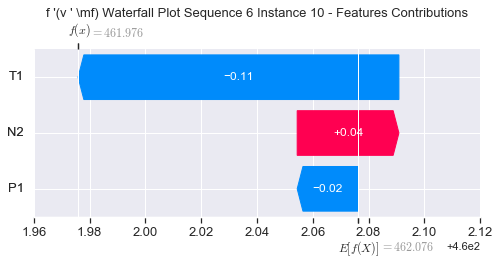

None

Contribution: [-0.01581339 -0.13044942  0.03726725]


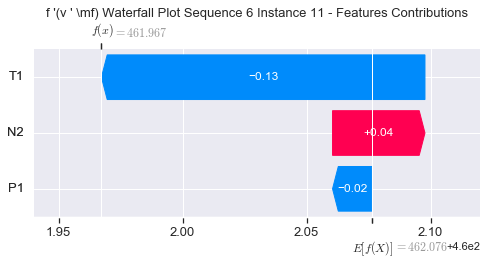

None

Contribution: [-0.01197487 -0.15336453  0.03336303]


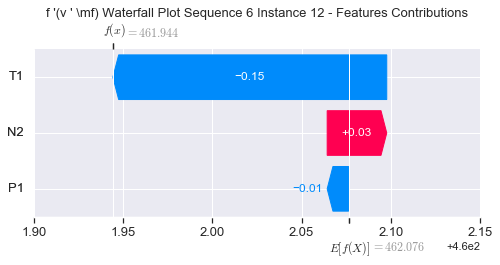

None

Contribution: [-0.01134654 -0.1569814   0.03633464]


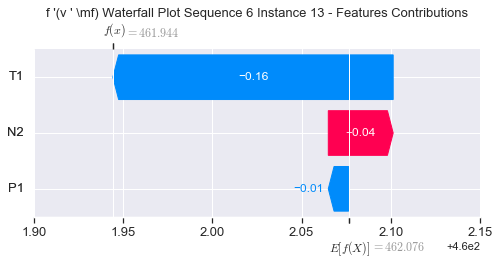

None

Contribution: [-0.01145119 -0.15479598  0.03935503]


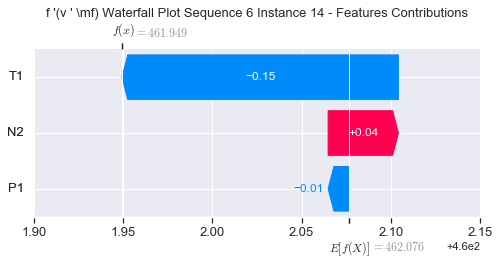

None

Contribution: [-0.01205997 -0.17921787  0.04517469]


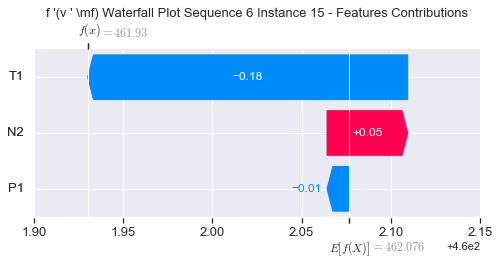

None

Contribution: [-0.01453292 -0.1964874   0.05348477]


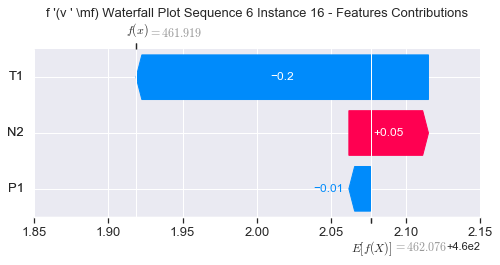

None

Contribution: [-0.00681051 -0.18993062  0.06186958]


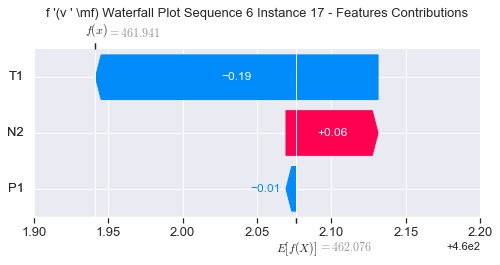

None

Contribution: [-0.00460767 -0.2023658   0.07595076]


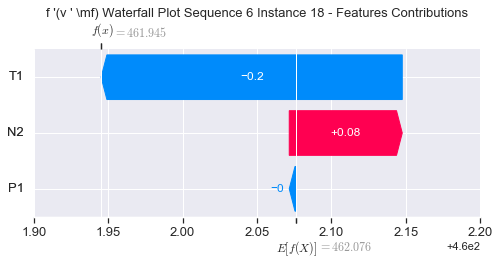

None

Contribution: [-0.00374337 -0.22386376  0.10227338]


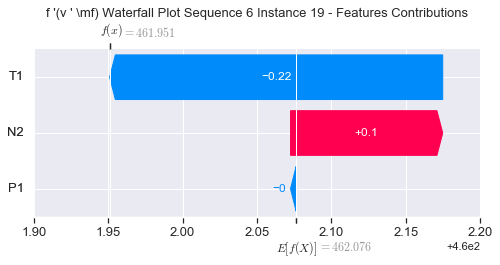

None

Contribution: [-0.00742335 -0.40188369  0.14493087]


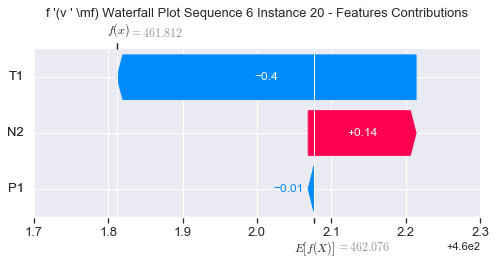

None

Contribution: [-0.01162963 -0.65176108  0.22533268]


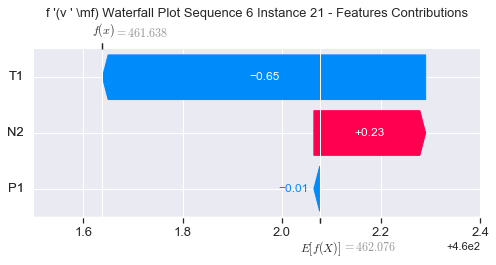

None

Contribution: [-0.10842823 -1.96087828  0.44587706]


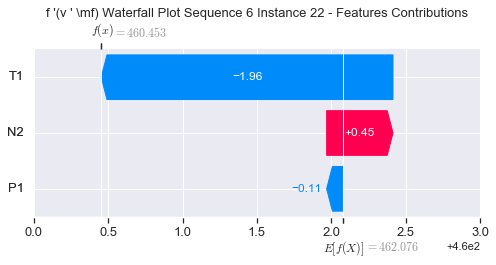

None

Contribution: [-0.1764356  -2.43509416  0.54554628]


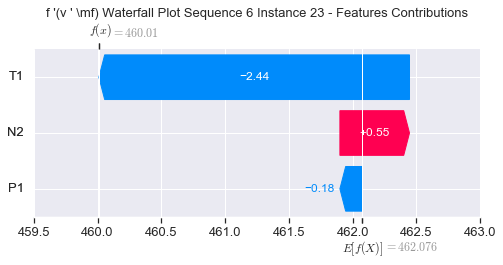

None

Contribution: [-0.40389674 -7.29643724  1.68360293]


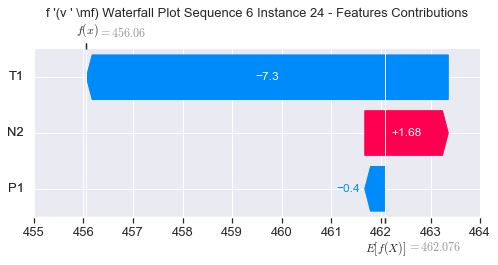

None

Contribution: [-0.29976855 -5.60576276  1.59512737]


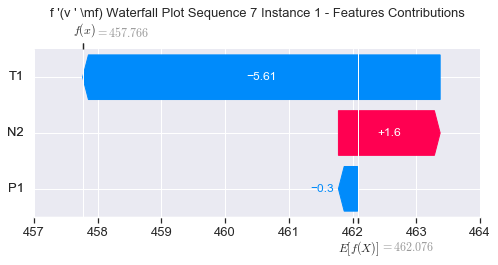

None

Contribution: [0.01869185 0.14642354 0.05431222]


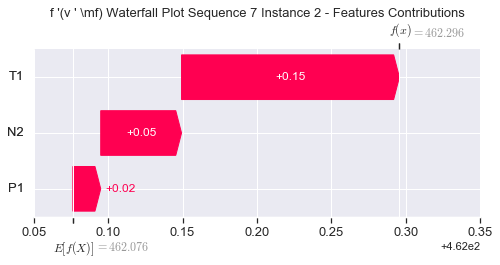

None

Contribution: [-0.00699923 -0.16545616  0.04677909]


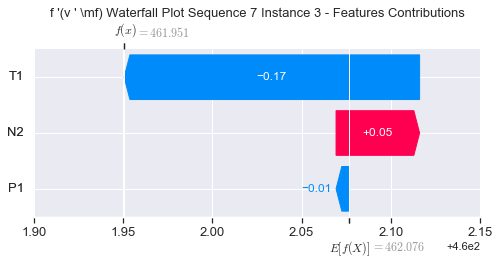

None

Contribution: [-0.0222569  -0.16839932 -0.00298297]


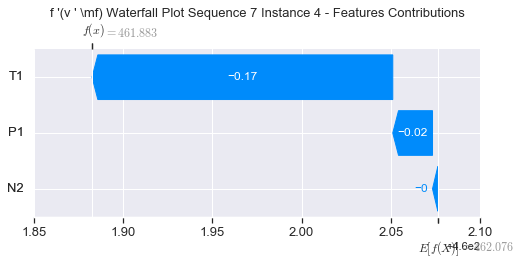

None

Contribution: [-0.02213456 -0.18360805  0.00043007]


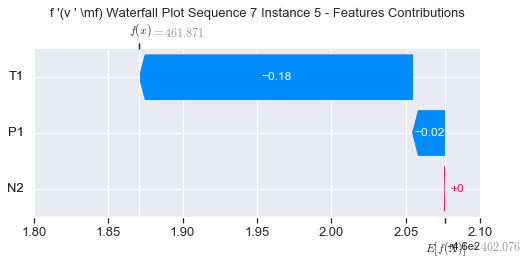

None

Contribution: [-0.02014636 -0.18079872  0.01257264]


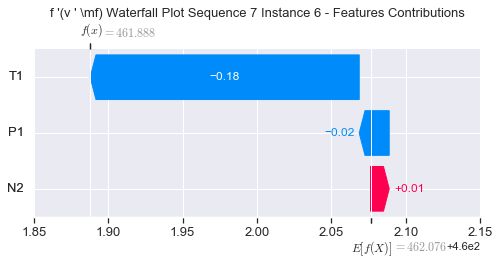

None

Contribution: [-0.01946013 -0.17408317  0.0183915 ]


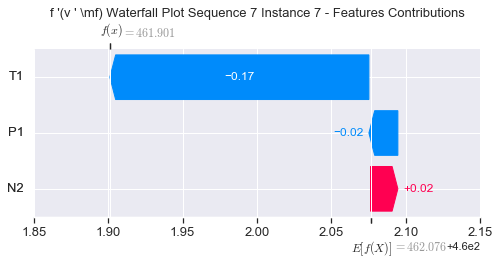

None

Contribution: [-0.0167433  -0.17179775  0.02376708]


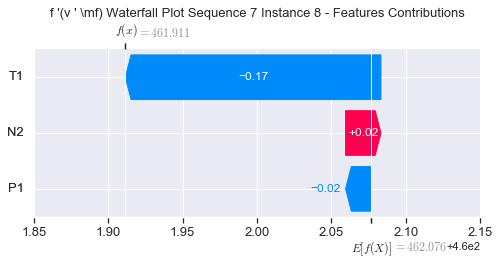

None

Contribution: [-0.02220184 -0.15639086  0.02778058]


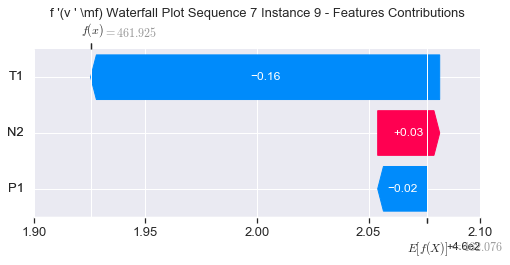

None

Contribution: [-0.01976417 -0.15125649  0.03524669]


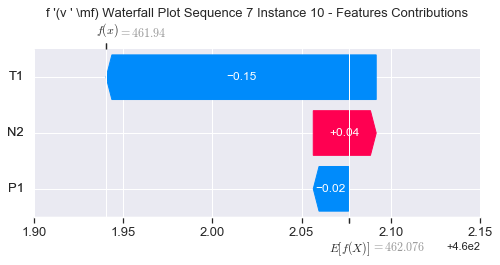

None

Contribution: [-0.01840618 -0.17209111  0.03276062]


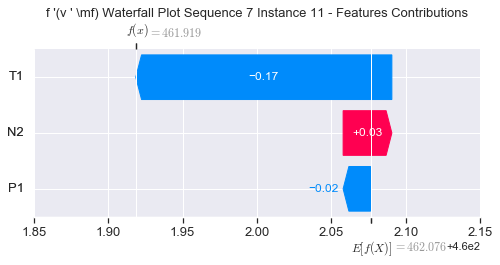

None

Contribution: [-0.01786038 -0.19568488  0.03549099]


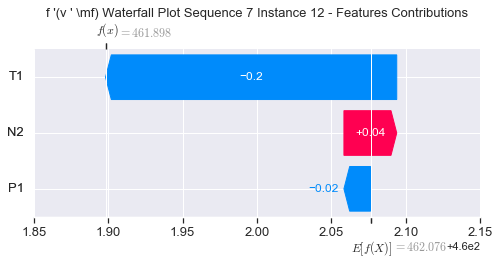

None

Contribution: [-0.01759275 -0.19644415  0.03836913]


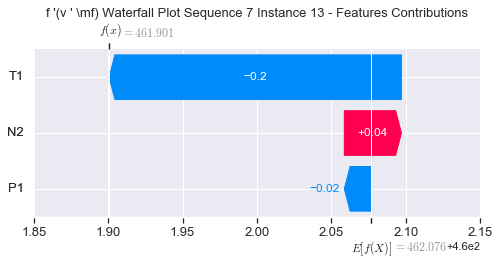

None

Contribution: [-0.01943088 -0.18527509  0.04330744]


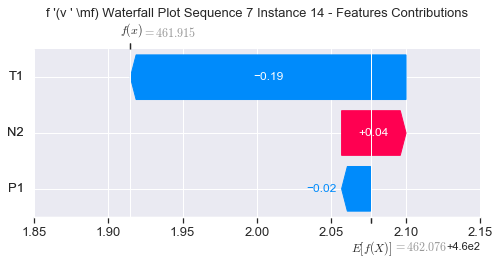

None

Contribution: [-0.01836847 -0.21671956  0.046755  ]


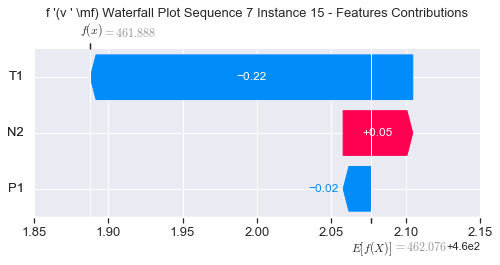

None

Contribution: [-0.01083526 -0.22509358  0.06094231]


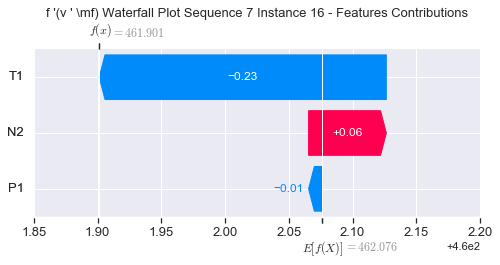

None

Contribution: [-0.01479083 -0.21507813  0.06352462]


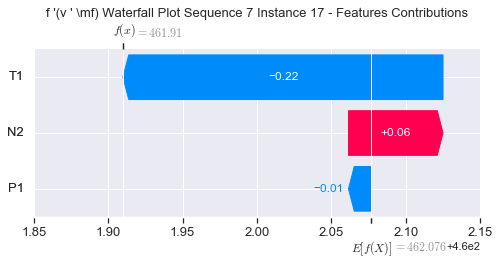

None

Contribution: [-0.01204235 -0.2247197   0.07706346]


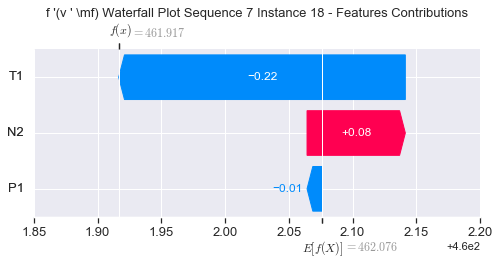

None

Contribution: [-0.00049436 -0.24772602  0.10489791]


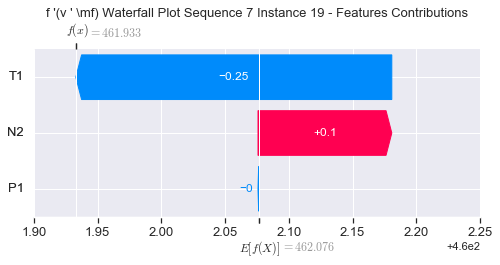

None

Contribution: [-0.01665389 -0.41173839  0.14337178]


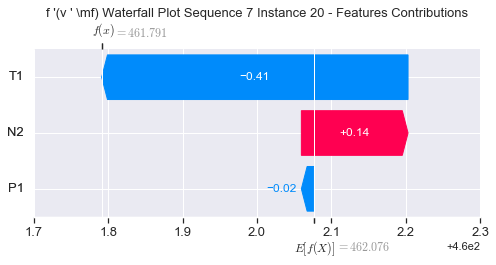

None

Contribution: [-0.02300986 -0.64652013  0.22252811]


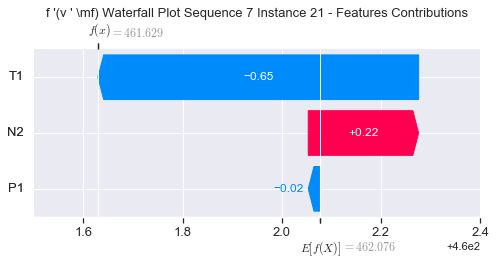

None

Contribution: [-0.12544347 -1.93477059  0.43484272]


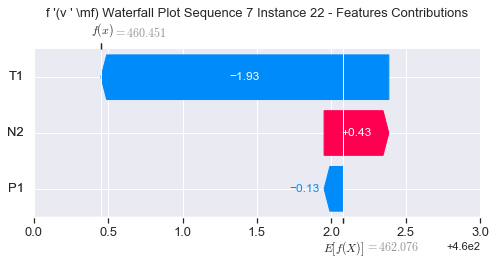

None

Contribution: [-0.19765786 -2.35246451  0.52327972]


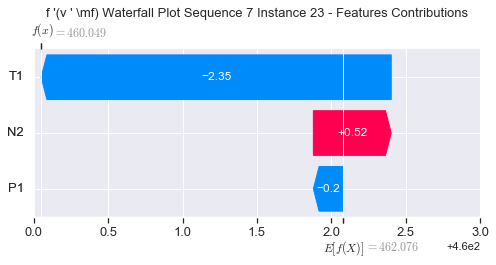

None

Contribution: [-0.43480884 -7.25494712  1.60742478]


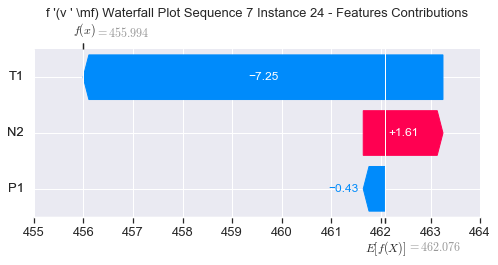

None

Contribution: [-0.37648471 -5.67833198  1.58657404]


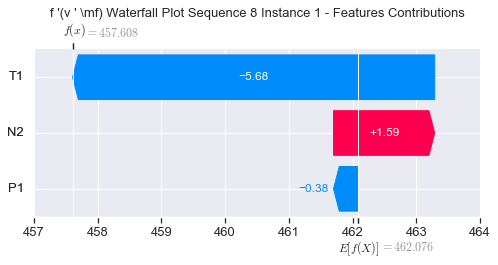

None

Contribution: [0.01865259 0.13929423 0.05467903]


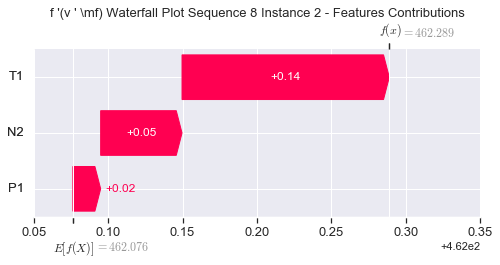

None

Contribution: [-0.01041565 -0.18942894  0.05467494]


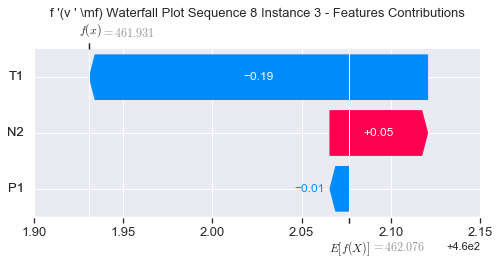

None

Contribution: [-0.0288377  -0.16920415 -0.00180593]


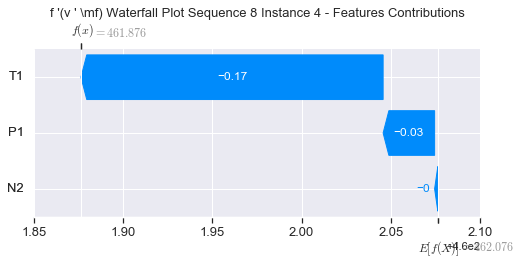

None

Contribution: [-0.04965852 -0.18384294 -0.00893387]


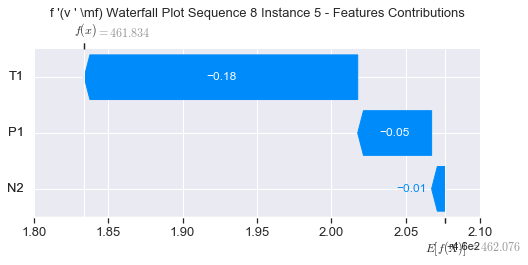

None

Contribution: [-0.02561304 -0.1549811   0.01350416]


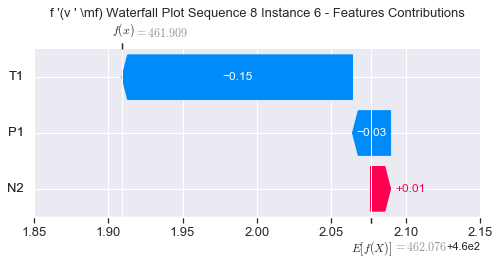

None

Contribution: [-0.02391558 -0.15091489  0.01945209]


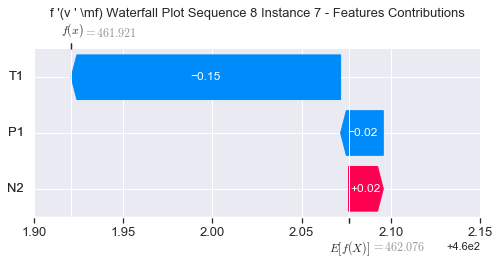

None

Contribution: [-0.02179896 -0.14538046  0.02546212]


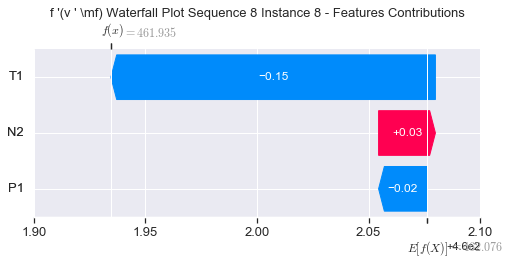

None

Contribution: [-0.03294492 -0.15683329  0.03663643]


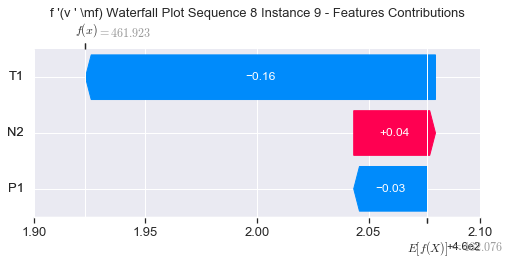

None

Contribution: [-0.05456432 -0.16663068  0.03854393]


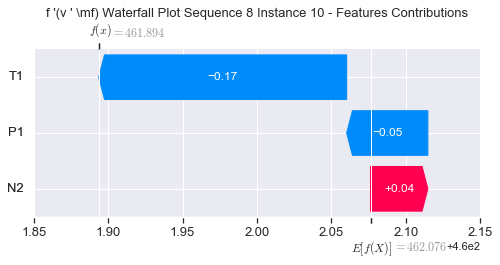

None

Contribution: [-0.01690717 -0.12283758  0.04639659]


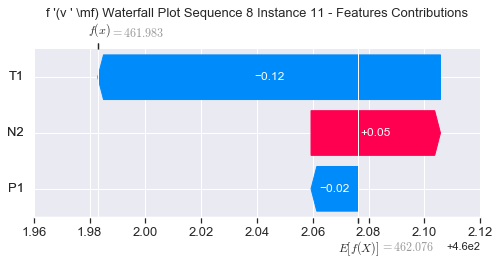

None

Contribution: [-0.00783699 -0.12203667  0.04228974]


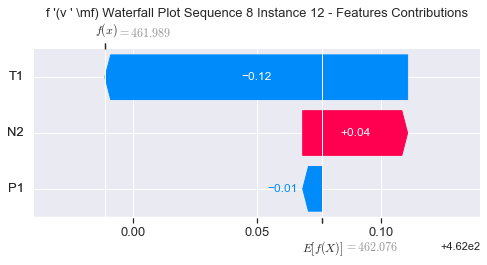

None

Contribution: [-0.01058055 -0.13059983  0.0441188 ]


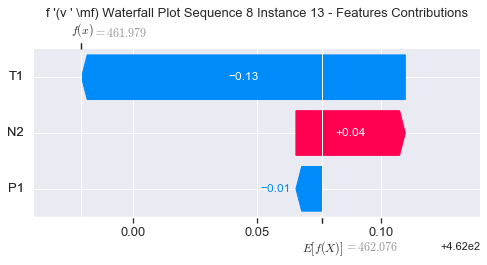

None

Contribution: [-0.00847358 -0.13854669  0.05097254]


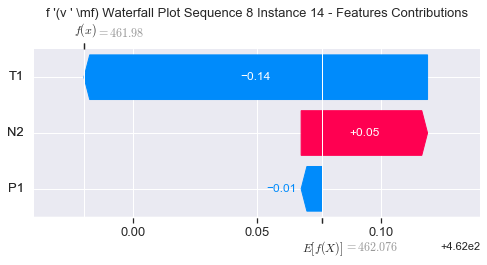

None

Contribution: [-0.00565056 -0.14368597  0.05425355]


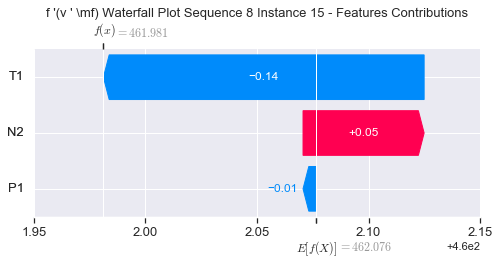

None

Contribution: [-0.00846667 -0.15065498  0.06657287]


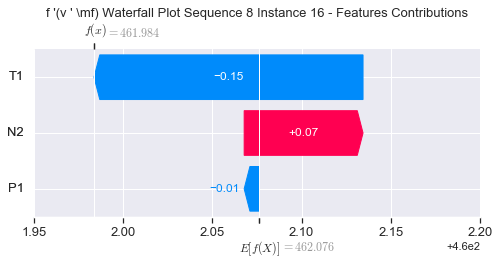

None

Contribution: [ 0.00161521 -0.13650727  0.07132225]


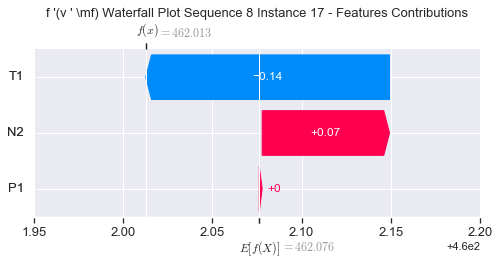

None

Contribution: [ 0.00783036 -0.13582293  0.0853139 ]


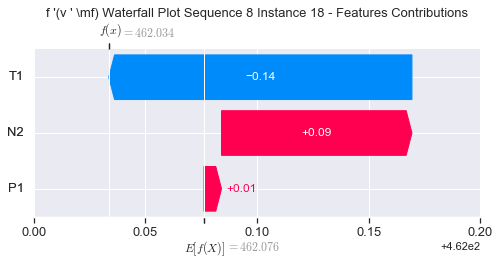

None

Contribution: [ 0.00481151 -0.17085458  0.10677774]


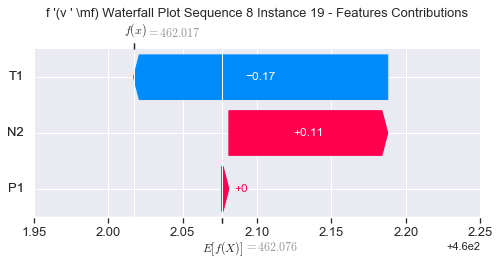

None

Contribution: [ 0.00343273 -0.28143237  0.14975824]


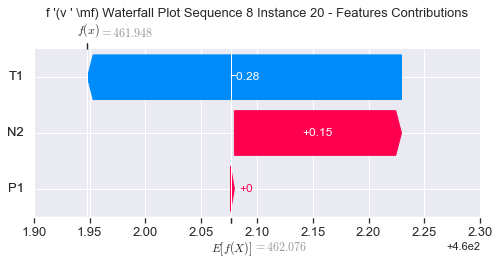

None

Contribution: [ 0.00852611 -0.41920066  0.22990177]


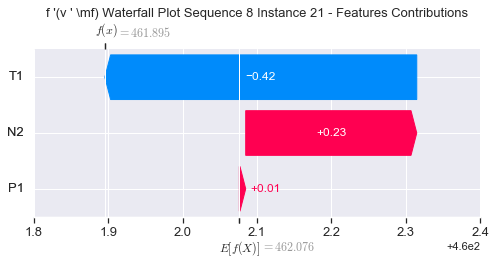

None

Contribution: [-0.04333931 -1.2366558   0.45566225]


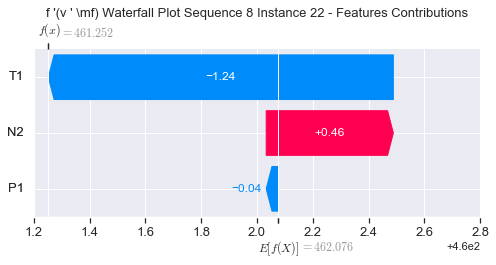

None

Contribution: [-0.02787653 -1.32848161  0.56994169]


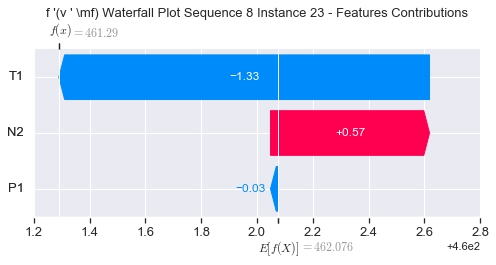

None

Contribution: [-0.09713926 -4.47512956  1.66848289]


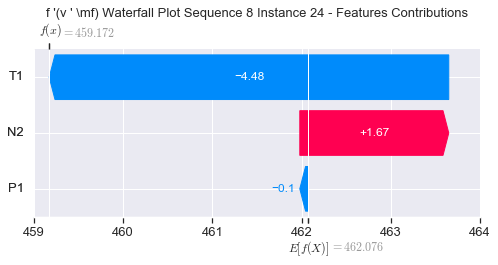

None

Contribution: [-0.03618714 -2.54426107  1.59638256]


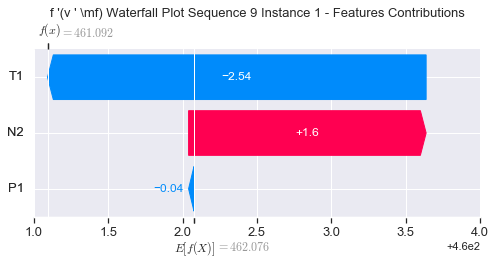

None

Contribution: [0.01766336 0.14064689 0.05089163]


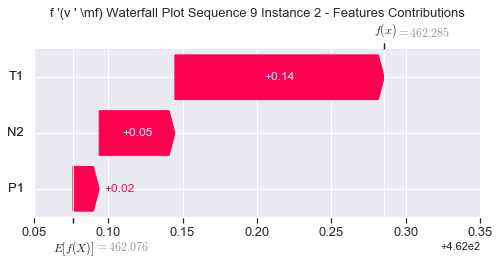

None

Contribution: [ 0.00686751 -0.09509741  0.05826215]


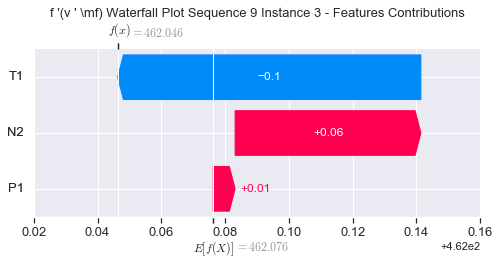

None

Contribution: [-0.02396352 -0.05932887 -0.00928373]


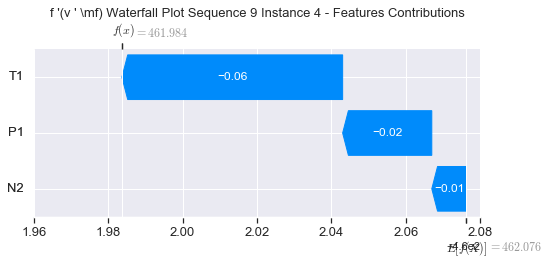

None

Contribution: [-0.02128937 -0.07715503 -0.00332597]


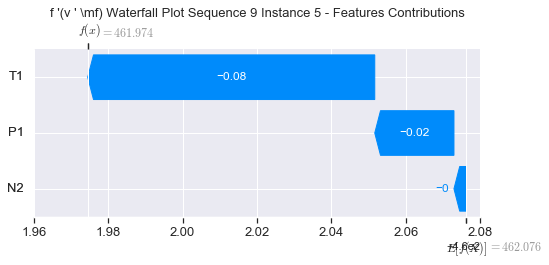

None

Contribution: [-0.01699397 -0.07955238  0.01102044]


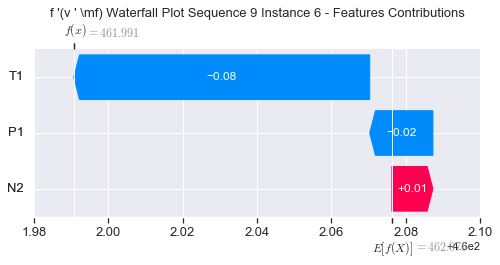

None

Contribution: [-0.01431283 -0.07962524  0.01800436]


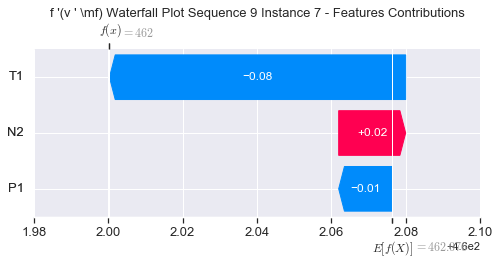

None

Contribution: [-0.01056624 -0.07983065  0.0248179 ]


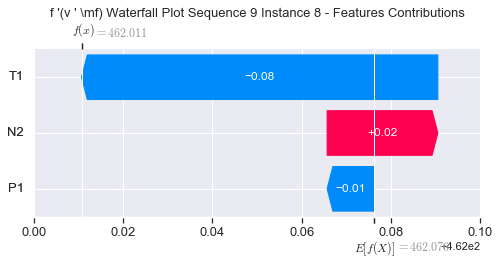

None

Contribution: [-0.00595293 -0.07074799  0.03122131]


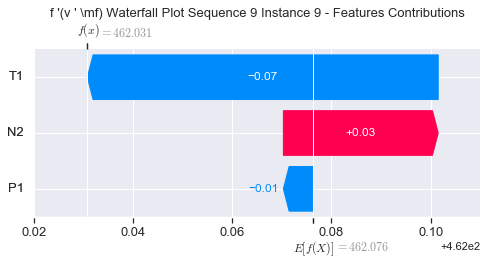

None

Contribution: [-0.01317654 -0.07066226  0.03792236]


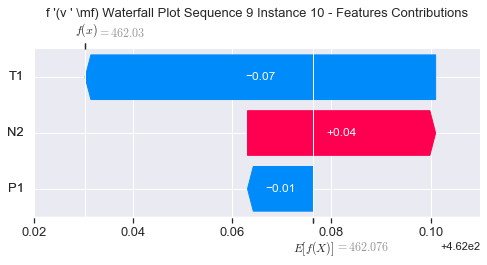

None

Contribution: [-0.00522999 -0.07809475  0.03871008]


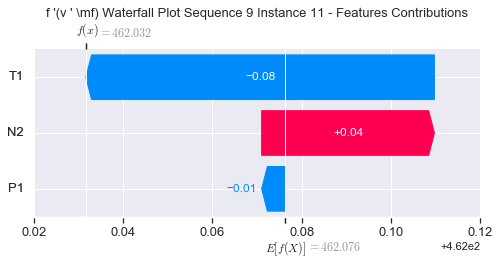

None

Contribution: [-0.00747641 -0.10832689  0.03872467]


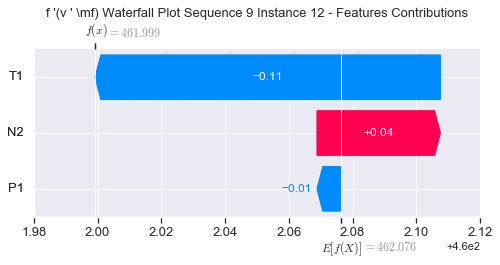

None

Contribution: [-0.00587356 -0.10999807  0.04151511]


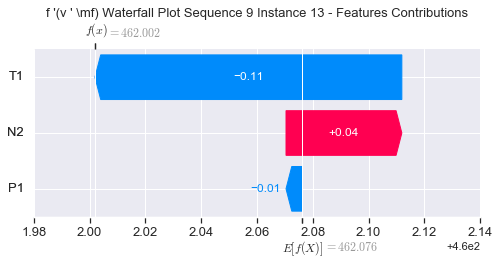

None

Contribution: [ 0.00159824 -0.12392541  0.04992554]


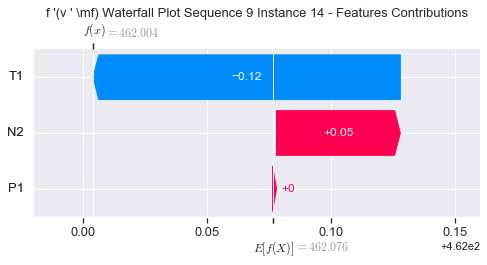

None

Contribution: [-0.00496291 -0.12825237  0.04982681]


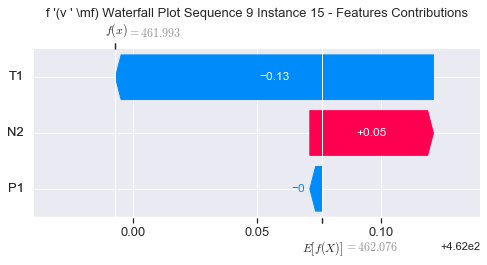

None

Contribution: [-0.00296222 -0.15082161  0.06239504]


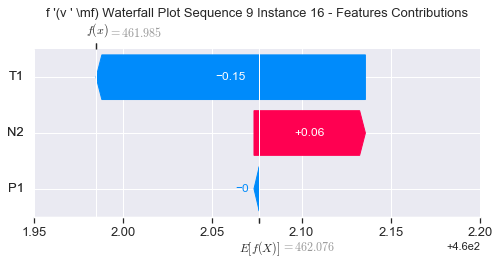

None

Contribution: [ 0.00290603 -0.13127153  0.06574962]


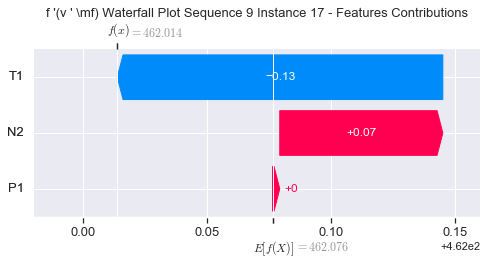

None

Contribution: [ 0.00677889 -0.13967291  0.07886866]


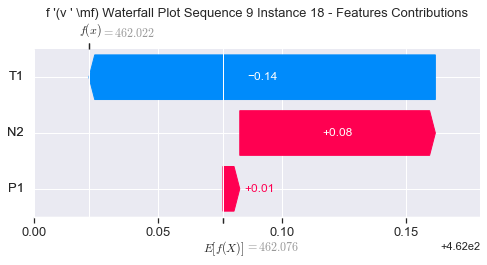

None

Contribution: [ 0.00566382 -0.13704242  0.10410267]


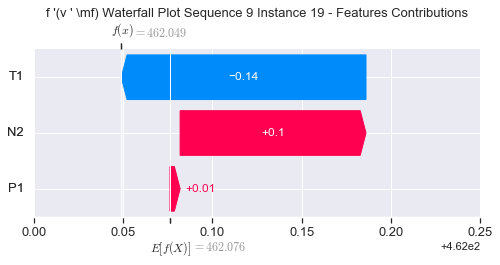

None

Contribution: [ 0.01729721 -0.2859721   0.14687318]


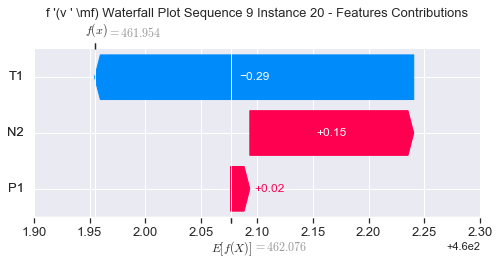

None

Contribution: [ 0.03051382 -0.46660214  0.23113304]


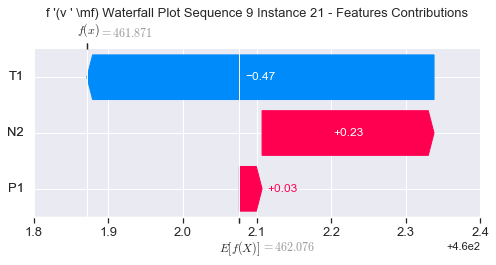

None

Contribution: [ 0.01842819 -1.43409406  0.47238915]


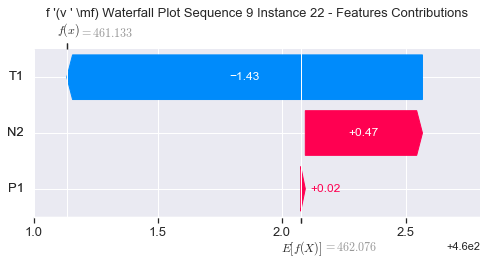

None

Contribution: [-0.01245904 -1.74758128  0.57725921]


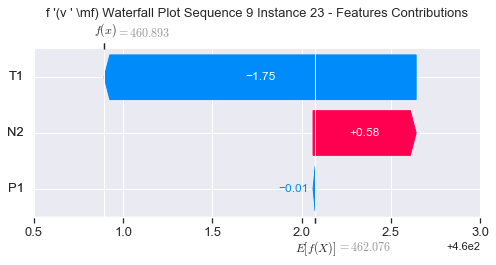

None

Contribution: [ 0.10460382 -5.3892184   1.72540563]


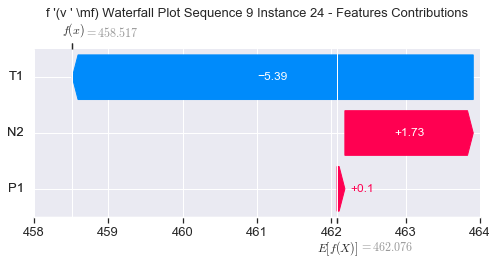

None

Contribution: [ 0.29272863 -3.49724965  1.63403357]


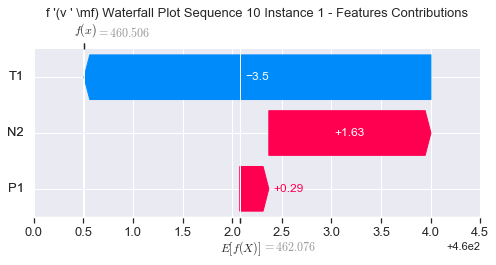

None

Contribution: [0.01344707 0.15364748 0.0514175 ]


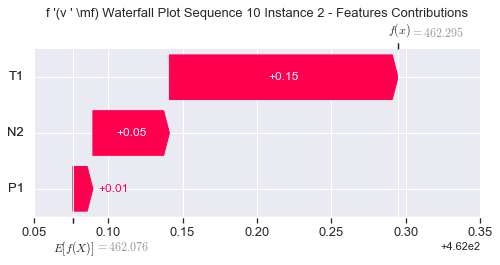

None

Contribution: [ 0.00808018 -0.09790265  0.05816392]


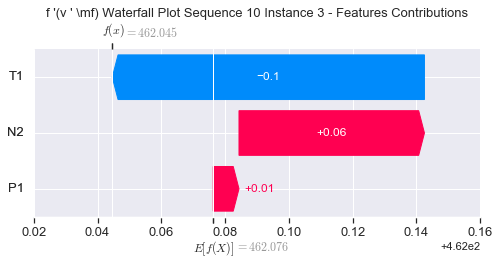

None

Contribution: [-0.01003477 -0.09454261 -0.00386687]


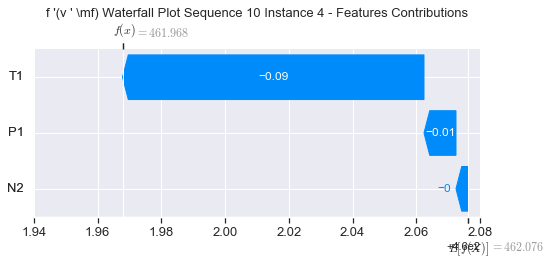

None

Contribution: [-0.00668925 -0.06878825 -0.00017587]


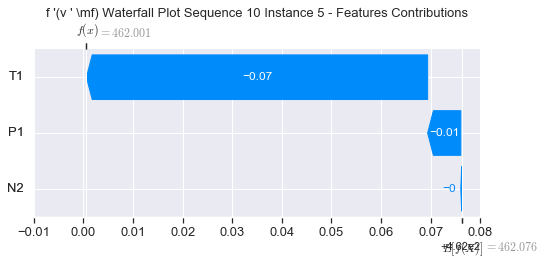

None

Contribution: [ 0.00404256 -0.10586747  0.01704319]


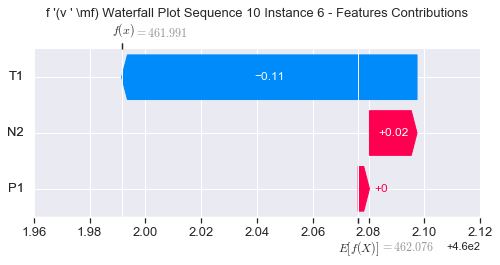

None

Contribution: [ 0.00237117 -0.11780074  0.0226734 ]


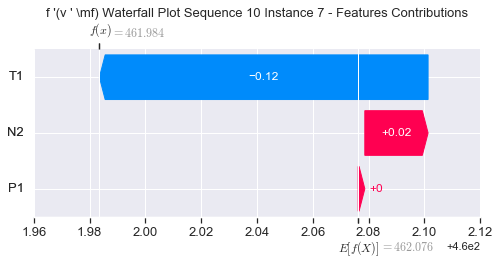

None

Contribution: [ 0.0093201  -0.10487461  0.02946659]


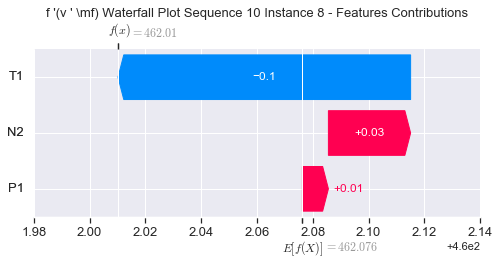

None

Contribution: [ 0.02044538 -0.07625615  0.03453402]


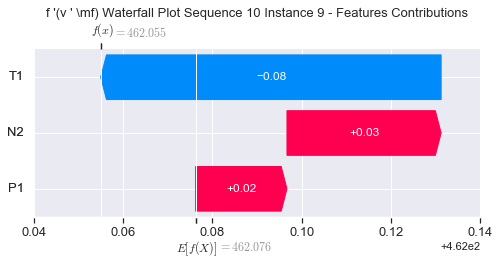

None

Contribution: [ 0.01620696 -0.06293049  0.04078626]


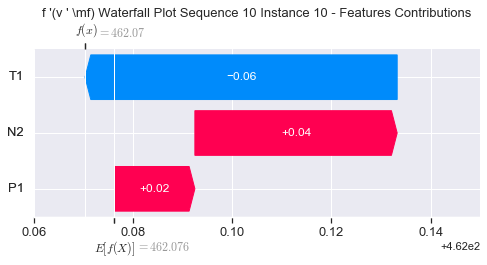

None

Contribution: [ 0.04236405 -0.05294292  0.0489123 ]


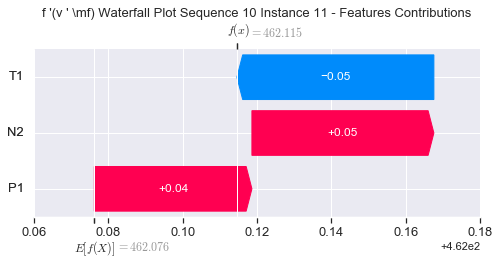

None

Contribution: [ 0.01519528 -0.13711592  0.04553323]


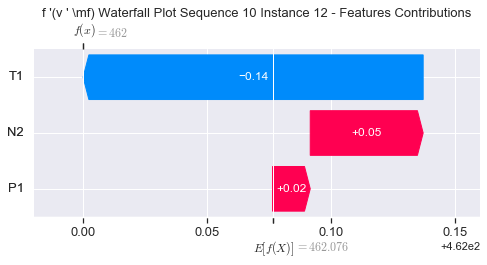

None

Contribution: [ 0.01367793 -0.14618284  0.0469149 ]


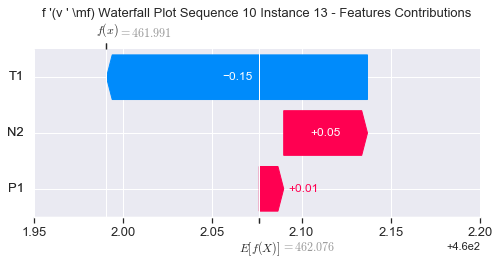

None

Contribution: [ 0.01866212 -0.11629364  0.05047281]


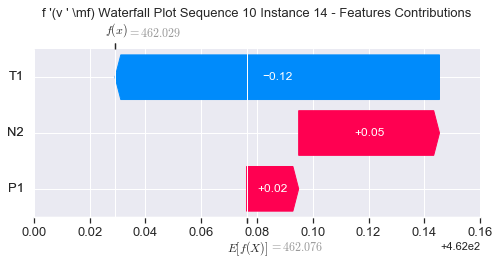

None

Contribution: [ 0.01669202 -0.18123178  0.05570234]


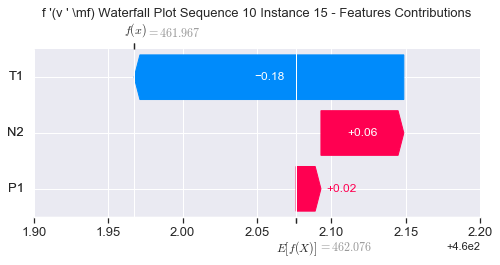

None

Contribution: [-0.00704774 -0.29554805  0.06152352]


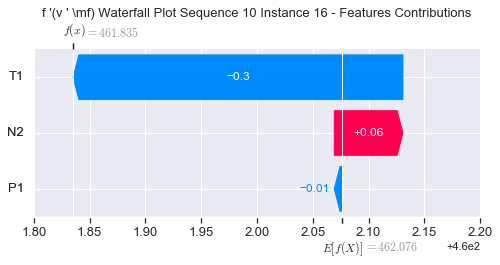

None

Contribution: [ 0.02101329 -0.20386288  0.06992655]


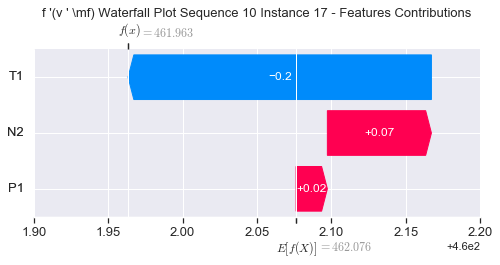

None

Contribution: [ 0.02697709 -0.21654511  0.08334292]


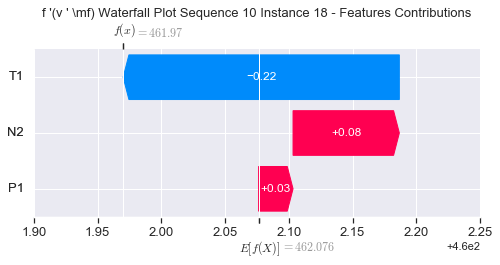

None

Contribution: [ 0.01917333 -0.31495433  0.1117785 ]


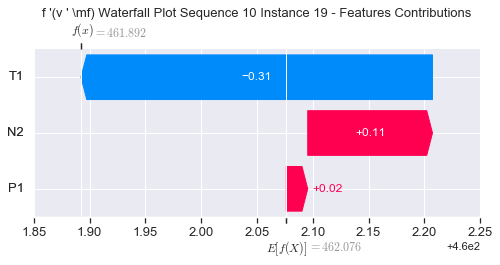

None

Contribution: [ 0.04231149 -0.42758035  0.14835355]


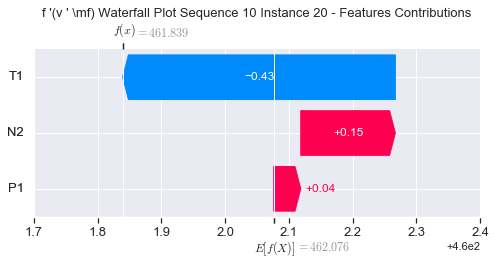

None

Contribution: [ 0.07064088 -0.64933003  0.23123719]


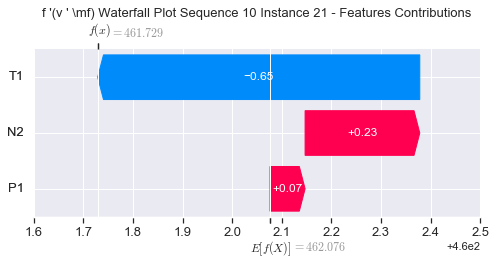

None

Contribution: [ 0.14745874 -1.84786959  0.47027657]


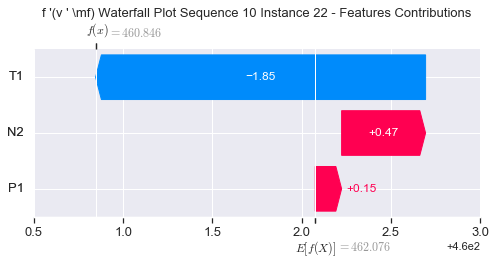

None

Contribution: [ 0.17390486 -2.36571583  0.58511511]


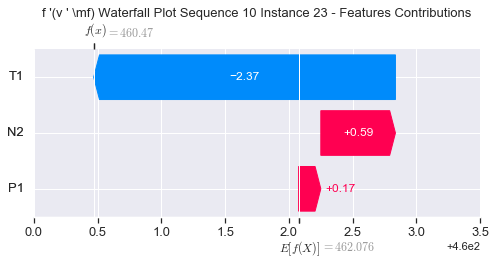

None

Contribution: [ 0.51113329 -6.68117857  1.68438664]


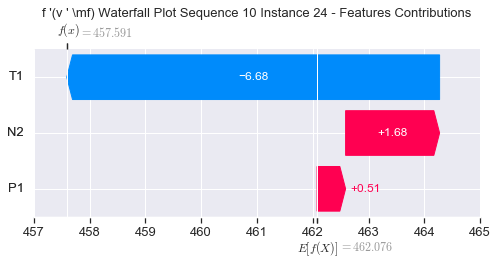

None

Contribution: [ 0.2677222  -3.83266879  1.48696032]


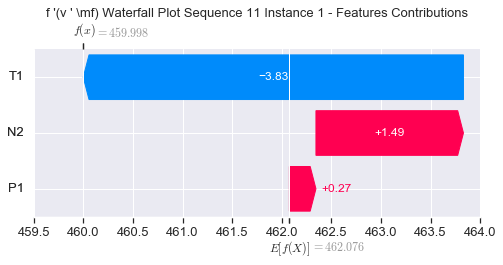

None

Contribution: [0.00833589 0.15899644 0.05124995]


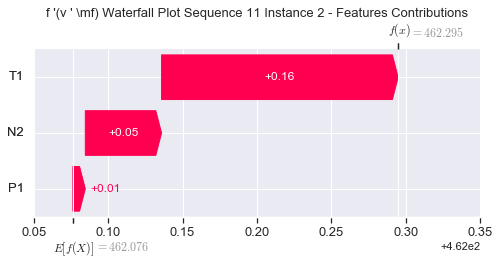

None

Contribution: [ 0.02473867 -0.09654504  0.05960142]


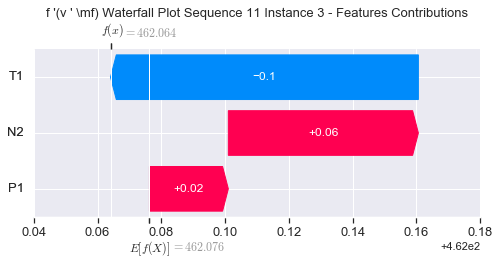

None

Contribution: [ 0.00838996 -0.05555307 -0.0016514 ]


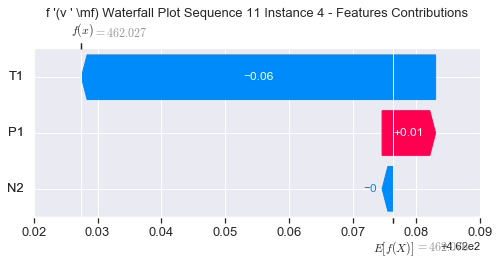

None

Contribution: [ 0.00989134 -0.052887    0.00479345]


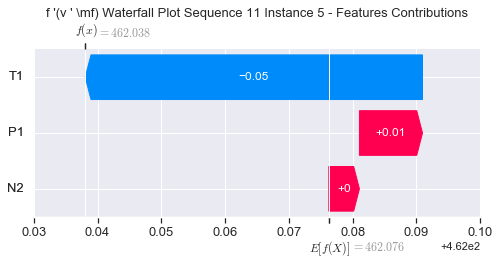

None

Contribution: [ 0.01799139 -0.0456972   0.01930069]


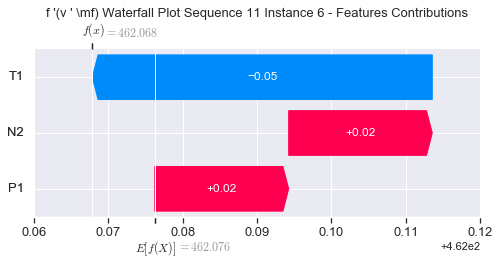

None

Contribution: [ 0.01613785 -0.04374494  0.02503523]


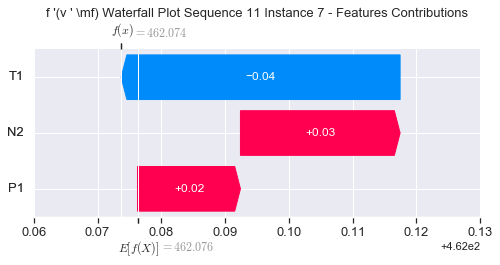

None

Contribution: [ 0.01918237 -0.04468715  0.03126783]


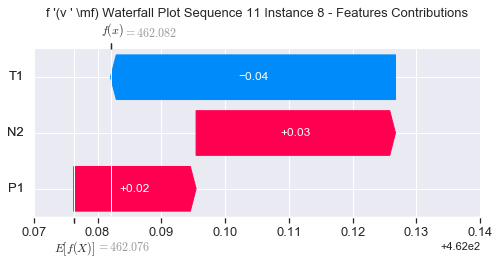

None

Contribution: [ 0.00750069 -0.03999964  0.03471021]


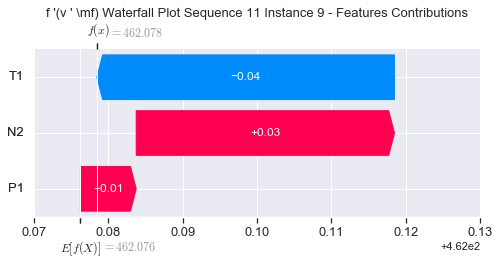

None

Contribution: [ 0.00320723 -0.04061729  0.04160228]


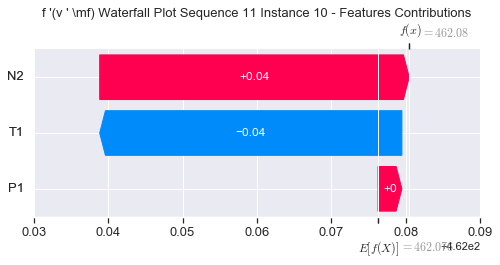

None

Contribution: [ 0.02338723 -0.04778882  0.04405633]


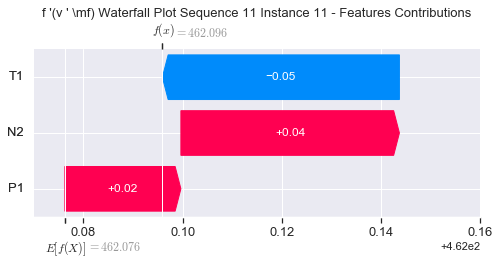

None

Contribution: [ 0.02722175 -0.06163615  0.0445559 ]


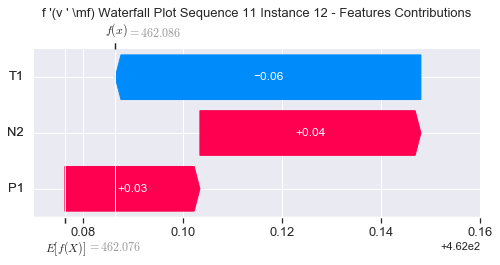

None

Contribution: [ 0.0265565  -0.05856242  0.04640623]


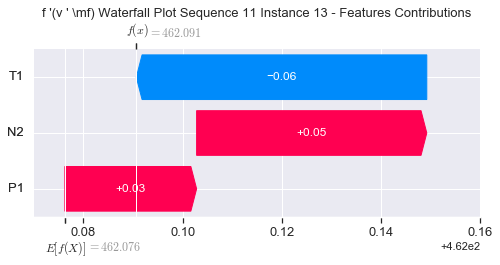

None

Contribution: [ 0.02810314 -0.05648731  0.05095751]


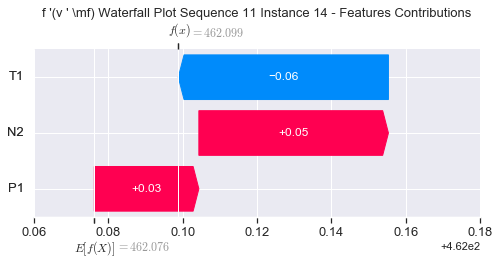

None

Contribution: [ 0.02947327 -0.06604602  0.05320529]


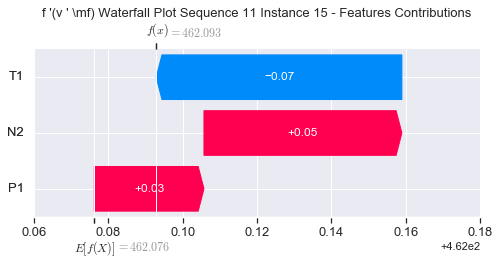

None

Contribution: [ 0.05082443 -0.08228326  0.06284008]


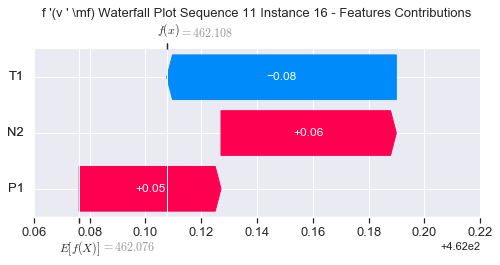

None

Contribution: [ 0.03274119 -0.05732801  0.06661512]


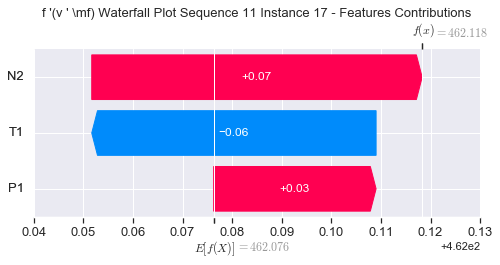

None

Contribution: [ 0.03837802 -0.05884354  0.07868555]


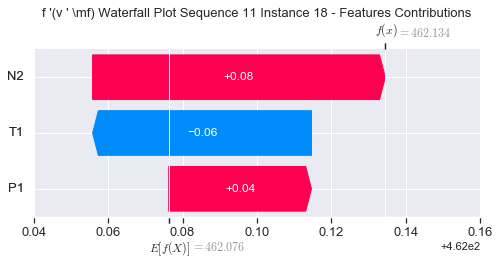

None

Contribution: [ 0.05109661 -0.05821915  0.10401942]


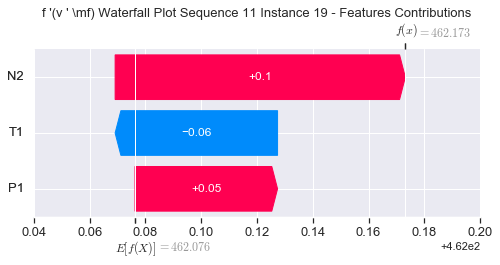

None

Contribution: [ 0.05939882 -0.12984778  0.14117939]


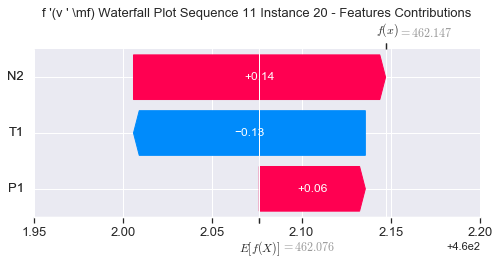

None

Contribution: [ 0.0946385  -0.21649799  0.22033021]


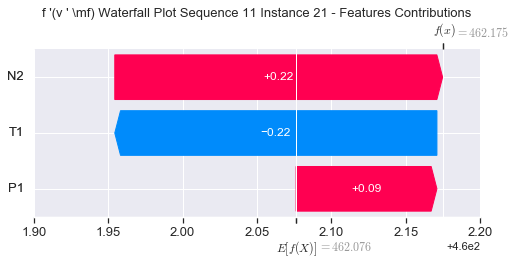

None

Contribution: [ 0.21013013 -0.71873141  0.44584231]


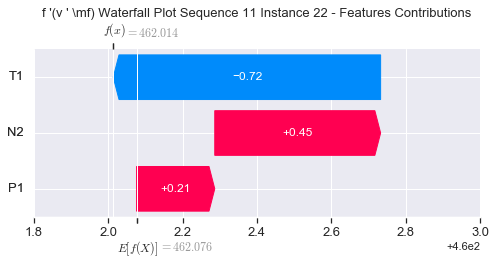

None

Contribution: [ 0.24773319 -0.80850967  0.54183704]


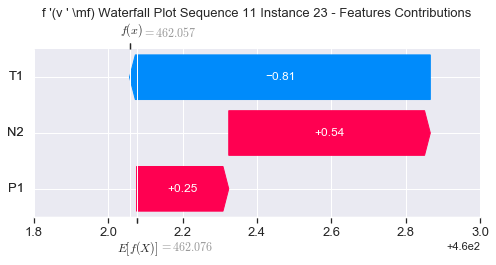

None

Contribution: [ 0.84294609 -2.53813629  1.62776274]


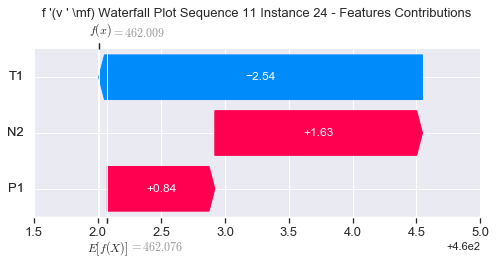

None

Contribution: [ 0.85440946 -0.11102135  1.56456015]


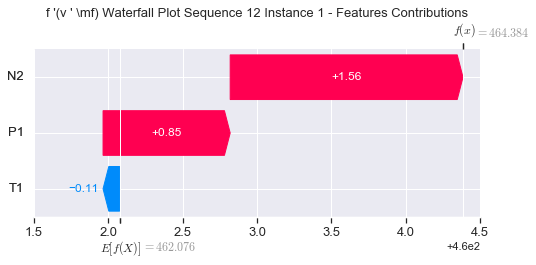

None

Contribution: [0.00373073 0.15704102 0.04752795]


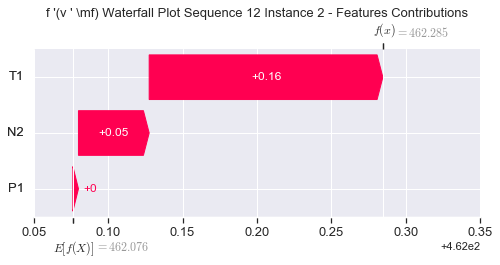

None

Contribution: [0.03449559 0.00891975 0.05575917]


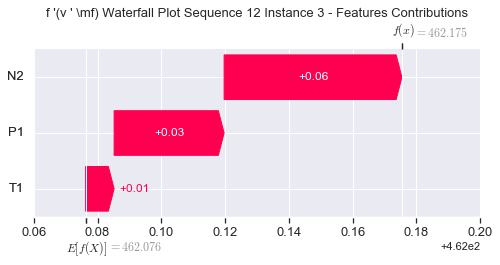

None

Contribution: [ 0.00438216 -0.00791078 -0.01363028]


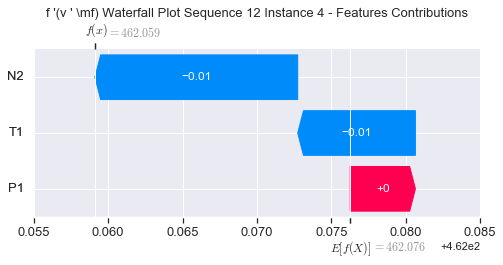

None

Contribution: [ 0.00546808 -0.00772789 -0.00784518]


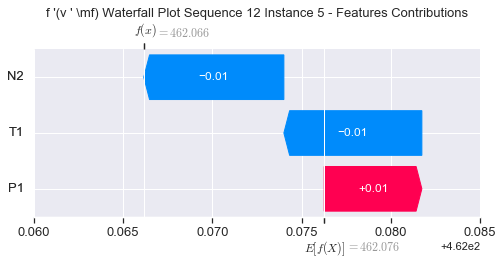

None

Contribution: [ 0.01086669 -0.01653893  0.00900102]


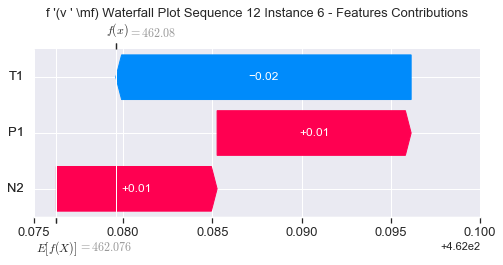

None

Contribution: [ 0.01316871 -0.02199375  0.01826143]


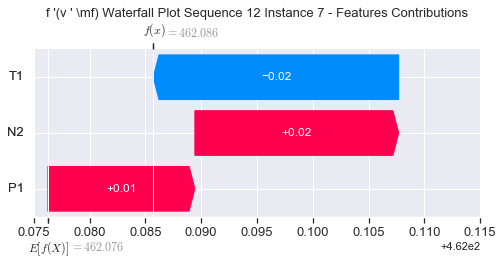

None

Contribution: [ 0.01535758 -0.02299066  0.02620673]


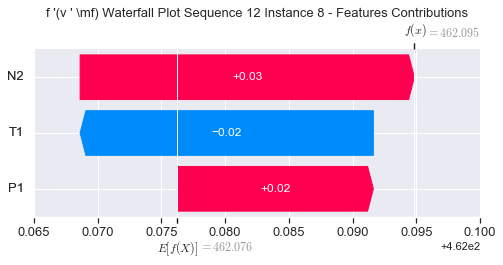

None

Contribution: [ 0.01427102 -0.02635264  0.03119885]


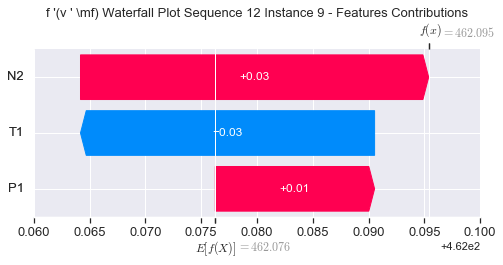

None

Contribution: [ 0.02231026 -0.02546363  0.04045536]


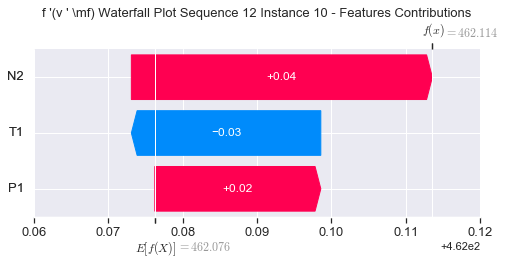

None

Contribution: [ 0.0158604  -0.02848966  0.03847712]


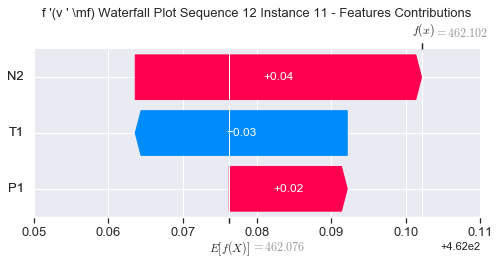

None

Contribution: [ 0.01752669 -0.05593729  0.03920412]


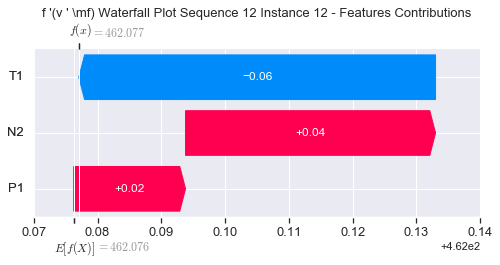

None

Contribution: [ 0.01994494 -0.0562586   0.04217261]


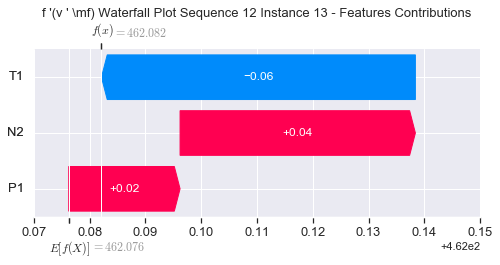

None

Contribution: [ 0.02488154 -0.07282751  0.04650643]


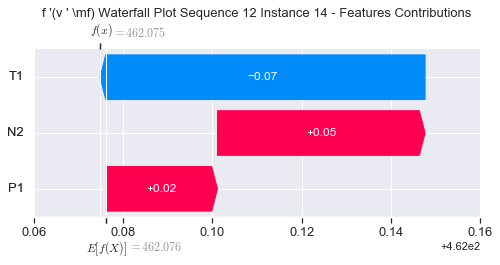

None

Contribution: [ 0.02211658 -0.06999759  0.05039732]


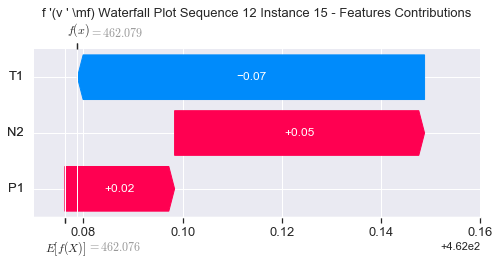

None

Contribution: [ 0.02450682 -0.08766702  0.06047418]


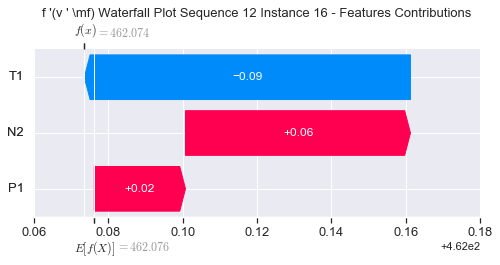

None

Contribution: [ 0.02913725 -0.07352239  0.0655957 ]


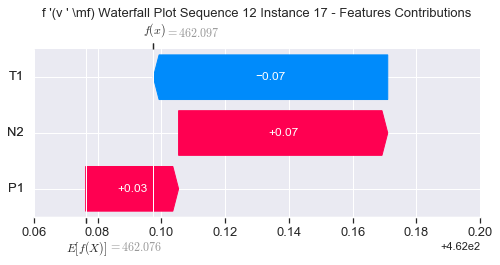

None

Contribution: [ 0.03349266 -0.07983074  0.07865144]


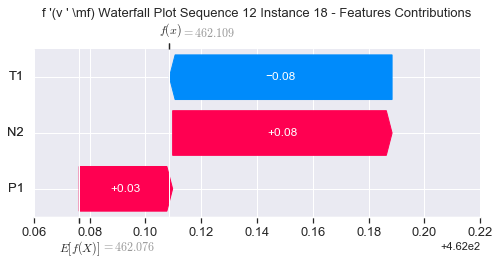

None

Contribution: [ 0.02853011 -0.09878197  0.09990567]


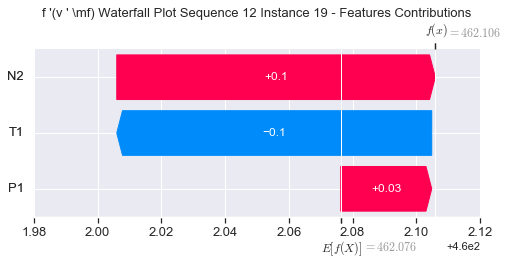

None

Contribution: [ 0.06153233 -0.18547103  0.14890605]


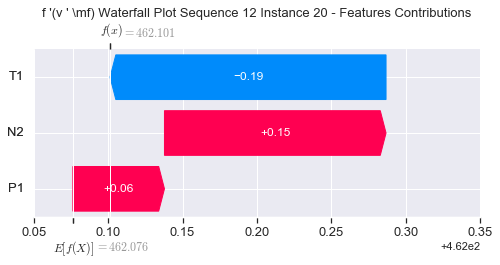

None

Contribution: [ 0.09563625 -0.31149174  0.23450173]


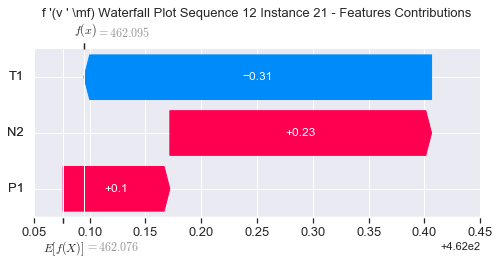

None

Contribution: [ 0.19290317 -0.9693399   0.48684121]


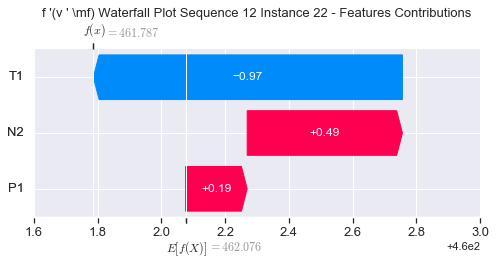

None

Contribution: [ 0.20393643 -1.18508472  0.59873161]


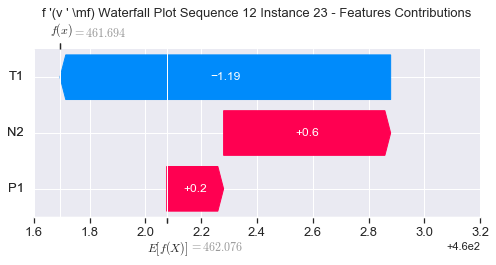

None

Contribution: [ 0.69478369 -3.27774385  1.8246409 ]


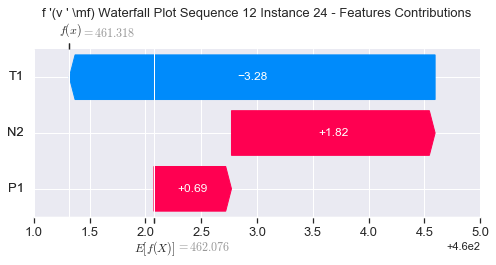

None

Contribution: [ 0.66804292 -0.52350544  1.78480125]


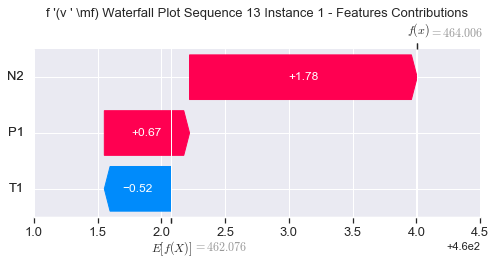

None

Contribution: [0.00644504 0.16896184 0.04726826]


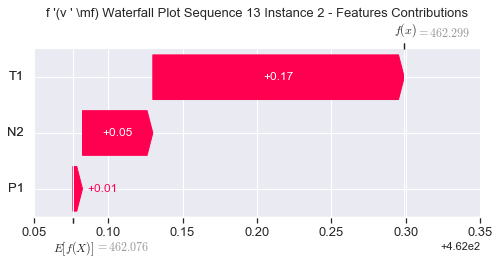

None

Contribution: [ 0.02492717 -0.00162129  0.05811258]


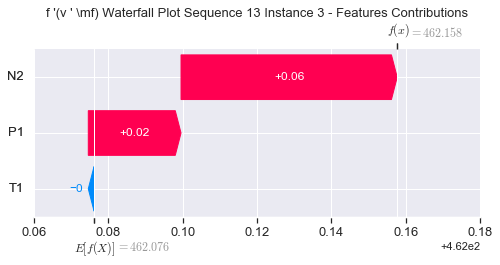

None

Contribution: [-0.0050834  -0.0099527  -0.01033106]


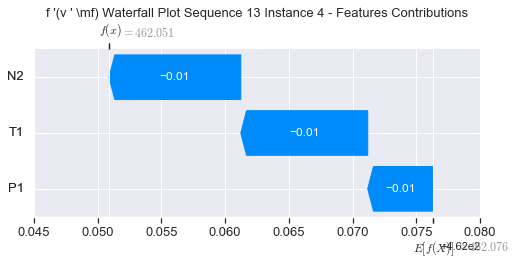

None

Contribution: [-0.00226252 -0.02508758 -0.00618571]


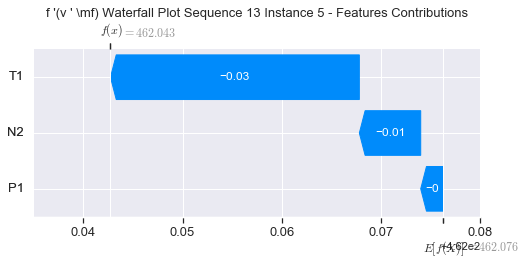

None

Contribution: [ 0.00253017 -0.02431039  0.00953703]


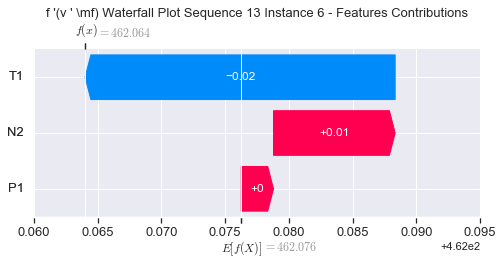

None

Contribution: [ 0.00475886 -0.02662085  0.01859307]


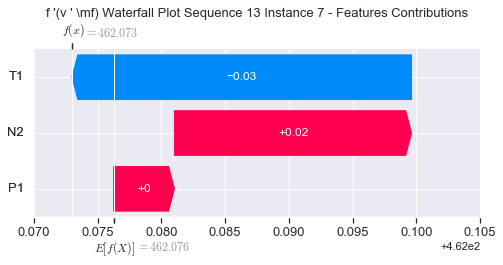

None

Contribution: [ 0.00740432 -0.02666191  0.02649218]


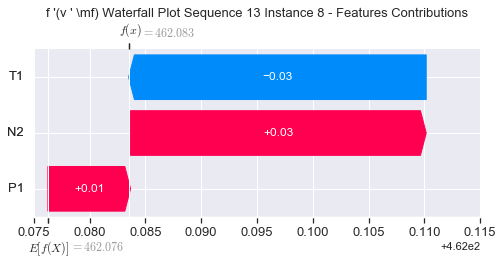

None

Contribution: [ 0.0103172  -0.02729319  0.03457453]


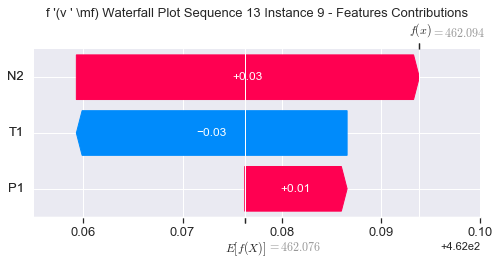

None

Contribution: [ 0.00502493 -0.05685209  0.03798887]


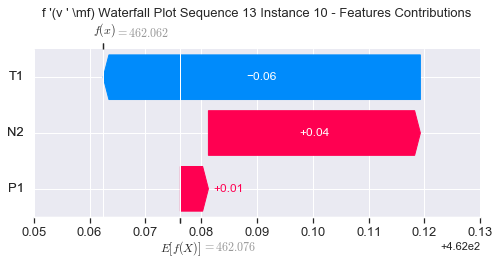

None

Contribution: [ 0.01286391 -0.02457311  0.04264623]


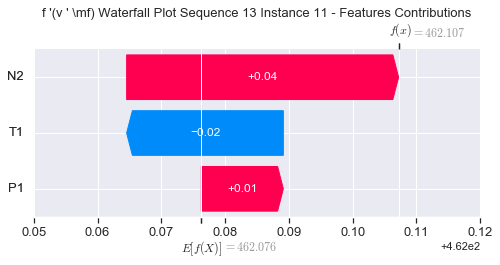

None

Contribution: [ 0.01149761 -0.03531684  0.04240558]


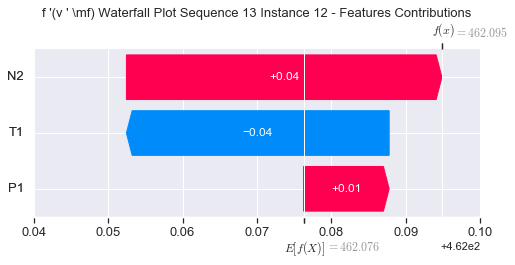

None

Contribution: [ 0.01270752 -0.03583304  0.04489837]


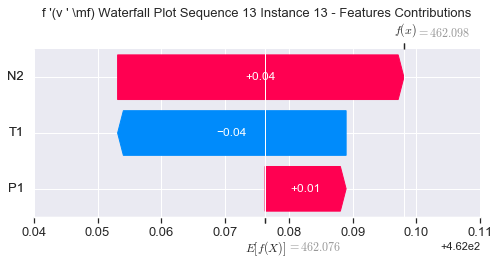

None

Contribution: [ 0.01661703 -0.02923814  0.05014546]


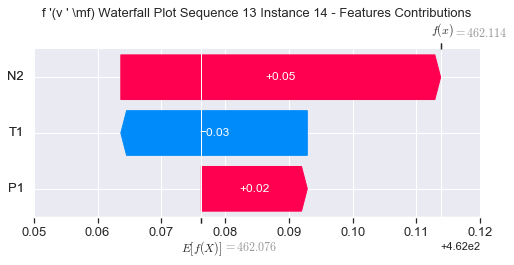

None

Contribution: [ 0.01285105 -0.04446436  0.05244999]


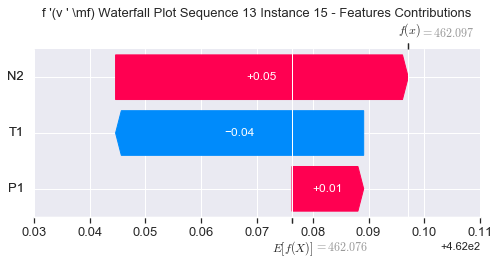

None

Contribution: [ 0.00965706 -0.05164497  0.06107667]


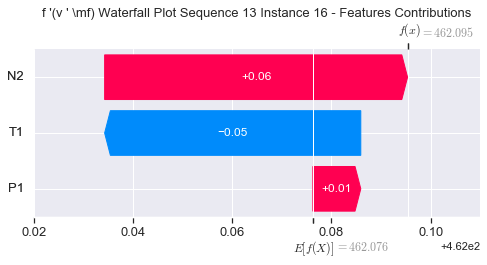

None

Contribution: [ 0.01854018 -0.04405286  0.06700194]


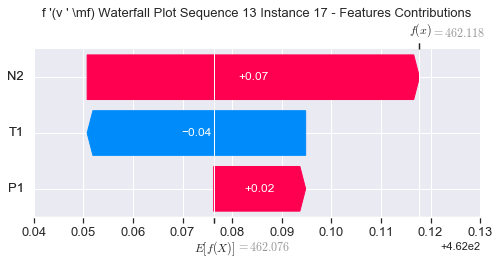

None

Contribution: [ 0.02156042 -0.04805953  0.07950838]


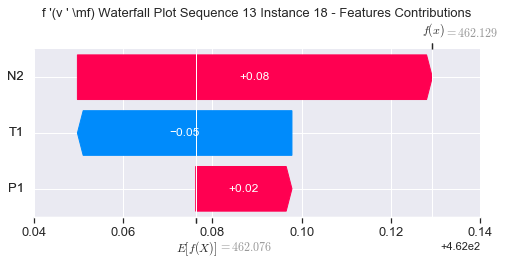

None

Contribution: [ 0.013099   -0.06684964  0.10208984]


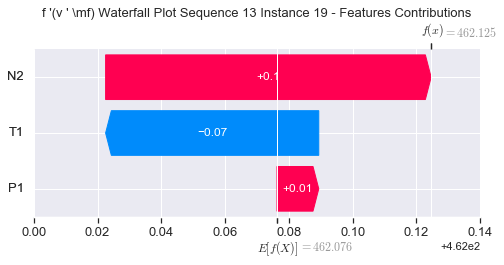

None

Contribution: [ 0.03695775 -0.13312361  0.14812668]


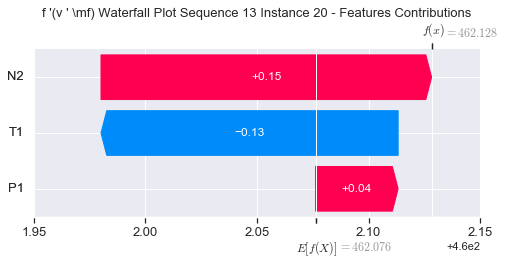

None

Contribution: [ 0.05971272 -0.21533083  0.23481755]


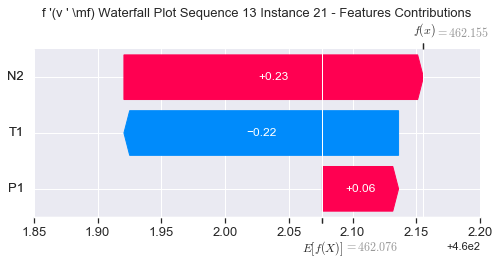

None

Contribution: [ 0.09551097 -0.67524288  0.4928105 ]


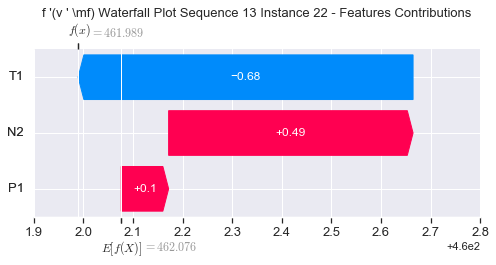

None

Contribution: [ 0.07864194 -0.77860614  0.60075176]


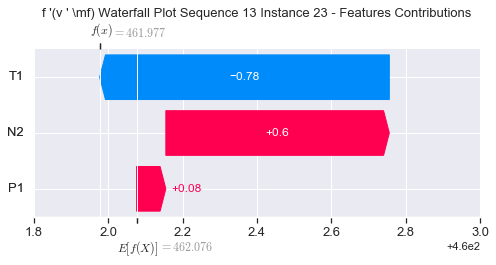

None

Contribution: [ 0.33598455 -2.28683789  1.79434119]


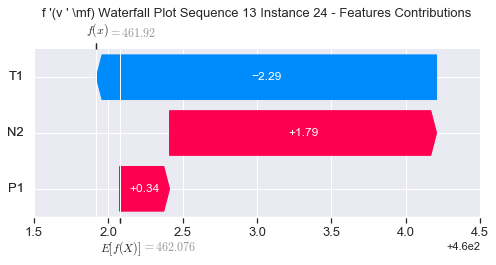

None

Contribution: [0.52202977 0.77008825 1.73038168]


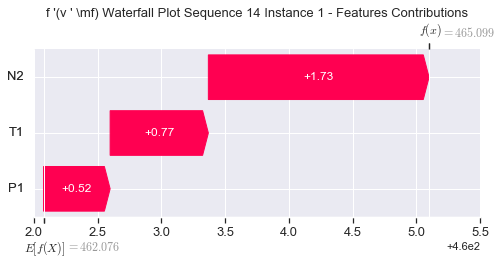

None

Contribution: [0.01117252 0.15981235 0.04415575]


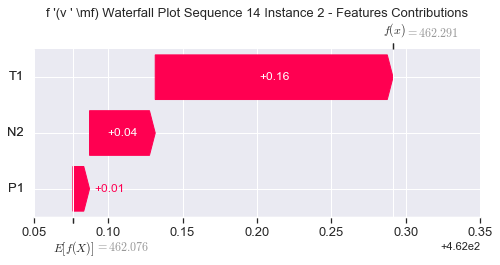

None

Contribution: [0.02489977 0.06278644 0.06215553]


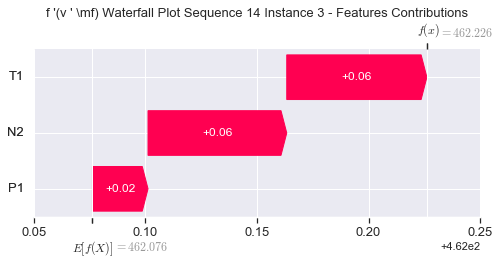

None

Contribution: [ 0.00036993  0.02561889 -0.01194346]


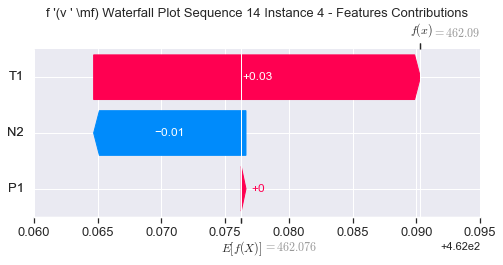

None

Contribution: [-0.00080058  0.02618013 -0.01179749]


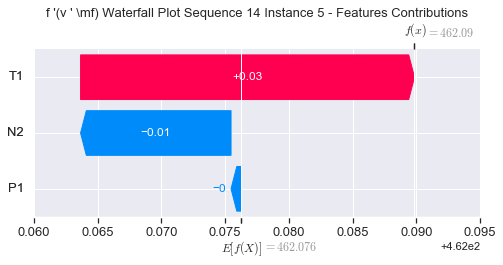

None

Contribution: [0.00246223 0.01782385 0.00485841]


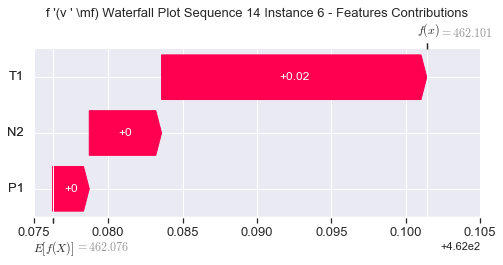

None

Contribution: [0.00546822 0.01451882 0.01566505]


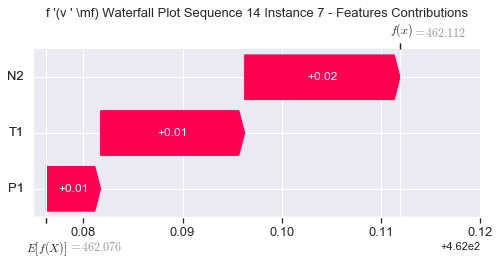

None

Contribution: [0.00792316 0.01233054 0.02430838]


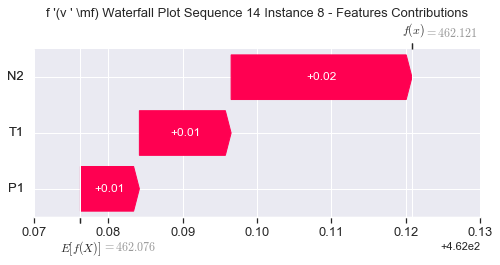

None

Contribution: [0.01027753 0.02193205 0.03186383]


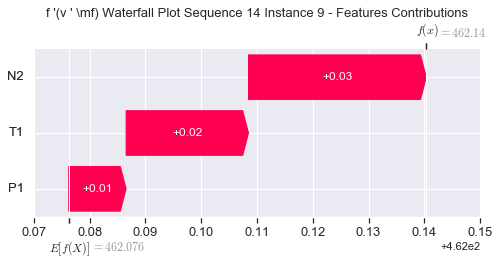

None

Contribution: [0.00895272 0.02035444 0.03779497]


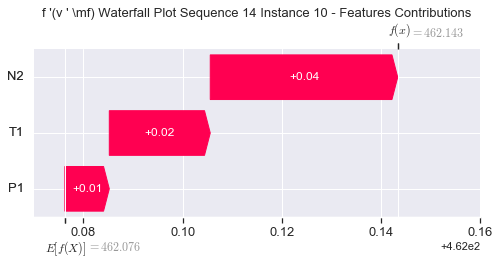

None

Contribution: [0.01032062 0.01562223 0.03939904]


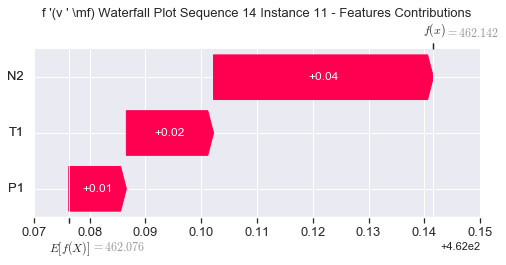

None

Contribution: [ 0.01032169 -0.01298495  0.03974991]


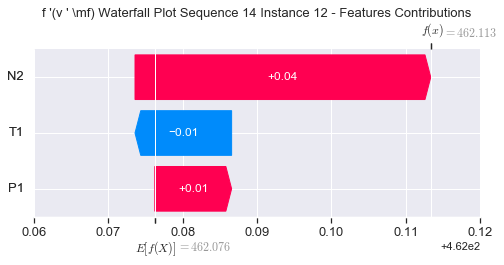

None

Contribution: [ 0.01225711 -0.01197355  0.04254258]


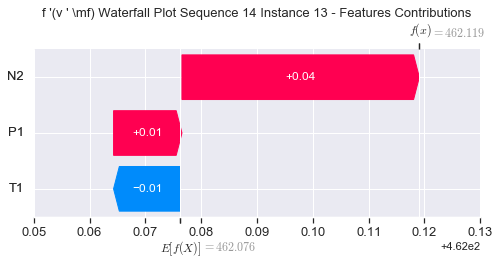

None

Contribution: [ 0.01403603 -0.01650491  0.04457942]


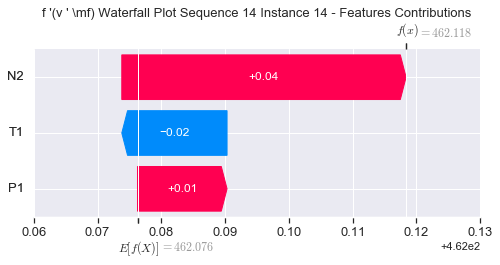

None

Contribution: [ 0.01306155 -0.02622415  0.05026068]


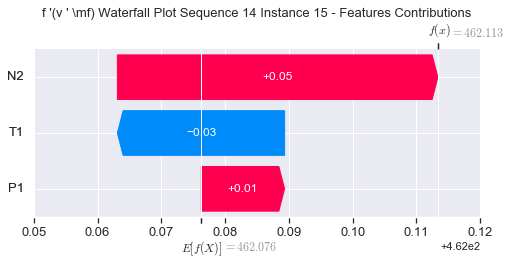

None

Contribution: [ 0.00949977 -0.0489825   0.05941088]


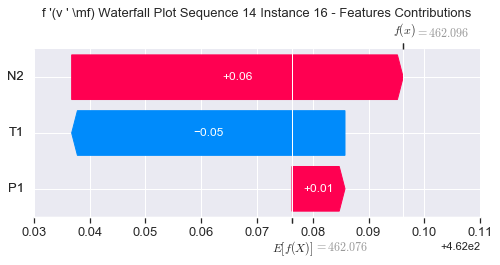

None

Contribution: [ 0.01850833 -0.03118359  0.06475456]


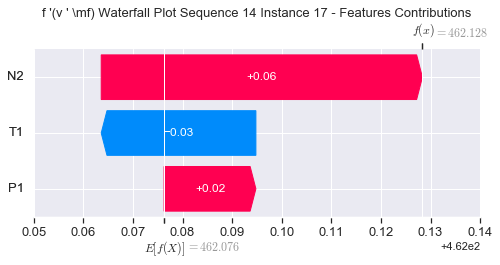

None

Contribution: [ 0.02134224 -0.03965379  0.07698107]


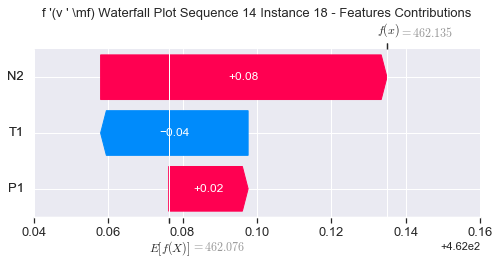

None

Contribution: [ 0.02446298 -0.06314345  0.10282613]


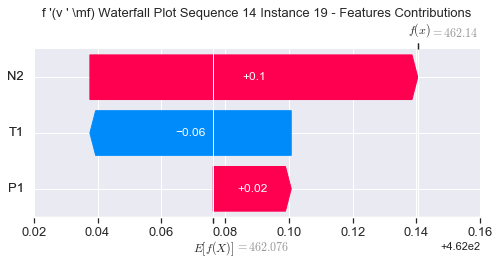

None

Contribution: [ 0.03978611 -0.12594668  0.14659972]


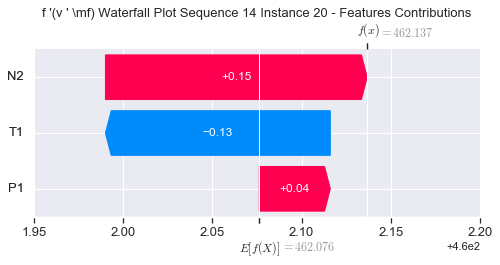

None

Contribution: [ 0.06313922 -0.22182577  0.233206  ]


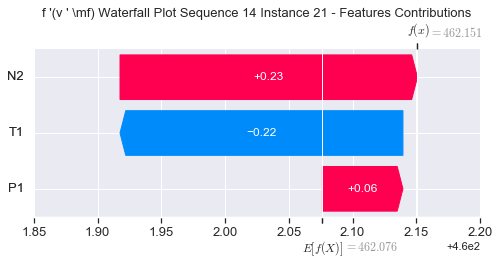

None

Contribution: [ 0.10655473 -0.73379717  0.48884811]


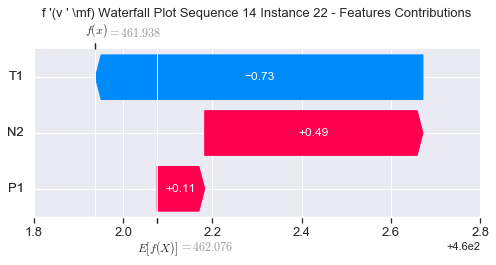

None

Contribution: [ 0.08496439 -0.91689926  0.59841382]


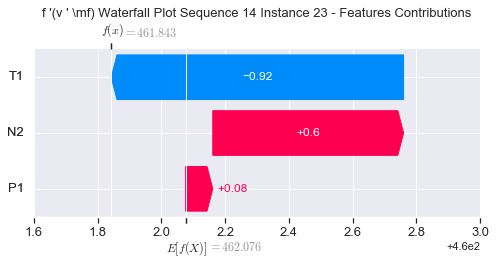

None

Contribution: [ 0.35257336 -2.65120858  1.74881879]


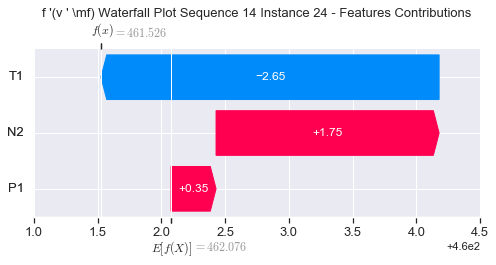

None

Contribution: [0.4618885  0.05951515 1.59930809]


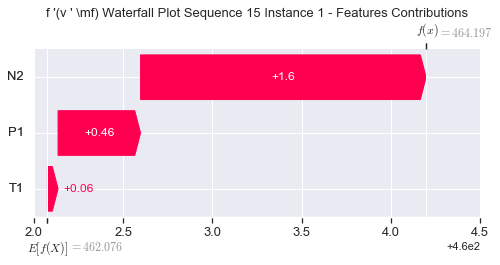

None

Contribution: [0.01054091 0.1585511  0.04621511]


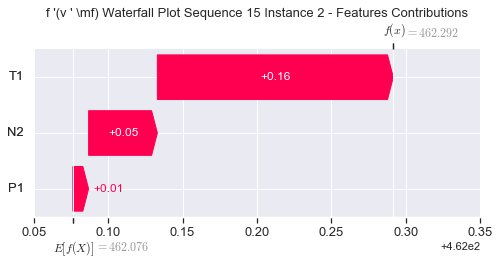

None

Contribution: [0.02656612 0.02133481 0.06042974]


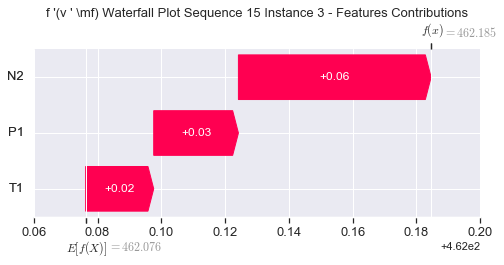

None

Contribution: [-0.00748163 -0.01148527 -0.0114723 ]


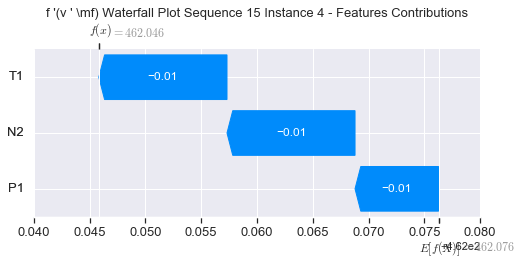

None

Contribution: [-0.00124888 -0.0025926  -0.00631575]


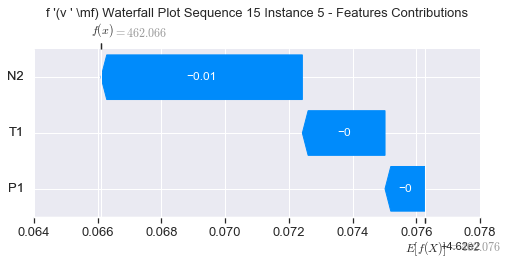

None

Contribution: [ 0.00475375 -0.00954817  0.01042376]


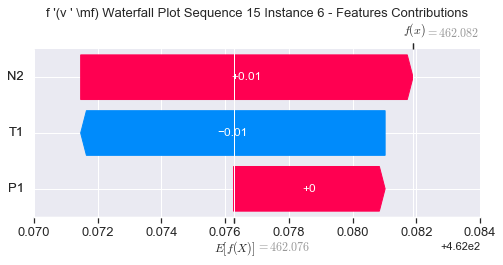

None

Contribution: [ 0.00707186 -0.00923773  0.02007498]


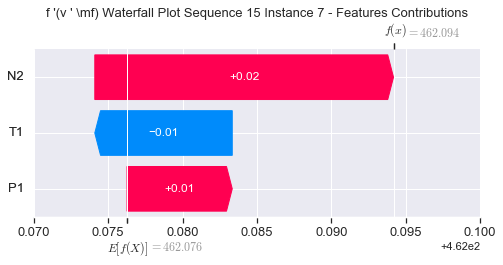

None

Contribution: [ 0.0084965  -0.01161386  0.02747758]


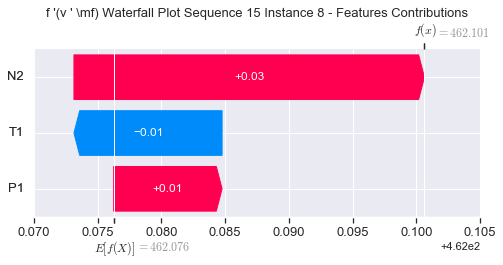

None

Contribution: [ 0.00559622 -0.00546146  0.03370503]


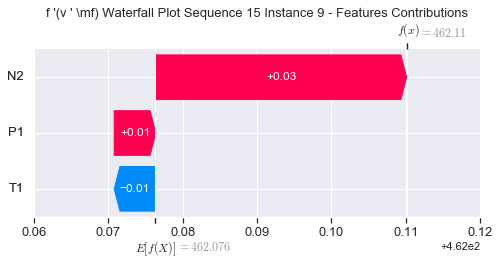

None

Contribution: [ 0.008398   -0.00732148  0.04025417]


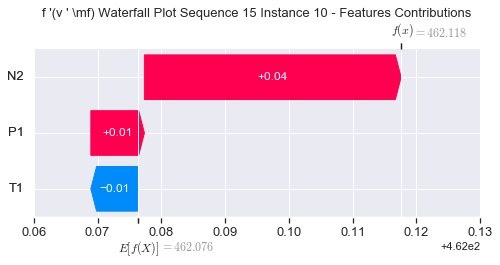

None

Contribution: [ 0.0053886  -0.01538073  0.03969073]


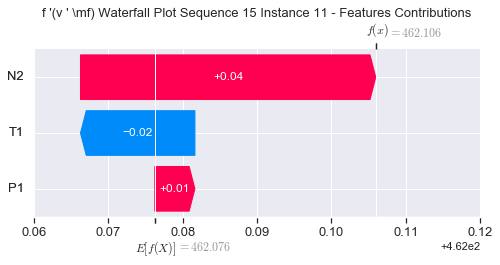

None

Contribution: [ 0.00984769 -0.02456587  0.04118731]


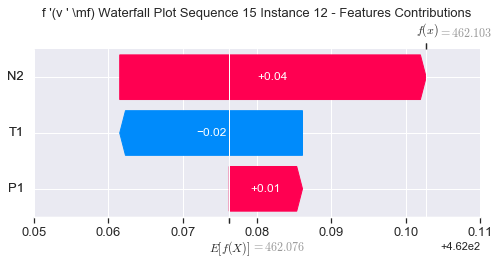

None

Contribution: [ 0.0116774  -0.02270558  0.04405619]


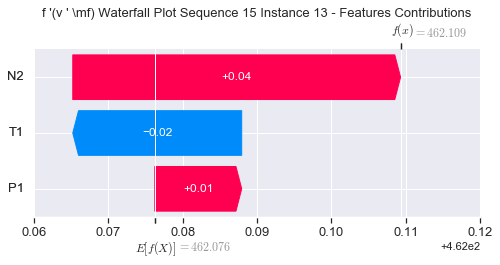

None

Contribution: [ 0.01881744 -0.04121138  0.05048223]


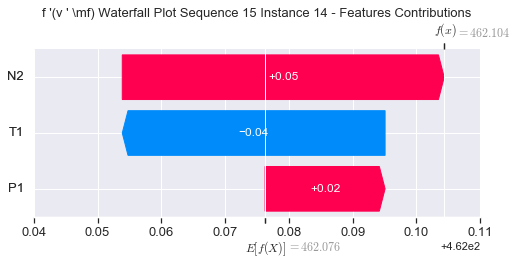

None

Contribution: [ 0.01247064 -0.03606911  0.05207836]


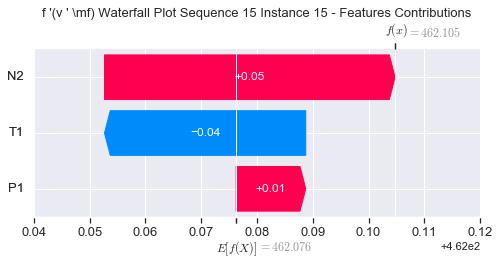

None

Contribution: [ 0.01270047 -0.03286198  0.06158878]


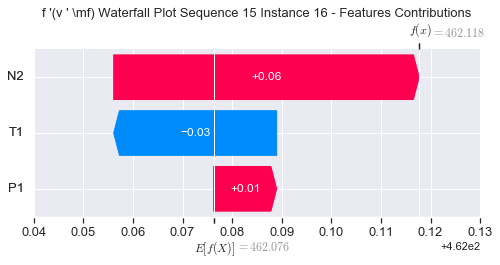

None

Contribution: [ 0.01876068 -0.03580146  0.06694012]


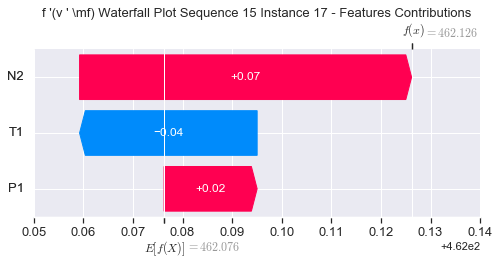

None

Contribution: [ 0.02214718 -0.04329066  0.07931413]


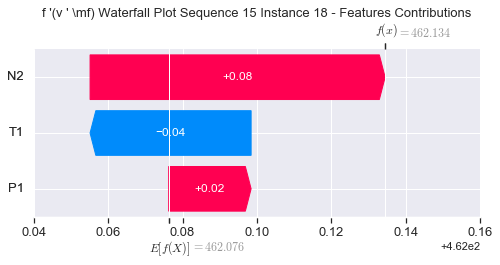

None

Contribution: [ 0.02513387 -0.04586167  0.10179491]


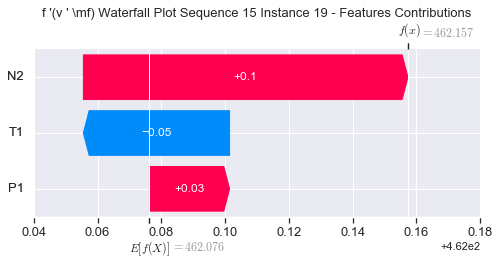

None

Contribution: [ 0.03885029 -0.12221164  0.14891367]


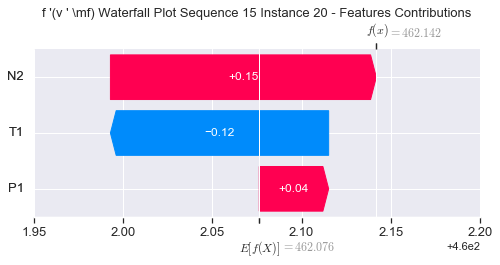

None

Contribution: [ 0.05913825 -0.20687698  0.23449996]


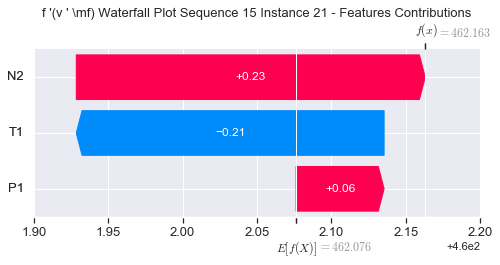

None

Contribution: [ 0.0855286  -0.67850435  0.4857973 ]


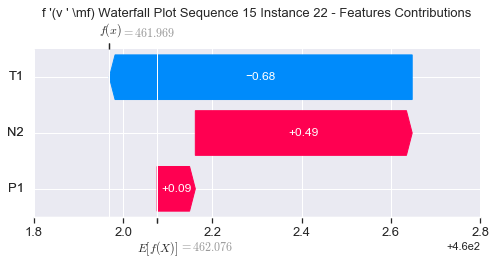

None

Contribution: [ 0.07171656 -0.83255325  0.59471837]


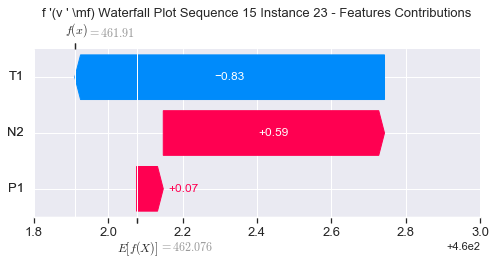

None

Contribution: [ 0.37483069 -2.51660894  1.79893475]


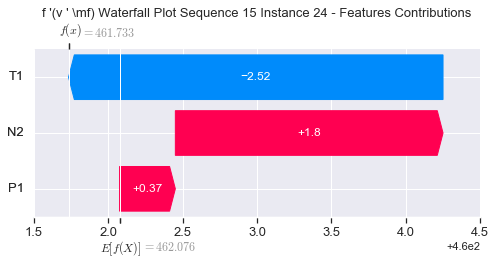

None

Contribution: [0.61573832 0.34166265 1.75875734]


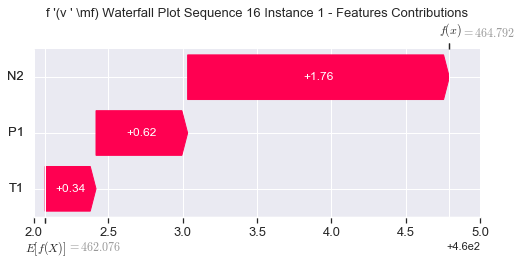

None

Contribution: [0.01353973 0.15428985 0.04618824]


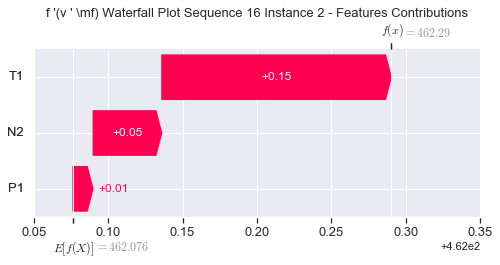

None

Contribution: [0.02203434 0.04107747 0.0617985 ]


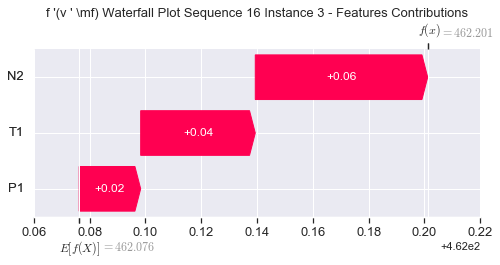

None

Contribution: [-0.00206964  0.01140044 -0.01198251]


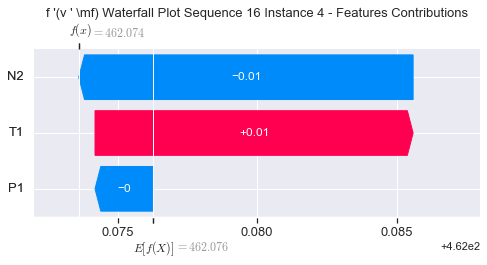

None

Contribution: [ 0.00075038 -0.00525581 -0.00818168]


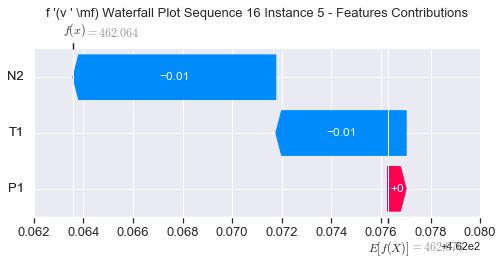

None

Contribution: [ 0.00559616 -0.01121834  0.00890482]


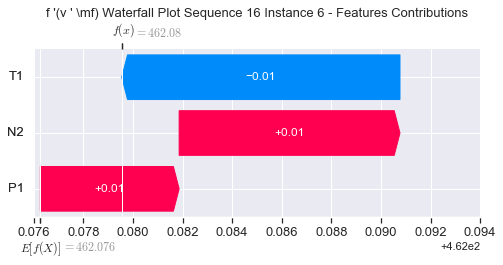

None

Contribution: [ 0.00735506 -0.01148155  0.01887197]


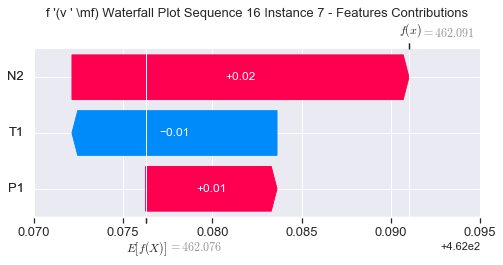

None

Contribution: [ 0.00940744 -0.01717535  0.02681482]


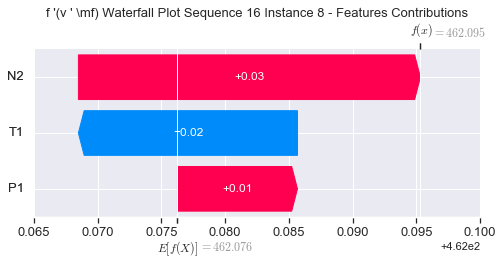

None

Contribution: [ 0.00759553 -0.02512898  0.03343289]


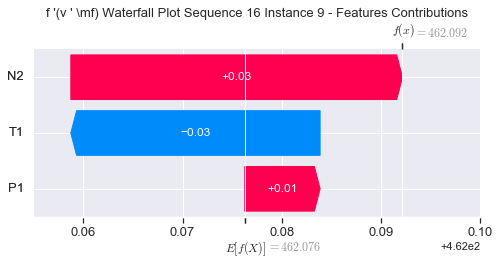

None

Contribution: [ 0.00641907 -0.01214476  0.03960757]


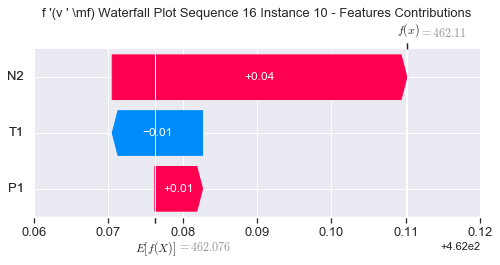

None

Contribution: [ 0.01006835 -0.04183939  0.04097742]


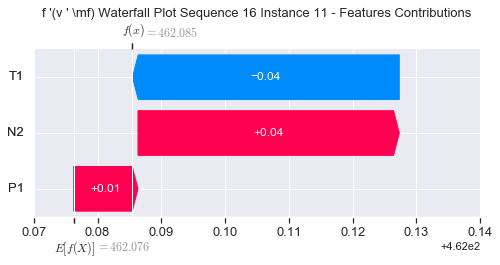

None

Contribution: [ 0.0101707  -0.03824842  0.04226404]


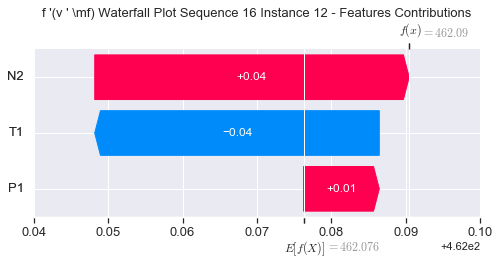

None

Contribution: [ 0.01138807 -0.03578438  0.0444792 ]


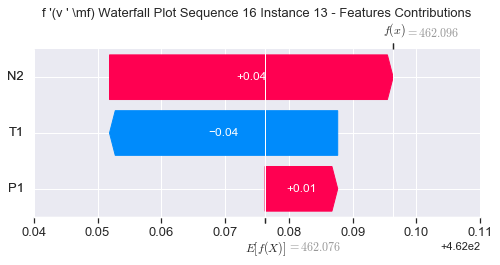

None

Contribution: [ 0.01030787 -0.04355928  0.04664745]


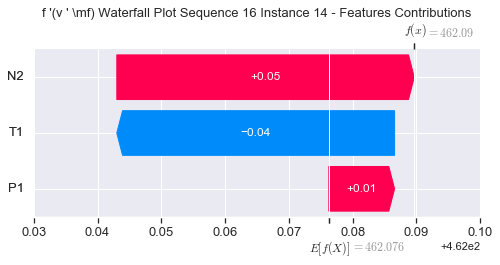

None

Contribution: [ 0.01262692 -0.05103218  0.05190562]


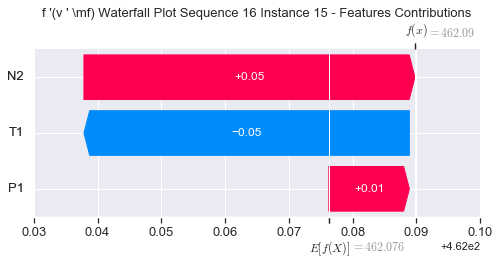

None

Contribution: [ 0.00526114 -0.06663088  0.05699371]


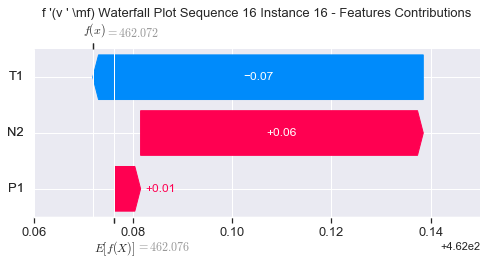

None

Contribution: [ 0.01741497 -0.05024178  0.06596119]


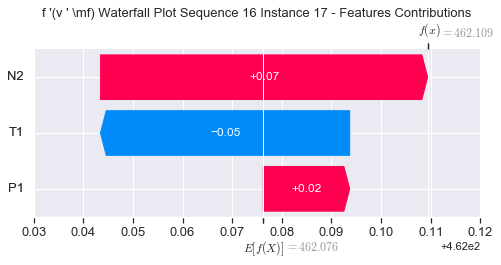

None

Contribution: [ 0.02063748 -0.05803631  0.07778281]


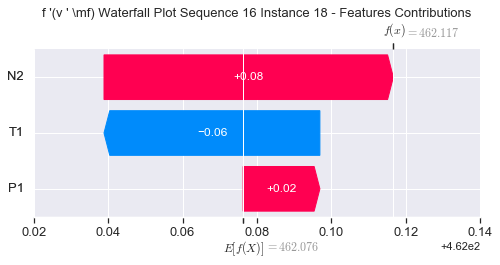

None

Contribution: [ 0.02452021 -0.07423753  0.1001613 ]


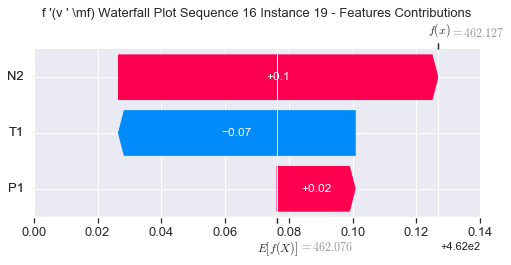

None

Contribution: [ 0.03664492 -0.15275549  0.14460226]


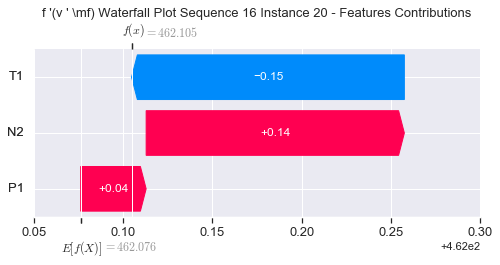

None

Contribution: [ 0.0569329  -0.26401968  0.22927751]


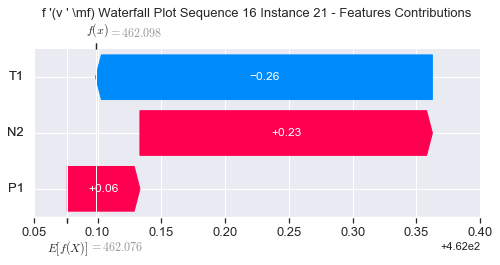

None

Contribution: [ 0.08920463 -0.87018693  0.47160813]


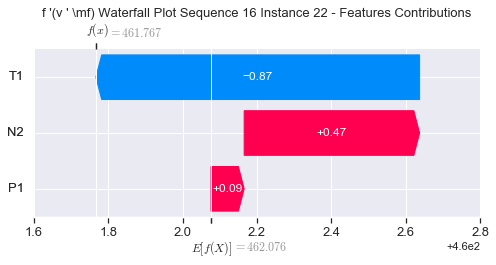

None

Contribution: [ 0.06946529 -1.06905532  0.57671002]


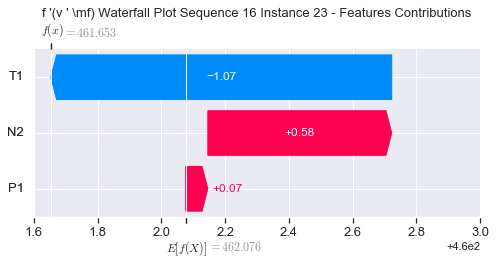

None

Contribution: [ 0.37669307 -3.02071059  1.72849   ]


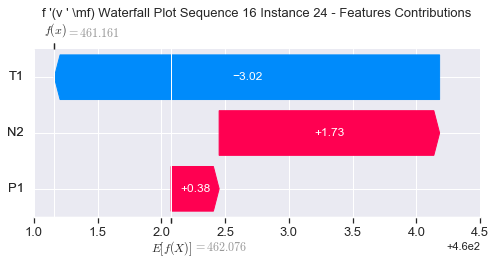

None

Contribution: [0.57770905 0.0870055  1.73389722]


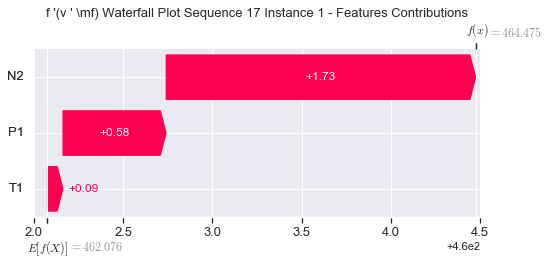

None

Contribution: [0.01311845 0.16552691 0.04699232]


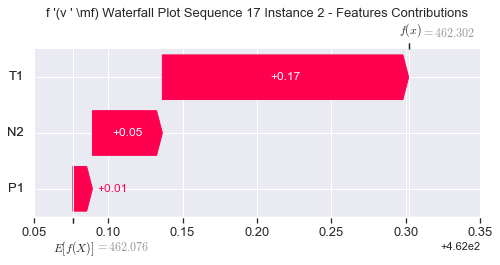

None

Contribution: [0.0313556  0.00723763 0.06287416]


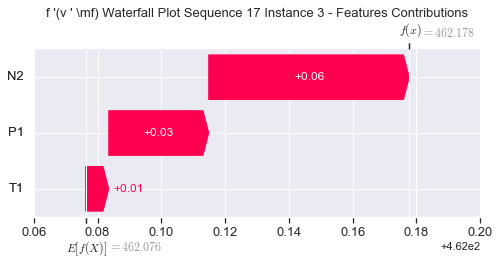

None

Contribution: [ 0.00341467 -0.01457399 -0.00709184]


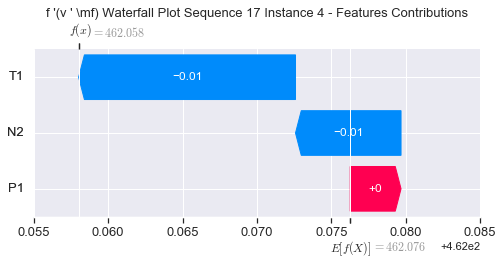

None

Contribution: [ 0.00092514 -0.02957623 -0.00753085]


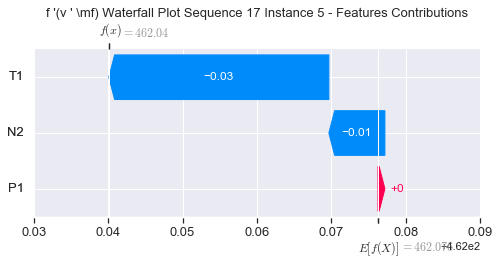

None

Contribution: [ 0.00336383 -0.03220609  0.00828679]


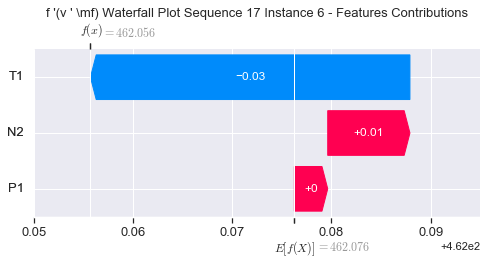

None

Contribution: [ 0.00575691 -0.0345039   0.01779902]


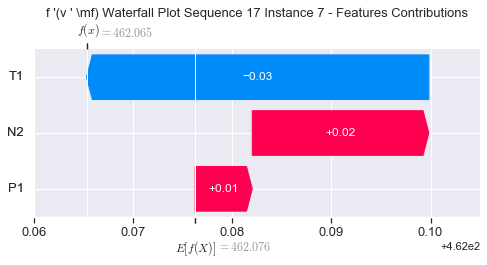

None

Contribution: [ 0.00776142 -0.03627291  0.02558744]


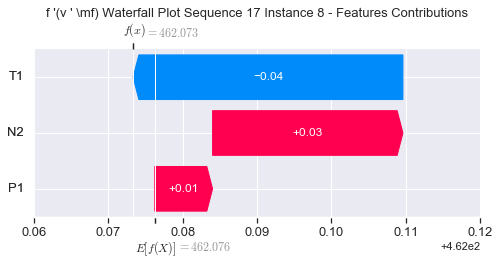

None

Contribution: [ 0.00727229 -0.03916073  0.03078704]


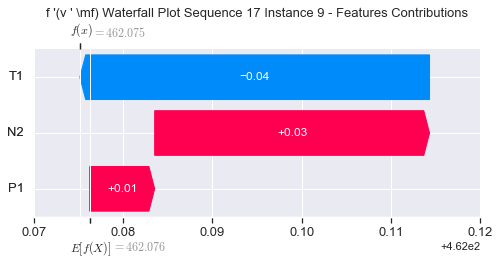

None

Contribution: [ 0.00402578 -0.03011557  0.04106757]


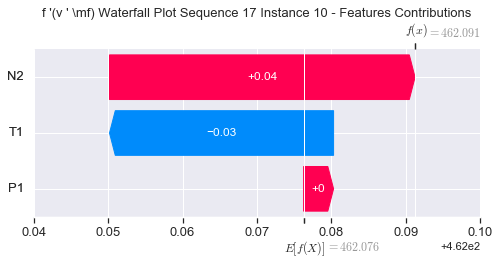

None

Contribution: [ 0.0074508  -0.04294422  0.0379442 ]


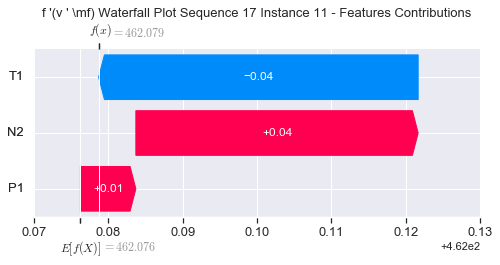

None

Contribution: [ 0.01031981 -0.05749329  0.04070246]


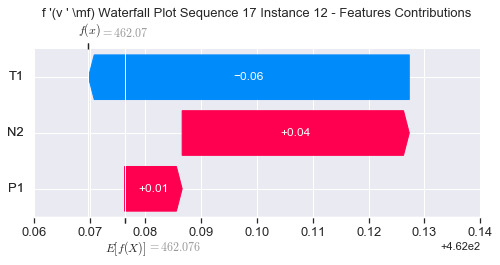

None

Contribution: [ 0.01200921 -0.05802043  0.0435452 ]


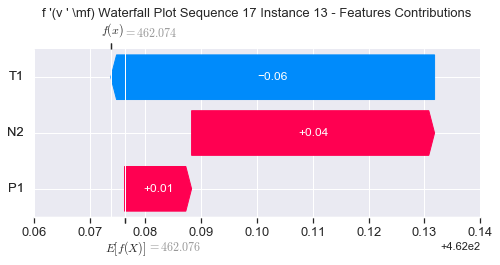

None

Contribution: [ 0.00573629 -0.0738523   0.04589282]


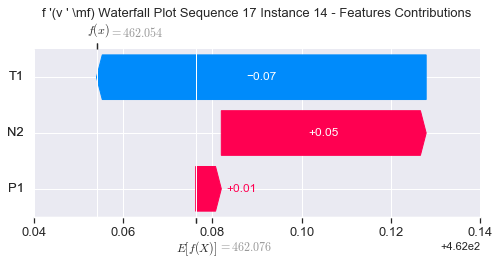

None

Contribution: [ 0.01286534 -0.07050597  0.05135017]


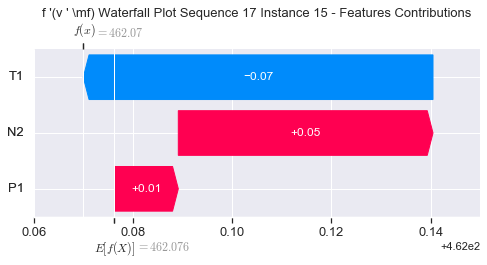

None

Contribution: [ 0.01836104 -0.06455824  0.06277021]


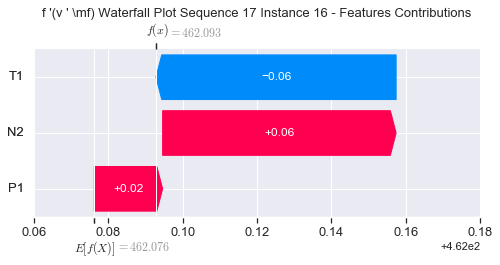

None

Contribution: [ 0.01771252 -0.0717416   0.06606715]


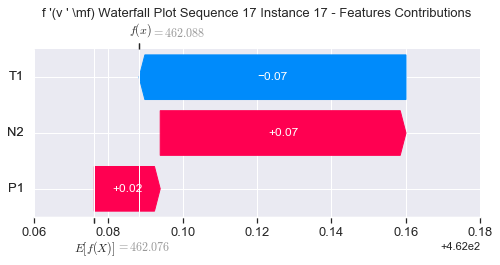

None

Contribution: [ 0.02042036 -0.0779523   0.07854754]


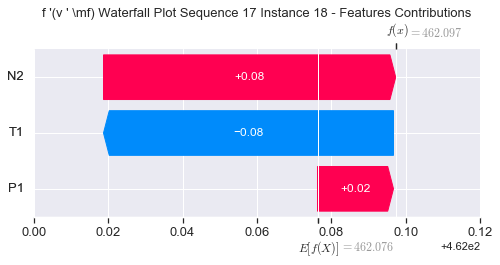

None

Contribution: [ 0.02474538 -0.07145528  0.10321813]


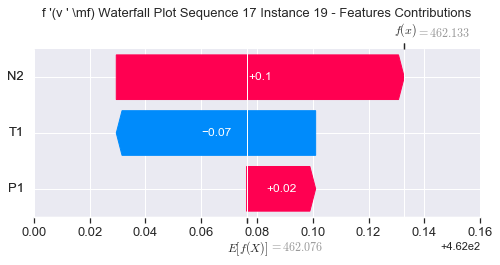

None

Contribution: [ 0.03762143 -0.18756412  0.14806074]


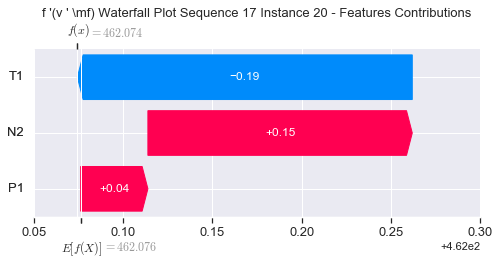

None

Contribution: [ 0.06013251 -0.31531492  0.23513387]


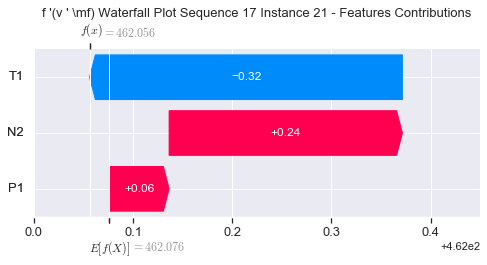

None

Contribution: [ 0.10024398 -0.98361709  0.49125904]


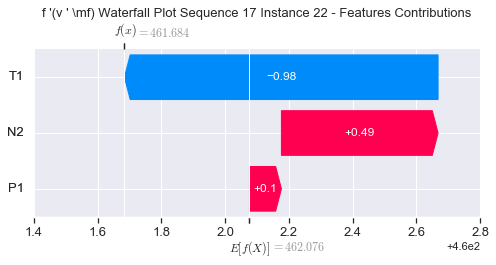

None

Contribution: [ 0.07445236 -1.17445796  0.59933016]


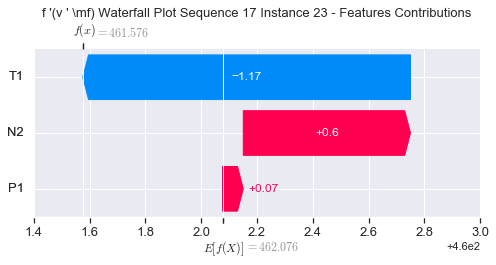

None

Contribution: [ 0.43427562 -3.44310064  1.8049369 ]


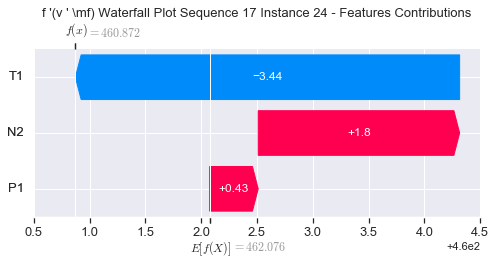

None

Contribution: [ 0.77325131 -0.66971859  1.7647129 ]


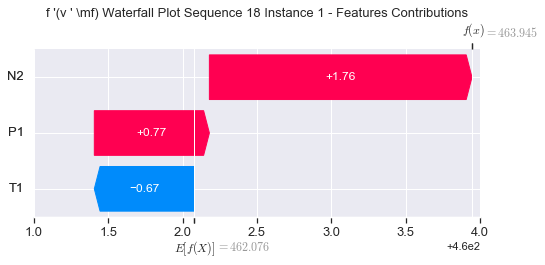

None

Contribution: [0.01063178 0.16610979 0.04638907]


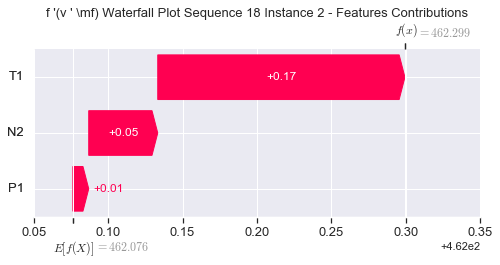

None

Contribution: [ 0.03216261 -0.00062293  0.06407425]


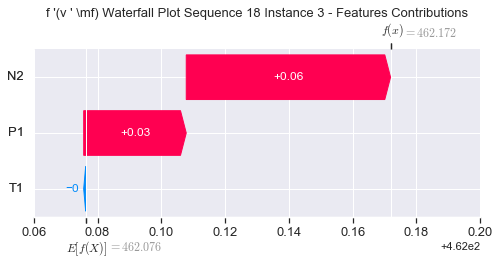

None

Contribution: [-0.00400676 -0.02880498 -0.00901297]


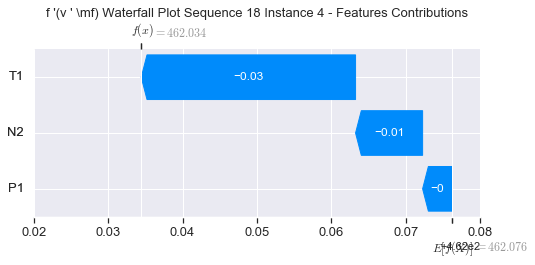

None

Contribution: [ 0.00199728 -0.0261187  -0.00400447]


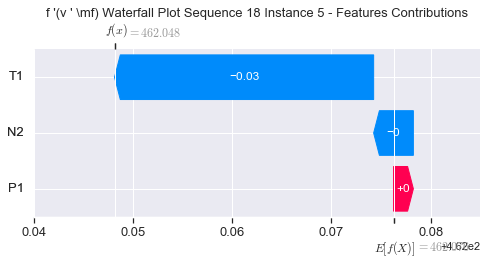

None

Contribution: [ 0.00896863 -0.02337039  0.01321366]


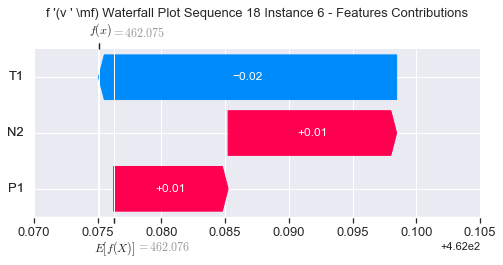

None

Contribution: [ 0.01252197 -0.02383567  0.02261909]


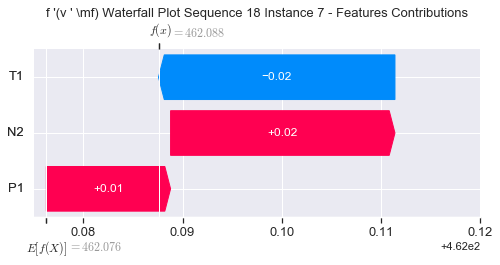

None

Contribution: [ 0.01314181 -0.02585259  0.02957274]


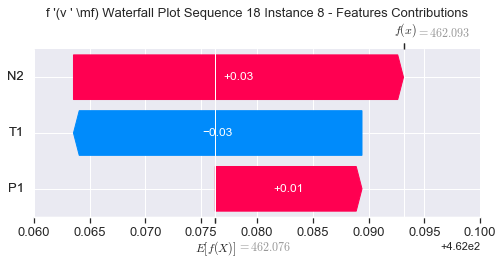

None

Contribution: [ 0.01113826 -0.02001776  0.03528896]


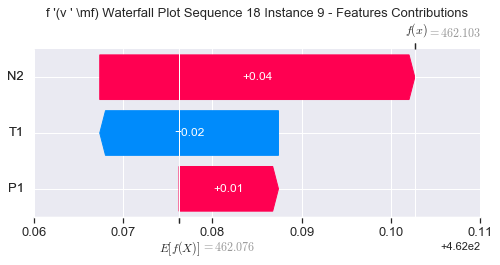

None

Contribution: [ 0.01491971 -0.02462851  0.04042759]


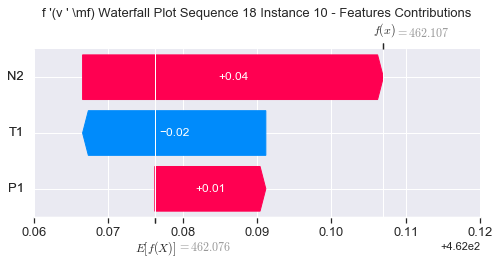

None

Contribution: [ 0.01249109 -0.02525276  0.04276835]


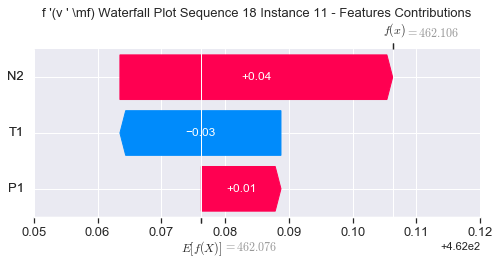

None

Contribution: [ 0.02351952 -0.0379283   0.04603347]


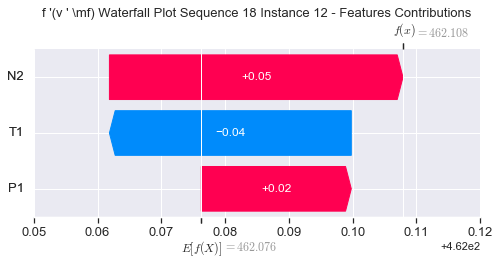

None

Contribution: [ 0.02451594 -0.03803247  0.04829245]


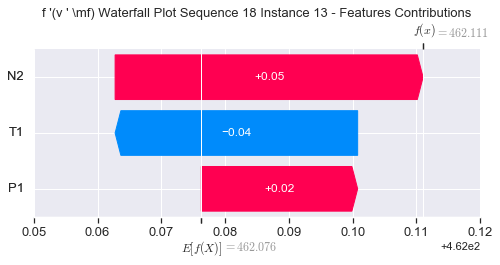

None

Contribution: [ 0.01640373 -0.03246943  0.04918693]


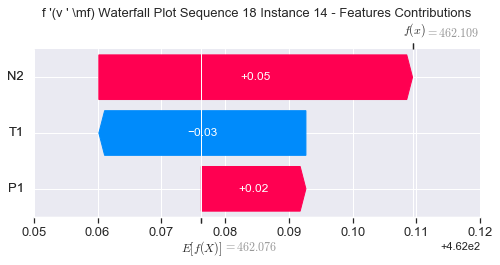

None

Contribution: [ 0.0231872  -0.05119313  0.05538814]


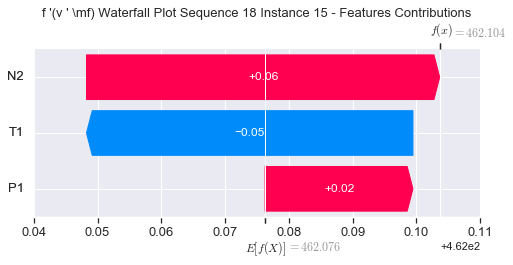

None

Contribution: [ 0.01271298 -0.04316849  0.05951193]


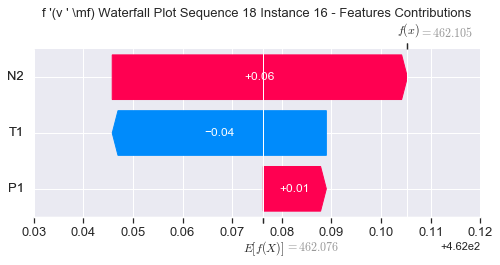

None

Contribution: [ 0.02906996 -0.05153235  0.06983609]


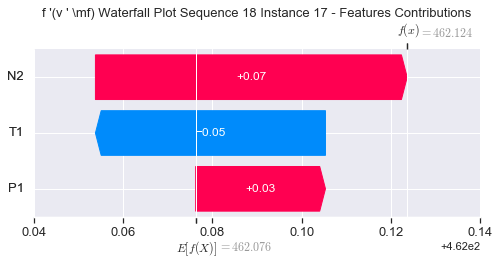

None

Contribution: [ 0.03136218 -0.05861183  0.08188314]


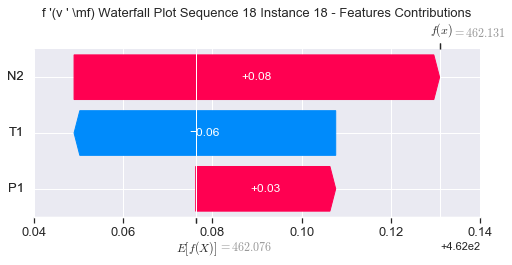

None

Contribution: [ 0.03154476 -0.06913392  0.10474548]


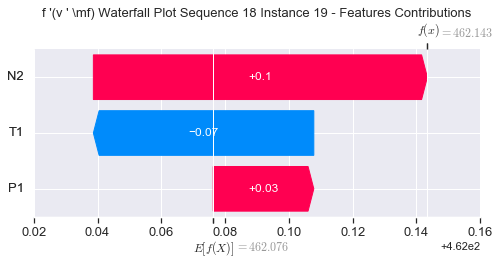

None

Contribution: [ 0.04867417 -0.16149749  0.15046148]


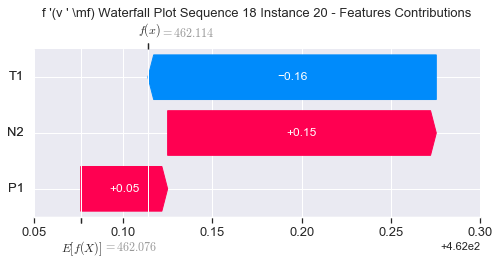

None

Contribution: [ 0.07681418 -0.27164265  0.23739934]


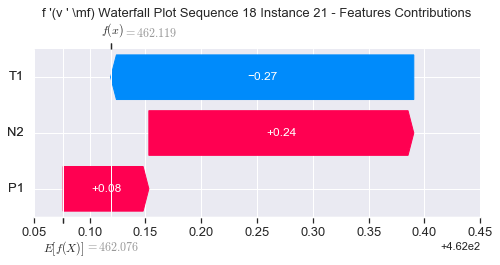

None

Contribution: [ 0.13304052 -0.88222579  0.49242988]


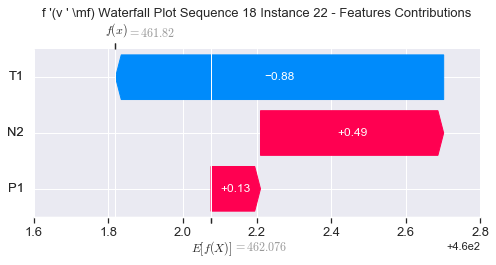

None

Contribution: [ 0.12913687 -1.03956143  0.60368711]


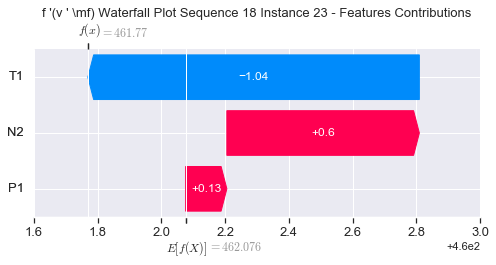

None

Contribution: [ 0.49199442 -3.17291195  1.78822019]


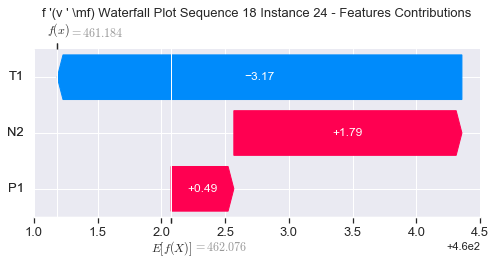

None

Contribution: [ 0.85003094 -0.14963614  1.75369109]


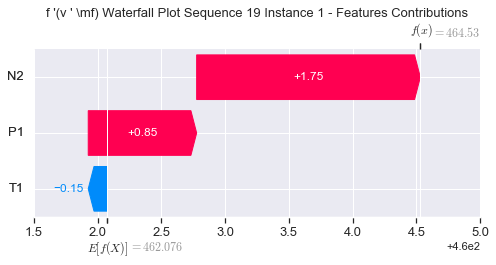

None

Contribution: [0.00813314 0.16556003 0.04623263]


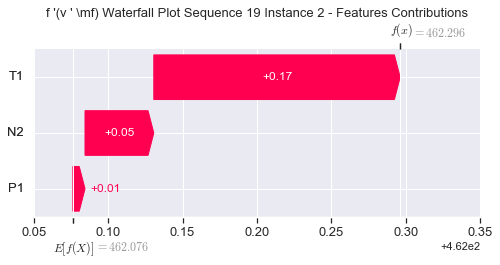

None

Contribution: [0.02397672 0.0117509  0.06021655]


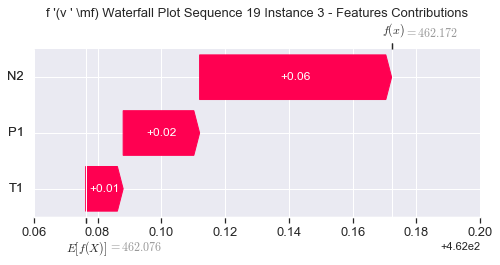

None

Contribution: [ 0.00070418 -0.01640744 -0.00839773]


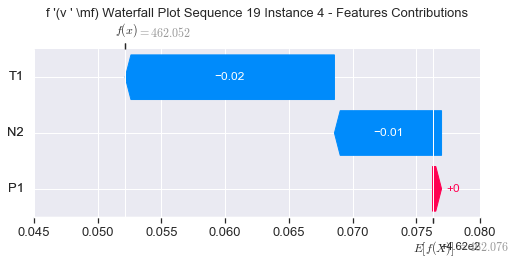

None

Contribution: [ 0.00401423 -0.02082985 -0.00510743]


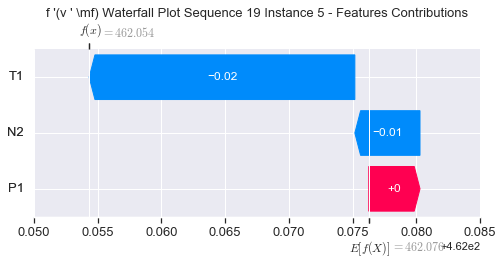

None

Contribution: [ 0.00659729 -0.02425658  0.00935313]


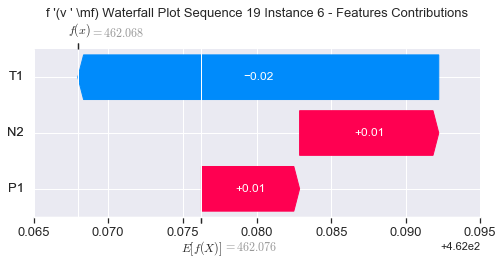

None

Contribution: [ 0.01012672 -0.02415347  0.01929543]


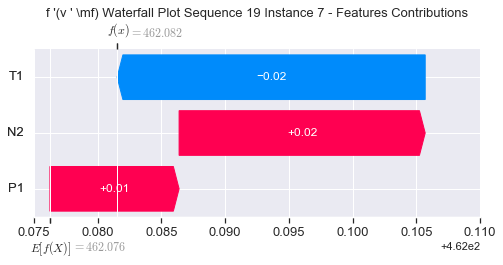

None

Contribution: [ 0.01159383 -0.02739846  0.02697084]


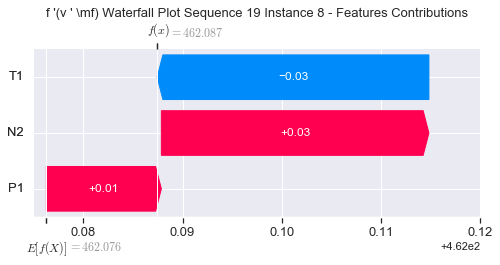

None

Contribution: [ 0.01132941 -0.02411428  0.03535206]


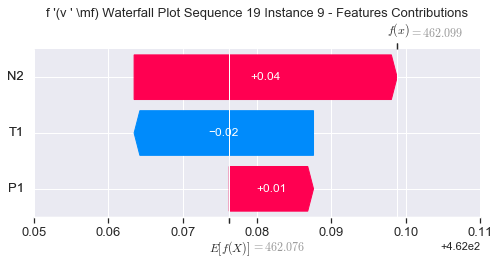

None

Contribution: [ 0.01180602 -0.02395529  0.04001242]


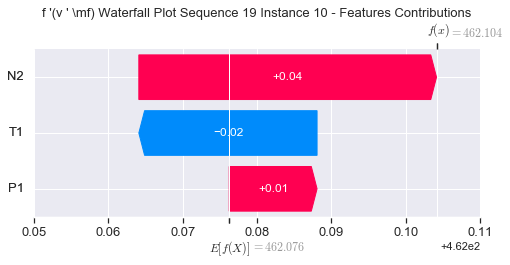

None

Contribution: [ 0.00910806 -0.03881808  0.04071064]


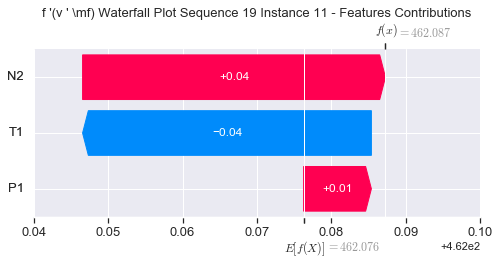

None

Contribution: [ 0.01524297 -0.0487513   0.04088687]


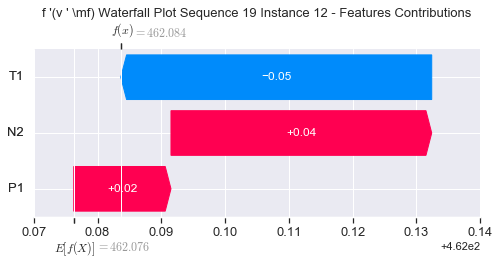

None

Contribution: [ 0.01785074 -0.0466961   0.04360772]


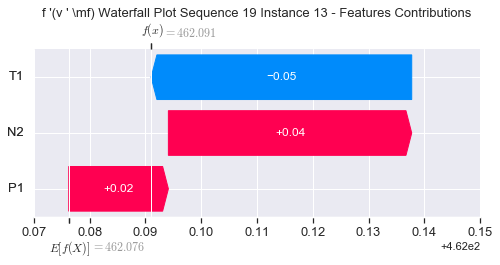

None

Contribution: [ 0.02148902 -0.04815881  0.05116395]


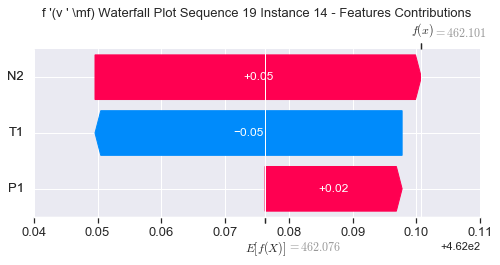

None

Contribution: [ 0.01941284 -0.06004818  0.05060142]


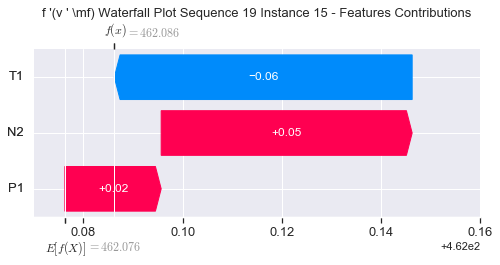

None

Contribution: [ 0.01544597 -0.05136408  0.05933312]


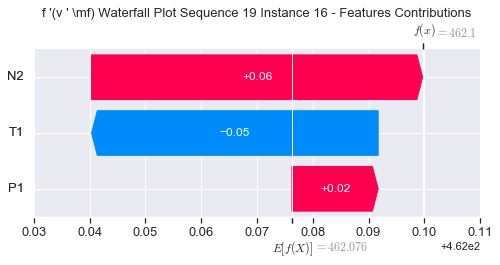

None

Contribution: [ 0.02615981 -0.05862899  0.06476357]


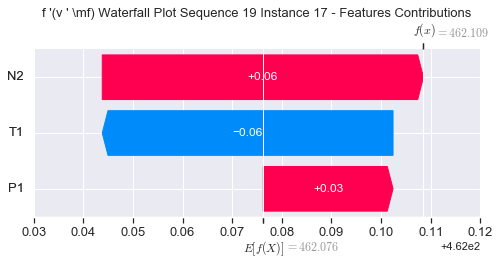

None

Contribution: [ 0.02924239 -0.06644152  0.07651047]


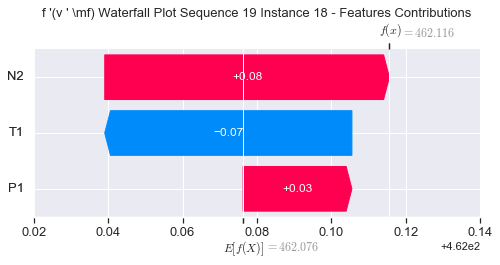

None

Contribution: [ 0.02388008 -0.07394706  0.09804686]


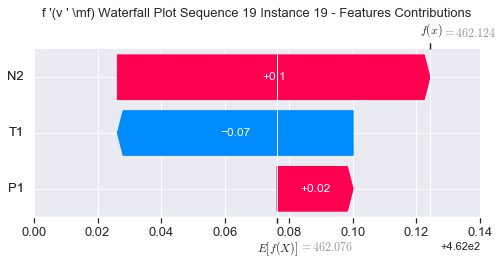

None

Contribution: [ 0.05508222 -0.1651708   0.14379106]


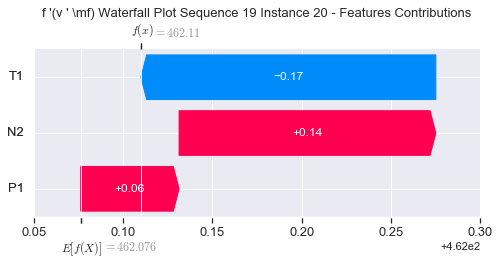

None

Contribution: [ 0.08714428 -0.28207837  0.2276834 ]


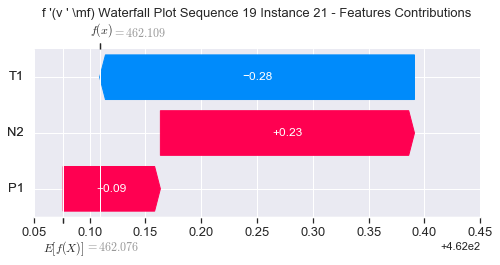

None

Contribution: [ 0.17084823 -0.91838202  0.46627438]


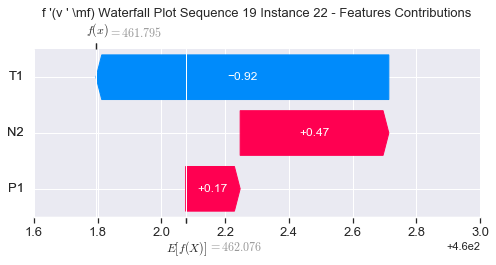

None

Contribution: [ 0.15924829 -1.11651016  0.56148089]


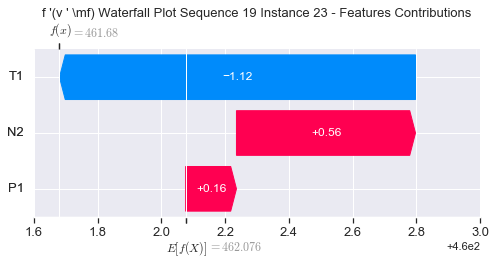

None

Contribution: [ 0.49751505 -3.38823794  1.62049949]


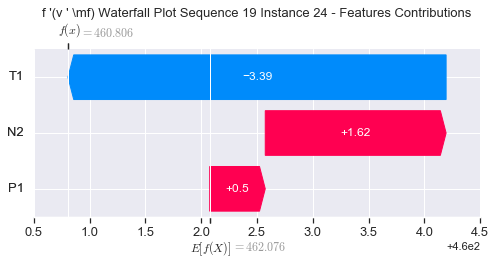

None

Contribution: [ 0.38890955 -1.0024845   1.45356246]


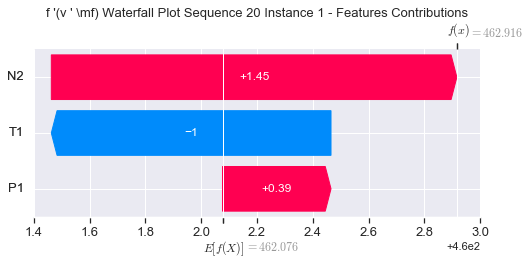

None

Contribution: [0.00656105 0.15258491 0.04819228]


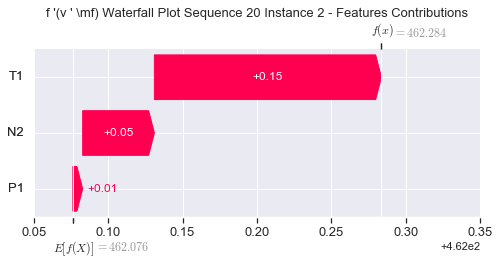

None

Contribution: [ 0.03256951 -0.00705309  0.05875483]


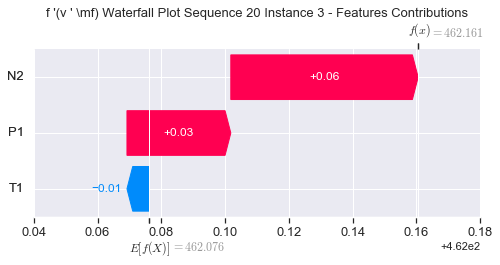

None

Contribution: [-0.00261607 -0.0192463  -0.00960952]


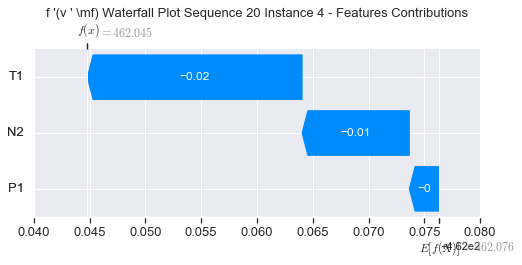

None

Contribution: [ 0.00893132 -0.01775292 -0.0017011 ]


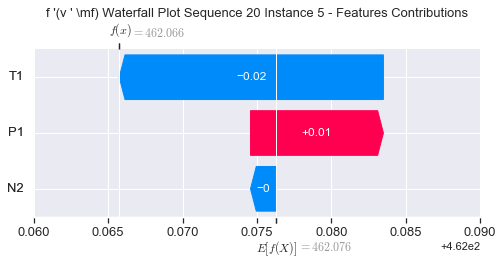

None

Contribution: [ 0.00817732 -0.02446479  0.01198712]


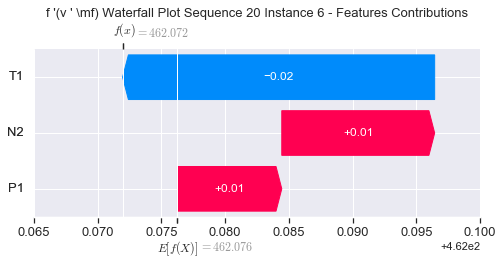

None

Contribution: [ 0.01115326 -0.02481188  0.02150787]


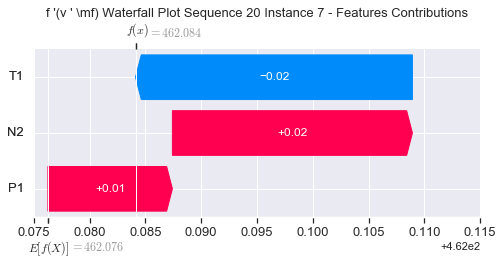

None

Contribution: [ 0.01238991 -0.02795865  0.02783027]


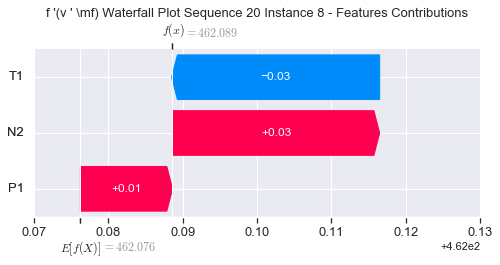

None

Contribution: [ 0.00815543 -0.0312736   0.035077  ]


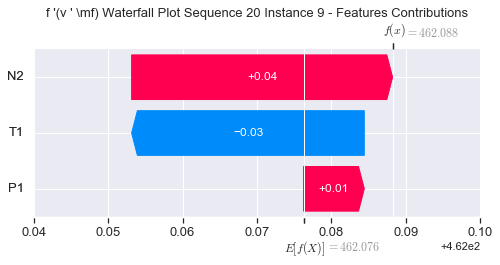

None

Contribution: [ 0.01546492 -0.04885773  0.0378255 ]


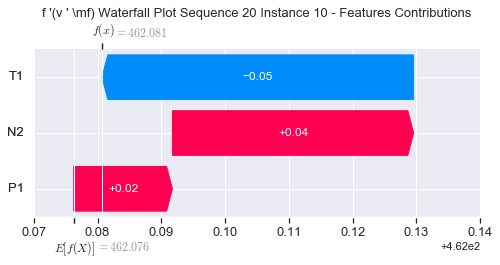

None

Contribution: [ 0.00617854 -0.03999602  0.0377606 ]


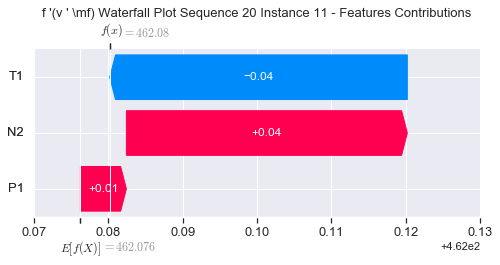

None

Contribution: [ 0.01766203 -0.03902422  0.04152974]


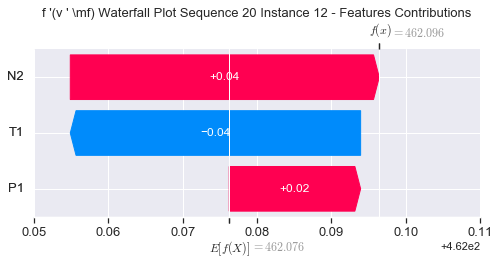

None

Contribution: [ 0.02030903 -0.03813673  0.04464791]


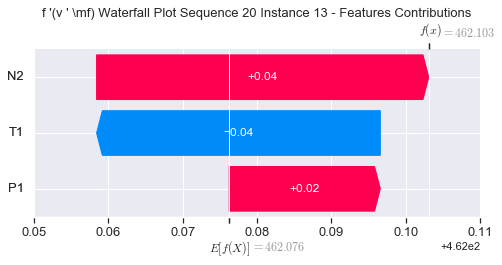

None

Contribution: [ 0.01948065 -0.03818099  0.04838336]


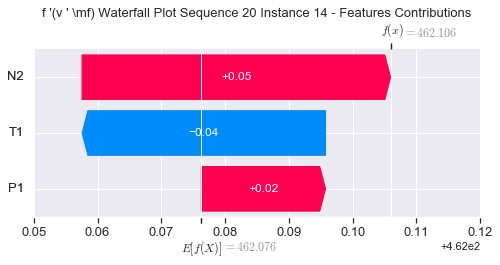

None

Contribution: [ 0.02045189 -0.05253663  0.05190535]


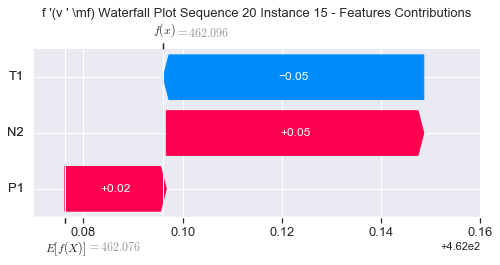

None

Contribution: [ 0.01699536 -0.0634199   0.06195672]


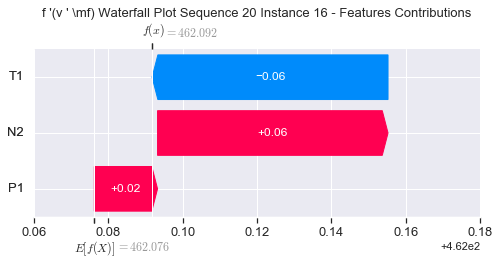

None

Contribution: [ 0.02678587 -0.05454682  0.06713226]


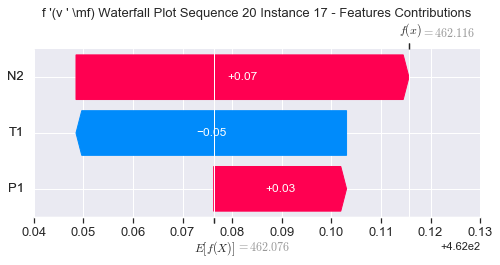

None

Contribution: [ 0.02963043 -0.06251054  0.07864509]


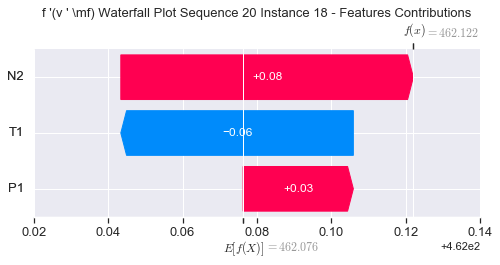

None

Contribution: [ 0.0328562  -0.06916355  0.102937  ]


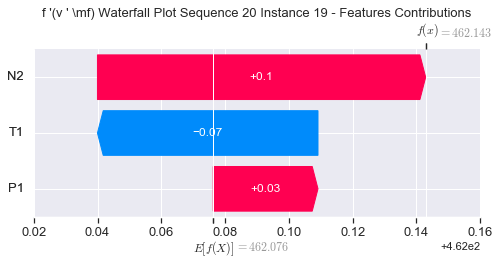

None

Contribution: [ 0.05566372 -0.15933848  0.14774219]


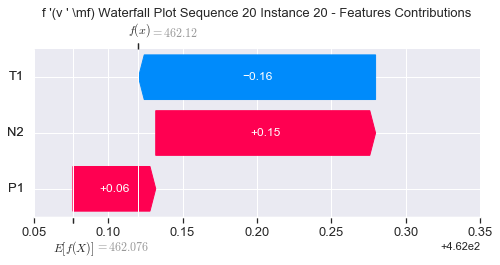

None

Contribution: [ 0.08930426 -0.26075269  0.23171629]


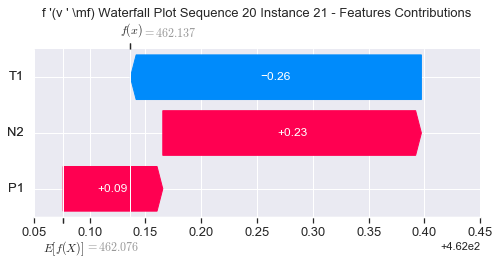

None

Contribution: [ 0.18223907 -0.8330469   0.47342375]


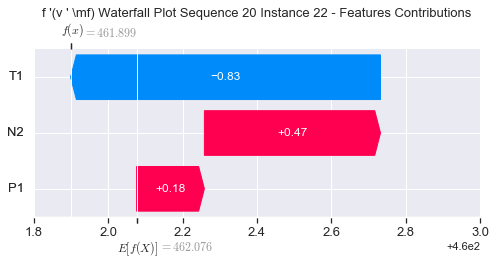

None

Contribution: [ 0.16795609 -1.02360261  0.56796143]


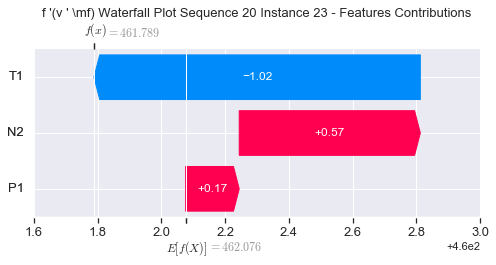

None

Contribution: [ 0.6174429  -3.11557311  1.66077252]


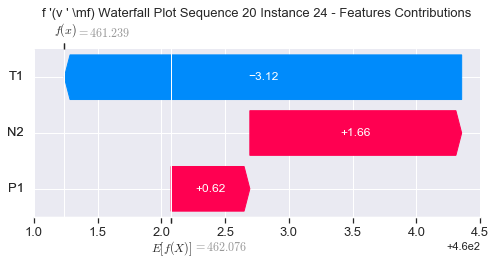

None

Contribution: [ 0.71453554 -0.26301642  1.53926969]


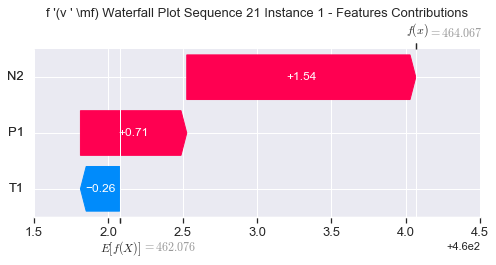

None

Contribution: [0.00398204 0.15704088 0.04652458]


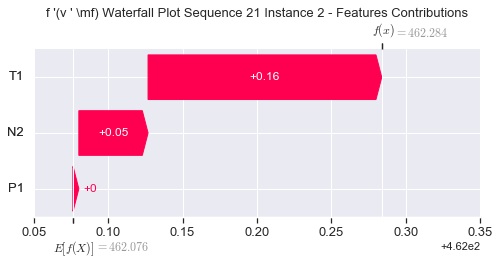

None

Contribution: [0.0356417  0.03475024 0.05970317]


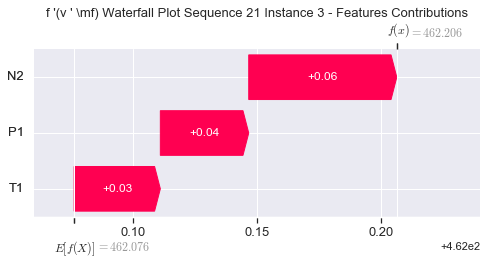

None

Contribution: [ 0.00554431  0.00569994 -0.01138841]


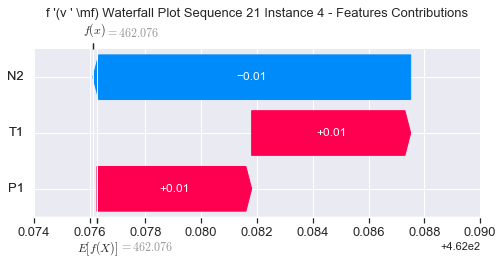

None

Contribution: [ 0.0058365  -0.01327073 -0.00694276]


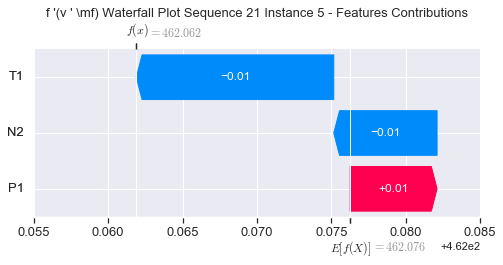

None

Contribution: [ 0.01296833 -0.01218931  0.01045583]


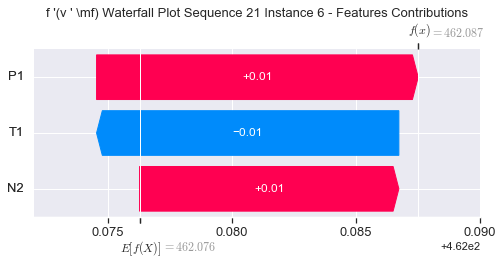

None

Contribution: [ 0.01415505 -0.01473974  0.01966757]


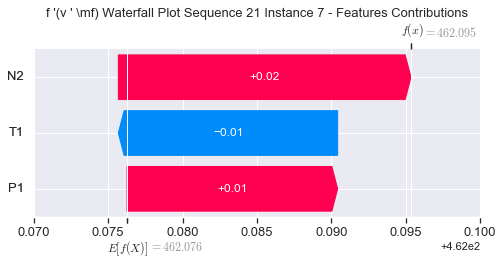

None

Contribution: [ 0.01634826 -0.0191954   0.02744871]


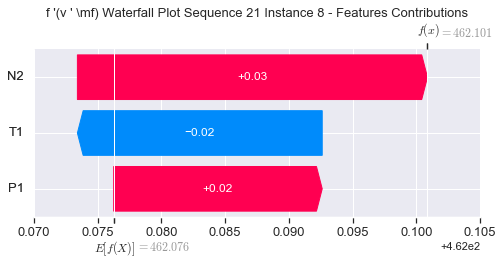

None

Contribution: [ 0.01545752 -0.02425176  0.03387491]


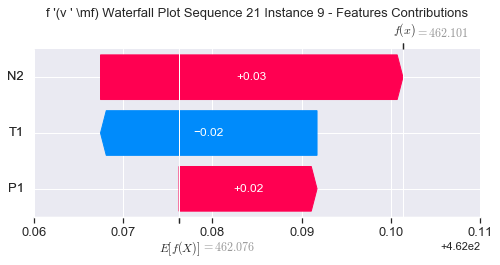

None

Contribution: [ 0.00055803 -0.0240616   0.03777185]


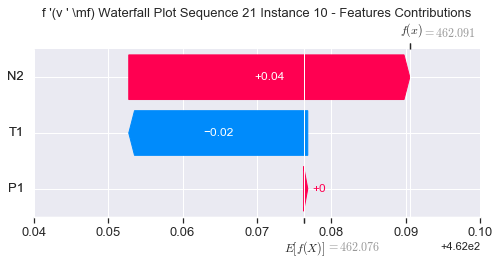

None

Contribution: [ 0.01961732 -0.03158984  0.04210894]


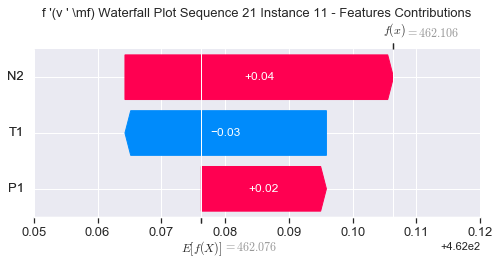

None

Contribution: [ 0.01622354 -0.04532188  0.04248005]


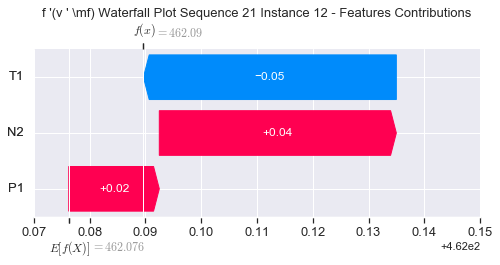

None

Contribution: [ 0.01766386 -0.04566913  0.04495426]


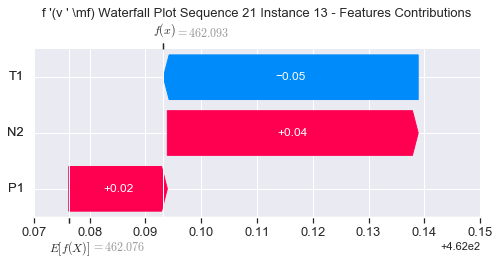

None

Contribution: [ 0.02620061 -0.05031375  0.05101315]


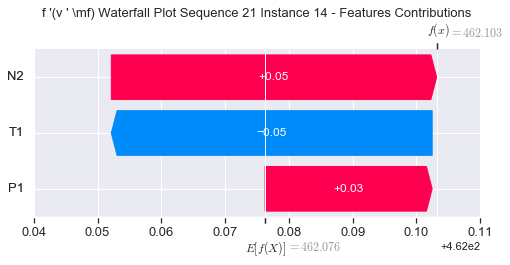

None

Contribution: [ 0.02117315 -0.05945555  0.05331732]


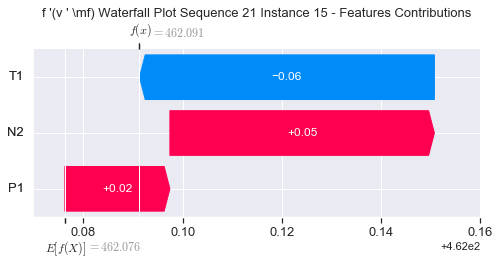

None

Contribution: [ 0.01936127 -0.05571917  0.06254234]


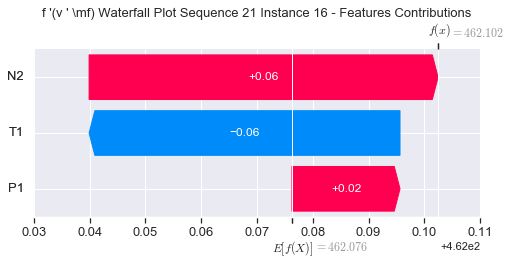

None

Contribution: [ 0.02668086 -0.06249515  0.06806235]


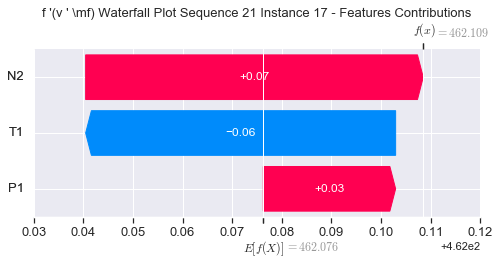

None

Contribution: [ 0.03107248 -0.07066462  0.08080514]


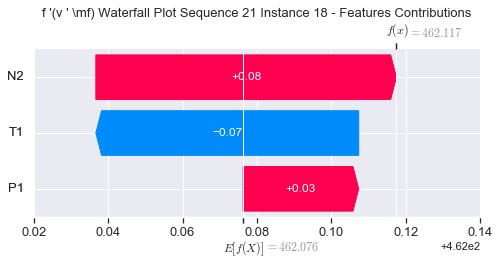

None

Contribution: [ 0.03488352 -0.08448003  0.10514551]


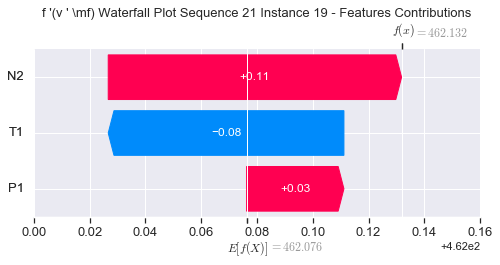

None

Contribution: [ 0.05542844 -0.18427734  0.15102954]


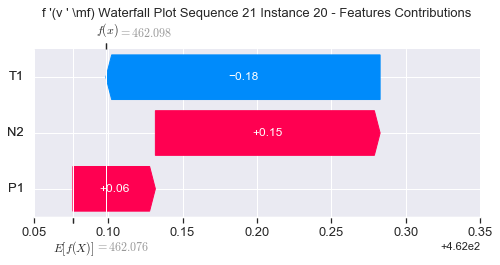

None

Contribution: [ 0.08495035 -0.31904678  0.23905611]


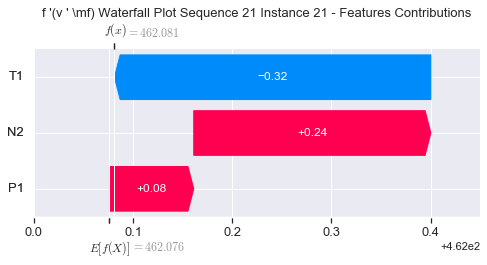

None

Contribution: [ 0.16524778 -1.03761369  0.50227089]


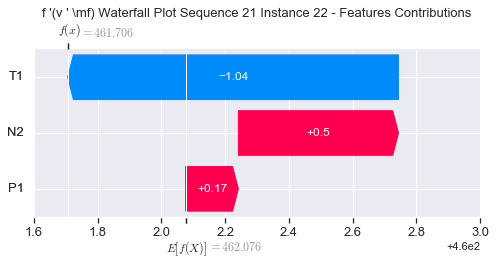

None

Contribution: [ 0.17219976 -1.24649326  0.61737278]


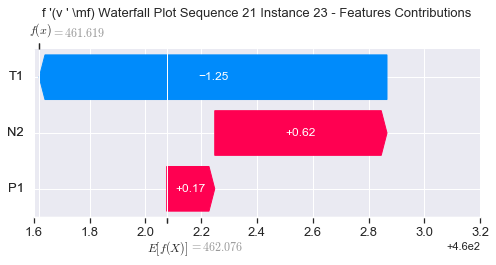

None

Contribution: [ 0.49445502 -3.80788033  1.77853032]


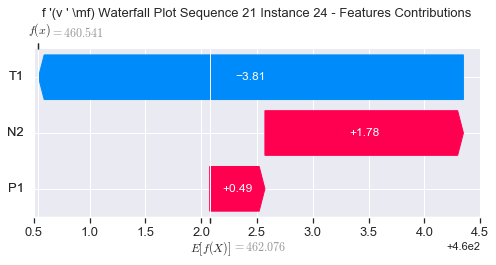

None

Contribution: [ 0.17476256 -1.71716855  1.558424  ]


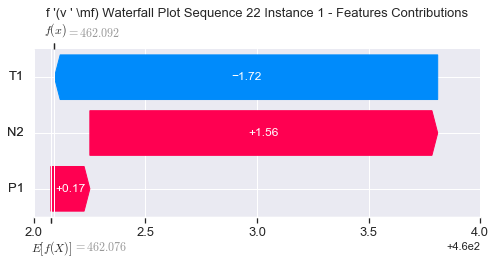

None

Contribution: [0.0096611  0.15380694 0.04866783]


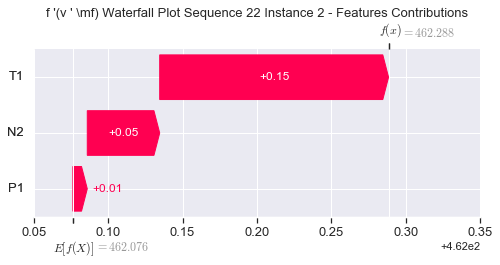

None

Contribution: [ 0.03349971 -0.03859905  0.06432477]


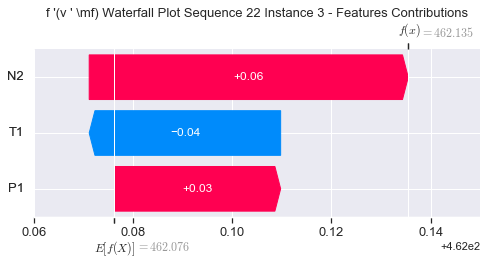

None

Contribution: [ 0.00714039 -0.05041311 -0.00241554]


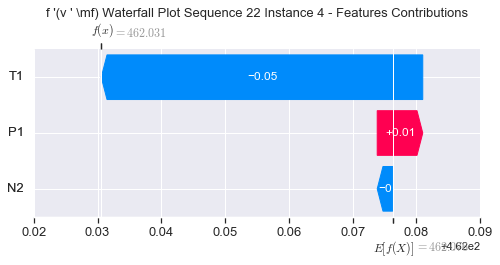

None

Contribution: [ 0.00667007 -0.05939108 -0.00243151]


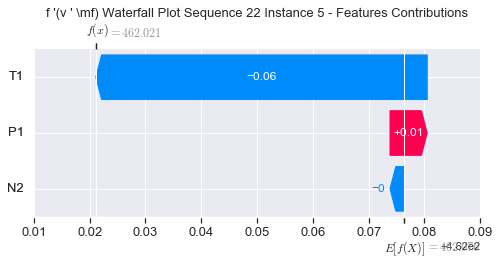

None

Contribution: [ 0.00975165 -0.0534502   0.01139392]


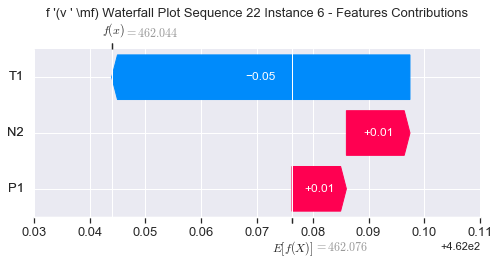

None

Contribution: [ 0.01302532 -0.0531832   0.0195191 ]


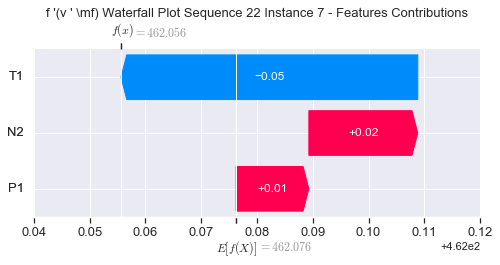

None

Contribution: [ 0.01358887 -0.05180723  0.02601534]


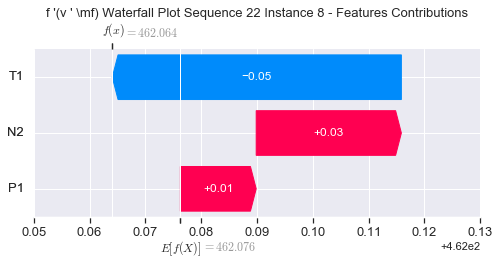

None

Contribution: [ 0.01013308 -0.05065859  0.0292184 ]


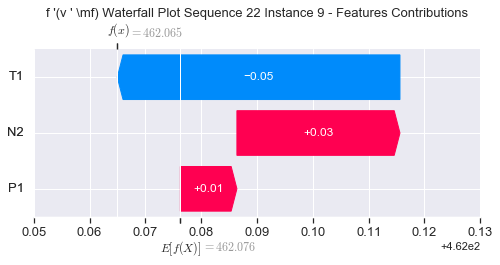

None

Contribution: [ 0.01236513 -0.04113555  0.03660312]


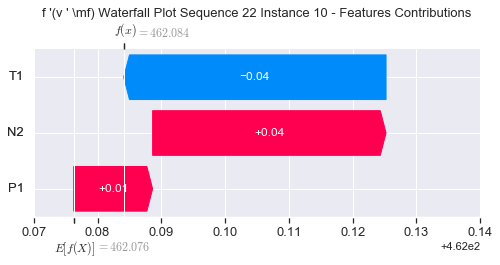

None

Contribution: [ 0.00625539 -0.04551238  0.03434973]


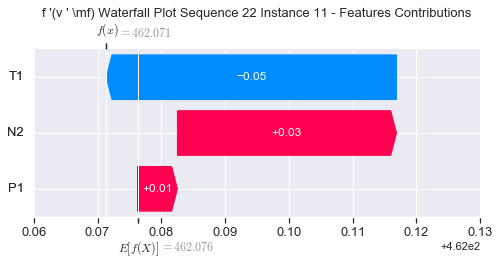

None

Contribution: [ 0.01579265 -0.0557859   0.04026216]


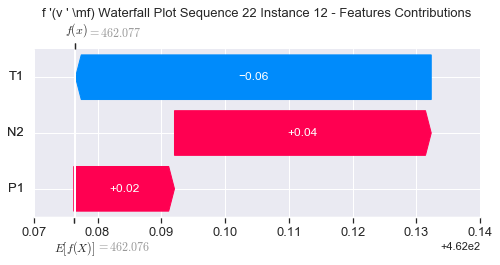

None

Contribution: [ 0.01891244 -0.05613394  0.04326384]


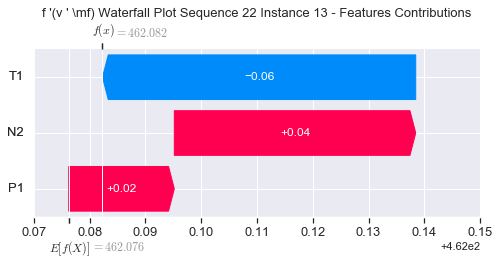

None

Contribution: [ 0.01801527 -0.05684173  0.04826848]


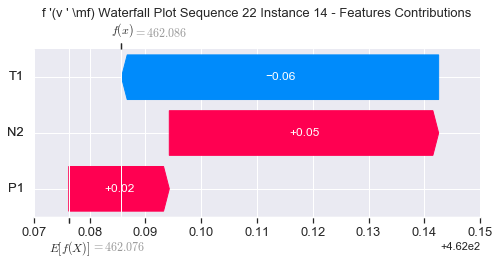

None

Contribution: [ 0.02069268 -0.0677112   0.05125082]


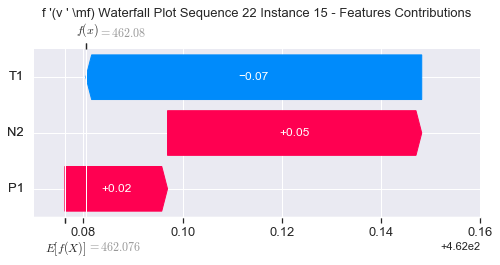

None

Contribution: [ 0.02152771 -0.06636294  0.06312688]


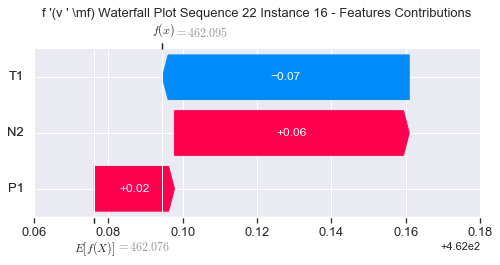

None

Contribution: [ 0.02872814 -0.06328198  0.06686765]


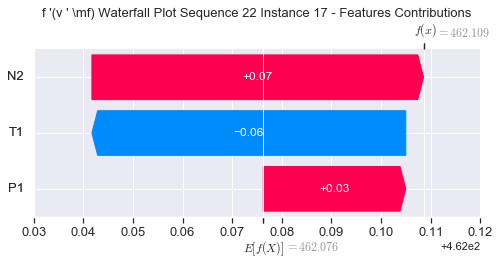

None

Contribution: [ 0.03225386 -0.06606792  0.0796689 ]


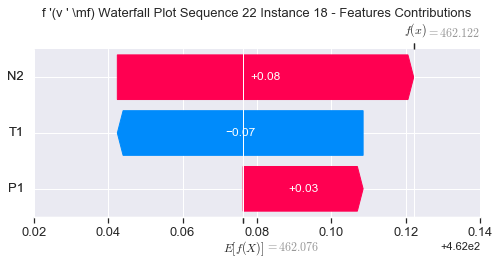

None

Contribution: [ 0.02515455 -0.07592644  0.10240039]


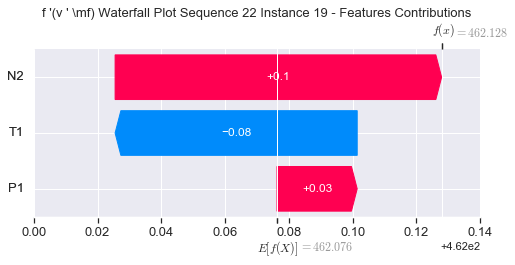

None

Contribution: [ 0.0610077  -0.15907978  0.14951331]


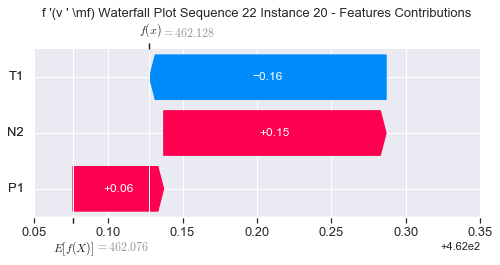

None

Contribution: [ 0.0933431  -0.2540284   0.23474838]


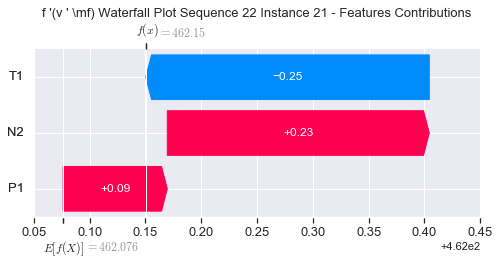

None

Contribution: [ 0.18171064 -0.79972158  0.48925615]


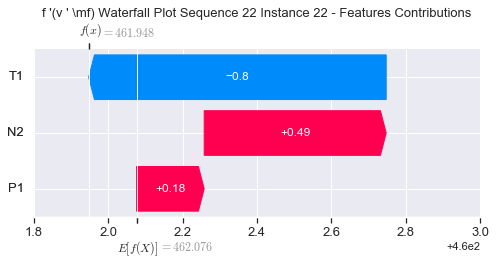

None

Contribution: [ 0.17626506 -0.89298175  0.59136924]


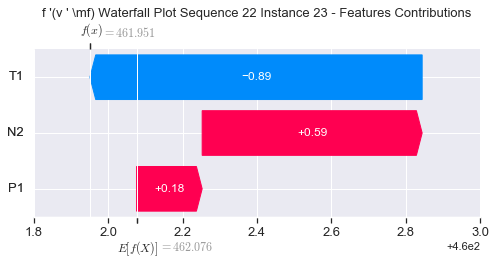

None

Contribution: [ 0.55066377 -2.88293386  1.78560921]


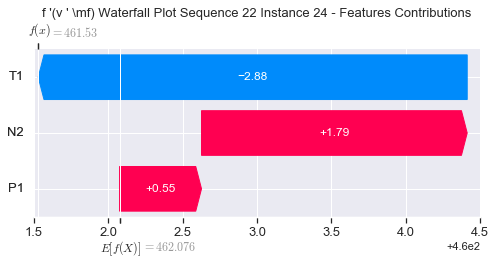

None

Contribution: [ 0.40970182 -0.53193549  1.70465945]


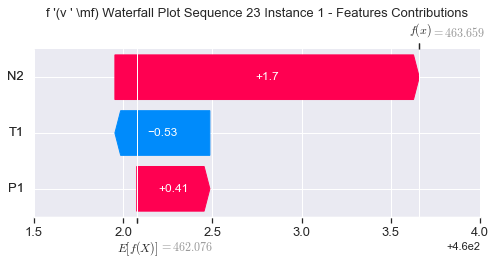

None

Contribution: [0.00663544 0.14709647 0.04674419]


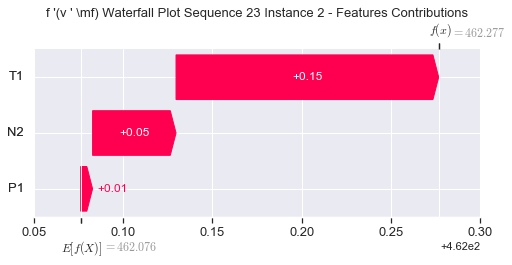

None

Contribution: [ 0.02447294 -0.01929705  0.06127374]


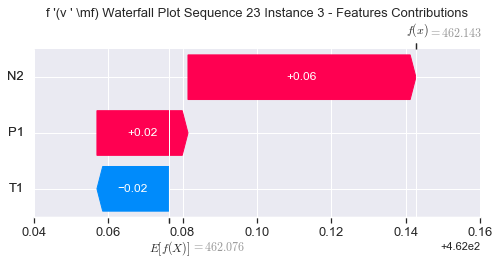

None

Contribution: [-0.00779932 -0.03370118 -0.00975884]


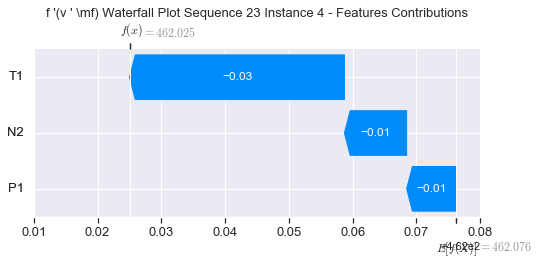

None

Contribution: [ 0.00555481 -0.03335764 -0.00309291]


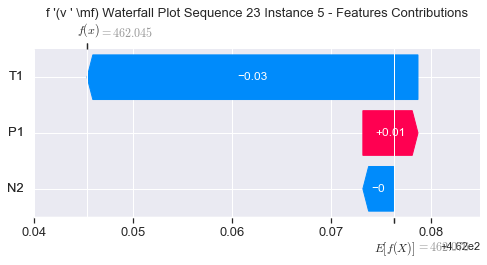

None

Contribution: [ 0.0116214  -0.02948325  0.0127086 ]


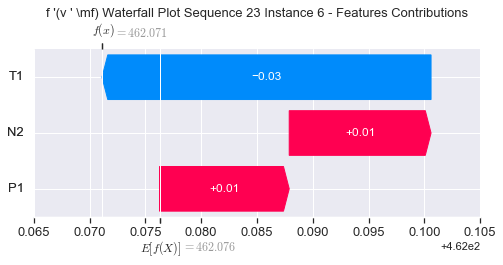

None

Contribution: [ 0.01427735 -0.0293199   0.02197727]


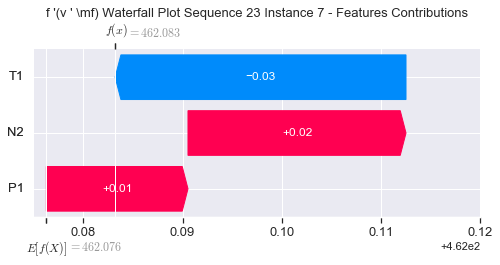

None

Contribution: [ 0.01538069 -0.03200944  0.02906352]


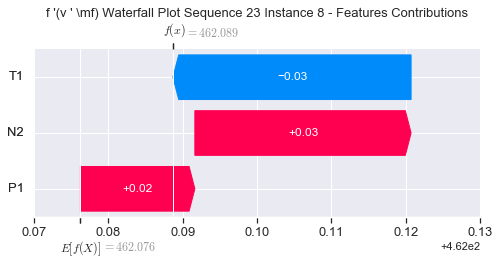

None

Contribution: [ 0.01520378 -0.03034868  0.03651161]


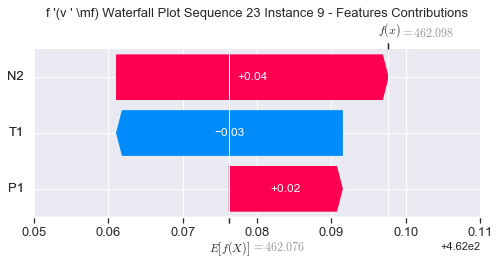

None

Contribution: [ 0.01728541 -0.02969549  0.04192293]


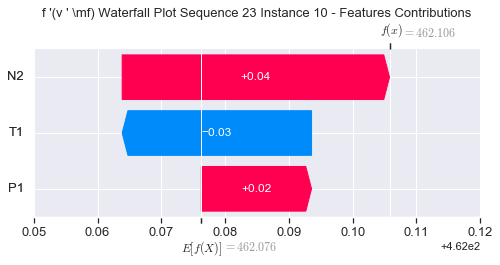

None

Contribution: [ 0.01490184 -0.0374039   0.04216202]


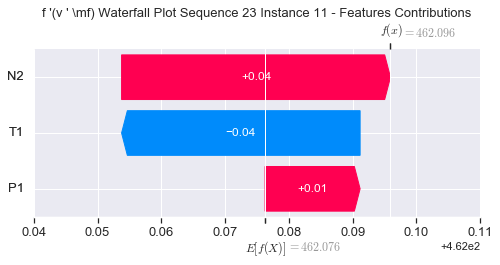

None

Contribution: [ 0.0192673  -0.04599042  0.04374717]


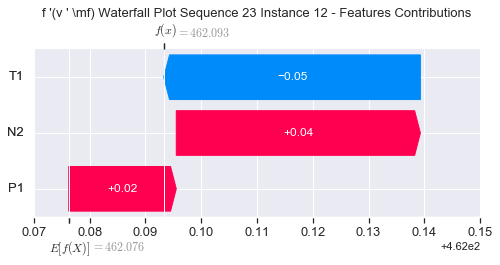

None

Contribution: [ 0.02125597 -0.04551048  0.04654072]


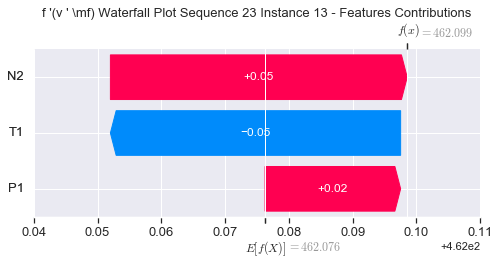

None

Contribution: [ 0.02239778 -0.04600852  0.05242116]


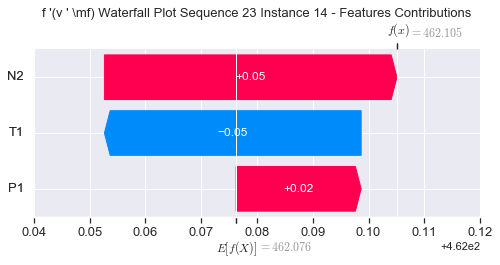

None

Contribution: [ 0.02238099 -0.05730025  0.05434564]


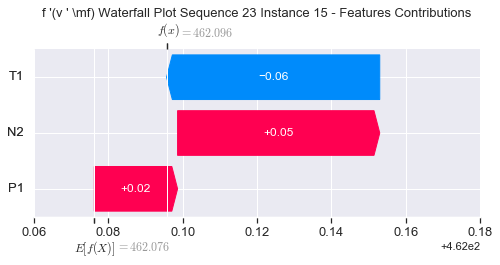

None

Contribution: [ 0.01207364 -0.05965342  0.06111416]


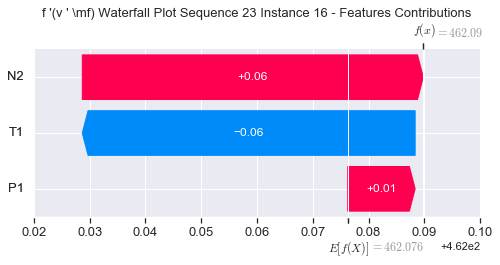

None

Contribution: [ 0.02909666 -0.05596033  0.06926392]


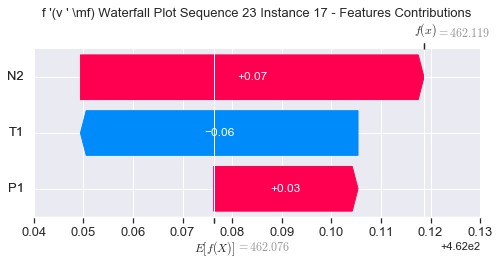

None

Contribution: [ 0.03239117 -0.0622138   0.08139555]


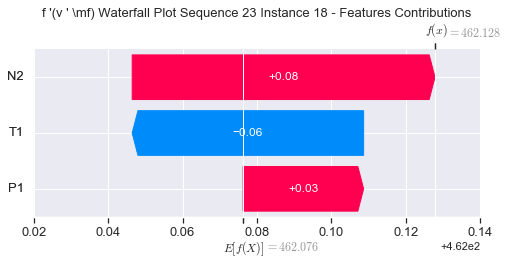

None

Contribution: [ 0.03205019 -0.07586085  0.10116135]


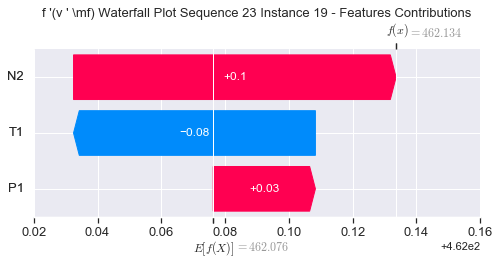

None

Contribution: [ 0.05622414 -0.16188581  0.15169758]


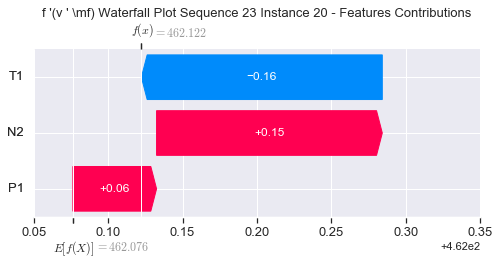

None

Contribution: [ 0.08668603 -0.2721567   0.23896937]


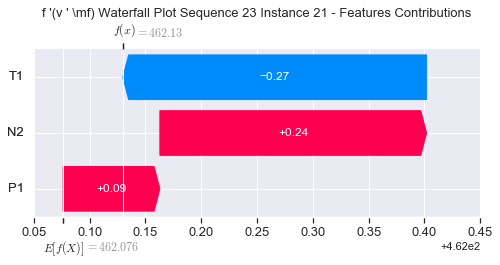

None

Contribution: [ 0.16263993 -0.88319098  0.49811453]


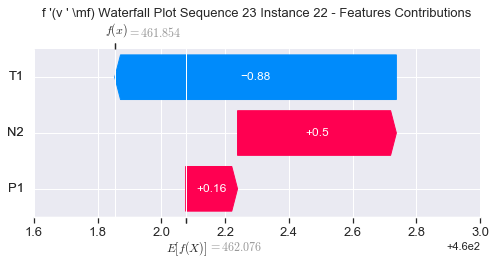

None

Contribution: [ 0.16157051 -1.03672841  0.60421364]


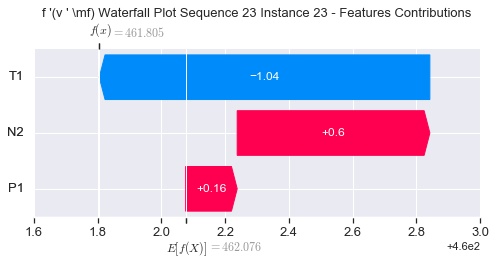

None

Contribution: [ 0.66276696 -3.16719833  1.81700337]


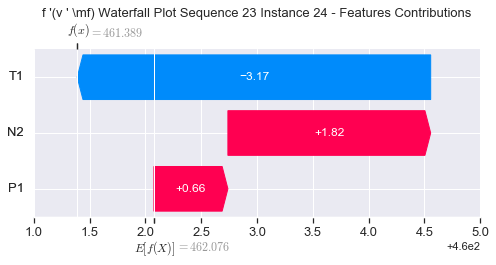

None

Contribution: [ 0.95923706 -0.28291977  1.78703659]


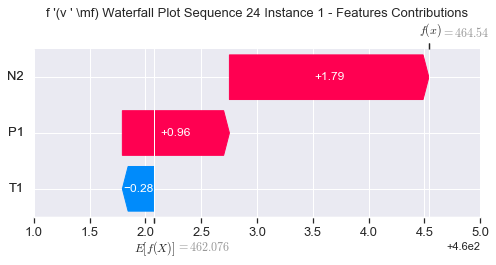

None

Contribution: [0.00801773 0.16567158 0.04592547]


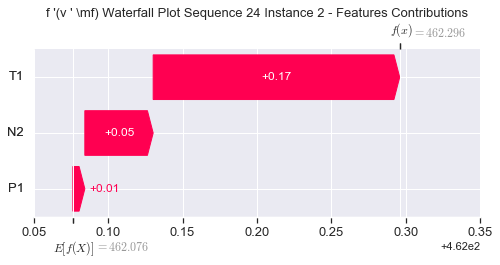

None

Contribution: [0.03551732 0.00936922 0.06465229]


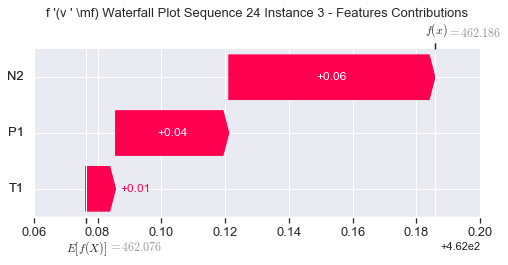

None

Contribution: [ 0.00955806 -0.02410069 -0.00807344]


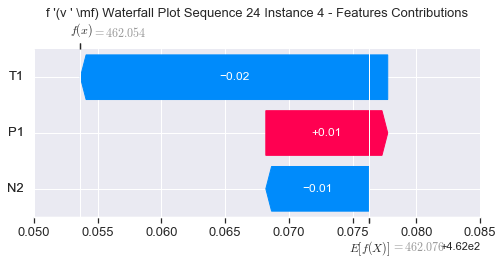

None

Contribution: [ 0.00742617 -0.03306573 -0.00562075]


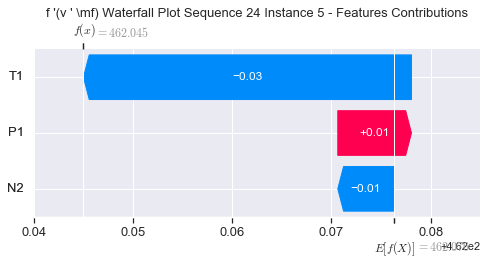

None

Contribution: [ 0.01121808 -0.03279838  0.01130748]


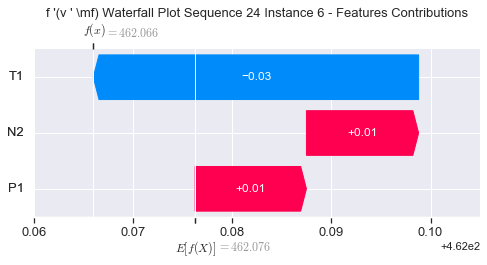

None

Contribution: [ 0.0141825  -0.03267764  0.02138957]


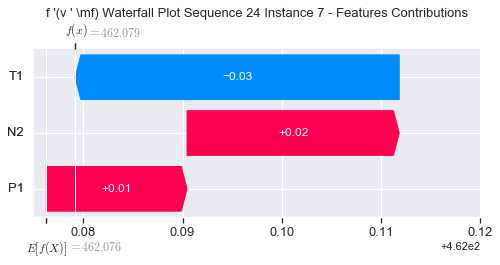

None

Contribution: [ 0.01534819 -0.03394364  0.0286083 ]


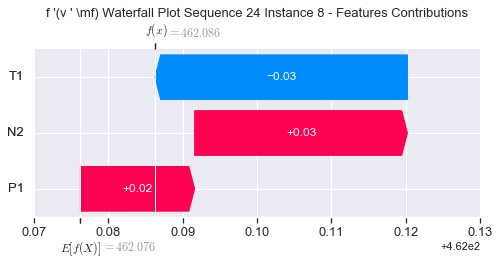

None

Contribution: [ 0.01134808 -0.03363295  0.03428928]


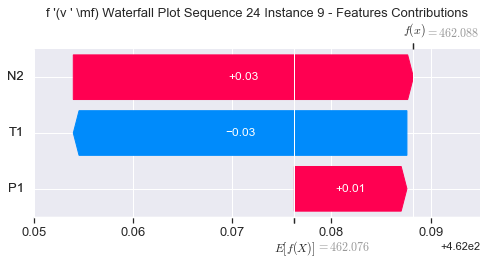

None

Contribution: [ 0.0139364  -0.04026222  0.04068429]


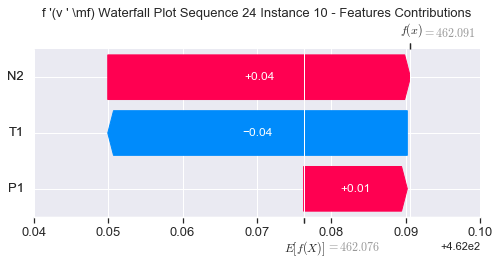

None

Contribution: [ 0.01254579 -0.0432387   0.04073784]


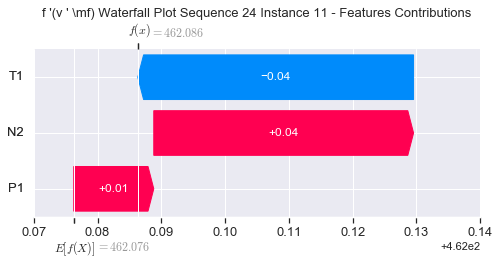

None

Contribution: [ 0.02174347 -0.0532075   0.04462076]


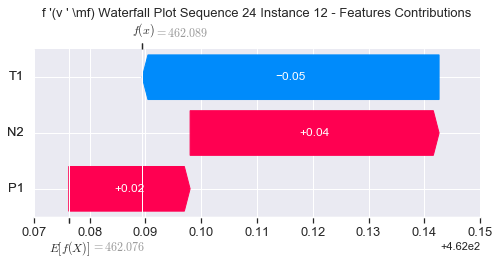

None

Contribution: [ 0.02369453 -0.0504568   0.04742598]


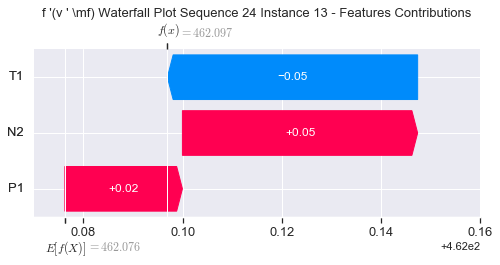

None

Contribution: [ 0.01958419 -0.05840857  0.04872383]


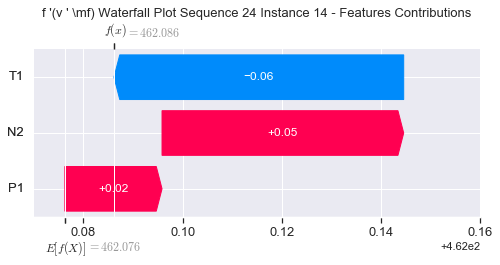

None

Contribution: [ 0.02542757 -0.05769008  0.05553119]


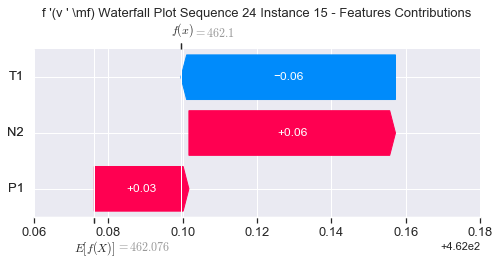

None

Contribution: [ 0.01365764 -0.07073918  0.05932869]


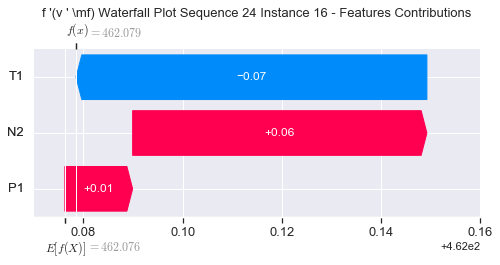

None

Contribution: [ 0.03103565 -0.05070331  0.07013667]


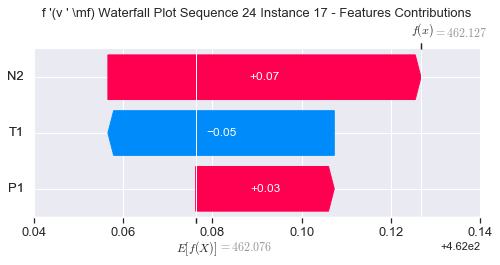

None

Contribution: [ 0.03414395 -0.05274959  0.08200805]


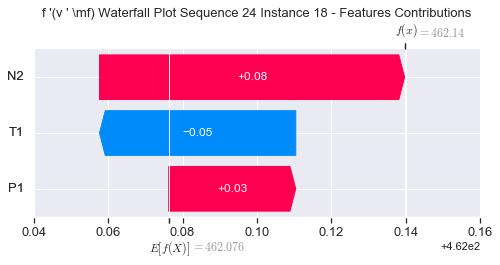

None

Contribution: [ 0.0316279  -0.05474962  0.10943114]


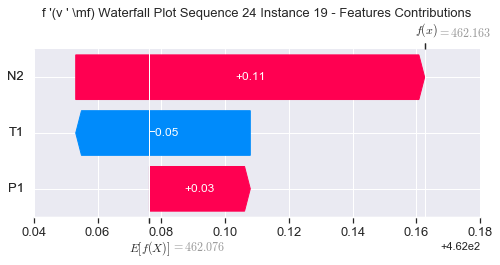

None

Contribution: [ 0.06021397 -0.12459005  0.15256623]


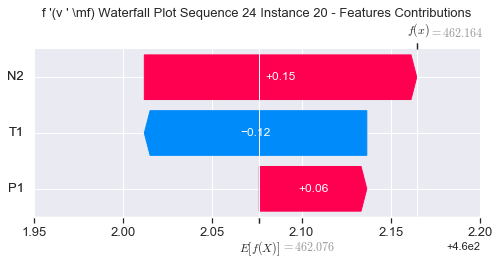

None

Contribution: [ 0.09558078 -0.21141465  0.24019598]


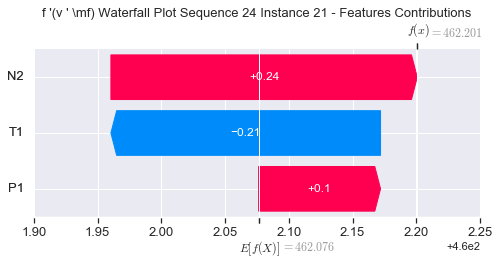

None

Contribution: [ 0.19957841 -0.6815781   0.50465111]


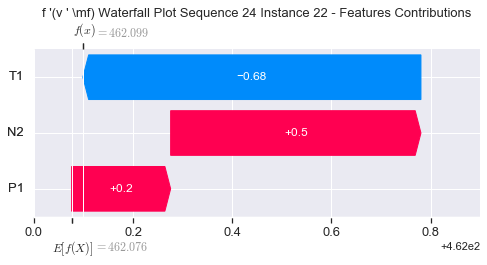

None

Contribution: [ 0.20011224 -0.78271948  0.6152202 ]


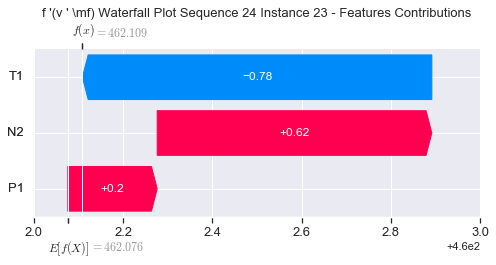

None

Contribution: [ 0.67412086 -2.28550972  1.80158042]


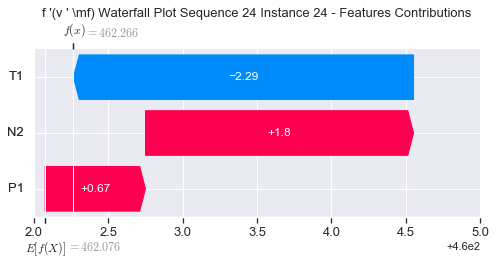

None

Contribution: [0.72377016 0.36237267 1.67841745]


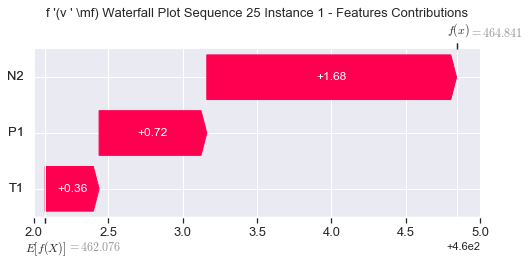

None

Contribution: [0.00392339 0.15706849 0.04502939]


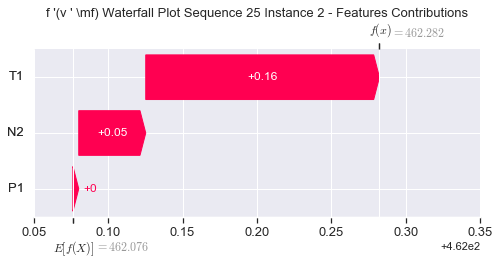

None

Contribution: [0.0397001  0.02630825 0.06510142]


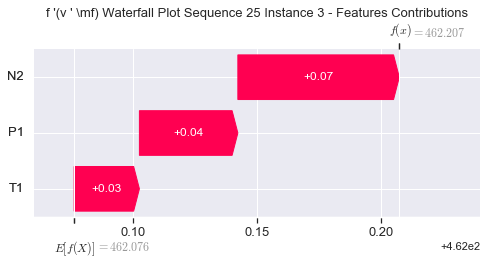

None

Contribution: [-0.00344829 -0.01500175 -0.01238274]


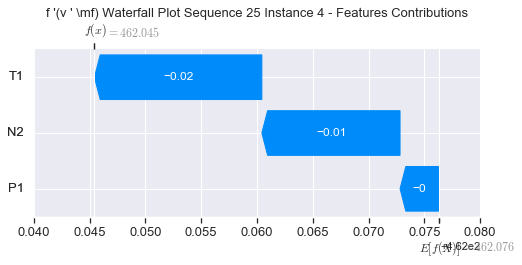

None

Contribution: [ 0.00245175 -0.0107889  -0.00892752]


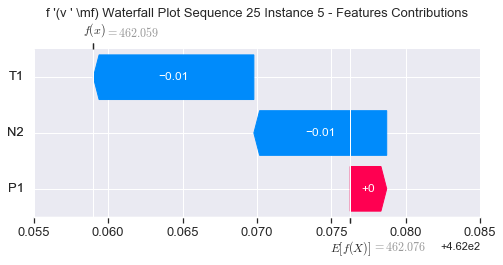

None

Contribution: [ 0.00600182 -0.01522511  0.00831966]


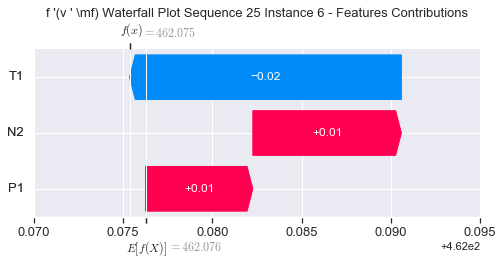

None

Contribution: [ 0.00859281 -0.01806529  0.01872824]


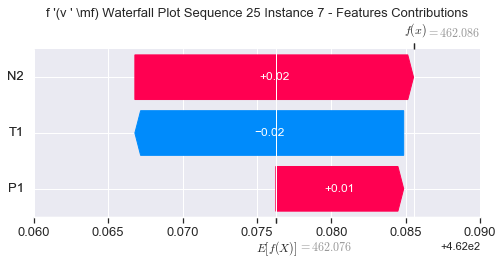

None

Contribution: [ 0.01132409 -0.0177864   0.02684817]


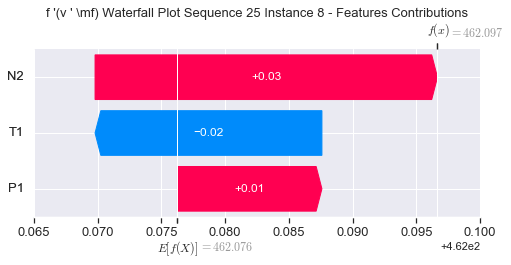

None

Contribution: [ 0.01412433 -0.01764128  0.03602555]


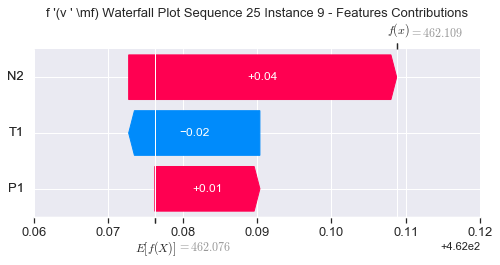

None

Contribution: [ 0.00041066 -0.02876137  0.0375776 ]


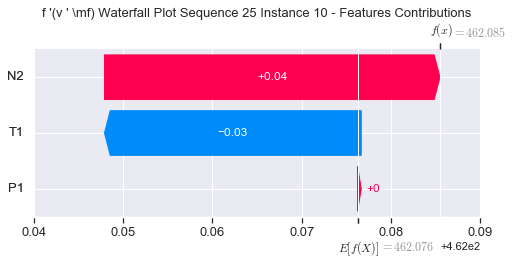

None

Contribution: [ 0.01667367 -0.01742539  0.04360917]


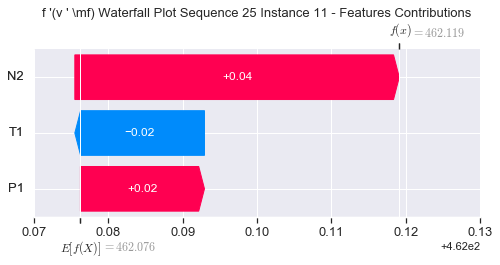

None

Contribution: [ 0.01660645 -0.033823    0.04345187]


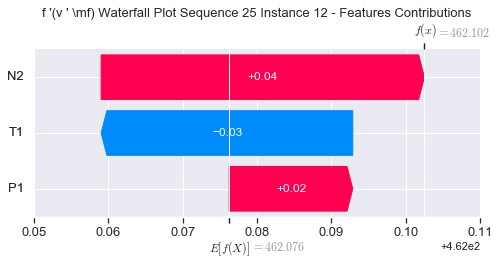

None

Contribution: [ 0.01825378 -0.0330751   0.04620876]


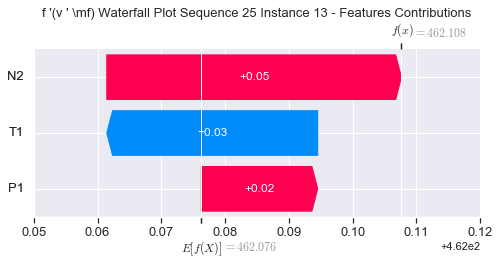

None

Contribution: [ 0.02167771 -0.04137828  0.04840646]


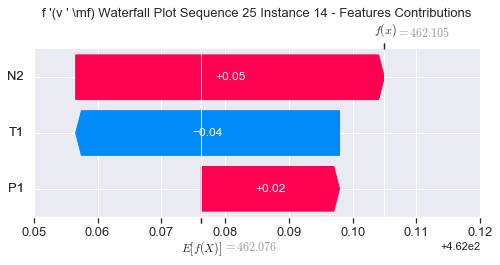

None

Contribution: [ 0.01969192 -0.04207863  0.05430971]


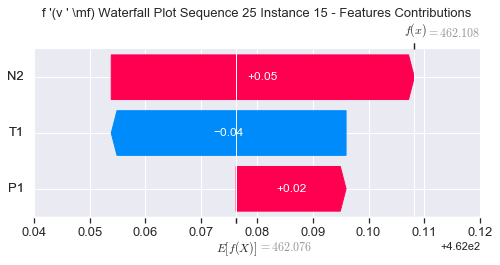

None

Contribution: [ 0.00598441 -0.05859283  0.05849609]


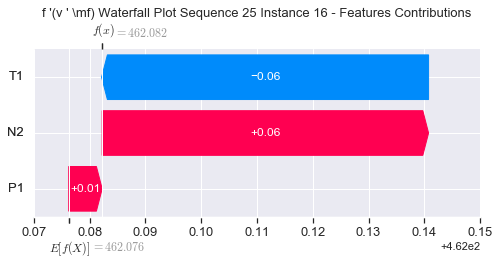

None

Contribution: [ 0.0250661  -0.04092565  0.06899311]


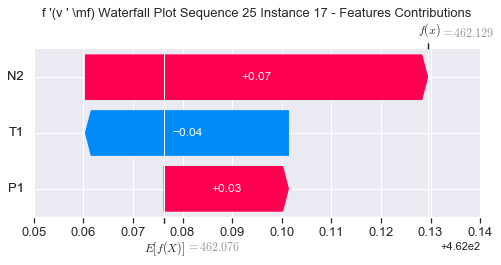

None

Contribution: [ 0.02832823 -0.0438846   0.0809294 ]


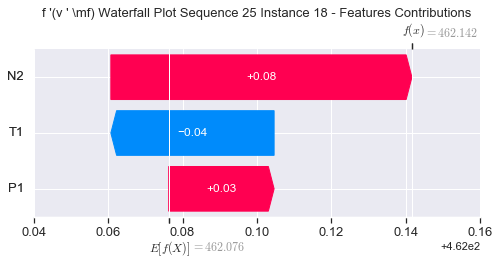

None

Contribution: [ 0.03670985 -0.05026106  0.10590647]


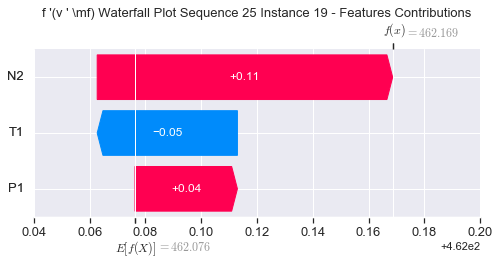

None

Contribution: [ 0.05080714 -0.11767195  0.15130425]


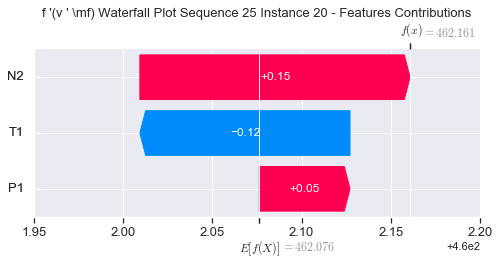

None

Contribution: [ 0.08201173 -0.1951724   0.23977459]


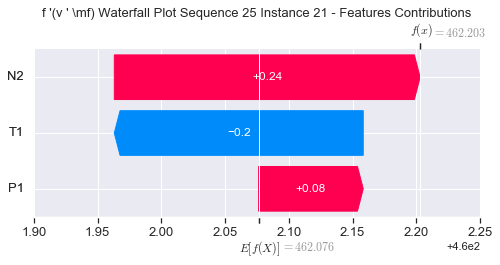

None

Contribution: [ 0.16520422 -0.609371    0.50637063]


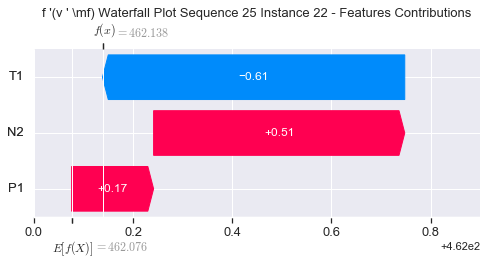

None

Contribution: [ 0.1607549  -0.71059902  0.61938353]


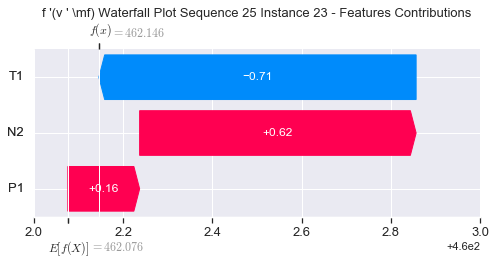

None

Contribution: [ 0.56184117 -2.04439691  1.85126089]


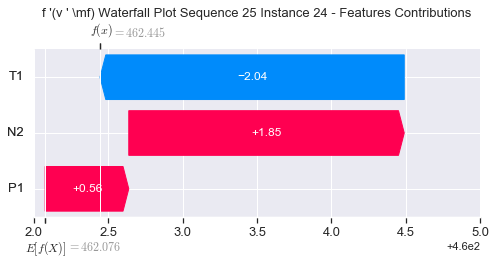

None

Contribution: [0.6651083  0.80158976 1.81484243]


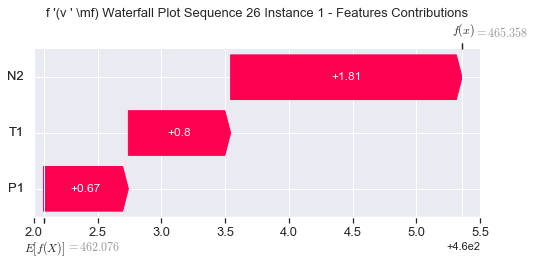

None

Contribution: [0.00560583 0.15833294 0.04366961]


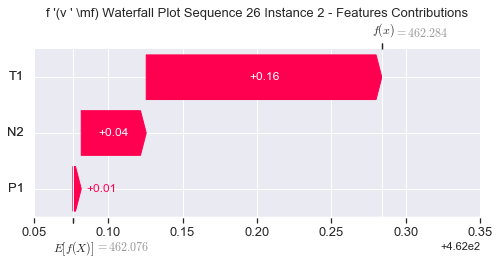

None

Contribution: [0.03865318 0.05257005 0.06582471]


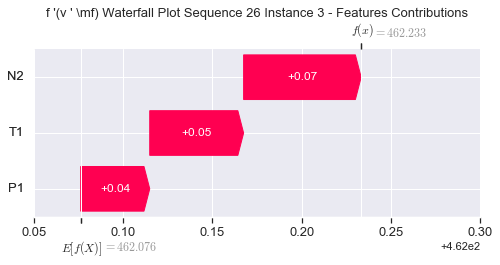

None

Contribution: [ 0.00224643  0.01001043 -0.01161031]


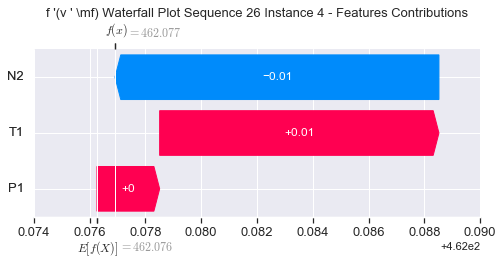

None

Contribution: [ 0.0042372   0.00585594 -0.00914643]


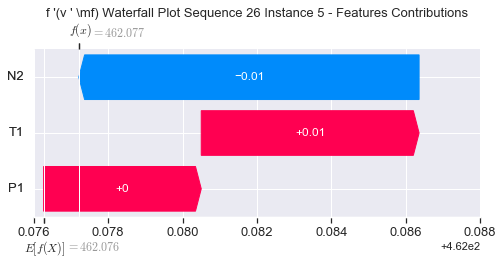

None

Contribution: [0.00553797 0.00095938 0.00751851]


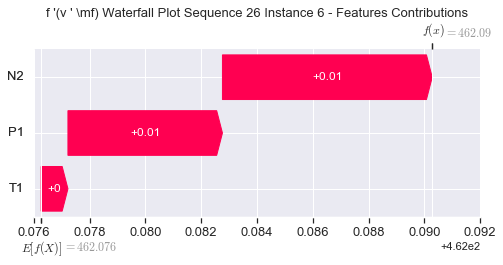

None

Contribution: [ 0.00877258 -0.00101802  0.0186843 ]


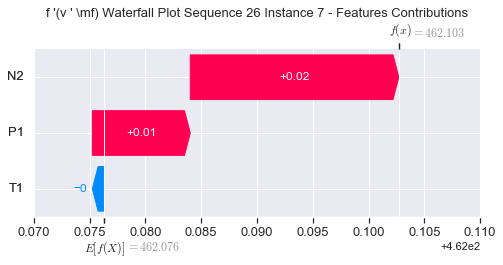

None

Contribution: [ 0.01142332 -0.00332276  0.02709996]


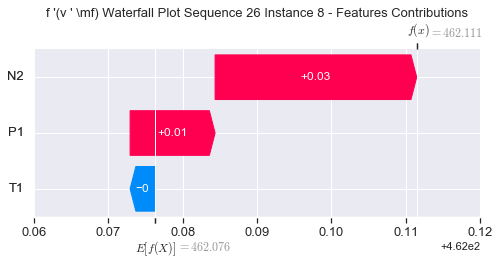

None

Contribution: [ 0.01159543 -0.00334127  0.03400378]


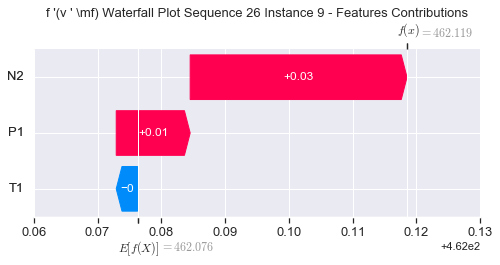

None

Contribution: [ 0.01050851 -0.00445991  0.04045631]


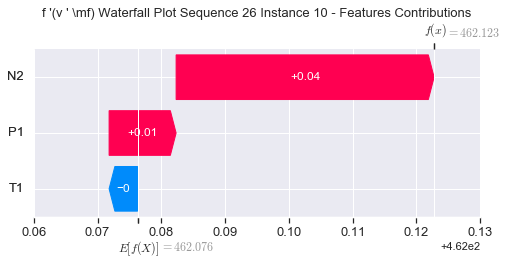

None

Contribution: [ 0.01541847 -0.01040323  0.04163344]


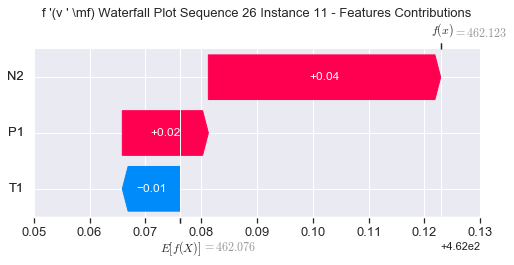

None

Contribution: [ 0.02229887 -0.02179365  0.04472977]


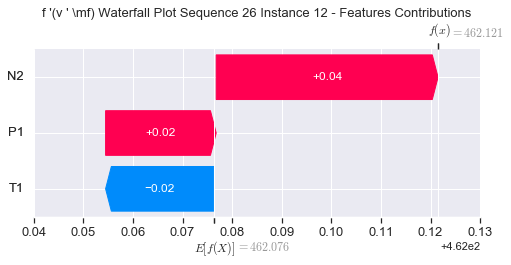

None

Contribution: [ 0.02337104 -0.02008169  0.04723744]


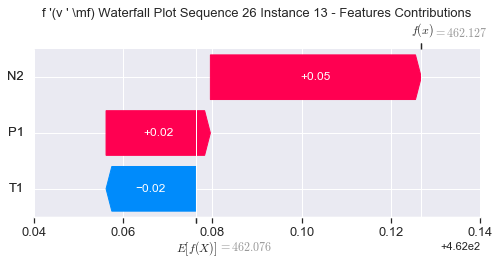

None

Contribution: [ 0.0210524  -0.02475331  0.0496453 ]


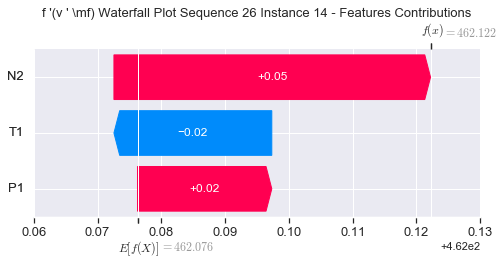

None

Contribution: [ 0.02251303 -0.03228382  0.05453853]


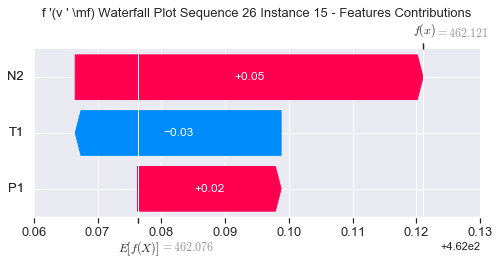

None

Contribution: [ 0.01689369 -0.02555314  0.0628109 ]


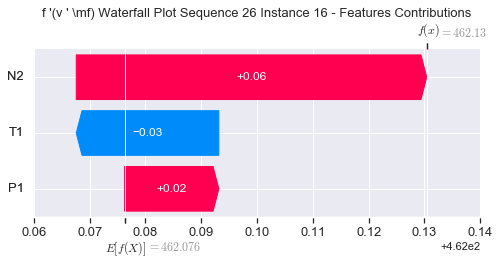

None

Contribution: [ 0.0265575  -0.03185231  0.06845794]


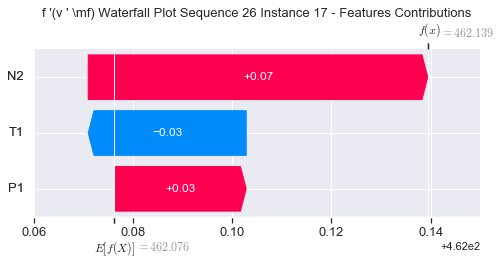

None

Contribution: [ 0.02879478 -0.0376016   0.08023866]


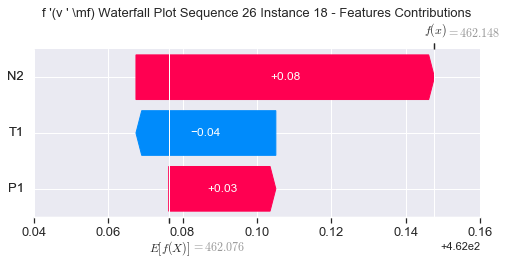

None

Contribution: [ 0.03044393 -0.03900482  0.10285405]


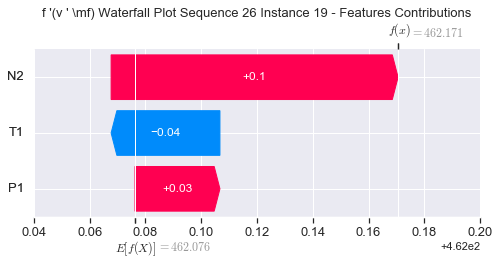

None

Contribution: [ 0.04818801 -0.11572428  0.15000665]


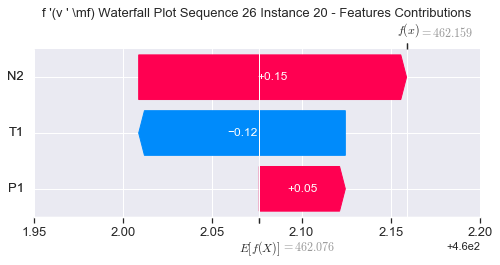

None

Contribution: [ 0.08193459 -0.20204959  0.23924028]


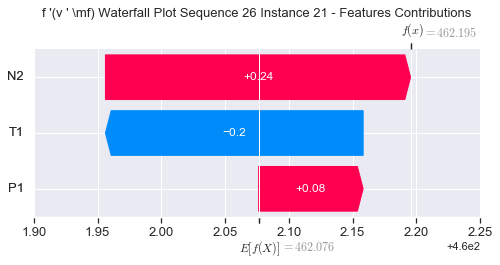

None

Contribution: [ 0.17072809 -0.66823535  0.50626257]


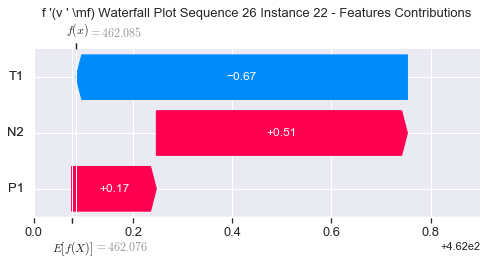

None

Contribution: [ 0.15861004 -0.79546308  0.61568559]


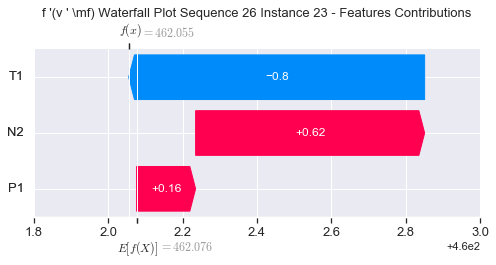

None

Contribution: [ 0.49483443 -2.37661841  1.7826393 ]


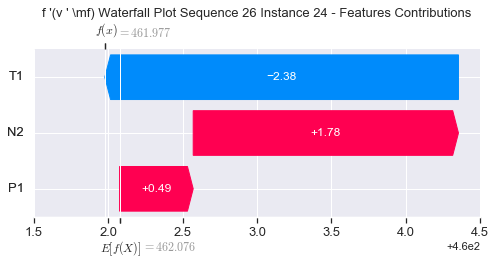

None

Contribution: [0.5812107  0.21588729 1.64987449]


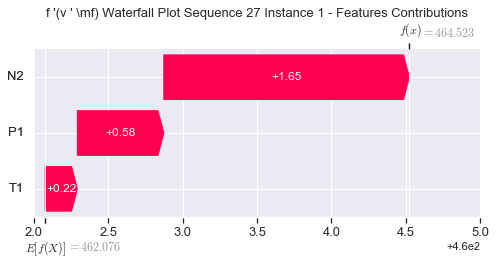

None

Contribution: [0.00283842 0.15350398 0.04511433]


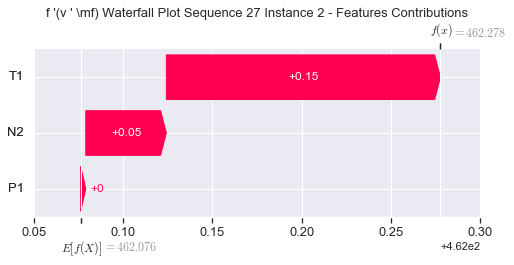

None

Contribution: [0.03717589 0.01972325 0.06559508]


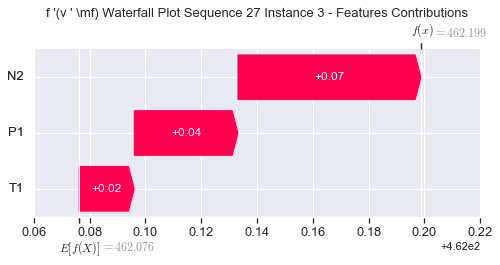

None

Contribution: [ 0.00445093 -0.00189116 -0.0082931 ]


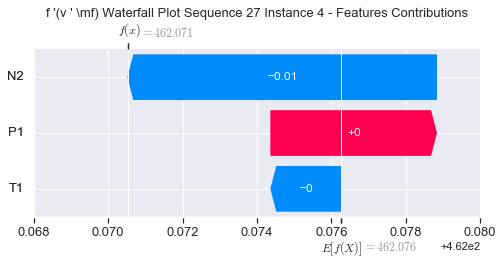

None

Contribution: [-0.00156727 -0.02162658 -0.00862305]


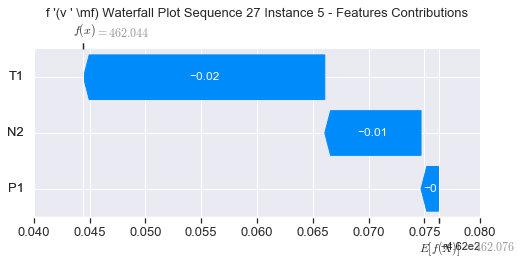

None

Contribution: [ 0.00765749 -0.01626585  0.00968577]


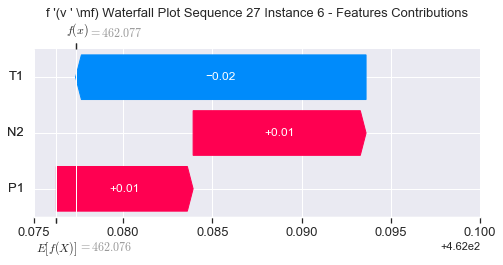

None

Contribution: [ 0.00996123 -0.01610223  0.019365  ]


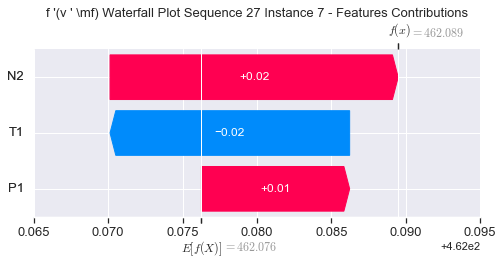

None

Contribution: [ 0.01144384 -0.01872173  0.02702218]


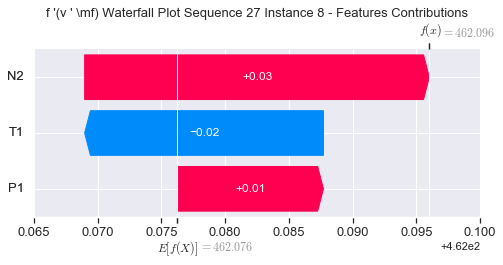

None

Contribution: [ 0.00842545 -0.01621297  0.03338181]


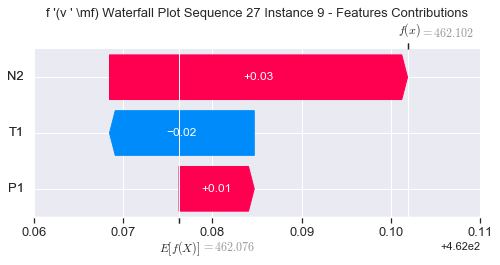

None

Contribution: [ 0.00756248 -0.01890286  0.03898646]


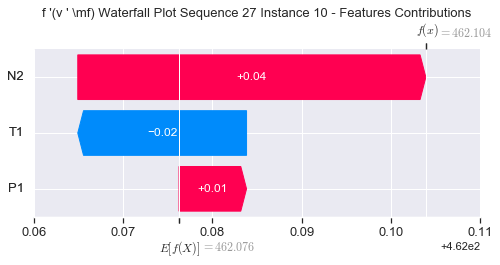

None

Contribution: [ 0.01029266 -0.028796    0.0400813 ]


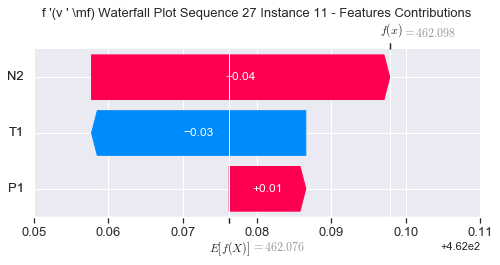

None

Contribution: [ 0.01276953 -0.04150533  0.04058529]


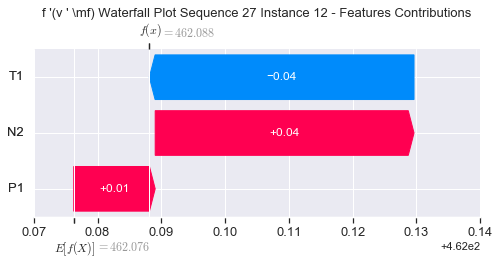

None

Contribution: [ 0.01439854 -0.03793935  0.04328005]


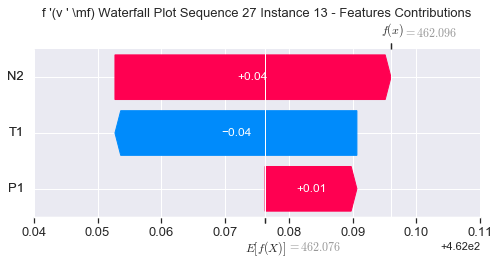

None

Contribution: [ 0.01505581 -0.03577971  0.04790737]


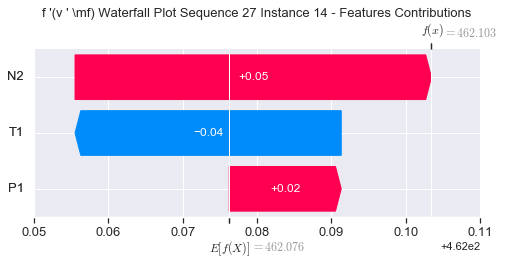

None

Contribution: [ 0.0161787  -0.04383761  0.05141691]


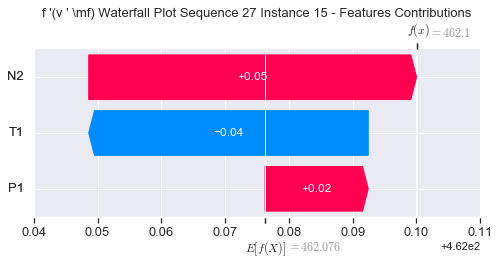

None

Contribution: [ 0.01724606 -0.03290016  0.06166915]


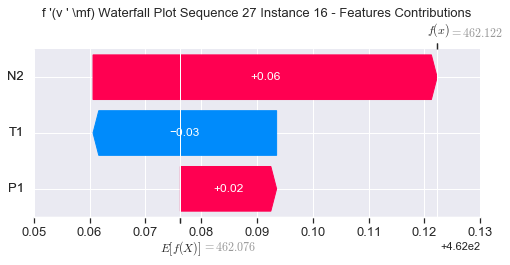

None

Contribution: [ 0.02373842 -0.03558797  0.06651314]


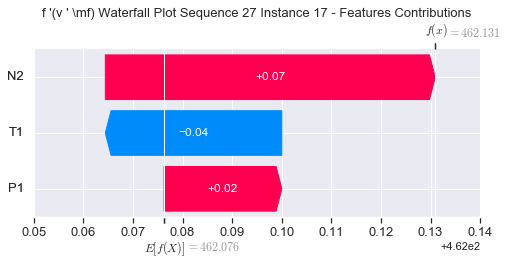

None

Contribution: [ 0.02814297 -0.03794938  0.07915755]


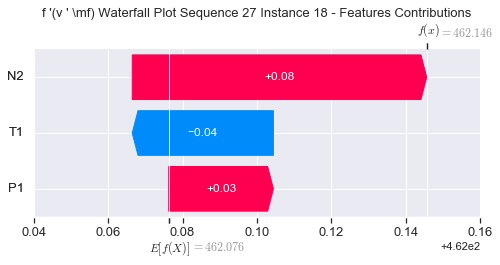

None

Contribution: [ 0.02875766 -0.04503656  0.10013749]


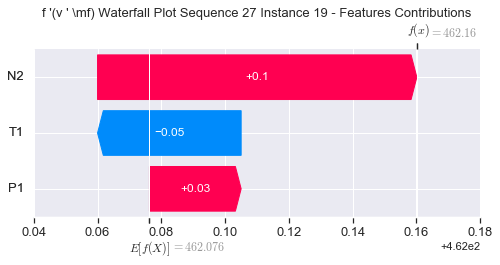

None

Contribution: [ 0.04998295 -0.10212836  0.14854511]


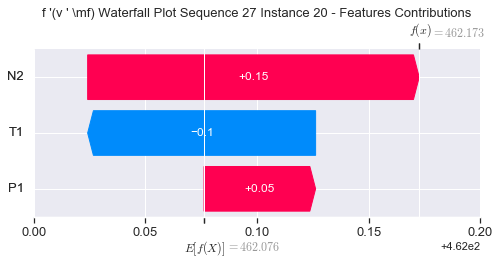

None

Contribution: [ 0.07497618 -0.18392955  0.2334163 ]


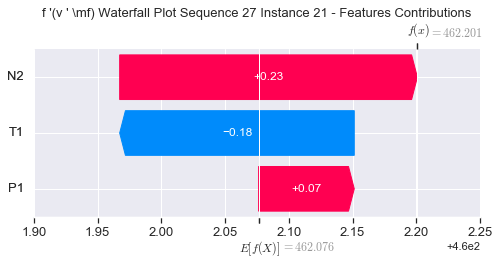

None

Contribution: [ 0.12703548 -0.63370394  0.48276743]


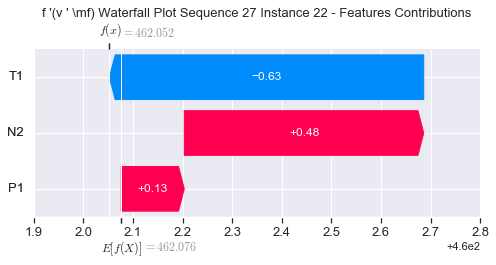

None

Contribution: [ 0.13450135 -0.70994869  0.59341403]


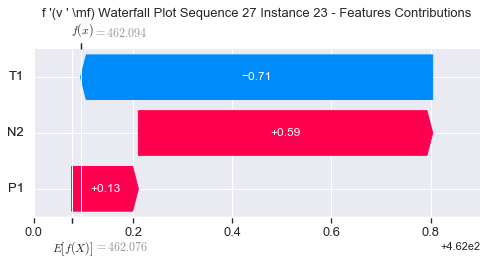

None

Contribution: [ 0.46226957 -2.00919006  1.75055345]


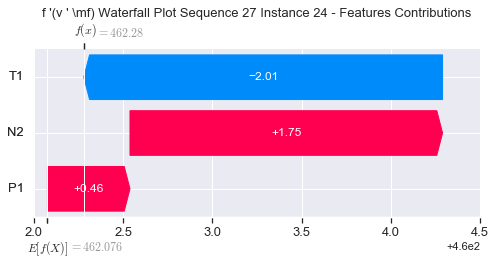

None

Contribution: [0.4558144  0.81592245 1.60005356]


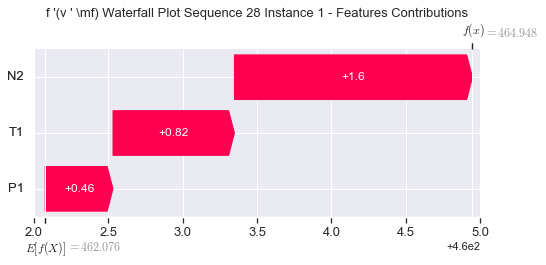

None

Contribution: [0.01226758 0.16333452 0.04615474]


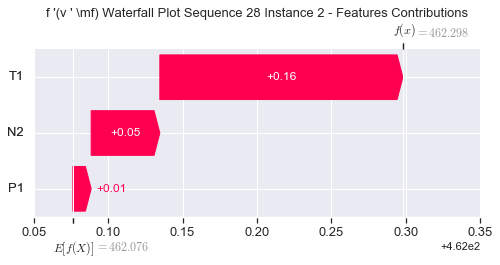

None

Contribution: [0.02035234 0.03235124 0.05879778]


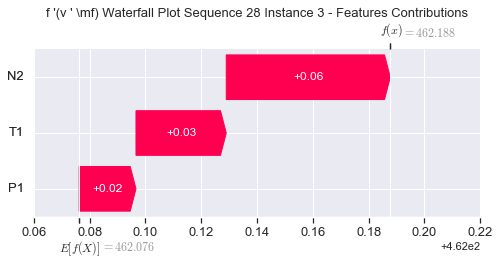

None

Contribution: [ 0.00417652  0.00403533 -0.01275063]


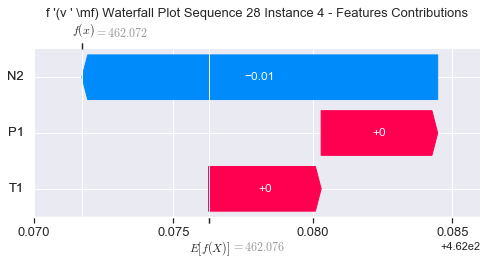

None

Contribution: [ 0.0107953  -0.00307752 -0.00809898]


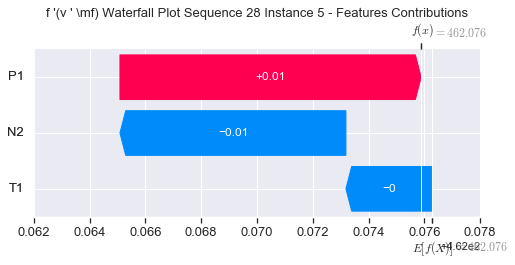

None

Contribution: [0.01055362 0.00880796 0.00750885]


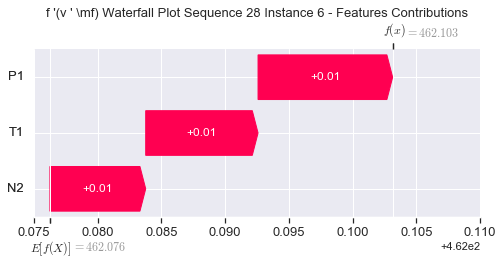

None

Contribution: [0.01021816 0.01345078 0.01854419]


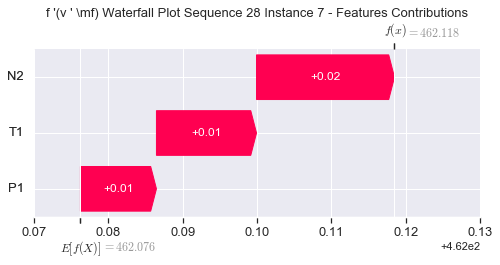

None

Contribution: [0.01565652 0.0020326  0.02691071]


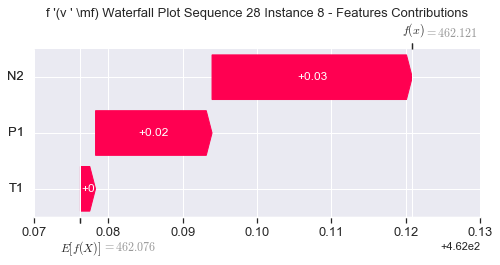

None

Contribution: [0.01293473 0.02063973 0.03808587]


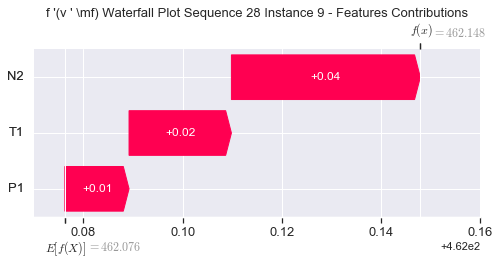

None

Contribution: [0.02127311 0.01586255 0.04370713]


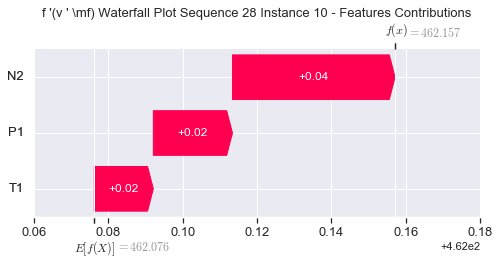

None

Contribution: [ 0.02411049 -0.0104638   0.04313377]


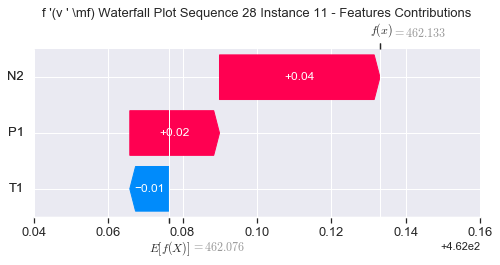

None

Contribution: [ 0.02228861 -0.0302888   0.04300818]


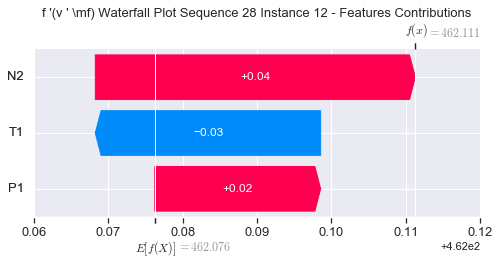

None

Contribution: [ 0.02390972 -0.02987446  0.04635354]


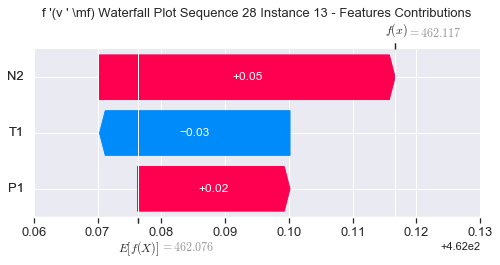

None

Contribution: [ 0.01569328 -0.04318953  0.04727975]


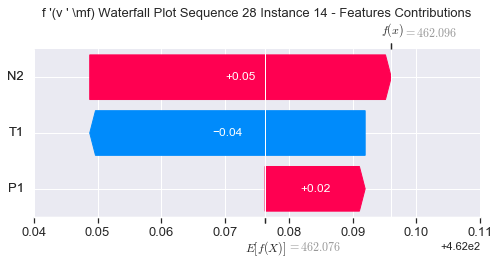

None

Contribution: [ 0.0269133  -0.0522283   0.05315778]


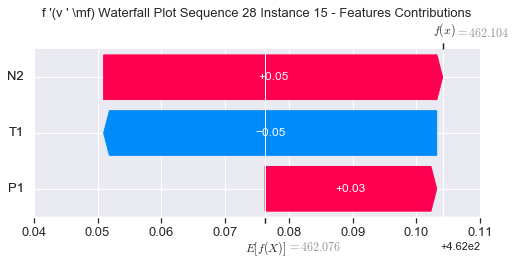

None

Contribution: [ 0.03137349 -0.04020214  0.06413088]


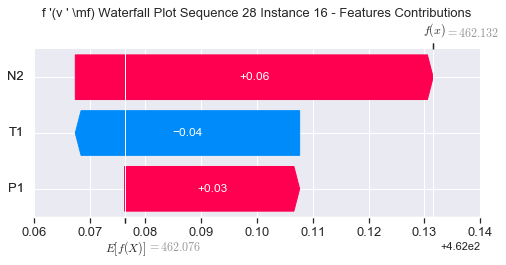

None

Contribution: [ 0.03267648 -0.05452115  0.06820154]


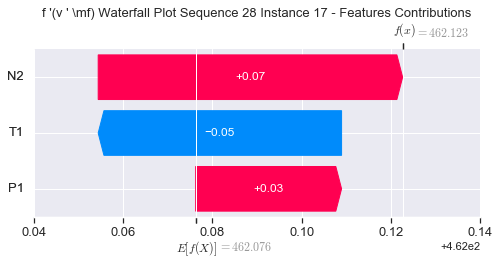

None

Contribution: [ 0.0393489  -0.07160531  0.08050562]


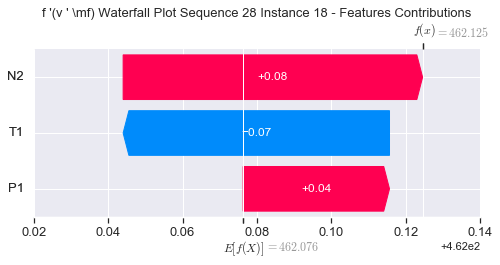

None

Contribution: [ 0.03119694 -0.09002214  0.10335778]


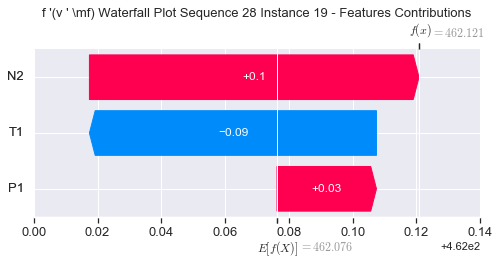

None

Contribution: [ 0.07830384 -0.21454551  0.15382931]


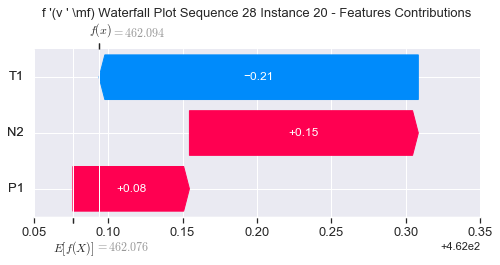

None

Contribution: [ 0.13510872 -0.40337869  0.24579334]


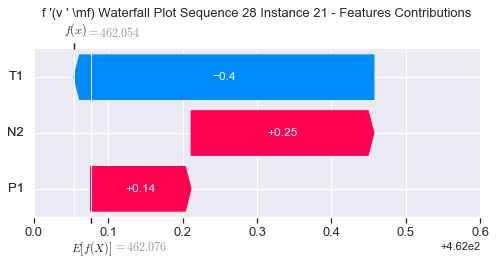

None

Contribution: [ 0.34916414 -1.43012973  0.51992596]


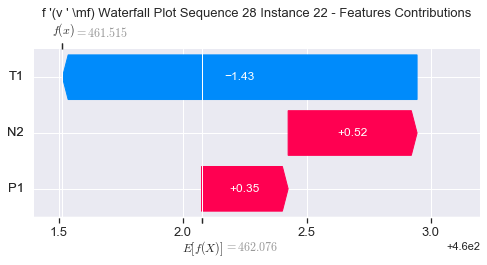

None

Contribution: [ 0.39341    -1.75144616  0.6300315 ]


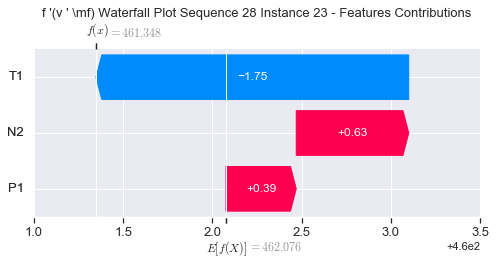

None

Contribution: [ 1.81908053 -6.25615344  1.98089124]


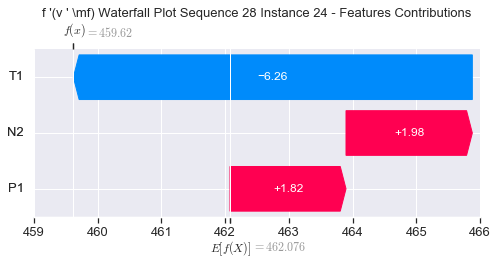

None

Contribution: [ 2.94555927 -5.33972961  2.28646275]


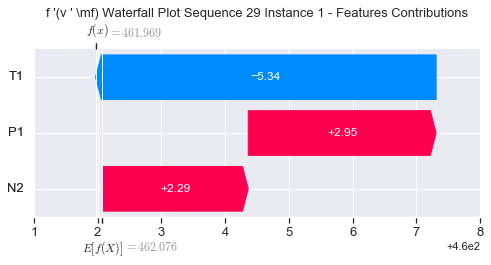

None

Contribution: [-0.00335501  0.17089512  0.05037269]


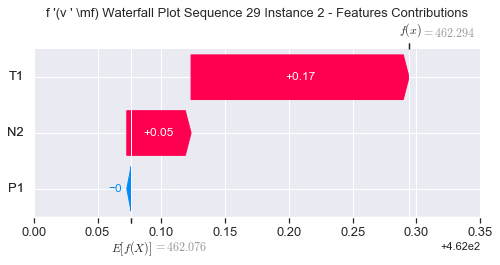

None

Contribution: [ 0.0738496  -0.17171386  0.06768195]


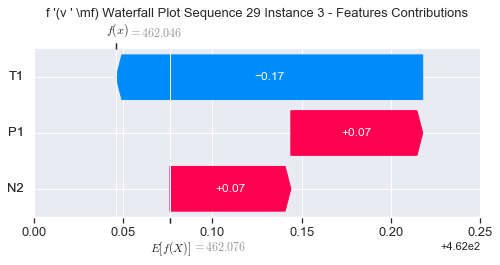

None

Contribution: [ 0.05699635 -0.15551158  0.00931726]


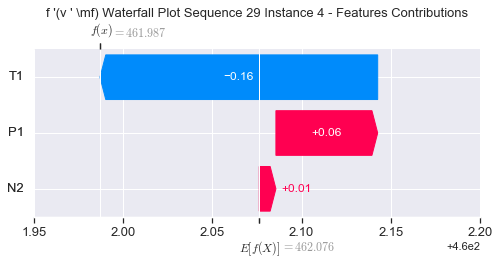

None

Contribution: [ 0.04086693 -0.17040724  0.00530858]


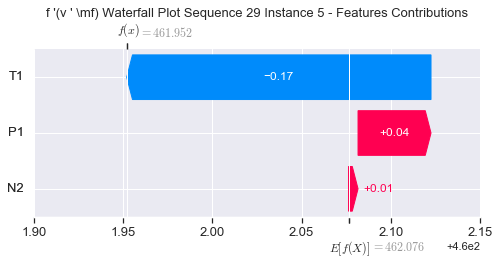

None

Contribution: [ 0.07031647 -0.18490671  0.02715971]


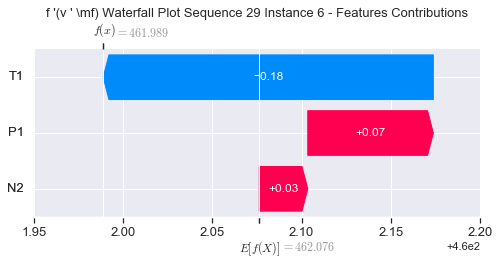

None

Contribution: [ 0.07011049 -0.18483987  0.03320365]


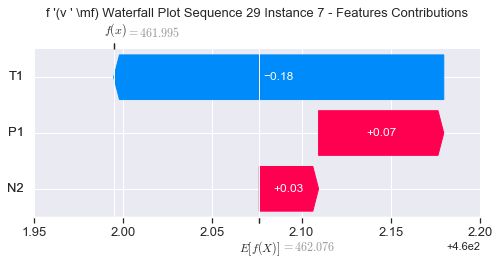

None

Contribution: [ 0.06467467 -0.17419542  0.03855708]


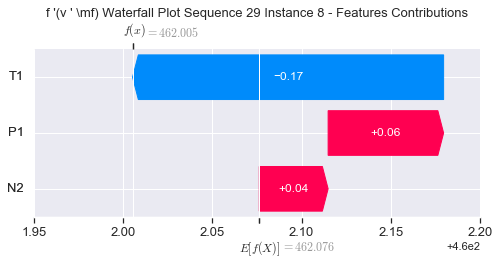

None

Contribution: [ 0.05870211 -0.18841751  0.04248958]


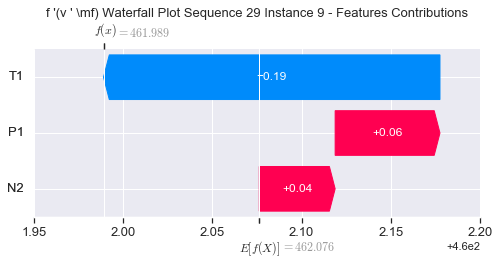

None

Contribution: [ 0.02722718 -0.18450677  0.04273765]


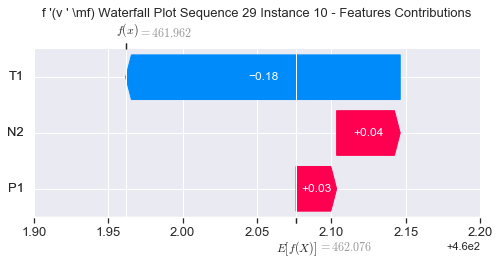

None

Contribution: [ 0.06781912 -0.19272371  0.05324398]


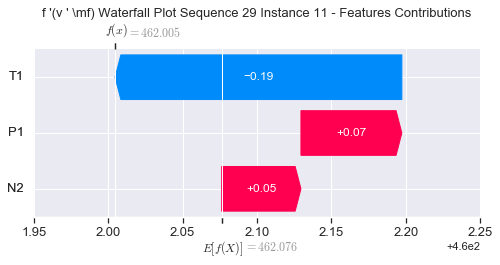

None

Contribution: [ 0.08019584 -0.21137016  0.05491594]


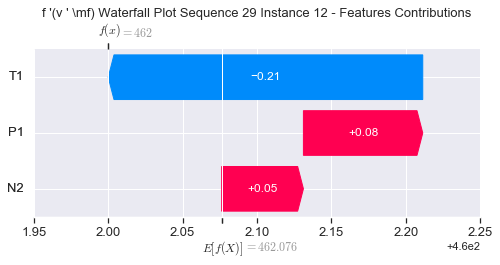

None

Contribution: [ 0.07717736 -0.20540188  0.05611407]


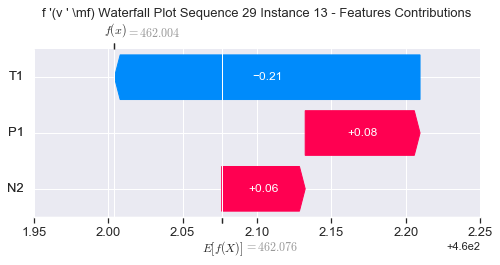

None

Contribution: [ 0.10541481 -0.20503265  0.06471042]


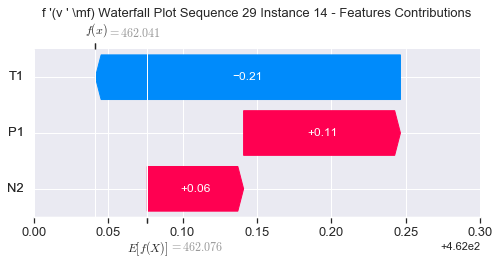

None

Contribution: [ 0.0780416  -0.20656396  0.06510274]


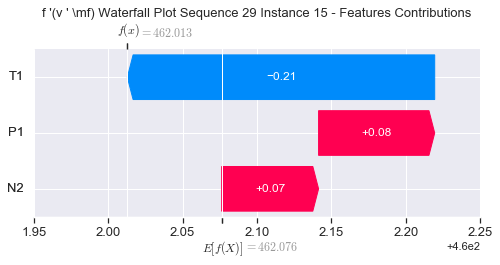

None

Contribution: [ 0.08560045 -0.24148202  0.07643624]


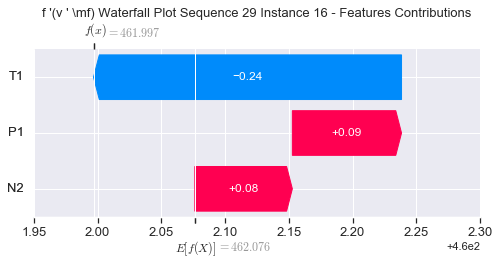

None

Contribution: [ 0.07746792 -0.18944104  0.07965048]


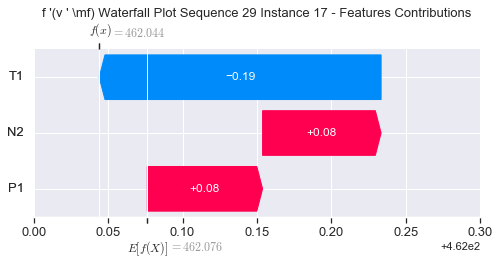

None

Contribution: [ 0.07699768 -0.17984779  0.09210613]


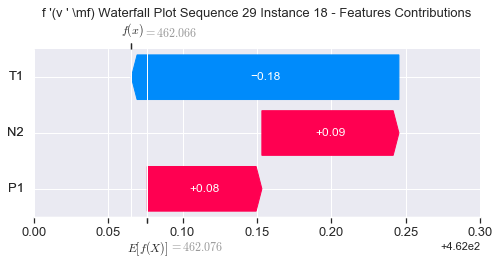

None

Contribution: [ 0.05064863 -0.13290791  0.10721762]


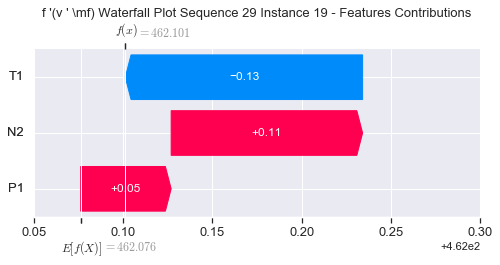

None

Contribution: [ 0.08636338 -0.28206699  0.15883819]


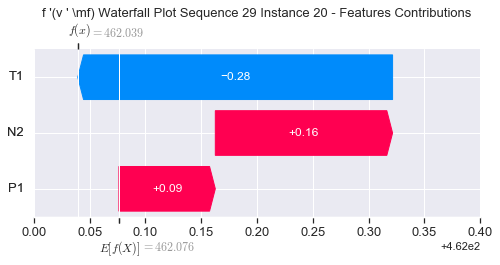

None

Contribution: [ 0.12052265 -0.43262945  0.24566969]


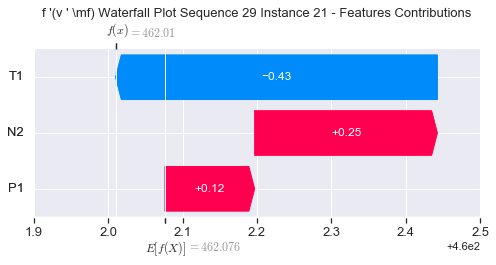

None

Contribution: [ 0.19518453 -1.20433121  0.50321996]


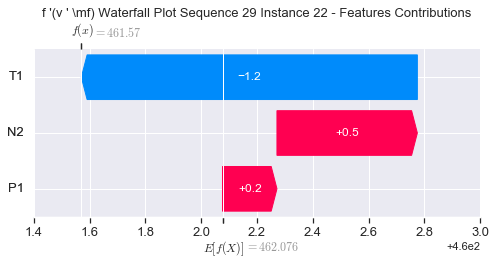

None

Contribution: [ 0.24485148 -1.39079599  0.6268672 ]


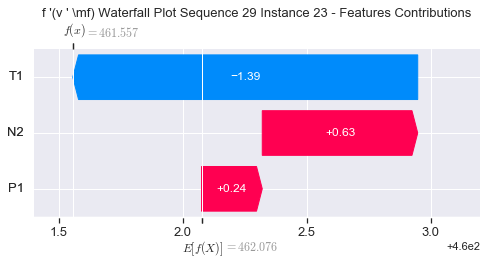

None

Contribution: [ 0.46007574 -3.37386998  1.85631132]


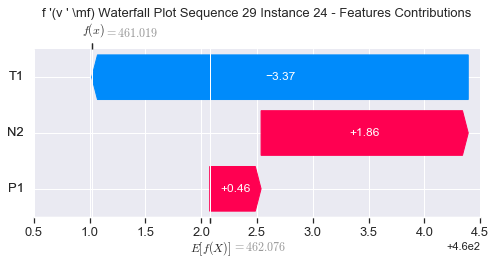

None

Contribution: [ 0.48632953 -0.21779809  1.84058485]


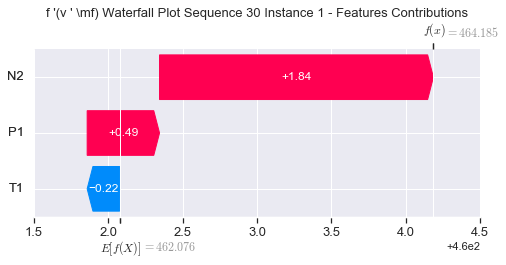

None

Contribution: [0.01306894 0.17121523 0.04692203]


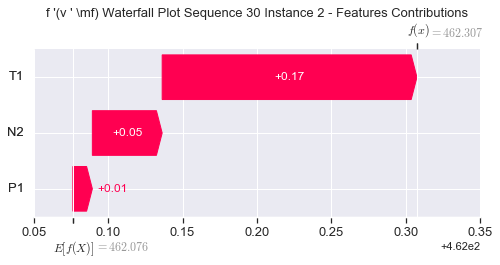

None

Contribution: [ 0.026379   -0.02116498  0.0623968 ]


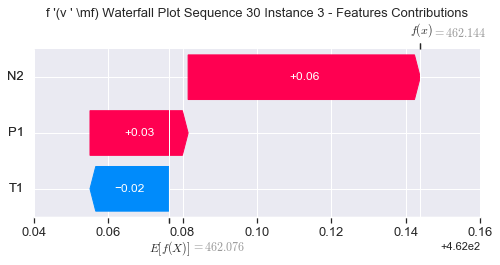

None

Contribution: [-0.01823075 -0.0483127  -0.01129611]


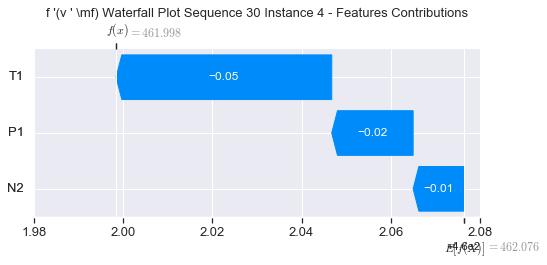

None

Contribution: [ 0.00507989 -0.0136898  -0.00340759]


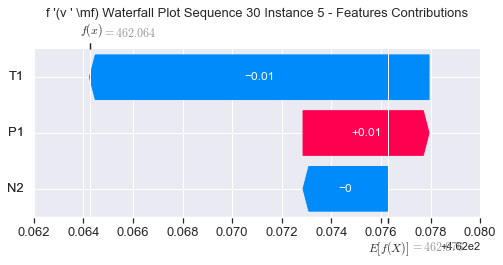

None

Contribution: [ 0.00735591 -0.0178641   0.01185588]


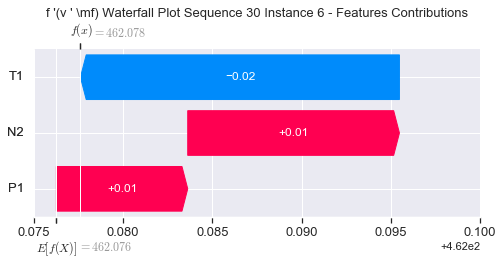

None

Contribution: [ 0.00946822 -0.01928047  0.02099569]


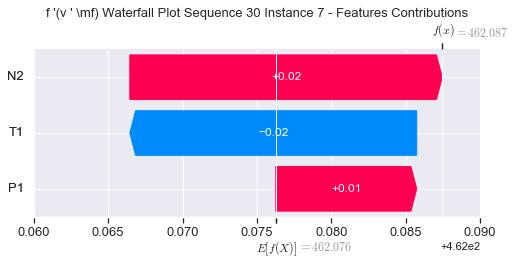

None

Contribution: [ 0.01142817 -0.0202521   0.02848315]


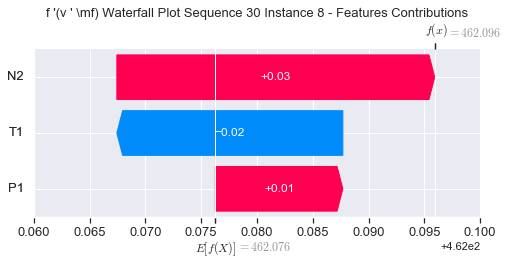

None

Contribution: [ 0.01109173 -0.0128466   0.0341074 ]


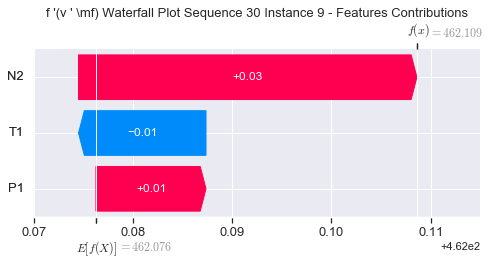

None

Contribution: [ 0.01211789 -0.02037549  0.04107338]


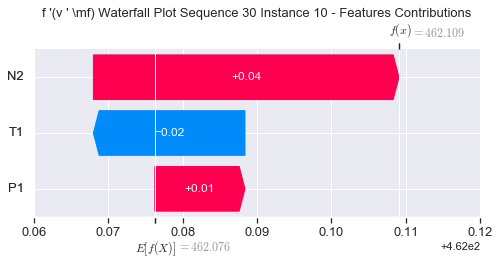

None

Contribution: [ 0.01025254 -0.02239942  0.0423343 ]


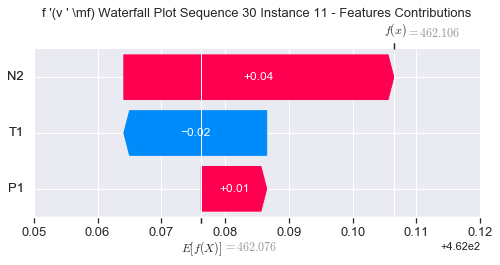

None

Contribution: [ 0.01156462 -0.04432692  0.04321955]


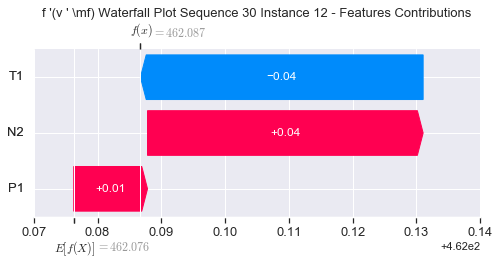

None

Contribution: [ 0.01388873 -0.04229477  0.04575618]


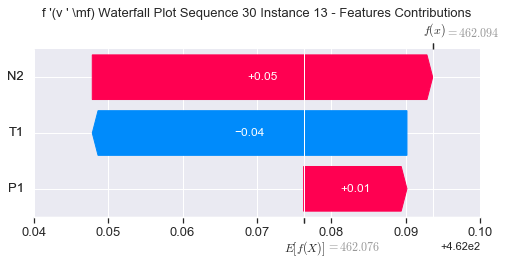

None

Contribution: [ 0.01612755 -0.05752499  0.0465158 ]


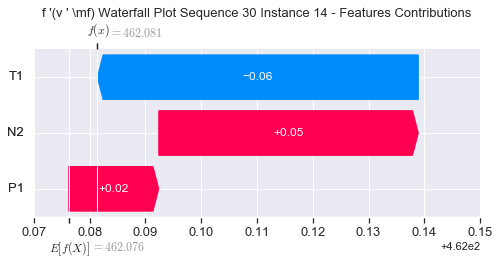

None

Contribution: [ 0.01463167 -0.05249163  0.05358969]


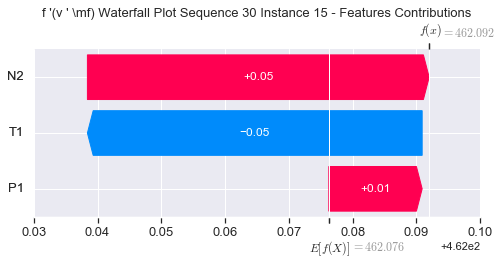

None

Contribution: [ 0.01929195 -0.04870739  0.06481769]


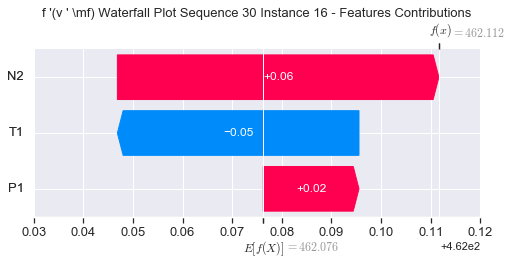

None

Contribution: [ 0.02018368 -0.0505919   0.06717428]


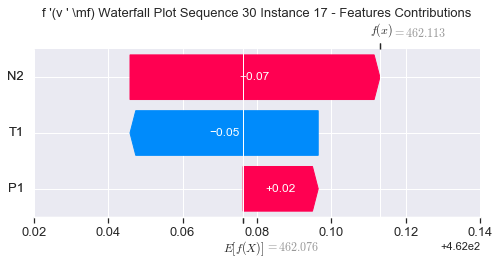

None

Contribution: [ 0.02333434 -0.05573374  0.07929312]


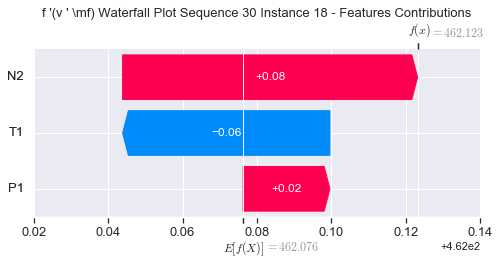

None

Contribution: [ 0.02947491 -0.04898337  0.10340404]


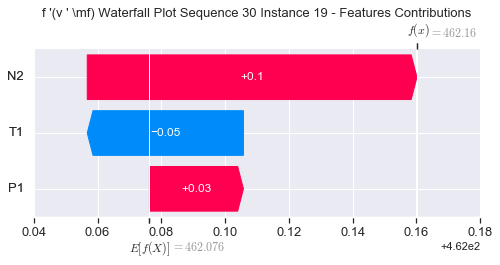

None

Contribution: [ 0.04373256 -0.13543294  0.14733198]


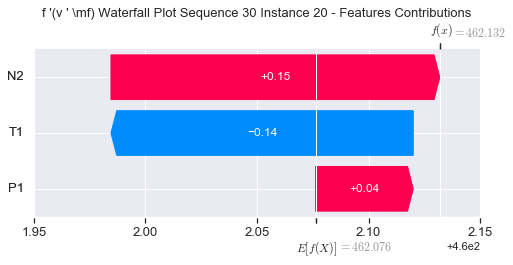

None

Contribution: [ 0.06781361 -0.23191432  0.23334612]


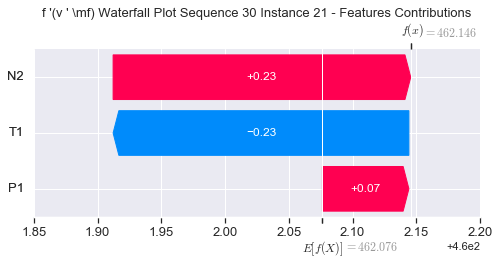

None

Contribution: [ 0.1161265  -0.74913281  0.48908067]


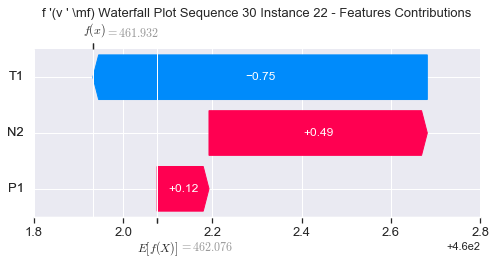

None

Contribution: [ 0.09763479 -0.89914502  0.59480129]


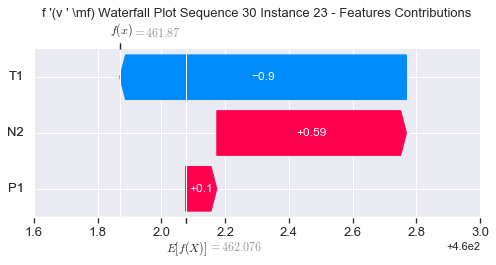

None

Contribution: [ 0.51869994 -2.49962     1.81766434]


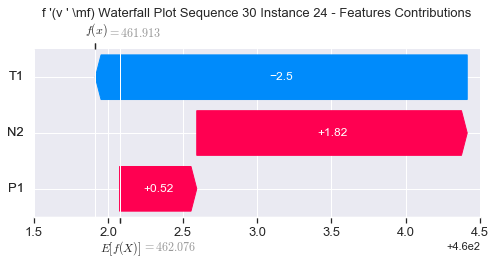

None

Contribution: [0.83079425 0.67376306 1.81015133]


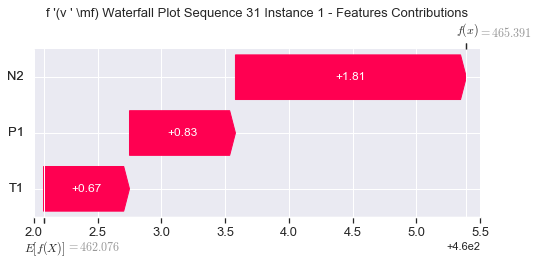

None

Contribution: [0.01099612 0.17204689 0.04494506]


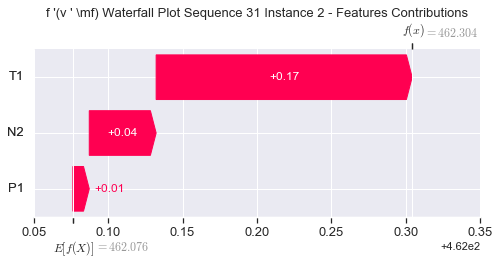

None

Contribution: [0.02759544 0.03876427 0.06802486]


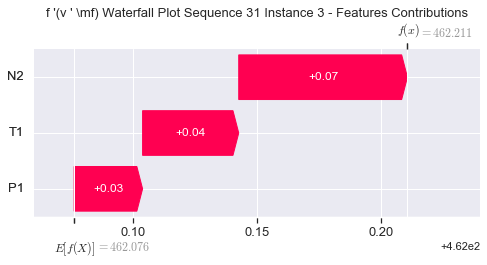

None

Contribution: [-0.00492058  0.0060249  -0.01207784]


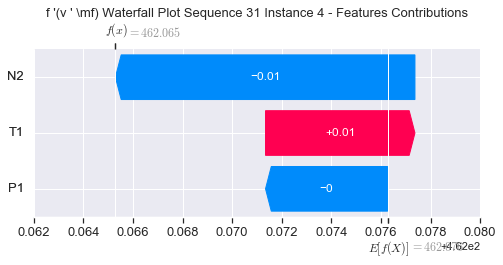

None

Contribution: [ 0.00370567 -0.00393239 -0.00333155]


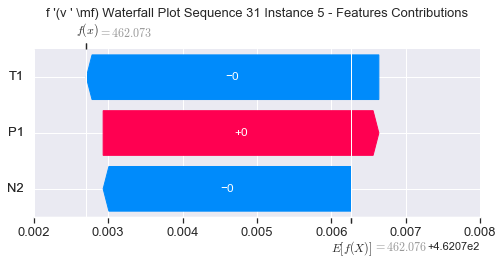

None

Contribution: [ 0.00300122 -0.0057661   0.01086186]


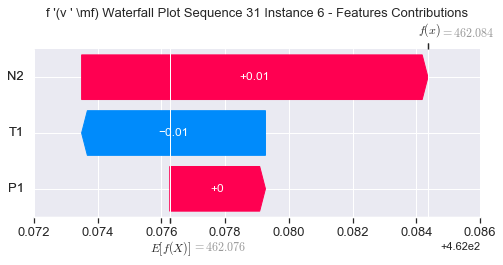

None

Contribution: [ 0.00658347 -0.00773746  0.02126288]


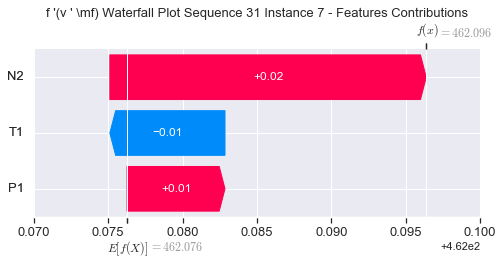

None

Contribution: [ 0.01031558 -0.0100752   0.02989492]


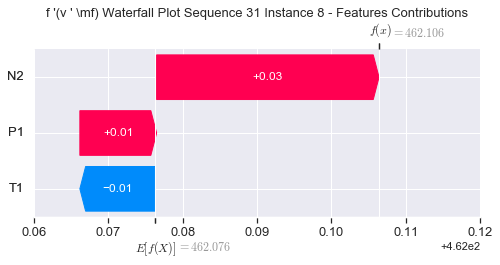

None

Contribution: [ 0.01936304 -0.01049197  0.03740304]


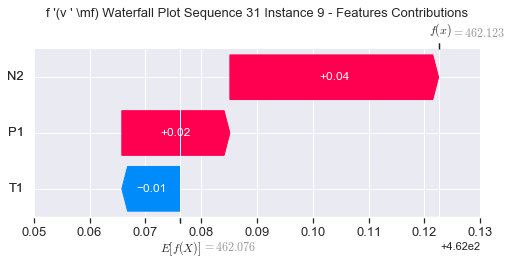

None

Contribution: [ 0.01317877 -0.00474422  0.04139011]


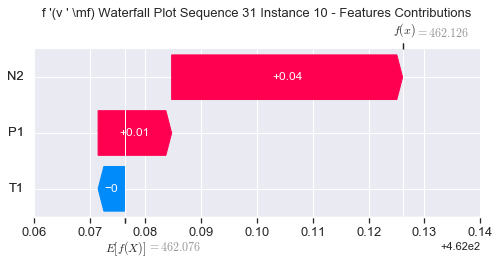

None

Contribution: [ 0.01678866 -0.01591933  0.04400378]


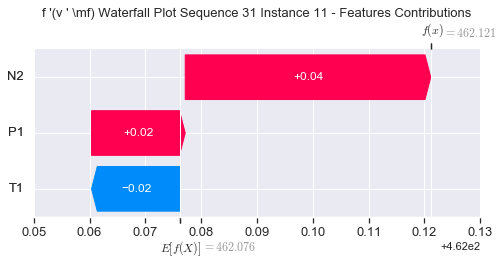

None

Contribution: [ 0.01043239 -0.03135715  0.04296339]


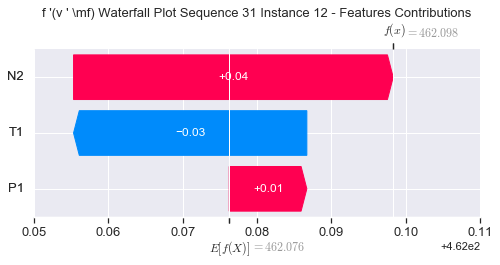

None

Contribution: [ 0.01377469 -0.03065248  0.04628247]


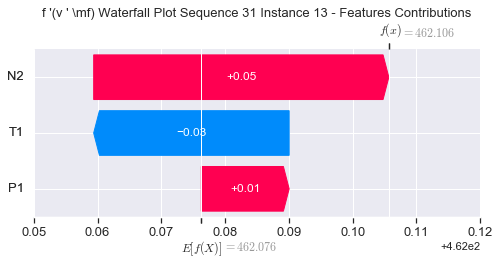

None

Contribution: [ 0.01319376 -0.04646188  0.04998179]


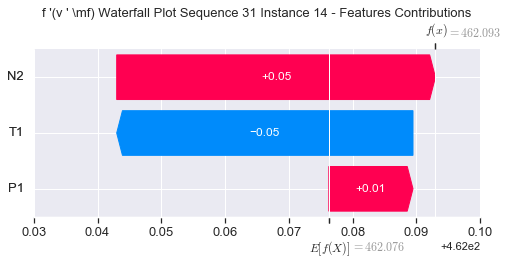

None

Contribution: [ 0.01397983 -0.04108431  0.05348071]


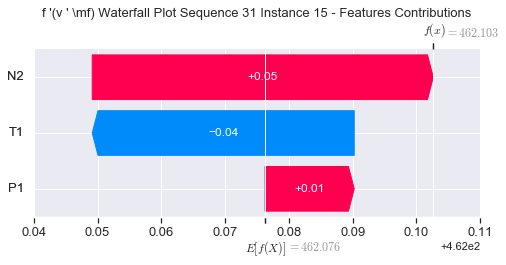

None

Contribution: [ 0.01734801 -0.02640501  0.06615685]


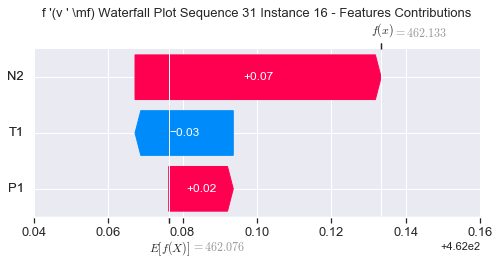

None

Contribution: [ 0.02175399 -0.0404766   0.0674499 ]


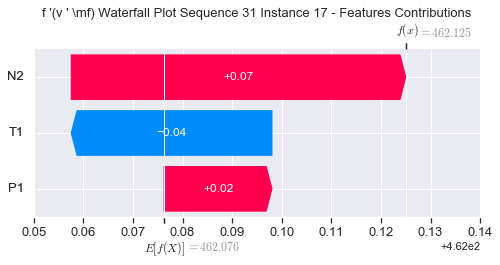

None

Contribution: [ 0.02519663 -0.0463291   0.07983448]


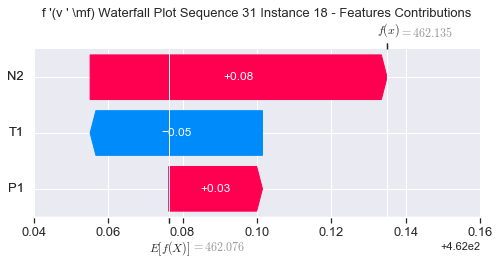

None

Contribution: [ 0.02295699 -0.05404327  0.10596498]


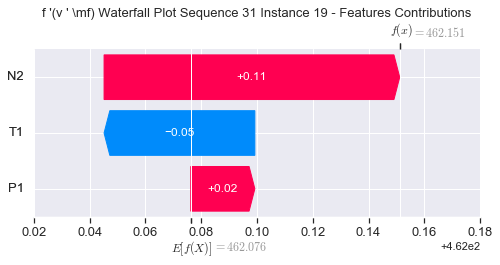

None

Contribution: [ 0.05514554 -0.13058908  0.15291667]


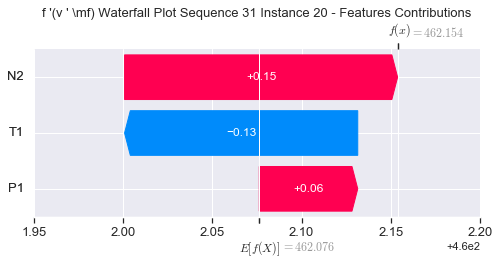

None

Contribution: [ 0.08847496 -0.22786135  0.2423234 ]


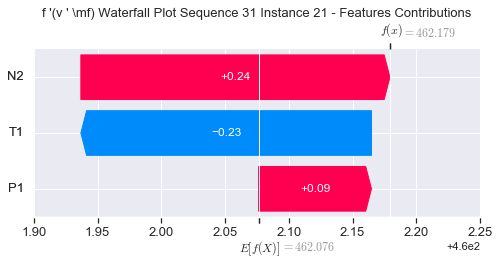

None

Contribution: [ 0.17842218 -0.74211829  0.51487177]


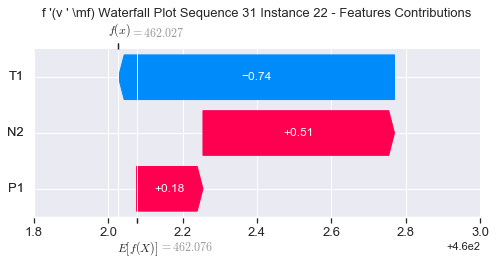

None

Contribution: [ 0.16236878 -0.87862782  0.61937098]


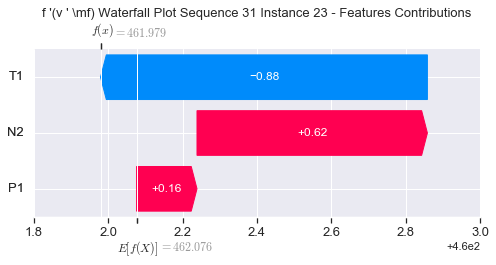

None

Contribution: [ 0.53758667 -2.76913119  1.84667273]


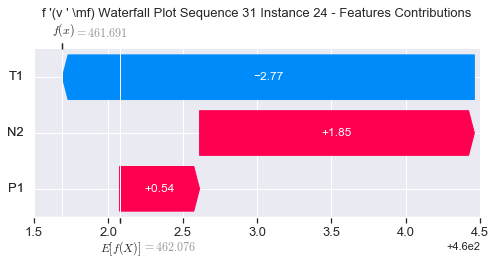

None

Contribution: [ 0.41938094 -0.77383586  1.69334808]


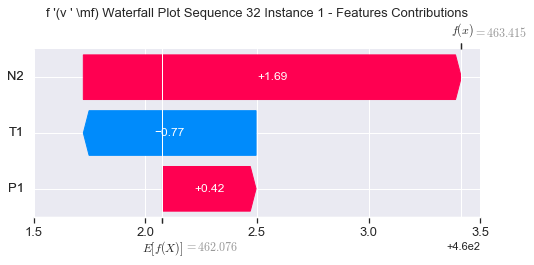

None

Contribution: [0.00567313 0.14918405 0.04675383]


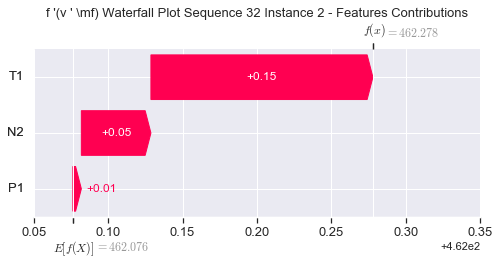

None

Contribution: [0.01864581 0.00750913 0.06440313]


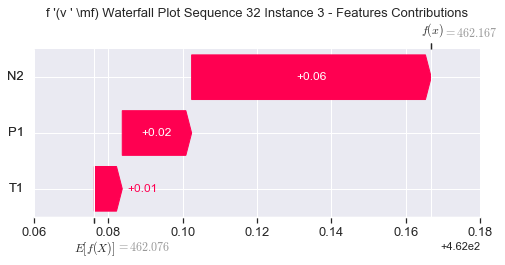

None

Contribution: [ 0.00290783 -0.01361865  0.0009612 ]


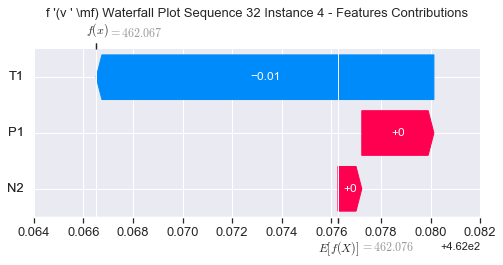

None

Contribution: [ 0.0119653  -0.0201687   0.00953614]


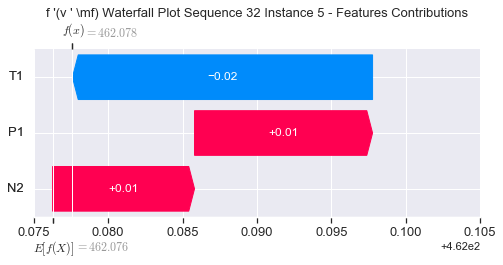

None

Contribution: [ 0.01425785 -0.0229909   0.0233976 ]


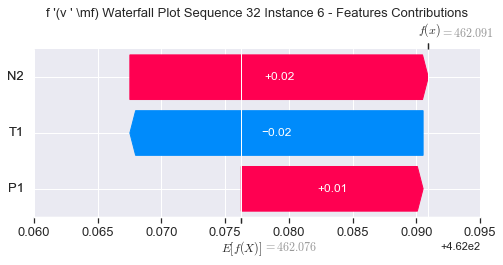

None

Contribution: [ 0.01563749 -0.0237607   0.03167178]


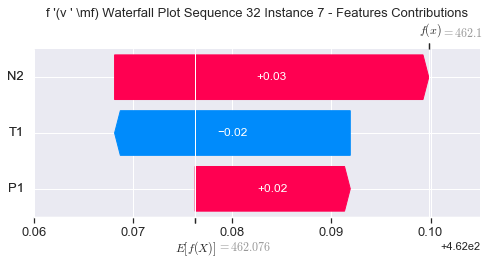

None

Contribution: [ 0.01634039 -0.02591847  0.03806482]


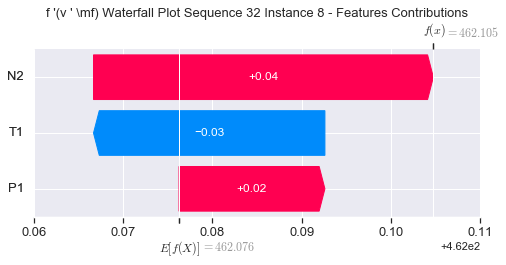

None

Contribution: [ 0.00442955 -0.02143368  0.0374724 ]


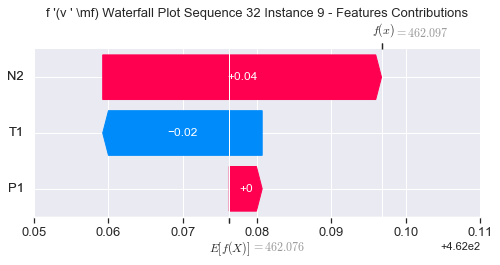

None

Contribution: [-0.00250452 -0.02114562  0.03782445]


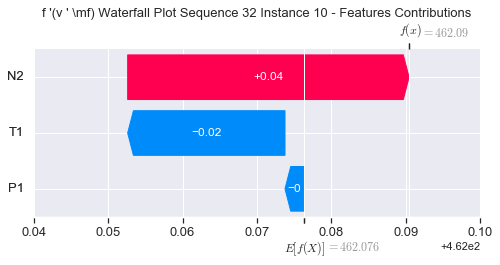

None

Contribution: [ 0.00789581 -0.02914405  0.04499047]


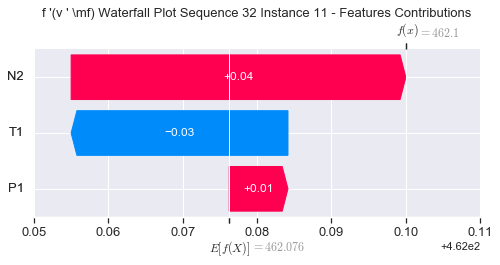

None

Contribution: [ 0.02186137 -0.04058437  0.05386259]


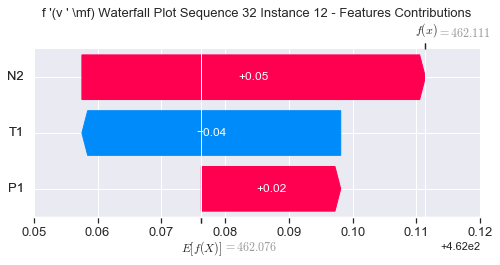

None

Contribution: [ 0.02285259 -0.0398654   0.05645582]


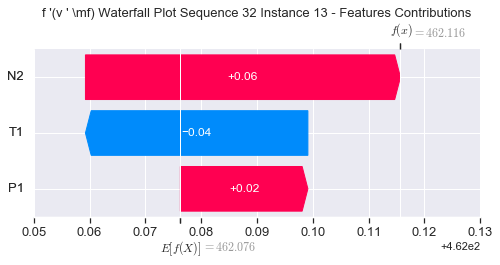

None

Contribution: [ 0.01757979 -0.03053268  0.05925033]


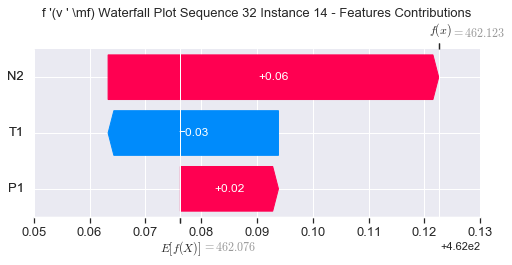

None

Contribution: [ 0.02162606 -0.05662966  0.06434859]


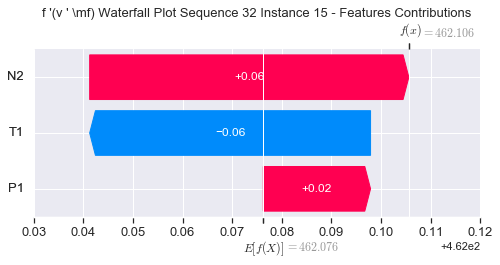

None

Contribution: [ 0.01176816 -0.0610632   0.07083649]


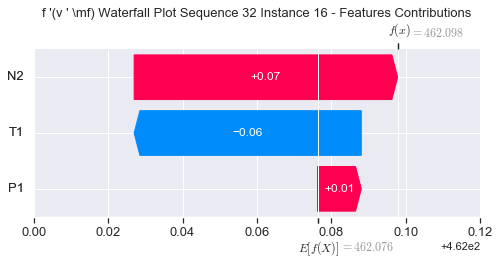

None

Contribution: [ 0.02640554 -0.05680439  0.07828264]


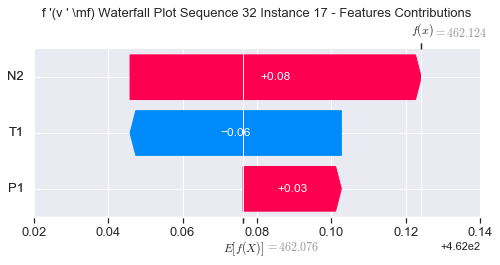

None

Contribution: [ 0.02955947 -0.06515508  0.09123223]


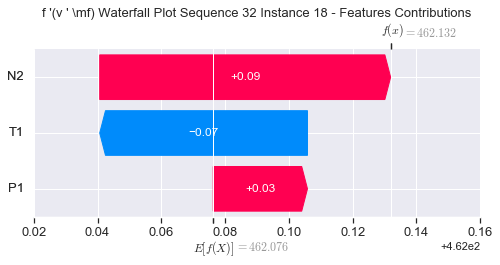

None

Contribution: [ 0.00751565 -0.09520897  0.10515877]


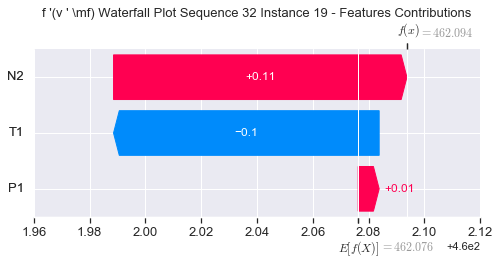

None

Contribution: [ 0.04934035 -0.16887214  0.16825996]


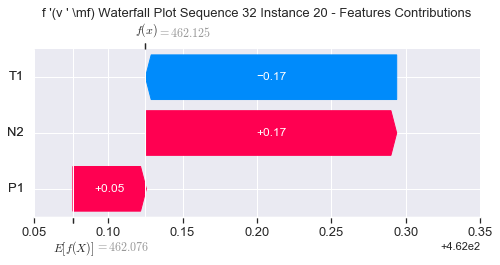

None

Contribution: [ 0.07951225 -0.27908833  0.2648471 ]


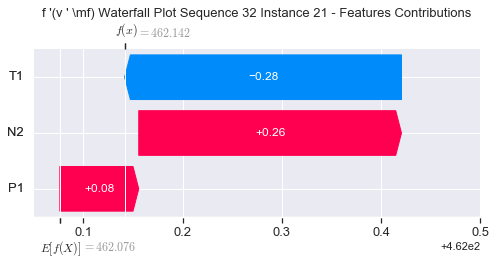

None

Contribution: [ 0.15031168 -0.90957108  0.57838757]


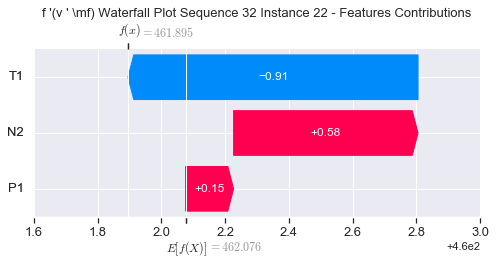

None

Contribution: [ 0.13914691 -1.09616383  0.69604176]


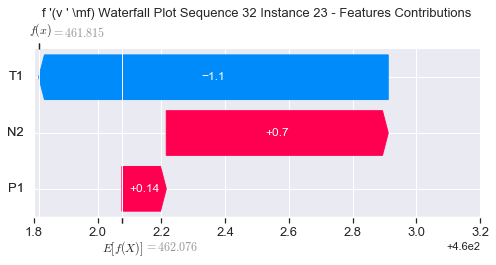

None

Contribution: [ 0.51770273 -3.31951886  2.10800052]


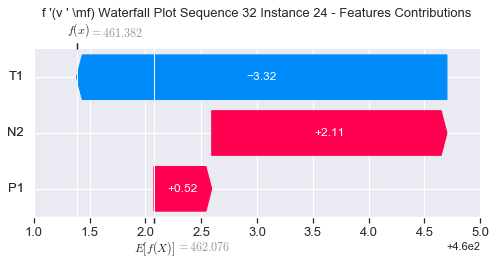

None

Contribution: [ 0.61469423 -0.32290185  1.99833266]


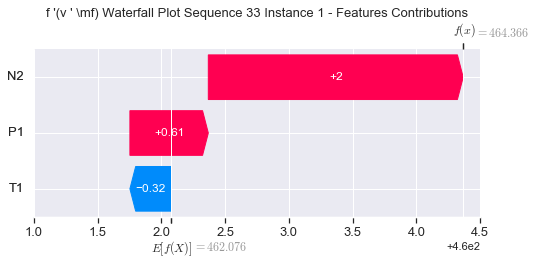

None

Contribution: [0.00819322 0.16586392 0.0438568 ]


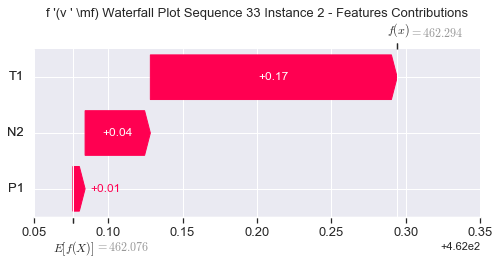

None

Contribution: [ 0.01822824 -0.00413125  0.07085051]


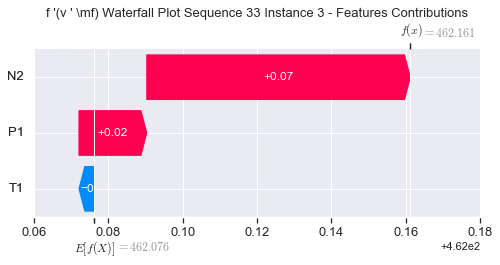

None

Contribution: [ 0.00428768 -0.00472186  0.00065042]


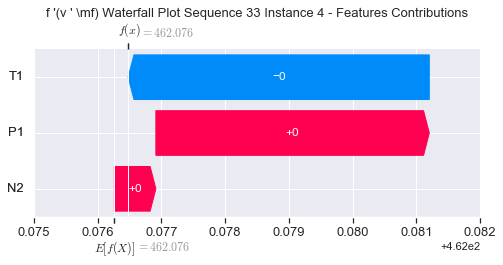

None

Contribution: [-0.00278075 -0.02933779  0.00236722]


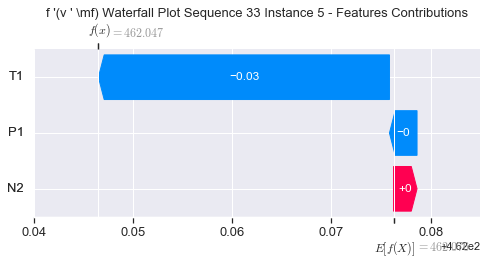

None

Contribution: [ 0.00860189 -0.02773981  0.01867268]


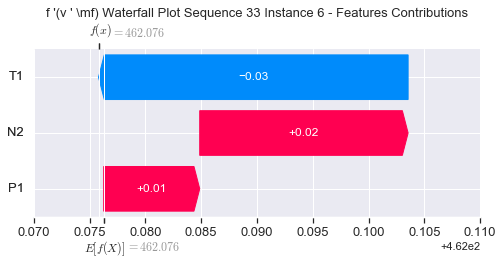

None

Contribution: [ 0.00838357 -0.03187233  0.02632696]


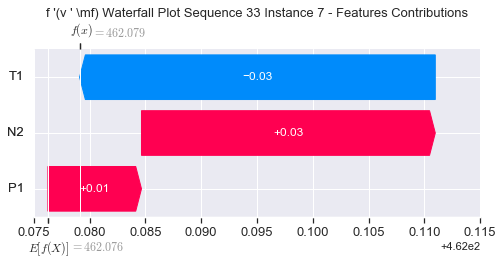

None

Contribution: [ 0.00948399 -0.0342544   0.03391041]


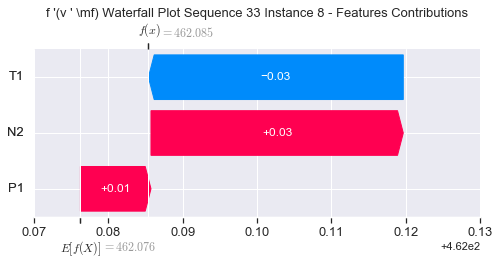

None

Contribution: [-0.00568177 -0.03745951  0.03666181]


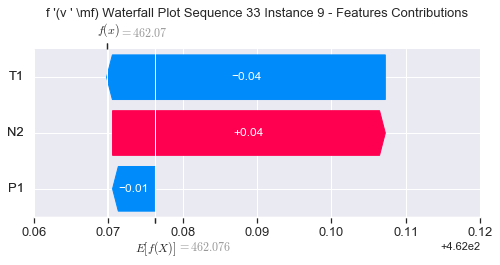

None

Contribution: [-0.0012093  -0.02978704  0.03841388]


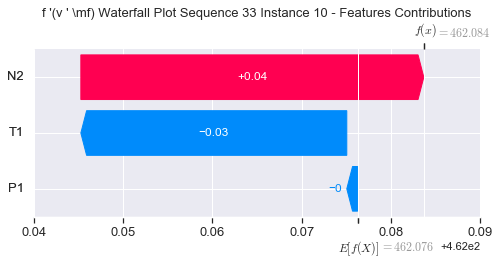

None

Contribution: [ 0.00573313 -0.03960782  0.04660553]


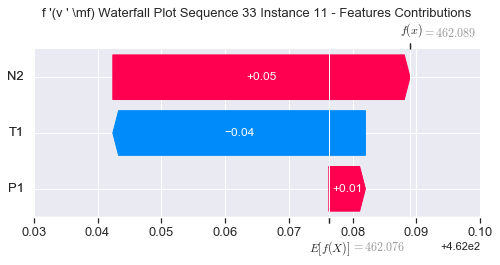

None

Contribution: [ 0.01548056 -0.0645321   0.0461802 ]


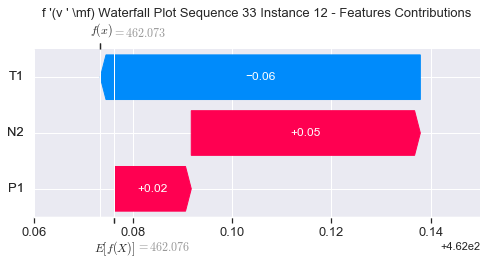

None

Contribution: [ 0.01434054 -0.06605976  0.04821831]


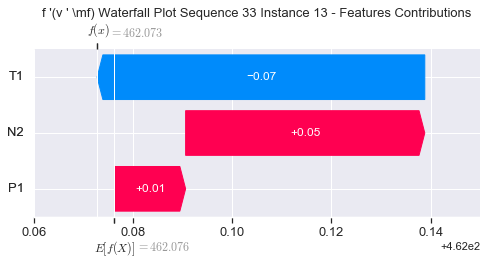

None

Contribution: [ 0.01376036 -0.07459977  0.04816376]


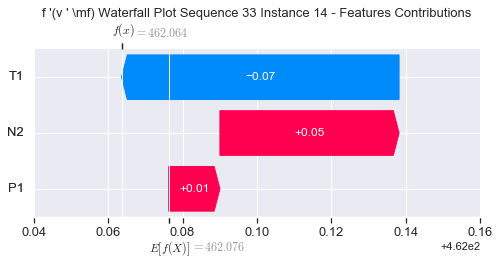

None

Contribution: [ 0.01535347 -0.08060398  0.05544984]


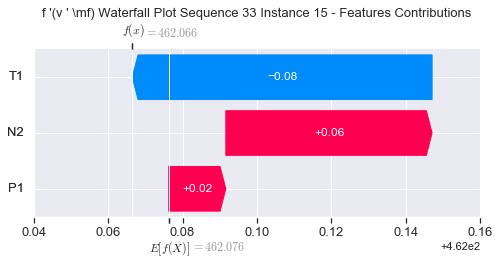

None

Contribution: [ 0.00839226 -0.07245083  0.06006055]


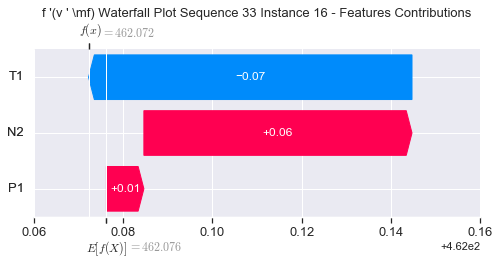

None

Contribution: [ 0.01813486 -0.08301131  0.0678706 ]


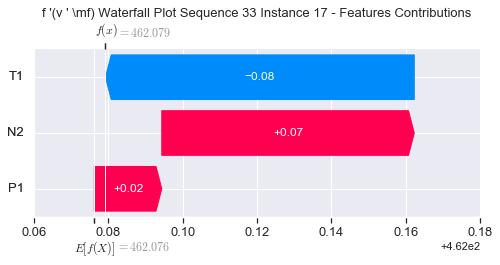

None

Contribution: [ 0.02215211 -0.0897656   0.08023547]


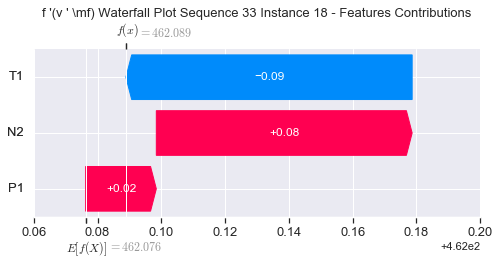

None

Contribution: [ 0.01139429 -0.10066848  0.09887319]


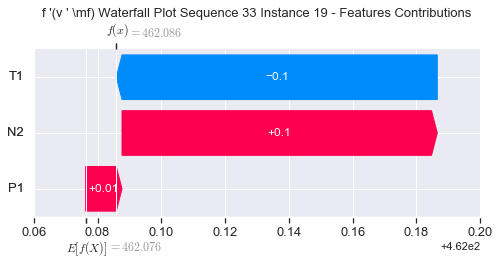

None

Contribution: [ 0.02764902 -0.2163662   0.1474534 ]


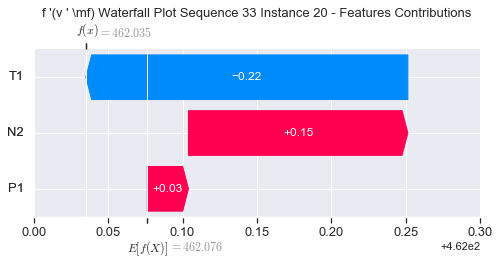

None

Contribution: [ 0.0437444  -0.36985493  0.23259104]


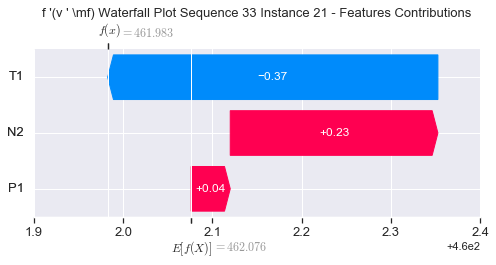

None

Contribution: [ 0.05259034 -1.16969865  0.47935274]


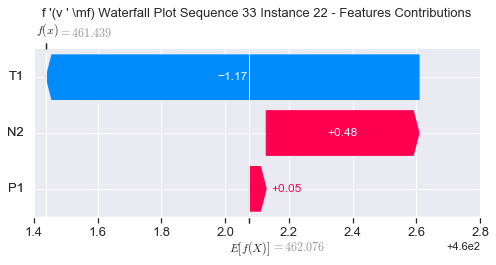

None

Contribution: [ 0.05256553 -1.38772202  0.5826704 ]


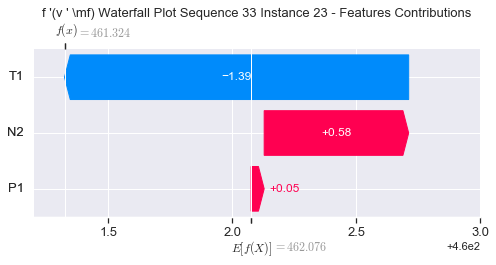

None

Contribution: [ 0.31755627 -4.01174196  1.78860331]


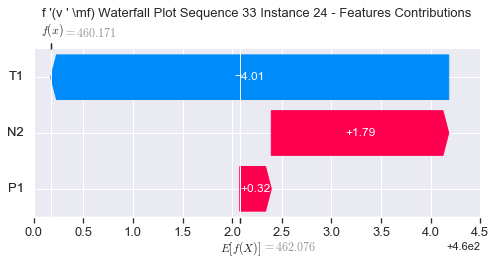

None

Contribution: [ 0.58898271 -1.39612937  1.81398194]


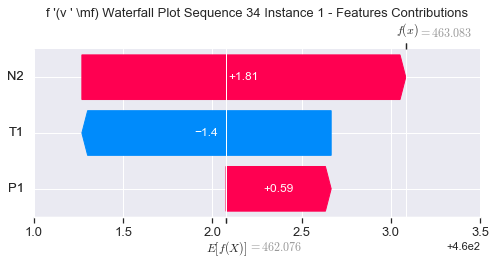

None

Contribution: [0.01506579 0.16717829 0.04928589]


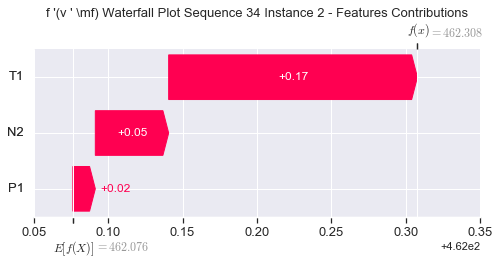

None

Contribution: [ 0.01873736 -0.06098811  0.06068639]


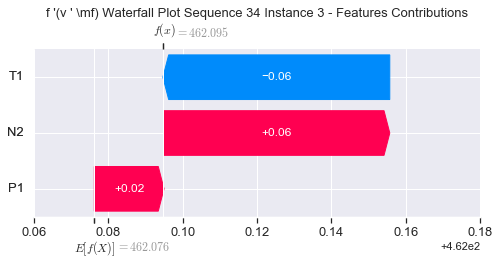

None

Contribution: [-0.00646728 -0.05936031 -0.0056269 ]


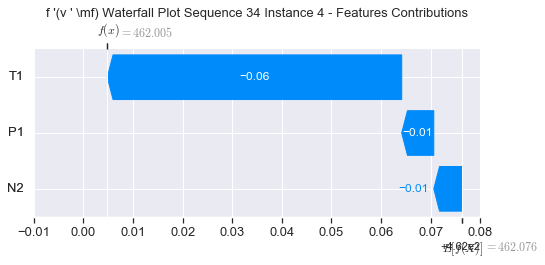

None

Contribution: [-0.00754477 -0.06756662 -0.00395298]


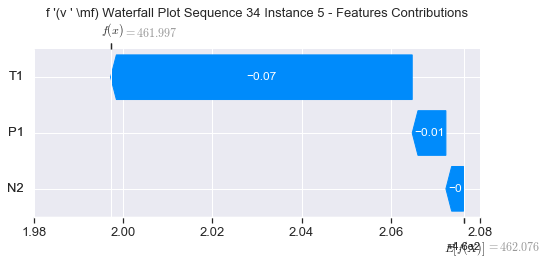

None

Contribution: [-0.00259086 -0.06391871  0.01330259]


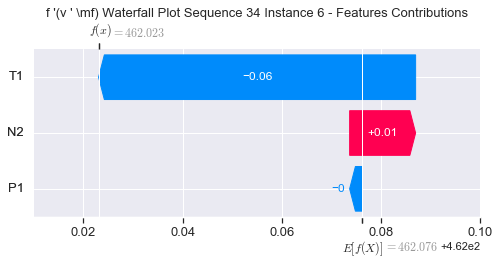

None

Contribution: [-0.00073351 -0.06394399  0.0215709 ]


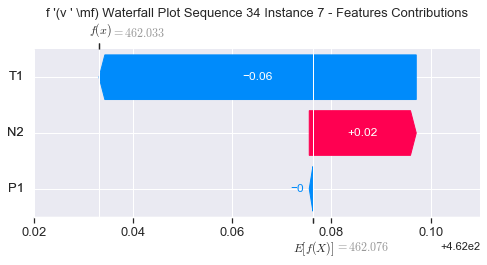

None

Contribution: [-0.00069095 -0.06672189  0.02837016]


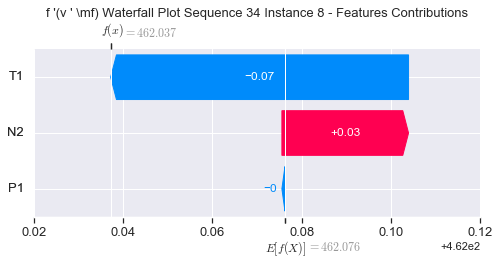

None

Contribution: [-0.01129368 -0.07068711  0.03554455]


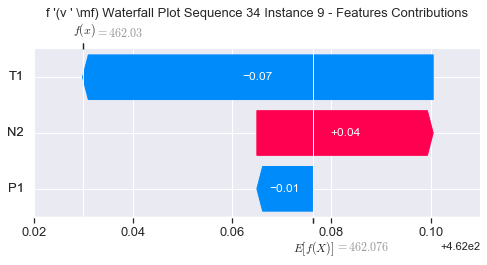

None

Contribution: [-0.01563792 -0.07580974  0.0411293 ]


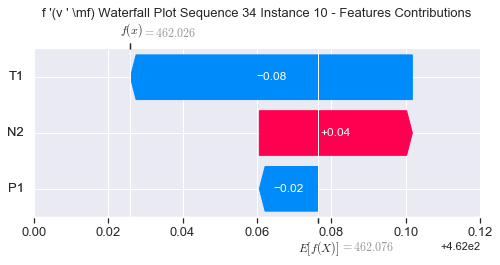

None

Contribution: [-0.01460597 -0.07744955  0.04283605]


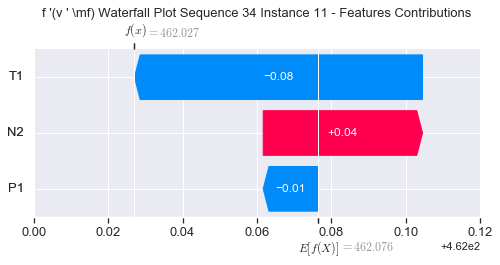

None

Contribution: [-0.00648579 -0.08752734  0.0434364 ]


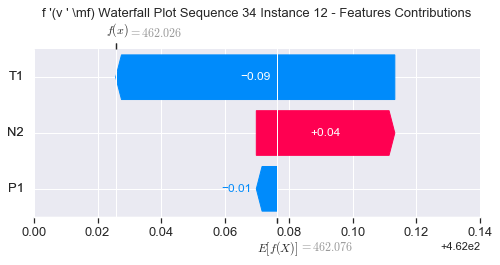

None

Contribution: [-0.00443976 -0.0890179   0.04603306]


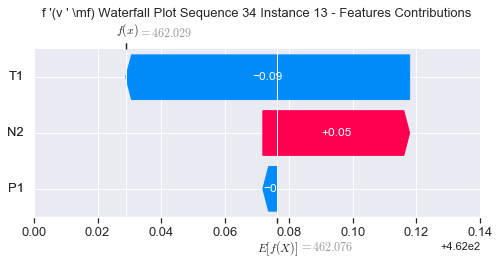

None

Contribution: [-0.01933777 -0.1019669   0.0488045 ]


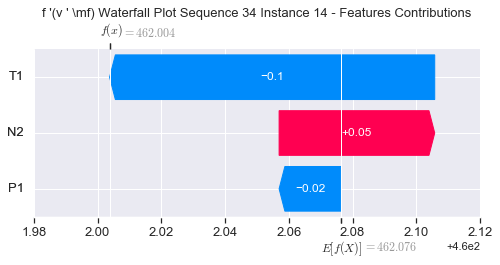

None

Contribution: [-0.00177645 -0.10285751  0.0541151 ]


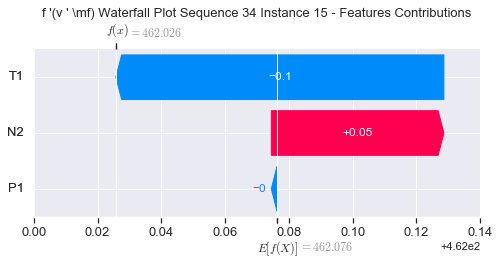

None

Contribution: [ 0.00669681 -0.11623572  0.06813064]


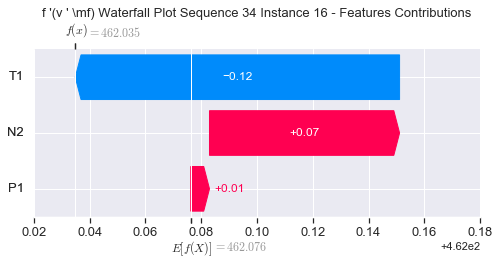

None

Contribution: [ 0.0050099  -0.10248638  0.06928858]


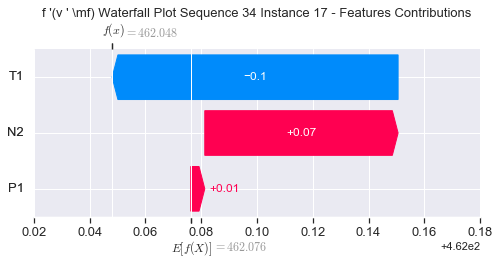

None

Contribution: [ 0.00857497 -0.11000572  0.0822168 ]


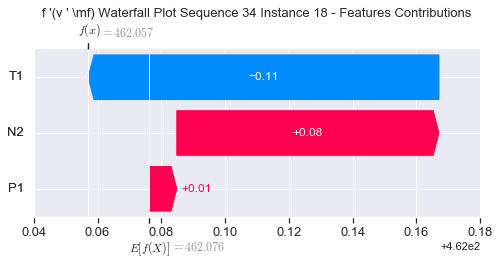

None

Contribution: [-0.00329161 -0.13168275  0.10312388]


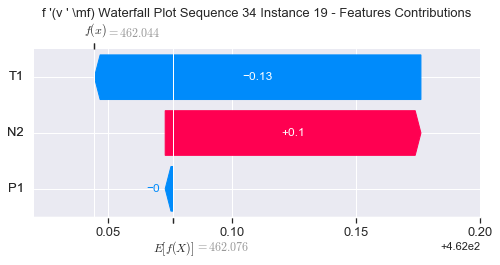

None

Contribution: [ 0.0221303  -0.24186038  0.15071167]


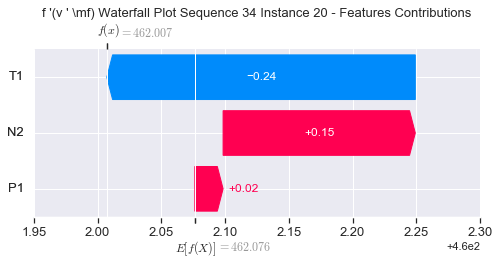

None

Contribution: [ 0.03106657 -0.39779628  0.23646453]


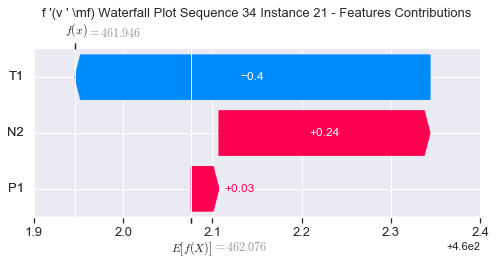

None

Contribution: [ 0.00909723 -1.23722257  0.4843691 ]


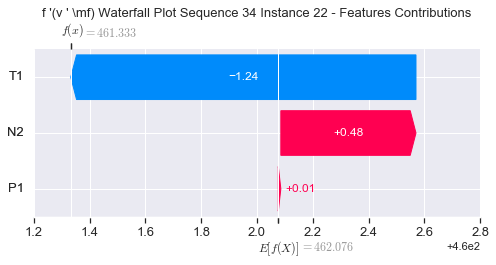

None

Contribution: [-0.03378148 -1.47953824  0.59523307]


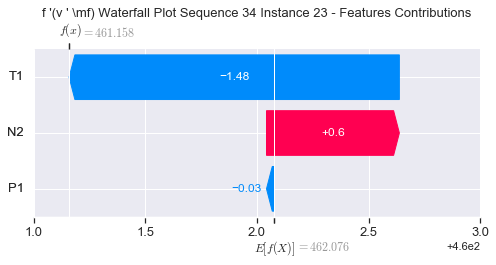

None

Contribution: [ 0.15326945 -4.44749136  1.77682064]


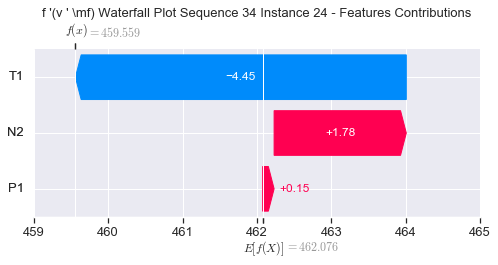

None

In [81]:
#Waterfall Plot for Consistency metric

sns.set()
instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("f '(v ' \mf) Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)